In [1]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets

In [2]:
from utils import Logger

In [3]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((.5,.5,.5),(.5,.5,.5))
    ])

dataset = datasets.MNIST('data',train=True,transform=transform,download=False)

dataloader = torch.utils.data.DataLoader(dataset,batch_size=64,shuffle=True)

num_batches = len(dataloader)
print(num_batches)

938


### Defining the Discriminator

In [4]:
from torch.nn import functional as F
class Discriminator(nn.Module):
    
    def __init__(self):
        super().__init__()
        
        self.fc1 = nn.Linear(784,1024)
        self.fc2 = nn.Linear(1024,512)
        self.fc3 = nn.Linear(512,256)
        self.fc4 = nn.Linear(256,1)
        
        self.dropout = nn.Dropout(0.3)
        
    def forward(self, x):
        x = x.view(x.shape[0],-1)
        x = self.dropout(F.leaky_relu(self.fc1(x),0.2))
        x = self.dropout(F.leaky_relu(self.fc2(x),0.2))
        x = self.dropout(F.leaky_relu(self.fc3(x),0.2))
        x = F.sigmoid(self.fc4(x))
        
        return x
    
discriminator = Discriminator()
print(discriminator)

Discriminator(
  (fc1): Linear(in_features=784, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=512, bias=True)
  (fc3): Linear(in_features=512, out_features=256, bias=True)
  (fc4): Linear(in_features=256, out_features=1, bias=True)
  (dropout): Dropout(p=0.3)
)


### Defining the generator

In [5]:
class Generator(nn.Module):
    
    def __init__(self):
        super().__init__()
        self.fc1 = nn.Linear(100,256)
        self.fc2 = nn.Linear(256,512)
        self.fc3 = nn.Linear(512,1024)
        self.fc4 = nn.Linear(1024,784)
        
    def forward(self,x):
        x = F.leaky_relu(self.fc1(x),0.2)
        x = F.leaky_relu(self.fc2(x),0.2)
        x = F.leaky_relu(self.fc3(x),0.2)
        x = F.tanh(self.fc4(x))
        return x

generator = Generator()
print(generator)

Generator(
  (fc1): Linear(in_features=100, out_features=256, bias=True)
  (fc2): Linear(in_features=256, out_features=512, bias=True)
  (fc3): Linear(in_features=512, out_features=1024, bias=True)
  (fc4): Linear(in_features=1024, out_features=784, bias=True)
)


#### Let's make some Noise

In [6]:
def noise(size):
    n = Variable(torch.randn(size,100))
    return n.cuda()

#### optimizer

In [7]:
d_optimizer = optim.Adam(discriminator.parameters(),lr = 0.0002)
g_optimizer = optim.Adam(generator.parameters(),lr = 0.0002)

#### Loss

In [8]:
loss = nn.BCELoss()

In [9]:
def ones_target(size):
    data = Variable(torch.ones(size,1))
    return data.cuda()

def zeros_target(size):
    data = Variable(torch.zeros(size,1))
    return data.cuda()

## Training Functions

In [10]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    
    optimizer.zero_grad()
    
    ### Real Data
    yreal = discriminator(real_data)
    er_real = loss(yreal, ones_target(N))
    er_real.backward()
    ### fake Data
    yfake = discriminator(fake_data)
    er_fake = loss(yfake,zeros_target(N))
    er_fake.backward()
    
    optimizer.step()
    
    return er_real + er_fake, yreal, yfake

In [11]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    optimizer.zero_grad()
    y = discriminator(fake_data)
    
    error = loss(y,ones_target(N))
    error.backward()
    
    optimizer.step()
    
    return error

In [12]:
num_test_samples = 16
test_noise = noise(num_test_samples)

In [13]:
def display_status(epoch, num_epochs, n_batch, num_batches, d_error, g_error, d_pred_real, d_pred_fake):
        
        # var_class = torch.autograd.variable.Variable
        if isinstance(d_error, torch.autograd.Variable):
            d_error = d_error.data.cpu().numpy()
        if isinstance(g_error, torch.autograd.Variable):
            g_error = g_error.data.cpu().numpy()
        if isinstance(d_pred_real, torch.autograd.Variable):
            d_pred_real = d_pred_real.data
        if isinstance(d_pred_fake, torch.autograd.Variable):
            d_pred_fake = d_pred_fake.data
        
        
        print('Epoch: [{}/{}], Batch Num: [{}/{}]'.format(
            epoch,num_epochs, n_batch, num_batches)
             )
        print('Discriminator Loss: {}, Generator Loss: {}'.format(d_error, g_error))
        print('D(x): {:.4f}, D(G(z)): {:.4f}'.format(d_pred_real.mean(), d_pred_fake.mean()))

C:\Users\anil\Anaconda3\lib\site-packages\torch\nn\functional.py:1320: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
C:\Users\anil\Anaconda3\lib\site-packages\torch\nn\functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


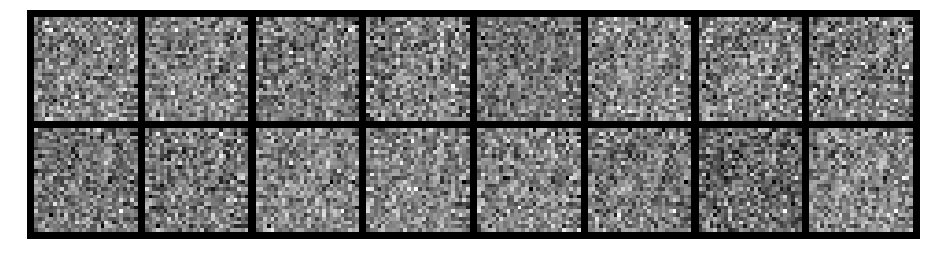

Epoch: [0/200], Batch Num: [0/938]
Discriminator Loss: 1.4083530902862549, Generator Loss: 0.7067359685897827
D(x): 0.4827, D(G(z)): 0.4932


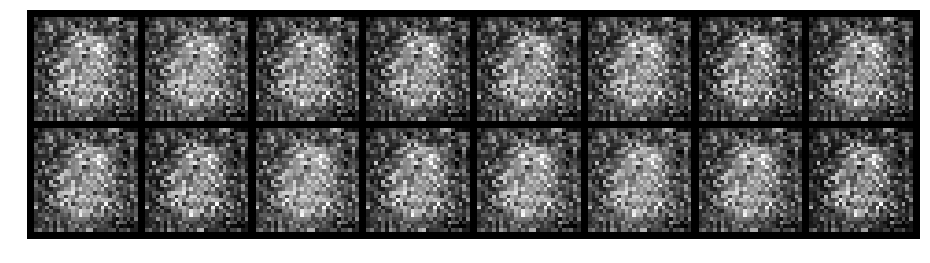

Epoch: [0/200], Batch Num: [100/938]
Discriminator Loss: 0.8380626440048218, Generator Loss: 2.050291061401367
D(x): 0.6976, D(G(z)): 0.3120


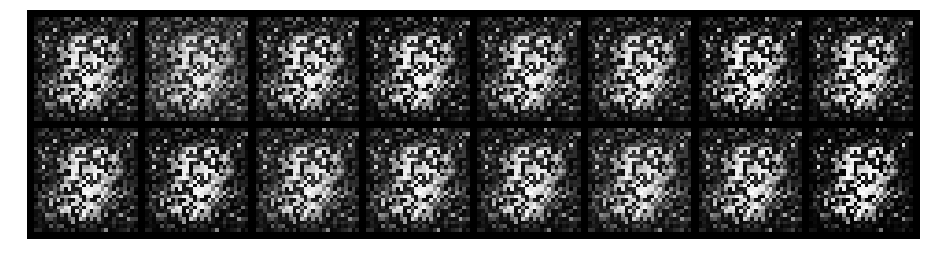

Epoch: [0/200], Batch Num: [200/938]
Discriminator Loss: 0.7875354886054993, Generator Loss: 2.416200637817383
D(x): 0.7717, D(G(z)): 0.3624


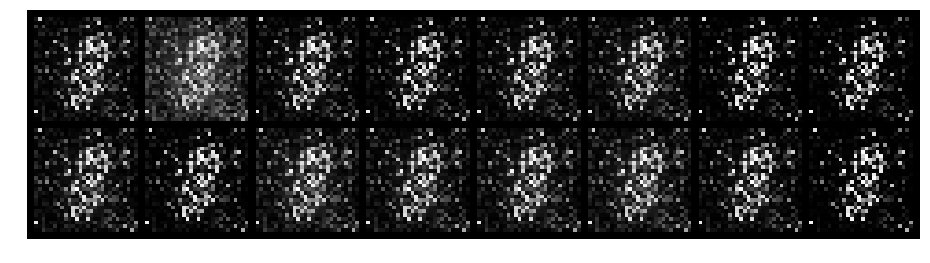

Epoch: [0/200], Batch Num: [300/938]
Discriminator Loss: 0.27238965034484863, Generator Loss: 4.620932579040527
D(x): 0.8997, D(G(z)): 0.1046


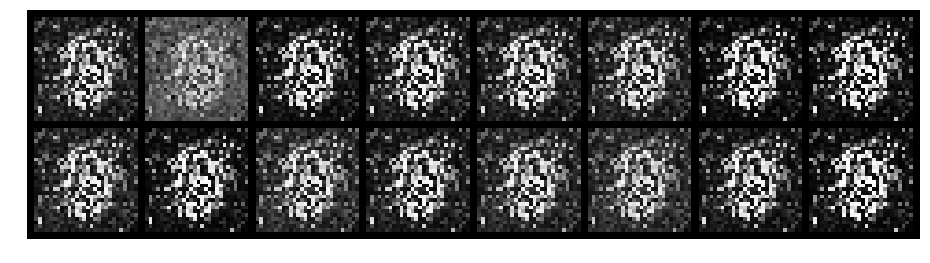

Epoch: [0/200], Batch Num: [400/938]
Discriminator Loss: 1.0049211978912354, Generator Loss: 1.525481939315796
D(x): 0.7253, D(G(z)): 0.4149


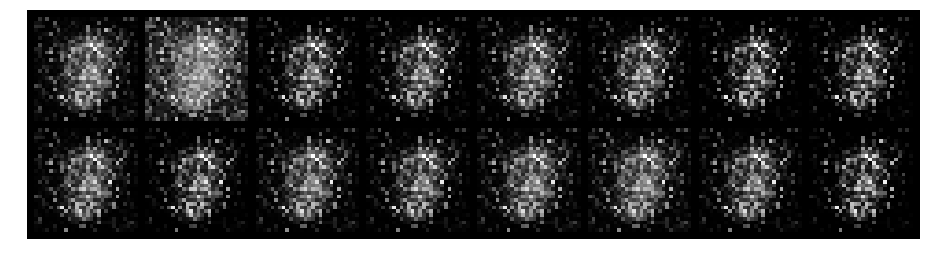

Epoch: [0/200], Batch Num: [500/938]
Discriminator Loss: 1.5177202224731445, Generator Loss: 1.139391303062439
D(x): 0.4810, D(G(z)): 0.3748


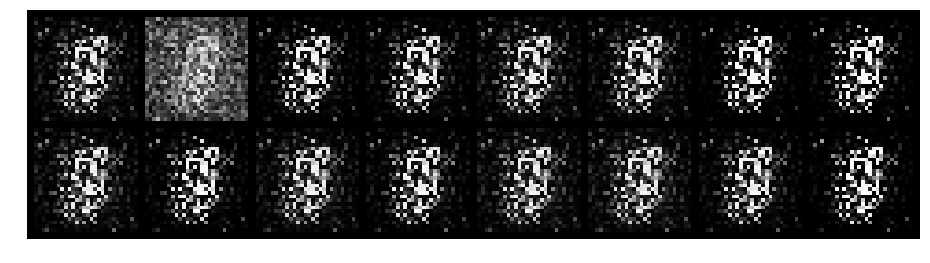

Epoch: [0/200], Batch Num: [600/938]
Discriminator Loss: 0.48409003019332886, Generator Loss: 4.37111234664917
D(x): 0.8274, D(G(z)): 0.1923


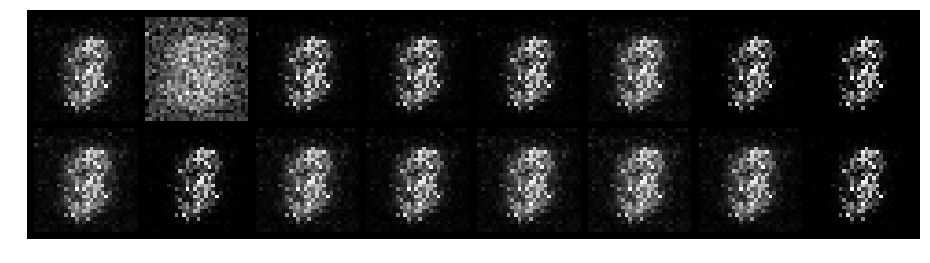

Epoch: [0/200], Batch Num: [700/938]
Discriminator Loss: 1.0046188831329346, Generator Loss: 3.5445964336395264
D(x): 0.6707, D(G(z)): 0.3057


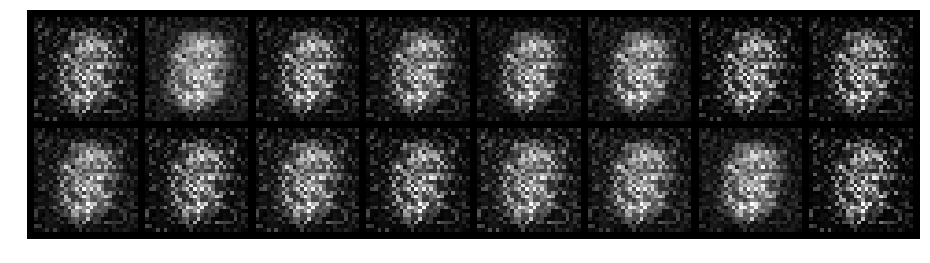

Epoch: [0/200], Batch Num: [800/938]
Discriminator Loss: 1.76670241355896, Generator Loss: 0.9935240745544434
D(x): 0.5846, D(G(z)): 0.5851


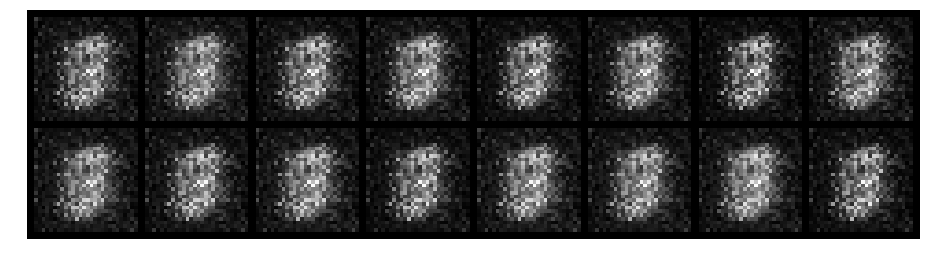

Epoch: [0/200], Batch Num: [900/938]
Discriminator Loss: 0.9319188594818115, Generator Loss: 1.5899124145507812
D(x): 0.6652, D(G(z)): 0.3455


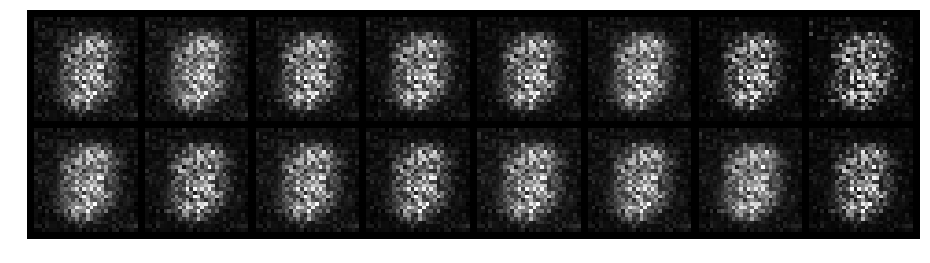

Epoch: [1/200], Batch Num: [0/938]
Discriminator Loss: 1.2890634536743164, Generator Loss: 1.5503442287445068
D(x): 0.5730, D(G(z)): 0.3857


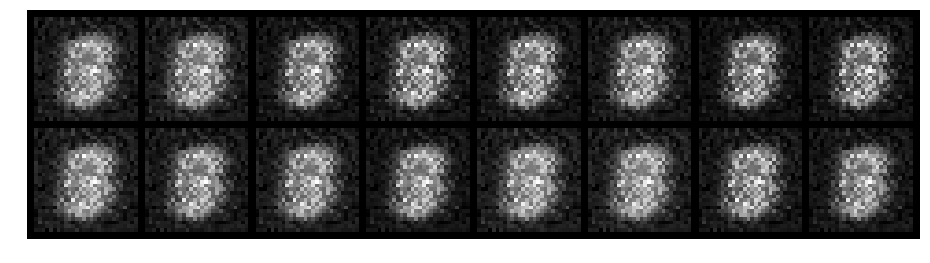

Epoch: [1/200], Batch Num: [100/938]
Discriminator Loss: 0.7120422124862671, Generator Loss: 1.6134432554244995
D(x): 0.6947, D(G(z)): 0.2701


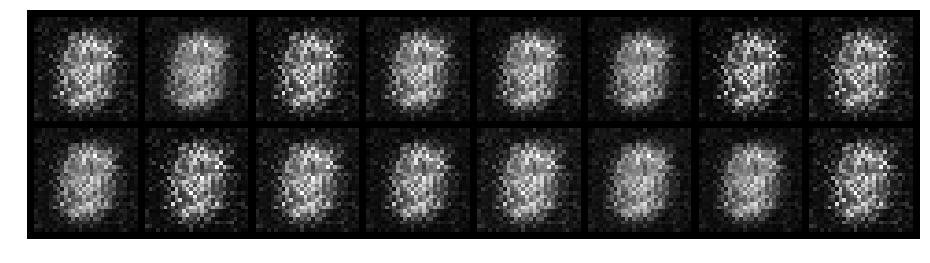

Epoch: [1/200], Batch Num: [200/938]
Discriminator Loss: 1.1275477409362793, Generator Loss: 1.474915862083435
D(x): 0.7740, D(G(z)): 0.4964


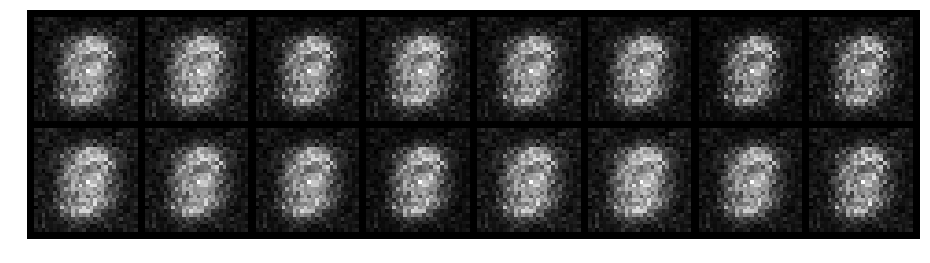

Epoch: [1/200], Batch Num: [300/938]
Discriminator Loss: 0.773761510848999, Generator Loss: 1.5506012439727783
D(x): 0.6858, D(G(z)): 0.2601


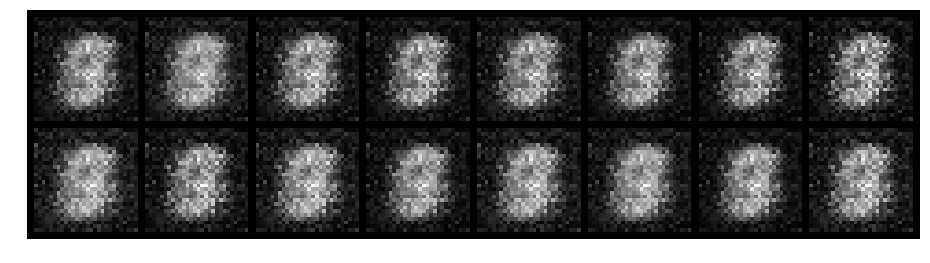

Epoch: [1/200], Batch Num: [400/938]
Discriminator Loss: 0.2940933108329773, Generator Loss: 3.6103768348693848
D(x): 0.8756, D(G(z)): 0.0844


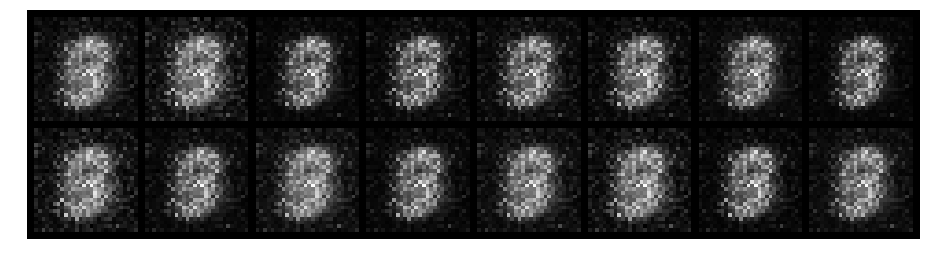

Epoch: [1/200], Batch Num: [500/938]
Discriminator Loss: 0.793843150138855, Generator Loss: 3.343536853790283
D(x): 0.7365, D(G(z)): 0.1937


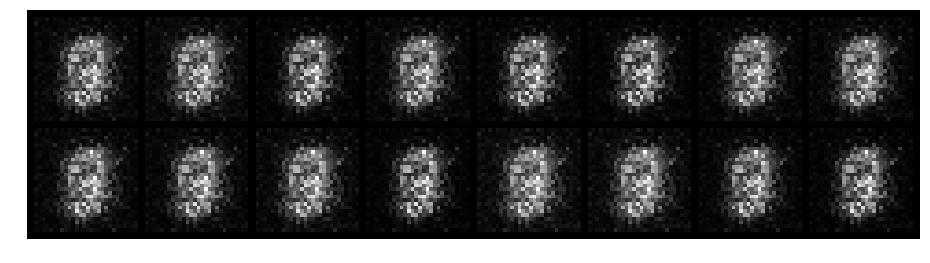

Epoch: [1/200], Batch Num: [600/938]
Discriminator Loss: 1.248382329940796, Generator Loss: 2.4718945026397705
D(x): 0.5873, D(G(z)): 0.3129


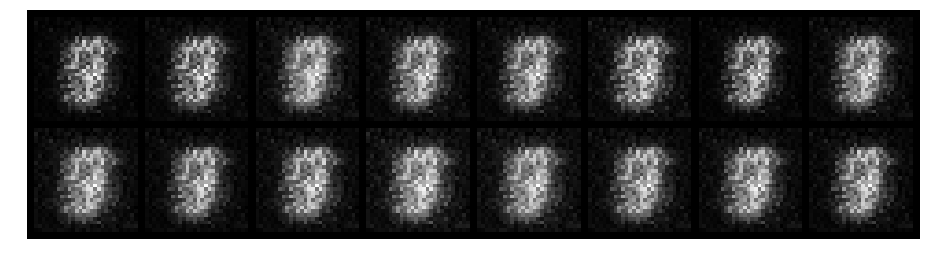

Epoch: [1/200], Batch Num: [700/938]
Discriminator Loss: 1.0189355611801147, Generator Loss: 2.180328845977783
D(x): 0.6961, D(G(z)): 0.2962


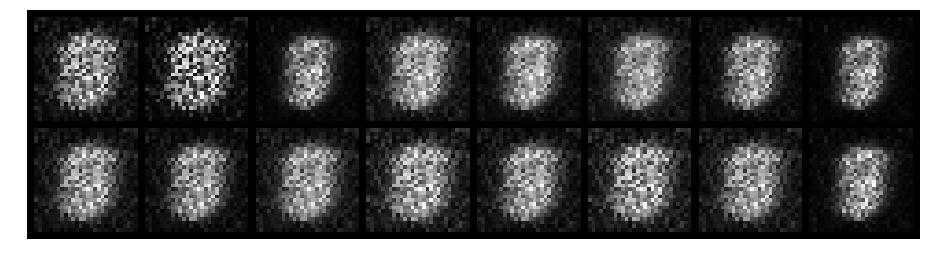

Epoch: [1/200], Batch Num: [800/938]
Discriminator Loss: 0.671463668346405, Generator Loss: 6.760313034057617
D(x): 0.8744, D(G(z)): 0.1138


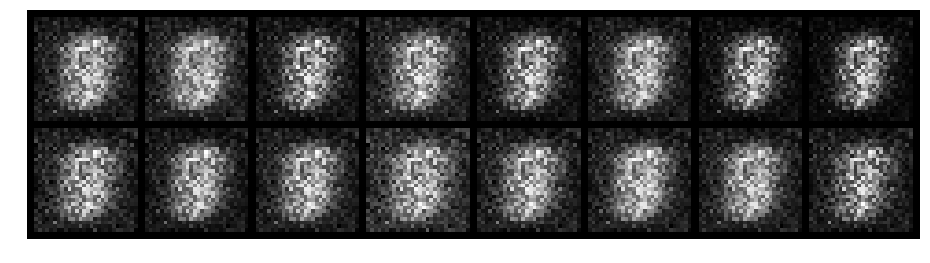

Epoch: [1/200], Batch Num: [900/938]
Discriminator Loss: 0.41892263293266296, Generator Loss: 3.4730281829833984
D(x): 0.9133, D(G(z)): 0.1890


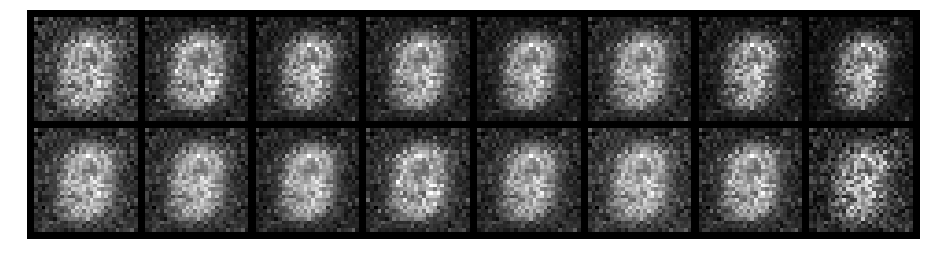

Epoch: [2/200], Batch Num: [0/938]
Discriminator Loss: 1.2264807224273682, Generator Loss: 3.4677209854125977
D(x): 0.8006, D(G(z)): 0.1762


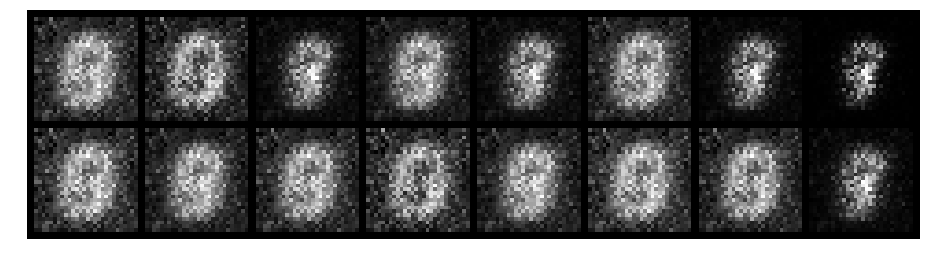

Epoch: [2/200], Batch Num: [100/938]
Discriminator Loss: 0.5973635911941528, Generator Loss: 1.9319748878479004
D(x): 0.8516, D(G(z)): 0.2215


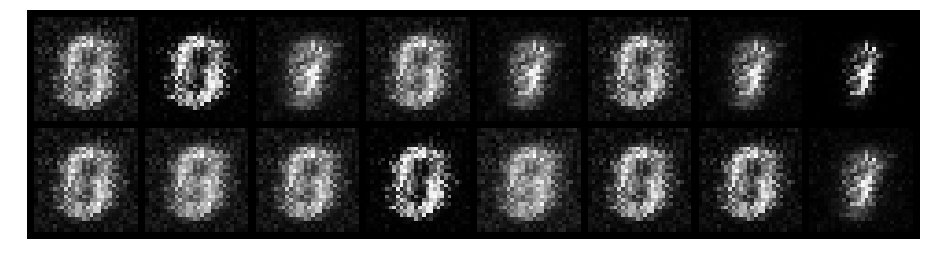

Epoch: [2/200], Batch Num: [200/938]
Discriminator Loss: 0.6572644114494324, Generator Loss: 1.8836007118225098
D(x): 0.8466, D(G(z)): 0.2569


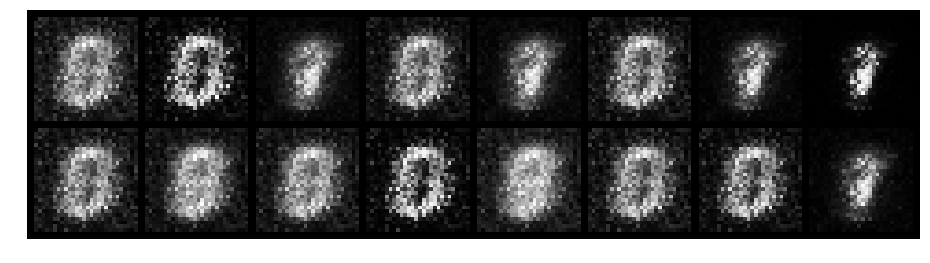

Epoch: [2/200], Batch Num: [300/938]
Discriminator Loss: 0.25252920389175415, Generator Loss: 3.7516422271728516
D(x): 0.9429, D(G(z)): 0.1249


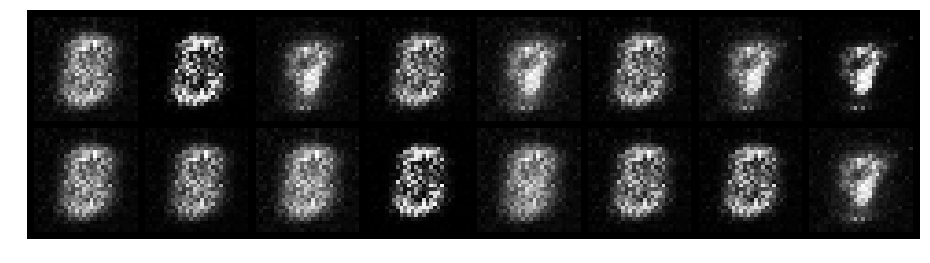

Epoch: [2/200], Batch Num: [400/938]
Discriminator Loss: 0.4227575659751892, Generator Loss: 2.981614112854004
D(x): 0.8736, D(G(z)): 0.1419


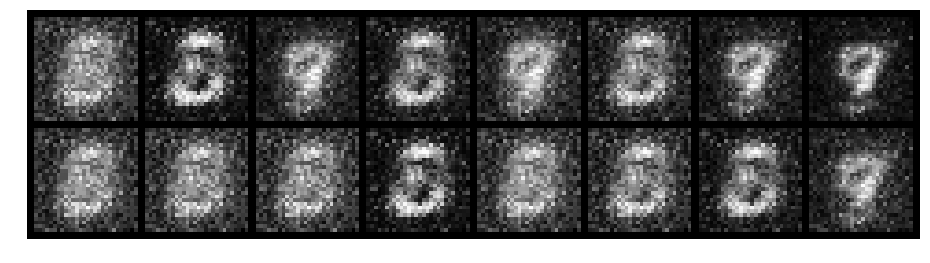

Epoch: [2/200], Batch Num: [500/938]
Discriminator Loss: 0.26547494530677795, Generator Loss: 3.453420639038086
D(x): 0.9382, D(G(z)): 0.1232


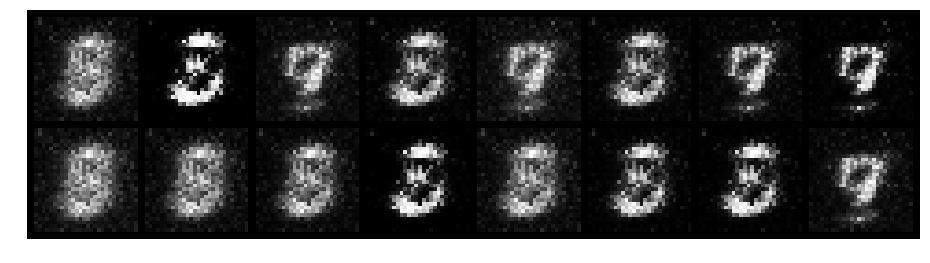

Epoch: [2/200], Batch Num: [600/938]
Discriminator Loss: 0.34995973110198975, Generator Loss: 3.3380744457244873
D(x): 0.9078, D(G(z)): 0.1448


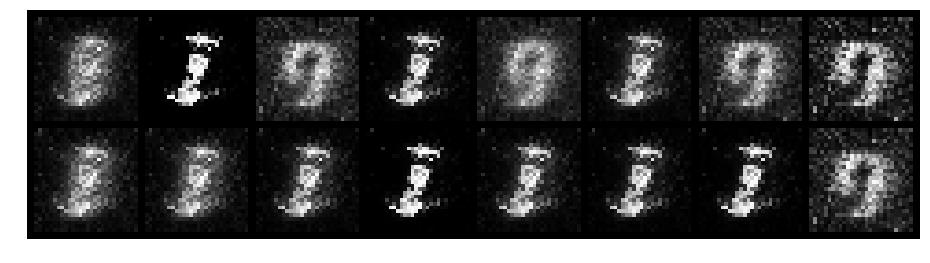

Epoch: [2/200], Batch Num: [700/938]
Discriminator Loss: 1.1700782775878906, Generator Loss: 0.9755926132202148
D(x): 0.8429, D(G(z)): 0.4679


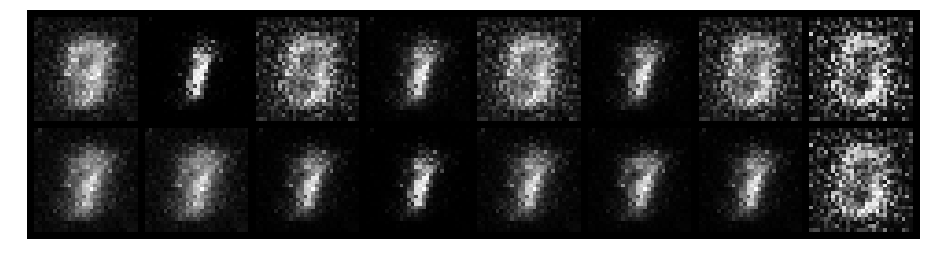

Epoch: [2/200], Batch Num: [800/938]
Discriminator Loss: 0.6119557619094849, Generator Loss: 2.296374797821045
D(x): 0.8689, D(G(z)): 0.2426


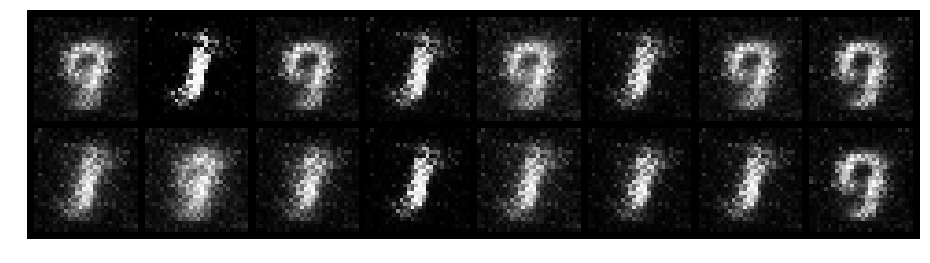

Epoch: [2/200], Batch Num: [900/938]
Discriminator Loss: 0.3405245840549469, Generator Loss: 2.915766954421997
D(x): 0.8935, D(G(z)): 0.1044


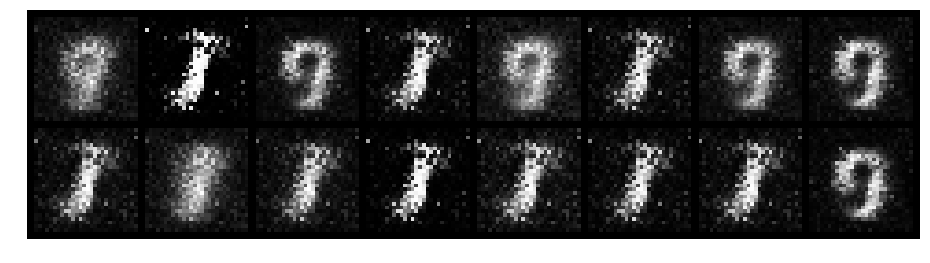

Epoch: [3/200], Batch Num: [0/938]
Discriminator Loss: 0.315309077501297, Generator Loss: 2.815384864807129
D(x): 0.9038, D(G(z)): 0.1007


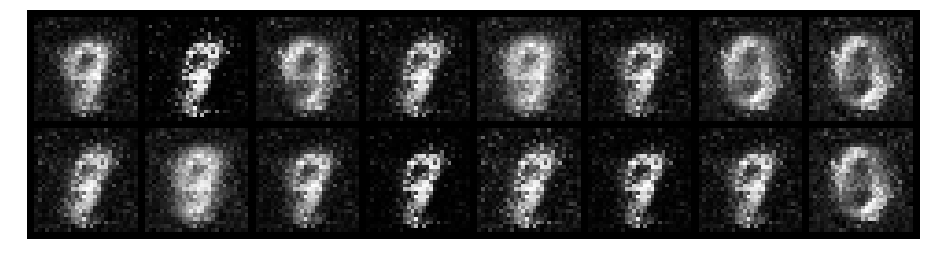

Epoch: [3/200], Batch Num: [100/938]
Discriminator Loss: 0.9432072639465332, Generator Loss: 2.855438709259033
D(x): 0.7857, D(G(z)): 0.1589


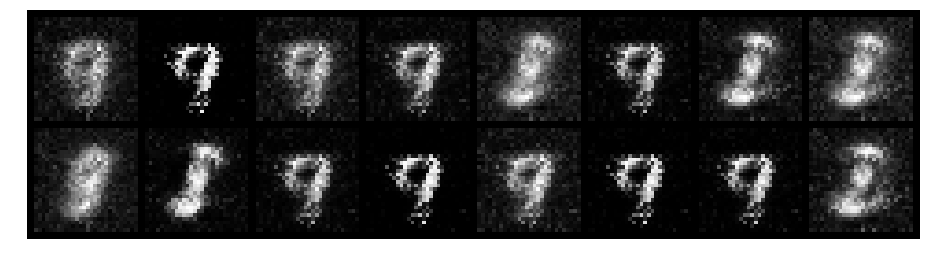

Epoch: [3/200], Batch Num: [200/938]
Discriminator Loss: 0.20987224578857422, Generator Loss: 3.119868755340576
D(x): 0.9444, D(G(z)): 0.1191


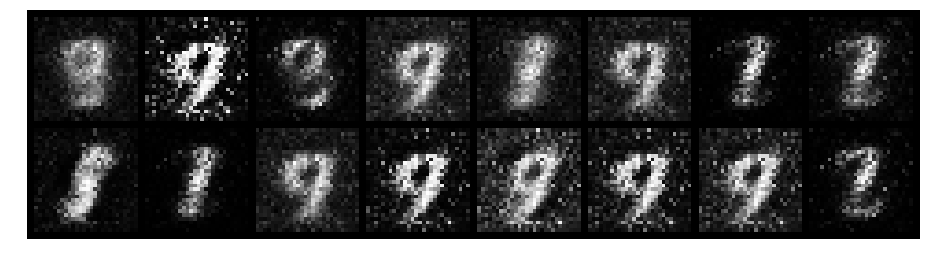

Epoch: [3/200], Batch Num: [300/938]
Discriminator Loss: 0.5332399606704712, Generator Loss: 2.482539176940918
D(x): 0.7974, D(G(z)): 0.1442


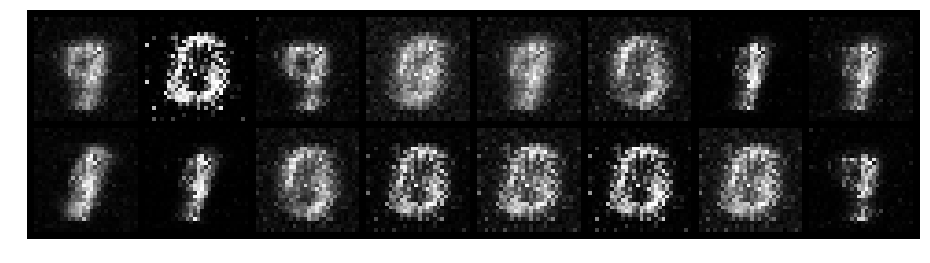

Epoch: [3/200], Batch Num: [400/938]
Discriminator Loss: 0.6280752420425415, Generator Loss: 2.1689388751983643
D(x): 0.7862, D(G(z)): 0.1735


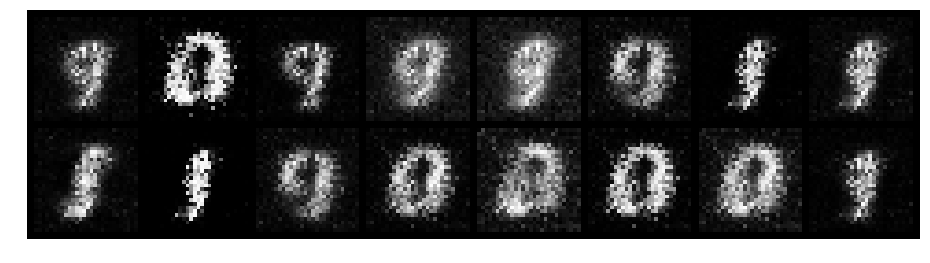

Epoch: [3/200], Batch Num: [500/938]
Discriminator Loss: 0.704015851020813, Generator Loss: 3.456394910812378
D(x): 0.8058, D(G(z)): 0.0811


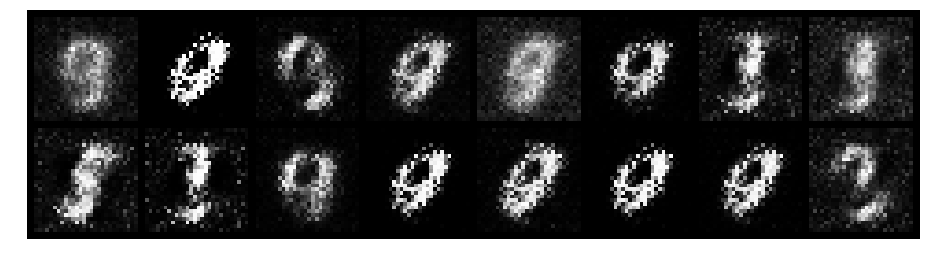

Epoch: [3/200], Batch Num: [600/938]
Discriminator Loss: 0.5981162190437317, Generator Loss: 2.665153980255127
D(x): 0.8553, D(G(z)): 0.1233


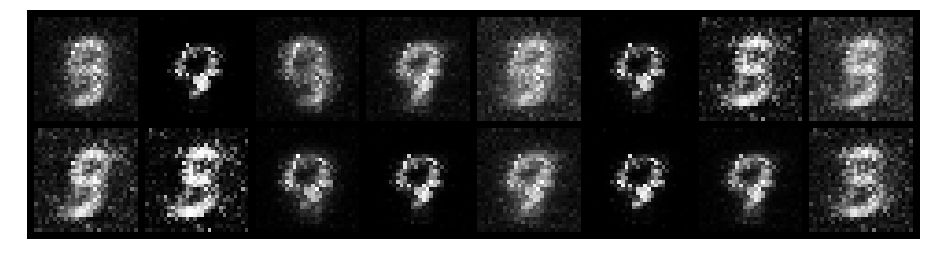

Epoch: [3/200], Batch Num: [700/938]
Discriminator Loss: 1.2729464769363403, Generator Loss: 4.145112991333008
D(x): 0.6648, D(G(z)): 0.1048


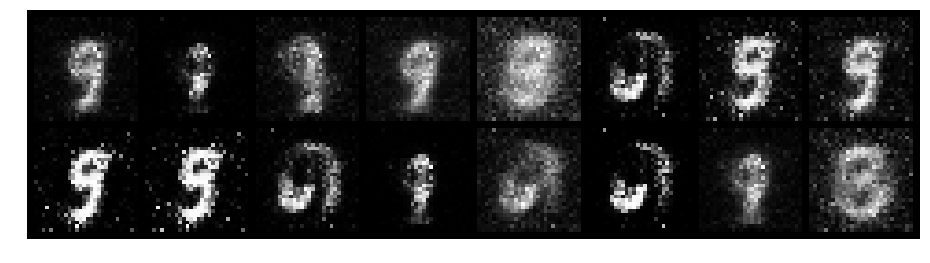

Epoch: [3/200], Batch Num: [800/938]
Discriminator Loss: 0.5667514801025391, Generator Loss: 1.6615006923675537
D(x): 0.9163, D(G(z)): 0.2794


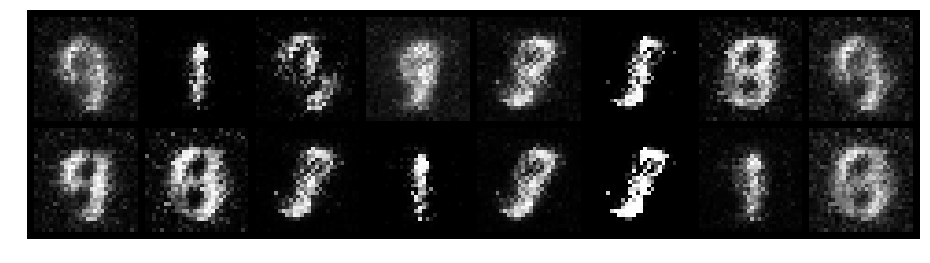

Epoch: [3/200], Batch Num: [900/938]
Discriminator Loss: 0.8743744492530823, Generator Loss: 1.8956959247589111
D(x): 0.8239, D(G(z)): 0.3301


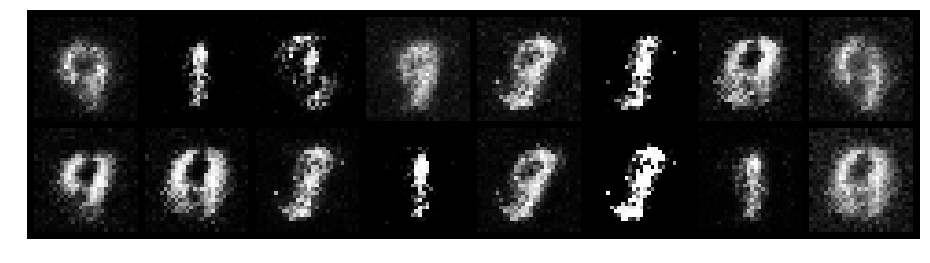

Epoch: [4/200], Batch Num: [0/938]
Discriminator Loss: 0.8117057085037231, Generator Loss: 3.462165594100952
D(x): 0.7336, D(G(z)): 0.1729


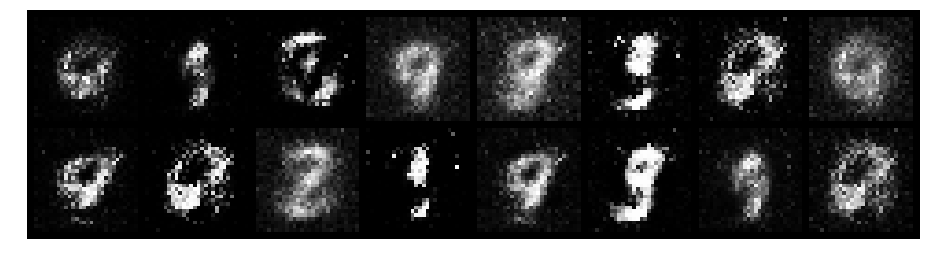

Epoch: [4/200], Batch Num: [100/938]
Discriminator Loss: 0.554865837097168, Generator Loss: 2.6052258014678955
D(x): 0.8239, D(G(z)): 0.1718


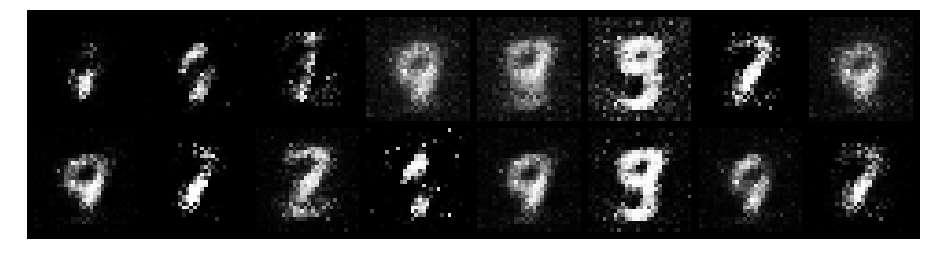

Epoch: [4/200], Batch Num: [200/938]
Discriminator Loss: 0.4947287142276764, Generator Loss: 2.9457054138183594
D(x): 0.8129, D(G(z)): 0.1131


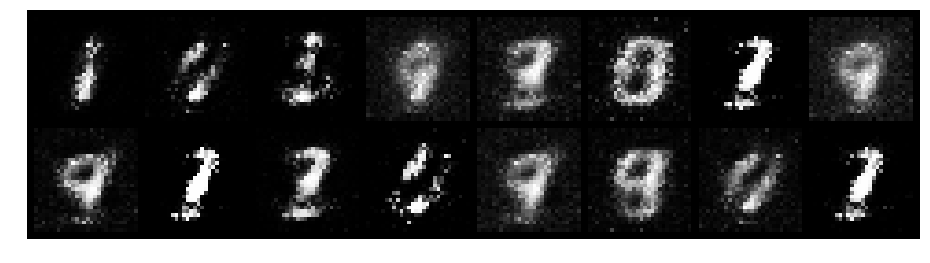

Epoch: [4/200], Batch Num: [300/938]
Discriminator Loss: 0.5461081266403198, Generator Loss: 3.519397258758545
D(x): 0.8070, D(G(z)): 0.1672


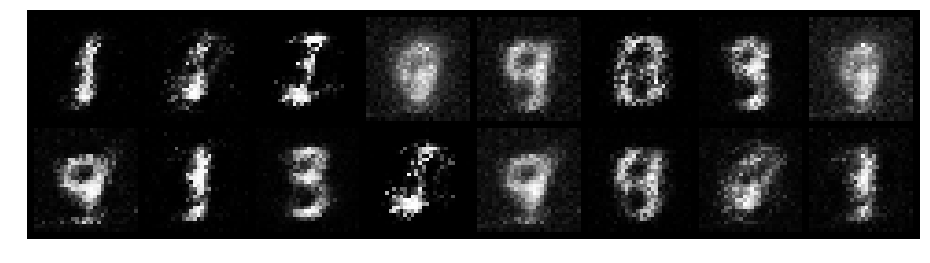

Epoch: [4/200], Batch Num: [400/938]
Discriminator Loss: 0.5179268717765808, Generator Loss: 2.5132336616516113
D(x): 0.8046, D(G(z)): 0.1524


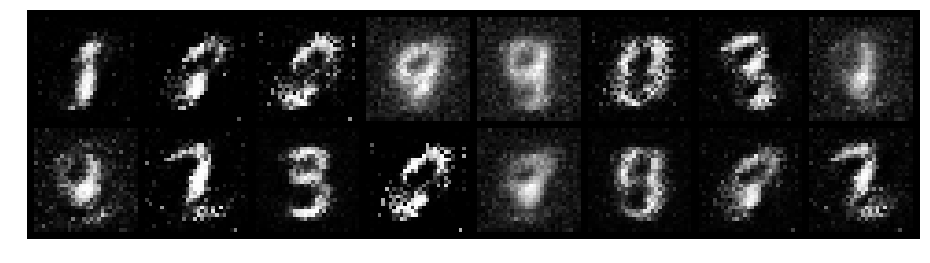

Epoch: [4/200], Batch Num: [500/938]
Discriminator Loss: 0.7928855419158936, Generator Loss: 2.0886945724487305
D(x): 0.7599, D(G(z)): 0.2356


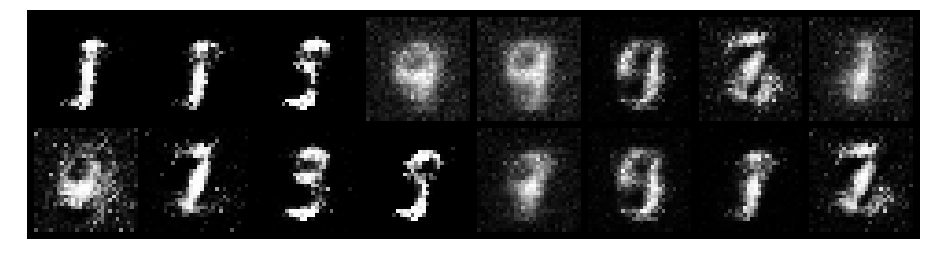

Epoch: [4/200], Batch Num: [600/938]
Discriminator Loss: 0.4157300293445587, Generator Loss: 3.1251673698425293
D(x): 0.8706, D(G(z)): 0.1070


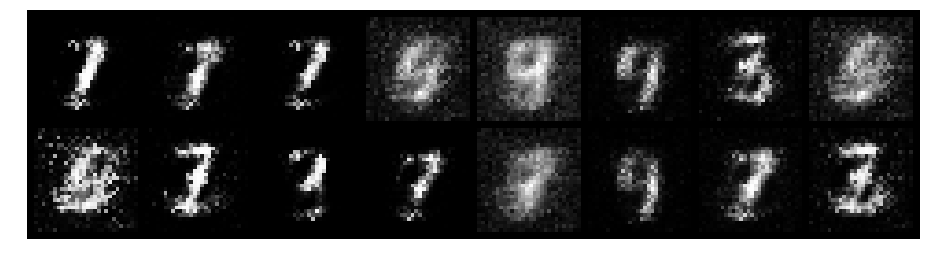

Epoch: [4/200], Batch Num: [700/938]
Discriminator Loss: 0.5044558644294739, Generator Loss: 1.6053763628005981
D(x): 0.8523, D(G(z)): 0.2295


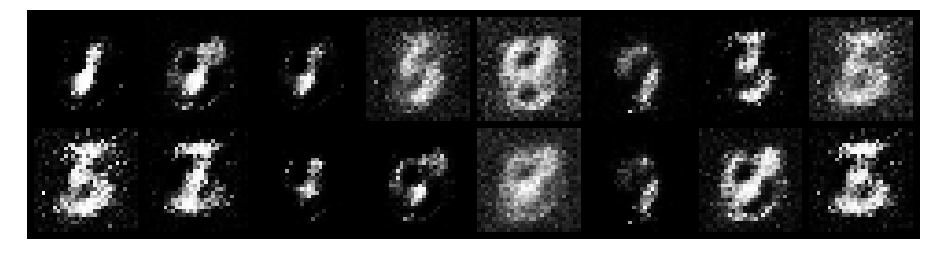

Epoch: [4/200], Batch Num: [800/938]
Discriminator Loss: 0.8187203407287598, Generator Loss: 1.7363349199295044
D(x): 0.7540, D(G(z)): 0.3004


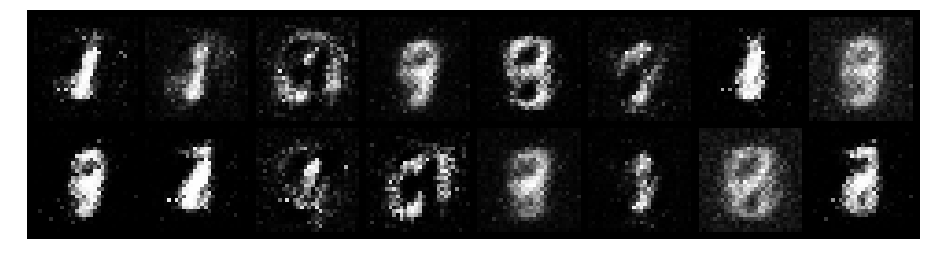

Epoch: [4/200], Batch Num: [900/938]
Discriminator Loss: 0.33672282099723816, Generator Loss: 2.274453639984131
D(x): 0.8839, D(G(z)): 0.1483


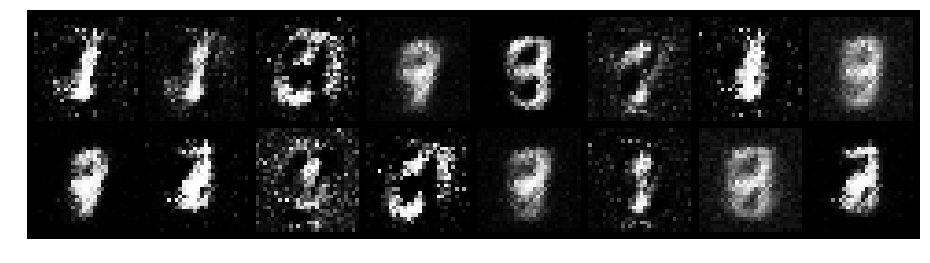

Epoch: [5/200], Batch Num: [0/938]
Discriminator Loss: 0.5325117111206055, Generator Loss: 1.9693763256072998
D(x): 0.8497, D(G(z)): 0.2231


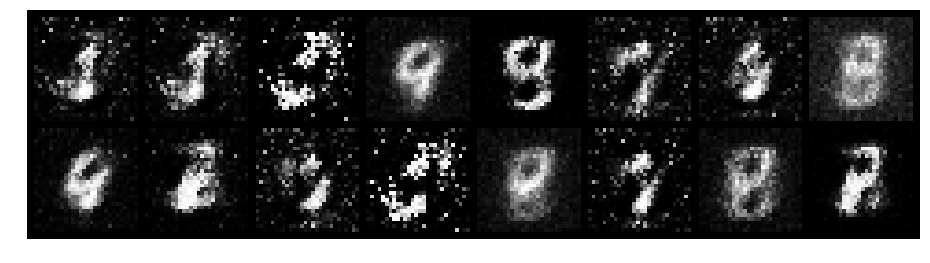

Epoch: [5/200], Batch Num: [100/938]
Discriminator Loss: 0.6705940365791321, Generator Loss: 2.183490753173828
D(x): 0.8164, D(G(z)): 0.1838


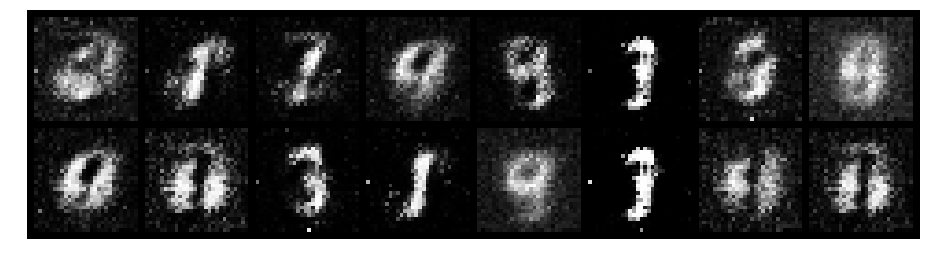

Epoch: [5/200], Batch Num: [200/938]
Discriminator Loss: 0.7830113768577576, Generator Loss: 2.3917038440704346
D(x): 0.8034, D(G(z)): 0.2938


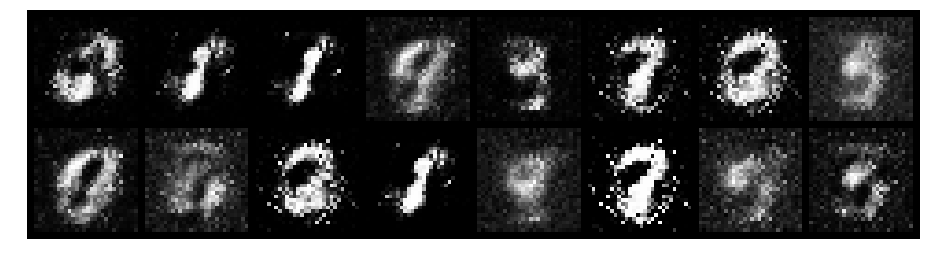

Epoch: [5/200], Batch Num: [300/938]
Discriminator Loss: 0.8741226196289062, Generator Loss: 1.6521215438842773
D(x): 0.6666, D(G(z)): 0.1922


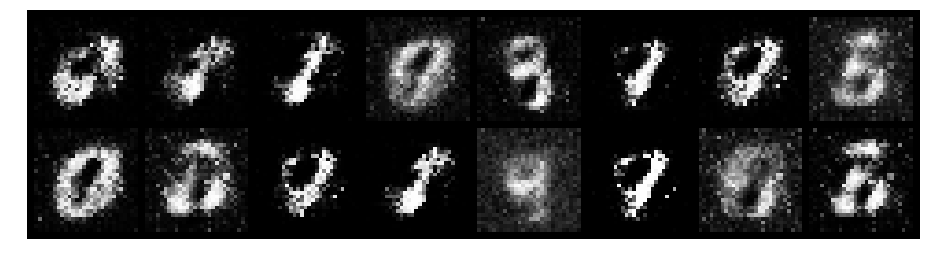

Epoch: [5/200], Batch Num: [400/938]
Discriminator Loss: 0.3873125910758972, Generator Loss: 2.174959897994995
D(x): 0.8705, D(G(z)): 0.1554


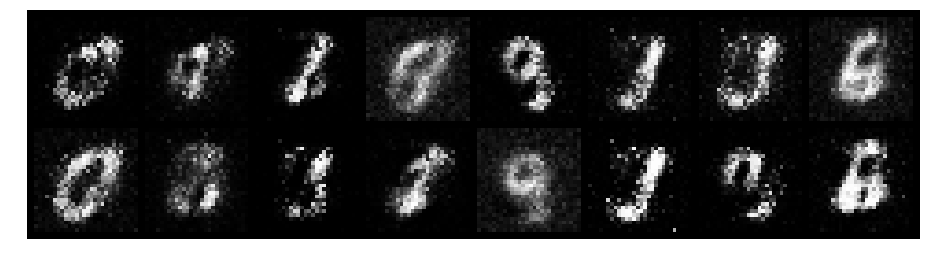

Epoch: [5/200], Batch Num: [500/938]
Discriminator Loss: 0.363264799118042, Generator Loss: 2.4363925457000732
D(x): 0.8693, D(G(z)): 0.1299


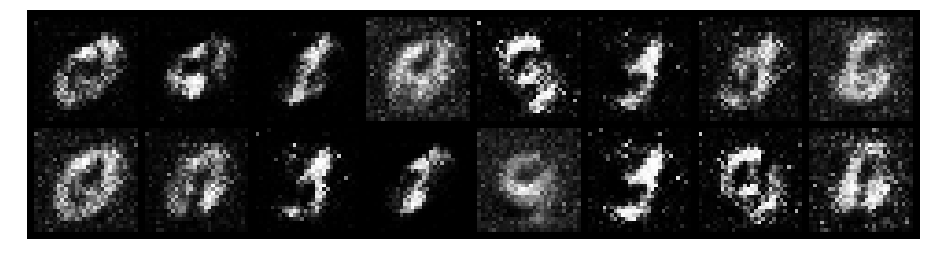

Epoch: [5/200], Batch Num: [600/938]
Discriminator Loss: 0.5753652453422546, Generator Loss: 1.7393951416015625
D(x): 0.8321, D(G(z)): 0.2258


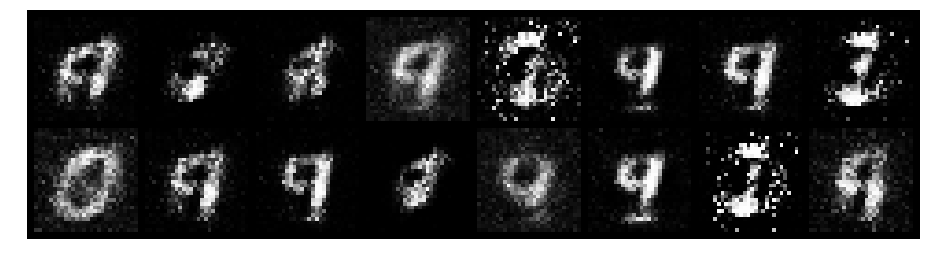

Epoch: [5/200], Batch Num: [700/938]
Discriminator Loss: 0.5344153046607971, Generator Loss: 2.3661773204803467
D(x): 0.8300, D(G(z)): 0.2016


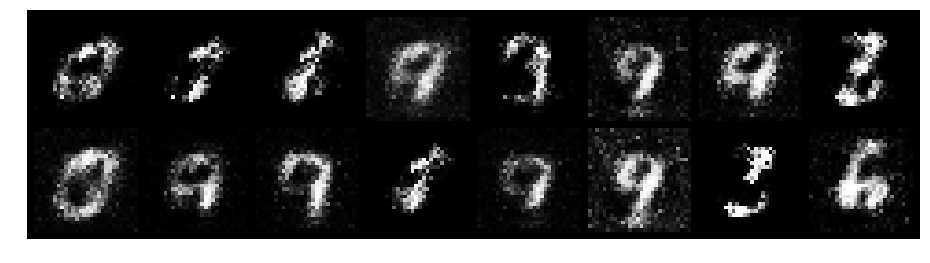

Epoch: [5/200], Batch Num: [800/938]
Discriminator Loss: 0.44003576040267944, Generator Loss: 2.613344192504883
D(x): 0.8143, D(G(z)): 0.1059


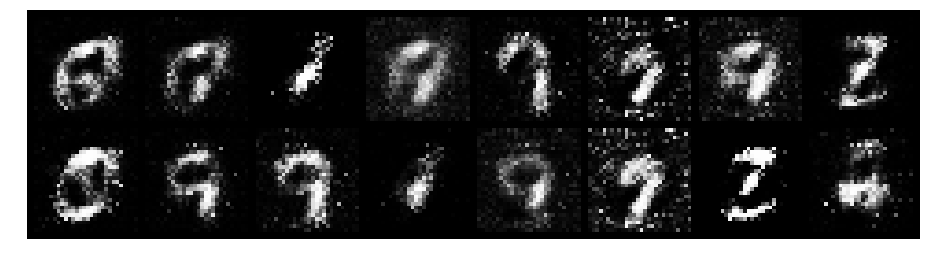

Epoch: [5/200], Batch Num: [900/938]
Discriminator Loss: 0.5751094818115234, Generator Loss: 2.107872486114502
D(x): 0.8744, D(G(z)): 0.2566


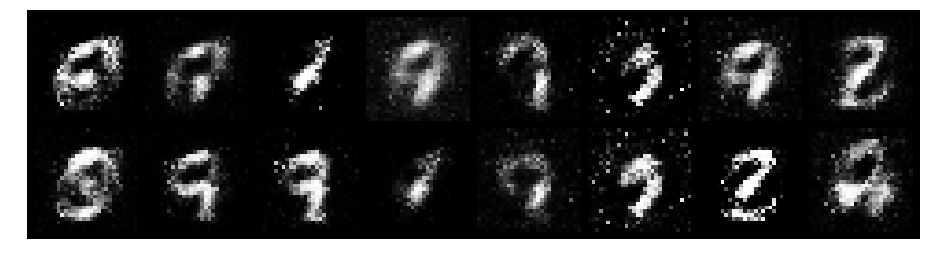

Epoch: [6/200], Batch Num: [0/938]
Discriminator Loss: 1.0806283950805664, Generator Loss: 1.5419087409973145
D(x): 0.7555, D(G(z)): 0.3680


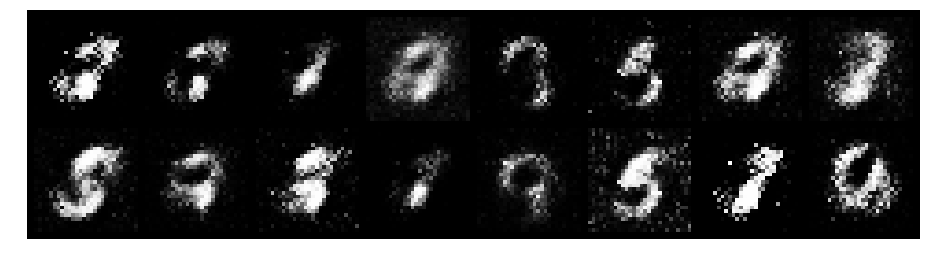

Epoch: [6/200], Batch Num: [100/938]
Discriminator Loss: 0.9883363246917725, Generator Loss: 2.004474639892578
D(x): 0.7074, D(G(z)): 0.2870


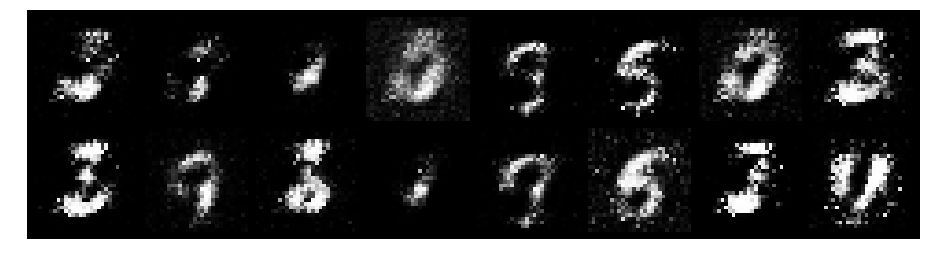

Epoch: [6/200], Batch Num: [200/938]
Discriminator Loss: 0.4189758896827698, Generator Loss: 2.608487129211426
D(x): 0.8232, D(G(z)): 0.1309


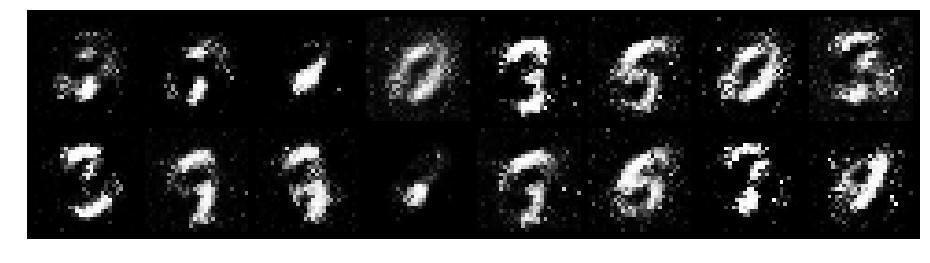

Epoch: [6/200], Batch Num: [300/938]
Discriminator Loss: 0.46520212292671204, Generator Loss: 1.6796965599060059
D(x): 0.8757, D(G(z)): 0.2238


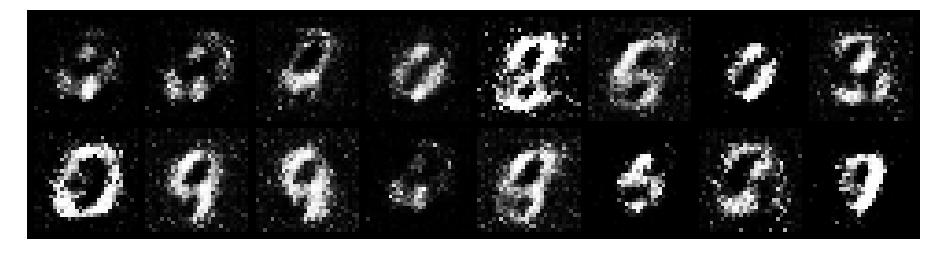

Epoch: [6/200], Batch Num: [400/938]
Discriminator Loss: 0.720826268196106, Generator Loss: 1.5907492637634277
D(x): 0.7514, D(G(z)): 0.2432


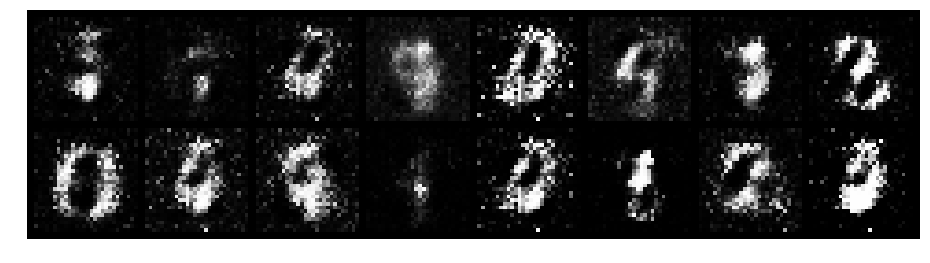

Epoch: [6/200], Batch Num: [500/938]
Discriminator Loss: 0.632898211479187, Generator Loss: 2.243258476257324
D(x): 0.7416, D(G(z)): 0.1043


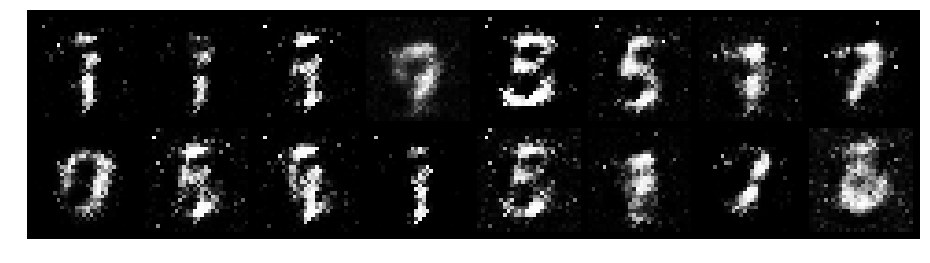

Epoch: [6/200], Batch Num: [600/938]
Discriminator Loss: 0.9401752948760986, Generator Loss: 1.4456359148025513
D(x): 0.6967, D(G(z)): 0.3450


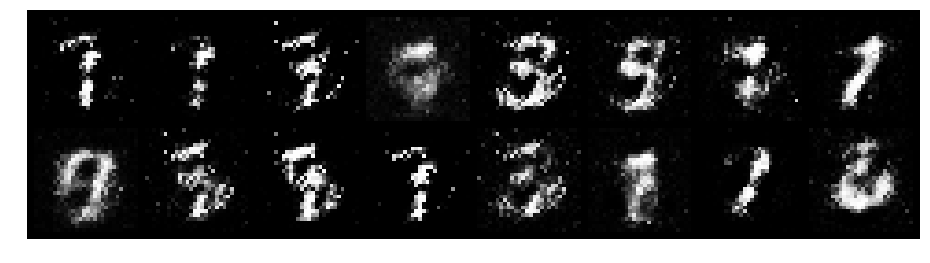

Epoch: [6/200], Batch Num: [700/938]
Discriminator Loss: 0.9450291395187378, Generator Loss: 1.7364501953125
D(x): 0.7147, D(G(z)): 0.3070


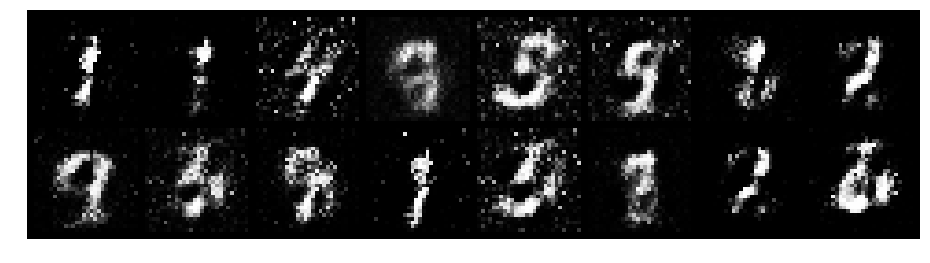

Epoch: [6/200], Batch Num: [800/938]
Discriminator Loss: 1.0571355819702148, Generator Loss: 1.614863395690918
D(x): 0.7131, D(G(z)): 0.3718


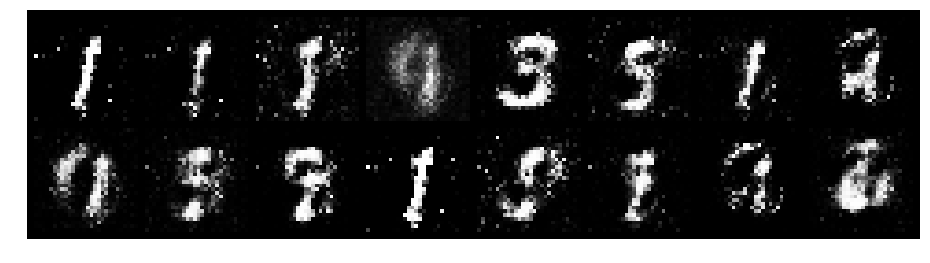

Epoch: [6/200], Batch Num: [900/938]
Discriminator Loss: 0.6913637518882751, Generator Loss: 2.5941922664642334
D(x): 0.8224, D(G(z)): 0.2600


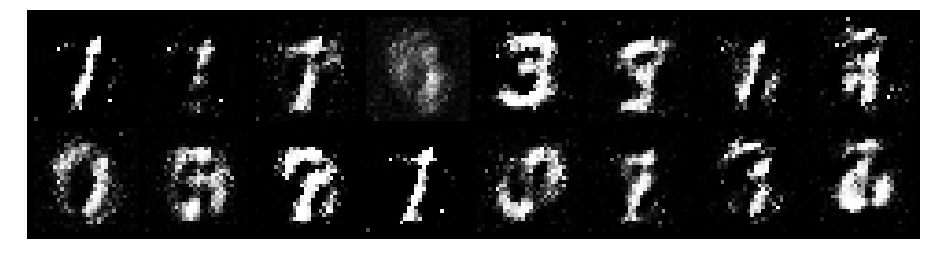

Epoch: [7/200], Batch Num: [0/938]
Discriminator Loss: 1.3519790172576904, Generator Loss: 1.5325778722763062
D(x): 0.8147, D(G(z)): 0.4790


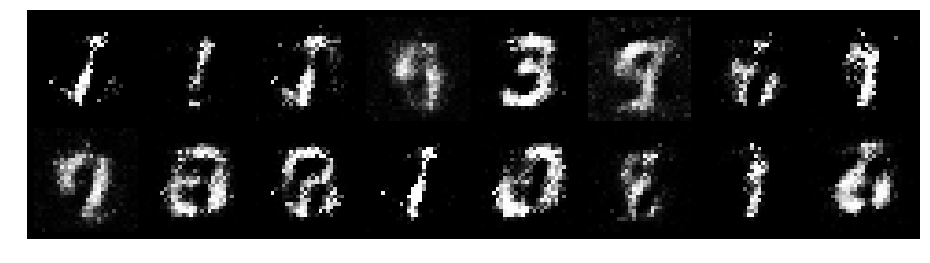

Epoch: [7/200], Batch Num: [100/938]
Discriminator Loss: 1.0191946029663086, Generator Loss: 2.017629384994507
D(x): 0.7610, D(G(z)): 0.3175


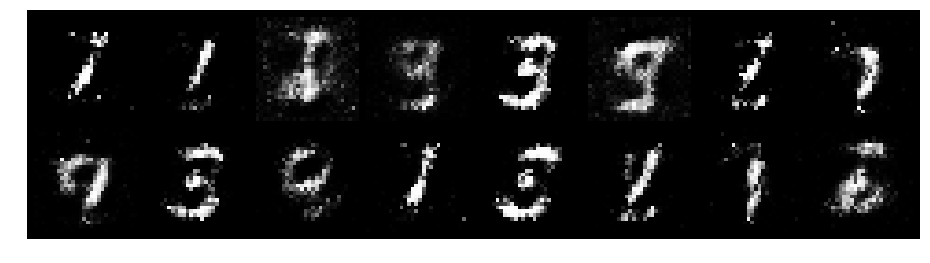

Epoch: [7/200], Batch Num: [200/938]
Discriminator Loss: 0.666822075843811, Generator Loss: 1.8578076362609863
D(x): 0.8319, D(G(z)): 0.2796


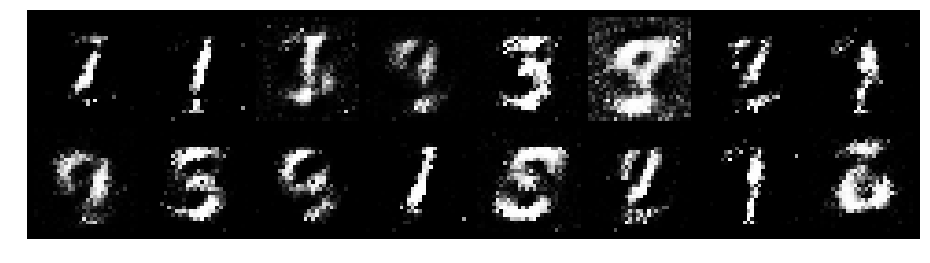

Epoch: [7/200], Batch Num: [300/938]
Discriminator Loss: 0.6596199870109558, Generator Loss: 1.9240695238113403
D(x): 0.8160, D(G(z)): 0.2332


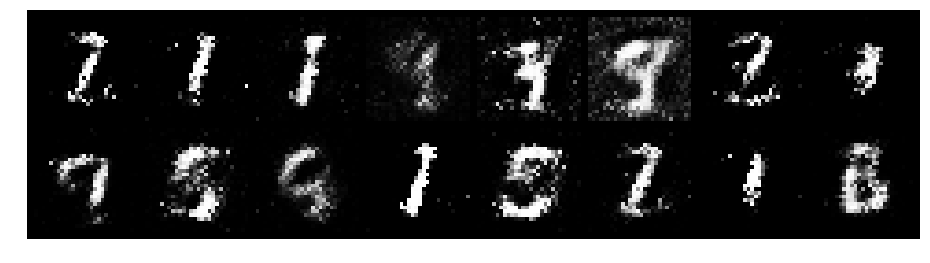

Epoch: [7/200], Batch Num: [400/938]
Discriminator Loss: 0.5986533164978027, Generator Loss: 1.9566748142242432
D(x): 0.8729, D(G(z)): 0.2643


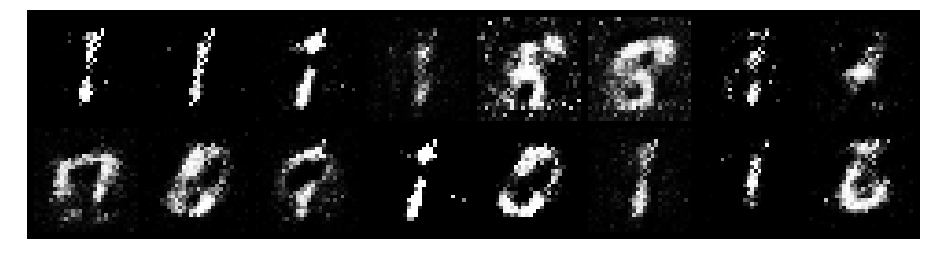

Epoch: [7/200], Batch Num: [500/938]
Discriminator Loss: 0.6306681632995605, Generator Loss: 2.25351619720459
D(x): 0.7993, D(G(z)): 0.2371


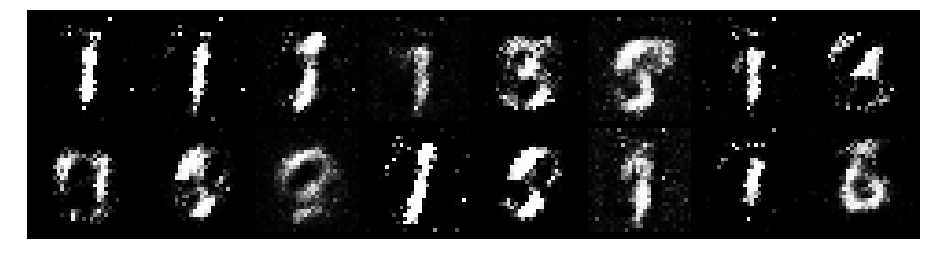

Epoch: [7/200], Batch Num: [600/938]
Discriminator Loss: 0.595272421836853, Generator Loss: 2.122969627380371
D(x): 0.8245, D(G(z)): 0.2246


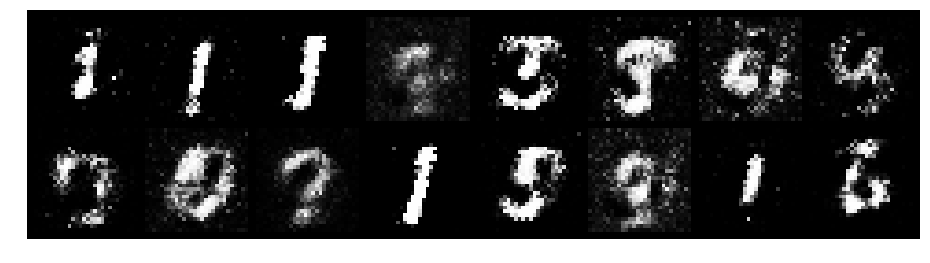

Epoch: [7/200], Batch Num: [700/938]
Discriminator Loss: 0.7872441411018372, Generator Loss: 1.879215955734253
D(x): 0.8233, D(G(z)): 0.3077


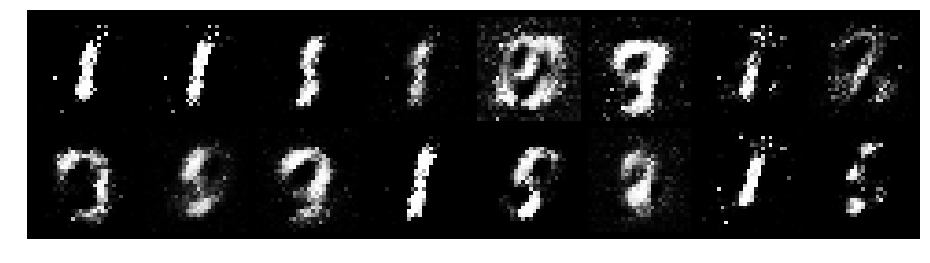

Epoch: [7/200], Batch Num: [800/938]
Discriminator Loss: 1.0112807750701904, Generator Loss: 1.7586760520935059
D(x): 0.6942, D(G(z)): 0.3156


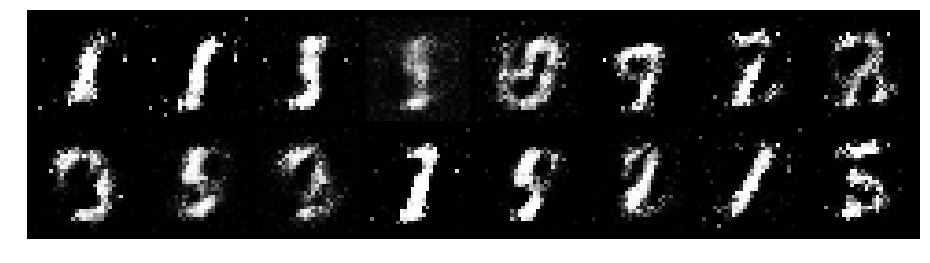

Epoch: [7/200], Batch Num: [900/938]
Discriminator Loss: 0.7496874332427979, Generator Loss: 1.989601731300354
D(x): 0.8007, D(G(z)): 0.2794


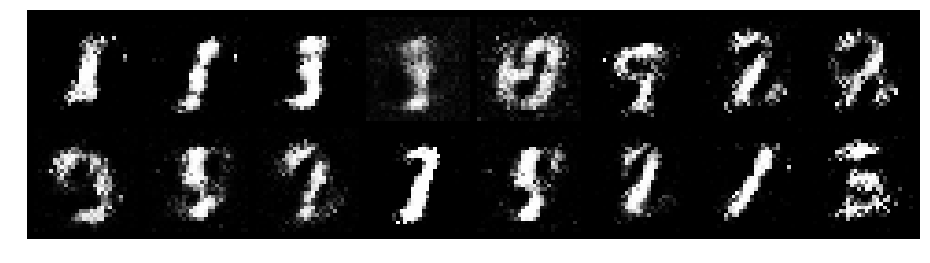

Epoch: [8/200], Batch Num: [0/938]
Discriminator Loss: 1.0359437465667725, Generator Loss: 2.730825185775757
D(x): 0.6878, D(G(z)): 0.2532


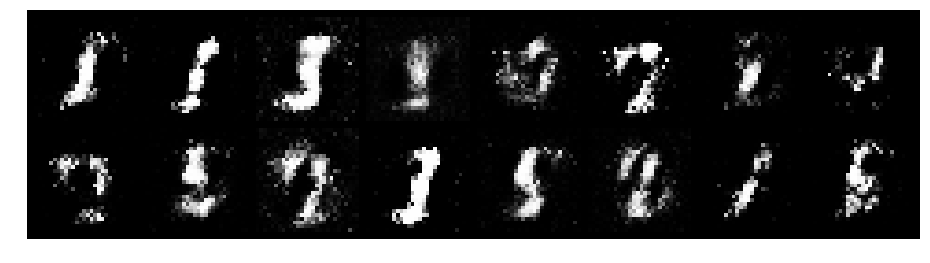

Epoch: [8/200], Batch Num: [100/938]
Discriminator Loss: 0.41395485401153564, Generator Loss: 2.043950080871582
D(x): 0.8647, D(G(z)): 0.1569


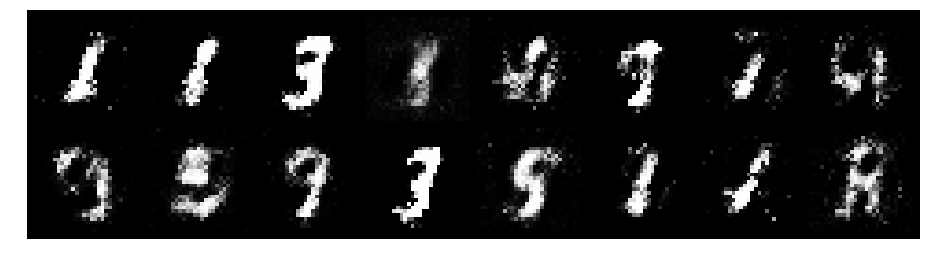

Epoch: [8/200], Batch Num: [200/938]
Discriminator Loss: 0.7975775599479675, Generator Loss: 1.5340583324432373
D(x): 0.8176, D(G(z)): 0.3028


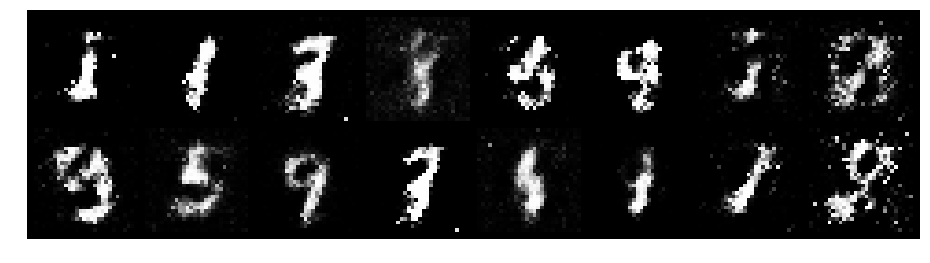

Epoch: [8/200], Batch Num: [300/938]
Discriminator Loss: 0.767103910446167, Generator Loss: 1.9281033277511597
D(x): 0.7402, D(G(z)): 0.2404


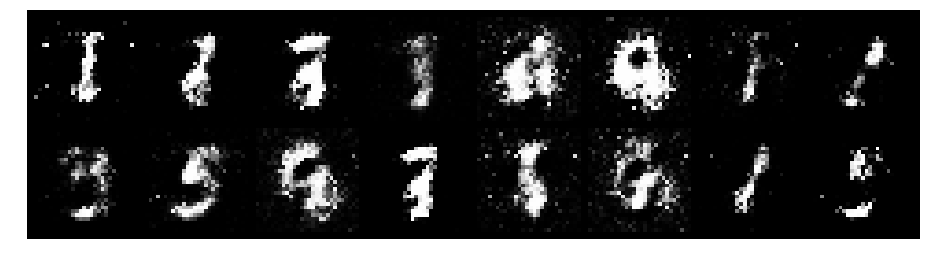

Epoch: [8/200], Batch Num: [400/938]
Discriminator Loss: 0.7123218774795532, Generator Loss: 1.8937408924102783
D(x): 0.7271, D(G(z)): 0.2454


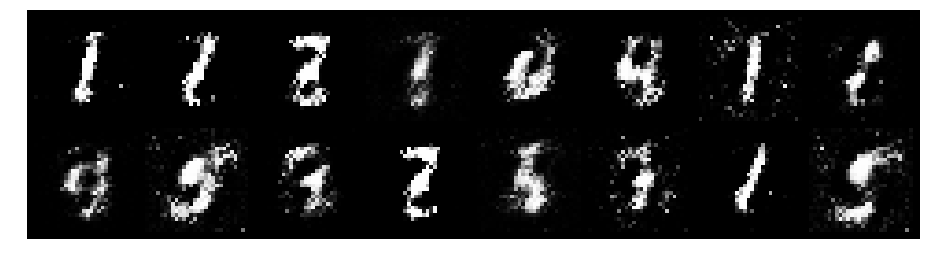

Epoch: [8/200], Batch Num: [500/938]
Discriminator Loss: 0.768563449382782, Generator Loss: 1.9938908815383911
D(x): 0.7117, D(G(z)): 0.1973


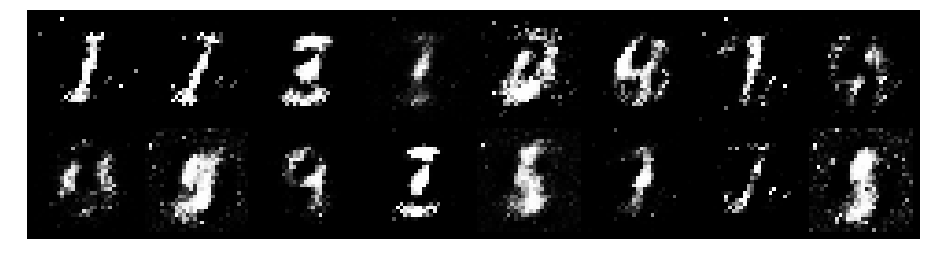

Epoch: [8/200], Batch Num: [600/938]
Discriminator Loss: 0.8914206027984619, Generator Loss: 1.743085503578186
D(x): 0.6771, D(G(z)): 0.2834


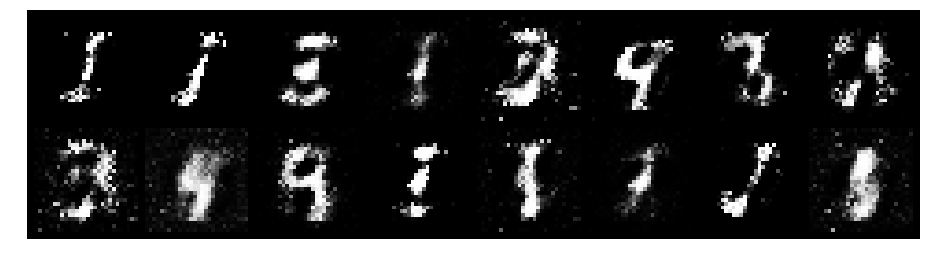

Epoch: [8/200], Batch Num: [700/938]
Discriminator Loss: 0.8796119689941406, Generator Loss: 1.7329530715942383
D(x): 0.7181, D(G(z)): 0.2759


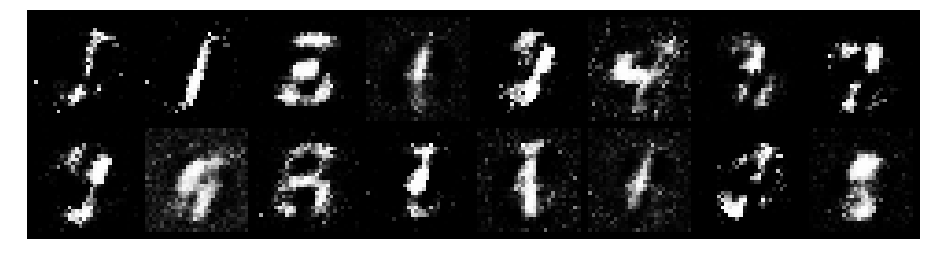

Epoch: [8/200], Batch Num: [800/938]
Discriminator Loss: 0.7905301451683044, Generator Loss: 2.47979474067688
D(x): 0.6867, D(G(z)): 0.1585


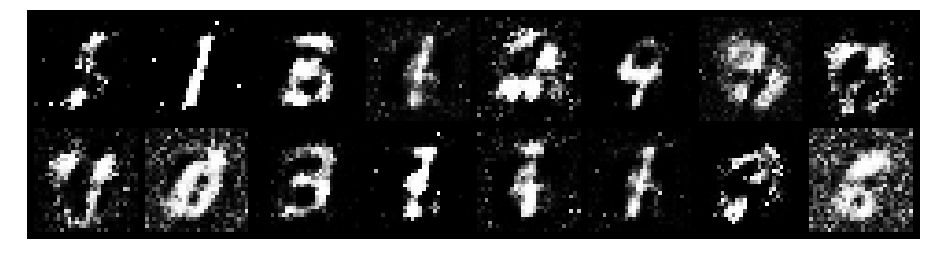

Epoch: [8/200], Batch Num: [900/938]
Discriminator Loss: 0.9092026948928833, Generator Loss: 1.920229434967041
D(x): 0.7605, D(G(z)): 0.2844


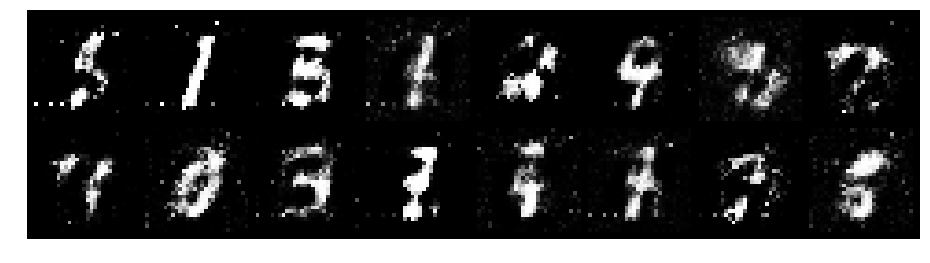

Epoch: [9/200], Batch Num: [0/938]
Discriminator Loss: 0.8594117164611816, Generator Loss: 1.7455778121948242
D(x): 0.6794, D(G(z)): 0.2315


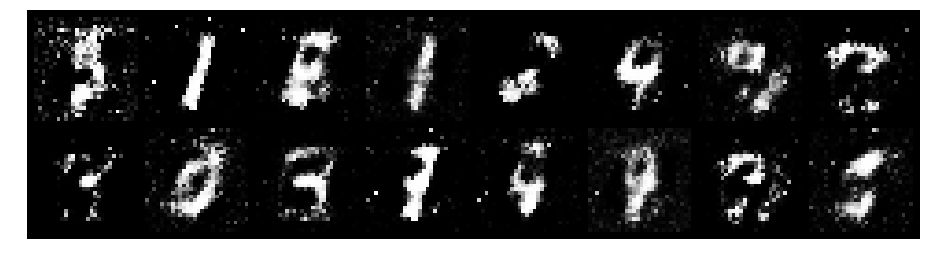

Epoch: [9/200], Batch Num: [100/938]
Discriminator Loss: 0.9544560313224792, Generator Loss: 2.1683709621429443
D(x): 0.6032, D(G(z)): 0.1572


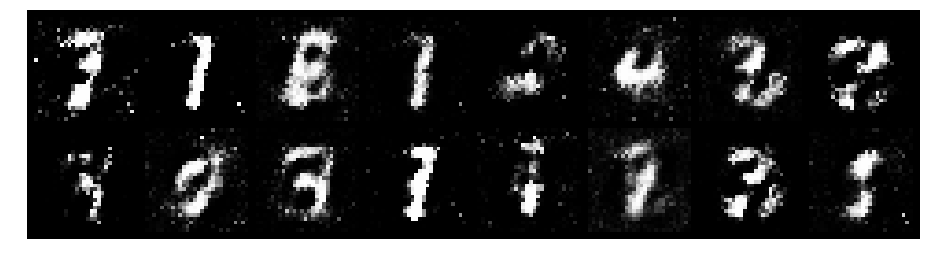

Epoch: [9/200], Batch Num: [200/938]
Discriminator Loss: 0.5981490612030029, Generator Loss: 2.289398193359375
D(x): 0.7938, D(G(z)): 0.1718


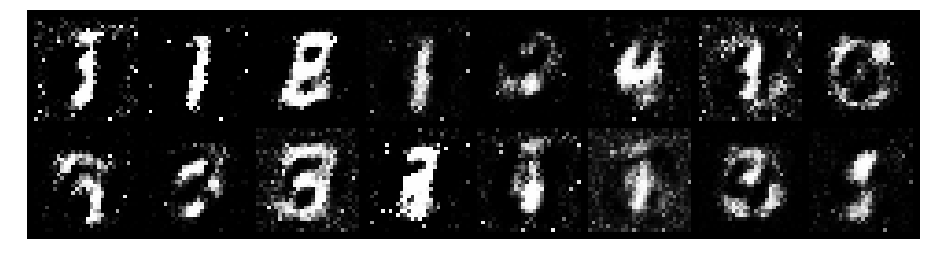

Epoch: [9/200], Batch Num: [300/938]
Discriminator Loss: 1.0625007152557373, Generator Loss: 2.146172046661377
D(x): 0.6826, D(G(z)): 0.2748


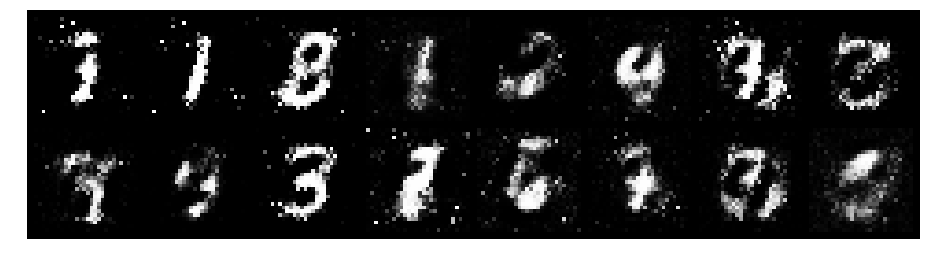

Epoch: [9/200], Batch Num: [400/938]
Discriminator Loss: 0.6394575834274292, Generator Loss: 2.018899917602539
D(x): 0.7360, D(G(z)): 0.1788


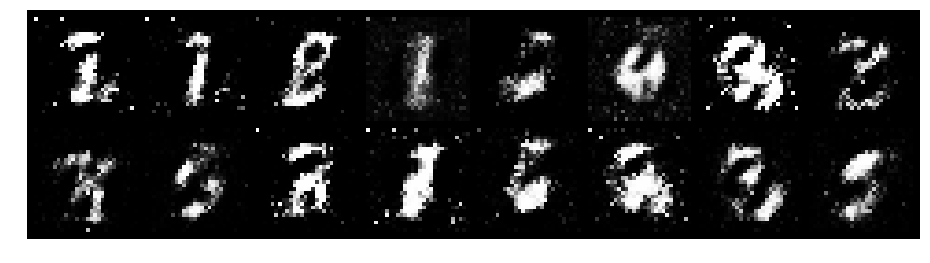

Epoch: [9/200], Batch Num: [500/938]
Discriminator Loss: 0.8694756031036377, Generator Loss: 2.055698871612549
D(x): 0.7832, D(G(z)): 0.3106


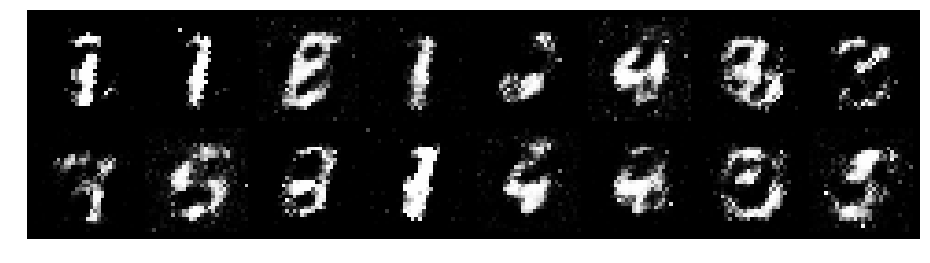

Epoch: [9/200], Batch Num: [600/938]
Discriminator Loss: 0.8544567227363586, Generator Loss: 1.9159908294677734
D(x): 0.6859, D(G(z)): 0.2368


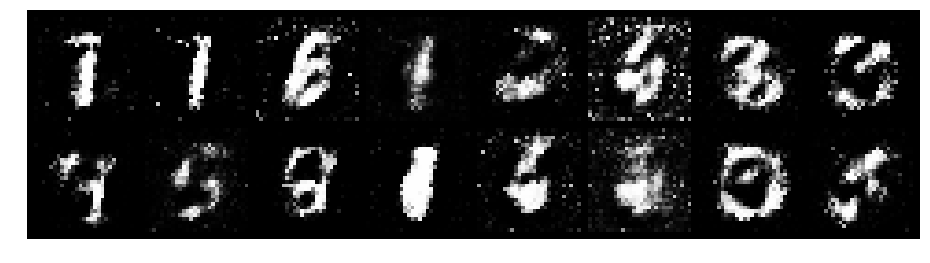

Epoch: [9/200], Batch Num: [700/938]
Discriminator Loss: 0.8615903854370117, Generator Loss: 1.741288423538208
D(x): 0.6872, D(G(z)): 0.2664


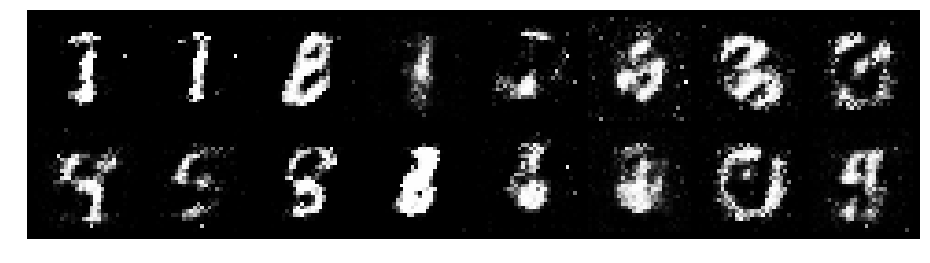

Epoch: [9/200], Batch Num: [800/938]
Discriminator Loss: 0.8996001482009888, Generator Loss: 2.009726047515869
D(x): 0.7387, D(G(z)): 0.2641


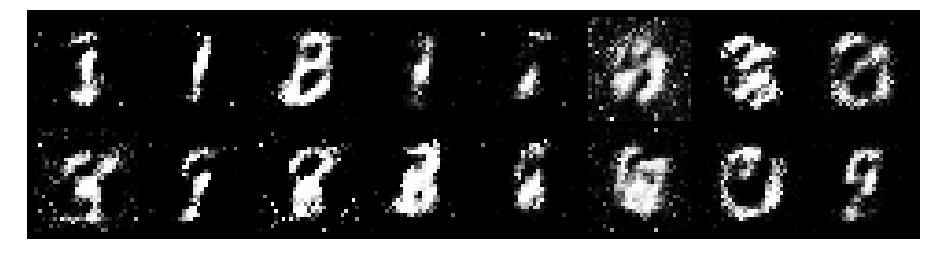

Epoch: [9/200], Batch Num: [900/938]
Discriminator Loss: 0.7640160322189331, Generator Loss: 2.3034286499023438
D(x): 0.7522, D(G(z)): 0.2301


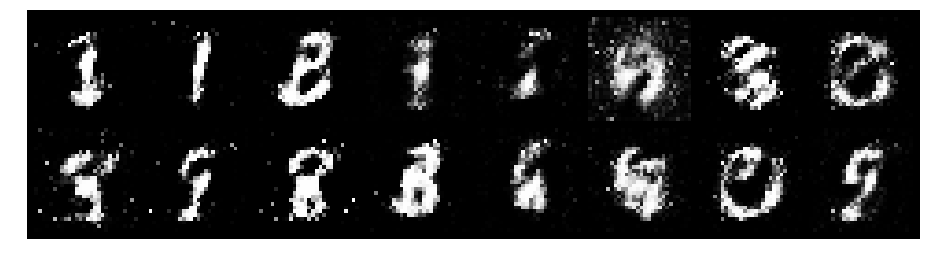

Epoch: [10/200], Batch Num: [0/938]
Discriminator Loss: 0.9031631946563721, Generator Loss: 1.8395718336105347
D(x): 0.7269, D(G(z)): 0.2910


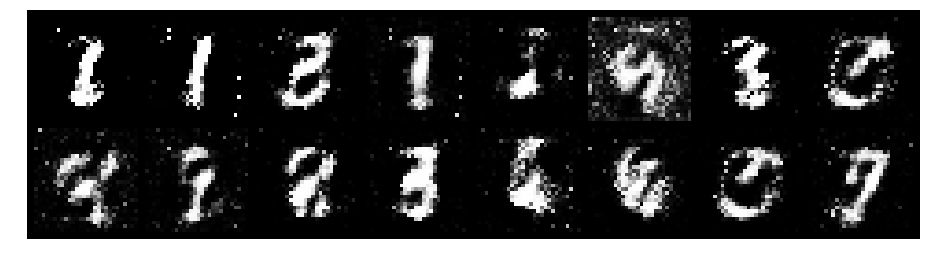

Epoch: [10/200], Batch Num: [100/938]
Discriminator Loss: 0.8192169666290283, Generator Loss: 1.2729523181915283
D(x): 0.7854, D(G(z)): 0.3240


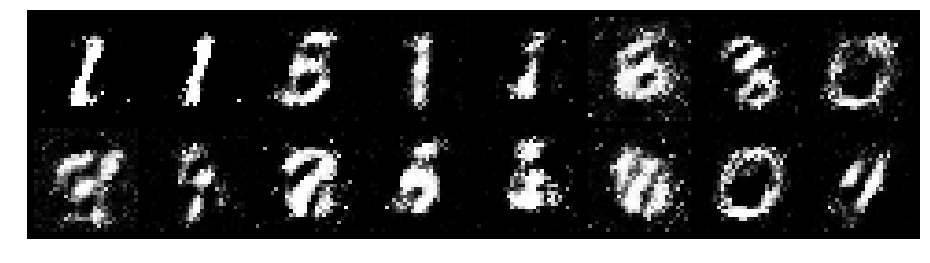

Epoch: [10/200], Batch Num: [200/938]
Discriminator Loss: 1.1038010120391846, Generator Loss: 1.3286933898925781
D(x): 0.6185, D(G(z)): 0.3683


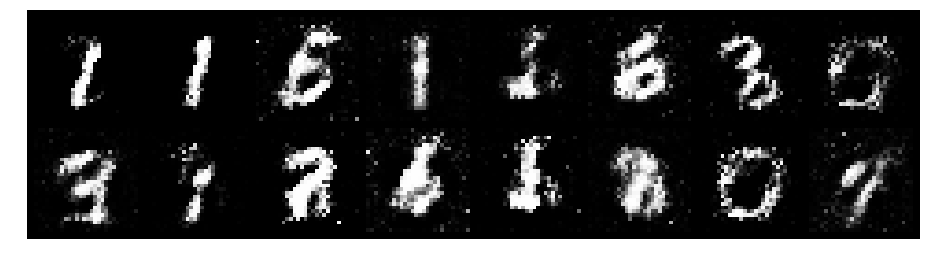

Epoch: [10/200], Batch Num: [300/938]
Discriminator Loss: 0.8823913931846619, Generator Loss: 1.4042158126831055
D(x): 0.7206, D(G(z)): 0.2997


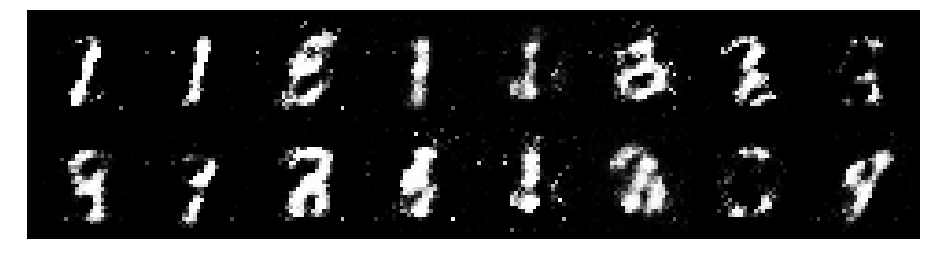

Epoch: [10/200], Batch Num: [400/938]
Discriminator Loss: 1.1015650033950806, Generator Loss: 1.488885521888733
D(x): 0.5520, D(G(z)): 0.2227


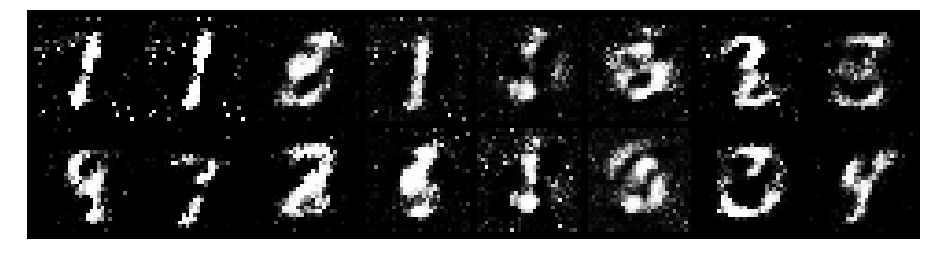

Epoch: [10/200], Batch Num: [500/938]
Discriminator Loss: 0.837029218673706, Generator Loss: 1.2536371946334839
D(x): 0.6658, D(G(z)): 0.2380


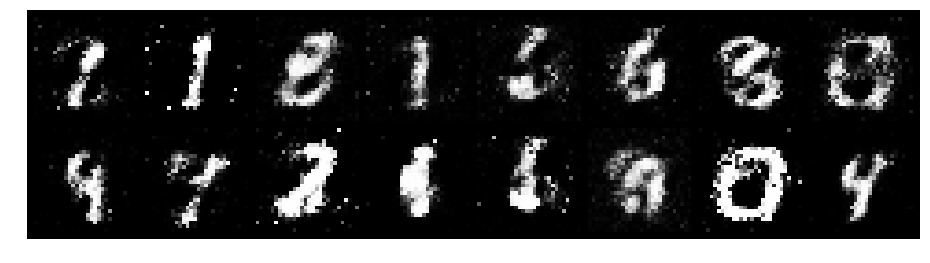

Epoch: [10/200], Batch Num: [600/938]
Discriminator Loss: 0.8044425249099731, Generator Loss: 1.5743019580841064
D(x): 0.7127, D(G(z)): 0.2753


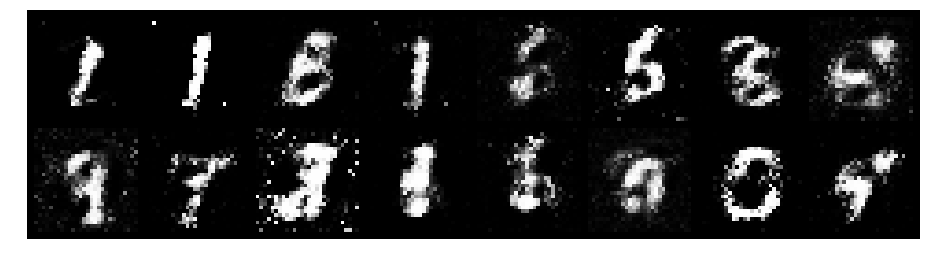

Epoch: [10/200], Batch Num: [700/938]
Discriminator Loss: 1.2580348253250122, Generator Loss: 1.5316869020462036
D(x): 0.5409, D(G(z)): 0.3194


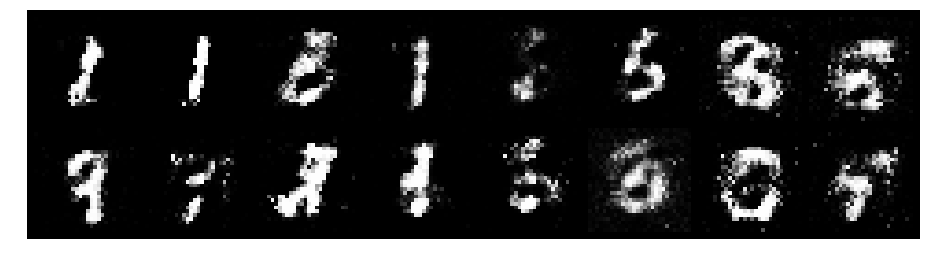

Epoch: [10/200], Batch Num: [800/938]
Discriminator Loss: 1.499403476715088, Generator Loss: 1.1746907234191895
D(x): 0.6359, D(G(z)): 0.4432


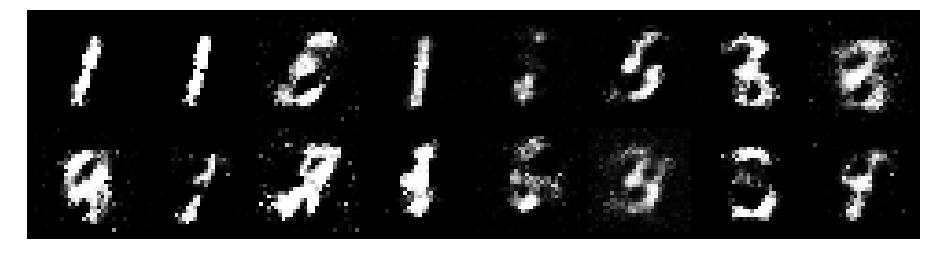

Epoch: [10/200], Batch Num: [900/938]
Discriminator Loss: 0.9727758765220642, Generator Loss: 1.643078088760376
D(x): 0.6933, D(G(z)): 0.3034


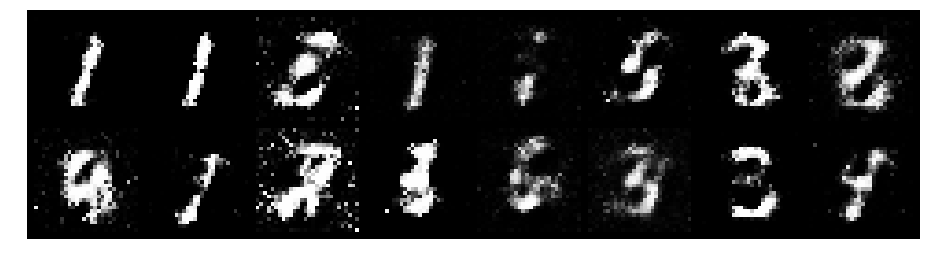

Epoch: [11/200], Batch Num: [0/938]
Discriminator Loss: 0.9646353721618652, Generator Loss: 1.9774402379989624
D(x): 0.6922, D(G(z)): 0.3021


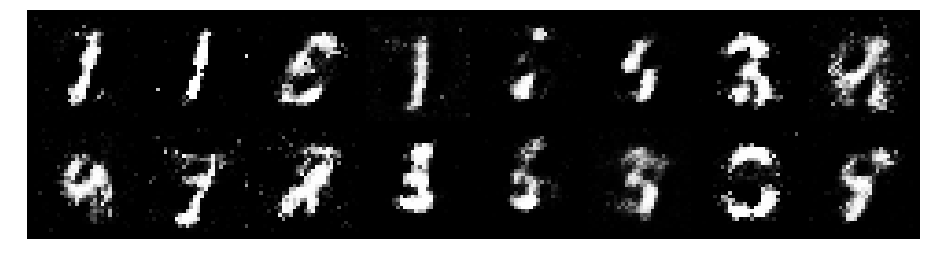

Epoch: [11/200], Batch Num: [100/938]
Discriminator Loss: 1.0004446506500244, Generator Loss: 1.8116204738616943
D(x): 0.7357, D(G(z)): 0.3190


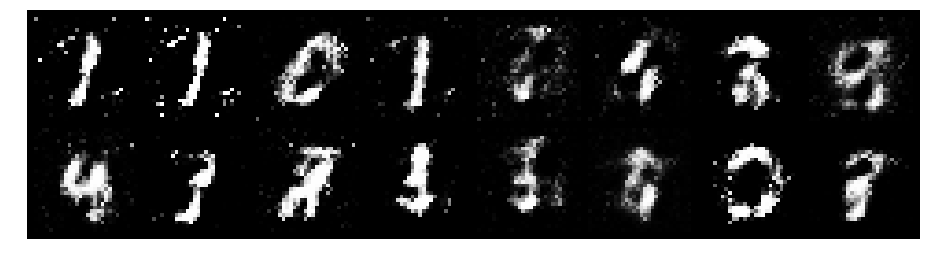

Epoch: [11/200], Batch Num: [200/938]
Discriminator Loss: 0.8644241094589233, Generator Loss: 2.011153221130371
D(x): 0.7592, D(G(z)): 0.2772


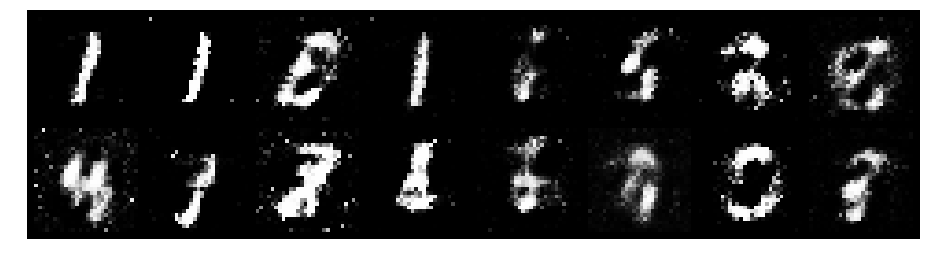

Epoch: [11/200], Batch Num: [300/938]
Discriminator Loss: 0.7886592149734497, Generator Loss: 2.196275472640991
D(x): 0.7295, D(G(z)): 0.2396


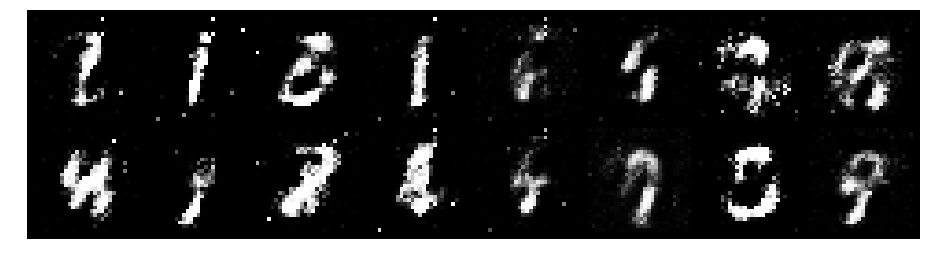

Epoch: [11/200], Batch Num: [400/938]
Discriminator Loss: 0.6159833669662476, Generator Loss: 1.5881879329681396
D(x): 0.7304, D(G(z)): 0.1926


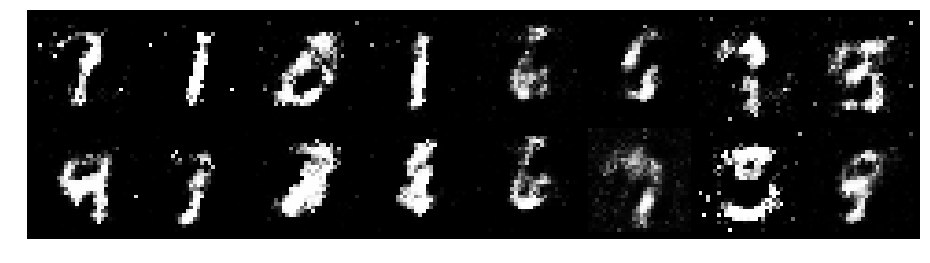

Epoch: [11/200], Batch Num: [500/938]
Discriminator Loss: 0.976841390132904, Generator Loss: 1.786400556564331
D(x): 0.6730, D(G(z)): 0.2893


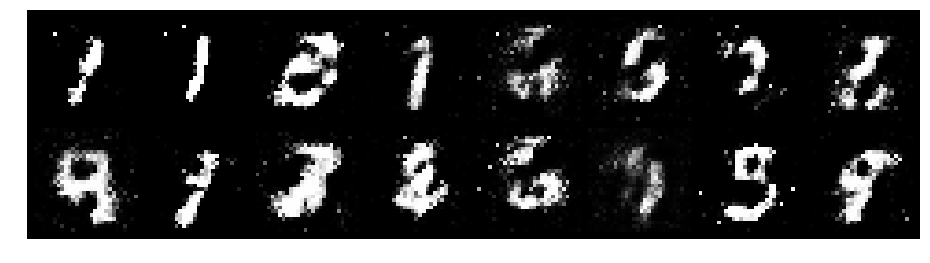

Epoch: [11/200], Batch Num: [600/938]
Discriminator Loss: 0.9818692207336426, Generator Loss: 1.8385686874389648
D(x): 0.6471, D(G(z)): 0.2502


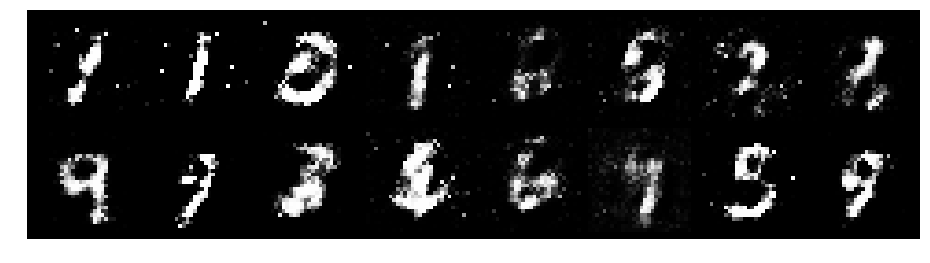

Epoch: [11/200], Batch Num: [700/938]
Discriminator Loss: 0.8022533655166626, Generator Loss: 1.7950174808502197
D(x): 0.6948, D(G(z)): 0.2097


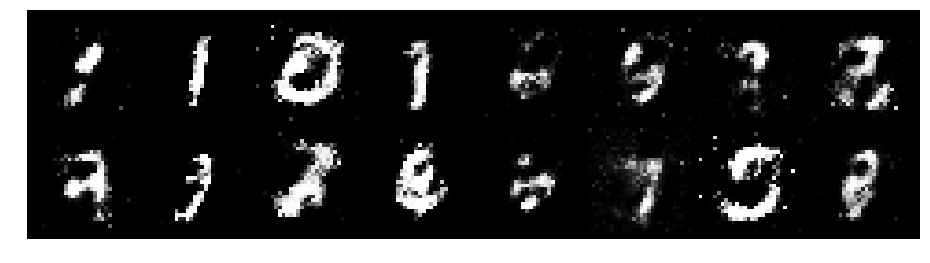

Epoch: [11/200], Batch Num: [800/938]
Discriminator Loss: 0.8307995796203613, Generator Loss: 1.5572457313537598
D(x): 0.7211, D(G(z)): 0.2764


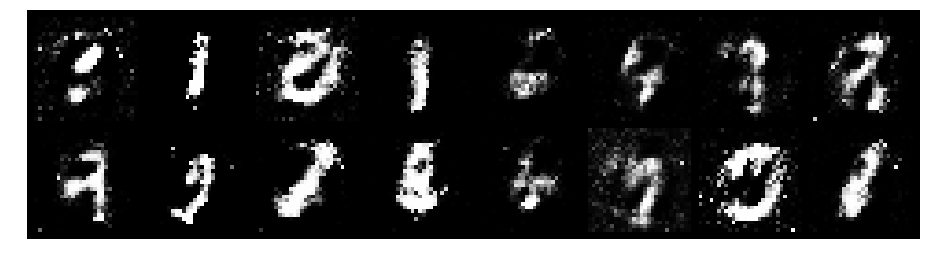

Epoch: [11/200], Batch Num: [900/938]
Discriminator Loss: 0.6463594436645508, Generator Loss: 2.0821266174316406
D(x): 0.7871, D(G(z)): 0.2284


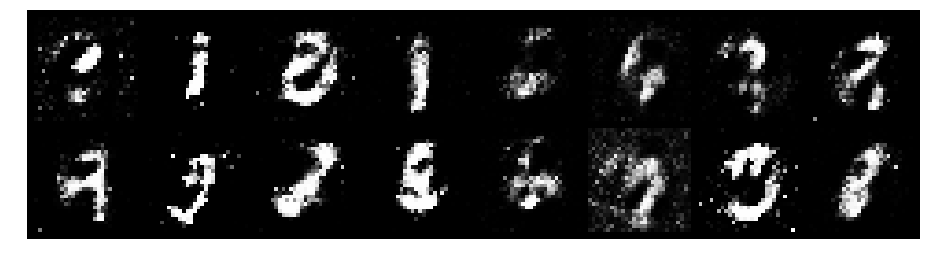

Epoch: [12/200], Batch Num: [0/938]
Discriminator Loss: 0.5762854814529419, Generator Loss: 1.643723487854004
D(x): 0.7737, D(G(z)): 0.2097


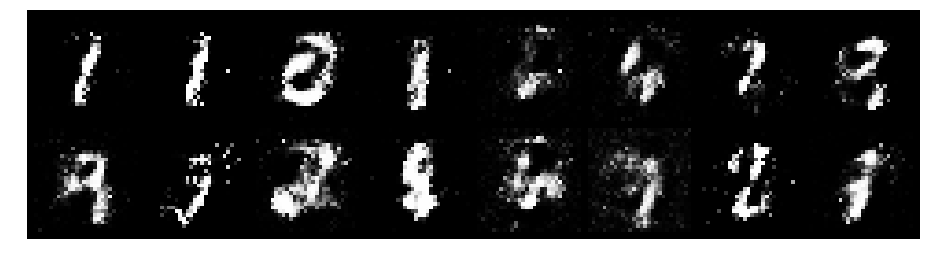

Epoch: [12/200], Batch Num: [100/938]
Discriminator Loss: 0.8593407273292542, Generator Loss: 1.5264776945114136
D(x): 0.6721, D(G(z)): 0.2615


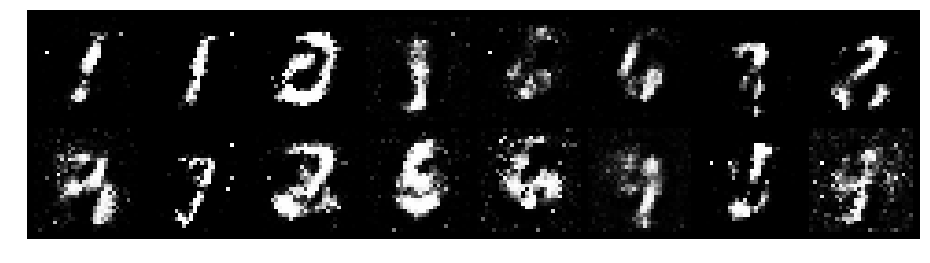

Epoch: [12/200], Batch Num: [200/938]
Discriminator Loss: 0.8986525535583496, Generator Loss: 1.4234846830368042
D(x): 0.7376, D(G(z)): 0.3153


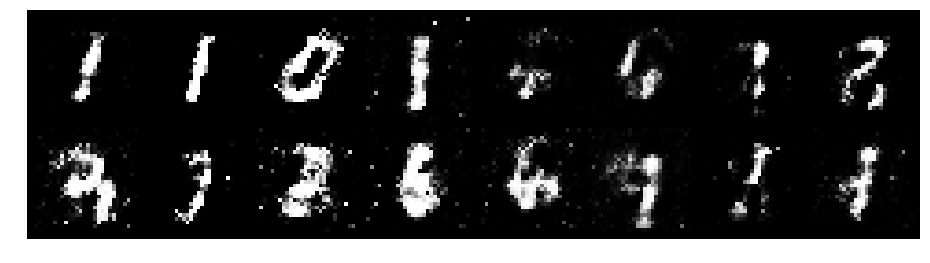

Epoch: [12/200], Batch Num: [300/938]
Discriminator Loss: 0.9903473854064941, Generator Loss: 1.3380849361419678
D(x): 0.6742, D(G(z)): 0.2973


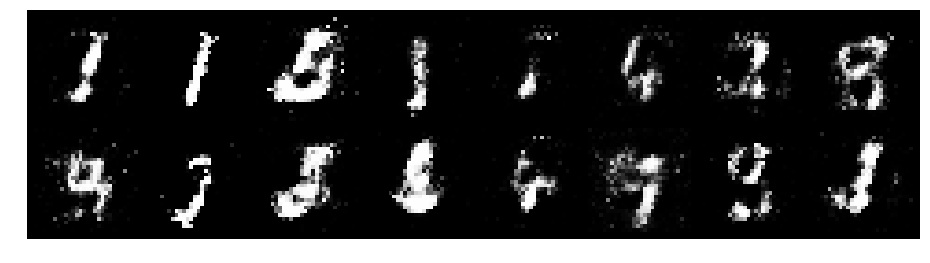

Epoch: [12/200], Batch Num: [400/938]
Discriminator Loss: 1.012144923210144, Generator Loss: 1.4481942653656006
D(x): 0.7519, D(G(z)): 0.3587


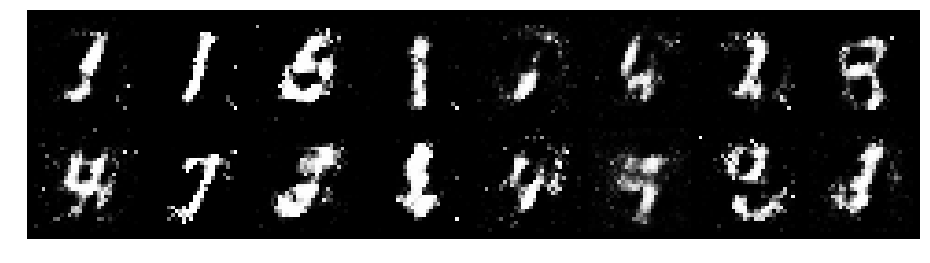

Epoch: [12/200], Batch Num: [500/938]
Discriminator Loss: 1.0010180473327637, Generator Loss: 1.3745613098144531
D(x): 0.6656, D(G(z)): 0.2852


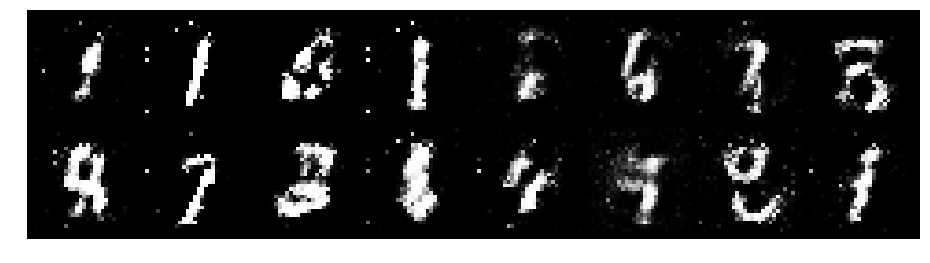

Epoch: [12/200], Batch Num: [600/938]
Discriminator Loss: 0.846174955368042, Generator Loss: 1.9072210788726807
D(x): 0.7584, D(G(z)): 0.3017


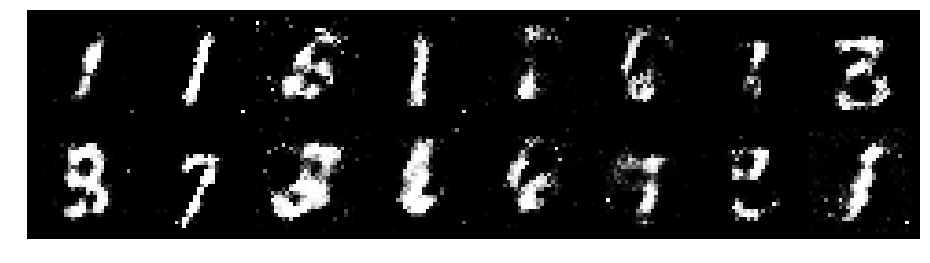

Epoch: [12/200], Batch Num: [700/938]
Discriminator Loss: 0.8404772877693176, Generator Loss: 1.8338618278503418
D(x): 0.6989, D(G(z)): 0.2451


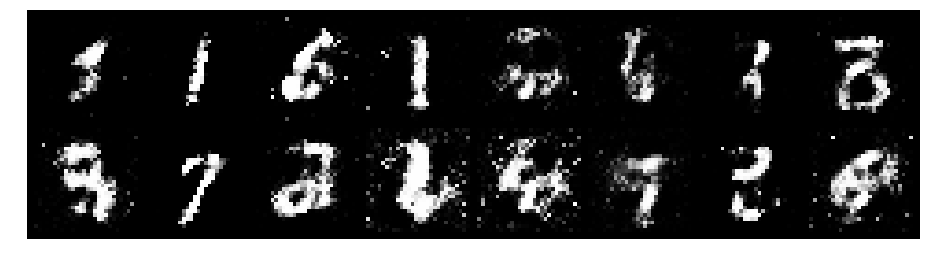

Epoch: [12/200], Batch Num: [800/938]
Discriminator Loss: 0.8135477900505066, Generator Loss: 1.9673689603805542
D(x): 0.6789, D(G(z)): 0.2335


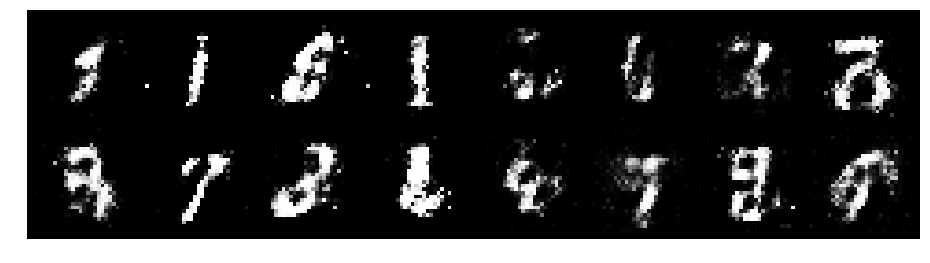

Epoch: [12/200], Batch Num: [900/938]
Discriminator Loss: 0.8540728092193604, Generator Loss: 1.7950940132141113
D(x): 0.7275, D(G(z)): 0.2904


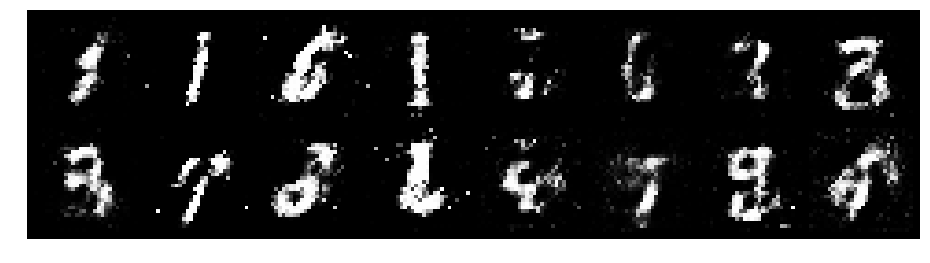

Epoch: [13/200], Batch Num: [0/938]
Discriminator Loss: 1.1395279169082642, Generator Loss: 1.8980655670166016
D(x): 0.6962, D(G(z)): 0.3468


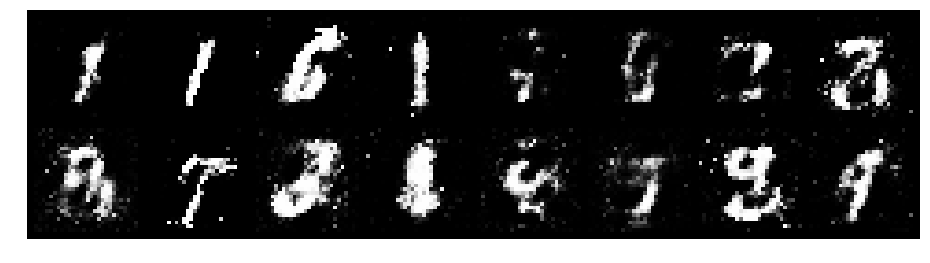

Epoch: [13/200], Batch Num: [100/938]
Discriminator Loss: 0.7766716480255127, Generator Loss: 1.6042993068695068
D(x): 0.7667, D(G(z)): 0.2776


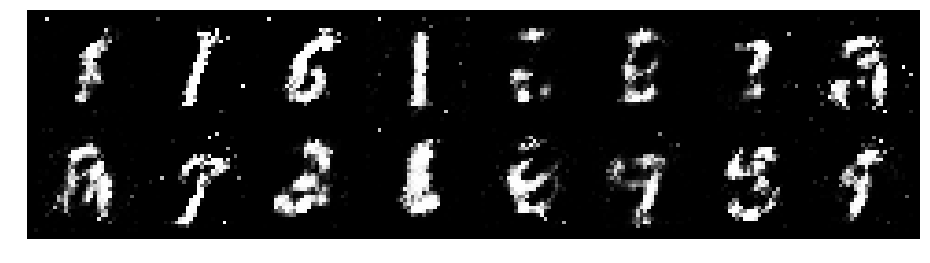

Epoch: [13/200], Batch Num: [200/938]
Discriminator Loss: 0.8223719000816345, Generator Loss: 1.7037672996520996
D(x): 0.6885, D(G(z)): 0.2407


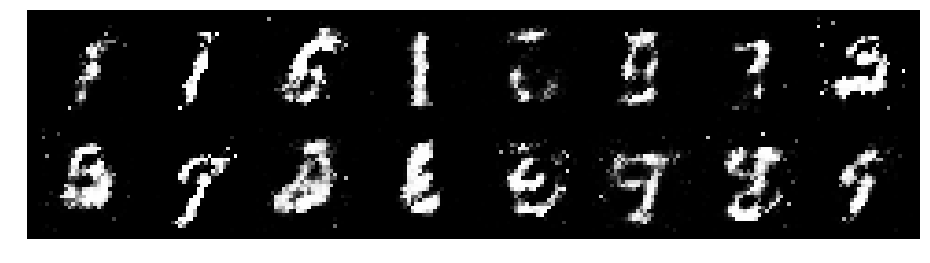

Epoch: [13/200], Batch Num: [300/938]
Discriminator Loss: 0.7672236561775208, Generator Loss: 1.5496785640716553
D(x): 0.8151, D(G(z)): 0.3384


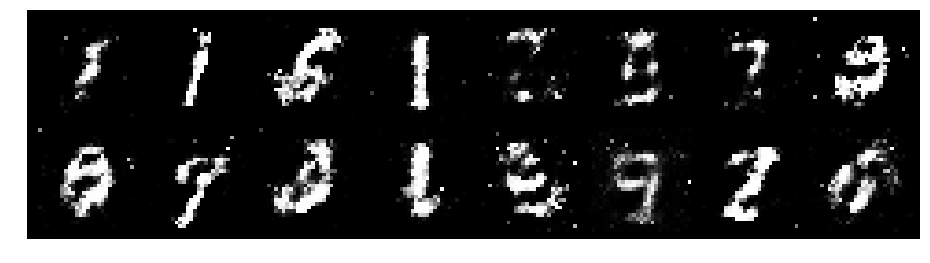

Epoch: [13/200], Batch Num: [400/938]
Discriminator Loss: 0.8955546617507935, Generator Loss: 1.5302571058273315
D(x): 0.6726, D(G(z)): 0.2960


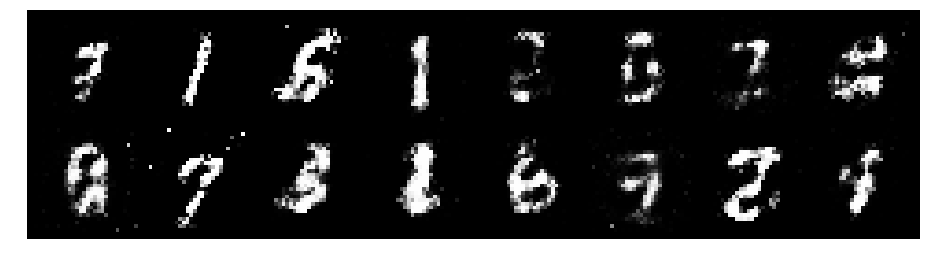

Epoch: [13/200], Batch Num: [500/938]
Discriminator Loss: 1.0471527576446533, Generator Loss: 1.2272251844406128
D(x): 0.7355, D(G(z)): 0.4091


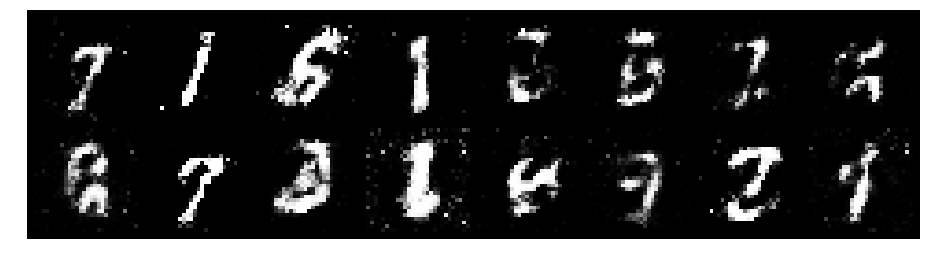

Epoch: [13/200], Batch Num: [600/938]
Discriminator Loss: 1.1454432010650635, Generator Loss: 1.3422703742980957
D(x): 0.5912, D(G(z)): 0.3071


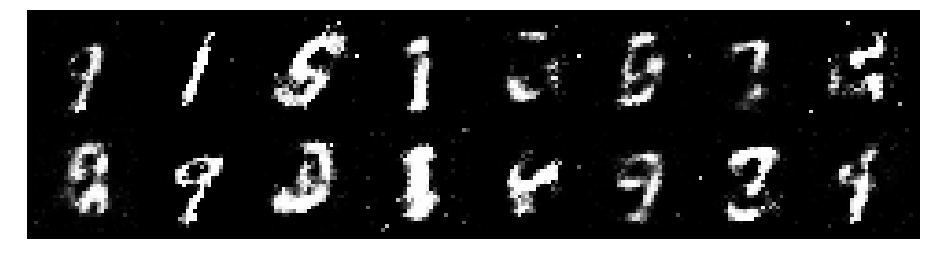

Epoch: [13/200], Batch Num: [700/938]
Discriminator Loss: 0.9439672231674194, Generator Loss: 1.5660045146942139
D(x): 0.6860, D(G(z)): 0.3164


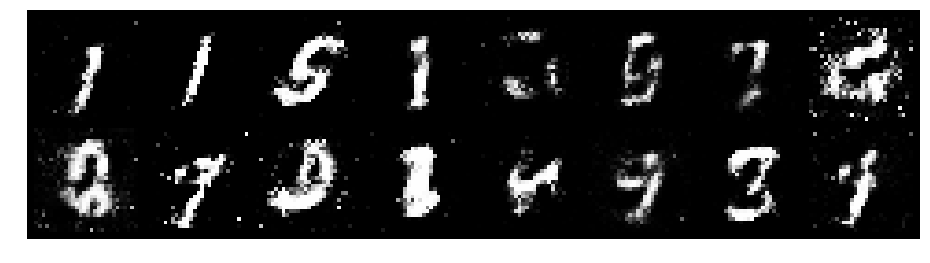

Epoch: [13/200], Batch Num: [800/938]
Discriminator Loss: 0.9916470050811768, Generator Loss: 1.5344536304473877
D(x): 0.6518, D(G(z)): 0.3021


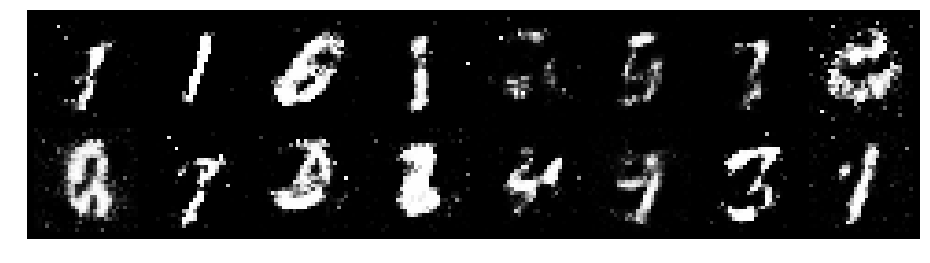

Epoch: [13/200], Batch Num: [900/938]
Discriminator Loss: 1.0559382438659668, Generator Loss: 1.5868024826049805
D(x): 0.7031, D(G(z)): 0.3452


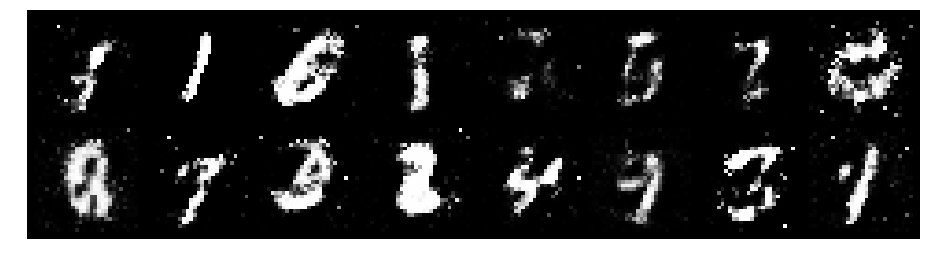

Epoch: [14/200], Batch Num: [0/938]
Discriminator Loss: 0.7395048141479492, Generator Loss: 1.489804983139038
D(x): 0.8219, D(G(z)): 0.3551


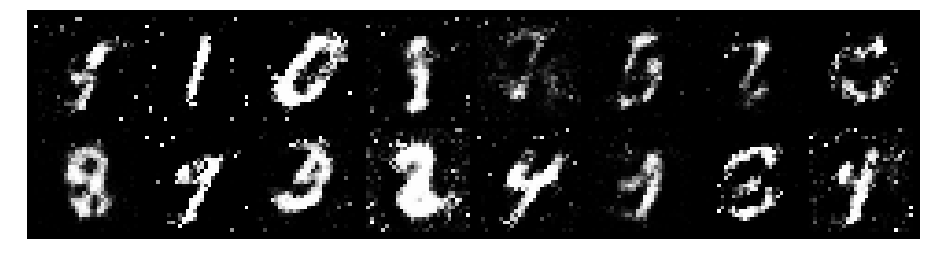

Epoch: [14/200], Batch Num: [100/938]
Discriminator Loss: 0.8694275617599487, Generator Loss: 1.2616922855377197
D(x): 0.7356, D(G(z)): 0.3417


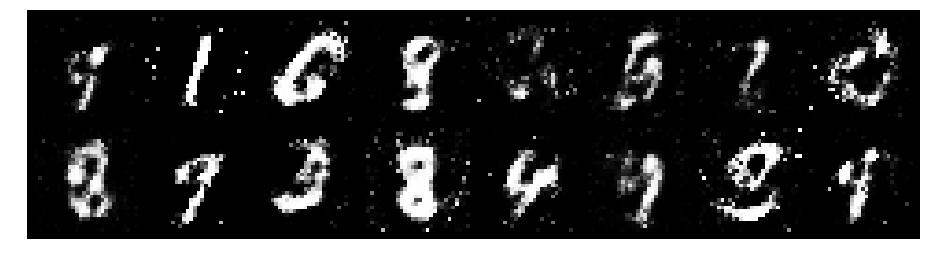

Epoch: [14/200], Batch Num: [200/938]
Discriminator Loss: 1.2450376749038696, Generator Loss: 1.1327810287475586
D(x): 0.6520, D(G(z)): 0.3716


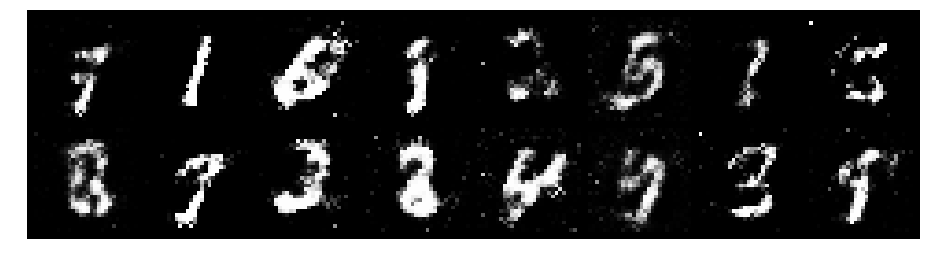

Epoch: [14/200], Batch Num: [300/938]
Discriminator Loss: 0.9081350564956665, Generator Loss: 1.4804478883743286
D(x): 0.7014, D(G(z)): 0.3316


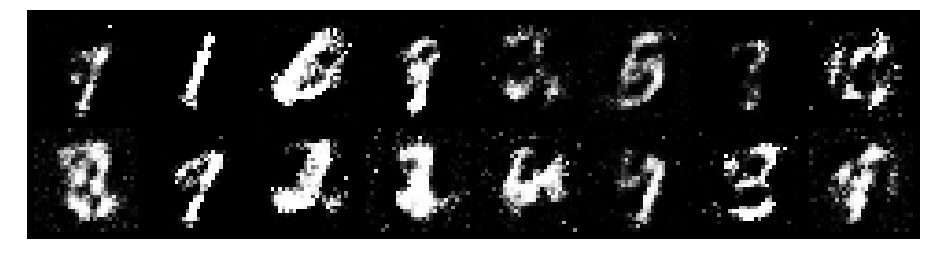

Epoch: [14/200], Batch Num: [400/938]
Discriminator Loss: 0.8868077993392944, Generator Loss: 1.553642749786377
D(x): 0.7302, D(G(z)): 0.3548


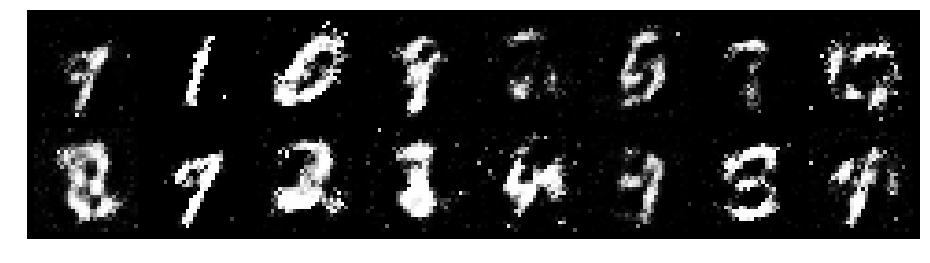

Epoch: [14/200], Batch Num: [500/938]
Discriminator Loss: 1.046090841293335, Generator Loss: 1.2952595949172974
D(x): 0.7449, D(G(z)): 0.4069


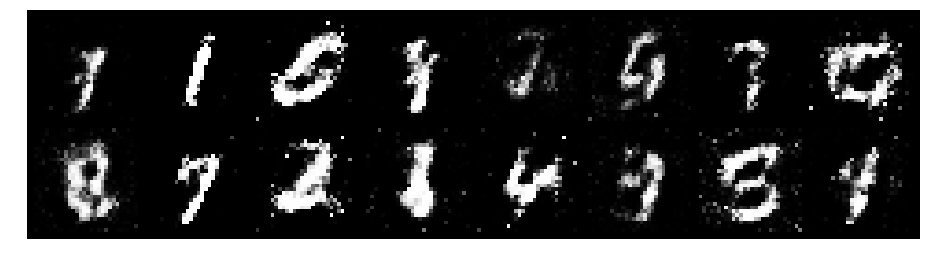

Epoch: [14/200], Batch Num: [600/938]
Discriminator Loss: 0.7733159065246582, Generator Loss: 1.785282850265503
D(x): 0.7363, D(G(z)): 0.2545


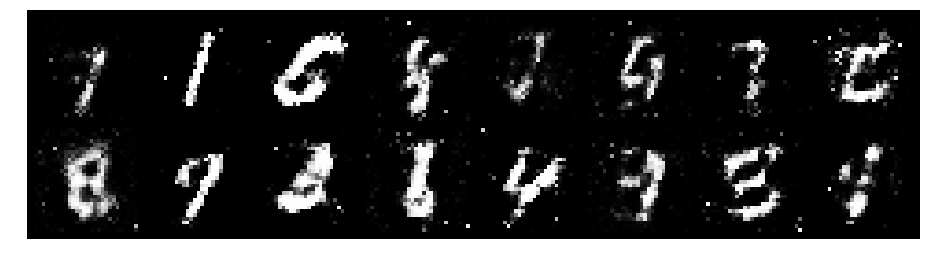

Epoch: [14/200], Batch Num: [700/938]
Discriminator Loss: 0.761736273765564, Generator Loss: 1.9419751167297363
D(x): 0.7970, D(G(z)): 0.2966


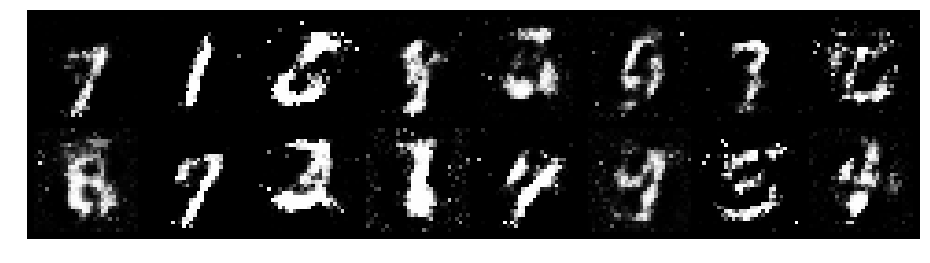

Epoch: [14/200], Batch Num: [800/938]
Discriminator Loss: 0.860466718673706, Generator Loss: 1.3374707698822021
D(x): 0.7803, D(G(z)): 0.3749


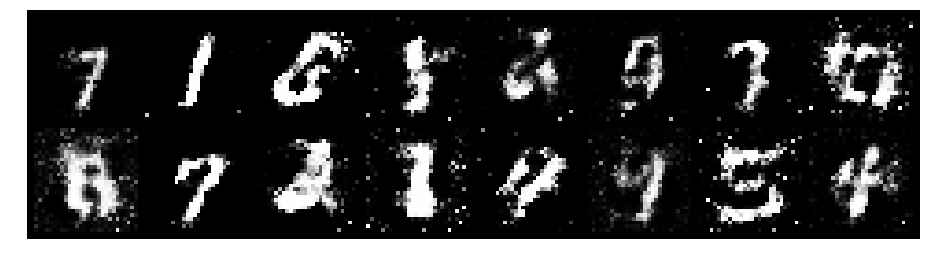

Epoch: [14/200], Batch Num: [900/938]
Discriminator Loss: 1.1163692474365234, Generator Loss: 1.4402896165847778
D(x): 0.7190, D(G(z)): 0.4296


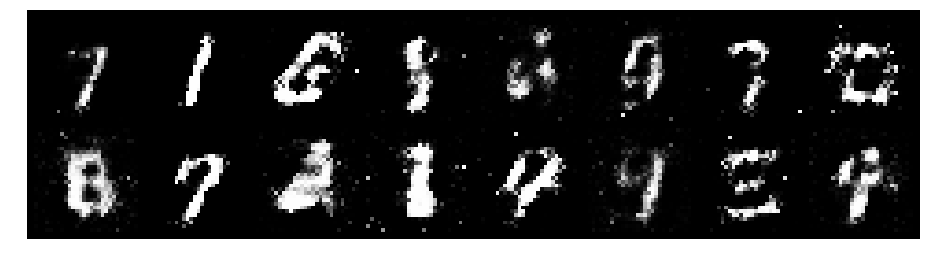

Epoch: [15/200], Batch Num: [0/938]
Discriminator Loss: 0.8530911207199097, Generator Loss: 1.1435424089431763
D(x): 0.7324, D(G(z)): 0.3336


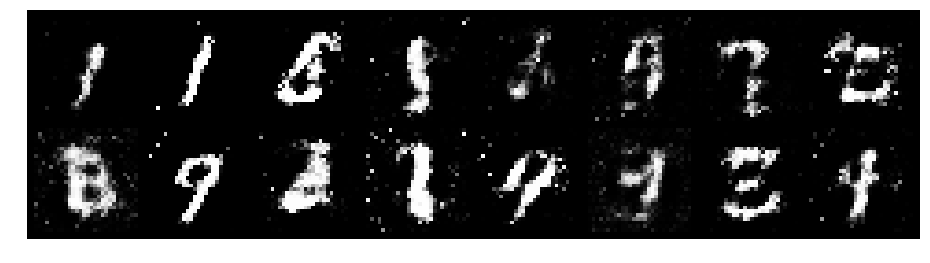

Epoch: [15/200], Batch Num: [100/938]
Discriminator Loss: 0.8005959987640381, Generator Loss: 1.593319296836853
D(x): 0.7041, D(G(z)): 0.2493


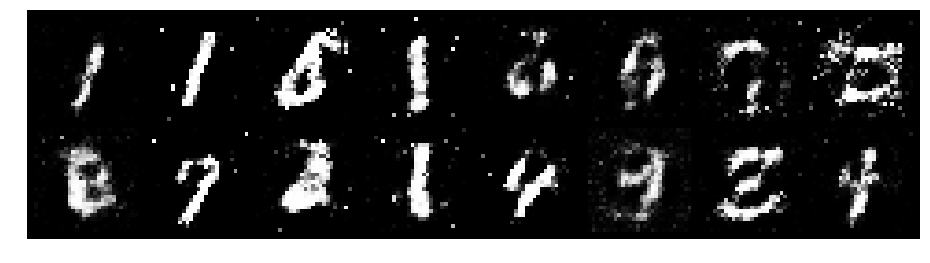

Epoch: [15/200], Batch Num: [200/938]
Discriminator Loss: 0.8732210397720337, Generator Loss: 1.6155107021331787
D(x): 0.7082, D(G(z)): 0.2928


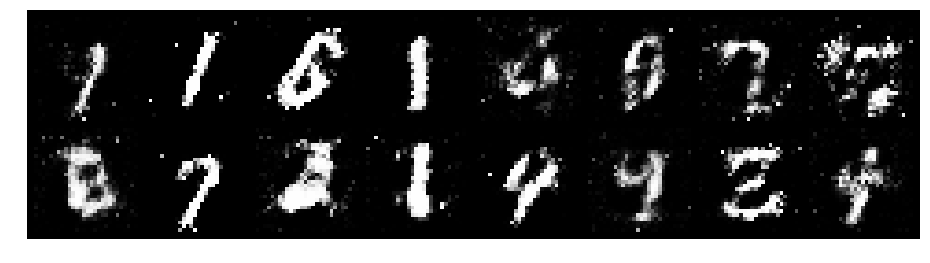

Epoch: [15/200], Batch Num: [300/938]
Discriminator Loss: 1.1426138877868652, Generator Loss: 1.3338006734848022
D(x): 0.6601, D(G(z)): 0.3828


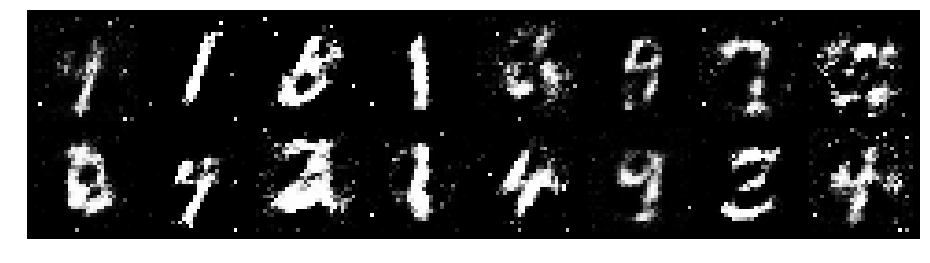

Epoch: [15/200], Batch Num: [400/938]
Discriminator Loss: 1.1291241645812988, Generator Loss: 1.0984220504760742
D(x): 0.5900, D(G(z)): 0.3421


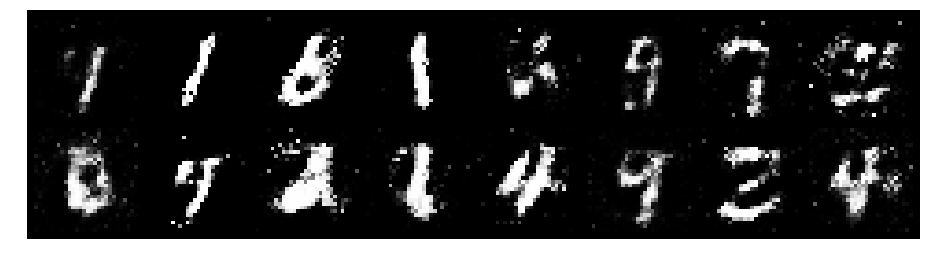

Epoch: [15/200], Batch Num: [500/938]
Discriminator Loss: 1.1623955965042114, Generator Loss: 1.2312605381011963
D(x): 0.6321, D(G(z)): 0.3023


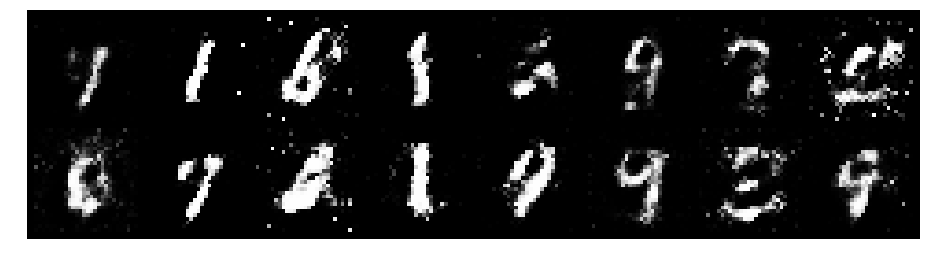

Epoch: [15/200], Batch Num: [600/938]
Discriminator Loss: 0.9762417078018188, Generator Loss: 1.476332426071167
D(x): 0.6536, D(G(z)): 0.3165


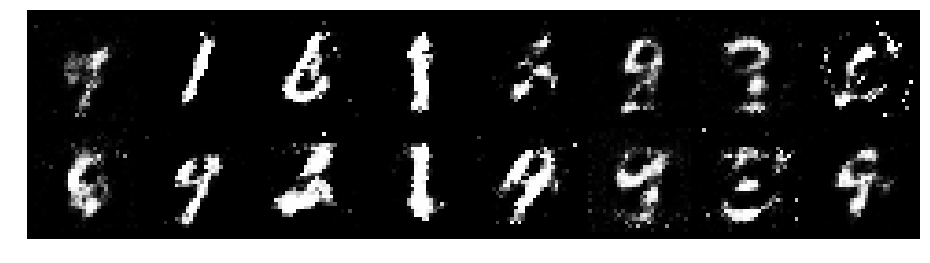

Epoch: [15/200], Batch Num: [700/938]
Discriminator Loss: 1.1276865005493164, Generator Loss: 1.2843945026397705
D(x): 0.6363, D(G(z)): 0.3487


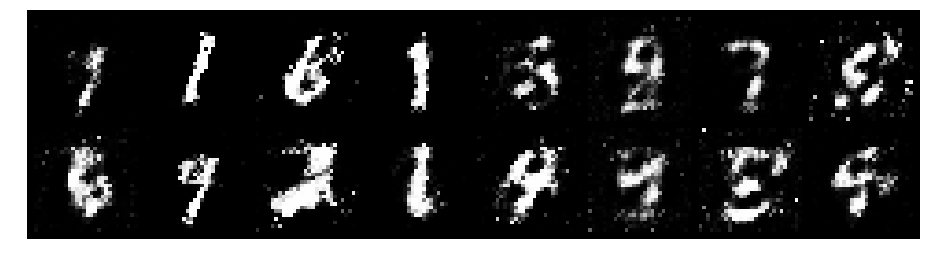

Epoch: [15/200], Batch Num: [800/938]
Discriminator Loss: 1.232811689376831, Generator Loss: 1.103856086730957
D(x): 0.5884, D(G(z)): 0.3502


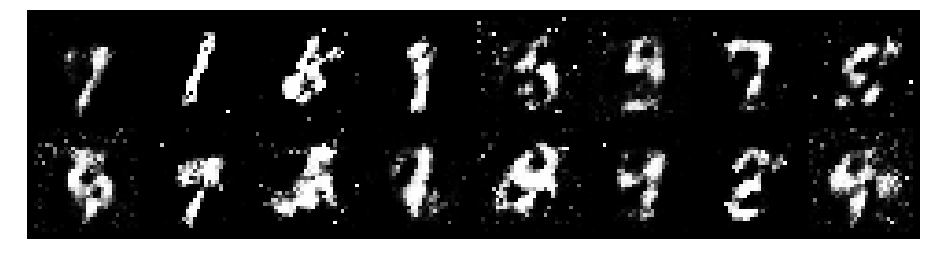

Epoch: [15/200], Batch Num: [900/938]
Discriminator Loss: 1.0765128135681152, Generator Loss: 1.528662085533142
D(x): 0.6472, D(G(z)): 0.3301


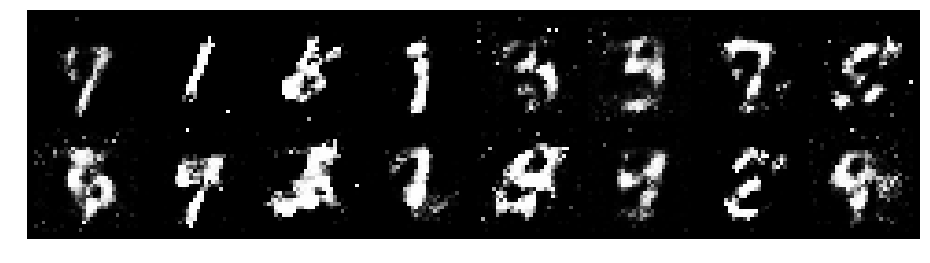

Epoch: [16/200], Batch Num: [0/938]
Discriminator Loss: 1.1569088697433472, Generator Loss: 1.470833420753479
D(x): 0.6433, D(G(z)): 0.3716


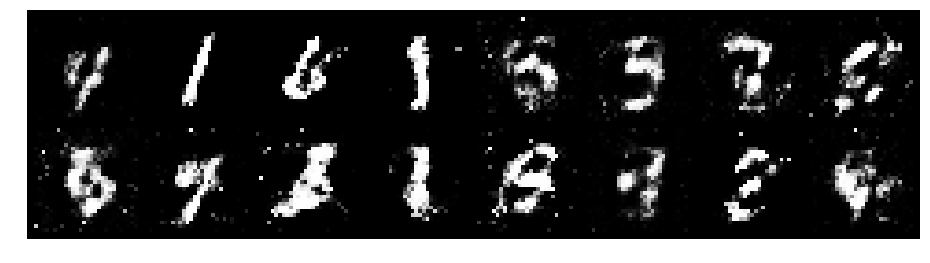

Epoch: [16/200], Batch Num: [100/938]
Discriminator Loss: 1.0276280641555786, Generator Loss: 1.451176643371582
D(x): 0.7300, D(G(z)): 0.3634


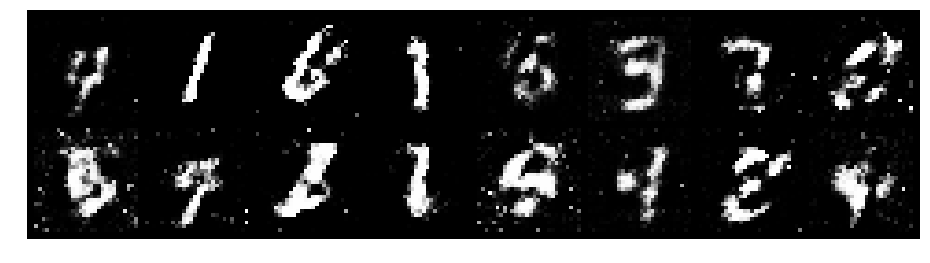

Epoch: [16/200], Batch Num: [200/938]
Discriminator Loss: 1.1548244953155518, Generator Loss: 1.169116735458374
D(x): 0.5908, D(G(z)): 0.2969


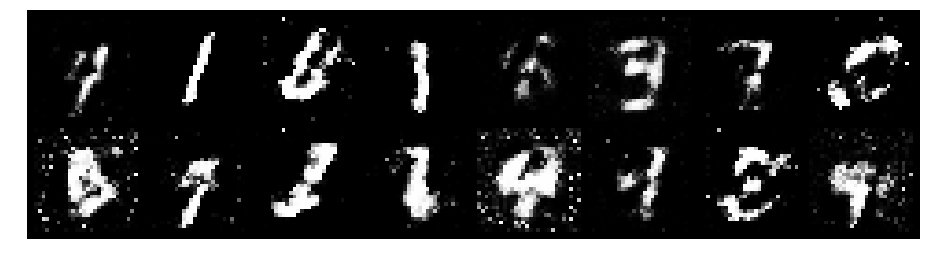

Epoch: [16/200], Batch Num: [300/938]
Discriminator Loss: 0.9649707078933716, Generator Loss: 1.4711780548095703
D(x): 0.6616, D(G(z)): 0.2870


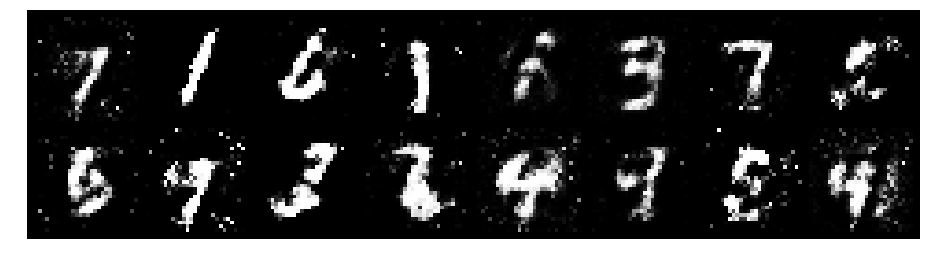

Epoch: [16/200], Batch Num: [400/938]
Discriminator Loss: 0.8159438967704773, Generator Loss: 1.6012592315673828
D(x): 0.7555, D(G(z)): 0.3081


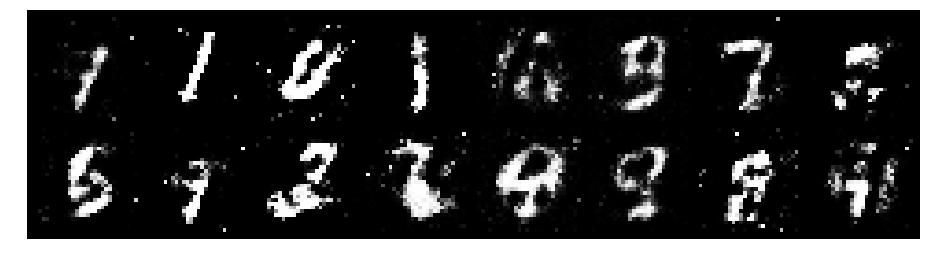

Epoch: [16/200], Batch Num: [500/938]
Discriminator Loss: 1.3433374166488647, Generator Loss: 1.4011940956115723
D(x): 0.5843, D(G(z)): 0.3619


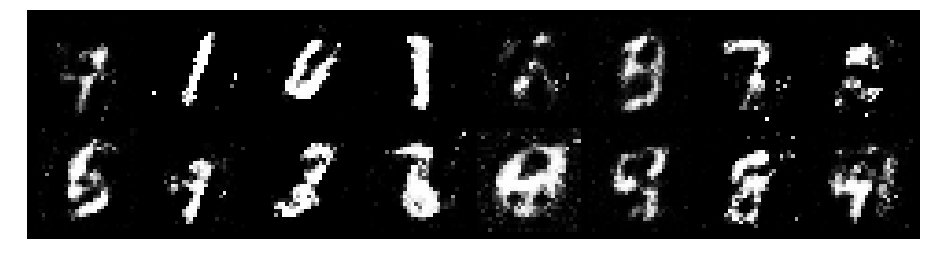

Epoch: [16/200], Batch Num: [600/938]
Discriminator Loss: 1.0452157258987427, Generator Loss: 1.9488821029663086
D(x): 0.5885, D(G(z)): 0.2712


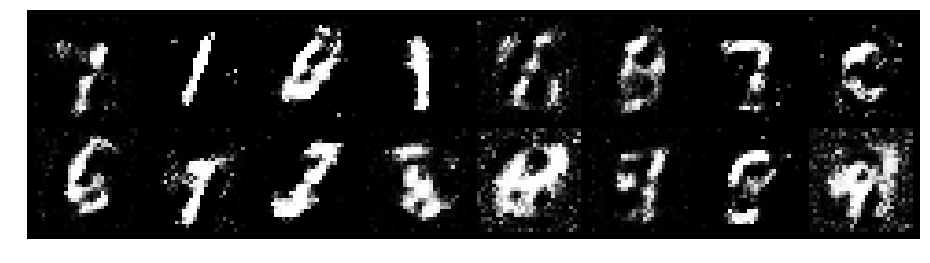

Epoch: [16/200], Batch Num: [700/938]
Discriminator Loss: 0.7129167318344116, Generator Loss: 1.8188687562942505
D(x): 0.7334, D(G(z)): 0.2627


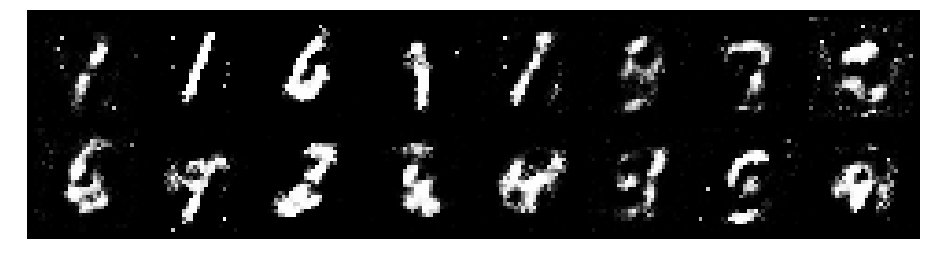

Epoch: [16/200], Batch Num: [800/938]
Discriminator Loss: 0.9504019021987915, Generator Loss: 1.785383939743042
D(x): 0.6602, D(G(z)): 0.3240


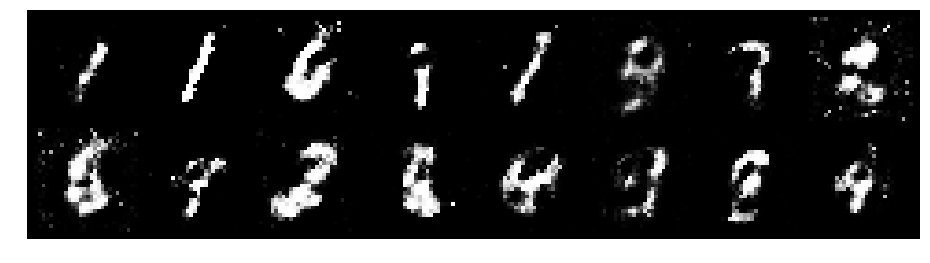

Epoch: [16/200], Batch Num: [900/938]
Discriminator Loss: 0.9390270113945007, Generator Loss: 1.403085470199585
D(x): 0.7006, D(G(z)): 0.3419


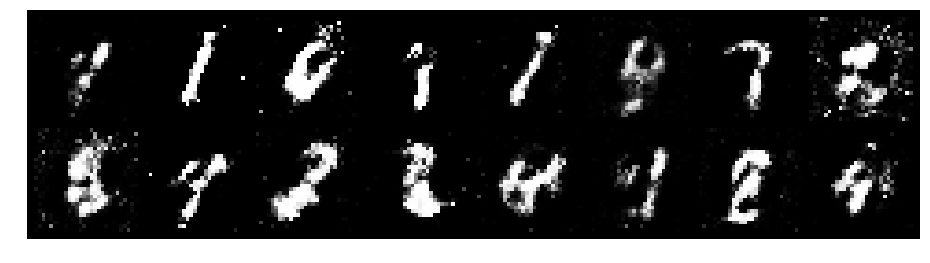

Epoch: [17/200], Batch Num: [0/938]
Discriminator Loss: 1.1986905336380005, Generator Loss: 1.4942047595977783
D(x): 0.6101, D(G(z)): 0.3343


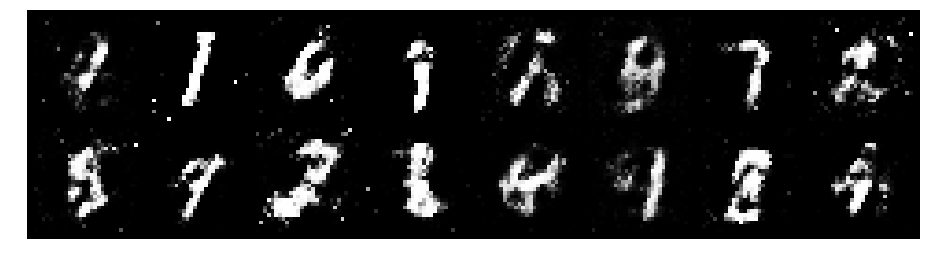

Epoch: [17/200], Batch Num: [100/938]
Discriminator Loss: 1.0173089504241943, Generator Loss: 1.4083189964294434
D(x): 0.6385, D(G(z)): 0.2785


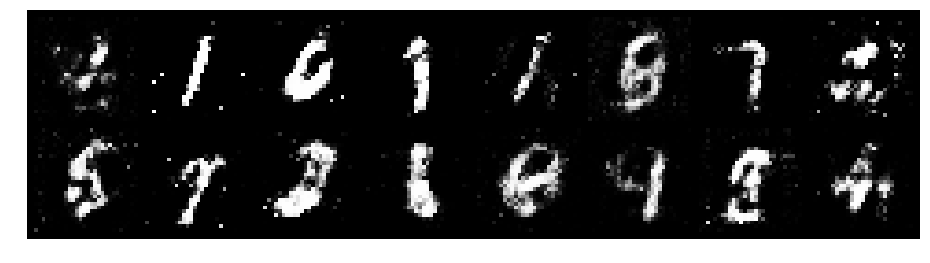

Epoch: [17/200], Batch Num: [200/938]
Discriminator Loss: 1.1923402547836304, Generator Loss: 1.4903887510299683
D(x): 0.5998, D(G(z)): 0.2985


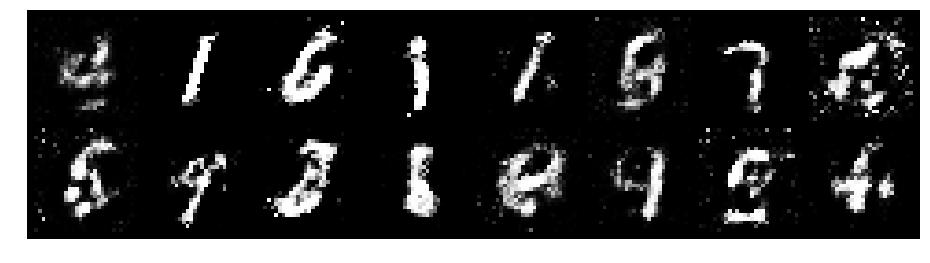

Epoch: [17/200], Batch Num: [300/938]
Discriminator Loss: 0.8023223876953125, Generator Loss: 1.6658635139465332
D(x): 0.6830, D(G(z)): 0.2417


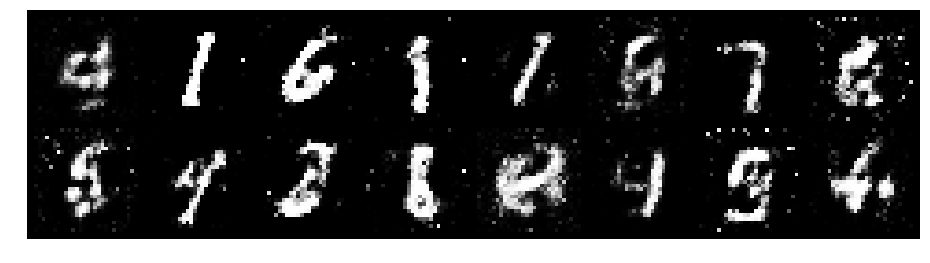

Epoch: [17/200], Batch Num: [400/938]
Discriminator Loss: 0.7883604764938354, Generator Loss: 1.6879172325134277
D(x): 0.7185, D(G(z)): 0.2551


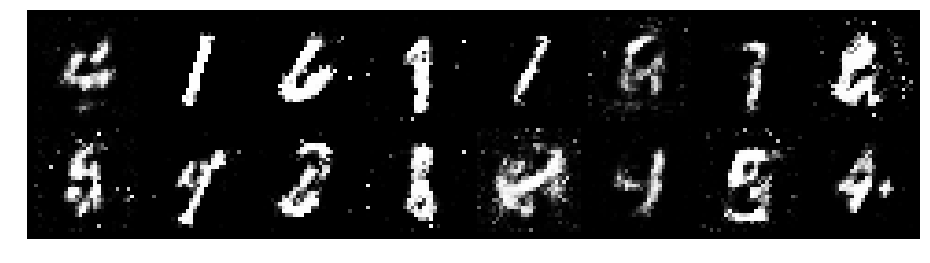

Epoch: [17/200], Batch Num: [500/938]
Discriminator Loss: 0.8346207737922668, Generator Loss: 1.7764296531677246
D(x): 0.7377, D(G(z)): 0.2999


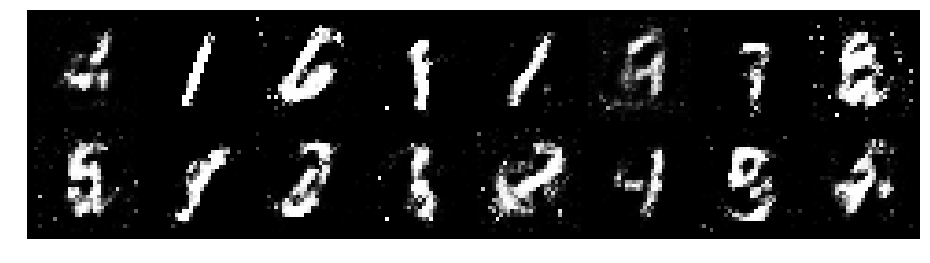

Epoch: [17/200], Batch Num: [600/938]
Discriminator Loss: 1.015342354774475, Generator Loss: 1.3767037391662598
D(x): 0.6480, D(G(z)): 0.3084


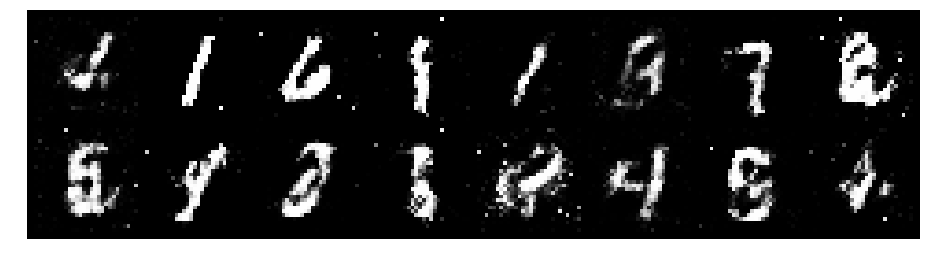

Epoch: [17/200], Batch Num: [700/938]
Discriminator Loss: 1.0884655714035034, Generator Loss: 1.1607460975646973
D(x): 0.6554, D(G(z)): 0.3821


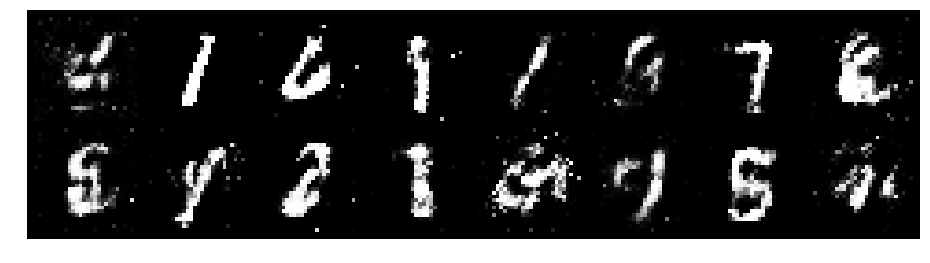

Epoch: [17/200], Batch Num: [800/938]
Discriminator Loss: 0.9904870986938477, Generator Loss: 1.2541778087615967
D(x): 0.7215, D(G(z)): 0.3852


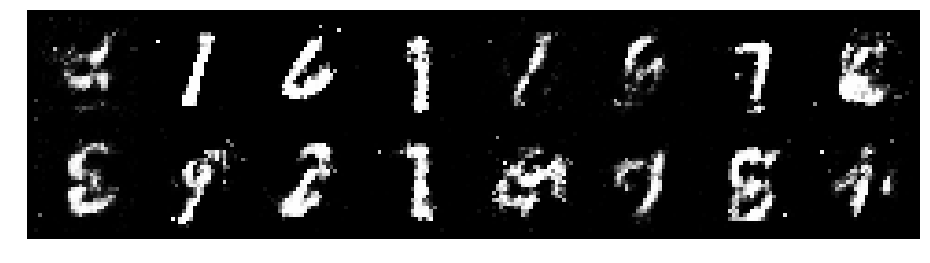

Epoch: [17/200], Batch Num: [900/938]
Discriminator Loss: 1.1304070949554443, Generator Loss: 1.244055986404419
D(x): 0.6673, D(G(z)): 0.3495


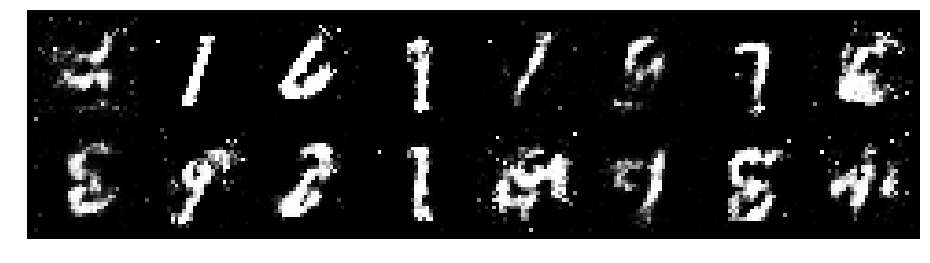

Epoch: [18/200], Batch Num: [0/938]
Discriminator Loss: 1.2251561880111694, Generator Loss: 1.697540521621704
D(x): 0.6032, D(G(z)): 0.3183


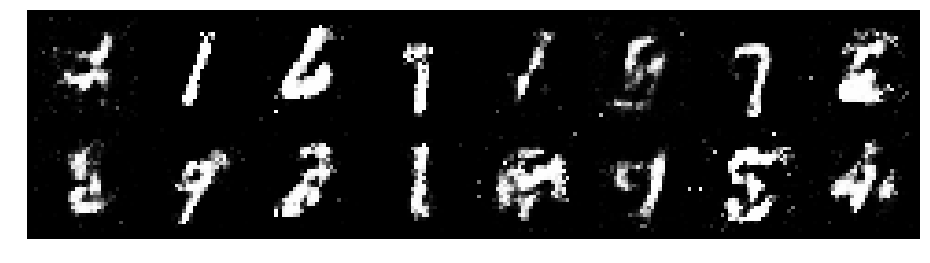

Epoch: [18/200], Batch Num: [100/938]
Discriminator Loss: 1.1361123323440552, Generator Loss: 1.22575044631958
D(x): 0.6600, D(G(z)): 0.3915


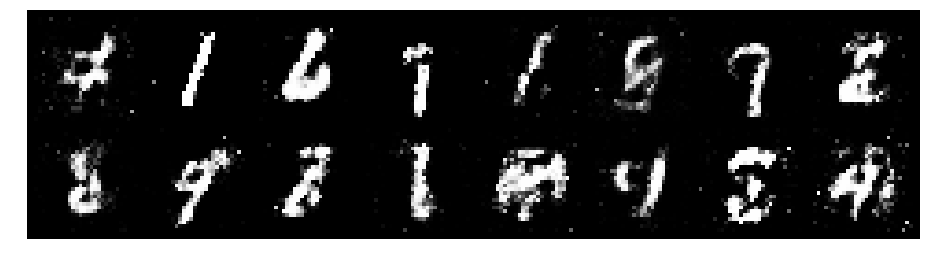

Epoch: [18/200], Batch Num: [200/938]
Discriminator Loss: 1.0376677513122559, Generator Loss: 1.736599087715149
D(x): 0.6989, D(G(z)): 0.3706


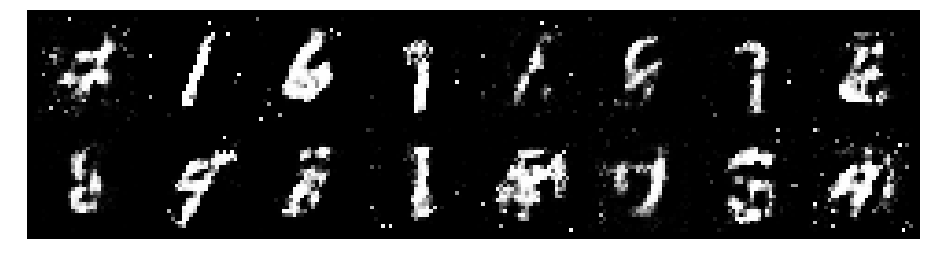

Epoch: [18/200], Batch Num: [300/938]
Discriminator Loss: 0.8199030160903931, Generator Loss: 1.4086105823516846
D(x): 0.7250, D(G(z)): 0.3157


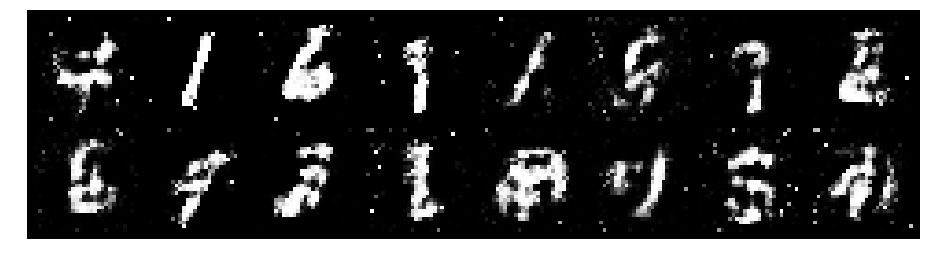

Epoch: [18/200], Batch Num: [400/938]
Discriminator Loss: 1.0184285640716553, Generator Loss: 1.385344386100769
D(x): 0.6815, D(G(z)): 0.3665


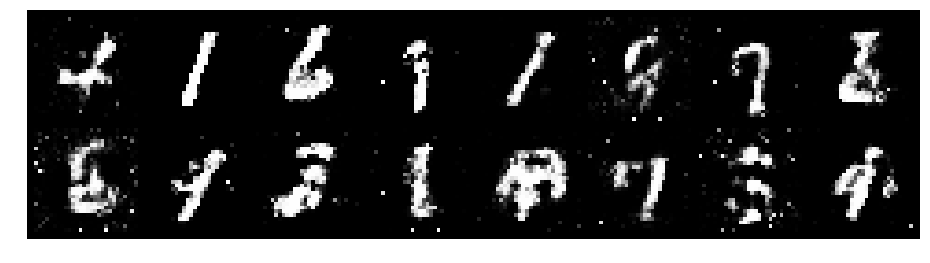

Epoch: [18/200], Batch Num: [500/938]
Discriminator Loss: 0.992392897605896, Generator Loss: 1.4235771894454956
D(x): 0.7172, D(G(z)): 0.3770


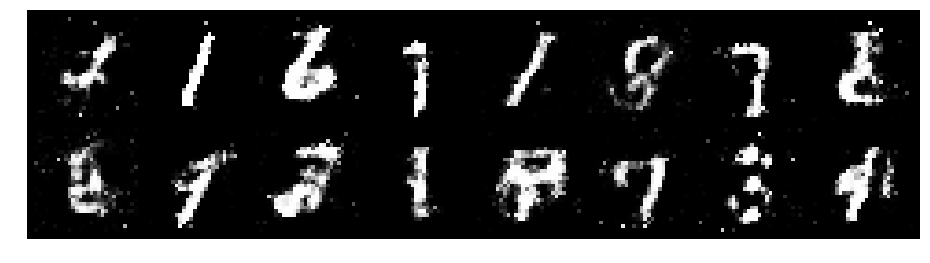

Epoch: [18/200], Batch Num: [600/938]
Discriminator Loss: 0.9677040576934814, Generator Loss: 1.5427335500717163
D(x): 0.6779, D(G(z)): 0.3363


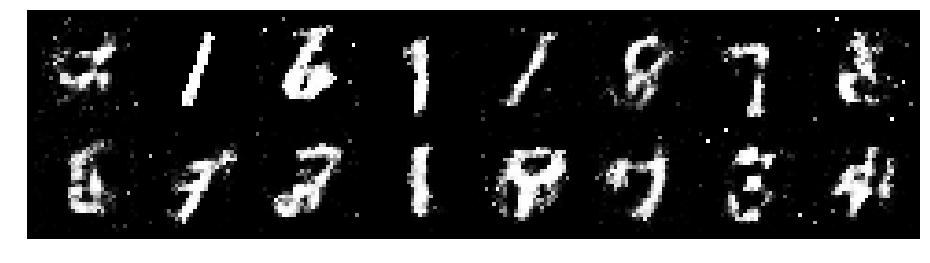

Epoch: [18/200], Batch Num: [700/938]
Discriminator Loss: 0.9788259863853455, Generator Loss: 1.5722324848175049
D(x): 0.5843, D(G(z)): 0.2329


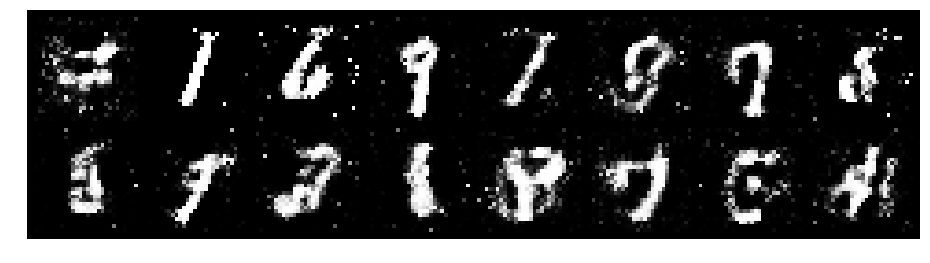

Epoch: [18/200], Batch Num: [800/938]
Discriminator Loss: 1.206986904144287, Generator Loss: 1.0762639045715332
D(x): 0.6216, D(G(z)): 0.4078


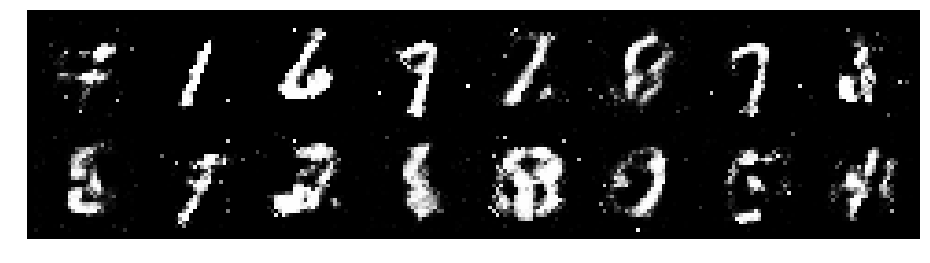

Epoch: [18/200], Batch Num: [900/938]
Discriminator Loss: 1.2465559244155884, Generator Loss: 1.1328696012496948
D(x): 0.6994, D(G(z)): 0.4995


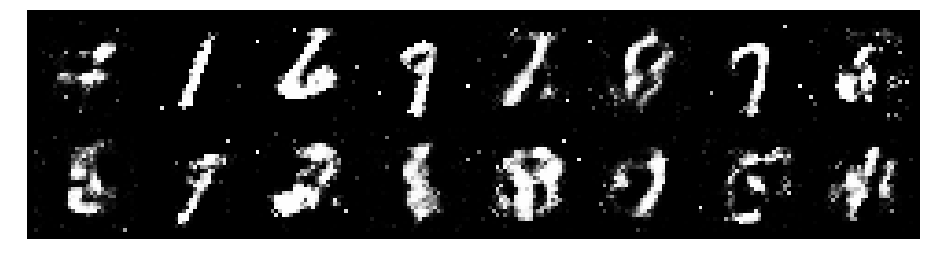

Epoch: [19/200], Batch Num: [0/938]
Discriminator Loss: 0.8132102489471436, Generator Loss: 1.5824393033981323
D(x): 0.6897, D(G(z)): 0.2482


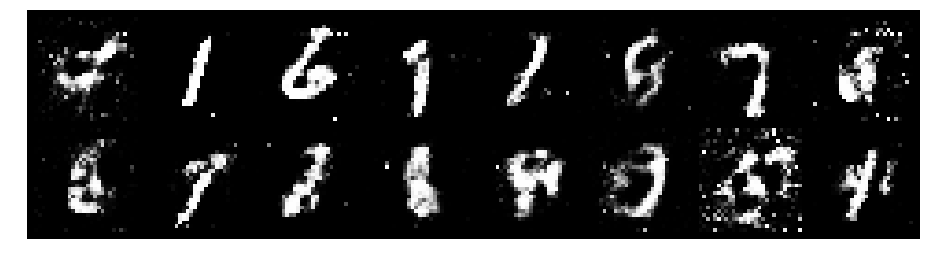

Epoch: [19/200], Batch Num: [100/938]
Discriminator Loss: 0.8458042740821838, Generator Loss: 1.716465711593628
D(x): 0.7401, D(G(z)): 0.2885


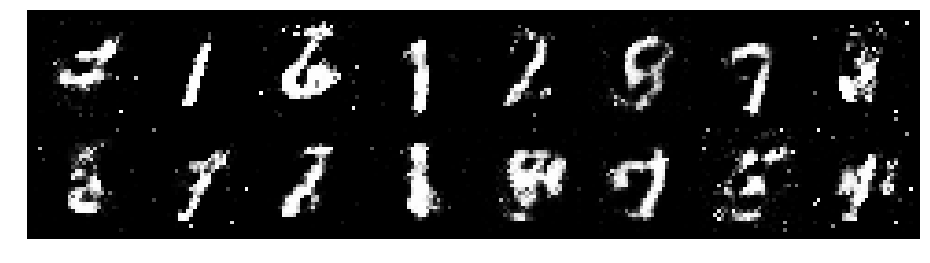

Epoch: [19/200], Batch Num: [200/938]
Discriminator Loss: 1.1824724674224854, Generator Loss: 1.3565062284469604
D(x): 0.5992, D(G(z)): 0.3323


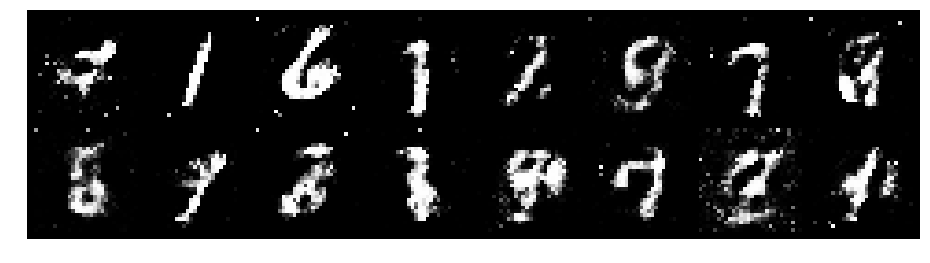

Epoch: [19/200], Batch Num: [300/938]
Discriminator Loss: 0.7761619687080383, Generator Loss: 1.309761643409729
D(x): 0.7411, D(G(z)): 0.3278


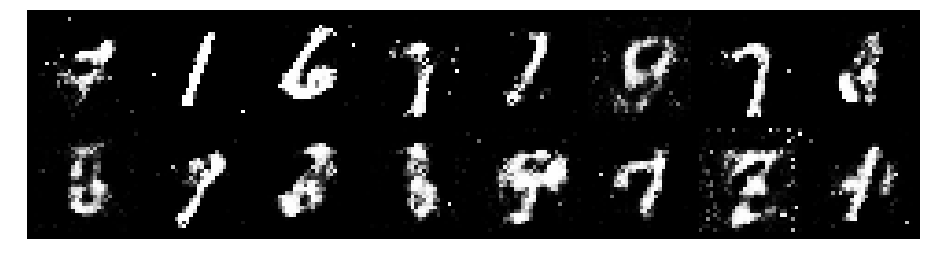

Epoch: [19/200], Batch Num: [400/938]
Discriminator Loss: 1.0053865909576416, Generator Loss: 1.1270827054977417
D(x): 0.6870, D(G(z)): 0.3534


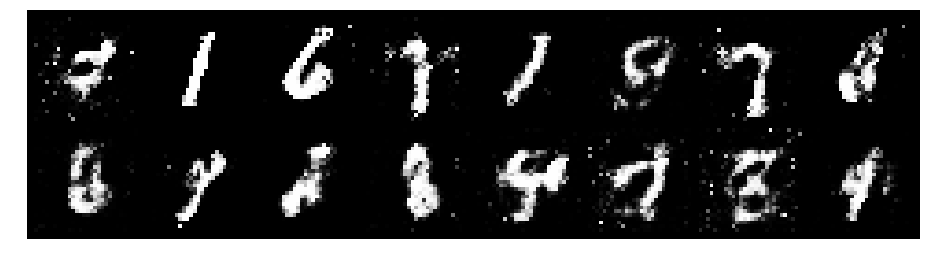

Epoch: [19/200], Batch Num: [500/938]
Discriminator Loss: 1.0720725059509277, Generator Loss: 1.1705530881881714
D(x): 0.6530, D(G(z)): 0.3715


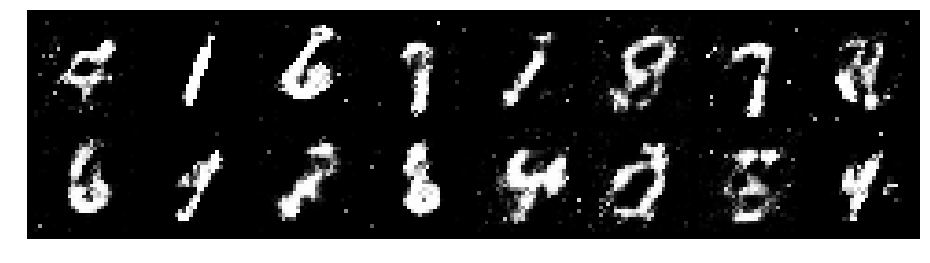

Epoch: [19/200], Batch Num: [600/938]
Discriminator Loss: 1.2998563051223755, Generator Loss: 1.2976624965667725
D(x): 0.5287, D(G(z)): 0.3760


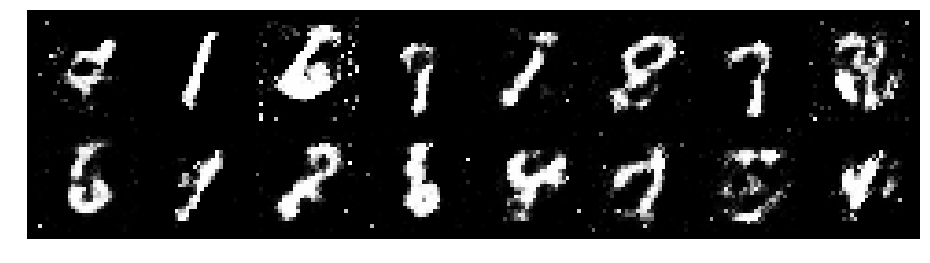

Epoch: [19/200], Batch Num: [700/938]
Discriminator Loss: 1.1466341018676758, Generator Loss: 1.0976543426513672
D(x): 0.6251, D(G(z)): 0.3706


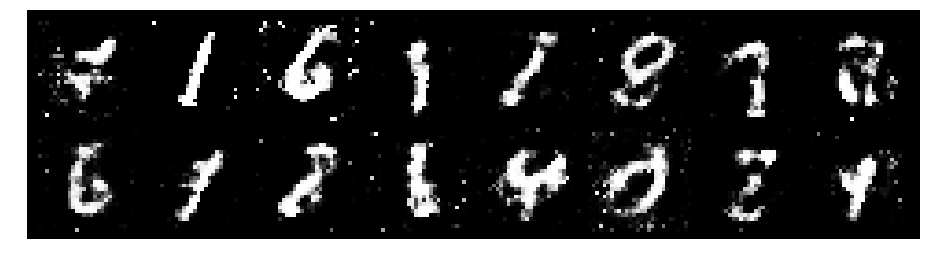

Epoch: [19/200], Batch Num: [800/938]
Discriminator Loss: 0.8473192453384399, Generator Loss: 1.5735130310058594
D(x): 0.6770, D(G(z)): 0.2717


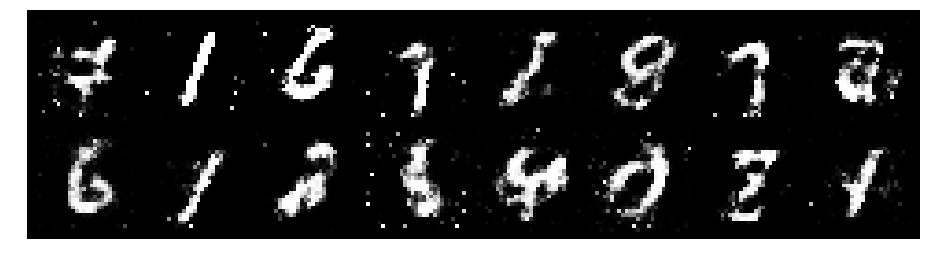

Epoch: [19/200], Batch Num: [900/938]
Discriminator Loss: 0.6967000961303711, Generator Loss: 1.7907919883728027
D(x): 0.7556, D(G(z)): 0.2465


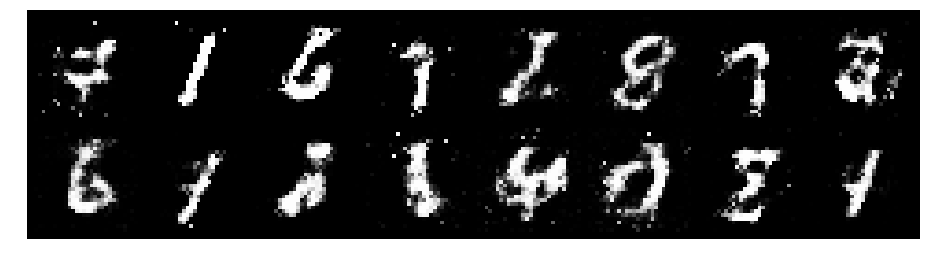

Epoch: [20/200], Batch Num: [0/938]
Discriminator Loss: 0.7841999530792236, Generator Loss: 1.1771275997161865
D(x): 0.7680, D(G(z)): 0.3338


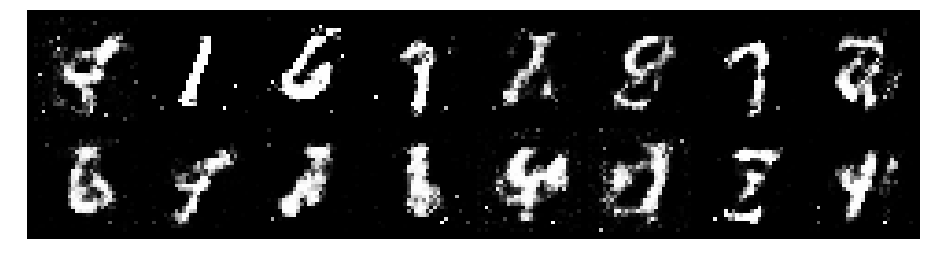

Epoch: [20/200], Batch Num: [100/938]
Discriminator Loss: 1.099038004875183, Generator Loss: 1.2790324687957764
D(x): 0.6099, D(G(z)): 0.3420


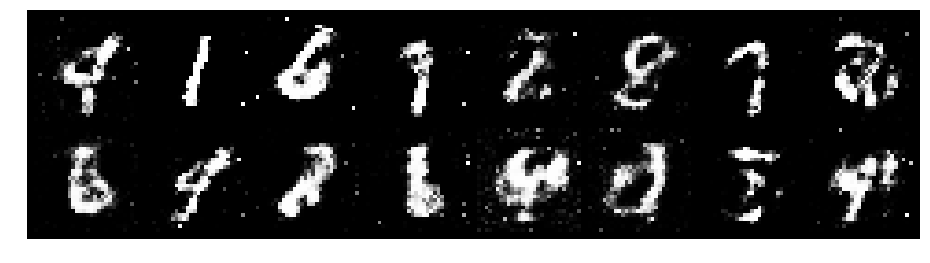

Epoch: [20/200], Batch Num: [200/938]
Discriminator Loss: 1.1044808626174927, Generator Loss: 0.9968311190605164
D(x): 0.5944, D(G(z)): 0.3503


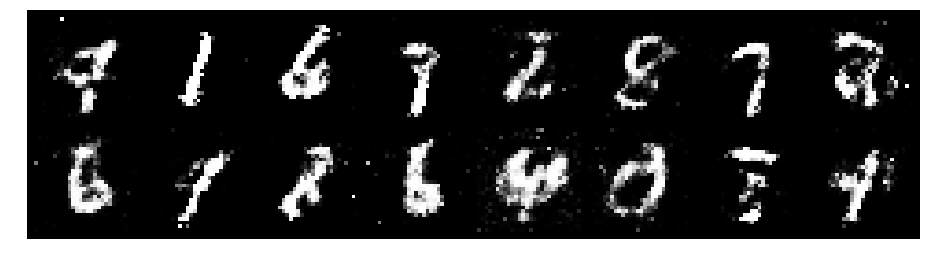

Epoch: [20/200], Batch Num: [300/938]
Discriminator Loss: 1.2188458442687988, Generator Loss: 1.246143102645874
D(x): 0.6550, D(G(z)): 0.4096


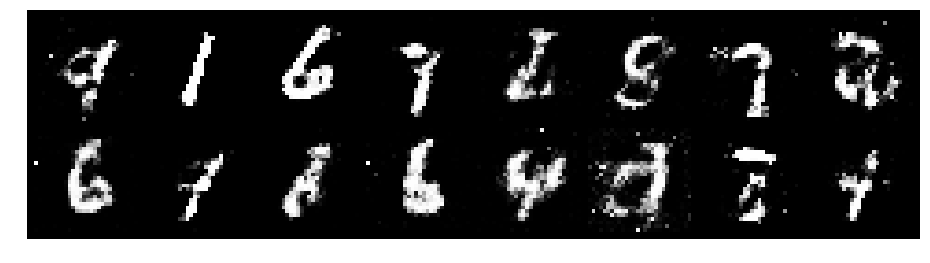

Epoch: [20/200], Batch Num: [400/938]
Discriminator Loss: 0.9731257557868958, Generator Loss: 1.2857491970062256
D(x): 0.6710, D(G(z)): 0.3454


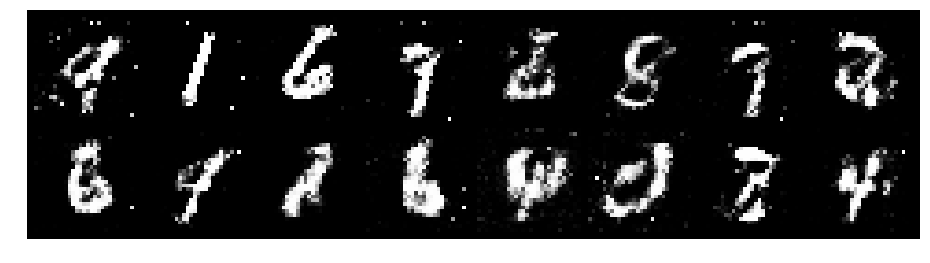

Epoch: [20/200], Batch Num: [500/938]
Discriminator Loss: 1.0898079872131348, Generator Loss: 1.0571398735046387
D(x): 0.6557, D(G(z)): 0.4215


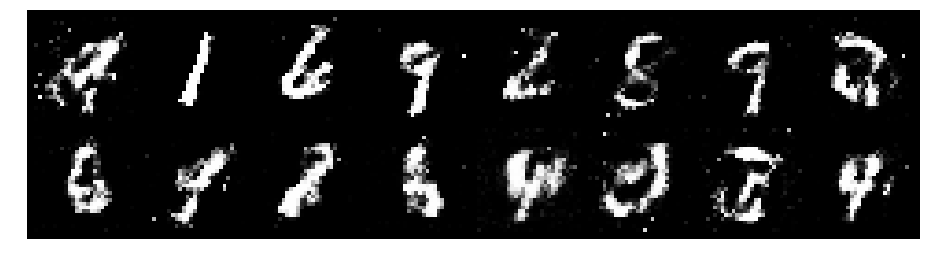

Epoch: [20/200], Batch Num: [600/938]
Discriminator Loss: 0.9515173435211182, Generator Loss: 1.2008938789367676
D(x): 0.6649, D(G(z)): 0.3188


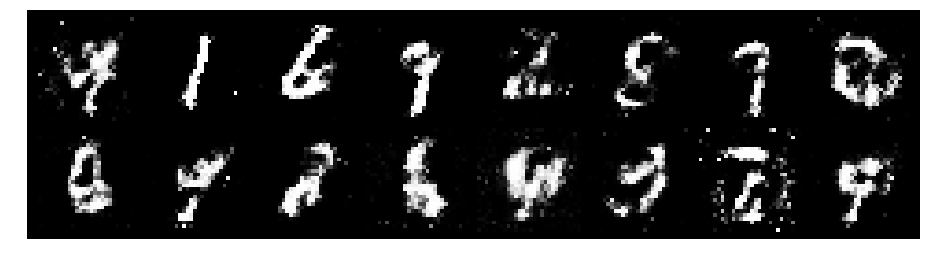

Epoch: [20/200], Batch Num: [700/938]
Discriminator Loss: 1.0105737447738647, Generator Loss: 1.5096698999404907
D(x): 0.5905, D(G(z)): 0.2875


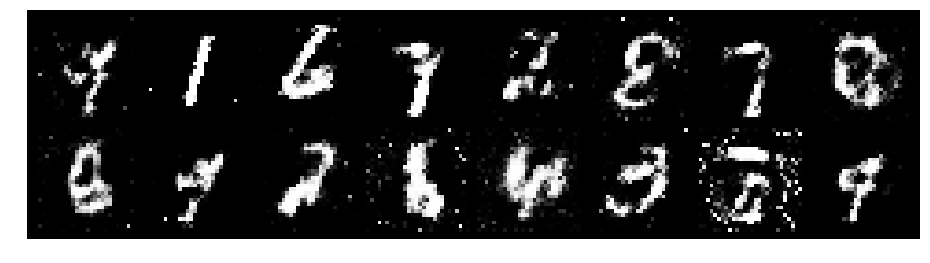

Epoch: [20/200], Batch Num: [800/938]
Discriminator Loss: 0.9015963077545166, Generator Loss: 1.3461499214172363
D(x): 0.6680, D(G(z)): 0.3277


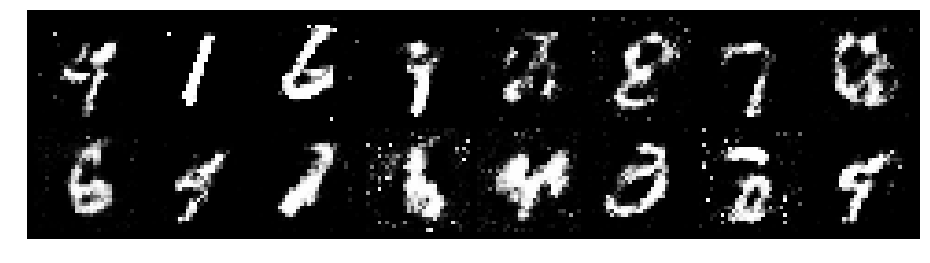

Epoch: [20/200], Batch Num: [900/938]
Discriminator Loss: 0.9208850860595703, Generator Loss: 1.4077016115188599
D(x): 0.6863, D(G(z)): 0.3154


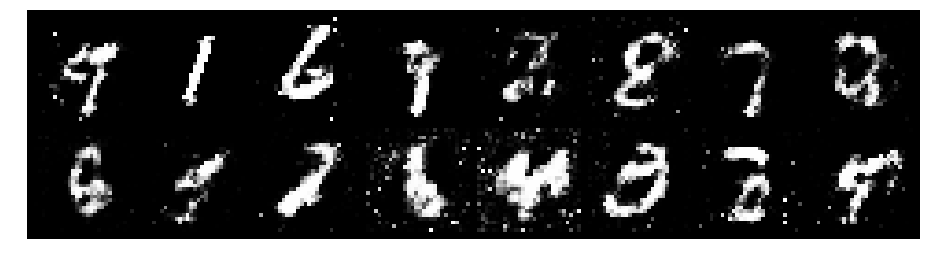

Epoch: [21/200], Batch Num: [0/938]
Discriminator Loss: 1.015745759010315, Generator Loss: 1.1978445053100586
D(x): 0.6415, D(G(z)): 0.3499


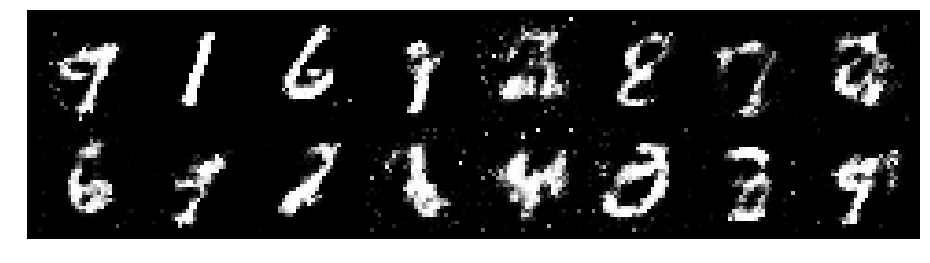

Epoch: [21/200], Batch Num: [100/938]
Discriminator Loss: 1.0028624534606934, Generator Loss: 1.201360821723938
D(x): 0.6519, D(G(z)): 0.3567


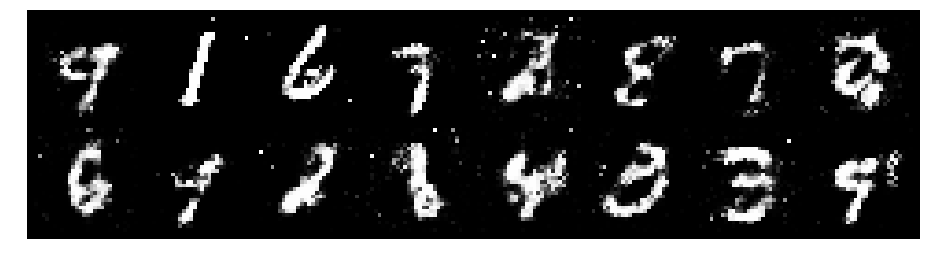

Epoch: [21/200], Batch Num: [200/938]
Discriminator Loss: 1.0541456937789917, Generator Loss: 1.026379942893982
D(x): 0.6451, D(G(z)): 0.3769


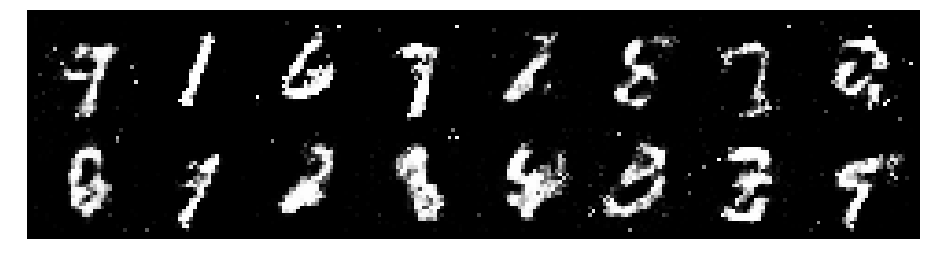

Epoch: [21/200], Batch Num: [300/938]
Discriminator Loss: 1.166171908378601, Generator Loss: 1.0408732891082764
D(x): 0.5801, D(G(z)): 0.3816


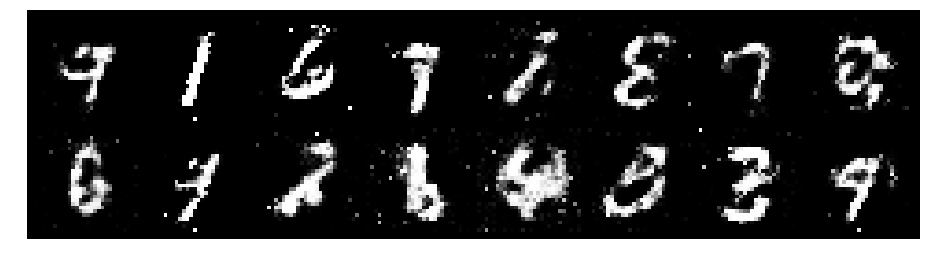

Epoch: [21/200], Batch Num: [400/938]
Discriminator Loss: 1.0323892831802368, Generator Loss: 1.335402488708496
D(x): 0.5936, D(G(z)): 0.3028


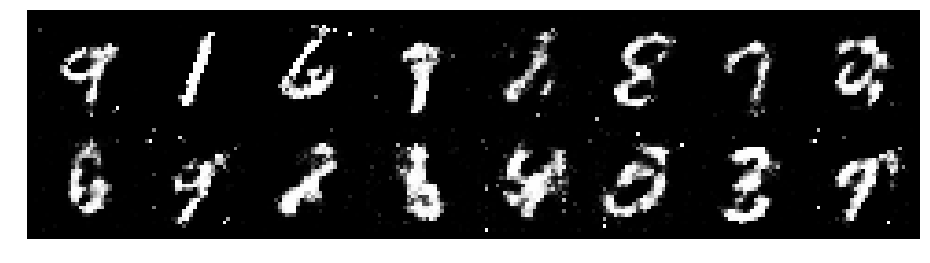

Epoch: [21/200], Batch Num: [500/938]
Discriminator Loss: 1.0576730966567993, Generator Loss: 1.3216737508773804
D(x): 0.5983, D(G(z)): 0.3397


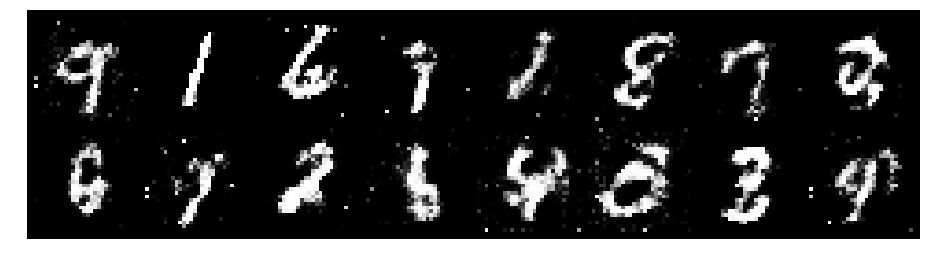

Epoch: [21/200], Batch Num: [600/938]
Discriminator Loss: 1.088375210762024, Generator Loss: 1.257047176361084
D(x): 0.6056, D(G(z)): 0.3333


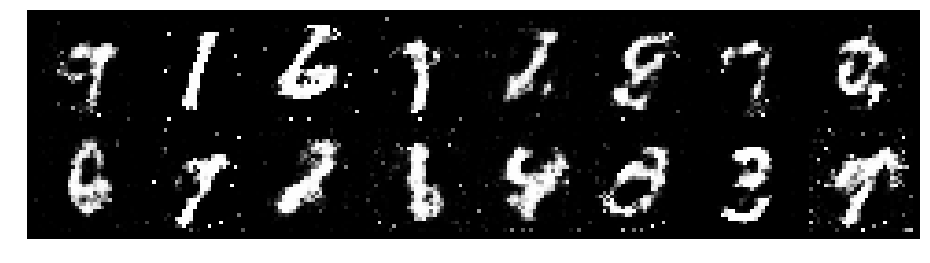

Epoch: [21/200], Batch Num: [700/938]
Discriminator Loss: 1.034123420715332, Generator Loss: 1.4116191864013672
D(x): 0.6154, D(G(z)): 0.3207


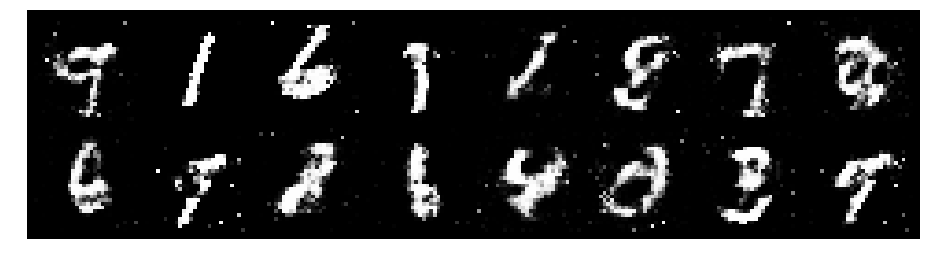

Epoch: [21/200], Batch Num: [800/938]
Discriminator Loss: 1.0185867547988892, Generator Loss: 1.1701631546020508
D(x): 0.5845, D(G(z)): 0.3087


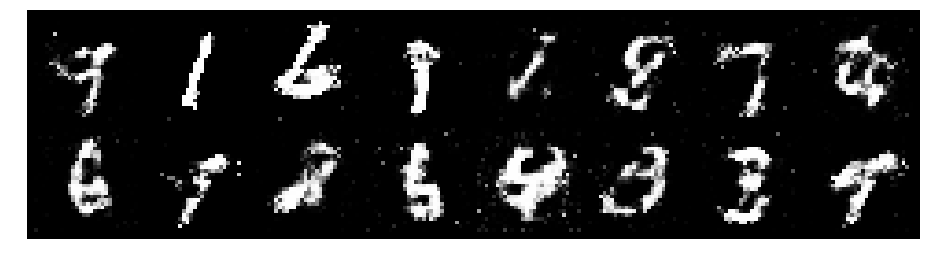

Epoch: [21/200], Batch Num: [900/938]
Discriminator Loss: 0.968817949295044, Generator Loss: 1.4509868621826172
D(x): 0.6693, D(G(z)): 0.3167


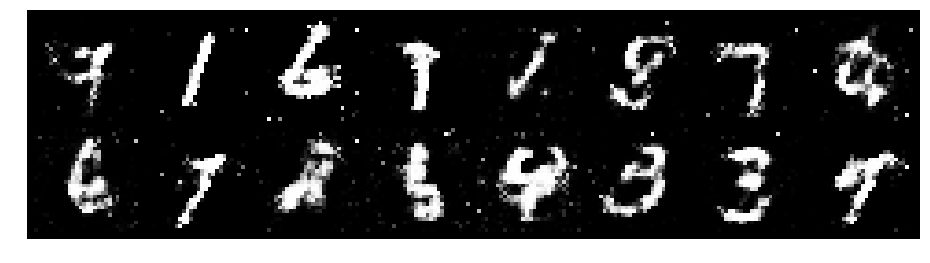

Epoch: [22/200], Batch Num: [0/938]
Discriminator Loss: 1.015793800354004, Generator Loss: 1.1263924837112427
D(x): 0.6501, D(G(z)): 0.3724


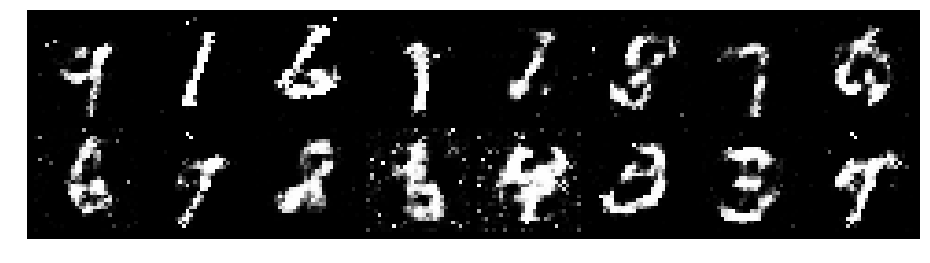

Epoch: [22/200], Batch Num: [100/938]
Discriminator Loss: 1.195310115814209, Generator Loss: 0.9885225296020508
D(x): 0.6186, D(G(z)): 0.4367


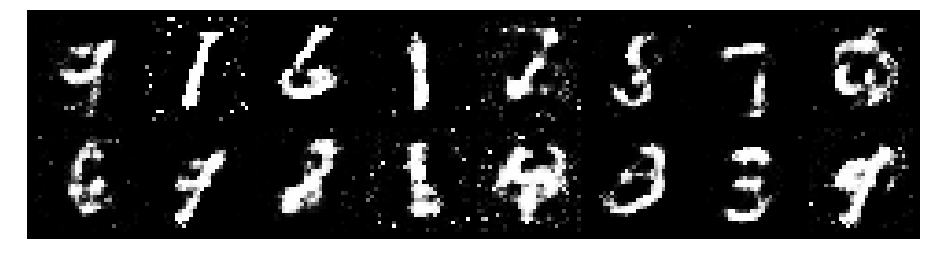

Epoch: [22/200], Batch Num: [200/938]
Discriminator Loss: 1.0706427097320557, Generator Loss: 1.2974603176116943
D(x): 0.7067, D(G(z)): 0.3955


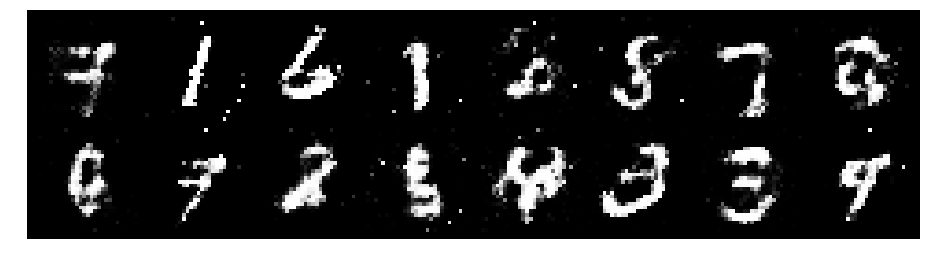

Epoch: [22/200], Batch Num: [300/938]
Discriminator Loss: 1.0218923091888428, Generator Loss: 1.1134949922561646
D(x): 0.6661, D(G(z)): 0.3926


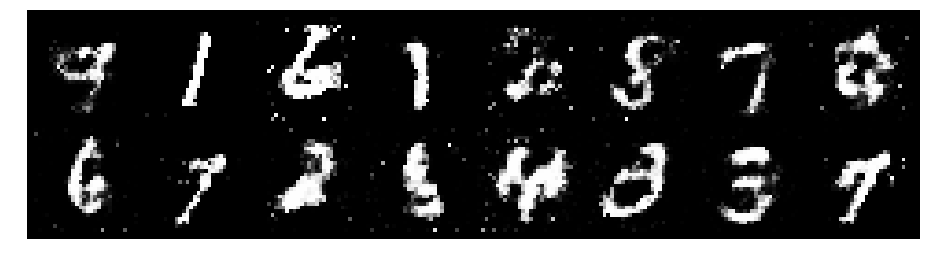

Epoch: [22/200], Batch Num: [400/938]
Discriminator Loss: 1.165891170501709, Generator Loss: 1.0933351516723633
D(x): 0.5622, D(G(z)): 0.3629


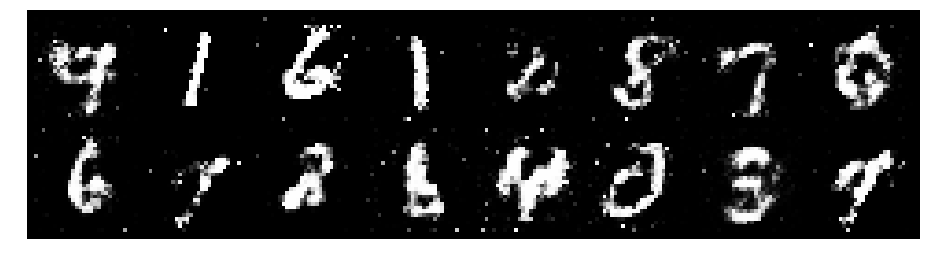

Epoch: [22/200], Batch Num: [500/938]
Discriminator Loss: 1.218770980834961, Generator Loss: 1.0229418277740479
D(x): 0.6040, D(G(z)): 0.4538


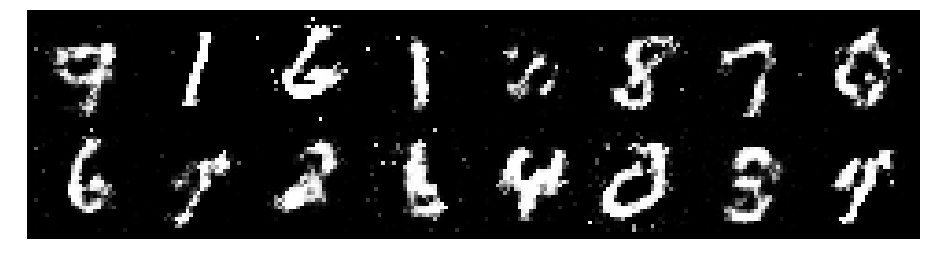

Epoch: [22/200], Batch Num: [600/938]
Discriminator Loss: 1.0950847864151, Generator Loss: 1.3280887603759766
D(x): 0.6907, D(G(z)): 0.3981


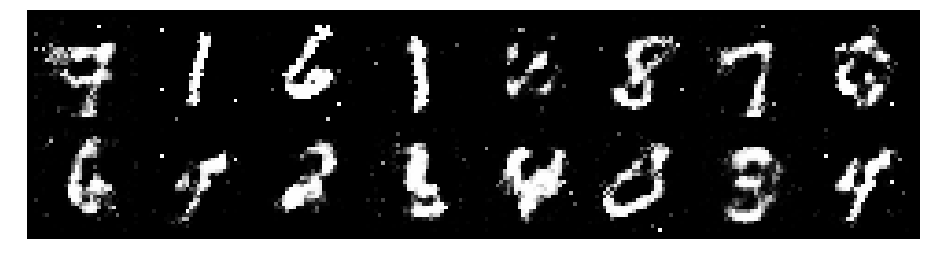

Epoch: [22/200], Batch Num: [700/938]
Discriminator Loss: 0.9966714382171631, Generator Loss: 1.2391302585601807
D(x): 0.6725, D(G(z)): 0.3614


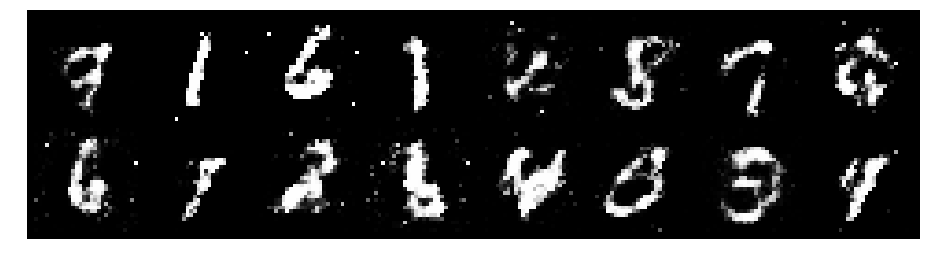

Epoch: [22/200], Batch Num: [800/938]
Discriminator Loss: 1.3348665237426758, Generator Loss: 1.2247281074523926
D(x): 0.5767, D(G(z)): 0.3895


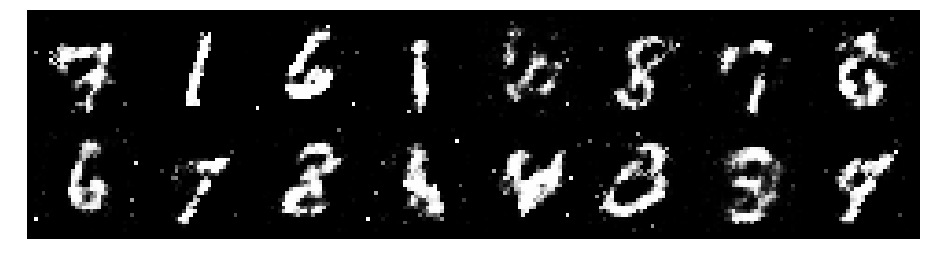

Epoch: [22/200], Batch Num: [900/938]
Discriminator Loss: 1.1130164861679077, Generator Loss: 1.3950001001358032
D(x): 0.5633, D(G(z)): 0.3140


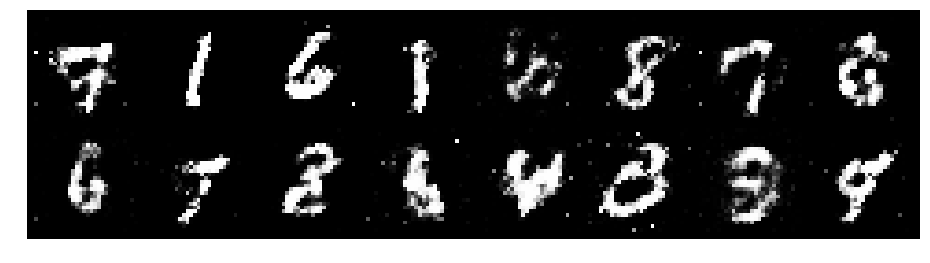

Epoch: [23/200], Batch Num: [0/938]
Discriminator Loss: 0.8374956846237183, Generator Loss: 1.5443079471588135
D(x): 0.6927, D(G(z)): 0.2512


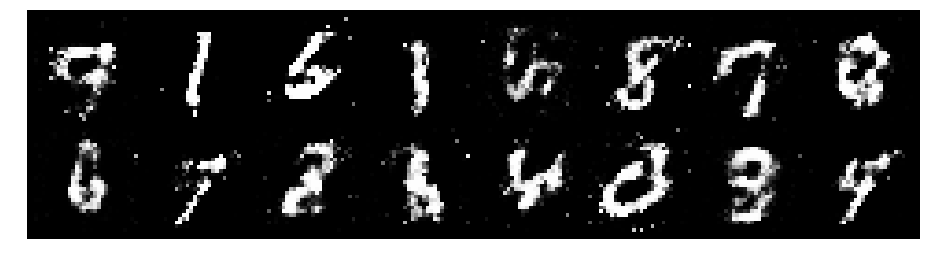

Epoch: [23/200], Batch Num: [100/938]
Discriminator Loss: 1.0183690786361694, Generator Loss: 1.355026125907898
D(x): 0.6485, D(G(z)): 0.3393


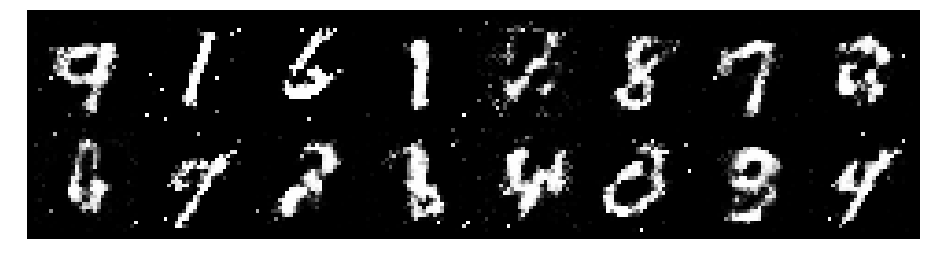

Epoch: [23/200], Batch Num: [200/938]
Discriminator Loss: 0.9582139253616333, Generator Loss: 1.2640764713287354
D(x): 0.6454, D(G(z)): 0.3322


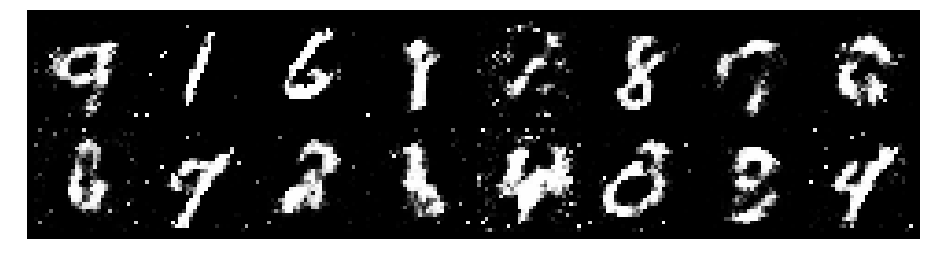

Epoch: [23/200], Batch Num: [300/938]
Discriminator Loss: 0.9643910527229309, Generator Loss: 1.1431970596313477
D(x): 0.7016, D(G(z)): 0.3643


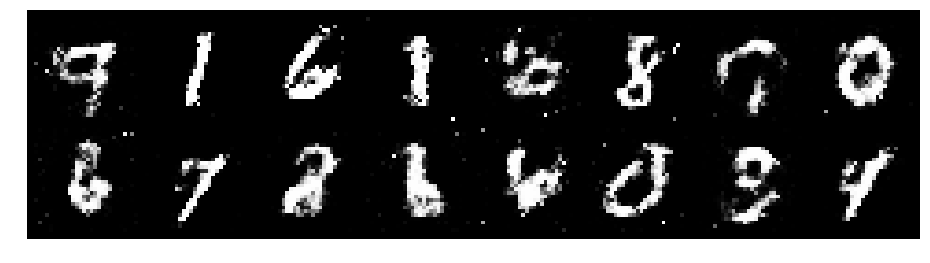

Epoch: [23/200], Batch Num: [400/938]
Discriminator Loss: 1.0218431949615479, Generator Loss: 2.1977384090423584
D(x): 0.6481, D(G(z)): 0.3136


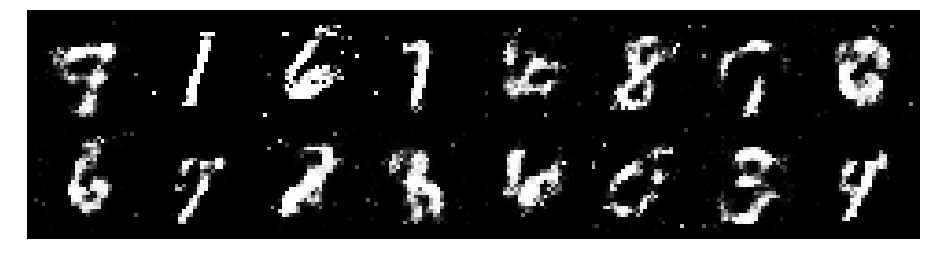

Epoch: [23/200], Batch Num: [500/938]
Discriminator Loss: 1.0610988140106201, Generator Loss: 1.389214038848877
D(x): 0.6367, D(G(z)): 0.3705


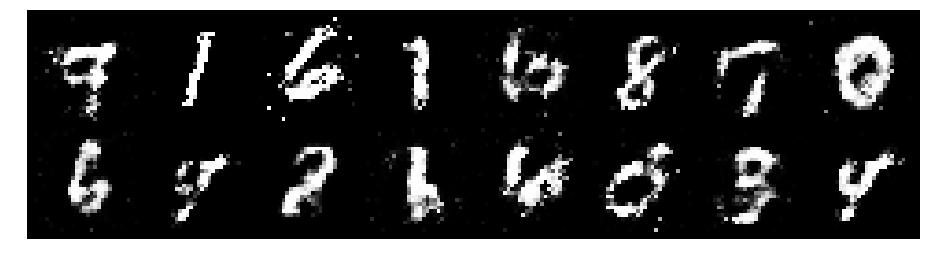

Epoch: [23/200], Batch Num: [600/938]
Discriminator Loss: 1.1150751113891602, Generator Loss: 1.3442357778549194
D(x): 0.6468, D(G(z)): 0.3613


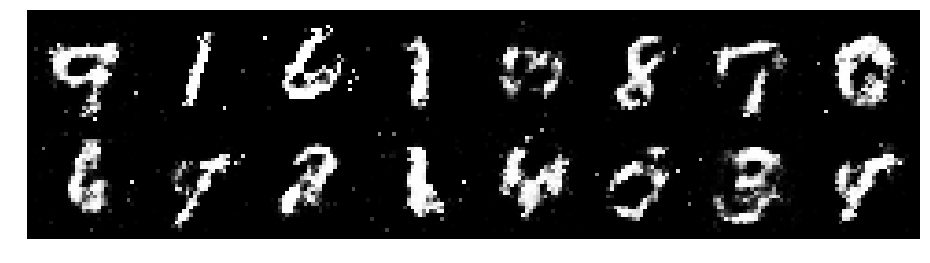

Epoch: [23/200], Batch Num: [700/938]
Discriminator Loss: 1.0675444602966309, Generator Loss: 1.2108384370803833
D(x): 0.6859, D(G(z)): 0.3904


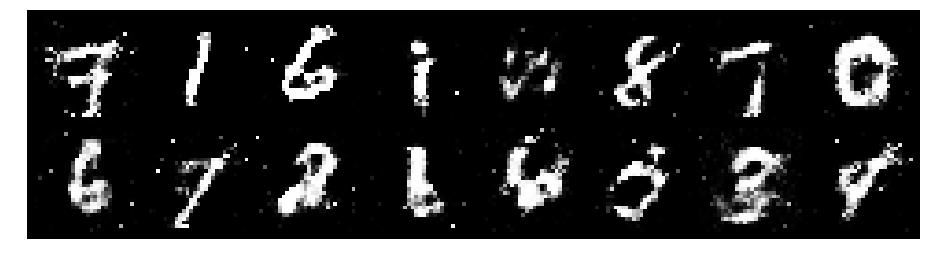

Epoch: [23/200], Batch Num: [800/938]
Discriminator Loss: 1.1702921390533447, Generator Loss: 1.054897427558899
D(x): 0.6599, D(G(z)): 0.4118


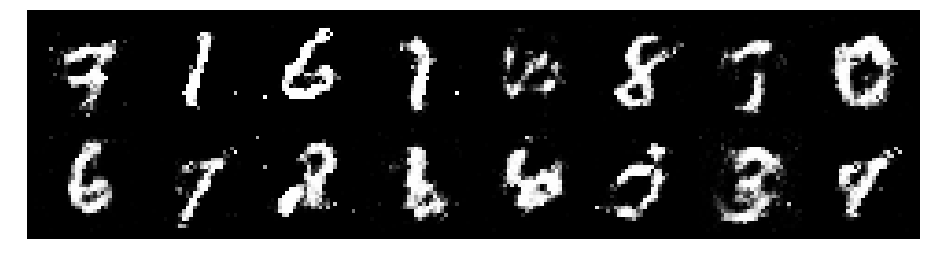

Epoch: [23/200], Batch Num: [900/938]
Discriminator Loss: 0.9863647818565369, Generator Loss: 1.3320012092590332
D(x): 0.6904, D(G(z)): 0.3722


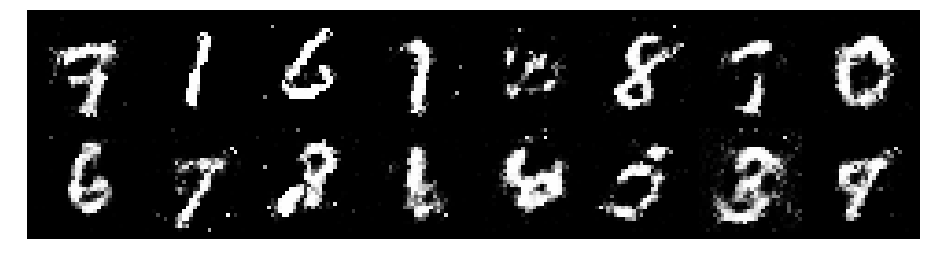

Epoch: [24/200], Batch Num: [0/938]
Discriminator Loss: 1.1197510957717896, Generator Loss: 1.3268177509307861
D(x): 0.6445, D(G(z)): 0.3763


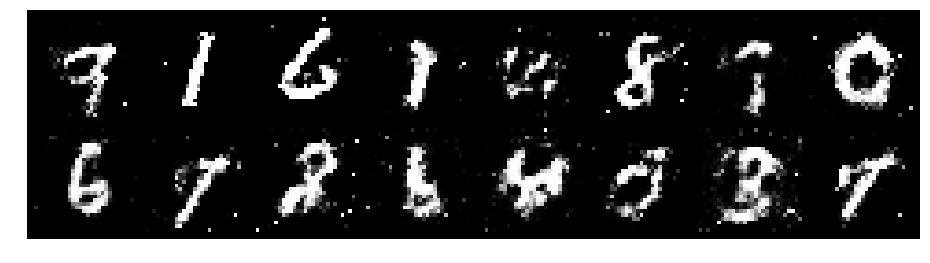

Epoch: [24/200], Batch Num: [100/938]
Discriminator Loss: 1.2076621055603027, Generator Loss: 1.5336743593215942
D(x): 0.5909, D(G(z)): 0.3509


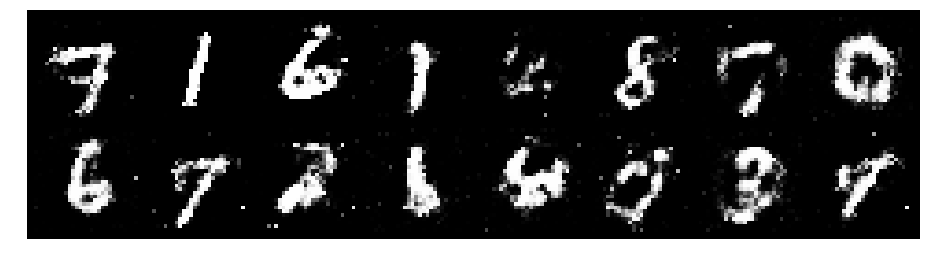

Epoch: [24/200], Batch Num: [200/938]
Discriminator Loss: 1.0865761041641235, Generator Loss: 1.3238695859909058
D(x): 0.7223, D(G(z)): 0.3869


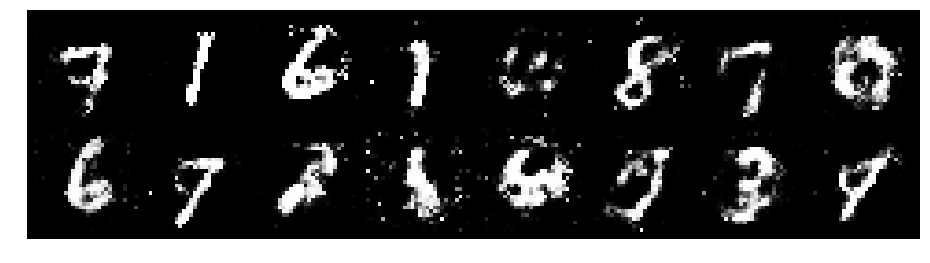

Epoch: [24/200], Batch Num: [300/938]
Discriminator Loss: 1.0023425817489624, Generator Loss: 1.333959698677063
D(x): 0.6420, D(G(z)): 0.3495


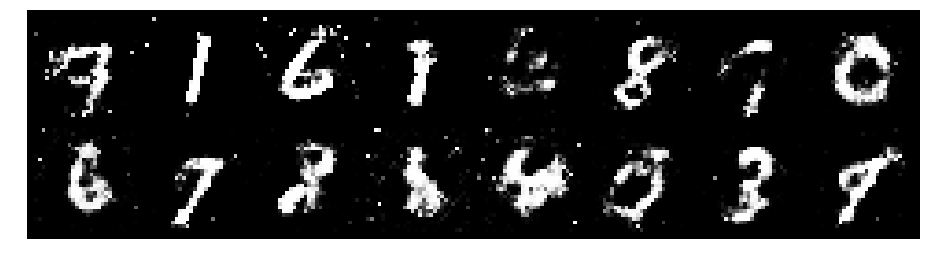

Epoch: [24/200], Batch Num: [400/938]
Discriminator Loss: 0.9558918476104736, Generator Loss: 1.2030097246170044
D(x): 0.6375, D(G(z)): 0.3189


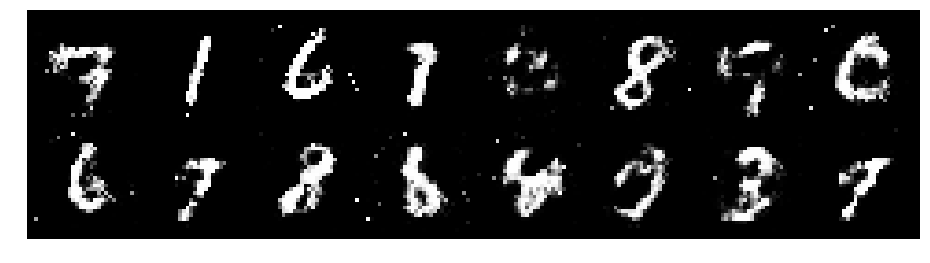

Epoch: [24/200], Batch Num: [500/938]
Discriminator Loss: 1.2384721040725708, Generator Loss: 0.910566508769989
D(x): 0.6074, D(G(z)): 0.4542


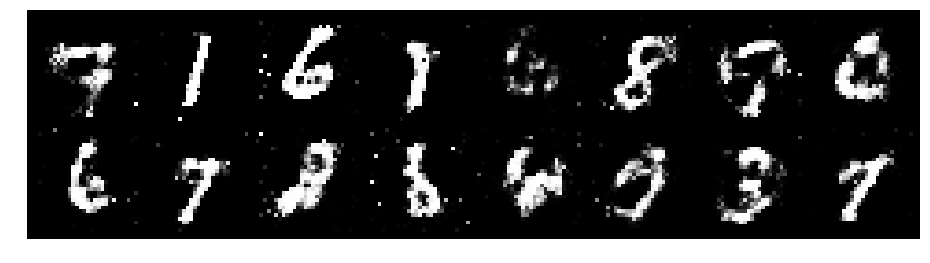

Epoch: [24/200], Batch Num: [600/938]
Discriminator Loss: 1.1831490993499756, Generator Loss: 0.7762073278427124
D(x): 0.6655, D(G(z)): 0.4604


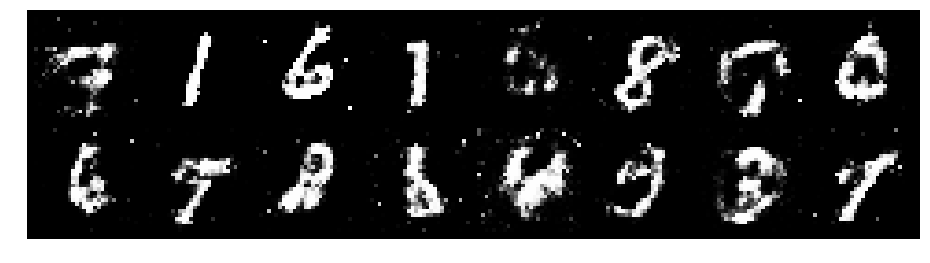

Epoch: [24/200], Batch Num: [700/938]
Discriminator Loss: 1.3563330173492432, Generator Loss: 1.3374146223068237
D(x): 0.5315, D(G(z)): 0.3858


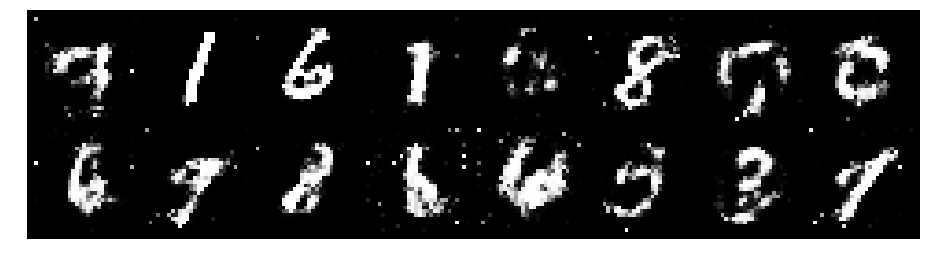

Epoch: [24/200], Batch Num: [800/938]
Discriminator Loss: 1.4182300567626953, Generator Loss: 1.0537396669387817
D(x): 0.5398, D(G(z)): 0.4307


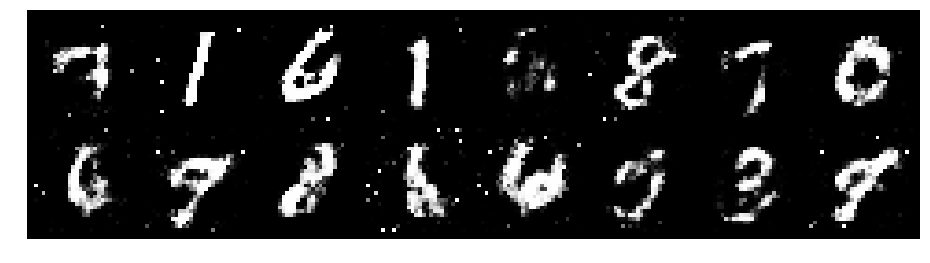

Epoch: [24/200], Batch Num: [900/938]
Discriminator Loss: 1.0502022504806519, Generator Loss: 1.4172472953796387
D(x): 0.6537, D(G(z)): 0.3793


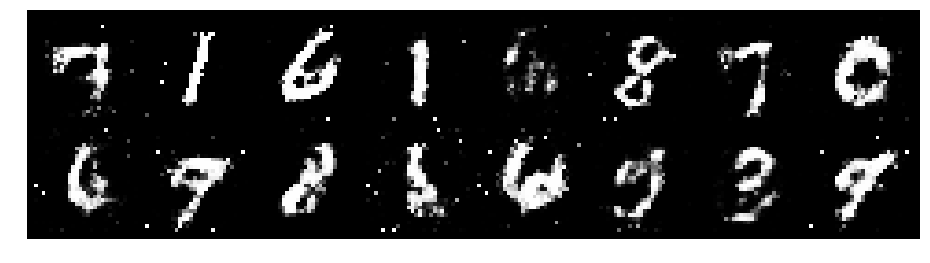

Epoch: [25/200], Batch Num: [0/938]
Discriminator Loss: 1.0907258987426758, Generator Loss: 1.1648578643798828
D(x): 0.6725, D(G(z)): 0.3989


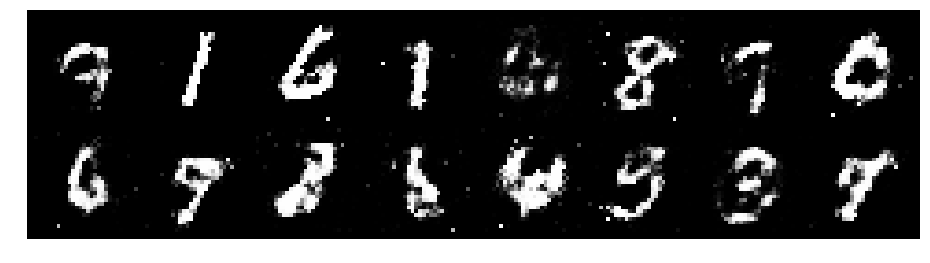

Epoch: [25/200], Batch Num: [100/938]
Discriminator Loss: 1.051722526550293, Generator Loss: 1.2651159763336182
D(x): 0.6720, D(G(z)): 0.3990


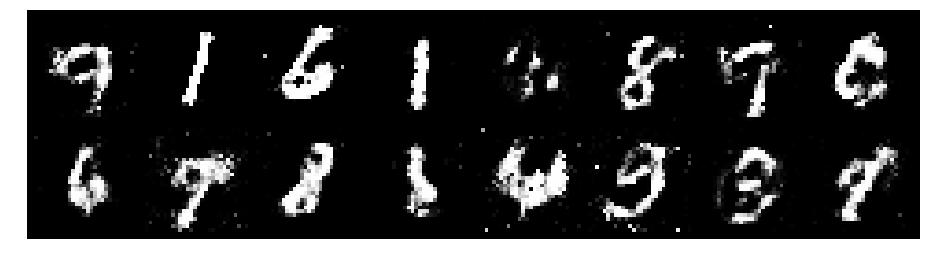

Epoch: [25/200], Batch Num: [200/938]
Discriminator Loss: 1.170884370803833, Generator Loss: 1.1167515516281128
D(x): 0.5953, D(G(z)): 0.3533


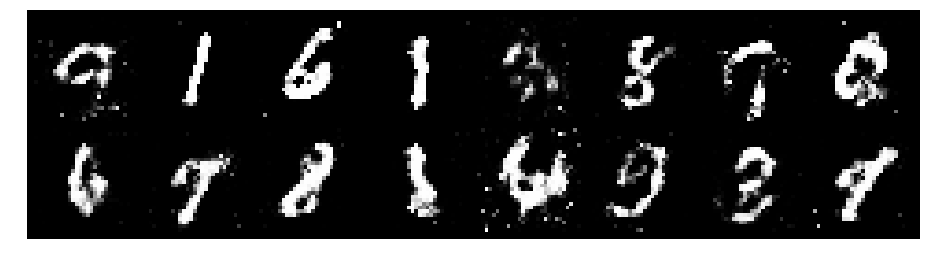

Epoch: [25/200], Batch Num: [300/938]
Discriminator Loss: 1.224869728088379, Generator Loss: 1.2149803638458252
D(x): 0.6761, D(G(z)): 0.4527


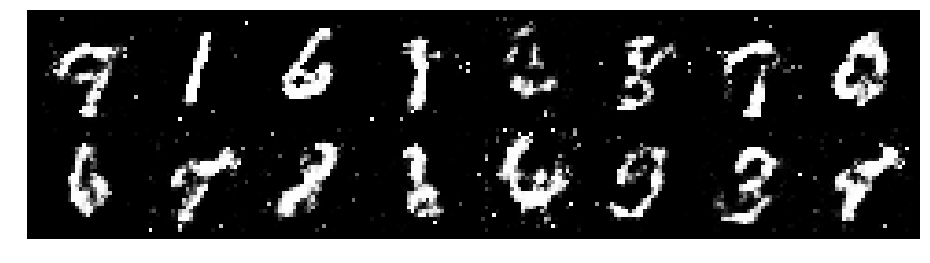

Epoch: [25/200], Batch Num: [400/938]
Discriminator Loss: 1.2202694416046143, Generator Loss: 1.250555396080017
D(x): 0.6234, D(G(z)): 0.4072


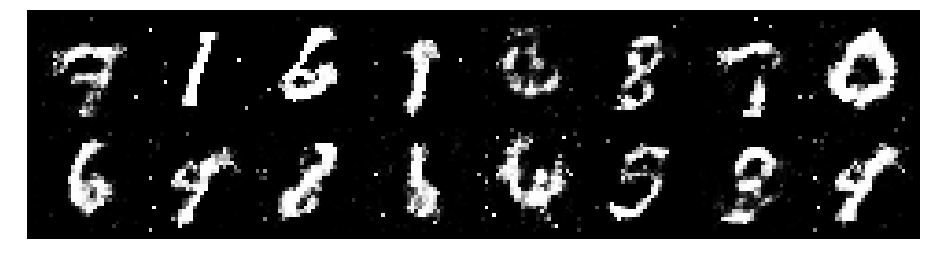

Epoch: [25/200], Batch Num: [500/938]
Discriminator Loss: 1.1003520488739014, Generator Loss: 1.0726947784423828
D(x): 0.6067, D(G(z)): 0.3734


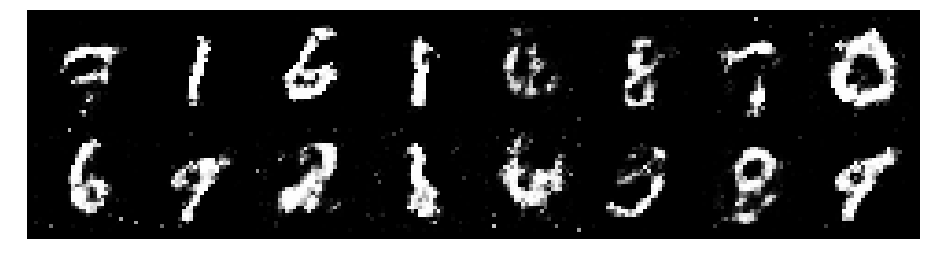

Epoch: [25/200], Batch Num: [600/938]
Discriminator Loss: 1.110933542251587, Generator Loss: 1.1205472946166992
D(x): 0.5809, D(G(z)): 0.3666


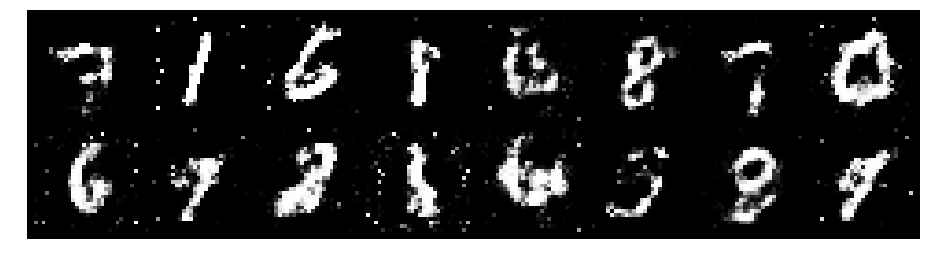

Epoch: [25/200], Batch Num: [700/938]
Discriminator Loss: 1.0595284700393677, Generator Loss: 1.0474581718444824
D(x): 0.5876, D(G(z)): 0.3514


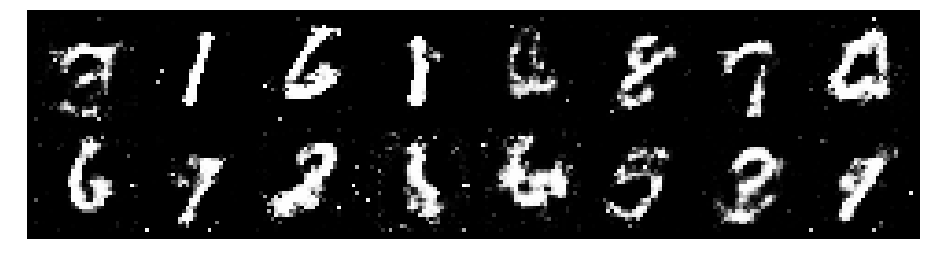

Epoch: [25/200], Batch Num: [800/938]
Discriminator Loss: 1.2514795064926147, Generator Loss: 0.9365512132644653
D(x): 0.6094, D(G(z)): 0.4717


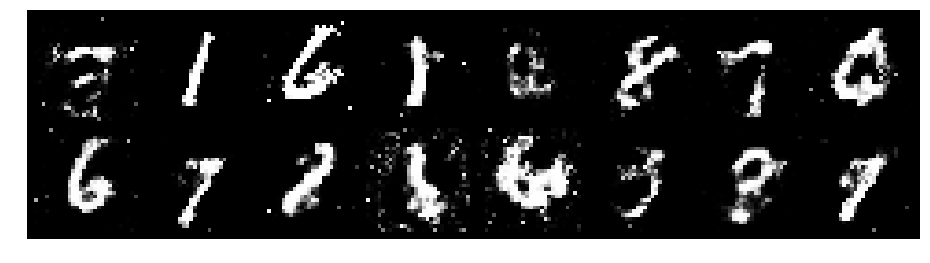

Epoch: [25/200], Batch Num: [900/938]
Discriminator Loss: 1.1077181100845337, Generator Loss: 1.1324882507324219
D(x): 0.5714, D(G(z)): 0.3258


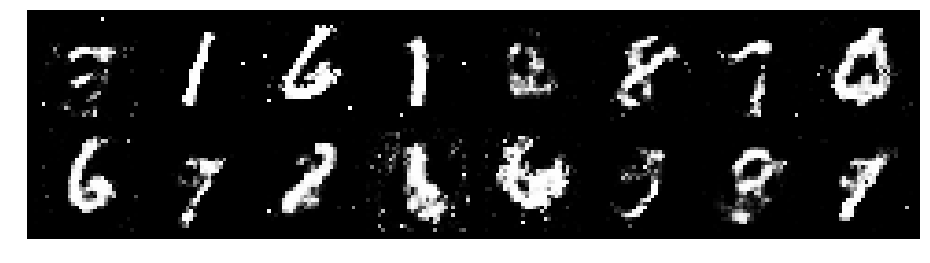

Epoch: [26/200], Batch Num: [0/938]
Discriminator Loss: 1.0282825231552124, Generator Loss: 1.4326739311218262
D(x): 0.6488, D(G(z)): 0.3607


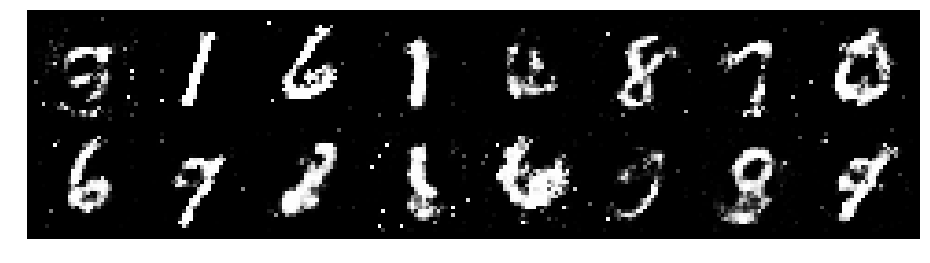

Epoch: [26/200], Batch Num: [100/938]
Discriminator Loss: 1.022452712059021, Generator Loss: 1.193850040435791
D(x): 0.6375, D(G(z)): 0.3694


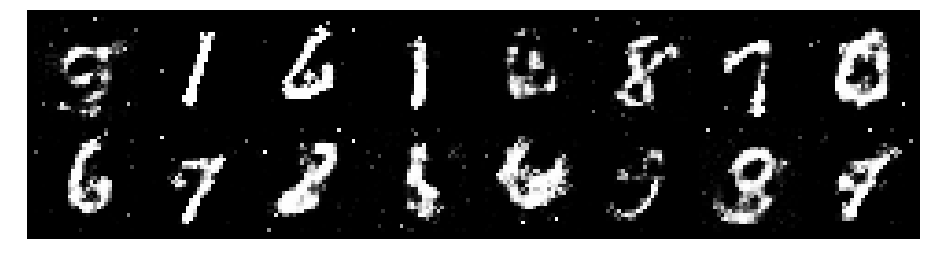

Epoch: [26/200], Batch Num: [200/938]
Discriminator Loss: 1.026820182800293, Generator Loss: 1.2047510147094727
D(x): 0.5960, D(G(z)): 0.3279


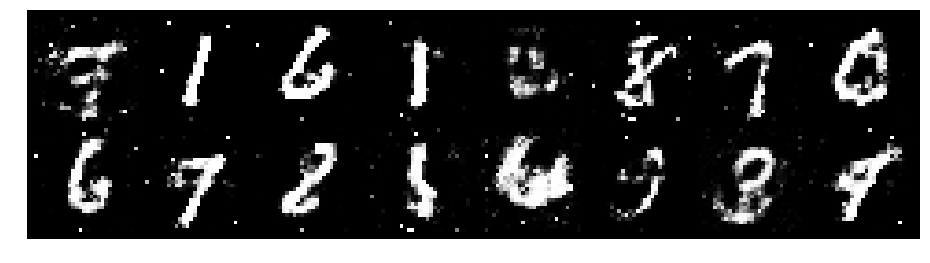

Epoch: [26/200], Batch Num: [300/938]
Discriminator Loss: 0.9064291715621948, Generator Loss: 1.2602076530456543
D(x): 0.6916, D(G(z)): 0.3532


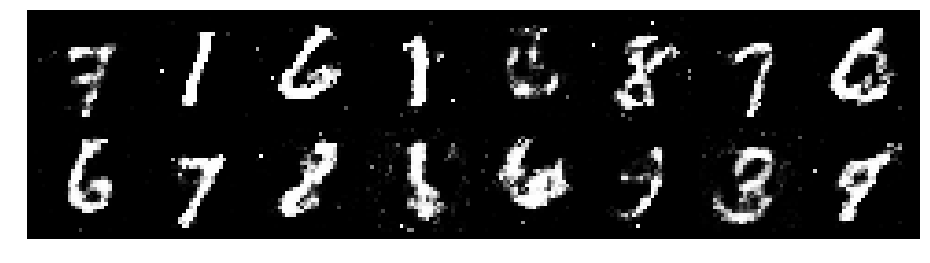

Epoch: [26/200], Batch Num: [400/938]
Discriminator Loss: 1.1398468017578125, Generator Loss: 1.3852380514144897
D(x): 0.5851, D(G(z)): 0.3471


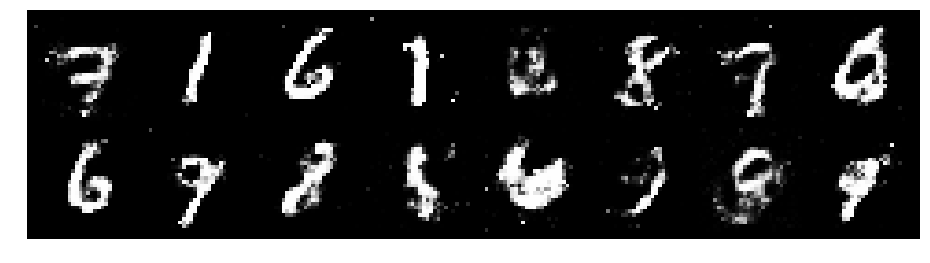

Epoch: [26/200], Batch Num: [500/938]
Discriminator Loss: 1.0009751319885254, Generator Loss: 1.4712915420532227
D(x): 0.6836, D(G(z)): 0.3428


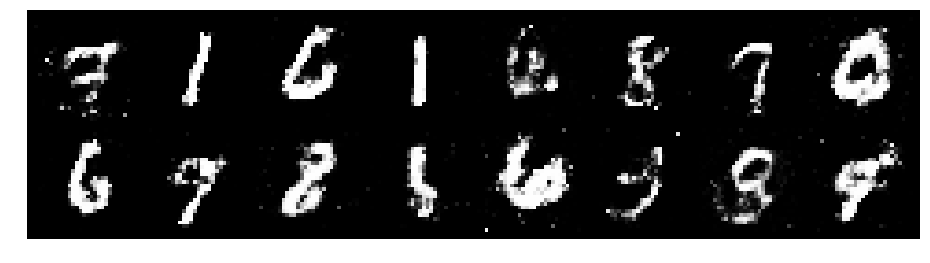

Epoch: [26/200], Batch Num: [600/938]
Discriminator Loss: 1.0842633247375488, Generator Loss: 0.9893382787704468
D(x): 0.6666, D(G(z)): 0.4141


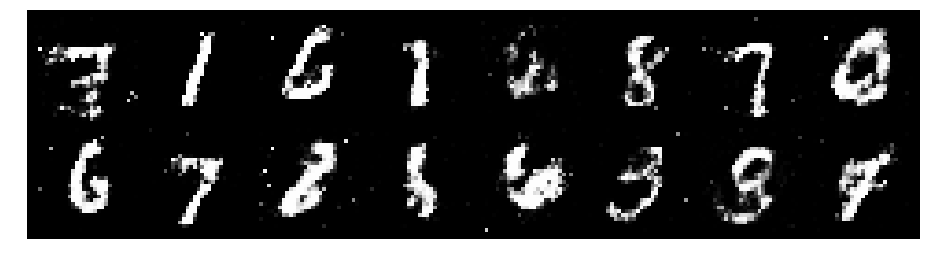

Epoch: [26/200], Batch Num: [700/938]
Discriminator Loss: 1.2052947282791138, Generator Loss: 1.2499918937683105
D(x): 0.5468, D(G(z)): 0.3785


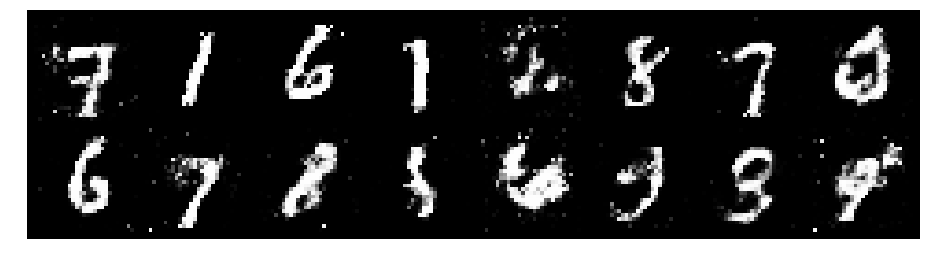

Epoch: [26/200], Batch Num: [800/938]
Discriminator Loss: 1.209073781967163, Generator Loss: 1.1552523374557495
D(x): 0.5716, D(G(z)): 0.3991


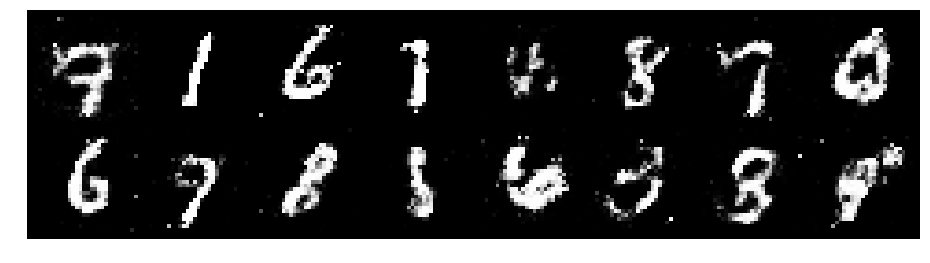

Epoch: [26/200], Batch Num: [900/938]
Discriminator Loss: 1.3569220304489136, Generator Loss: 0.9875340461730957
D(x): 0.4784, D(G(z)): 0.3933


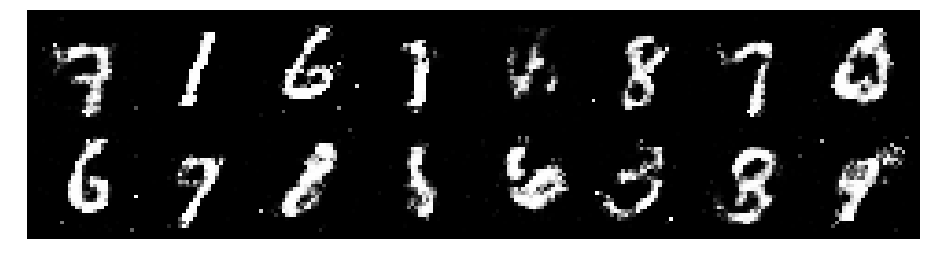

Epoch: [27/200], Batch Num: [0/938]
Discriminator Loss: 1.0582616329193115, Generator Loss: 1.0995665788650513
D(x): 0.6385, D(G(z)): 0.3791


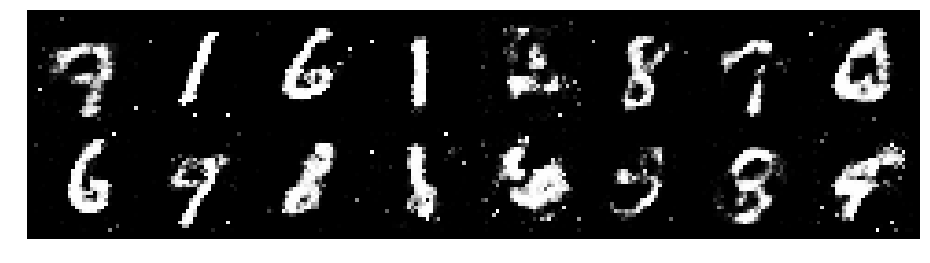

Epoch: [27/200], Batch Num: [100/938]
Discriminator Loss: 1.202893853187561, Generator Loss: 0.8896056413650513
D(x): 0.5920, D(G(z)): 0.4288


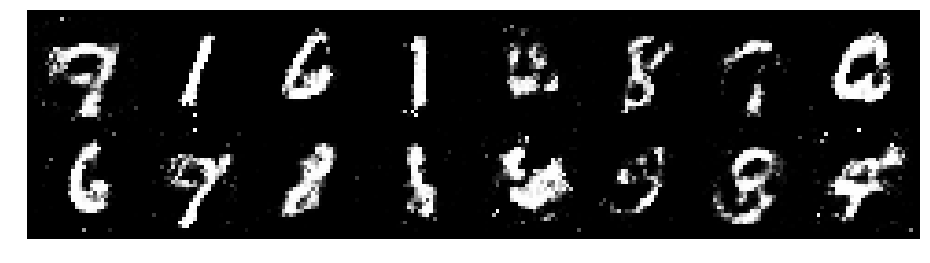

Epoch: [27/200], Batch Num: [200/938]
Discriminator Loss: 1.200272798538208, Generator Loss: 1.1693860292434692
D(x): 0.6047, D(G(z)): 0.4137


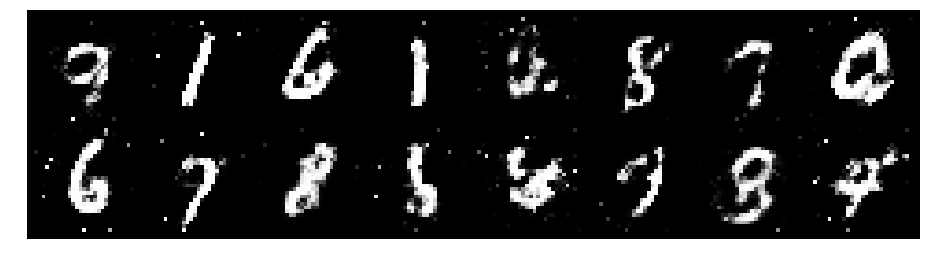

Epoch: [27/200], Batch Num: [300/938]
Discriminator Loss: 1.1344385147094727, Generator Loss: 1.17854642868042
D(x): 0.5821, D(G(z)): 0.3651


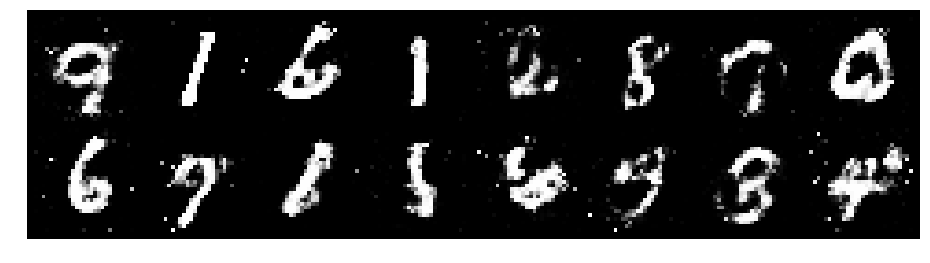

Epoch: [27/200], Batch Num: [400/938]
Discriminator Loss: 1.0948327779769897, Generator Loss: 1.2516955137252808
D(x): 0.6425, D(G(z)): 0.3472


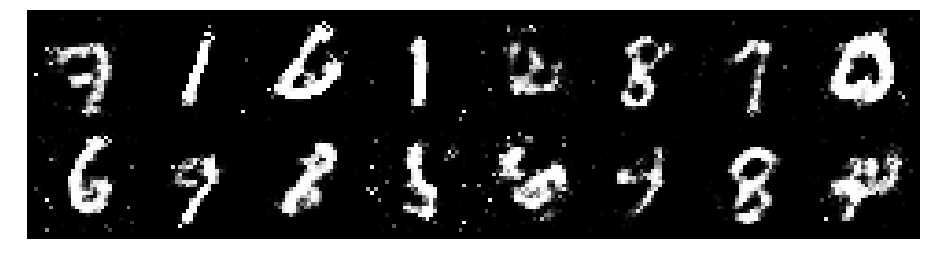

Epoch: [27/200], Batch Num: [500/938]
Discriminator Loss: 1.0663621425628662, Generator Loss: 1.0783506631851196
D(x): 0.6518, D(G(z)): 0.3982


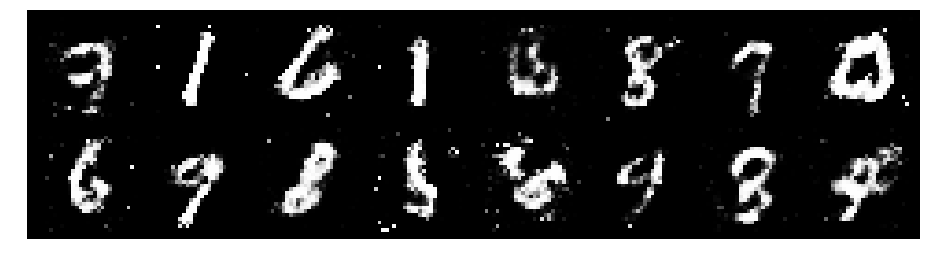

Epoch: [27/200], Batch Num: [600/938]
Discriminator Loss: 1.1525486707687378, Generator Loss: 1.2160249948501587
D(x): 0.5835, D(G(z)): 0.3565


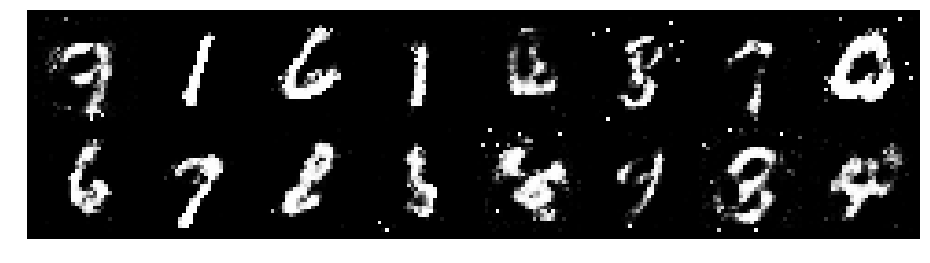

Epoch: [27/200], Batch Num: [700/938]
Discriminator Loss: 1.071781873703003, Generator Loss: 1.2548575401306152
D(x): 0.6199, D(G(z)): 0.3589


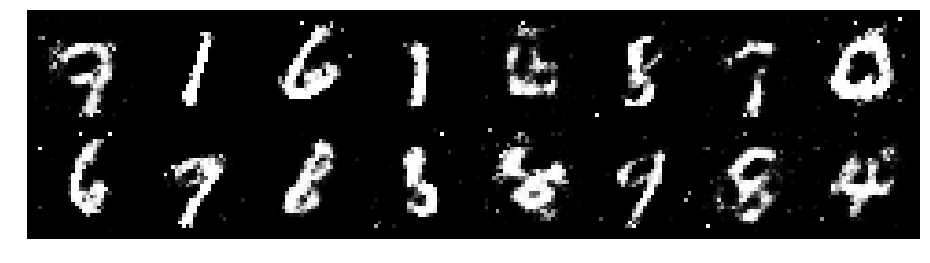

Epoch: [27/200], Batch Num: [800/938]
Discriminator Loss: 1.3484153747558594, Generator Loss: 0.919853925704956
D(x): 0.6178, D(G(z)): 0.4896


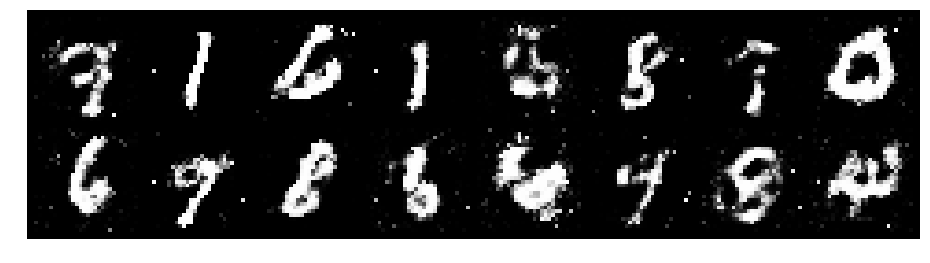

Epoch: [27/200], Batch Num: [900/938]
Discriminator Loss: 1.1844357252120972, Generator Loss: 0.9088064432144165
D(x): 0.6400, D(G(z)): 0.4746


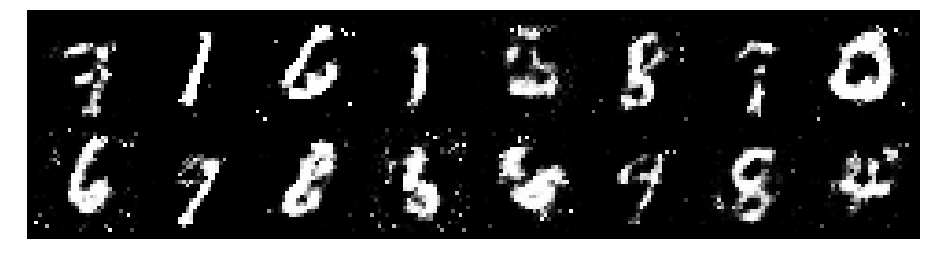

Epoch: [28/200], Batch Num: [0/938]
Discriminator Loss: 1.161881923675537, Generator Loss: 1.1426348686218262
D(x): 0.5753, D(G(z)): 0.3596


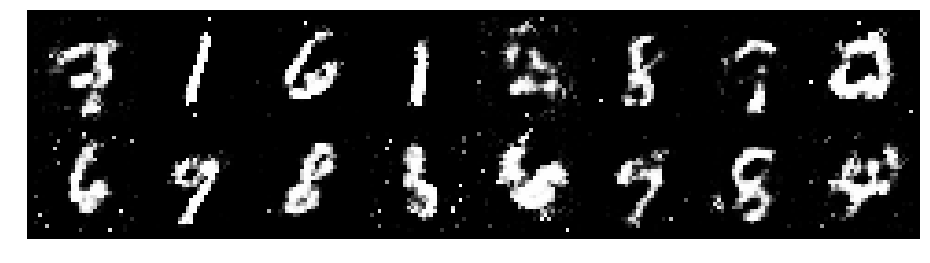

Epoch: [28/200], Batch Num: [100/938]
Discriminator Loss: 1.2318687438964844, Generator Loss: 0.8606811165809631
D(x): 0.6061, D(G(z)): 0.4349


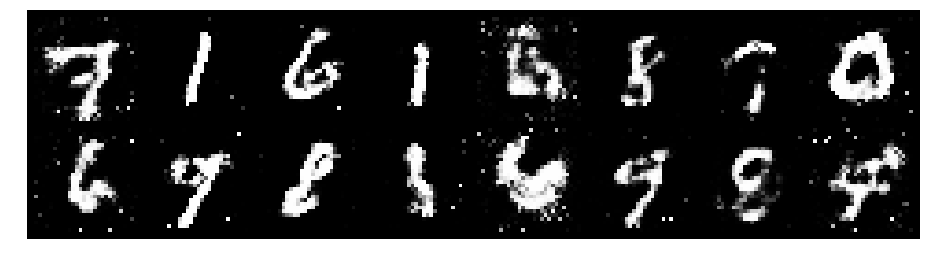

Epoch: [28/200], Batch Num: [200/938]
Discriminator Loss: 1.2109572887420654, Generator Loss: 1.139630913734436
D(x): 0.6414, D(G(z)): 0.4168


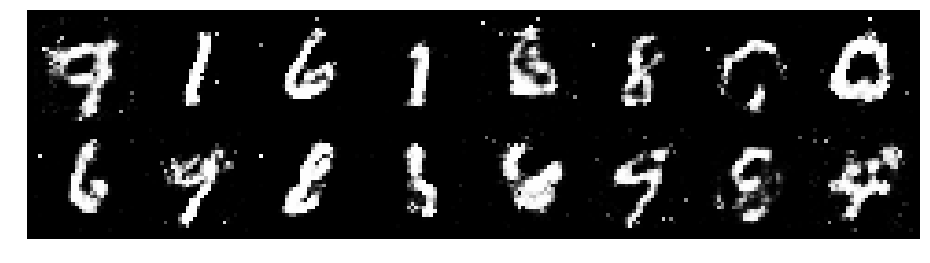

Epoch: [28/200], Batch Num: [300/938]
Discriminator Loss: 1.2243618965148926, Generator Loss: 1.1619330644607544
D(x): 0.6913, D(G(z)): 0.4463


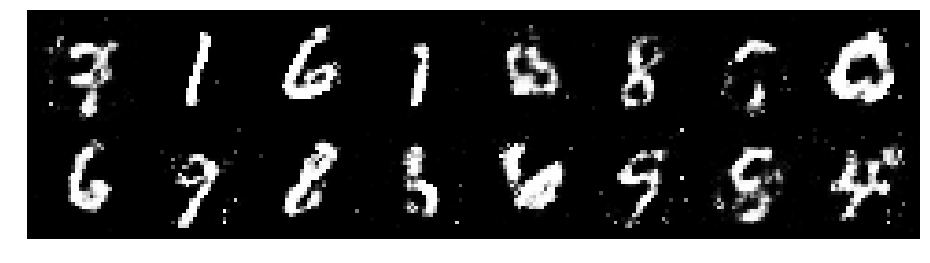

Epoch: [28/200], Batch Num: [400/938]
Discriminator Loss: 1.173137903213501, Generator Loss: 1.119445562362671
D(x): 0.6262, D(G(z)): 0.4159


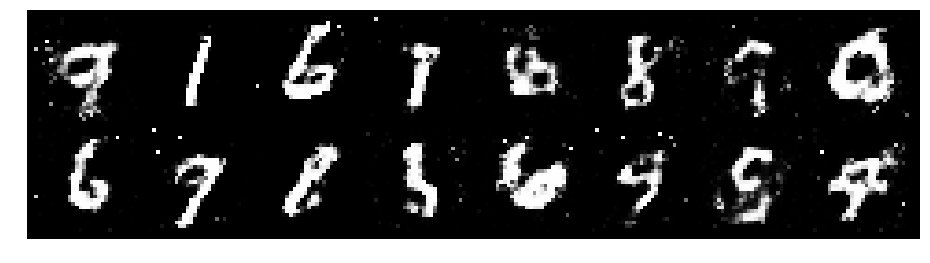

Epoch: [28/200], Batch Num: [500/938]
Discriminator Loss: 1.0803346633911133, Generator Loss: 1.3249142169952393
D(x): 0.6034, D(G(z)): 0.3254


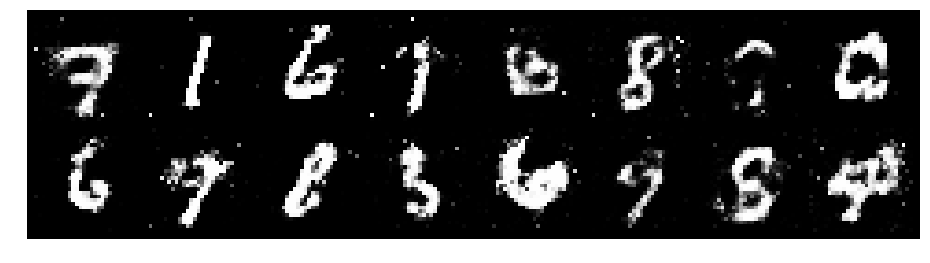

Epoch: [28/200], Batch Num: [600/938]
Discriminator Loss: 1.1014668941497803, Generator Loss: 1.1869233846664429
D(x): 0.6300, D(G(z)): 0.3603


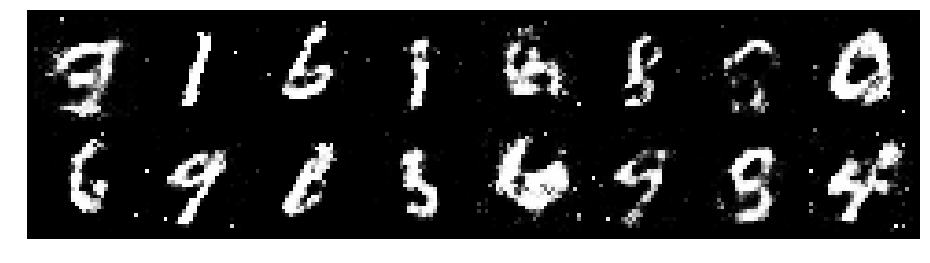

Epoch: [28/200], Batch Num: [700/938]
Discriminator Loss: 1.271910548210144, Generator Loss: 0.9908202290534973
D(x): 0.6704, D(G(z)): 0.5063


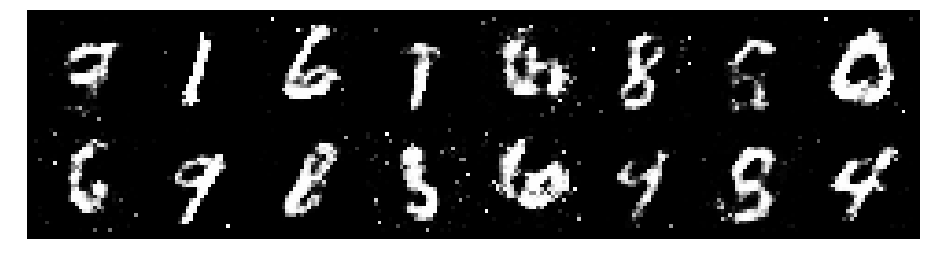

Epoch: [28/200], Batch Num: [800/938]
Discriminator Loss: 1.238815188407898, Generator Loss: 1.1732282638549805
D(x): 0.6426, D(G(z)): 0.4323


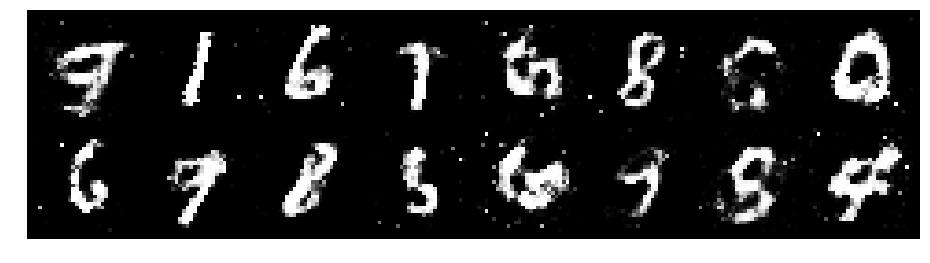

Epoch: [28/200], Batch Num: [900/938]
Discriminator Loss: 1.049931287765503, Generator Loss: 1.2486541271209717
D(x): 0.6910, D(G(z)): 0.3900


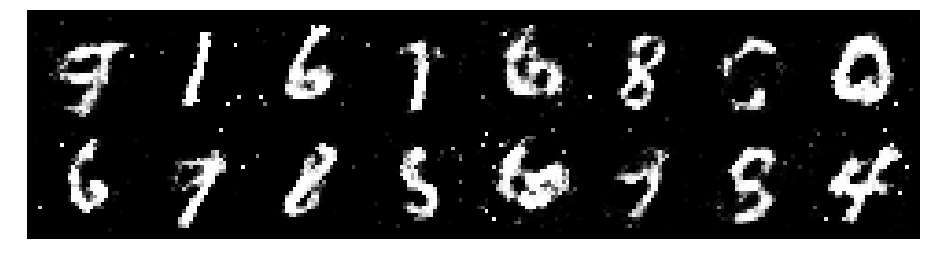

Epoch: [29/200], Batch Num: [0/938]
Discriminator Loss: 1.0108983516693115, Generator Loss: 1.0821373462677002
D(x): 0.6076, D(G(z)): 0.3125


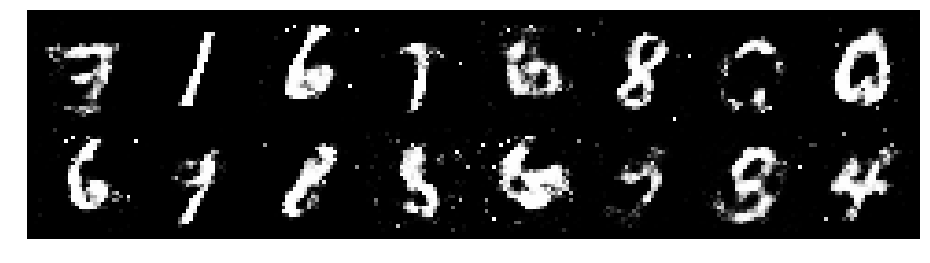

Epoch: [29/200], Batch Num: [100/938]
Discriminator Loss: 0.9299442768096924, Generator Loss: 1.3915071487426758
D(x): 0.7029, D(G(z)): 0.3804


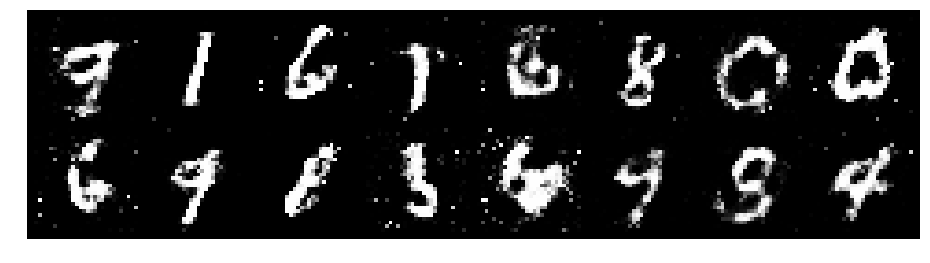

Epoch: [29/200], Batch Num: [200/938]
Discriminator Loss: 1.1165401935577393, Generator Loss: 1.1187849044799805
D(x): 0.5834, D(G(z)): 0.3565


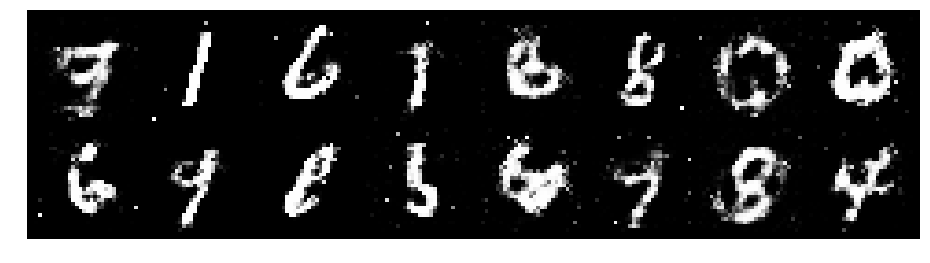

Epoch: [29/200], Batch Num: [300/938]
Discriminator Loss: 1.0340332984924316, Generator Loss: 1.1761152744293213
D(x): 0.6337, D(G(z)): 0.3568


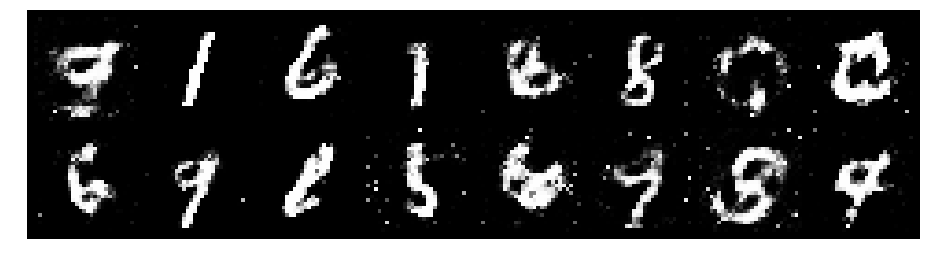

Epoch: [29/200], Batch Num: [400/938]
Discriminator Loss: 1.0686020851135254, Generator Loss: 1.230117917060852
D(x): 0.6135, D(G(z)): 0.3700


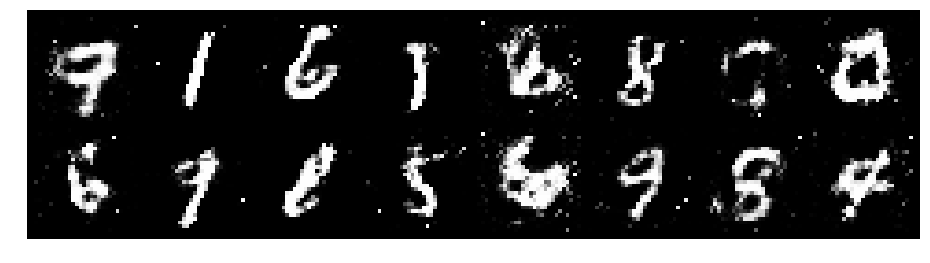

Epoch: [29/200], Batch Num: [500/938]
Discriminator Loss: 1.18307363986969, Generator Loss: 0.9945489764213562
D(x): 0.5877, D(G(z)): 0.3983


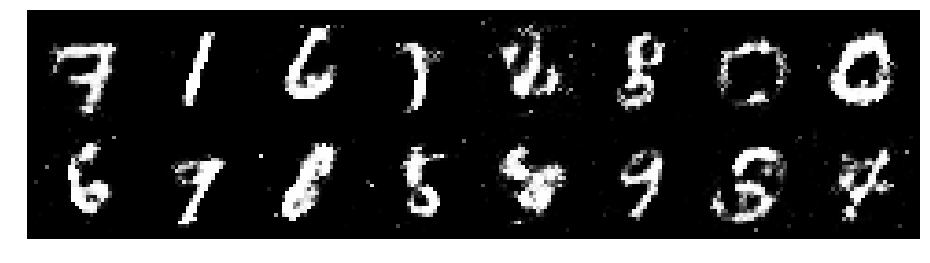

Epoch: [29/200], Batch Num: [600/938]
Discriminator Loss: 1.1130778789520264, Generator Loss: 0.8481149077415466
D(x): 0.5936, D(G(z)): 0.3802


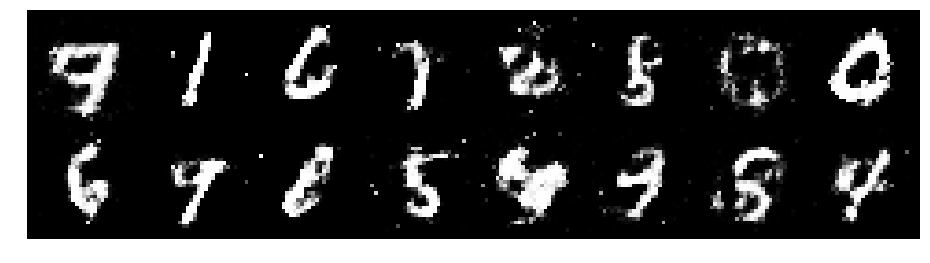

Epoch: [29/200], Batch Num: [700/938]
Discriminator Loss: 1.1237635612487793, Generator Loss: 0.9959471225738525
D(x): 0.6287, D(G(z)): 0.4266


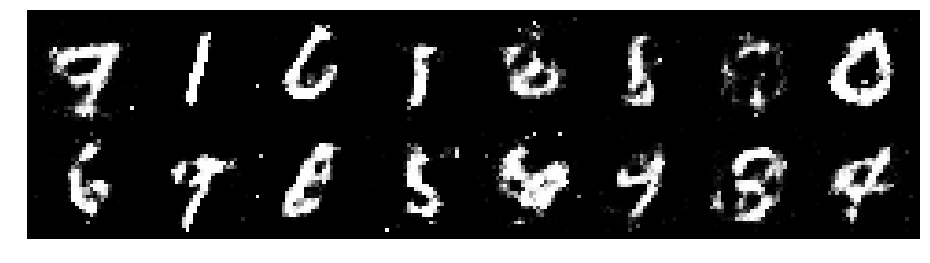

Epoch: [29/200], Batch Num: [800/938]
Discriminator Loss: 1.1932367086410522, Generator Loss: 1.0978983640670776
D(x): 0.6201, D(G(z)): 0.4328


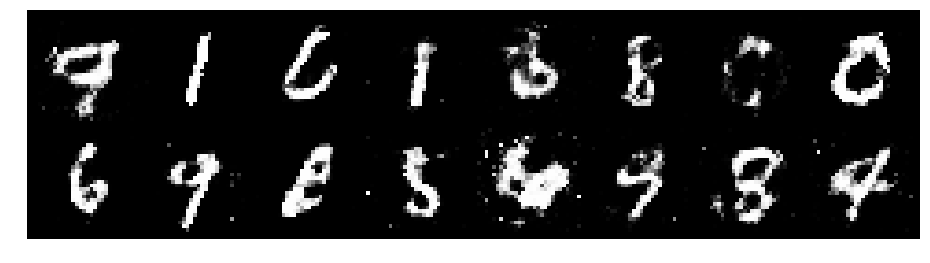

Epoch: [29/200], Batch Num: [900/938]
Discriminator Loss: 1.1389906406402588, Generator Loss: 1.0353424549102783
D(x): 0.6835, D(G(z)): 0.4586


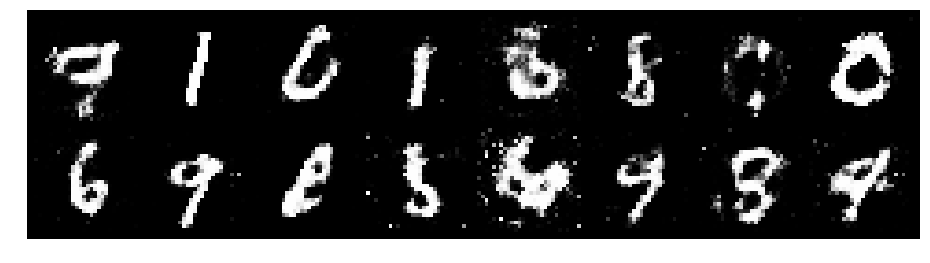

Epoch: [30/200], Batch Num: [0/938]
Discriminator Loss: 1.1731387376785278, Generator Loss: 1.0971262454986572
D(x): 0.5604, D(G(z)): 0.3810


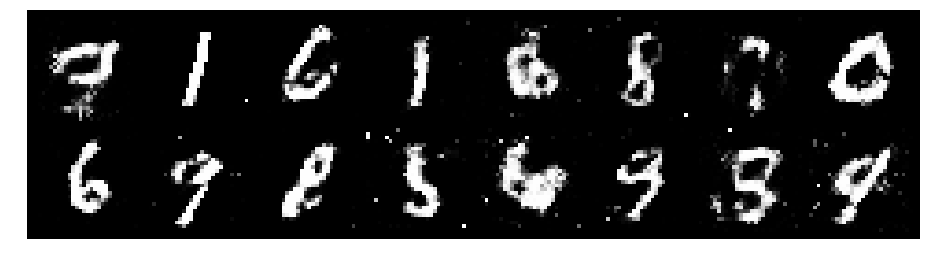

Epoch: [30/200], Batch Num: [100/938]
Discriminator Loss: 1.0582630634307861, Generator Loss: 1.0608763694763184
D(x): 0.5826, D(G(z)): 0.3320


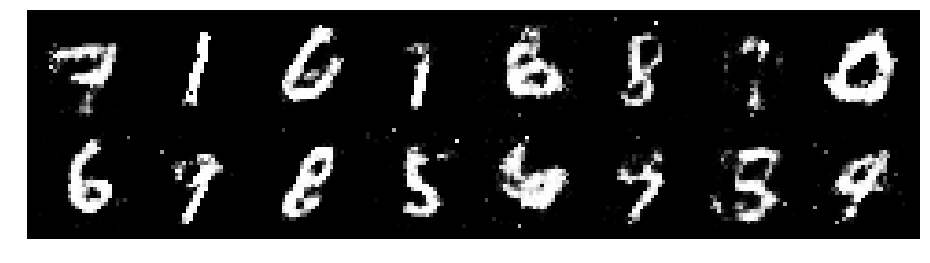

Epoch: [30/200], Batch Num: [200/938]
Discriminator Loss: 1.138685703277588, Generator Loss: 0.9597654342651367
D(x): 0.6152, D(G(z)): 0.3944


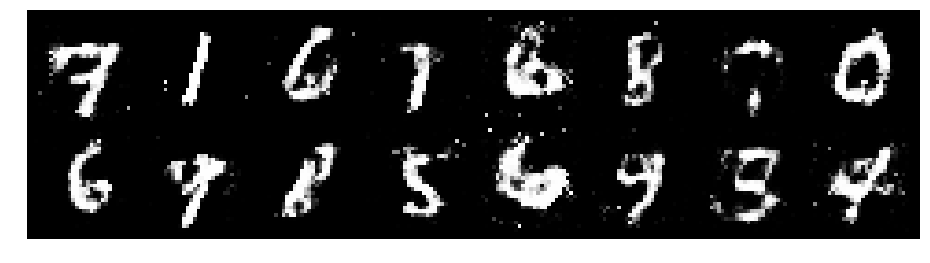

Epoch: [30/200], Batch Num: [300/938]
Discriminator Loss: 1.2243366241455078, Generator Loss: 1.0182936191558838
D(x): 0.6297, D(G(z)): 0.4384


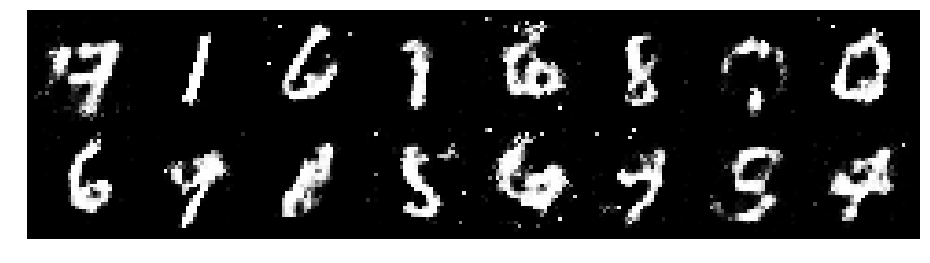

Epoch: [30/200], Batch Num: [400/938]
Discriminator Loss: 1.2834526300430298, Generator Loss: 1.2268829345703125
D(x): 0.5616, D(G(z)): 0.3922


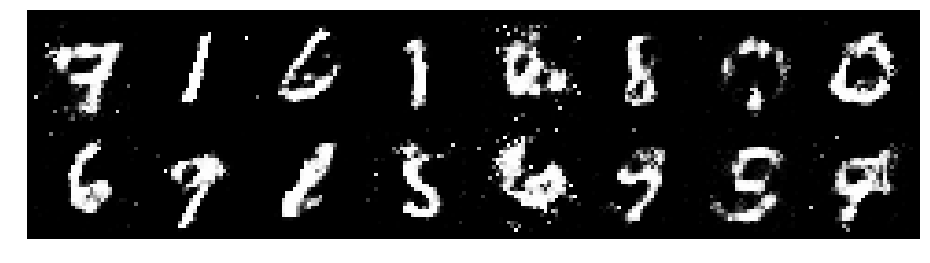

Epoch: [30/200], Batch Num: [500/938]
Discriminator Loss: 0.991302490234375, Generator Loss: 1.1831902265548706
D(x): 0.6921, D(G(z)): 0.3842


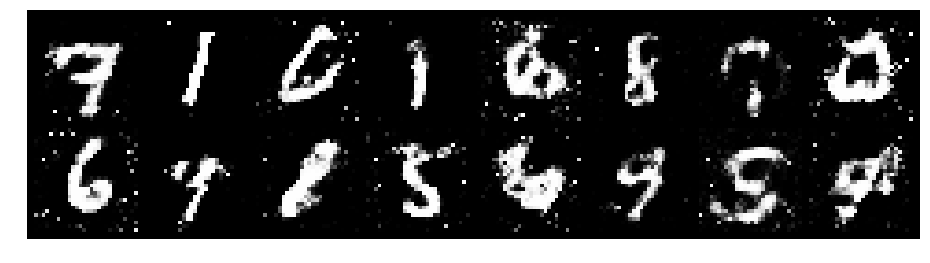

Epoch: [30/200], Batch Num: [600/938]
Discriminator Loss: 1.010557770729065, Generator Loss: 1.1562249660491943
D(x): 0.6275, D(G(z)): 0.3519


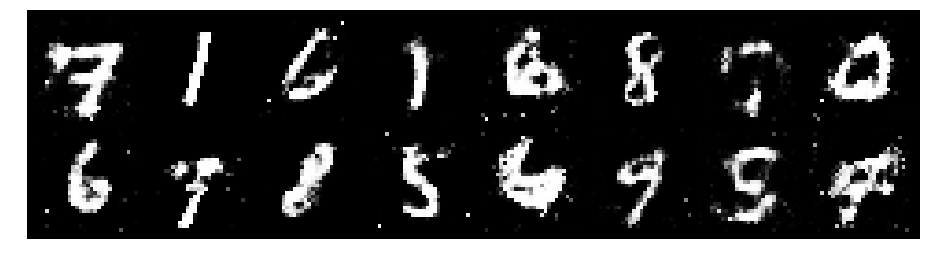

Epoch: [30/200], Batch Num: [700/938]
Discriminator Loss: 1.0845154523849487, Generator Loss: 1.1225674152374268
D(x): 0.6699, D(G(z)): 0.4182


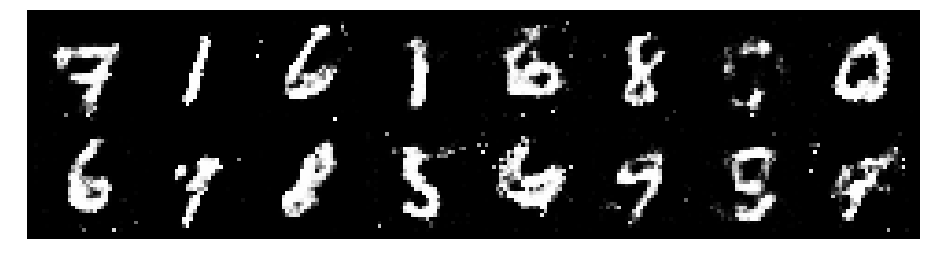

Epoch: [30/200], Batch Num: [800/938]
Discriminator Loss: 1.1347064971923828, Generator Loss: 1.1334871053695679
D(x): 0.6438, D(G(z)): 0.4173


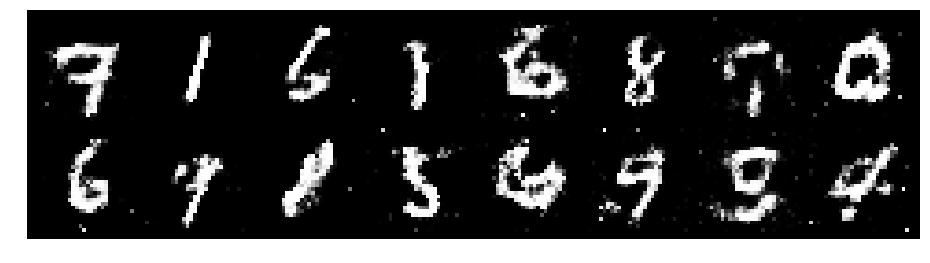

Epoch: [30/200], Batch Num: [900/938]
Discriminator Loss: 1.0408580303192139, Generator Loss: 1.2073352336883545
D(x): 0.7010, D(G(z)): 0.4276


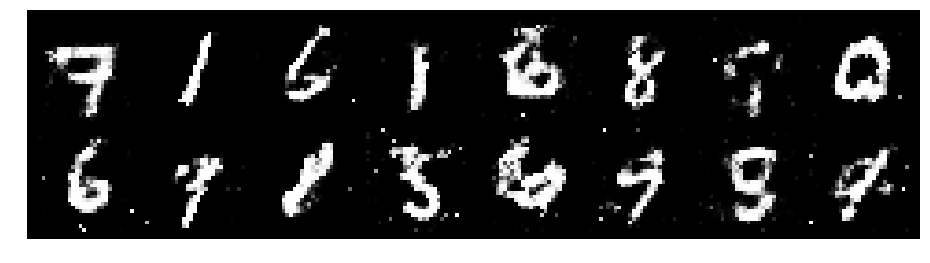

Epoch: [31/200], Batch Num: [0/938]
Discriminator Loss: 1.0916635990142822, Generator Loss: 1.1736432313919067
D(x): 0.5722, D(G(z)): 0.3539


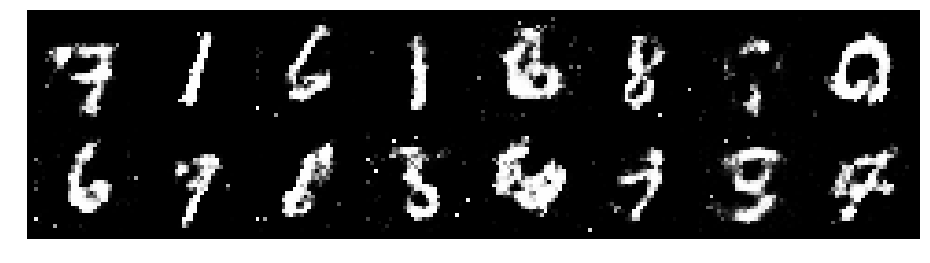

Epoch: [31/200], Batch Num: [100/938]
Discriminator Loss: 1.2161407470703125, Generator Loss: 1.0791772603988647
D(x): 0.5912, D(G(z)): 0.4250


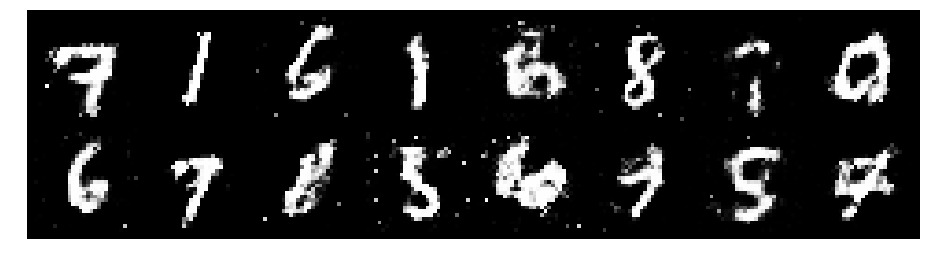

Epoch: [31/200], Batch Num: [200/938]
Discriminator Loss: 1.246870756149292, Generator Loss: 1.0919578075408936
D(x): 0.5615, D(G(z)): 0.4063


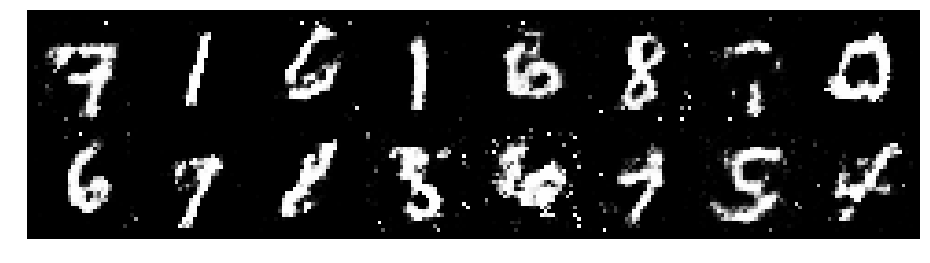

Epoch: [31/200], Batch Num: [300/938]
Discriminator Loss: 1.1859842538833618, Generator Loss: 0.9912459254264832
D(x): 0.6221, D(G(z)): 0.4273


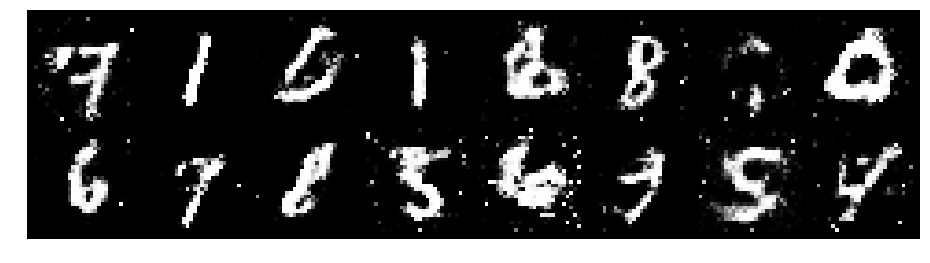

Epoch: [31/200], Batch Num: [400/938]
Discriminator Loss: 1.2533080577850342, Generator Loss: 0.8100954294204712
D(x): 0.5689, D(G(z)): 0.4419


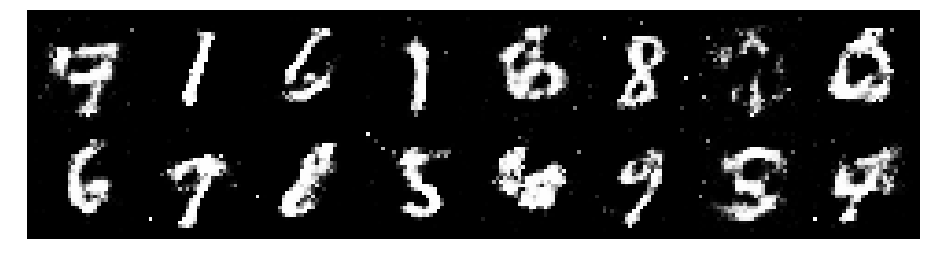

Epoch: [31/200], Batch Num: [500/938]
Discriminator Loss: 1.1826543807983398, Generator Loss: 0.9549564123153687
D(x): 0.5930, D(G(z)): 0.4083


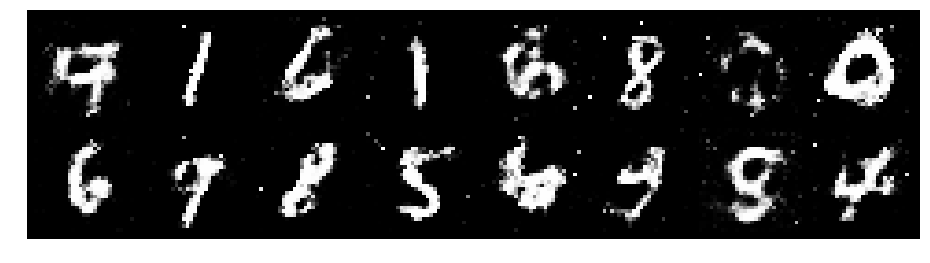

Epoch: [31/200], Batch Num: [600/938]
Discriminator Loss: 1.0901336669921875, Generator Loss: 1.0489842891693115
D(x): 0.6123, D(G(z)): 0.3618


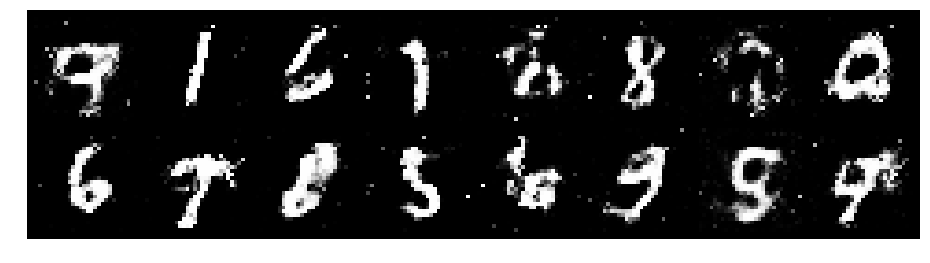

Epoch: [31/200], Batch Num: [700/938]
Discriminator Loss: 1.1716508865356445, Generator Loss: 1.217758059501648
D(x): 0.5886, D(G(z)): 0.3919


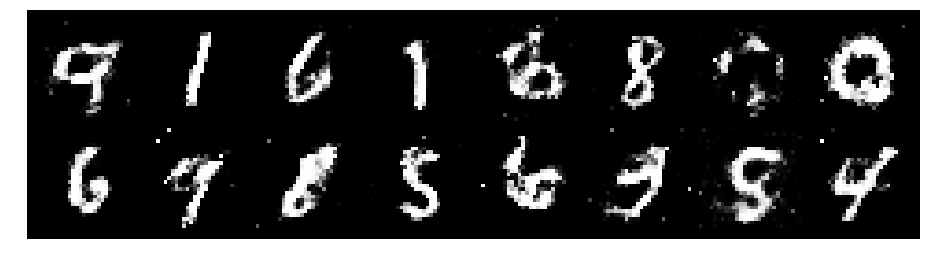

Epoch: [31/200], Batch Num: [800/938]
Discriminator Loss: 1.118661880493164, Generator Loss: 0.9759646058082581
D(x): 0.6341, D(G(z)): 0.4137


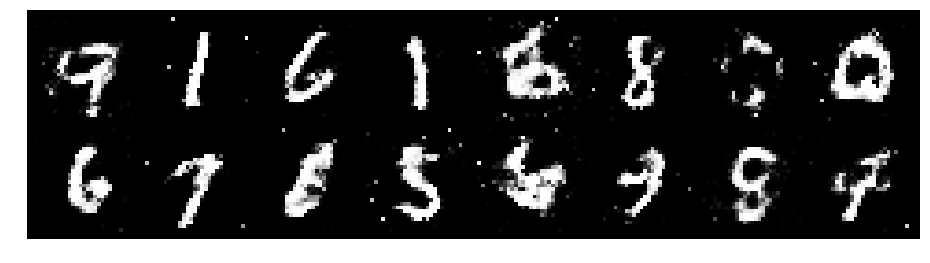

Epoch: [31/200], Batch Num: [900/938]
Discriminator Loss: 1.2329497337341309, Generator Loss: 0.8813542127609253
D(x): 0.5568, D(G(z)): 0.4230


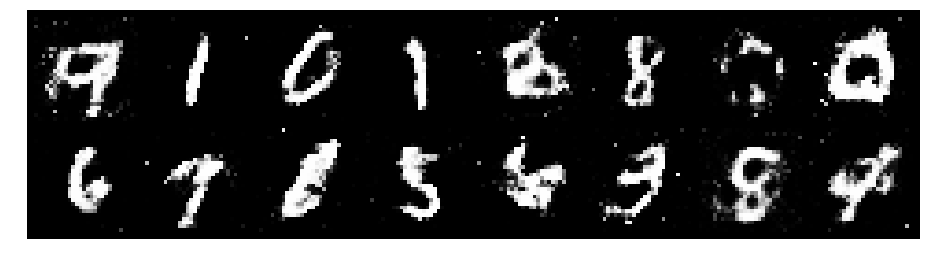

Epoch: [32/200], Batch Num: [0/938]
Discriminator Loss: 1.1091818809509277, Generator Loss: 1.0295004844665527
D(x): 0.6197, D(G(z)): 0.4084


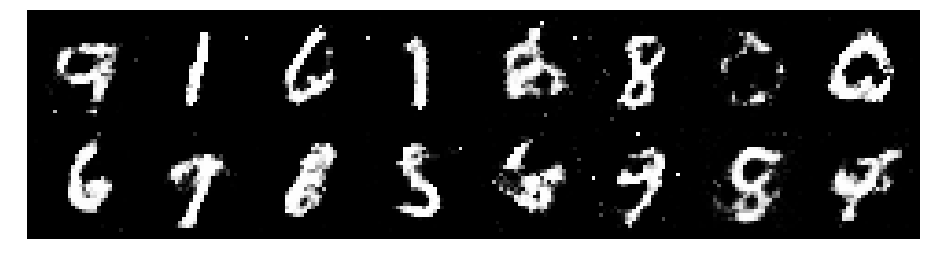

Epoch: [32/200], Batch Num: [100/938]
Discriminator Loss: 1.2857780456542969, Generator Loss: 1.3510411977767944
D(x): 0.5412, D(G(z)): 0.3664


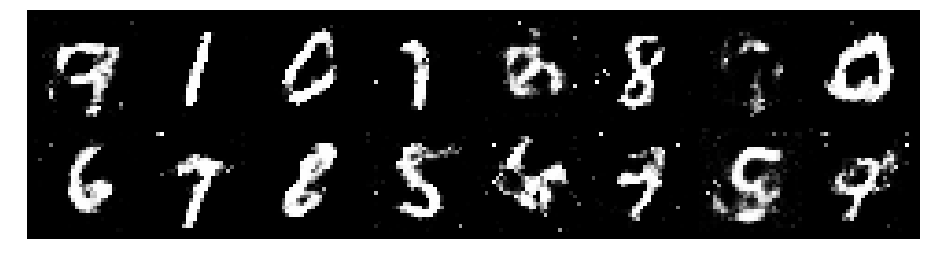

Epoch: [32/200], Batch Num: [200/938]
Discriminator Loss: 1.1631321907043457, Generator Loss: 0.9587576985359192
D(x): 0.6179, D(G(z)): 0.4130


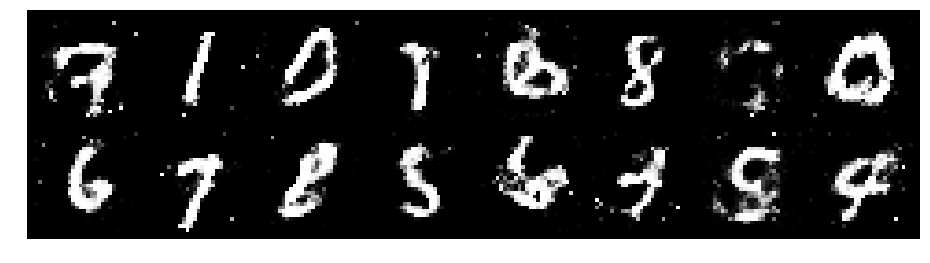

Epoch: [32/200], Batch Num: [300/938]
Discriminator Loss: 1.3211547136306763, Generator Loss: 1.1025041341781616
D(x): 0.5336, D(G(z)): 0.4111


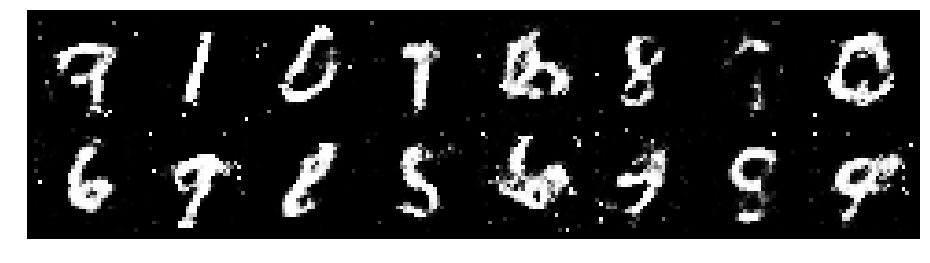

Epoch: [32/200], Batch Num: [400/938]
Discriminator Loss: 1.0033671855926514, Generator Loss: 0.9964379072189331
D(x): 0.6650, D(G(z)): 0.4064


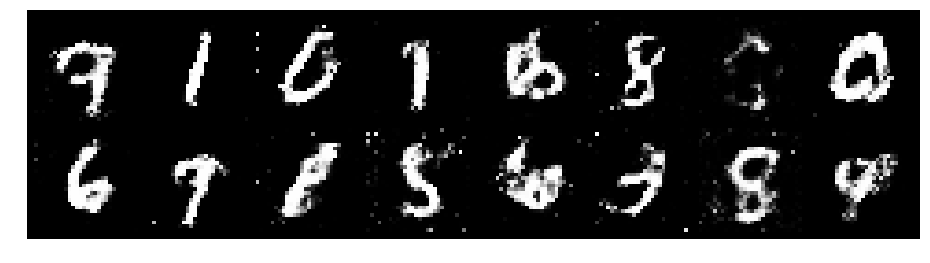

Epoch: [32/200], Batch Num: [500/938]
Discriminator Loss: 1.2044470310211182, Generator Loss: 1.47019362449646
D(x): 0.5929, D(G(z)): 0.3824


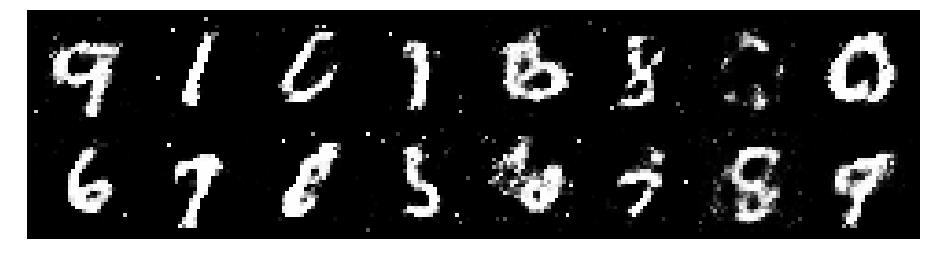

Epoch: [32/200], Batch Num: [600/938]
Discriminator Loss: 1.1235496997833252, Generator Loss: 0.9648854732513428
D(x): 0.5714, D(G(z)): 0.3647


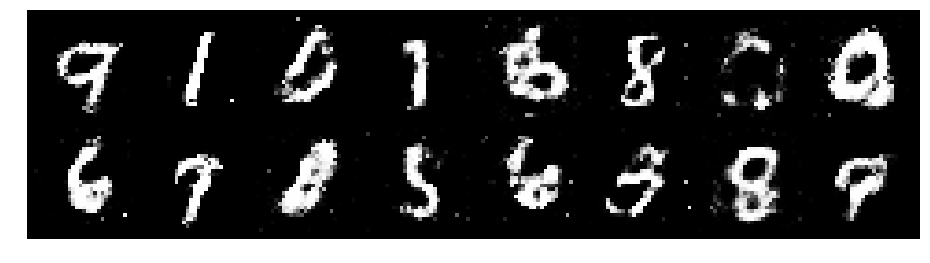

Epoch: [32/200], Batch Num: [700/938]
Discriminator Loss: 1.1825913190841675, Generator Loss: 1.0121681690216064
D(x): 0.6214, D(G(z)): 0.4382


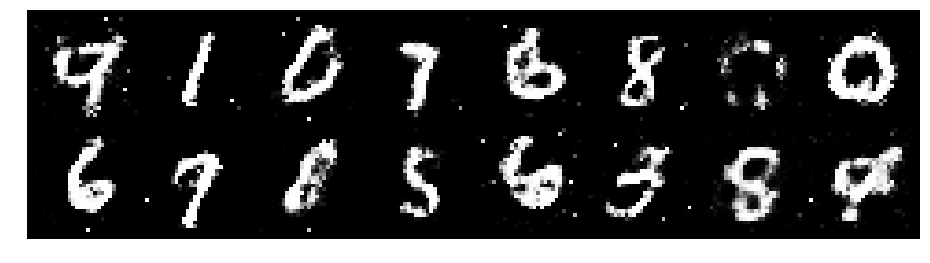

Epoch: [32/200], Batch Num: [800/938]
Discriminator Loss: 1.1038079261779785, Generator Loss: 1.017189621925354
D(x): 0.6229, D(G(z)): 0.4183


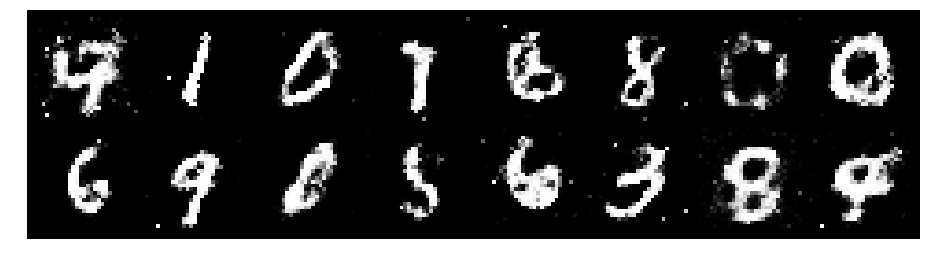

Epoch: [32/200], Batch Num: [900/938]
Discriminator Loss: 1.0974891185760498, Generator Loss: 1.2891383171081543
D(x): 0.6149, D(G(z)): 0.3786


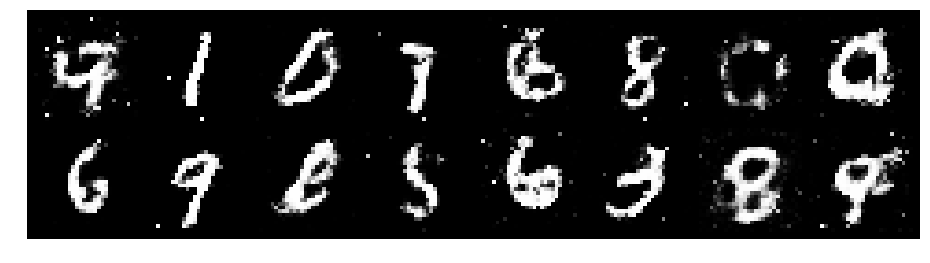

Epoch: [33/200], Batch Num: [0/938]
Discriminator Loss: 1.1556854248046875, Generator Loss: 0.792151927947998
D(x): 0.6279, D(G(z)): 0.4328


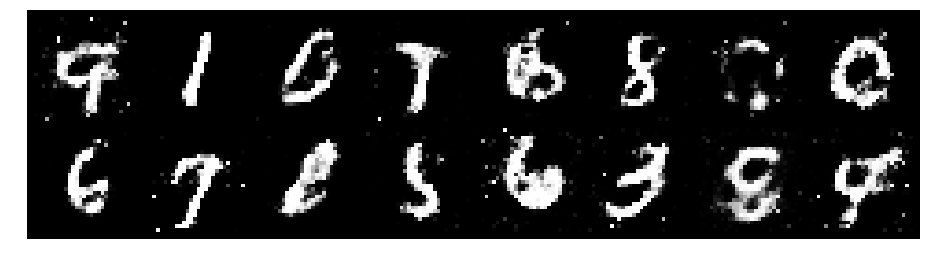

Epoch: [33/200], Batch Num: [100/938]
Discriminator Loss: 1.266479730606079, Generator Loss: 0.9490753412246704
D(x): 0.5911, D(G(z)): 0.4553


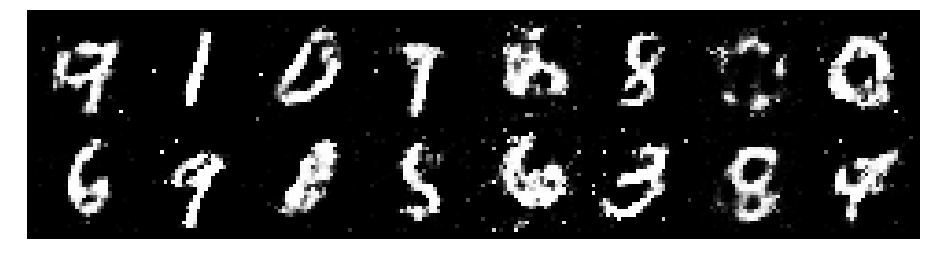

Epoch: [33/200], Batch Num: [200/938]
Discriminator Loss: 1.0139976739883423, Generator Loss: 1.268061876296997
D(x): 0.5702, D(G(z)): 0.2892


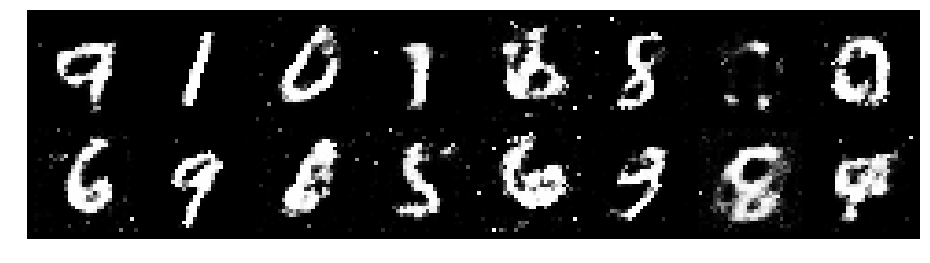

Epoch: [33/200], Batch Num: [300/938]
Discriminator Loss: 1.1536728143692017, Generator Loss: 0.8354095816612244
D(x): 0.6248, D(G(z)): 0.4414


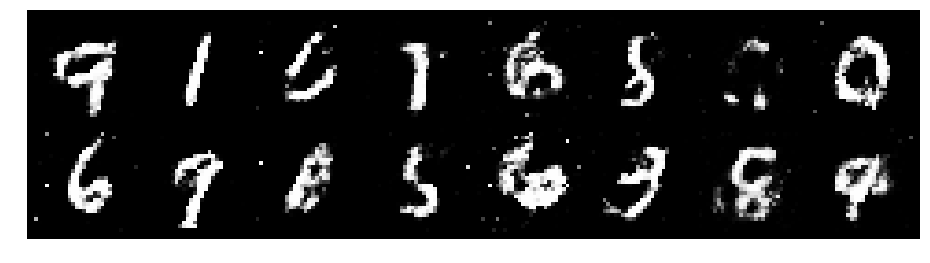

Epoch: [33/200], Batch Num: [400/938]
Discriminator Loss: 1.1318297386169434, Generator Loss: 1.090057611465454
D(x): 0.5894, D(G(z)): 0.3736


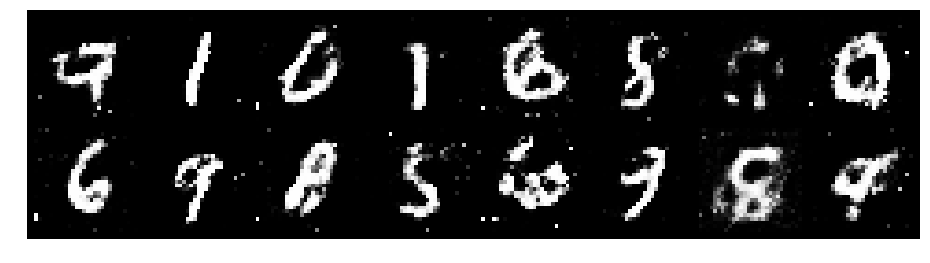

Epoch: [33/200], Batch Num: [500/938]
Discriminator Loss: 1.166629672050476, Generator Loss: 1.1812379360198975
D(x): 0.5506, D(G(z)): 0.3675


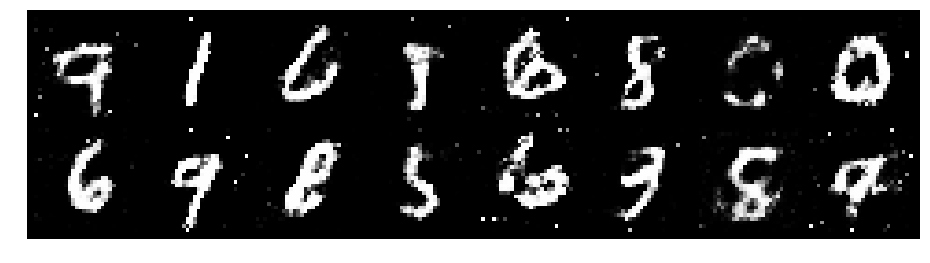

Epoch: [33/200], Batch Num: [600/938]
Discriminator Loss: 1.164296269416809, Generator Loss: 0.9806040525436401
D(x): 0.5793, D(G(z)): 0.3959


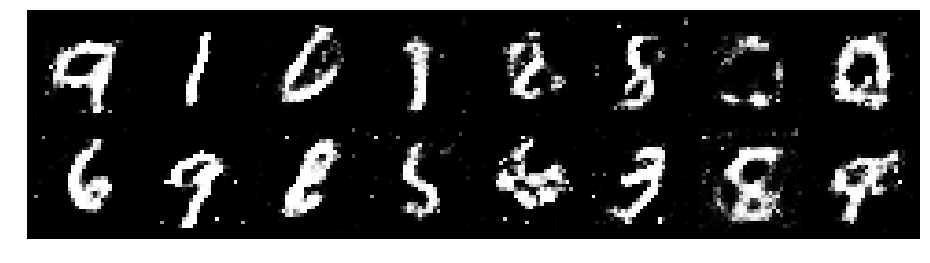

Epoch: [33/200], Batch Num: [700/938]
Discriminator Loss: 1.1150431632995605, Generator Loss: 1.042798399925232
D(x): 0.5360, D(G(z)): 0.3172


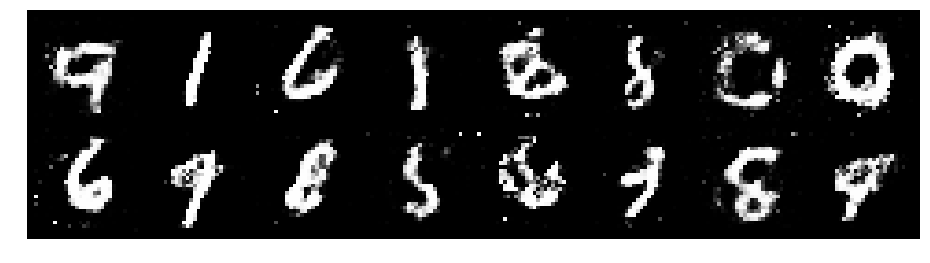

Epoch: [33/200], Batch Num: [800/938]
Discriminator Loss: 1.0972903966903687, Generator Loss: 1.1617027521133423
D(x): 0.6245, D(G(z)): 0.4193


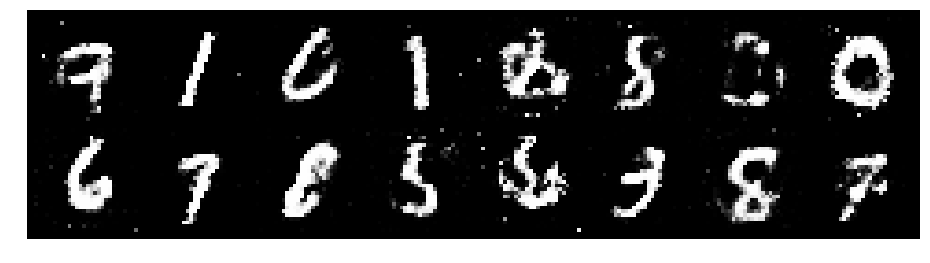

Epoch: [33/200], Batch Num: [900/938]
Discriminator Loss: 1.2917625904083252, Generator Loss: 0.7852353453636169
D(x): 0.5891, D(G(z)): 0.4883


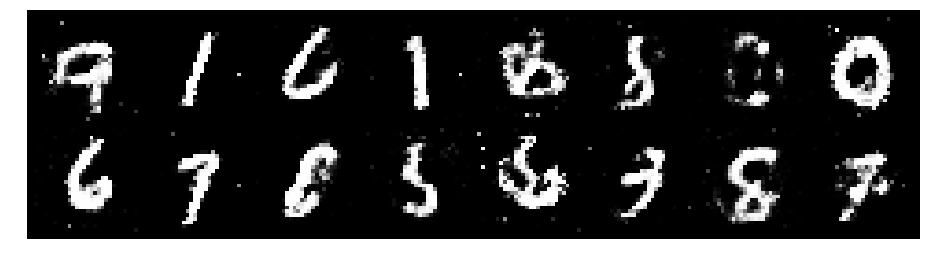

Epoch: [34/200], Batch Num: [0/938]
Discriminator Loss: 1.0253185033798218, Generator Loss: 1.4031736850738525
D(x): 0.6479, D(G(z)): 0.3501


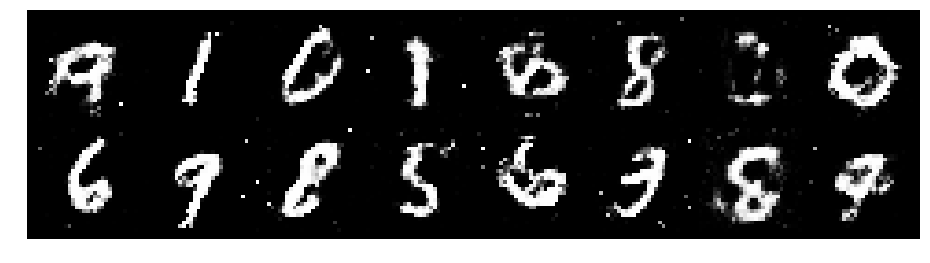

Epoch: [34/200], Batch Num: [100/938]
Discriminator Loss: 1.1022710800170898, Generator Loss: 1.2043325901031494
D(x): 0.6068, D(G(z)): 0.3723


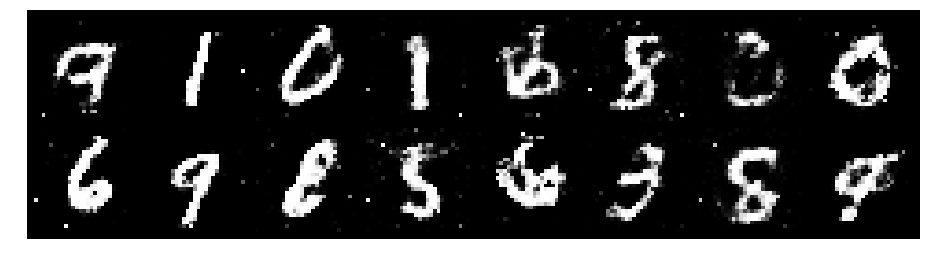

Epoch: [34/200], Batch Num: [200/938]
Discriminator Loss: 1.0754978656768799, Generator Loss: 0.9960538148880005
D(x): 0.6210, D(G(z)): 0.3886


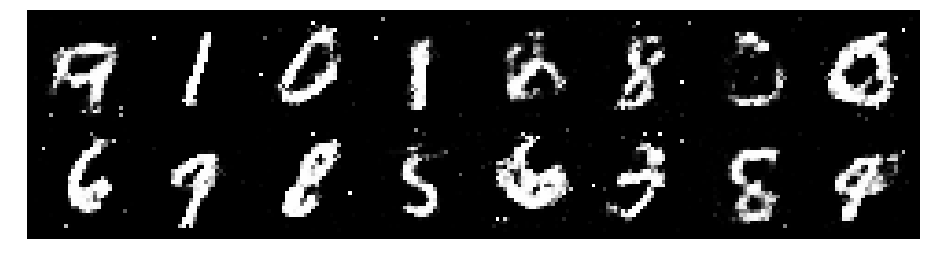

Epoch: [34/200], Batch Num: [300/938]
Discriminator Loss: 1.2379786968231201, Generator Loss: 0.9383420944213867
D(x): 0.5934, D(G(z)): 0.4525


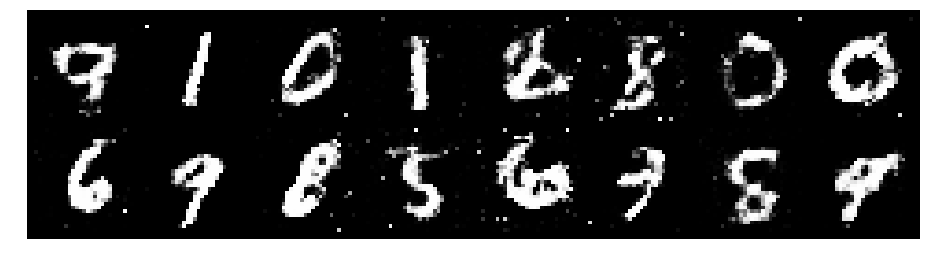

Epoch: [34/200], Batch Num: [400/938]
Discriminator Loss: 1.1929600238800049, Generator Loss: 1.014325737953186
D(x): 0.5603, D(G(z)): 0.3941


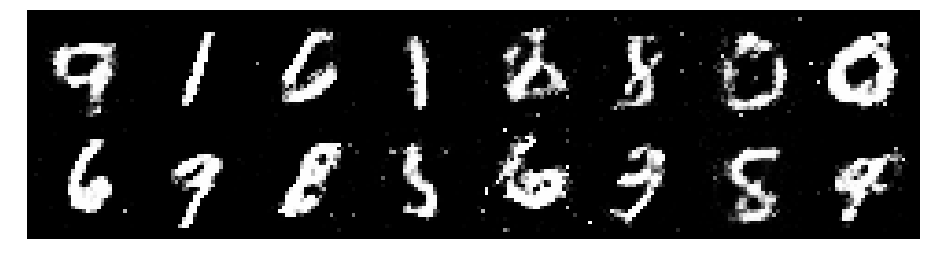

Epoch: [34/200], Batch Num: [500/938]
Discriminator Loss: 1.3772538900375366, Generator Loss: 0.9789331555366516
D(x): 0.5654, D(G(z)): 0.4443


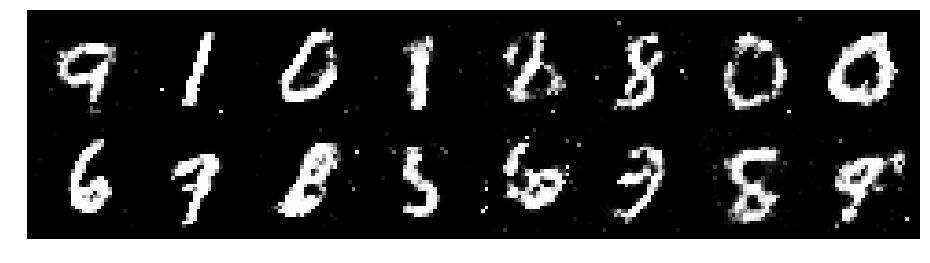

Epoch: [34/200], Batch Num: [600/938]
Discriminator Loss: 1.2391293048858643, Generator Loss: 0.9978812336921692
D(x): 0.5799, D(G(z)): 0.4009


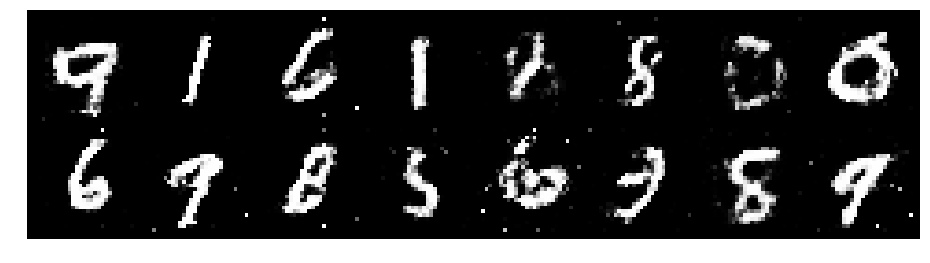

Epoch: [34/200], Batch Num: [700/938]
Discriminator Loss: 1.0032598972320557, Generator Loss: 1.124663233757019
D(x): 0.6171, D(G(z)): 0.3444


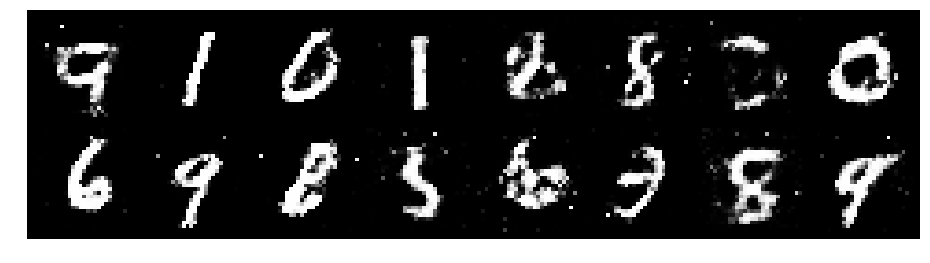

Epoch: [34/200], Batch Num: [800/938]
Discriminator Loss: 1.1742298603057861, Generator Loss: 0.9265429973602295
D(x): 0.5432, D(G(z)): 0.3858


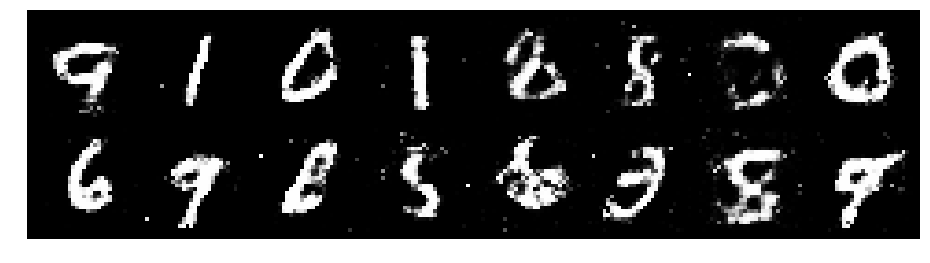

Epoch: [34/200], Batch Num: [900/938]
Discriminator Loss: 1.2512450218200684, Generator Loss: 0.8863187432289124
D(x): 0.5476, D(G(z)): 0.4253


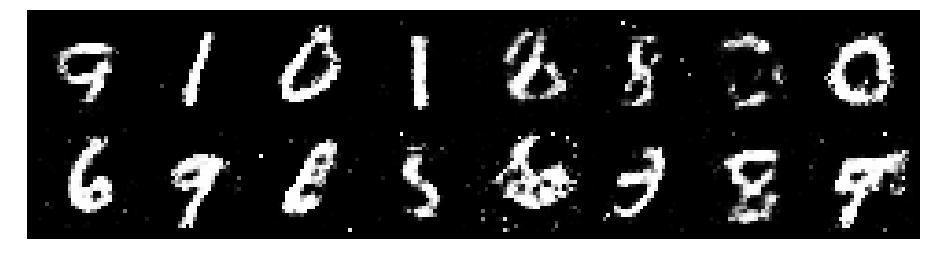

Epoch: [35/200], Batch Num: [0/938]
Discriminator Loss: 1.2662739753723145, Generator Loss: 1.0041507482528687
D(x): 0.5980, D(G(z)): 0.4409


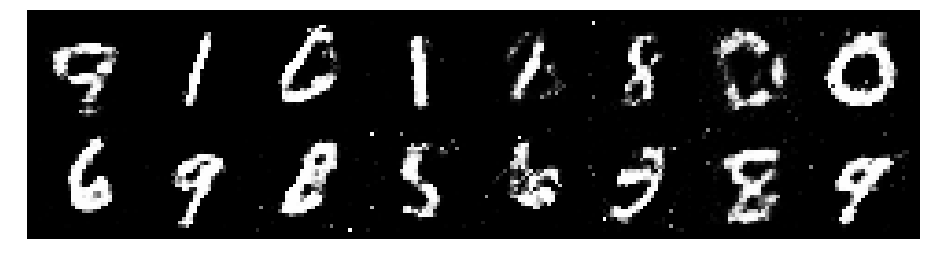

Epoch: [35/200], Batch Num: [100/938]
Discriminator Loss: 1.0575945377349854, Generator Loss: 1.1903878450393677
D(x): 0.6639, D(G(z)): 0.3752


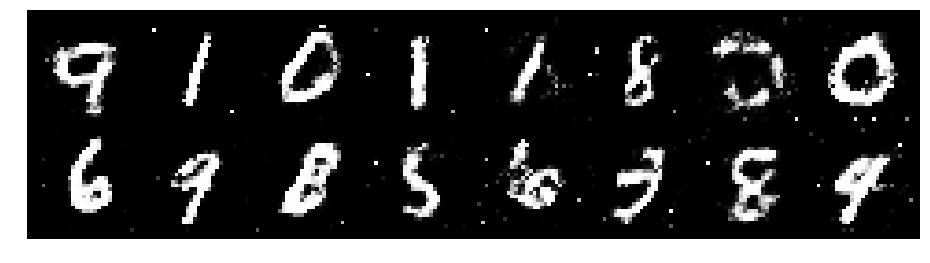

Epoch: [35/200], Batch Num: [200/938]
Discriminator Loss: 1.1375877857208252, Generator Loss: 1.117722988128662
D(x): 0.6140, D(G(z)): 0.3730


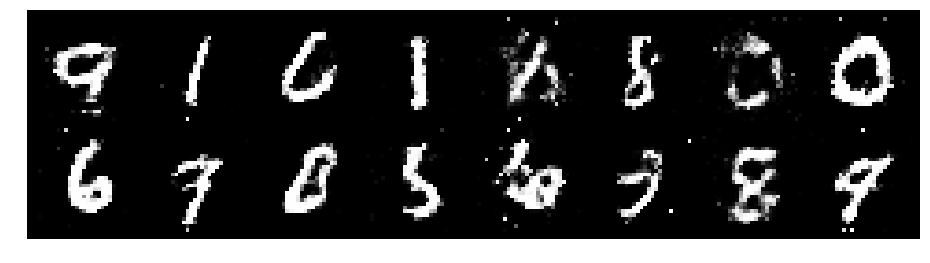

Epoch: [35/200], Batch Num: [300/938]
Discriminator Loss: 1.1476993560791016, Generator Loss: 0.9036765694618225
D(x): 0.6099, D(G(z)): 0.4133


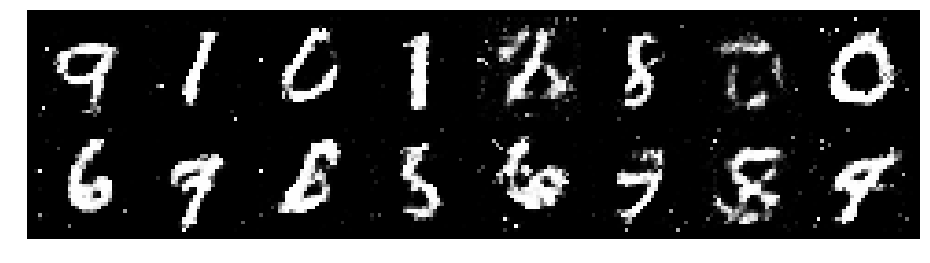

Epoch: [35/200], Batch Num: [400/938]
Discriminator Loss: 1.2899954319000244, Generator Loss: 0.9766823053359985
D(x): 0.5588, D(G(z)): 0.4324


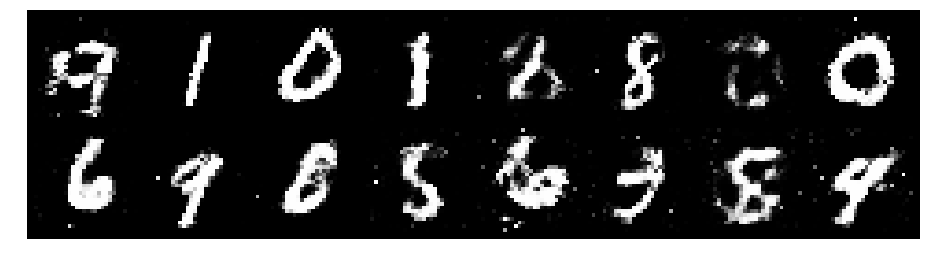

Epoch: [35/200], Batch Num: [500/938]
Discriminator Loss: 1.053863286972046, Generator Loss: 1.0187458992004395
D(x): 0.6027, D(G(z)): 0.3667


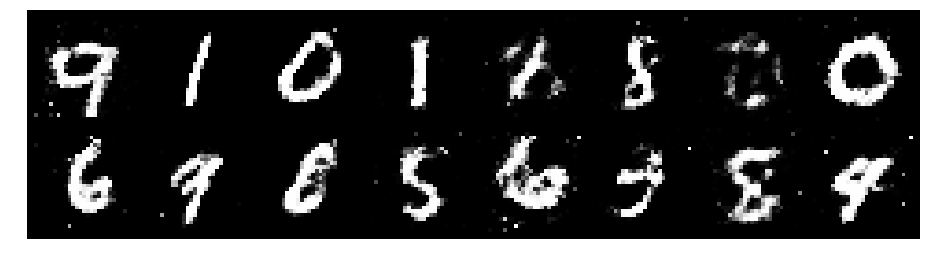

Epoch: [35/200], Batch Num: [600/938]
Discriminator Loss: 1.156994104385376, Generator Loss: 1.0075347423553467
D(x): 0.6024, D(G(z)): 0.4234


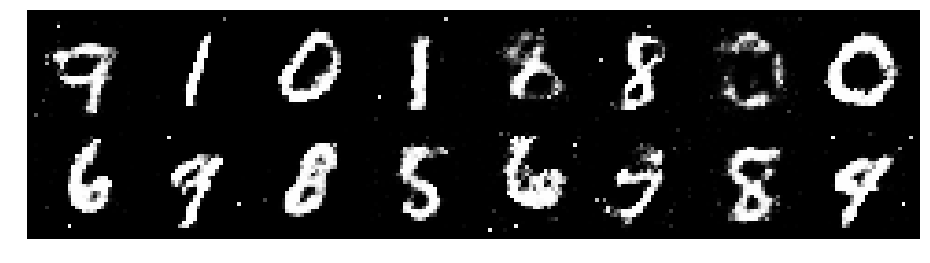

Epoch: [35/200], Batch Num: [700/938]
Discriminator Loss: 1.4411417245864868, Generator Loss: 0.8987914323806763
D(x): 0.4994, D(G(z)): 0.4228


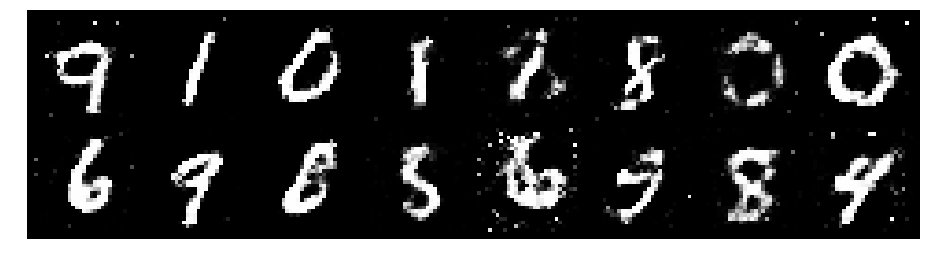

Epoch: [35/200], Batch Num: [800/938]
Discriminator Loss: 1.050671100616455, Generator Loss: 1.25529146194458
D(x): 0.6043, D(G(z)): 0.3484


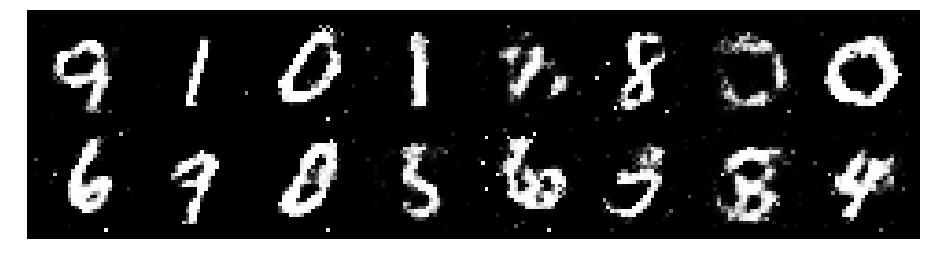

Epoch: [35/200], Batch Num: [900/938]
Discriminator Loss: 1.2548624277114868, Generator Loss: 1.2829208374023438
D(x): 0.6338, D(G(z)): 0.4460


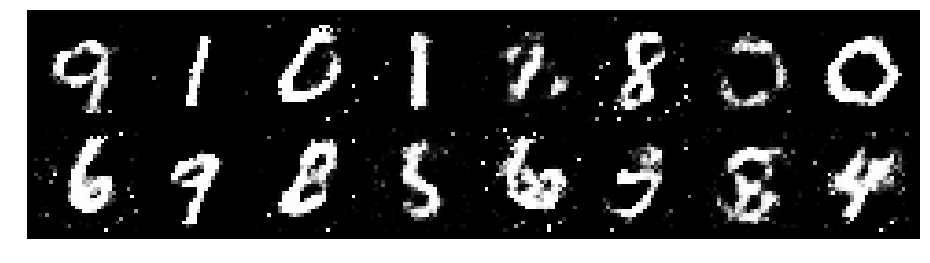

Epoch: [36/200], Batch Num: [0/938]
Discriminator Loss: 1.3006505966186523, Generator Loss: 1.1334350109100342
D(x): 0.5062, D(G(z)): 0.4050


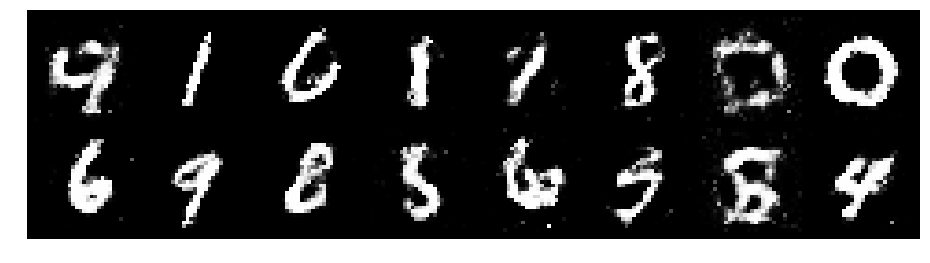

Epoch: [36/200], Batch Num: [100/938]
Discriminator Loss: 1.0780384540557861, Generator Loss: 1.0438711643218994
D(x): 0.5860, D(G(z)): 0.3601


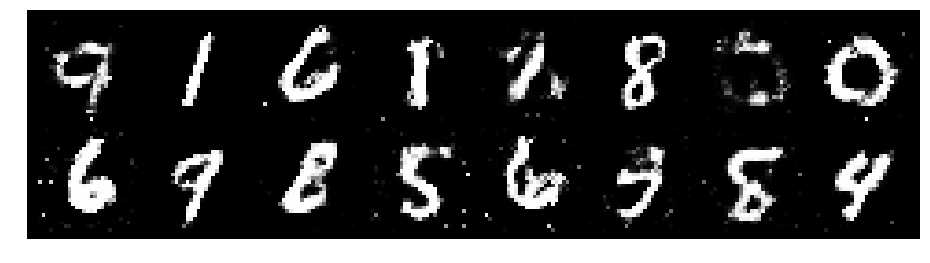

Epoch: [36/200], Batch Num: [200/938]
Discriminator Loss: 1.1707563400268555, Generator Loss: 1.0830988883972168
D(x): 0.6077, D(G(z)): 0.4262


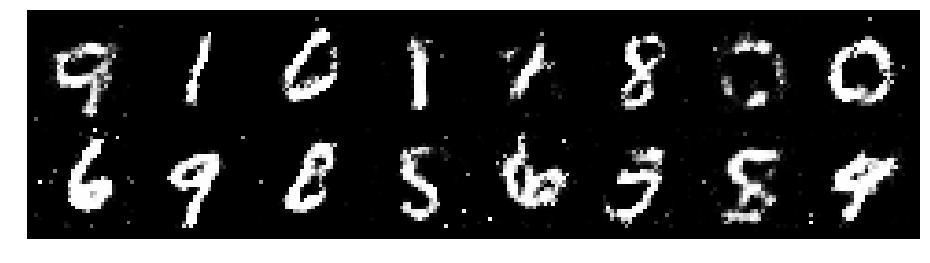

Epoch: [36/200], Batch Num: [300/938]
Discriminator Loss: 1.1181740760803223, Generator Loss: 1.1962978839874268
D(x): 0.5368, D(G(z)): 0.3221


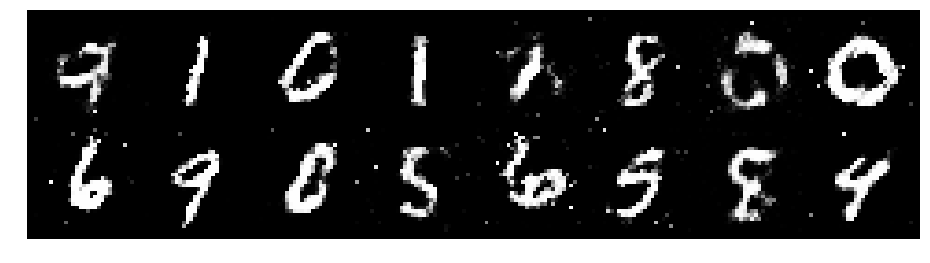

Epoch: [36/200], Batch Num: [400/938]
Discriminator Loss: 1.2083299160003662, Generator Loss: 0.9613549113273621
D(x): 0.5953, D(G(z)): 0.4459


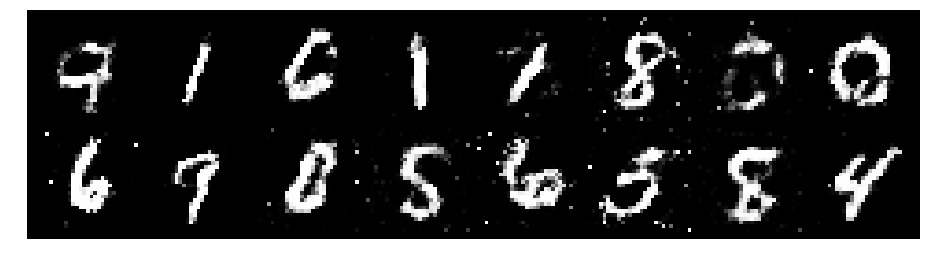

Epoch: [36/200], Batch Num: [500/938]
Discriminator Loss: 1.21188485622406, Generator Loss: 0.9773664474487305
D(x): 0.5531, D(G(z)): 0.4029


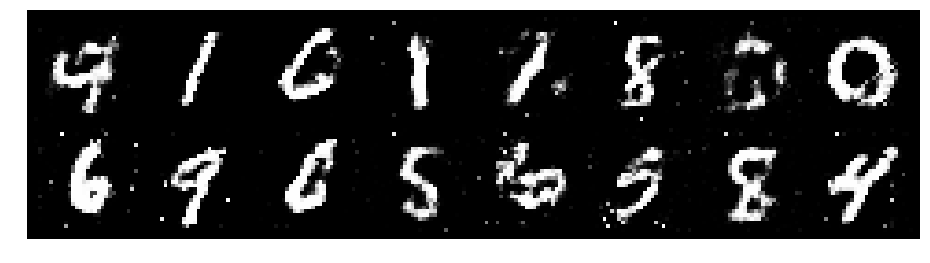

Epoch: [36/200], Batch Num: [600/938]
Discriminator Loss: 1.1276636123657227, Generator Loss: 0.960913896560669
D(x): 0.5935, D(G(z)): 0.3961


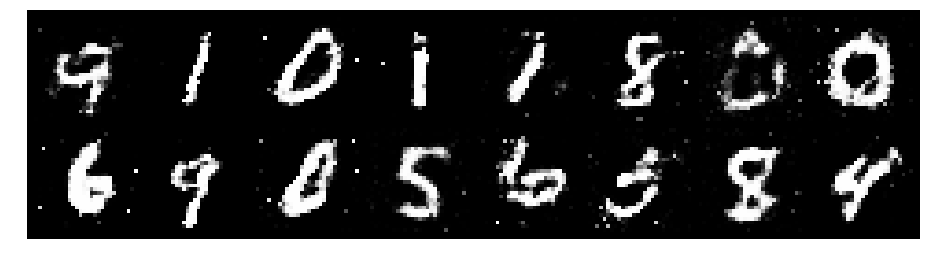

Epoch: [36/200], Batch Num: [700/938]
Discriminator Loss: 1.139220952987671, Generator Loss: 0.9631063938140869
D(x): 0.5750, D(G(z)): 0.3946


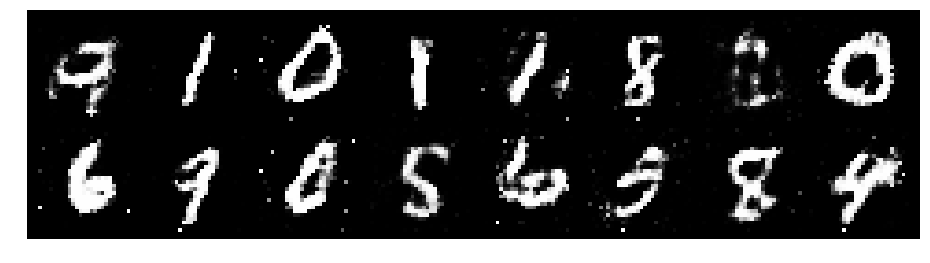

Epoch: [36/200], Batch Num: [800/938]
Discriminator Loss: 1.202972412109375, Generator Loss: 0.8428072929382324
D(x): 0.6087, D(G(z)): 0.4479


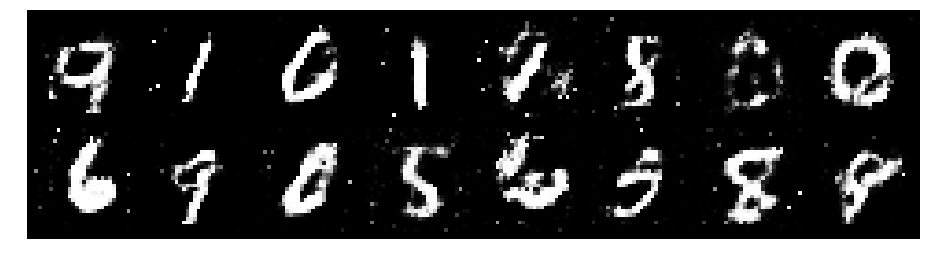

Epoch: [36/200], Batch Num: [900/938]
Discriminator Loss: 1.210437536239624, Generator Loss: 0.9758037328720093
D(x): 0.6245, D(G(z)): 0.4532


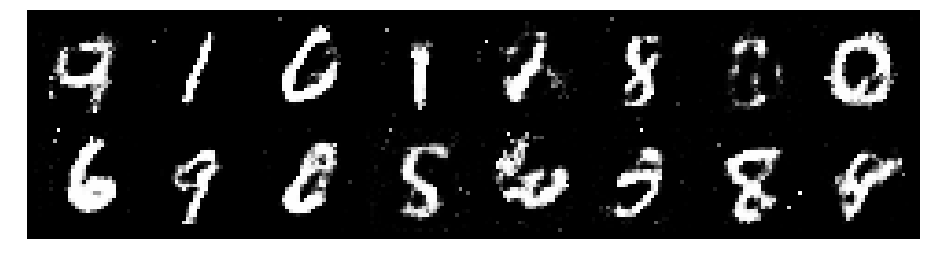

Epoch: [37/200], Batch Num: [0/938]
Discriminator Loss: 1.0787662267684937, Generator Loss: 0.9153139591217041
D(x): 0.6290, D(G(z)): 0.3795


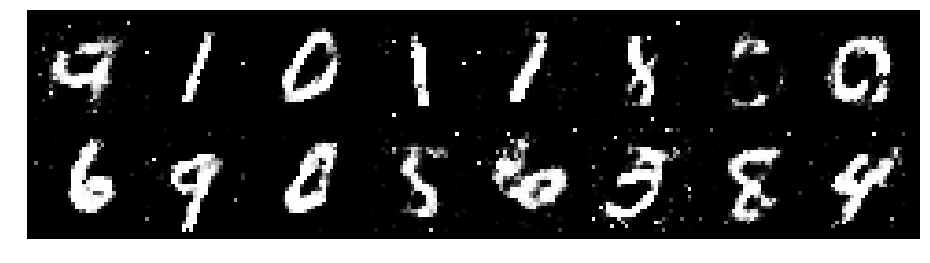

Epoch: [37/200], Batch Num: [100/938]
Discriminator Loss: 1.1184017658233643, Generator Loss: 1.0736185312271118
D(x): 0.5858, D(G(z)): 0.3777


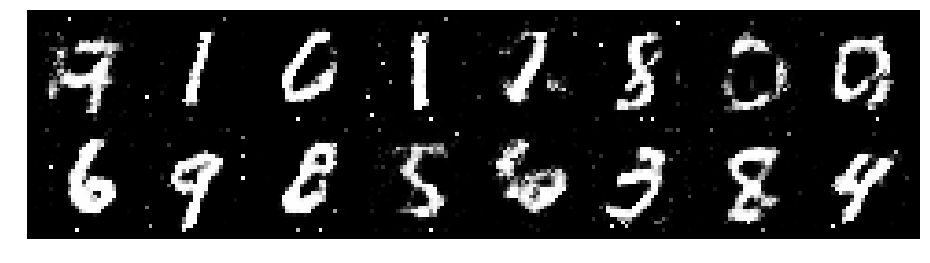

Epoch: [37/200], Batch Num: [200/938]
Discriminator Loss: 1.114235281944275, Generator Loss: 1.1566879749298096
D(x): 0.6084, D(G(z)): 0.3681


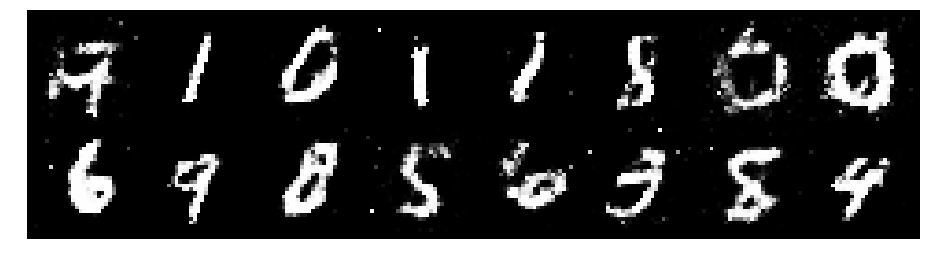

Epoch: [37/200], Batch Num: [300/938]
Discriminator Loss: 1.009968638420105, Generator Loss: 1.2498003244400024
D(x): 0.6387, D(G(z)): 0.3784


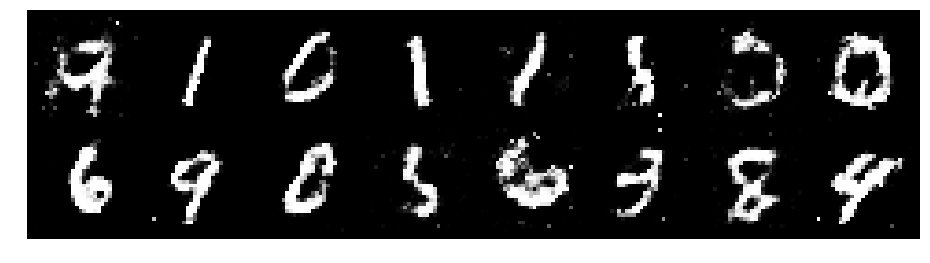

Epoch: [37/200], Batch Num: [400/938]
Discriminator Loss: 1.3745570182800293, Generator Loss: 0.9331236481666565
D(x): 0.4980, D(G(z)): 0.4112


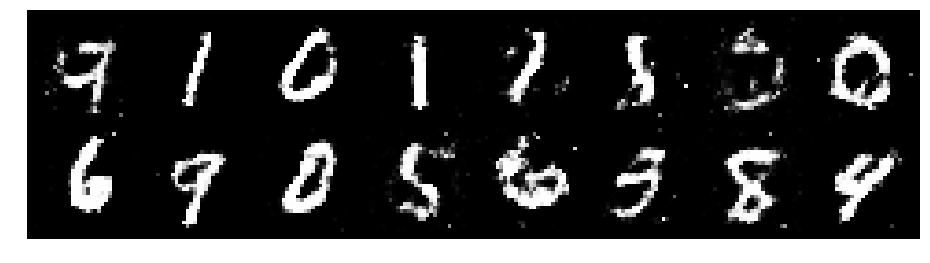

Epoch: [37/200], Batch Num: [500/938]
Discriminator Loss: 1.3434665203094482, Generator Loss: 0.959865391254425
D(x): 0.5004, D(G(z)): 0.4094


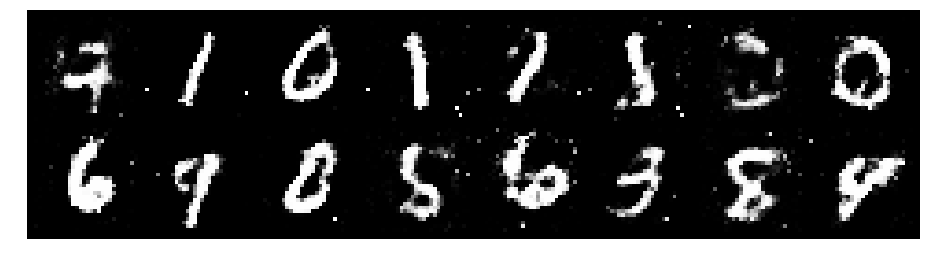

Epoch: [37/200], Batch Num: [600/938]
Discriminator Loss: 1.304229974746704, Generator Loss: 1.2257180213928223
D(x): 0.5450, D(G(z)): 0.3633


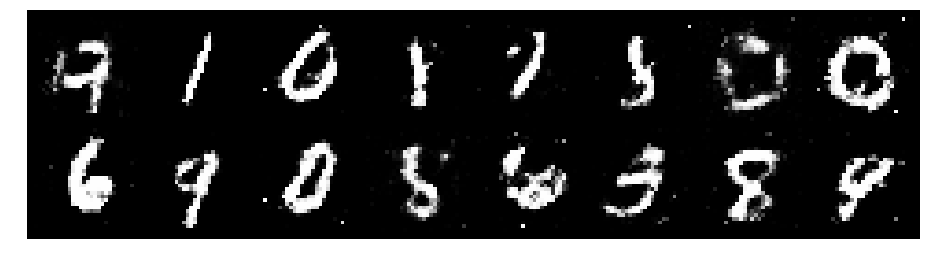

Epoch: [37/200], Batch Num: [700/938]
Discriminator Loss: 1.176771879196167, Generator Loss: 1.1114447116851807
D(x): 0.6189, D(G(z)): 0.4273


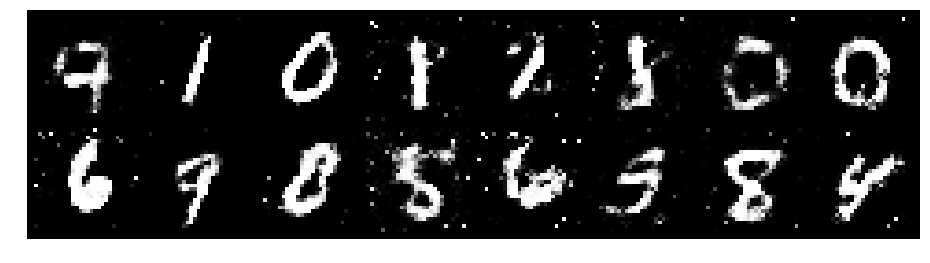

Epoch: [37/200], Batch Num: [800/938]
Discriminator Loss: 1.201846718788147, Generator Loss: 1.0040733814239502
D(x): 0.5767, D(G(z)): 0.4098


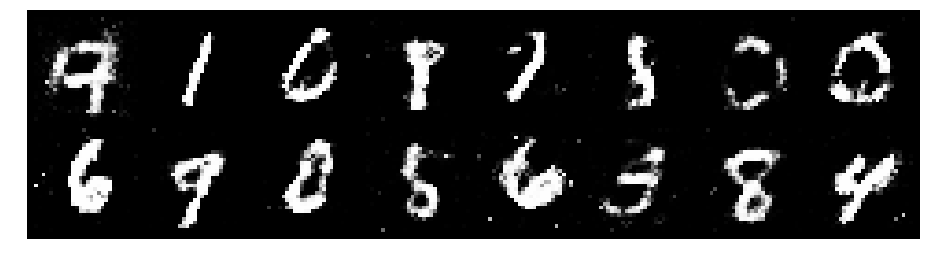

Epoch: [37/200], Batch Num: [900/938]
Discriminator Loss: 1.1714273691177368, Generator Loss: 1.0859251022338867
D(x): 0.6064, D(G(z)): 0.4190


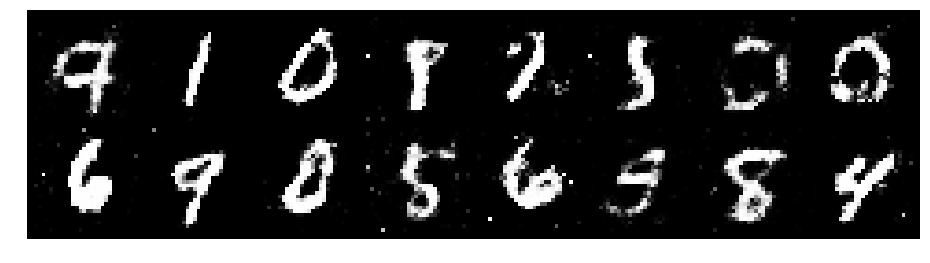

Epoch: [38/200], Batch Num: [0/938]
Discriminator Loss: 1.2205215692520142, Generator Loss: 0.9465596675872803
D(x): 0.5765, D(G(z)): 0.4308


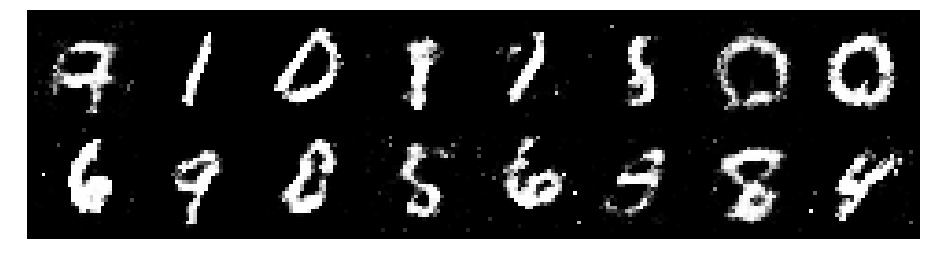

Epoch: [38/200], Batch Num: [100/938]
Discriminator Loss: 1.276638388633728, Generator Loss: 0.9524889588356018
D(x): 0.5510, D(G(z)): 0.4379


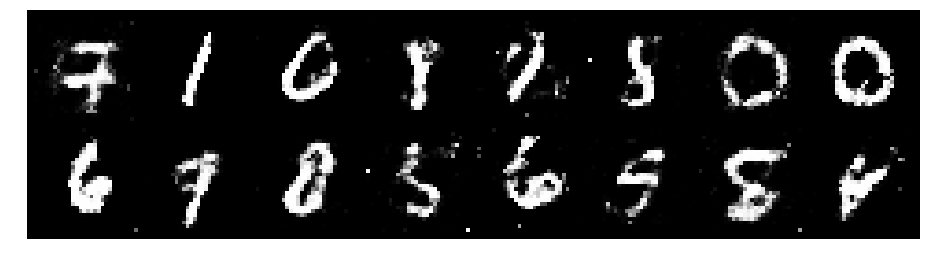

Epoch: [38/200], Batch Num: [200/938]
Discriminator Loss: 1.2897553443908691, Generator Loss: 0.914128303527832
D(x): 0.5824, D(G(z)): 0.4333


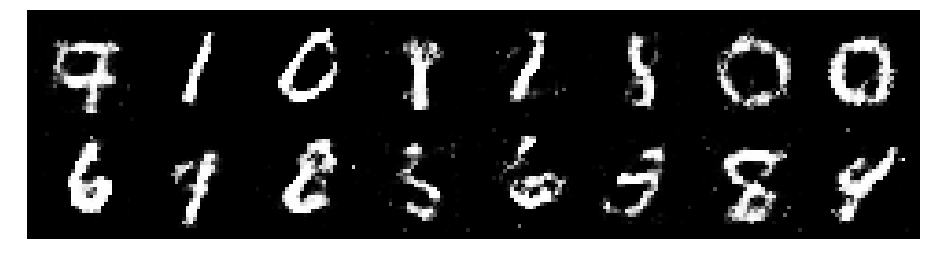

Epoch: [38/200], Batch Num: [300/938]
Discriminator Loss: 1.305529236793518, Generator Loss: 1.0260674953460693
D(x): 0.5290, D(G(z)): 0.3933


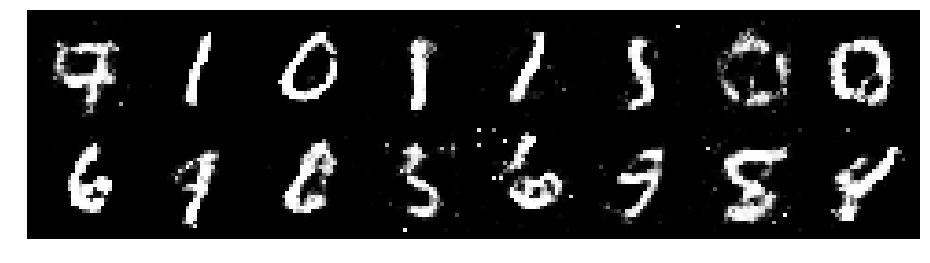

Epoch: [38/200], Batch Num: [400/938]
Discriminator Loss: 1.2093384265899658, Generator Loss: 0.9515103101730347
D(x): 0.5675, D(G(z)): 0.4092


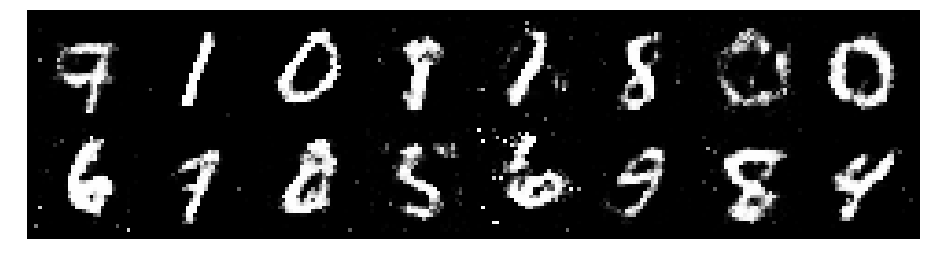

Epoch: [38/200], Batch Num: [500/938]
Discriminator Loss: 1.1060400009155273, Generator Loss: 1.05289888381958
D(x): 0.5598, D(G(z)): 0.3418


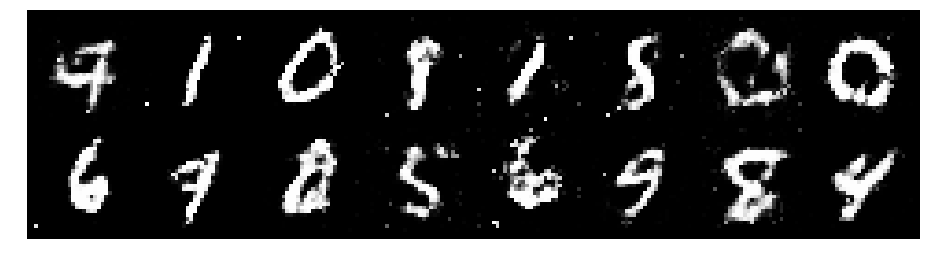

Epoch: [38/200], Batch Num: [600/938]
Discriminator Loss: 1.2428321838378906, Generator Loss: 0.9578524827957153
D(x): 0.5931, D(G(z)): 0.4617


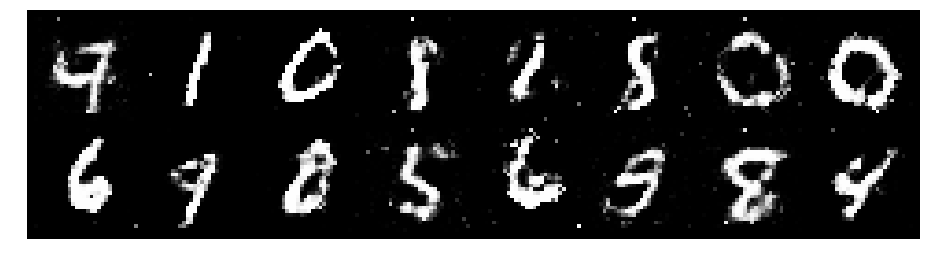

Epoch: [38/200], Batch Num: [700/938]
Discriminator Loss: 1.2858481407165527, Generator Loss: 1.0953699350357056
D(x): 0.5539, D(G(z)): 0.4421


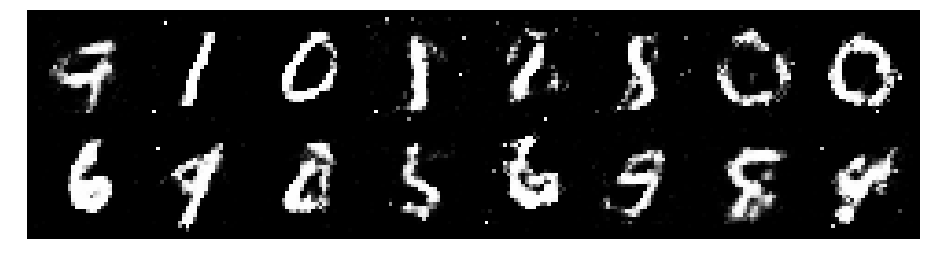

Epoch: [38/200], Batch Num: [800/938]
Discriminator Loss: 1.2643080949783325, Generator Loss: 0.9970027208328247
D(x): 0.5242, D(G(z)): 0.4010


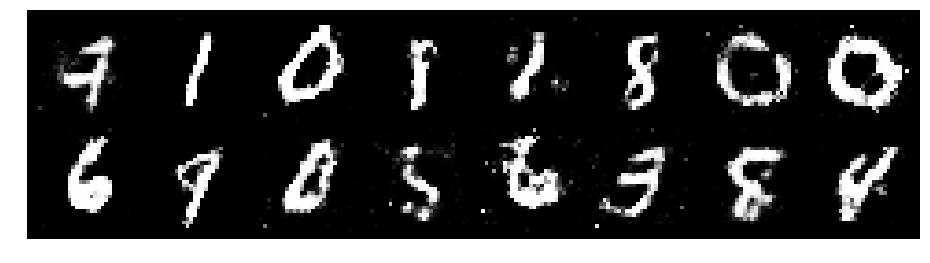

Epoch: [38/200], Batch Num: [900/938]
Discriminator Loss: 1.1457710266113281, Generator Loss: 0.9513955116271973
D(x): 0.6344, D(G(z)): 0.4319


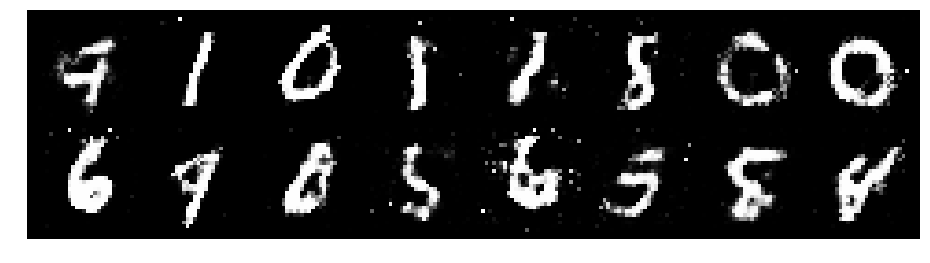

Epoch: [39/200], Batch Num: [0/938]
Discriminator Loss: 1.2075804471969604, Generator Loss: 1.168813705444336
D(x): 0.5194, D(G(z)): 0.3502


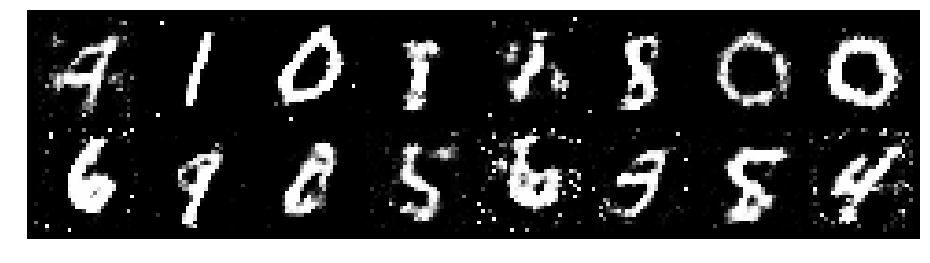

Epoch: [39/200], Batch Num: [100/938]
Discriminator Loss: 1.2587169408798218, Generator Loss: 0.9690281748771667
D(x): 0.5079, D(G(z)): 0.3816


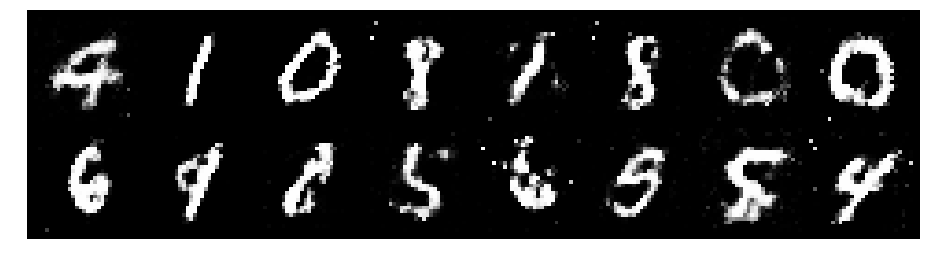

Epoch: [39/200], Batch Num: [200/938]
Discriminator Loss: 1.263564109802246, Generator Loss: 0.8762956261634827
D(x): 0.5984, D(G(z)): 0.4423


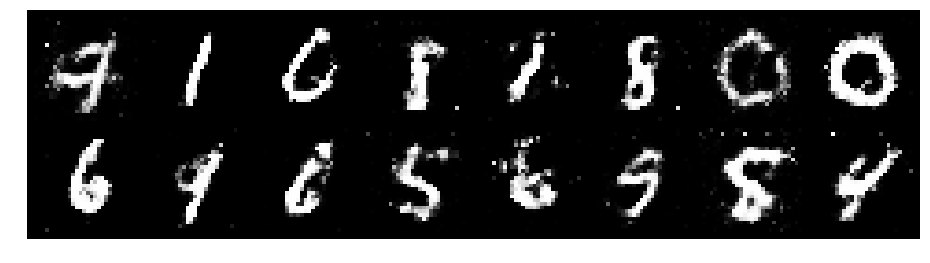

Epoch: [39/200], Batch Num: [300/938]
Discriminator Loss: 1.1373318433761597, Generator Loss: 1.1462701559066772
D(x): 0.6006, D(G(z)): 0.3977


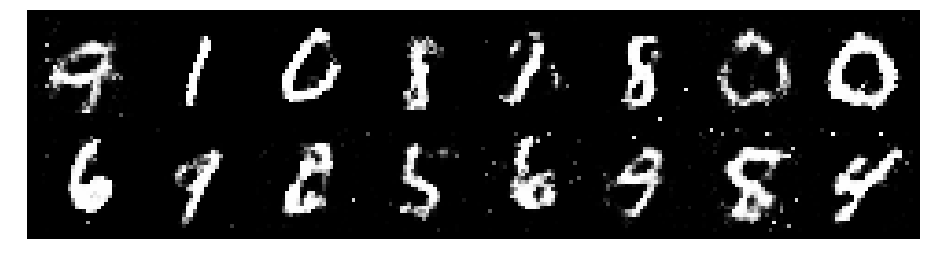

Epoch: [39/200], Batch Num: [400/938]
Discriminator Loss: 1.2582151889801025, Generator Loss: 0.9370003938674927
D(x): 0.6105, D(G(z)): 0.4558


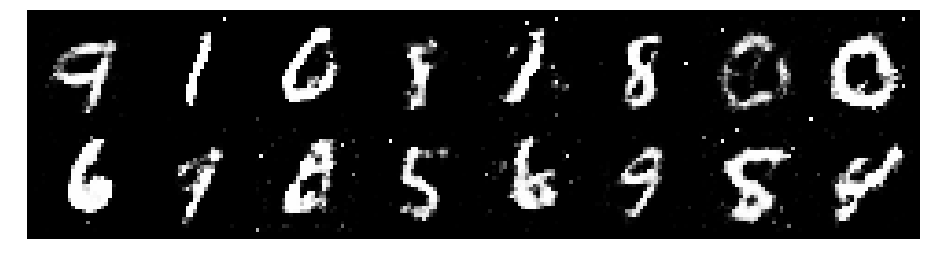

Epoch: [39/200], Batch Num: [500/938]
Discriminator Loss: 1.2061522006988525, Generator Loss: 1.0118582248687744
D(x): 0.5374, D(G(z)): 0.4018


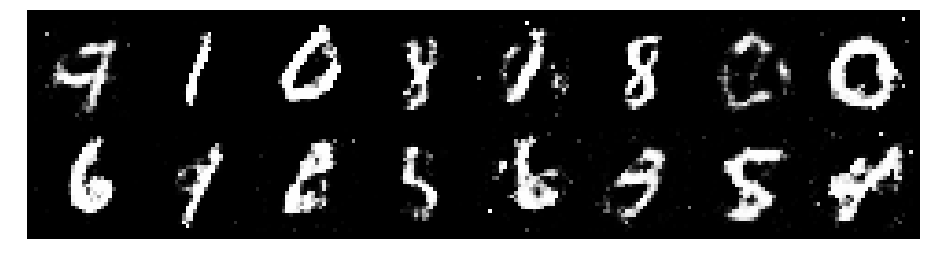

Epoch: [39/200], Batch Num: [600/938]
Discriminator Loss: 1.2398643493652344, Generator Loss: 1.0667355060577393
D(x): 0.5247, D(G(z)): 0.3646


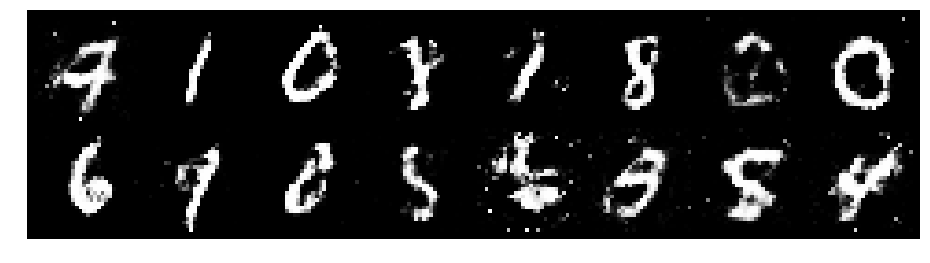

Epoch: [39/200], Batch Num: [700/938]
Discriminator Loss: 1.2656813859939575, Generator Loss: 0.9984563589096069
D(x): 0.5971, D(G(z)): 0.4689


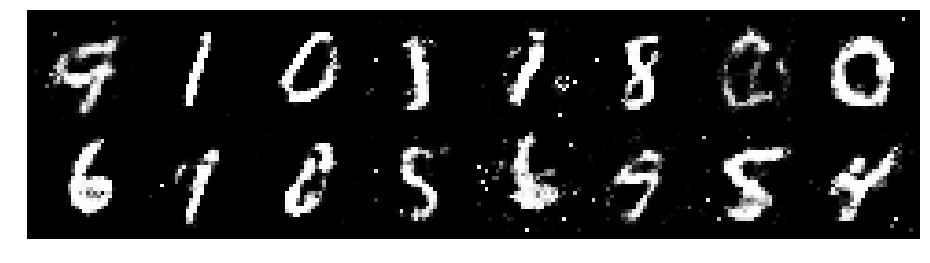

Epoch: [39/200], Batch Num: [800/938]
Discriminator Loss: 1.3863861560821533, Generator Loss: 0.8761594891548157
D(x): 0.5378, D(G(z)): 0.4606


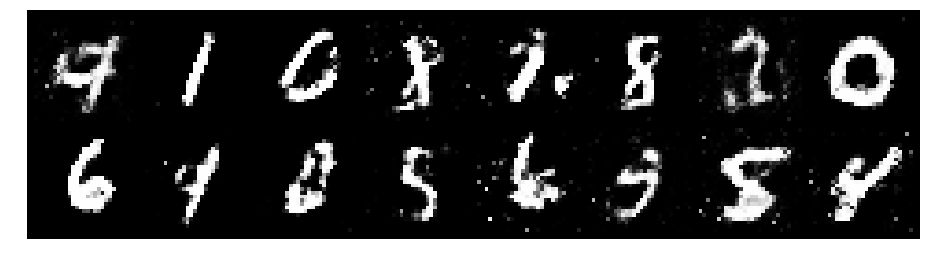

Epoch: [39/200], Batch Num: [900/938]
Discriminator Loss: 1.2539393901824951, Generator Loss: 1.0542666912078857
D(x): 0.5080, D(G(z)): 0.3780


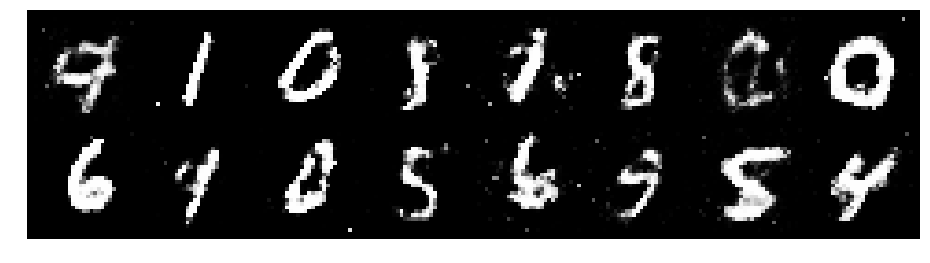

Epoch: [40/200], Batch Num: [0/938]
Discriminator Loss: 1.324617862701416, Generator Loss: 1.1176809072494507
D(x): 0.5711, D(G(z)): 0.4097


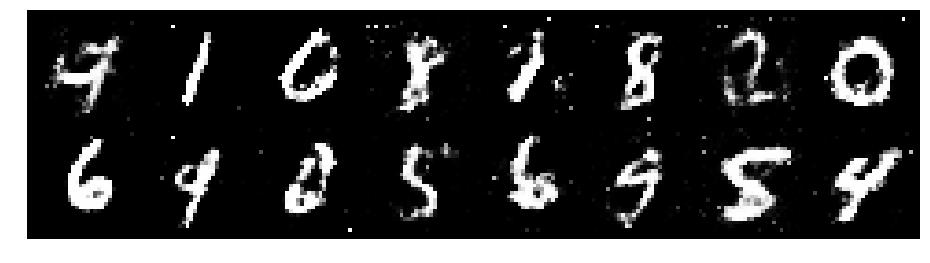

Epoch: [40/200], Batch Num: [100/938]
Discriminator Loss: 1.2058426141738892, Generator Loss: 1.2243272066116333
D(x): 0.5704, D(G(z)): 0.3654


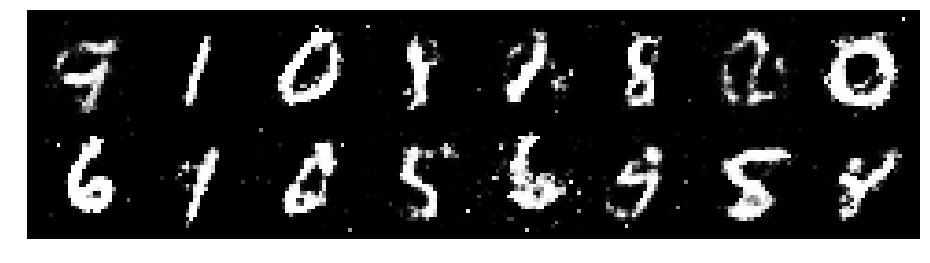

Epoch: [40/200], Batch Num: [200/938]
Discriminator Loss: 1.1879472732543945, Generator Loss: 0.9806308150291443
D(x): 0.5799, D(G(z)): 0.4066


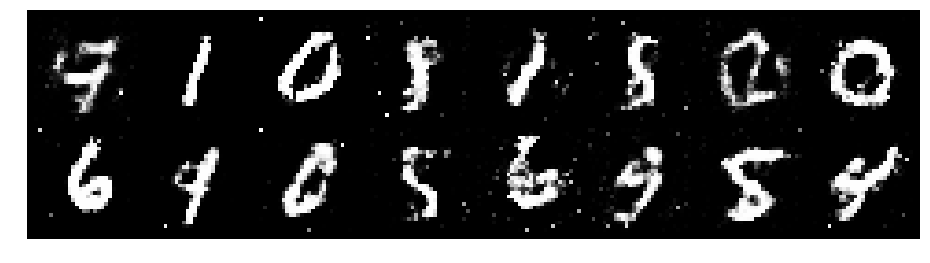

Epoch: [40/200], Batch Num: [300/938]
Discriminator Loss: 1.3237483501434326, Generator Loss: 1.0956156253814697
D(x): 0.5087, D(G(z)): 0.4209


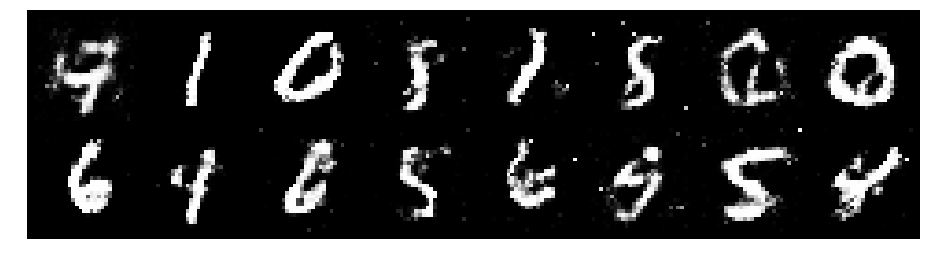

Epoch: [40/200], Batch Num: [400/938]
Discriminator Loss: 1.233750820159912, Generator Loss: 0.879564642906189
D(x): 0.5909, D(G(z)): 0.4555


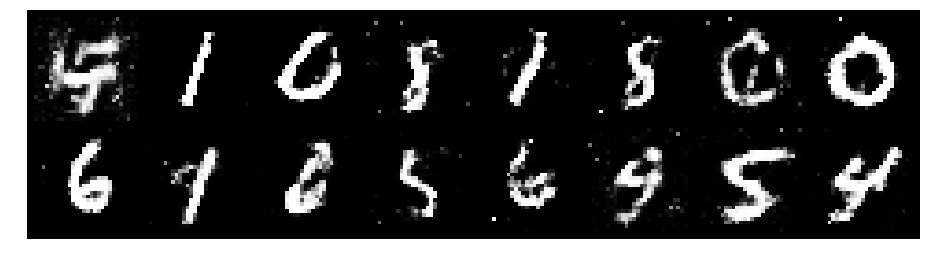

Epoch: [40/200], Batch Num: [500/938]
Discriminator Loss: 1.341282844543457, Generator Loss: 0.852630615234375
D(x): 0.5411, D(G(z)): 0.4636


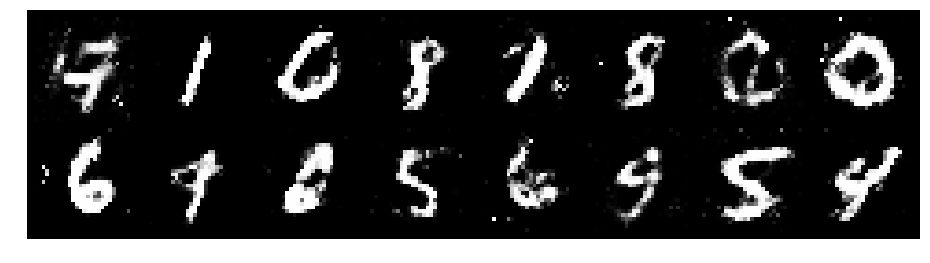

Epoch: [40/200], Batch Num: [600/938]
Discriminator Loss: 1.1738152503967285, Generator Loss: 1.246874213218689
D(x): 0.5525, D(G(z)): 0.3364


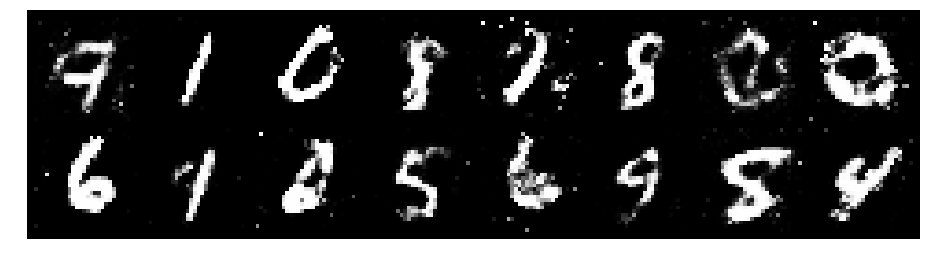

Epoch: [40/200], Batch Num: [700/938]
Discriminator Loss: 1.1345406770706177, Generator Loss: 1.0938935279846191
D(x): 0.6426, D(G(z)): 0.4178


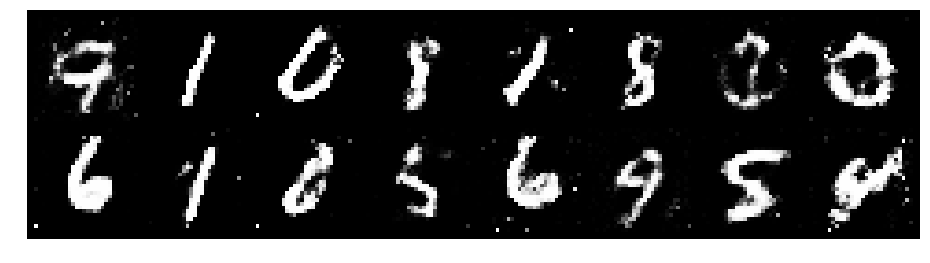

Epoch: [40/200], Batch Num: [800/938]
Discriminator Loss: 1.1269499063491821, Generator Loss: 1.084869146347046
D(x): 0.5929, D(G(z)): 0.3973


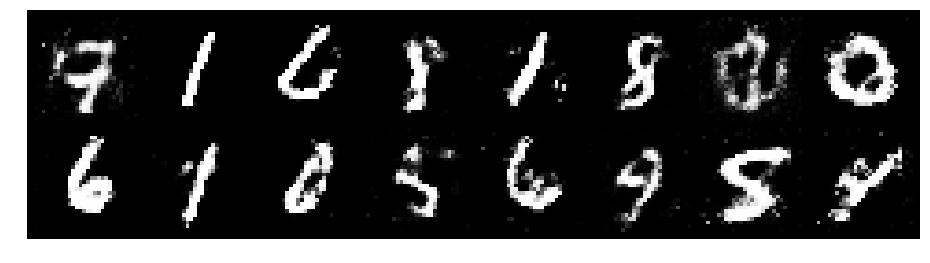

Epoch: [40/200], Batch Num: [900/938]
Discriminator Loss: 1.2368319034576416, Generator Loss: 0.8244738578796387
D(x): 0.5751, D(G(z)): 0.4429


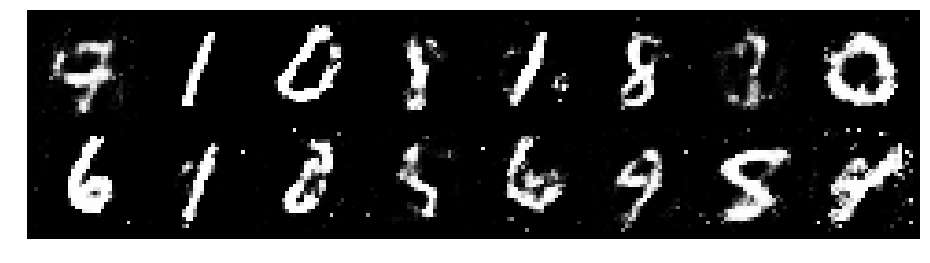

Epoch: [41/200], Batch Num: [0/938]
Discriminator Loss: 1.3939359188079834, Generator Loss: 0.8915849924087524
D(x): 0.5365, D(G(z)): 0.4784


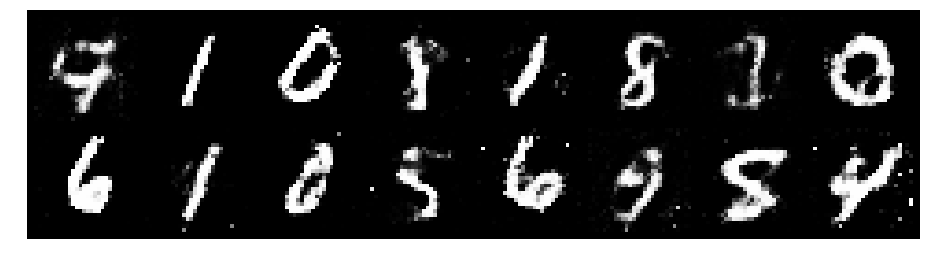

Epoch: [41/200], Batch Num: [100/938]
Discriminator Loss: 1.2930805683135986, Generator Loss: 0.9458122253417969
D(x): 0.5487, D(G(z)): 0.4373


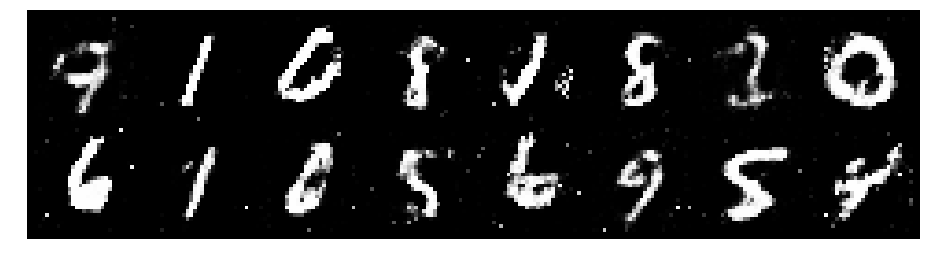

Epoch: [41/200], Batch Num: [200/938]
Discriminator Loss: 1.235717535018921, Generator Loss: 1.023016095161438
D(x): 0.5221, D(G(z)): 0.3670


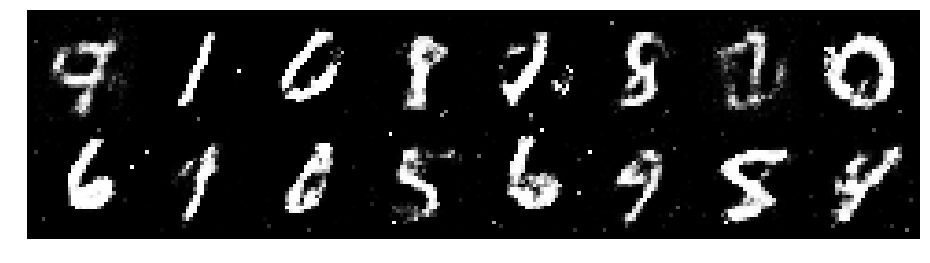

Epoch: [41/200], Batch Num: [300/938]
Discriminator Loss: 1.2327595949172974, Generator Loss: 0.919374942779541
D(x): 0.5502, D(G(z)): 0.3934


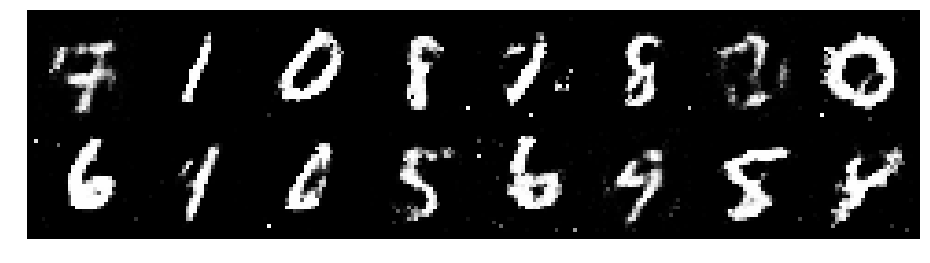

Epoch: [41/200], Batch Num: [400/938]
Discriminator Loss: 1.1884799003601074, Generator Loss: 0.8560201525688171
D(x): 0.6118, D(G(z)): 0.4409


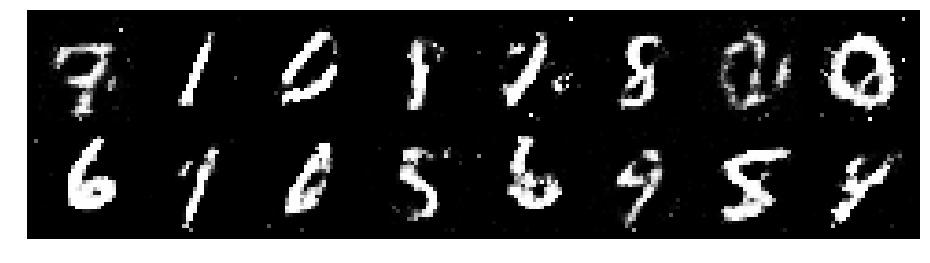

Epoch: [41/200], Batch Num: [500/938]
Discriminator Loss: 1.111054539680481, Generator Loss: 1.010091781616211
D(x): 0.6341, D(G(z)): 0.4181


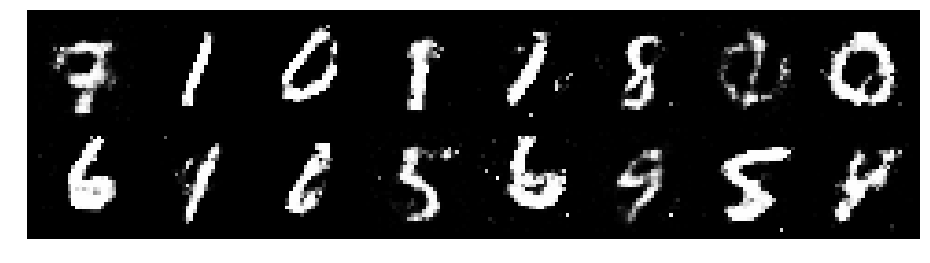

Epoch: [41/200], Batch Num: [600/938]
Discriminator Loss: 1.2275357246398926, Generator Loss: 0.9841318130493164
D(x): 0.5941, D(G(z)): 0.4411


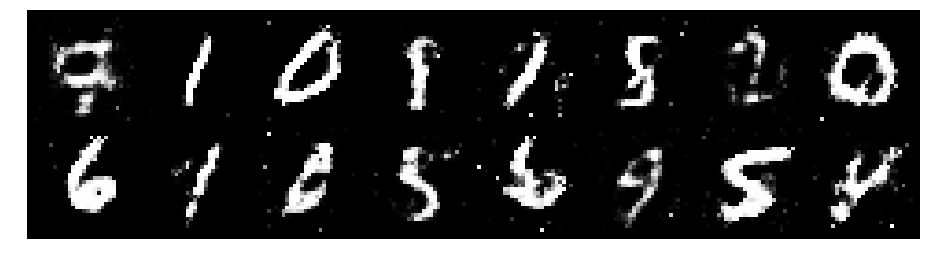

Epoch: [41/200], Batch Num: [700/938]
Discriminator Loss: 1.2352198362350464, Generator Loss: 1.0835671424865723
D(x): 0.5951, D(G(z)): 0.4300


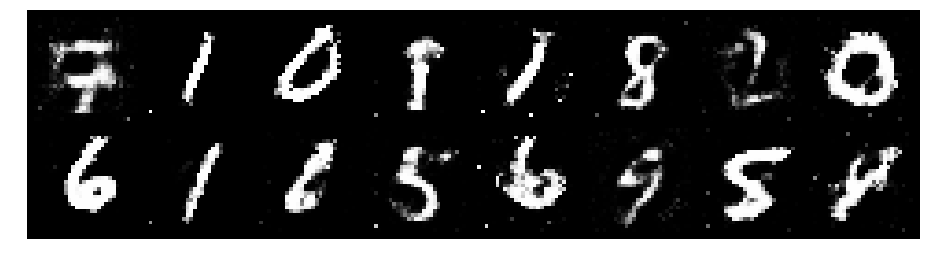

Epoch: [41/200], Batch Num: [800/938]
Discriminator Loss: 1.1784168481826782, Generator Loss: 1.2882518768310547
D(x): 0.5516, D(G(z)): 0.3569


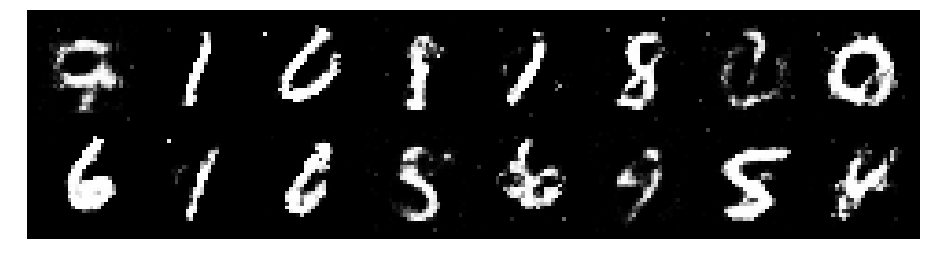

Epoch: [41/200], Batch Num: [900/938]
Discriminator Loss: 1.1618375778198242, Generator Loss: 1.0180772542953491
D(x): 0.5698, D(G(z)): 0.3807


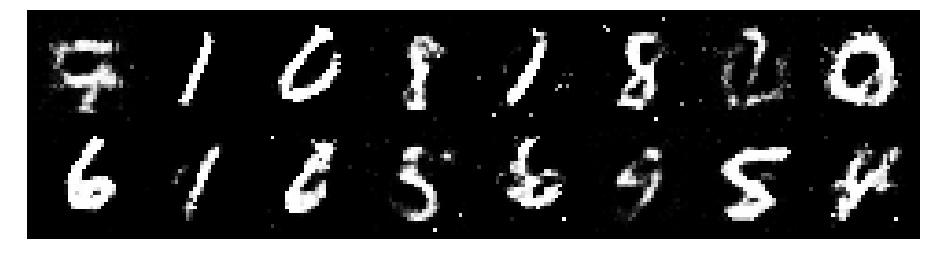

Epoch: [42/200], Batch Num: [0/938]
Discriminator Loss: 1.2075481414794922, Generator Loss: 1.0649783611297607
D(x): 0.5691, D(G(z)): 0.4130


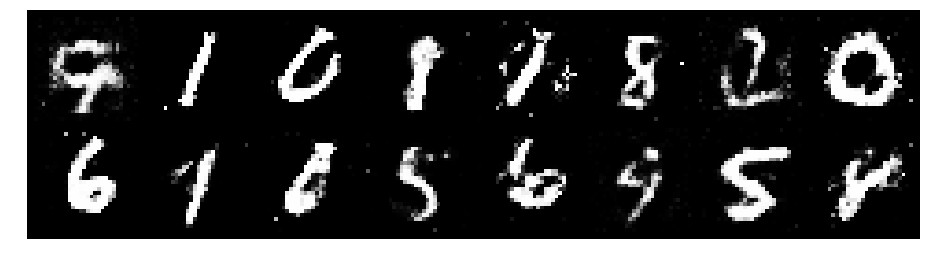

Epoch: [42/200], Batch Num: [100/938]
Discriminator Loss: 1.1578285694122314, Generator Loss: 0.933588445186615
D(x): 0.6152, D(G(z)): 0.4316


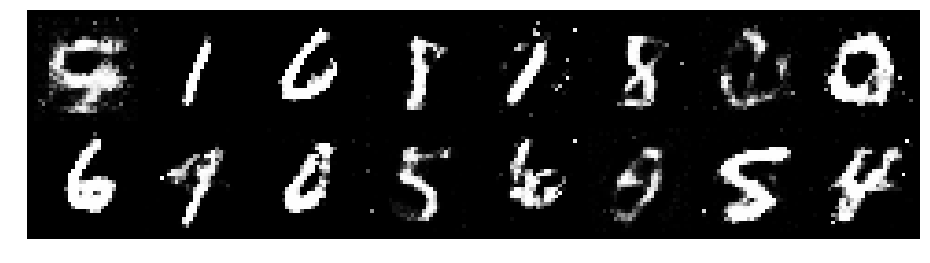

Epoch: [42/200], Batch Num: [200/938]
Discriminator Loss: 1.2082428932189941, Generator Loss: 1.0563790798187256
D(x): 0.6677, D(G(z)): 0.4503


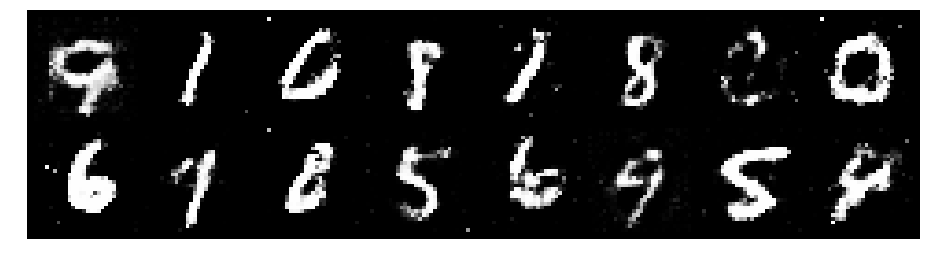

Epoch: [42/200], Batch Num: [300/938]
Discriminator Loss: 1.244802474975586, Generator Loss: 0.9761530160903931
D(x): 0.5671, D(G(z)): 0.4273


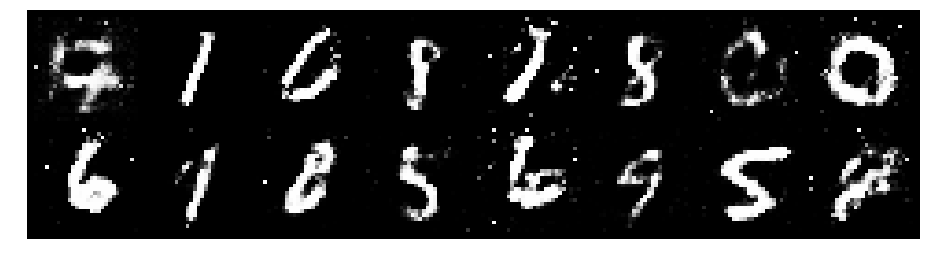

Epoch: [42/200], Batch Num: [400/938]
Discriminator Loss: 1.3050272464752197, Generator Loss: 0.9072135090827942
D(x): 0.5643, D(G(z)): 0.4449


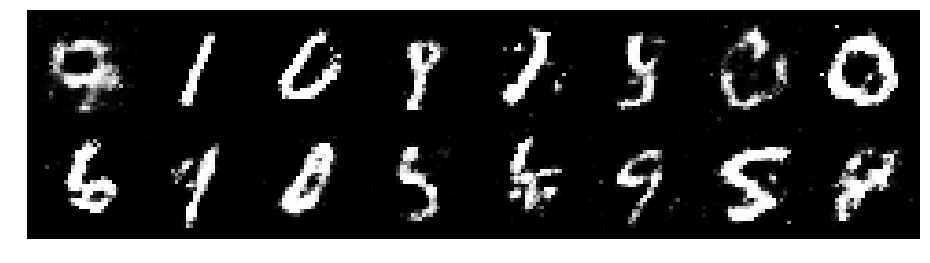

Epoch: [42/200], Batch Num: [500/938]
Discriminator Loss: 1.2641903162002563, Generator Loss: 0.9411592483520508
D(x): 0.5639, D(G(z)): 0.4296


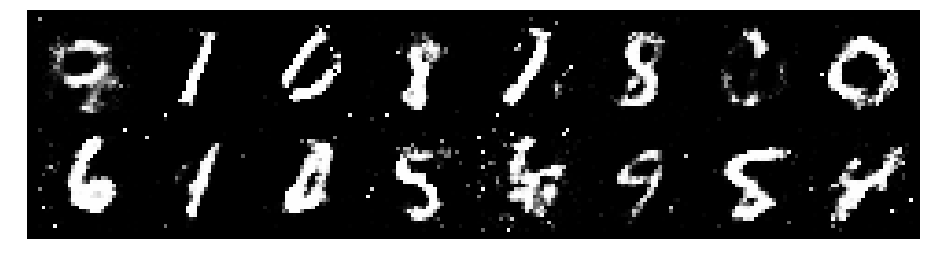

Epoch: [42/200], Batch Num: [600/938]
Discriminator Loss: 1.2810273170471191, Generator Loss: 1.1017299890518188
D(x): 0.5150, D(G(z)): 0.3980


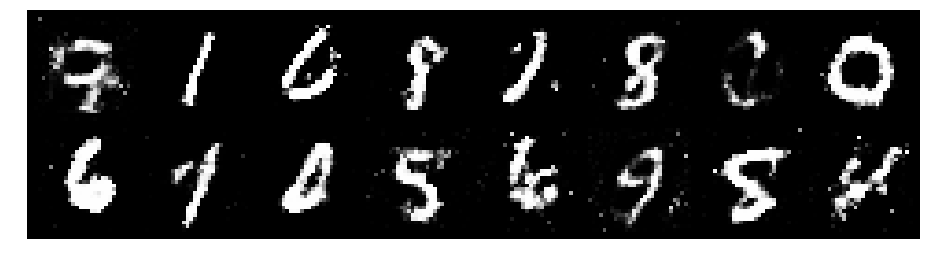

Epoch: [42/200], Batch Num: [700/938]
Discriminator Loss: 1.2413873672485352, Generator Loss: 1.0890551805496216
D(x): 0.5915, D(G(z)): 0.4127


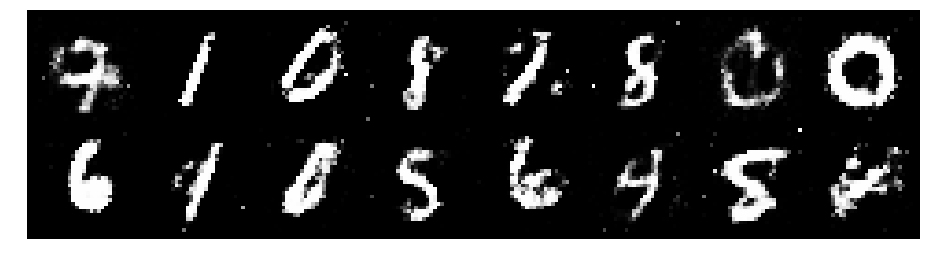

Epoch: [42/200], Batch Num: [800/938]
Discriminator Loss: 1.1936315298080444, Generator Loss: 1.0495119094848633
D(x): 0.5749, D(G(z)): 0.3905


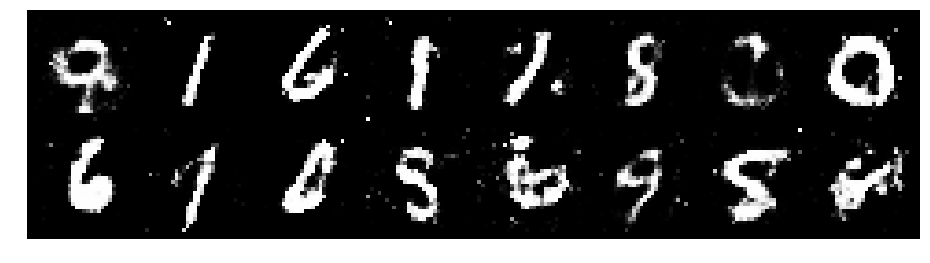

Epoch: [42/200], Batch Num: [900/938]
Discriminator Loss: 1.2627387046813965, Generator Loss: 1.0677776336669922
D(x): 0.5253, D(G(z)): 0.3918


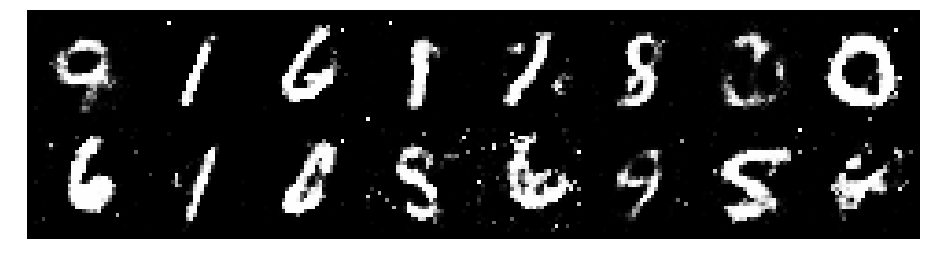

Epoch: [43/200], Batch Num: [0/938]
Discriminator Loss: 1.2689772844314575, Generator Loss: 0.8225556015968323
D(x): 0.6460, D(G(z)): 0.4936


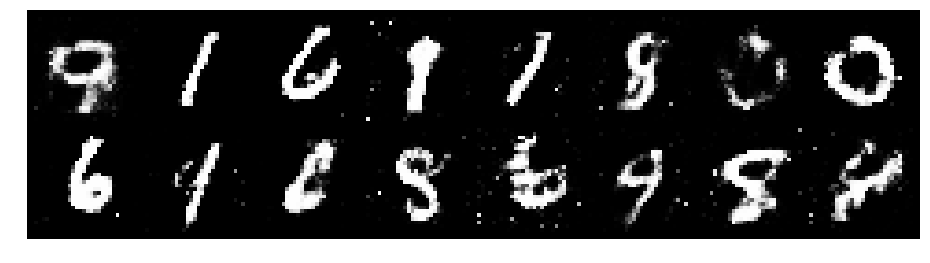

Epoch: [43/200], Batch Num: [100/938]
Discriminator Loss: 1.1159825325012207, Generator Loss: 0.9807499647140503
D(x): 0.6098, D(G(z)): 0.4133


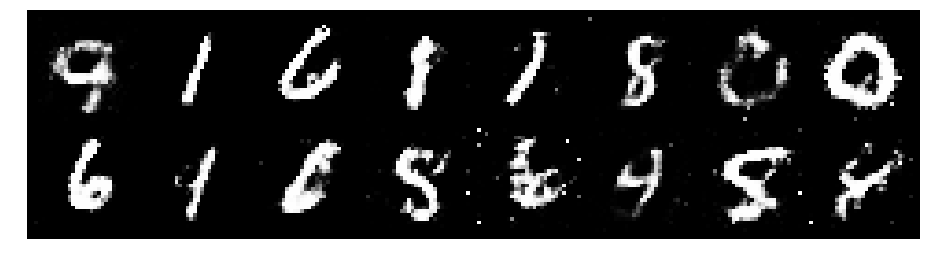

Epoch: [43/200], Batch Num: [200/938]
Discriminator Loss: 1.2160859107971191, Generator Loss: 1.1160624027252197
D(x): 0.6212, D(G(z)): 0.4370


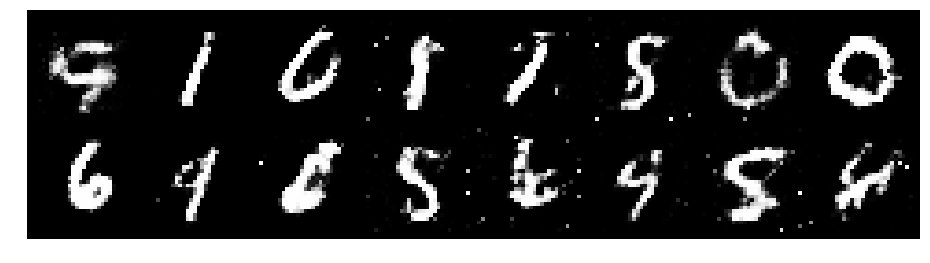

Epoch: [43/200], Batch Num: [300/938]
Discriminator Loss: 1.1296906471252441, Generator Loss: 1.2226353883743286
D(x): 0.5863, D(G(z)): 0.3739


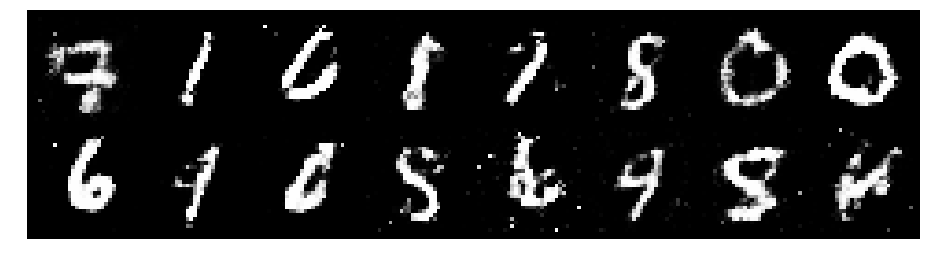

Epoch: [43/200], Batch Num: [400/938]
Discriminator Loss: 1.0691132545471191, Generator Loss: 0.9770218133926392
D(x): 0.6028, D(G(z)): 0.3852


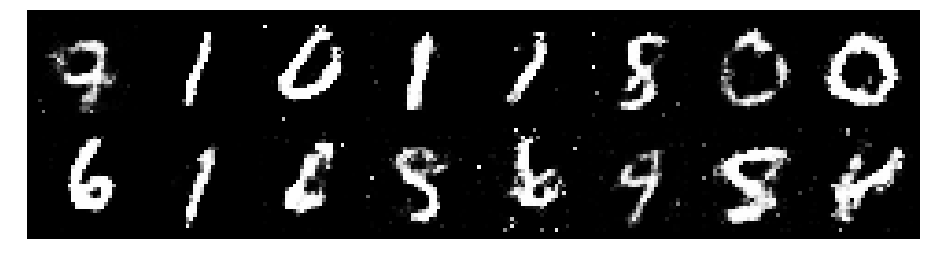

Epoch: [43/200], Batch Num: [500/938]
Discriminator Loss: 1.2016606330871582, Generator Loss: 1.0776622295379639
D(x): 0.5535, D(G(z)): 0.3966


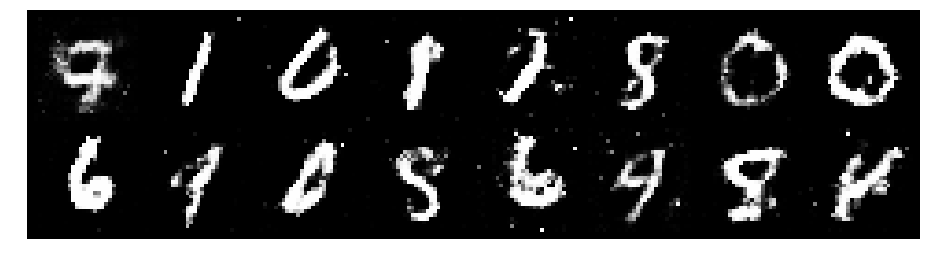

Epoch: [43/200], Batch Num: [600/938]
Discriminator Loss: 1.2586748600006104, Generator Loss: 0.9810281991958618
D(x): 0.5920, D(G(z)): 0.4401


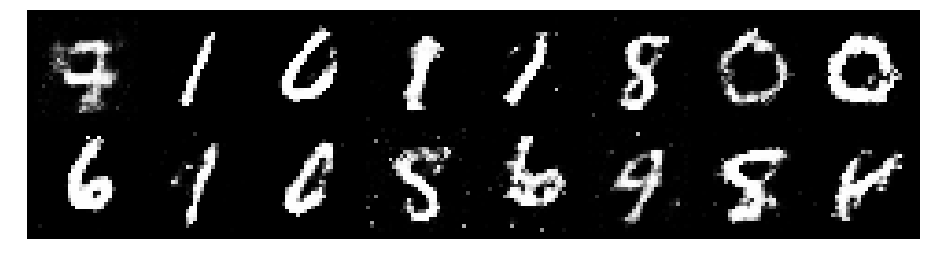

Epoch: [43/200], Batch Num: [700/938]
Discriminator Loss: 1.3194572925567627, Generator Loss: 1.0068464279174805
D(x): 0.5650, D(G(z)): 0.4313


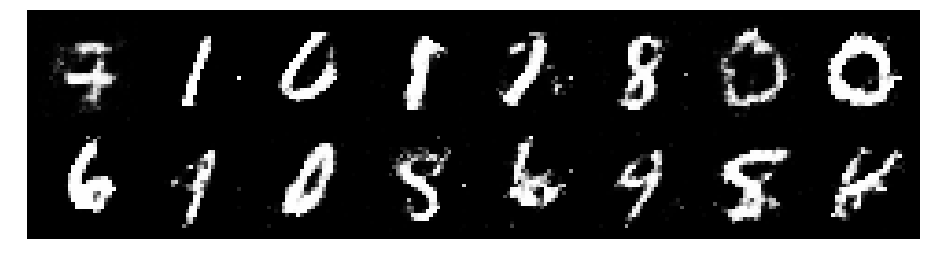

Epoch: [43/200], Batch Num: [800/938]
Discriminator Loss: 1.1901403665542603, Generator Loss: 0.9033757448196411
D(x): 0.6252, D(G(z)): 0.4490


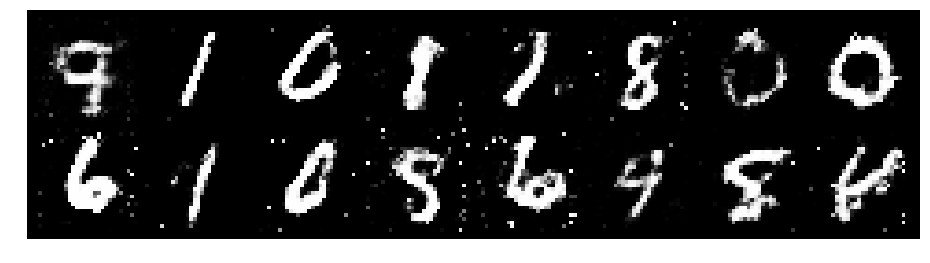

Epoch: [43/200], Batch Num: [900/938]
Discriminator Loss: 1.2648708820343018, Generator Loss: 0.9340677857398987
D(x): 0.5567, D(G(z)): 0.4477


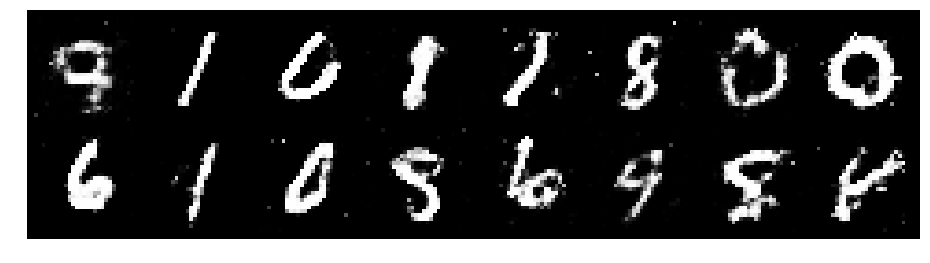

Epoch: [44/200], Batch Num: [0/938]
Discriminator Loss: 1.1758800745010376, Generator Loss: 0.8396824598312378
D(x): 0.6029, D(G(z)): 0.4425


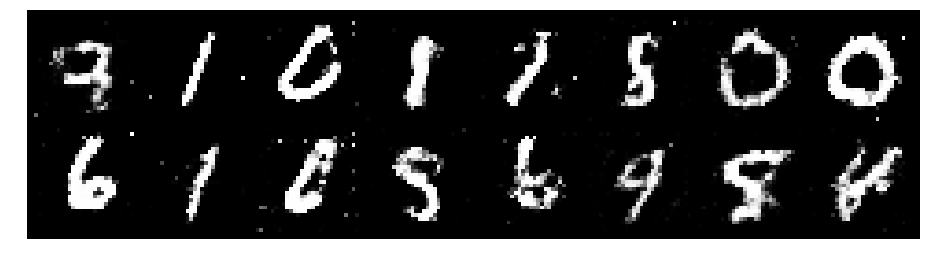

Epoch: [44/200], Batch Num: [100/938]
Discriminator Loss: 1.305618405342102, Generator Loss: 0.7649434208869934
D(x): 0.5468, D(G(z)): 0.4692


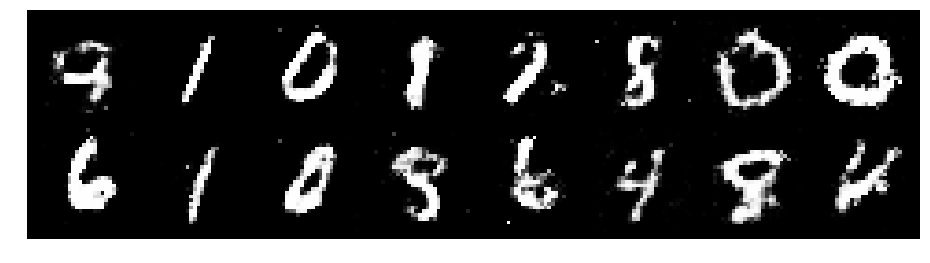

Epoch: [44/200], Batch Num: [200/938]
Discriminator Loss: 1.3575063943862915, Generator Loss: 0.7432655096054077
D(x): 0.5879, D(G(z)): 0.5060


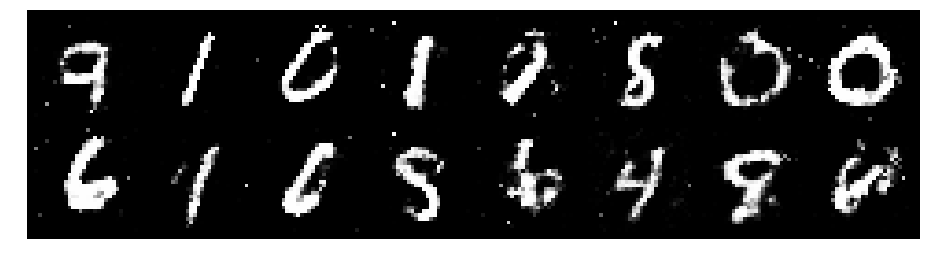

Epoch: [44/200], Batch Num: [300/938]
Discriminator Loss: 1.203117847442627, Generator Loss: 1.0312747955322266
D(x): 0.5713, D(G(z)): 0.4245


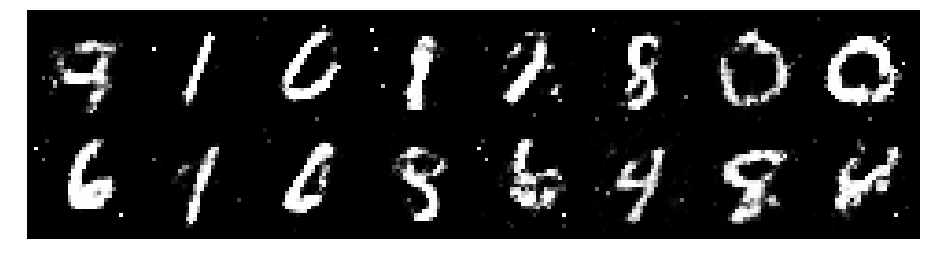

Epoch: [44/200], Batch Num: [400/938]
Discriminator Loss: 1.1806666851043701, Generator Loss: 0.9863098859786987
D(x): 0.5828, D(G(z)): 0.4053


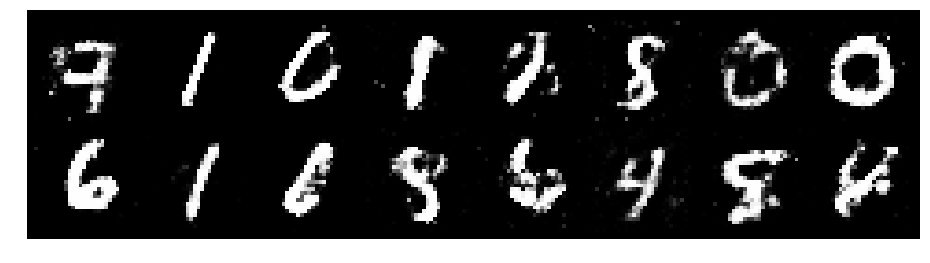

Epoch: [44/200], Batch Num: [500/938]
Discriminator Loss: 1.242560625076294, Generator Loss: 0.8803797960281372
D(x): 0.5931, D(G(z)): 0.4495


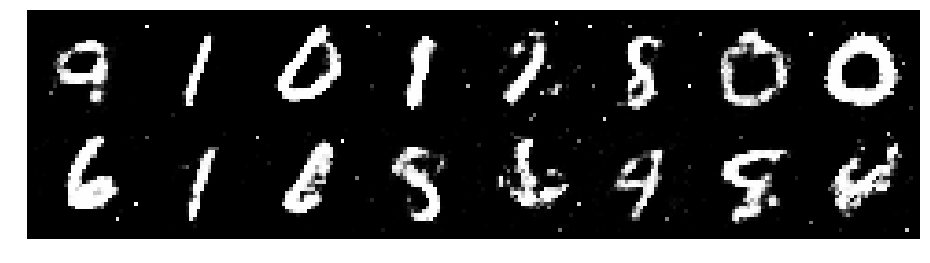

Epoch: [44/200], Batch Num: [600/938]
Discriminator Loss: 1.1439980268478394, Generator Loss: 0.9455727338790894
D(x): 0.6453, D(G(z)): 0.4510


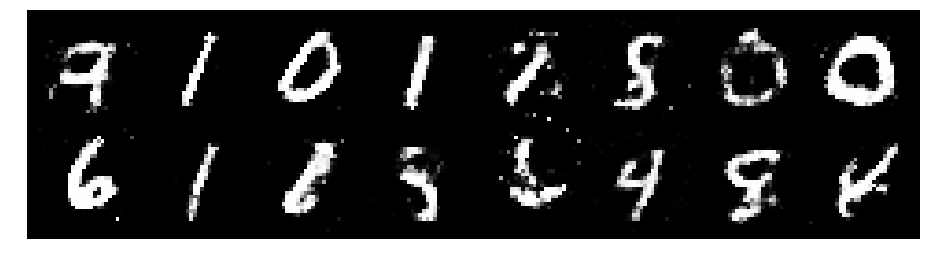

Epoch: [44/200], Batch Num: [700/938]
Discriminator Loss: 1.0856469869613647, Generator Loss: 0.9335647225379944
D(x): 0.6227, D(G(z)): 0.3872


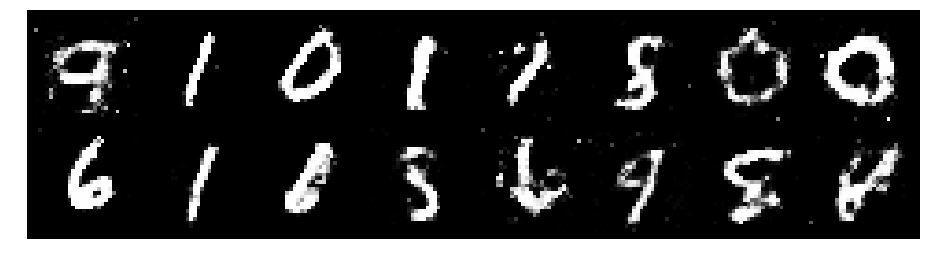

Epoch: [44/200], Batch Num: [800/938]
Discriminator Loss: 1.1931610107421875, Generator Loss: 0.8499876856803894
D(x): 0.5990, D(G(z)): 0.4328


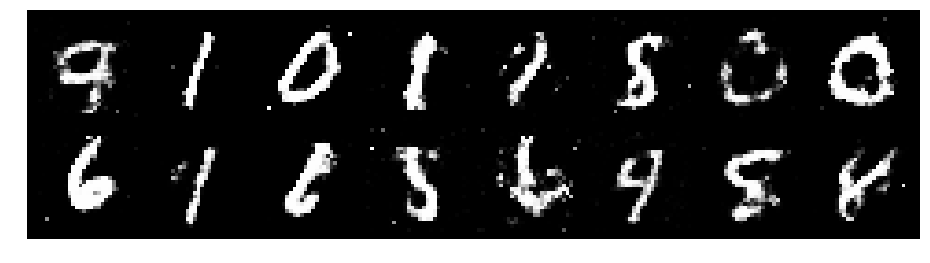

Epoch: [44/200], Batch Num: [900/938]
Discriminator Loss: 1.2313493490219116, Generator Loss: 1.0211941003799438
D(x): 0.6194, D(G(z)): 0.4759


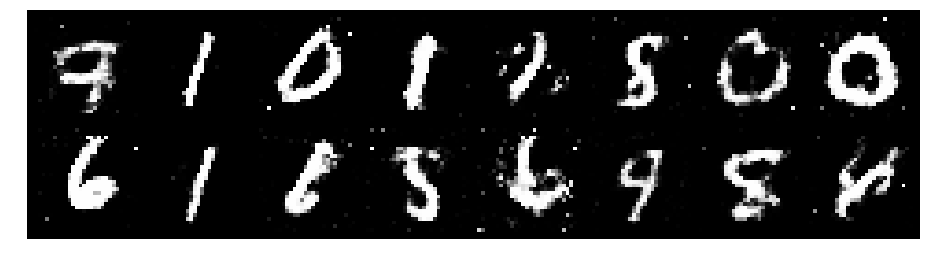

Epoch: [45/200], Batch Num: [0/938]
Discriminator Loss: 1.1255970001220703, Generator Loss: 1.0777761936187744
D(x): 0.5631, D(G(z)): 0.3597


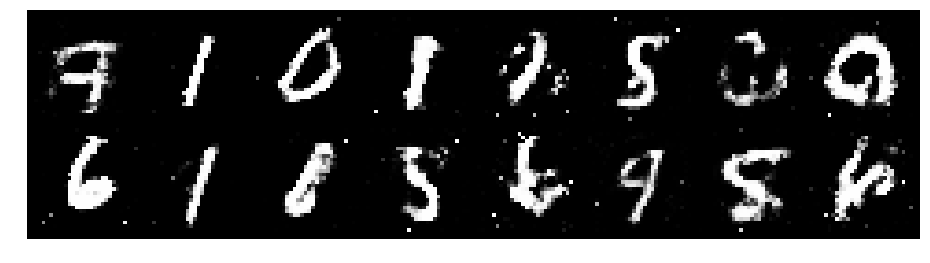

Epoch: [45/200], Batch Num: [100/938]
Discriminator Loss: 1.31659996509552, Generator Loss: 0.9386744499206543
D(x): 0.5653, D(G(z)): 0.4712


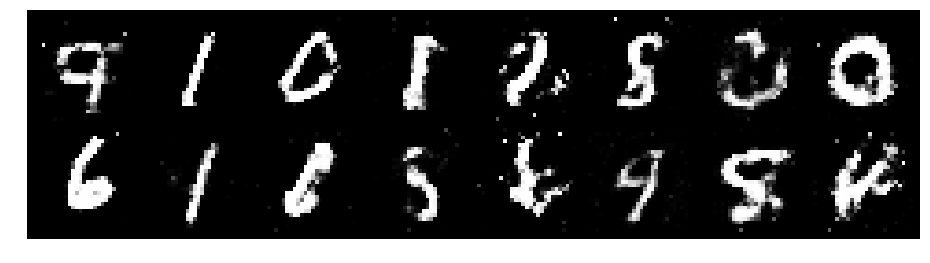

Epoch: [45/200], Batch Num: [200/938]
Discriminator Loss: 1.2255390882492065, Generator Loss: 0.945159375667572
D(x): 0.5750, D(G(z)): 0.4198


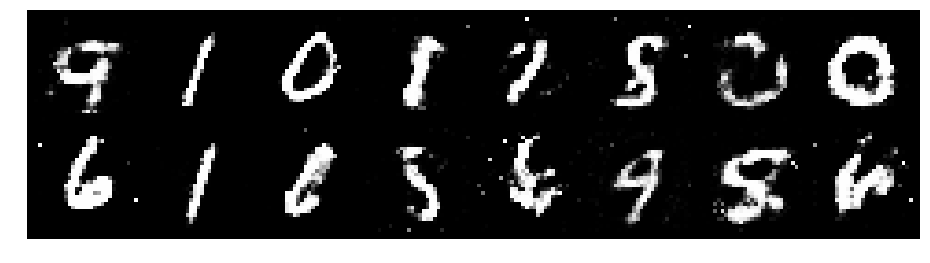

Epoch: [45/200], Batch Num: [300/938]
Discriminator Loss: 1.035873293876648, Generator Loss: 1.230377197265625
D(x): 0.6554, D(G(z)): 0.3953


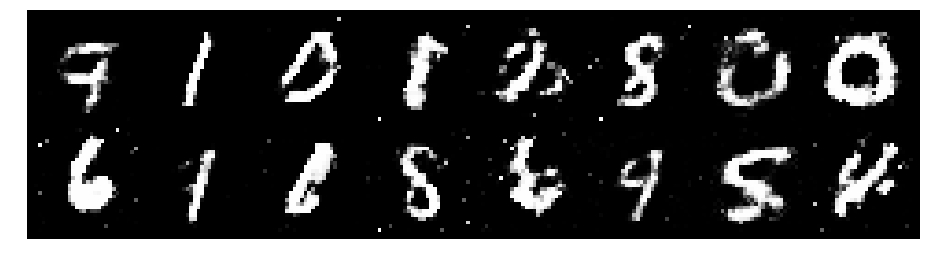

Epoch: [45/200], Batch Num: [400/938]
Discriminator Loss: 1.0989927053451538, Generator Loss: 1.0741665363311768
D(x): 0.6003, D(G(z)): 0.3834


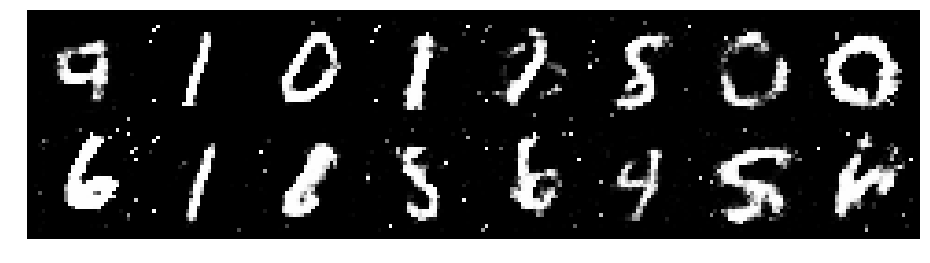

Epoch: [45/200], Batch Num: [500/938]
Discriminator Loss: 1.4739830493927002, Generator Loss: 0.8348792791366577
D(x): 0.5388, D(G(z)): 0.4749


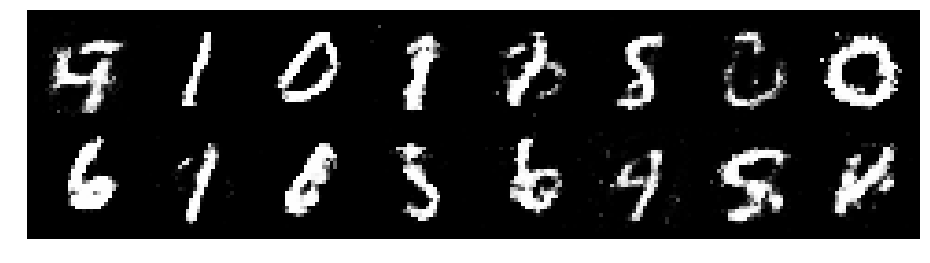

Epoch: [45/200], Batch Num: [600/938]
Discriminator Loss: 1.3327198028564453, Generator Loss: 0.7588029503822327
D(x): 0.5332, D(G(z)): 0.4840


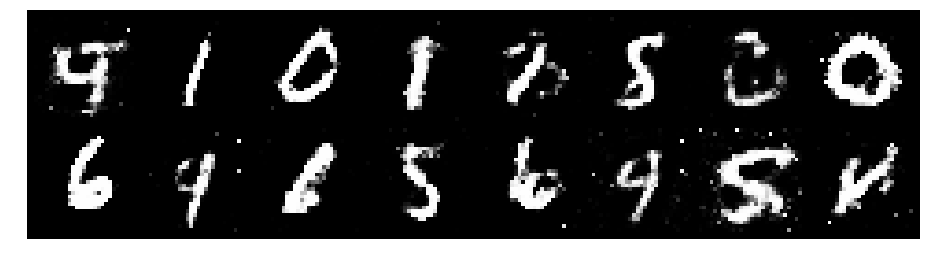

Epoch: [45/200], Batch Num: [700/938]
Discriminator Loss: 1.1967371702194214, Generator Loss: 0.9085724353790283
D(x): 0.5754, D(G(z)): 0.3812


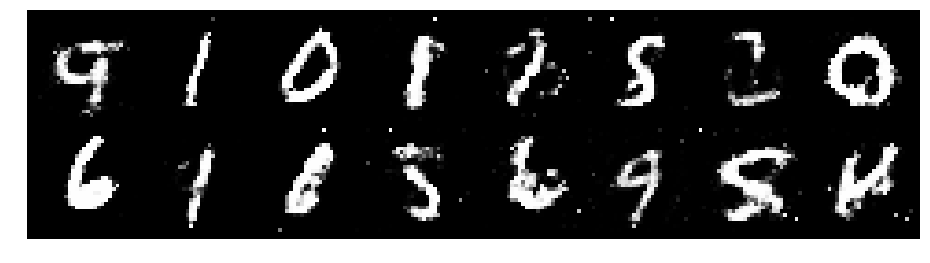

Epoch: [45/200], Batch Num: [800/938]
Discriminator Loss: 1.1706305742263794, Generator Loss: 1.2355116605758667
D(x): 0.6019, D(G(z)): 0.3962


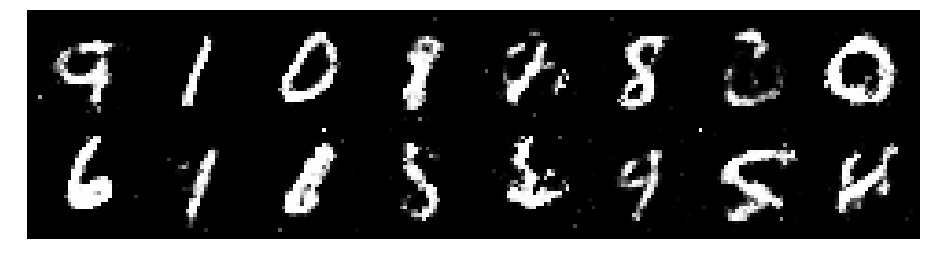

Epoch: [45/200], Batch Num: [900/938]
Discriminator Loss: 1.0894010066986084, Generator Loss: 0.9990346431732178
D(x): 0.6257, D(G(z)): 0.4011


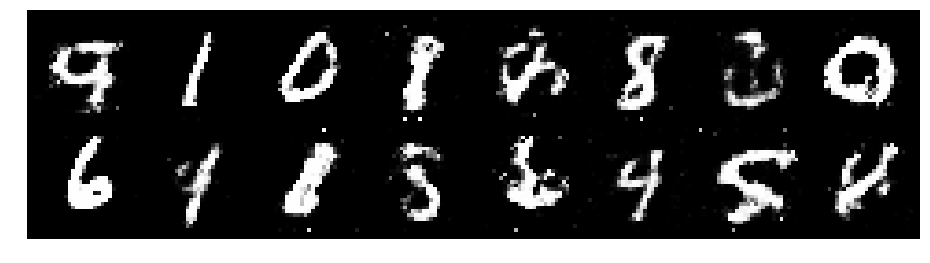

Epoch: [46/200], Batch Num: [0/938]
Discriminator Loss: 1.279958724975586, Generator Loss: 0.9045282006263733
D(x): 0.5357, D(G(z)): 0.4318


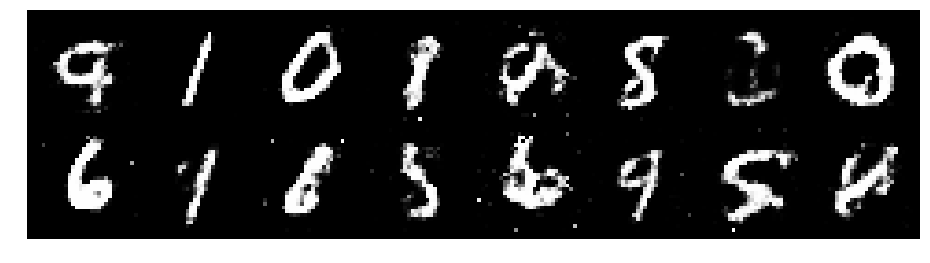

Epoch: [46/200], Batch Num: [100/938]
Discriminator Loss: 1.1710522174835205, Generator Loss: 0.8575394749641418
D(x): 0.7034, D(G(z)): 0.5151


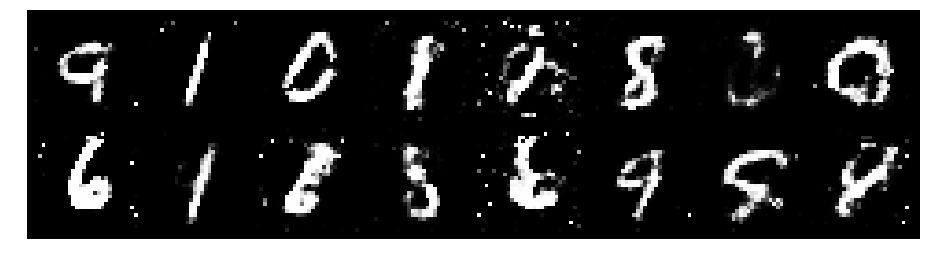

Epoch: [46/200], Batch Num: [200/938]
Discriminator Loss: 1.2264636754989624, Generator Loss: 1.1475554704666138
D(x): 0.5993, D(G(z)): 0.4305


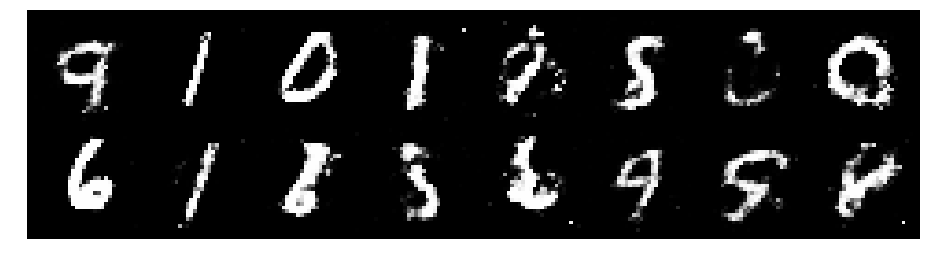

Epoch: [46/200], Batch Num: [300/938]
Discriminator Loss: 1.2296206951141357, Generator Loss: 1.165191411972046
D(x): 0.5470, D(G(z)): 0.3769


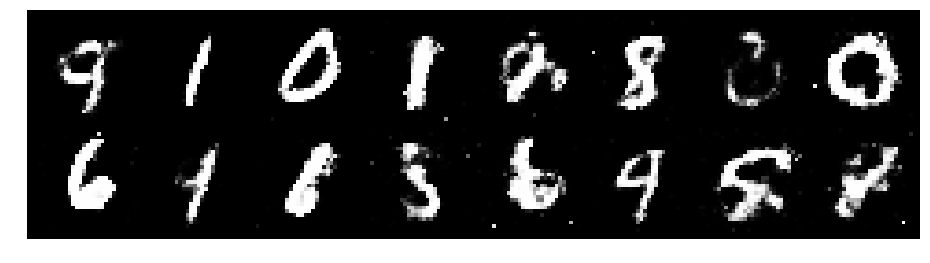

Epoch: [46/200], Batch Num: [400/938]
Discriminator Loss: 1.2234282493591309, Generator Loss: 1.040722131729126
D(x): 0.5871, D(G(z)): 0.4238


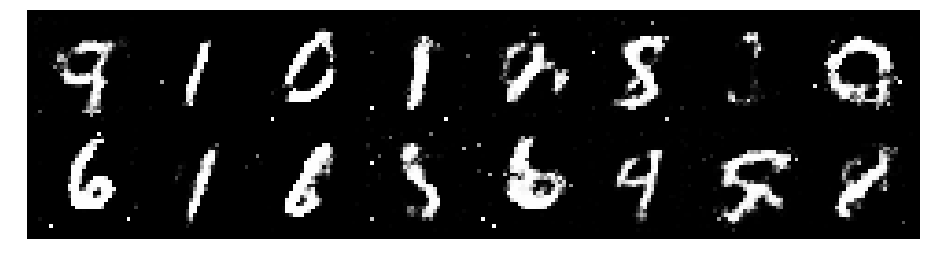

Epoch: [46/200], Batch Num: [500/938]
Discriminator Loss: 1.3028209209442139, Generator Loss: 1.1277215480804443
D(x): 0.5150, D(G(z)): 0.3968


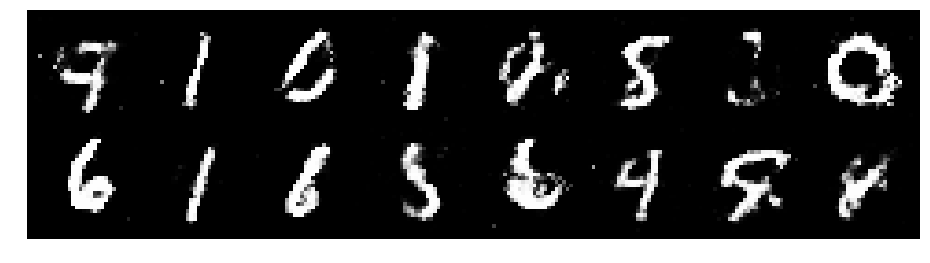

Epoch: [46/200], Batch Num: [600/938]
Discriminator Loss: 1.1712721586227417, Generator Loss: 1.0987629890441895
D(x): 0.5264, D(G(z)): 0.3669


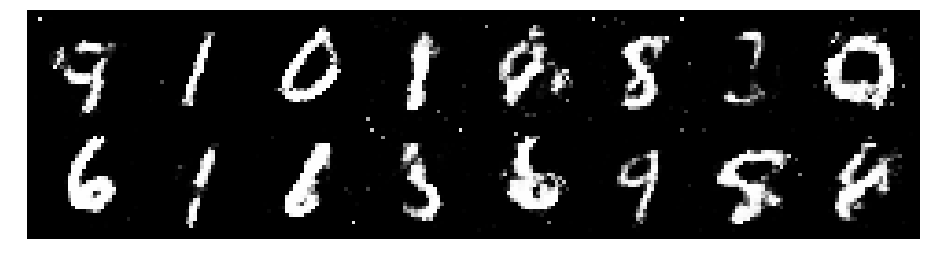

Epoch: [46/200], Batch Num: [700/938]
Discriminator Loss: 1.2906216382980347, Generator Loss: 0.8845537900924683
D(x): 0.5322, D(G(z)): 0.4301


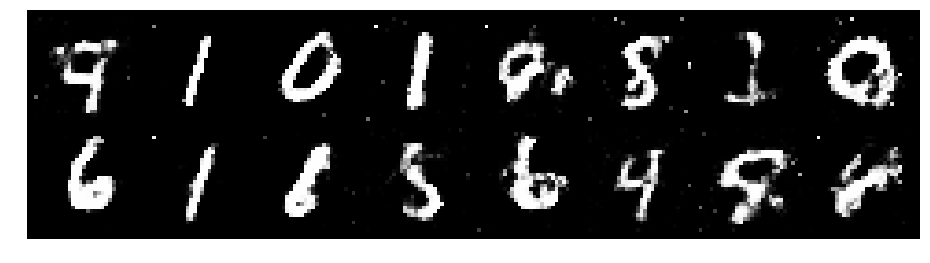

Epoch: [46/200], Batch Num: [800/938]
Discriminator Loss: 1.20441472530365, Generator Loss: 0.8284071683883667
D(x): 0.5748, D(G(z)): 0.4390


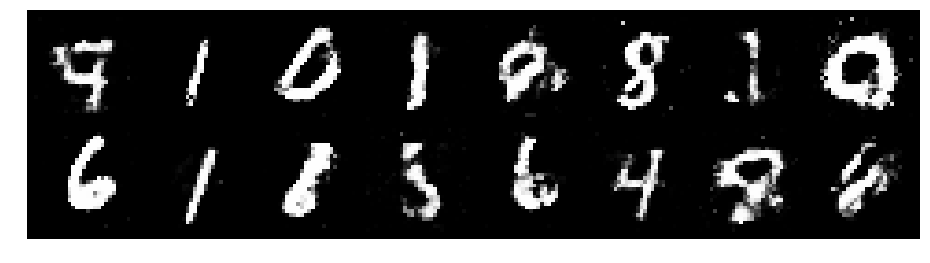

Epoch: [46/200], Batch Num: [900/938]
Discriminator Loss: 1.106130838394165, Generator Loss: 1.0089704990386963
D(x): 0.6211, D(G(z)): 0.3941


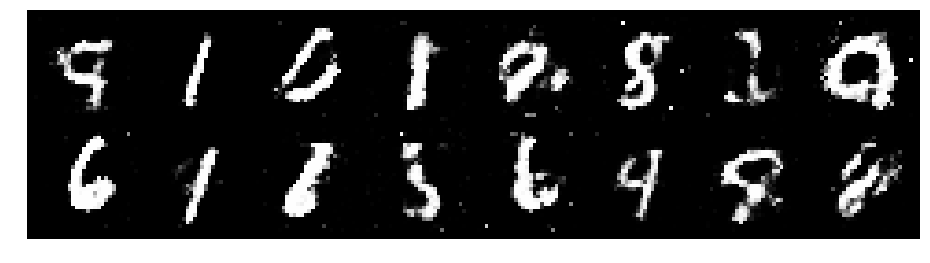

Epoch: [47/200], Batch Num: [0/938]
Discriminator Loss: 1.226357102394104, Generator Loss: 1.0058307647705078
D(x): 0.5900, D(G(z)): 0.4354


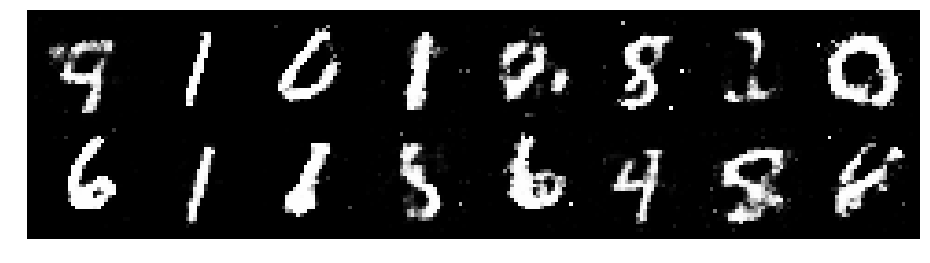

Epoch: [47/200], Batch Num: [100/938]
Discriminator Loss: 1.365835189819336, Generator Loss: 0.8582015037536621
D(x): 0.5550, D(G(z)): 0.4740


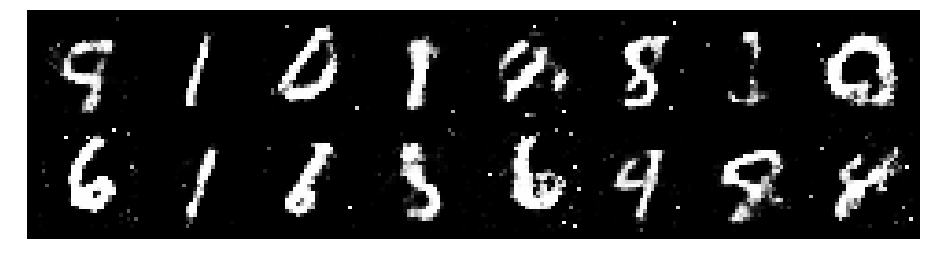

Epoch: [47/200], Batch Num: [200/938]
Discriminator Loss: 1.1780329942703247, Generator Loss: 0.9449664354324341
D(x): 0.6046, D(G(z)): 0.4404


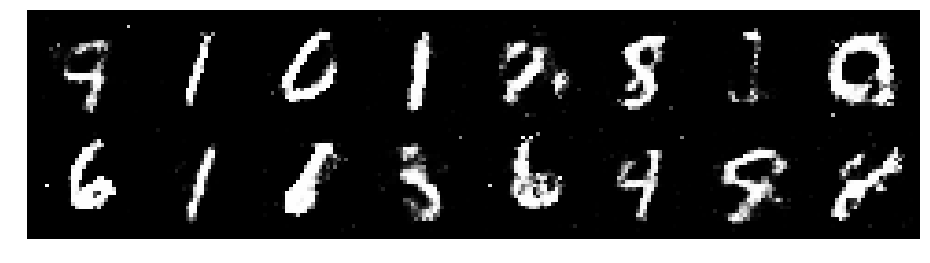

Epoch: [47/200], Batch Num: [300/938]
Discriminator Loss: 1.1691479682922363, Generator Loss: 0.9579446315765381
D(x): 0.5701, D(G(z)): 0.4164


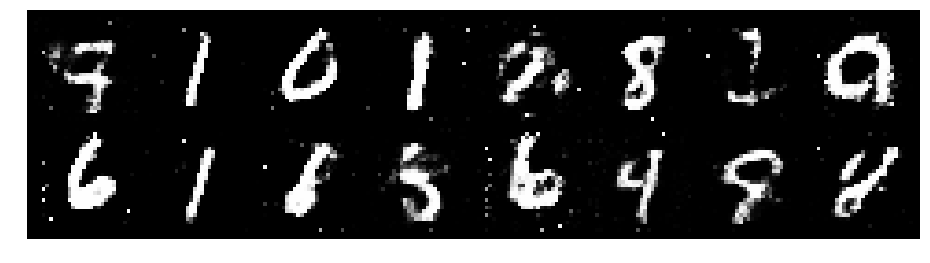

Epoch: [47/200], Batch Num: [400/938]
Discriminator Loss: 1.3749083280563354, Generator Loss: 0.8163630962371826
D(x): 0.5327, D(G(z)): 0.4636


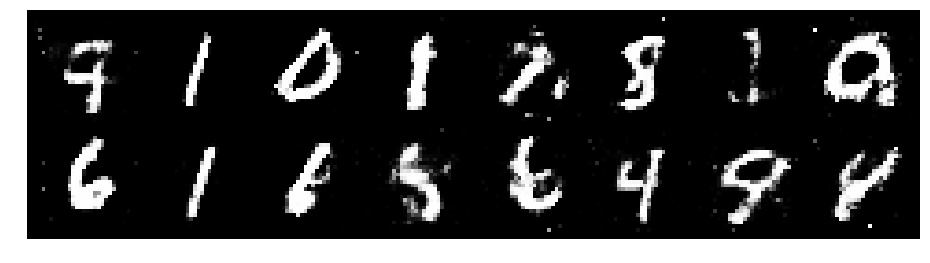

Epoch: [47/200], Batch Num: [500/938]
Discriminator Loss: 1.2891188859939575, Generator Loss: 0.9235923290252686
D(x): 0.5452, D(G(z)): 0.4242


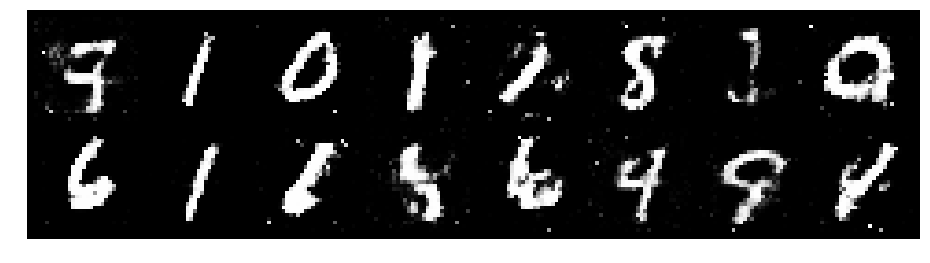

Epoch: [47/200], Batch Num: [600/938]
Discriminator Loss: 1.1639635562896729, Generator Loss: 0.9008166790008545
D(x): 0.6810, D(G(z)): 0.4492


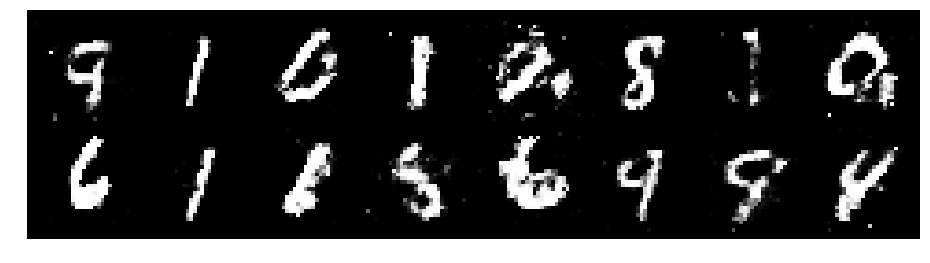

Epoch: [47/200], Batch Num: [700/938]
Discriminator Loss: 1.3248512744903564, Generator Loss: 0.9512741565704346
D(x): 0.5136, D(G(z)): 0.4289


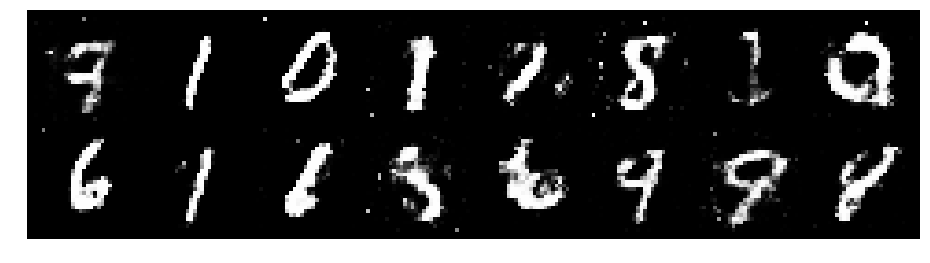

Epoch: [47/200], Batch Num: [800/938]
Discriminator Loss: 1.1764112710952759, Generator Loss: 0.9918882250785828
D(x): 0.5774, D(G(z)): 0.4092


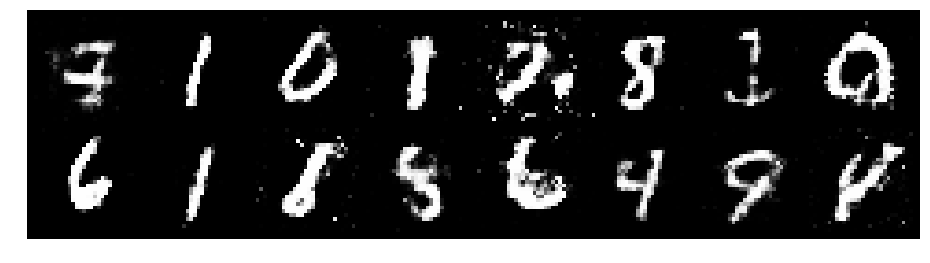

Epoch: [47/200], Batch Num: [900/938]
Discriminator Loss: 1.1336350440979004, Generator Loss: 0.9440826177597046
D(x): 0.6079, D(G(z)): 0.4296


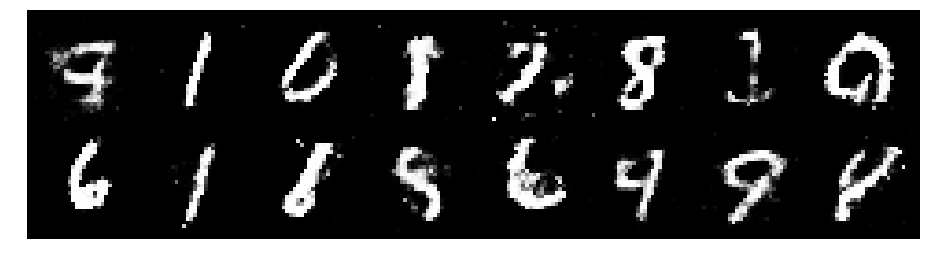

Epoch: [48/200], Batch Num: [0/938]
Discriminator Loss: 1.1841027736663818, Generator Loss: 0.8077477216720581
D(x): 0.6374, D(G(z)): 0.4888


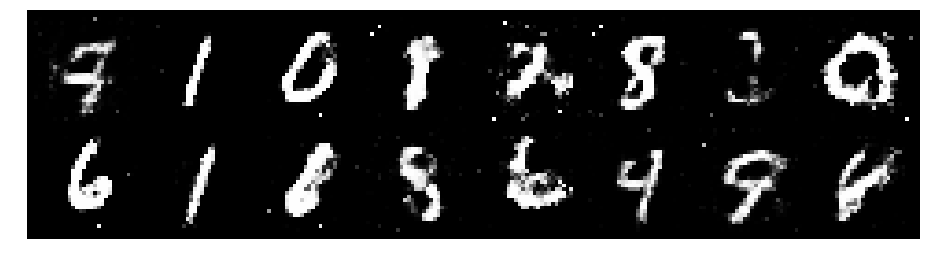

Epoch: [48/200], Batch Num: [100/938]
Discriminator Loss: 1.1806769371032715, Generator Loss: 0.8168601989746094
D(x): 0.5345, D(G(z)): 0.3926


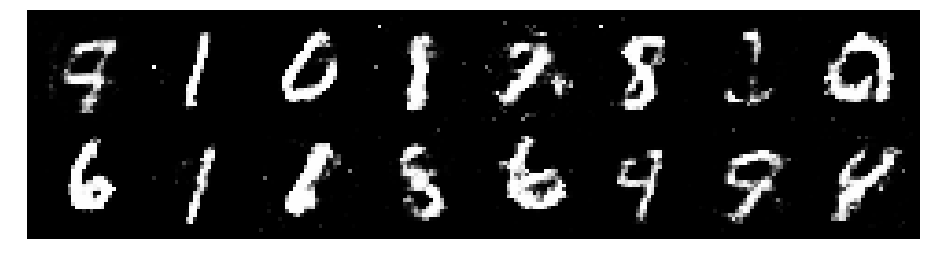

Epoch: [48/200], Batch Num: [200/938]
Discriminator Loss: 1.3667902946472168, Generator Loss: 0.7950118780136108
D(x): 0.5465, D(G(z)): 0.4549


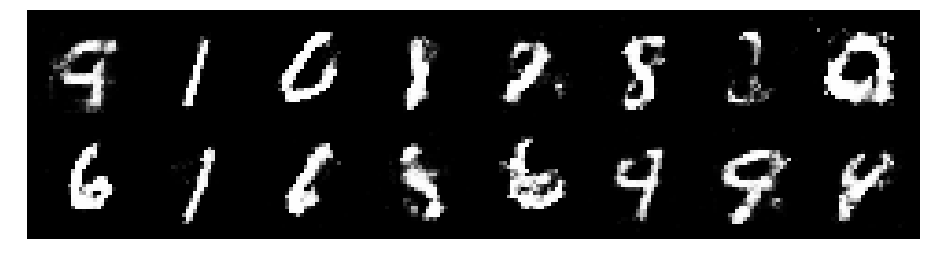

Epoch: [48/200], Batch Num: [300/938]
Discriminator Loss: 1.449728012084961, Generator Loss: 0.9345589876174927
D(x): 0.5059, D(G(z)): 0.4414


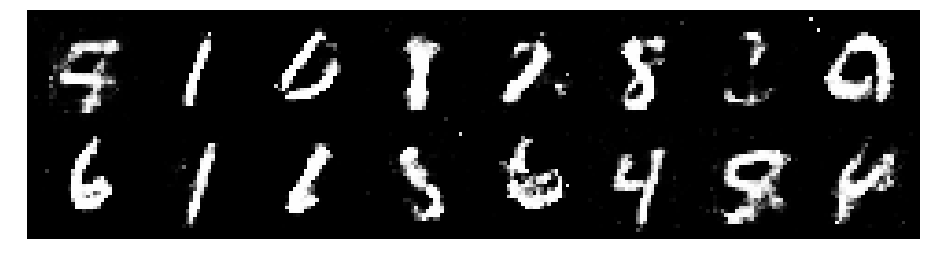

Epoch: [48/200], Batch Num: [400/938]
Discriminator Loss: 1.2789418697357178, Generator Loss: 1.0598576068878174
D(x): 0.6388, D(G(z)): 0.4751


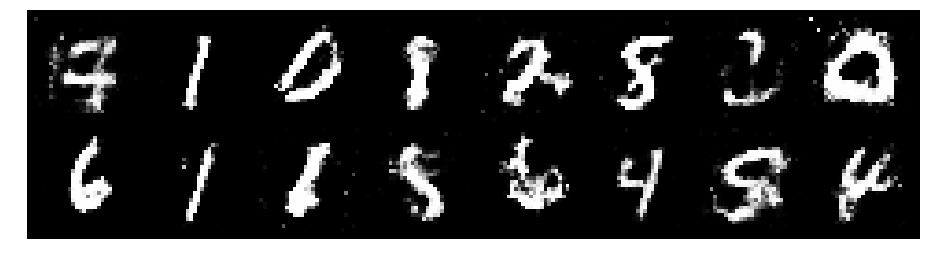

Epoch: [48/200], Batch Num: [500/938]
Discriminator Loss: 1.231034755706787, Generator Loss: 1.0617568492889404
D(x): 0.5650, D(G(z)): 0.4054


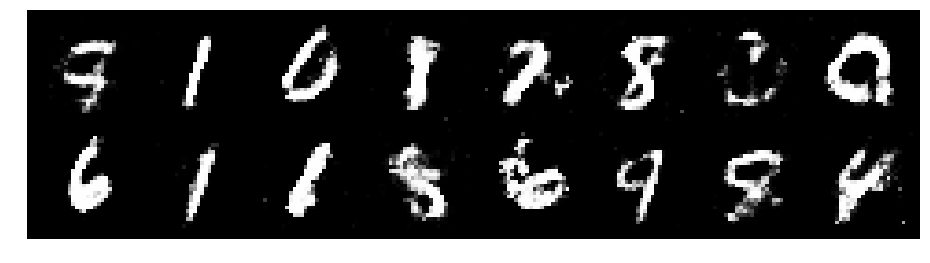

Epoch: [48/200], Batch Num: [600/938]
Discriminator Loss: 1.3059916496276855, Generator Loss: 0.8104589581489563
D(x): 0.5427, D(G(z)): 0.4683


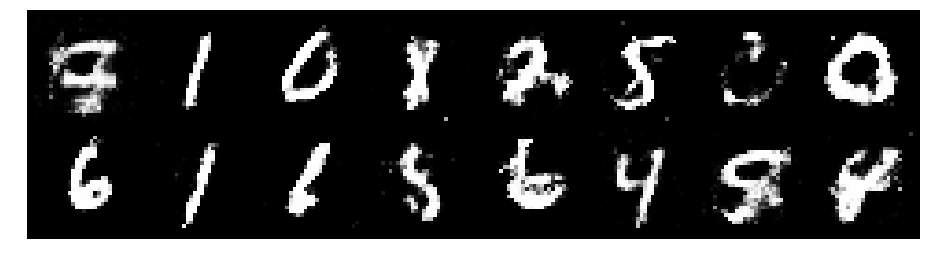

Epoch: [48/200], Batch Num: [700/938]
Discriminator Loss: 1.2895475625991821, Generator Loss: 1.0607314109802246
D(x): 0.5480, D(G(z)): 0.4234


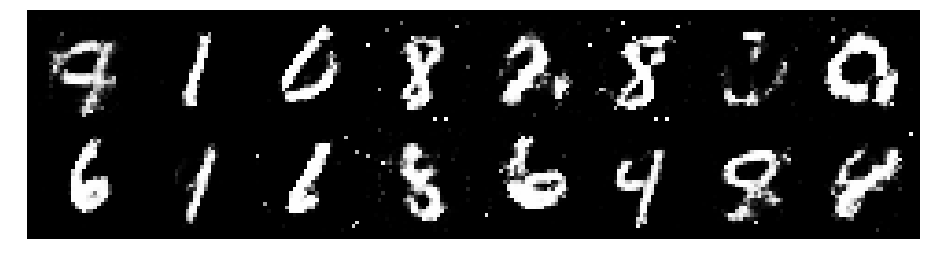

Epoch: [48/200], Batch Num: [800/938]
Discriminator Loss: 1.1205092668533325, Generator Loss: 1.1615519523620605
D(x): 0.6190, D(G(z)): 0.3869


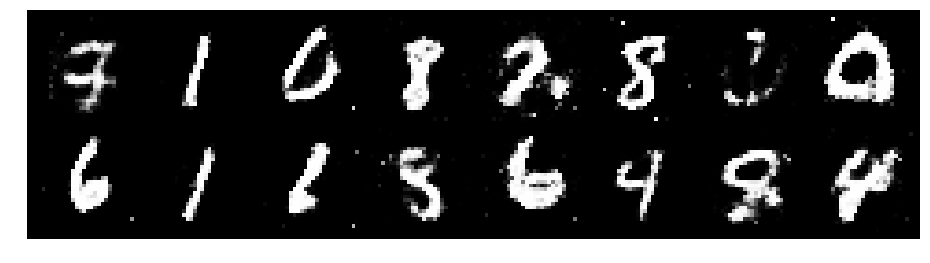

Epoch: [48/200], Batch Num: [900/938]
Discriminator Loss: 1.4191731214523315, Generator Loss: 1.2107088565826416
D(x): 0.4996, D(G(z)): 0.3856


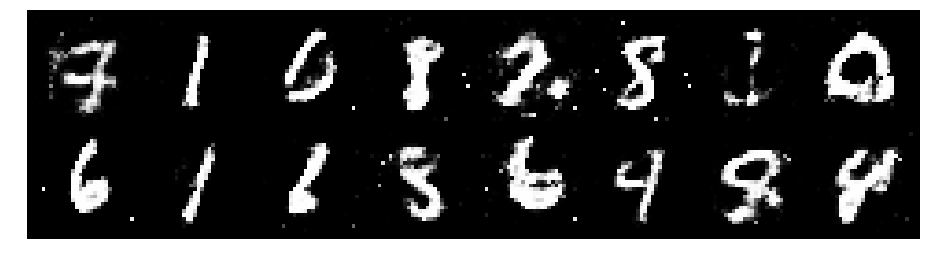

Epoch: [49/200], Batch Num: [0/938]
Discriminator Loss: 1.1727529764175415, Generator Loss: 1.0885398387908936
D(x): 0.6426, D(G(z)): 0.4298


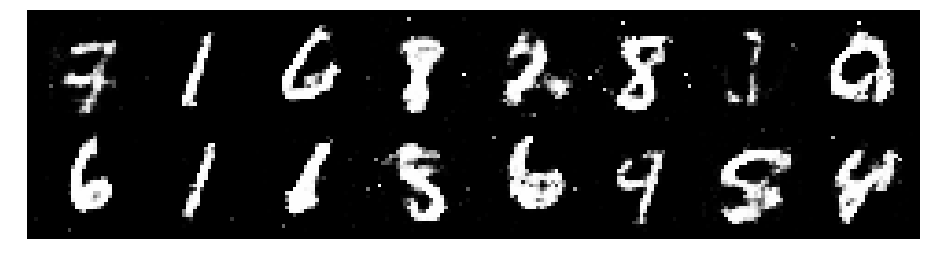

Epoch: [49/200], Batch Num: [100/938]
Discriminator Loss: 1.188805103302002, Generator Loss: 0.9846483469009399
D(x): 0.5771, D(G(z)): 0.4279


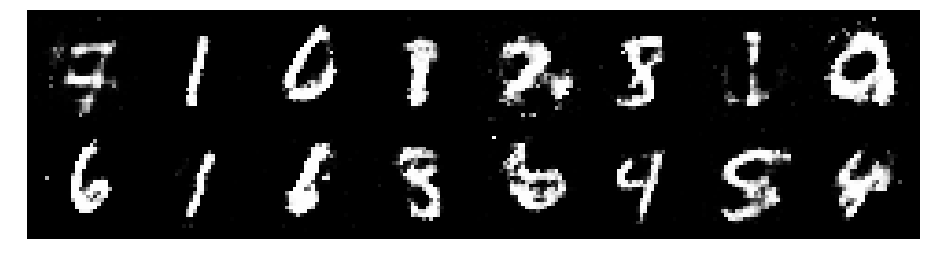

Epoch: [49/200], Batch Num: [200/938]
Discriminator Loss: 1.1814062595367432, Generator Loss: 0.9367053508758545
D(x): 0.6186, D(G(z)): 0.4428


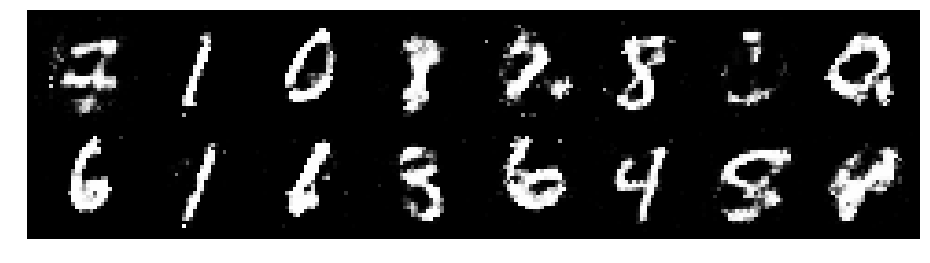

Epoch: [49/200], Batch Num: [300/938]
Discriminator Loss: 1.1084305047988892, Generator Loss: 1.0513206720352173
D(x): 0.5920, D(G(z)): 0.3830


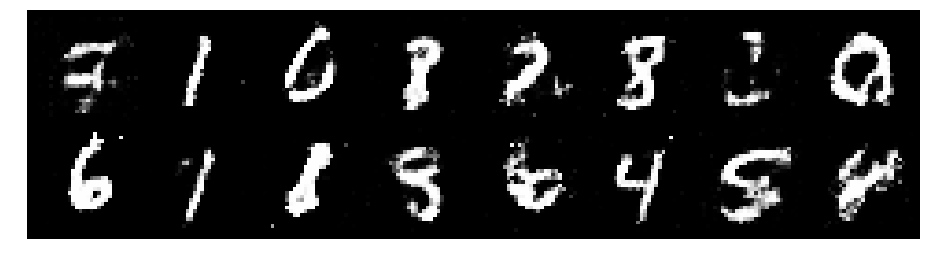

Epoch: [49/200], Batch Num: [400/938]
Discriminator Loss: 1.2905880212783813, Generator Loss: 1.0357329845428467
D(x): 0.5610, D(G(z)): 0.4494


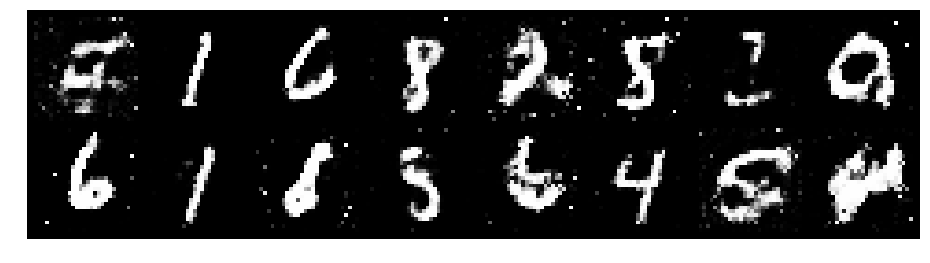

Epoch: [49/200], Batch Num: [500/938]
Discriminator Loss: 1.2729804515838623, Generator Loss: 0.9890995025634766
D(x): 0.5391, D(G(z)): 0.4332


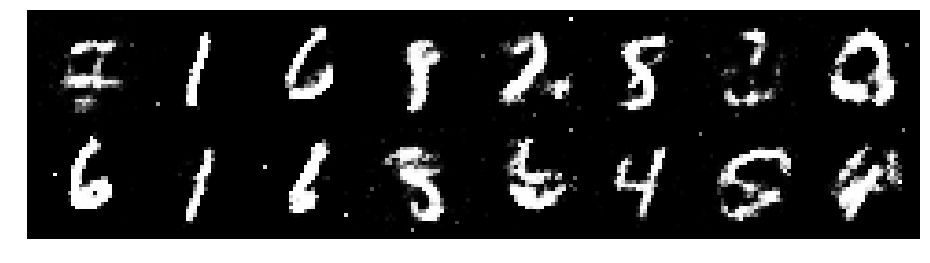

Epoch: [49/200], Batch Num: [600/938]
Discriminator Loss: 1.2802460193634033, Generator Loss: 0.8357135057449341
D(x): 0.5619, D(G(z)): 0.4488


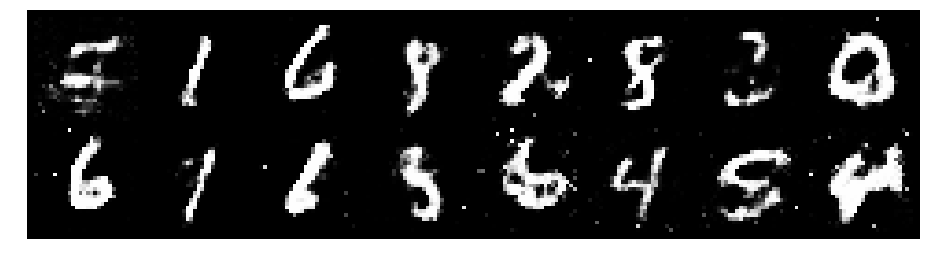

Epoch: [49/200], Batch Num: [700/938]
Discriminator Loss: 1.3456448316574097, Generator Loss: 0.8507232069969177
D(x): 0.5440, D(G(z)): 0.4641


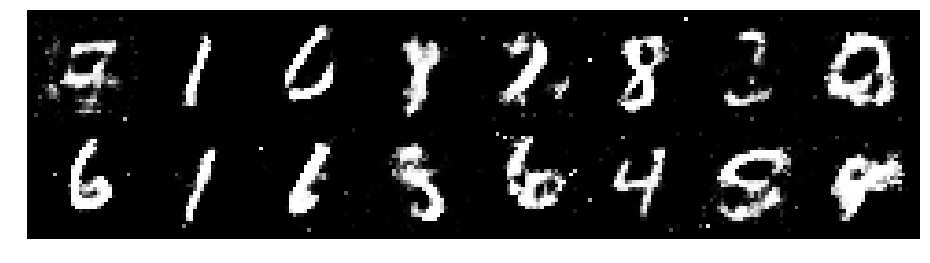

Epoch: [49/200], Batch Num: [800/938]
Discriminator Loss: 1.222721815109253, Generator Loss: 0.830339252948761
D(x): 0.5819, D(G(z)): 0.4299


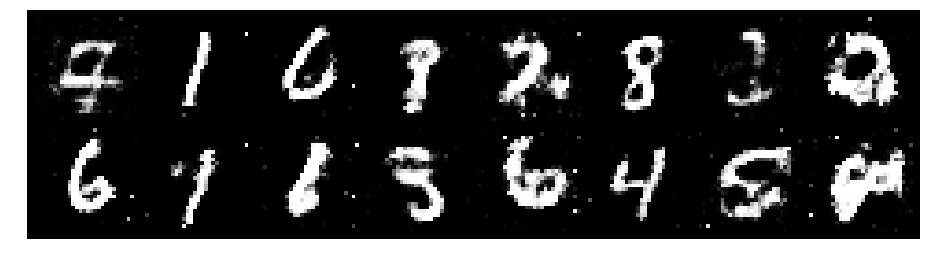

Epoch: [49/200], Batch Num: [900/938]
Discriminator Loss: 1.370903730392456, Generator Loss: 0.9478291869163513
D(x): 0.5064, D(G(z)): 0.4240


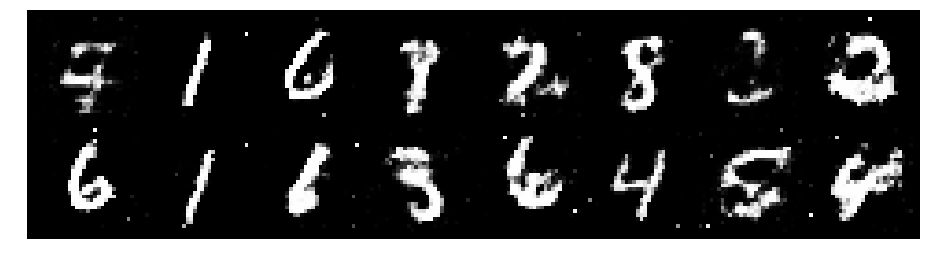

Epoch: [50/200], Batch Num: [0/938]
Discriminator Loss: 1.3498082160949707, Generator Loss: 0.9268698692321777
D(x): 0.5472, D(G(z)): 0.4734


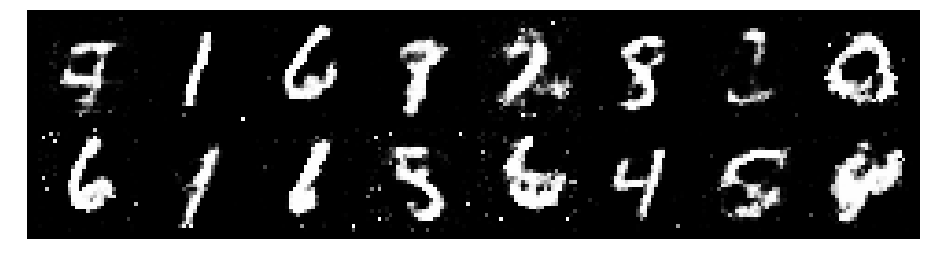

Epoch: [50/200], Batch Num: [100/938]
Discriminator Loss: 1.3125543594360352, Generator Loss: 1.0542795658111572
D(x): 0.5182, D(G(z)): 0.4166


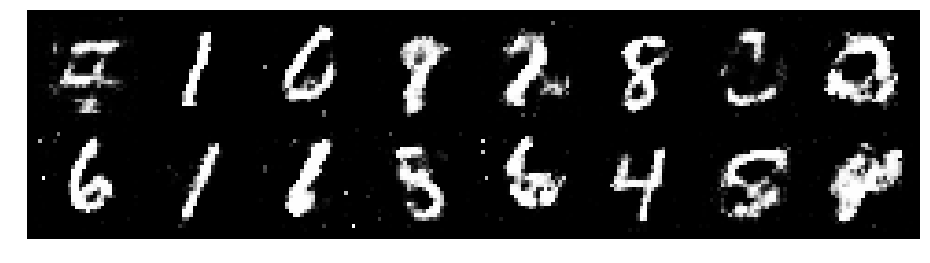

Epoch: [50/200], Batch Num: [200/938]
Discriminator Loss: 1.3243427276611328, Generator Loss: 0.8105150461196899
D(x): 0.5689, D(G(z)): 0.4880


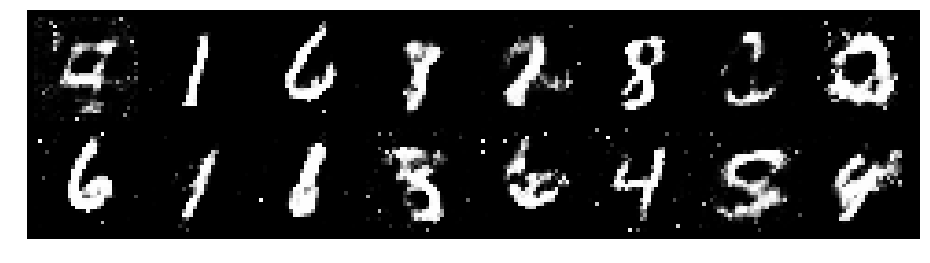

Epoch: [50/200], Batch Num: [300/938]
Discriminator Loss: 1.3795812129974365, Generator Loss: 0.8986075520515442
D(x): 0.5090, D(G(z)): 0.4240


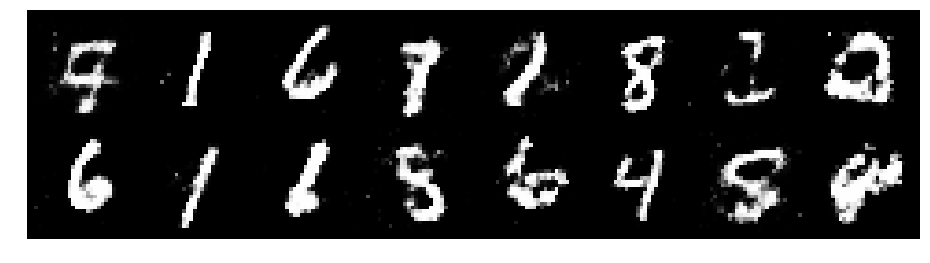

Epoch: [50/200], Batch Num: [400/938]
Discriminator Loss: 1.169554591178894, Generator Loss: 1.0789393186569214
D(x): 0.5921, D(G(z)): 0.4144


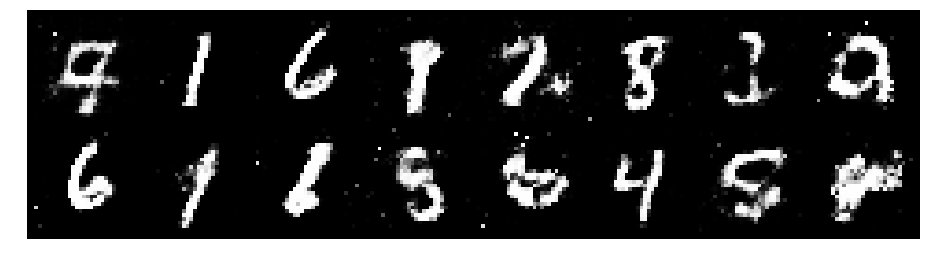

Epoch: [50/200], Batch Num: [500/938]
Discriminator Loss: 1.1356689929962158, Generator Loss: 1.0721173286437988
D(x): 0.5820, D(G(z)): 0.3938


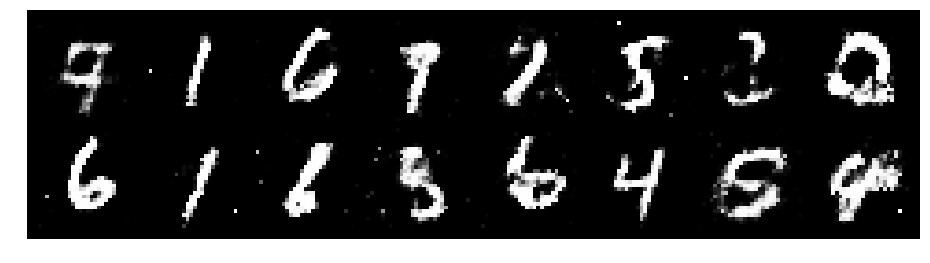

Epoch: [50/200], Batch Num: [600/938]
Discriminator Loss: 1.1124073266983032, Generator Loss: 1.0230448246002197
D(x): 0.6156, D(G(z)): 0.4145


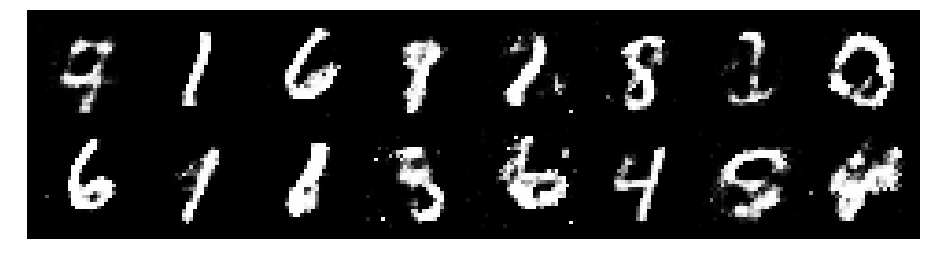

Epoch: [50/200], Batch Num: [700/938]
Discriminator Loss: 1.2612717151641846, Generator Loss: 0.9369874000549316
D(x): 0.5314, D(G(z)): 0.4023


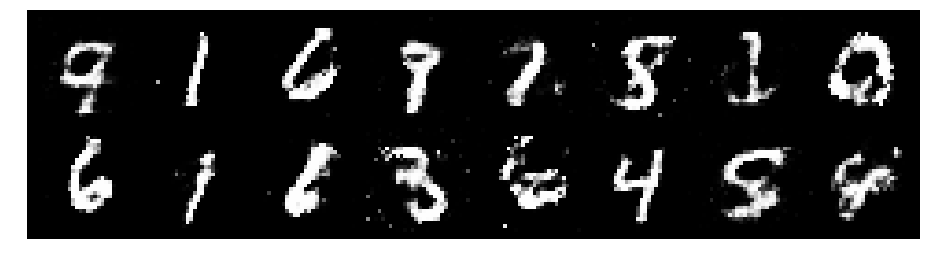

Epoch: [50/200], Batch Num: [800/938]
Discriminator Loss: 1.2106379270553589, Generator Loss: 0.9387778639793396
D(x): 0.5687, D(G(z)): 0.4002


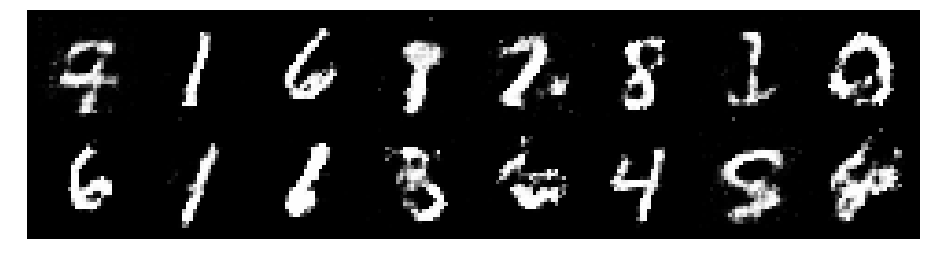

Epoch: [50/200], Batch Num: [900/938]
Discriminator Loss: 1.3066492080688477, Generator Loss: 0.9390180110931396
D(x): 0.5956, D(G(z)): 0.4819


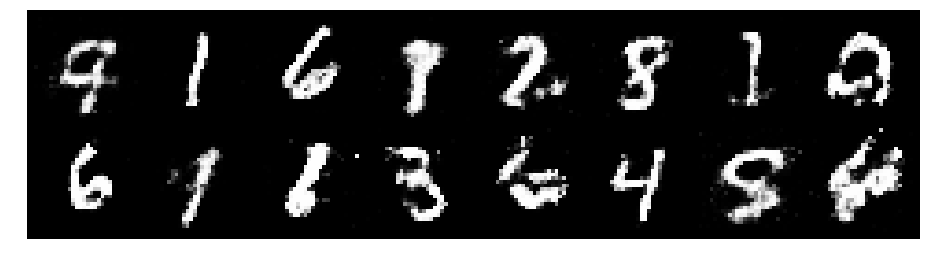

Epoch: [51/200], Batch Num: [0/938]
Discriminator Loss: 1.2716037034988403, Generator Loss: 0.7691202759742737
D(x): 0.5960, D(G(z)): 0.4787


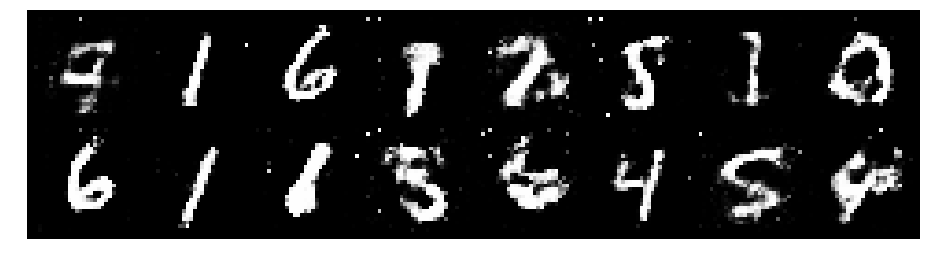

Epoch: [51/200], Batch Num: [100/938]
Discriminator Loss: 1.1949498653411865, Generator Loss: 1.0857009887695312
D(x): 0.6081, D(G(z)): 0.4280


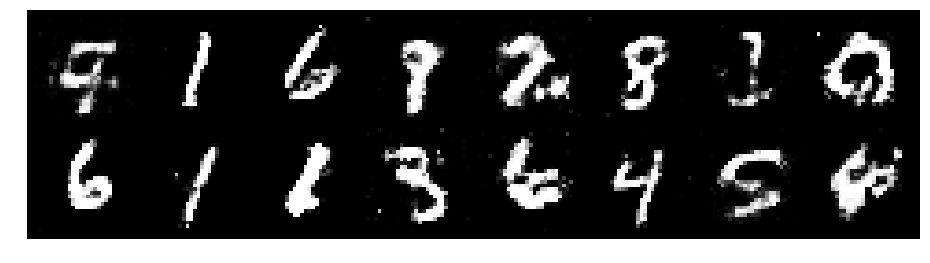

Epoch: [51/200], Batch Num: [200/938]
Discriminator Loss: 1.3827205896377563, Generator Loss: 1.047478199005127
D(x): 0.5321, D(G(z)): 0.4404


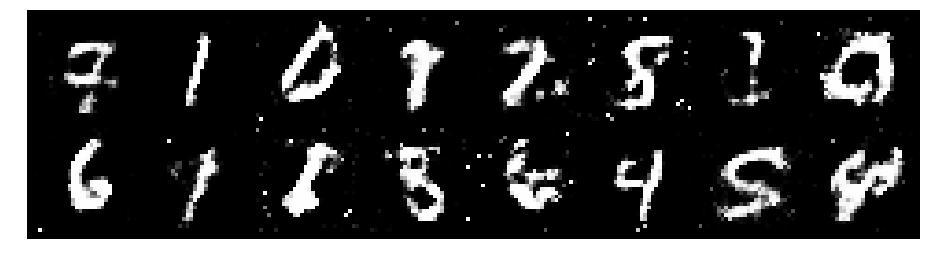

Epoch: [51/200], Batch Num: [300/938]
Discriminator Loss: 1.2708353996276855, Generator Loss: 0.8987727761268616
D(x): 0.5582, D(G(z)): 0.4318


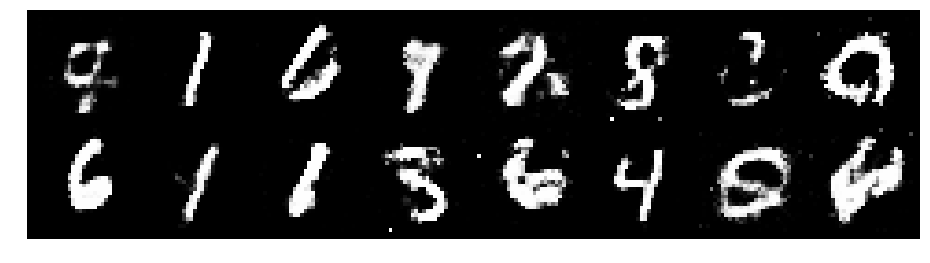

Epoch: [51/200], Batch Num: [400/938]
Discriminator Loss: 1.2446446418762207, Generator Loss: 0.9427288770675659
D(x): 0.5802, D(G(z)): 0.4447


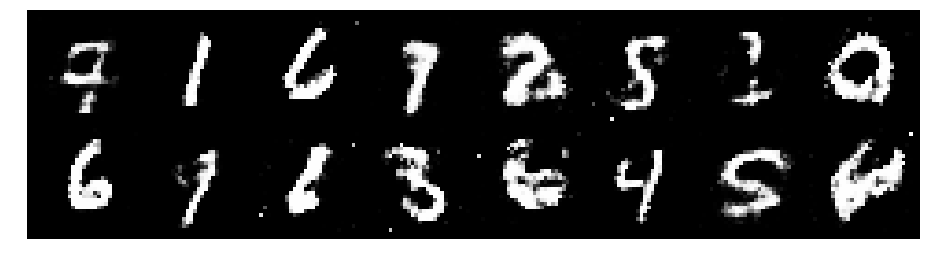

Epoch: [51/200], Batch Num: [500/938]
Discriminator Loss: 1.2700438499450684, Generator Loss: 0.8657917976379395
D(x): 0.5282, D(G(z)): 0.4200


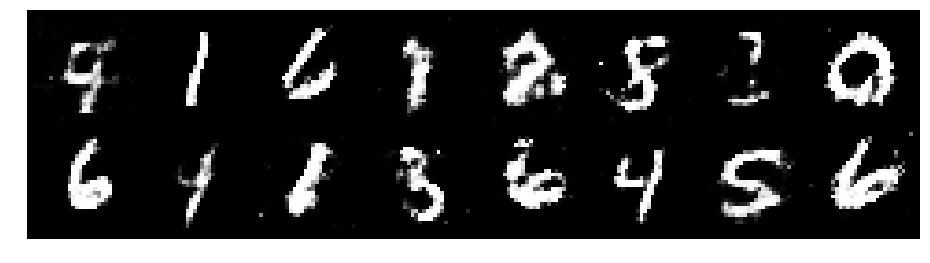

Epoch: [51/200], Batch Num: [600/938]
Discriminator Loss: 1.3335694074630737, Generator Loss: 0.7438860535621643
D(x): 0.6097, D(G(z)): 0.5203


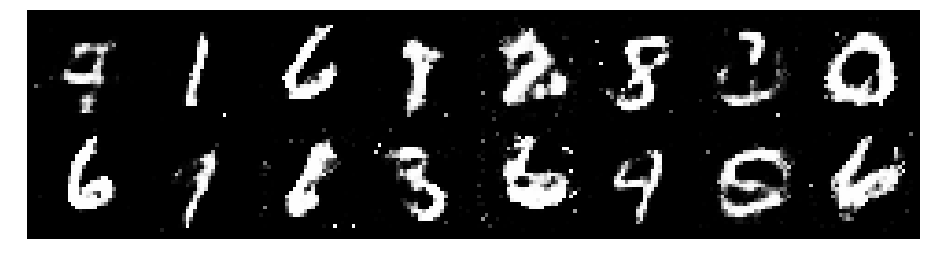

Epoch: [51/200], Batch Num: [700/938]
Discriminator Loss: 1.3221471309661865, Generator Loss: 0.9274625182151794
D(x): 0.4981, D(G(z)): 0.3898


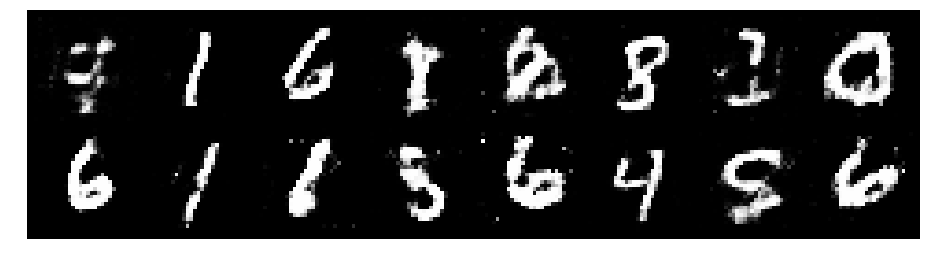

Epoch: [51/200], Batch Num: [800/938]
Discriminator Loss: 1.1033849716186523, Generator Loss: 1.129340410232544
D(x): 0.5812, D(G(z)): 0.3634


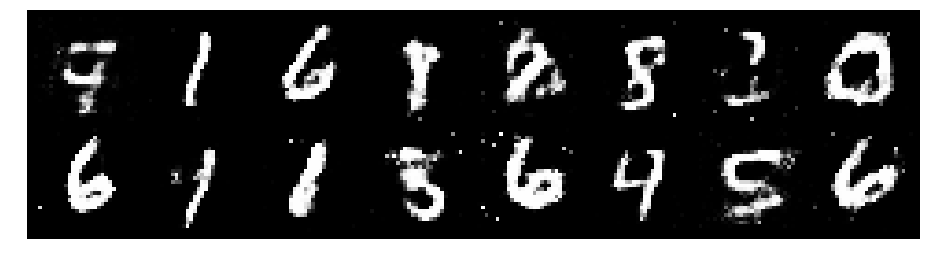

Epoch: [51/200], Batch Num: [900/938]
Discriminator Loss: 1.237353801727295, Generator Loss: 0.971308708190918
D(x): 0.5590, D(G(z)): 0.4271


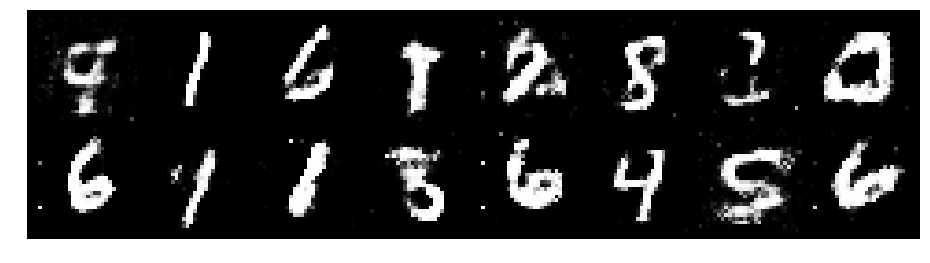

Epoch: [52/200], Batch Num: [0/938]
Discriminator Loss: 1.3633383512496948, Generator Loss: 0.8794107437133789
D(x): 0.5206, D(G(z)): 0.4430


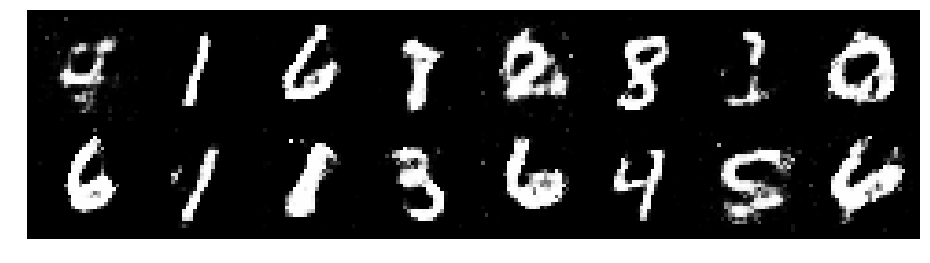

Epoch: [52/200], Batch Num: [100/938]
Discriminator Loss: 1.3216443061828613, Generator Loss: 0.8908202052116394
D(x): 0.5969, D(G(z)): 0.4804


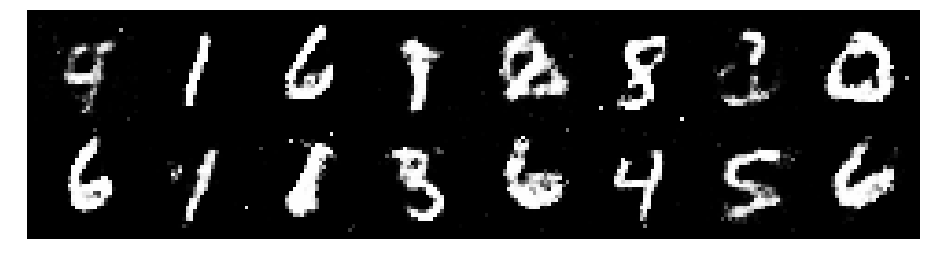

Epoch: [52/200], Batch Num: [200/938]
Discriminator Loss: 1.2575011253356934, Generator Loss: 0.9525677561759949
D(x): 0.5868, D(G(z)): 0.4336


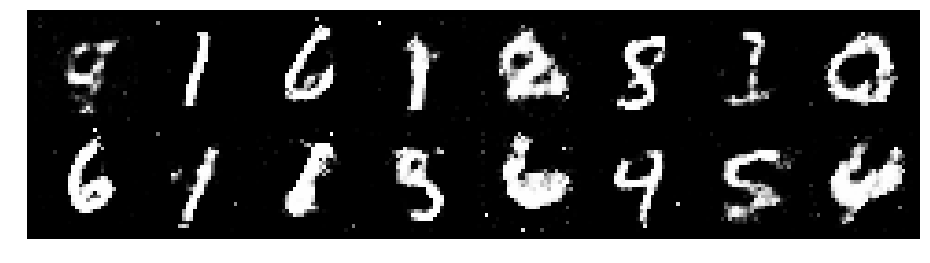

Epoch: [52/200], Batch Num: [300/938]
Discriminator Loss: 1.2607131004333496, Generator Loss: 1.0011765956878662
D(x): 0.5664, D(G(z)): 0.4029


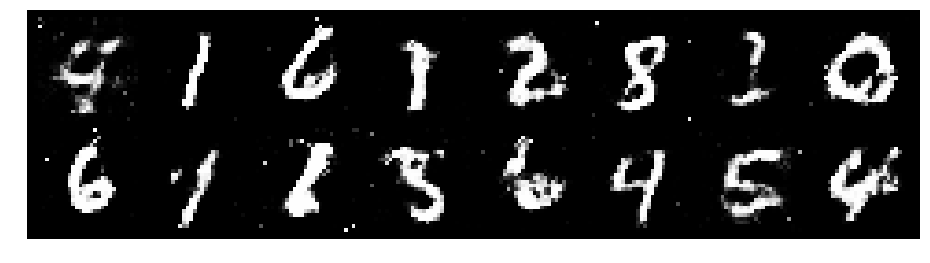

Epoch: [52/200], Batch Num: [400/938]
Discriminator Loss: 1.2183353900909424, Generator Loss: 1.026810646057129
D(x): 0.5812, D(G(z)): 0.4397


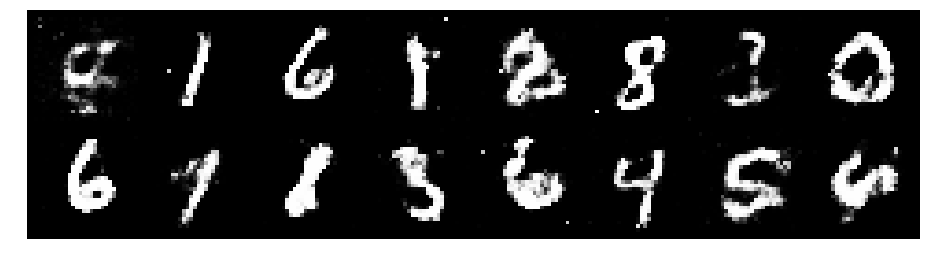

Epoch: [52/200], Batch Num: [500/938]
Discriminator Loss: 1.3715276718139648, Generator Loss: 0.8563132286071777
D(x): 0.5402, D(G(z)): 0.4930


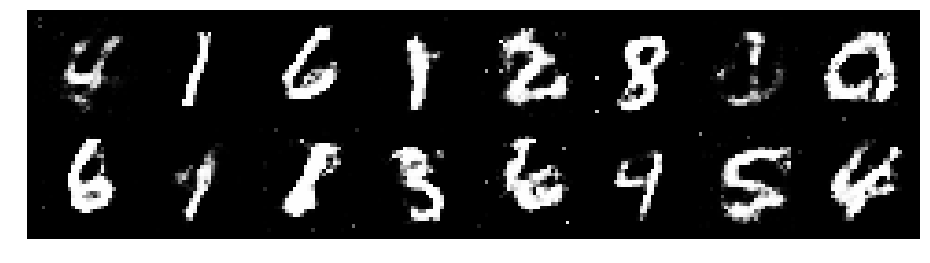

Epoch: [52/200], Batch Num: [600/938]
Discriminator Loss: 1.237767219543457, Generator Loss: 1.0026694536209106
D(x): 0.5458, D(G(z)): 0.4171


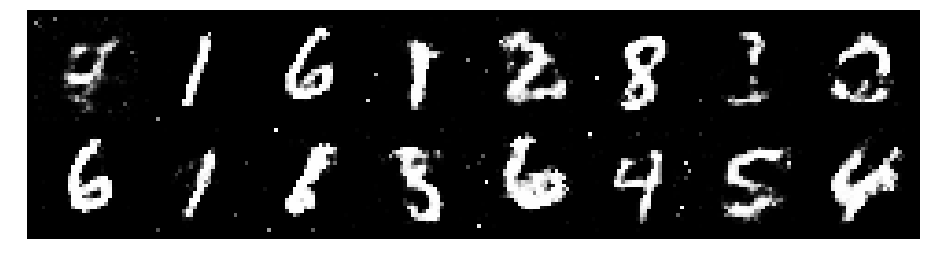

Epoch: [52/200], Batch Num: [700/938]
Discriminator Loss: 1.2142279148101807, Generator Loss: 0.9605808258056641
D(x): 0.5613, D(G(z)): 0.4151


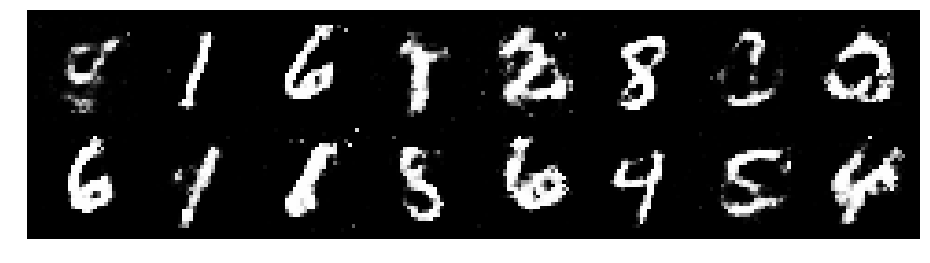

Epoch: [52/200], Batch Num: [800/938]
Discriminator Loss: 1.3213704824447632, Generator Loss: 0.9359894394874573
D(x): 0.5218, D(G(z)): 0.4077


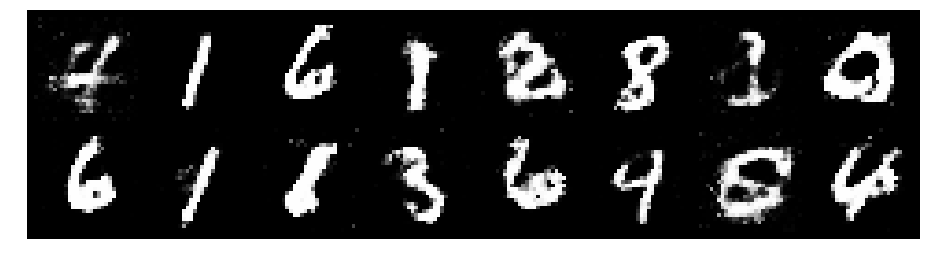

Epoch: [52/200], Batch Num: [900/938]
Discriminator Loss: 1.2224698066711426, Generator Loss: 0.9743531942367554
D(x): 0.5746, D(G(z)): 0.4399


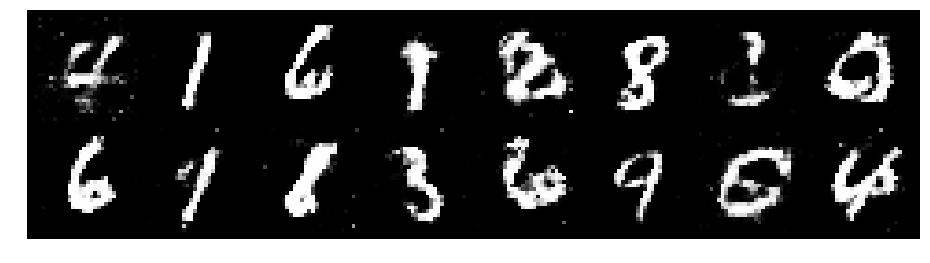

Epoch: [53/200], Batch Num: [0/938]
Discriminator Loss: 1.1993465423583984, Generator Loss: 0.9355409145355225
D(x): 0.5796, D(G(z)): 0.4181


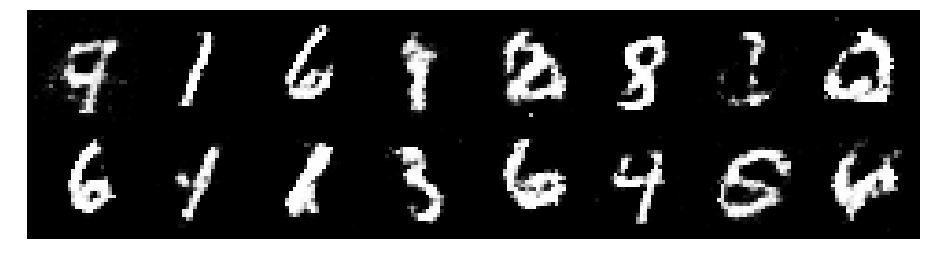

Epoch: [53/200], Batch Num: [100/938]
Discriminator Loss: 0.9930033683776855, Generator Loss: 0.9843376278877258
D(x): 0.6500, D(G(z)): 0.3809


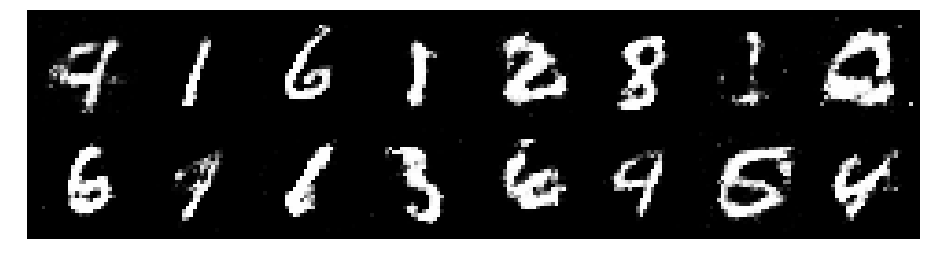

Epoch: [53/200], Batch Num: [200/938]
Discriminator Loss: 1.1558990478515625, Generator Loss: 1.0031764507293701
D(x): 0.6110, D(G(z)): 0.4316


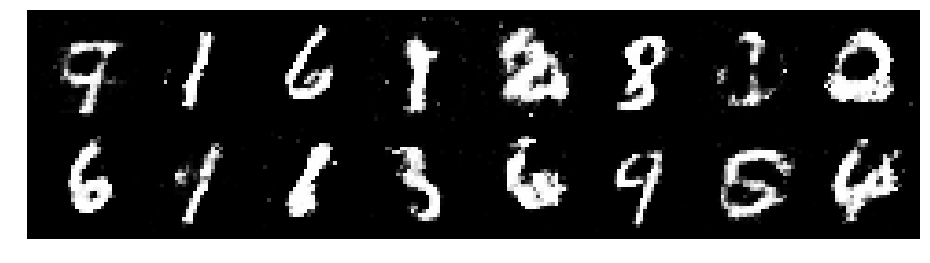

Epoch: [53/200], Batch Num: [300/938]
Discriminator Loss: 1.212967872619629, Generator Loss: 1.0929697751998901
D(x): 0.5580, D(G(z)): 0.4155


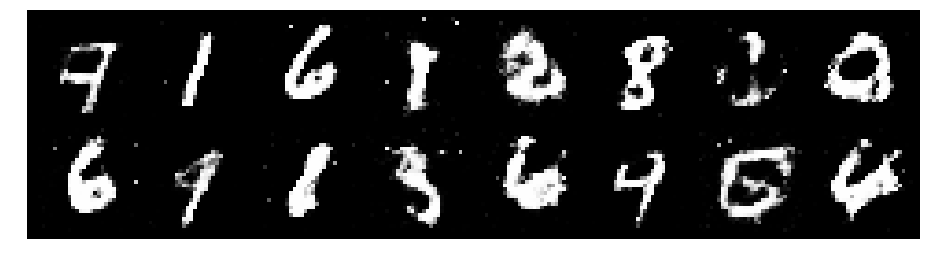

Epoch: [53/200], Batch Num: [400/938]
Discriminator Loss: 1.3636553287506104, Generator Loss: 0.8867443799972534
D(x): 0.6015, D(G(z)): 0.4962


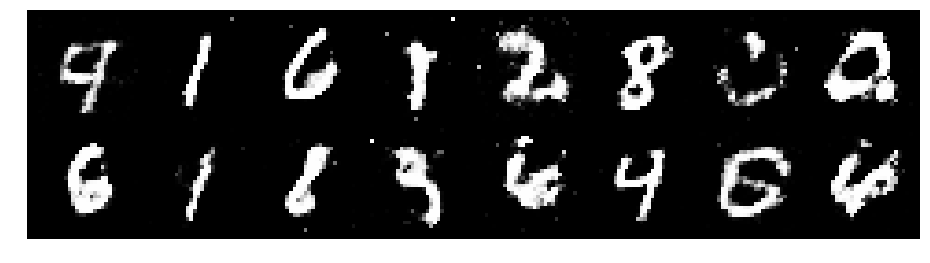

Epoch: [53/200], Batch Num: [500/938]
Discriminator Loss: 1.1763191223144531, Generator Loss: 0.8860481977462769
D(x): 0.6093, D(G(z)): 0.4369


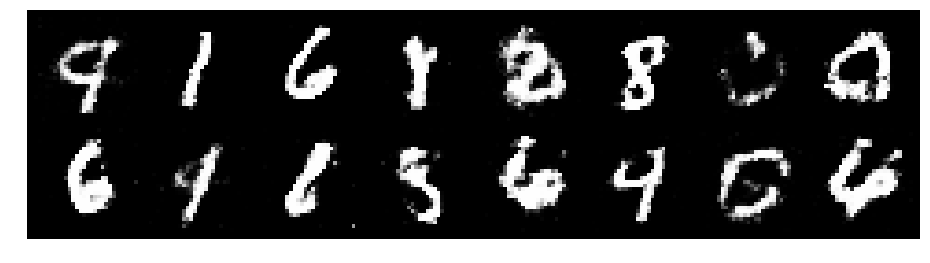

Epoch: [53/200], Batch Num: [600/938]
Discriminator Loss: 1.10845148563385, Generator Loss: 0.8911038637161255
D(x): 0.6275, D(G(z)): 0.4177


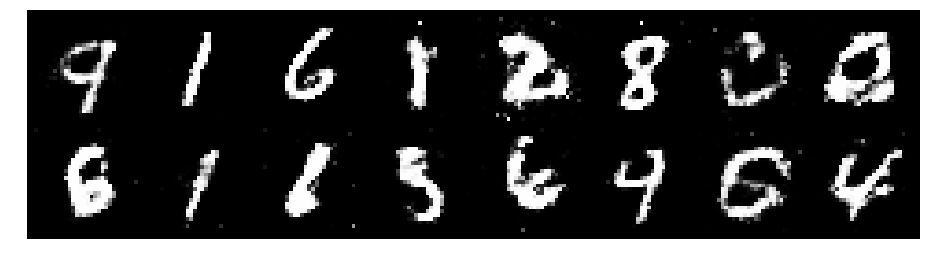

Epoch: [53/200], Batch Num: [700/938]
Discriminator Loss: 1.2350878715515137, Generator Loss: 0.9983344078063965
D(x): 0.5510, D(G(z)): 0.4012


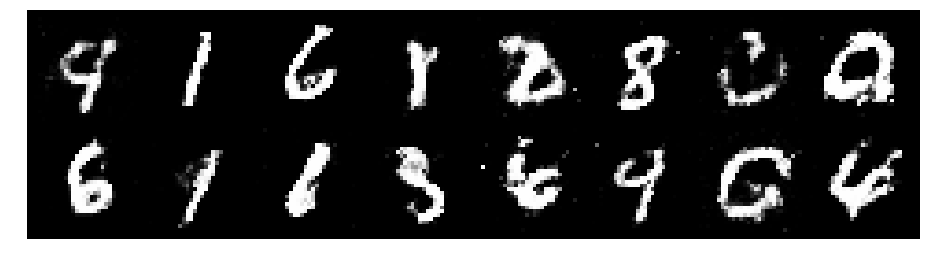

Epoch: [53/200], Batch Num: [800/938]
Discriminator Loss: 1.107998251914978, Generator Loss: 0.9838919043540955
D(x): 0.6024, D(G(z)): 0.4052


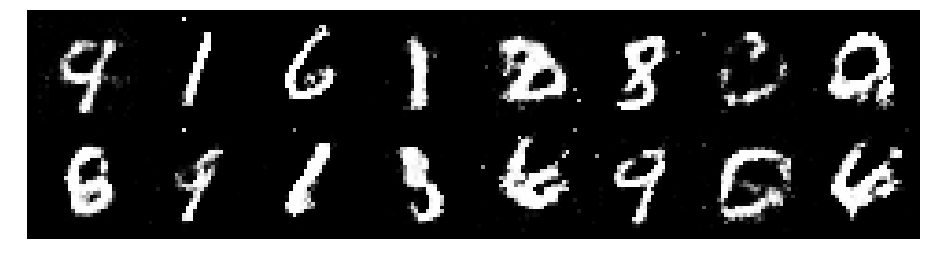

Epoch: [53/200], Batch Num: [900/938]
Discriminator Loss: 1.1438164710998535, Generator Loss: 0.958756148815155
D(x): 0.5642, D(G(z)): 0.3714


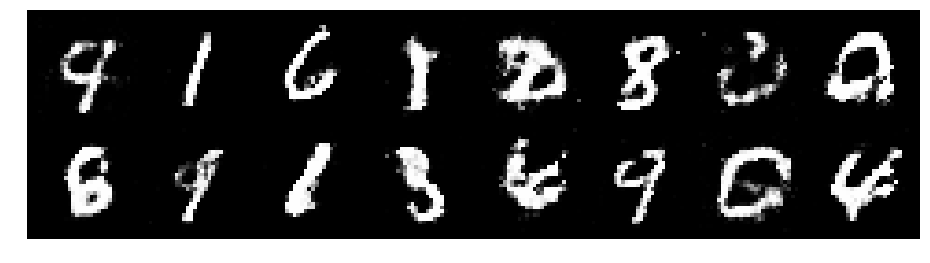

Epoch: [54/200], Batch Num: [0/938]
Discriminator Loss: 1.1793460845947266, Generator Loss: 1.0308449268341064
D(x): 0.5923, D(G(z)): 0.4267


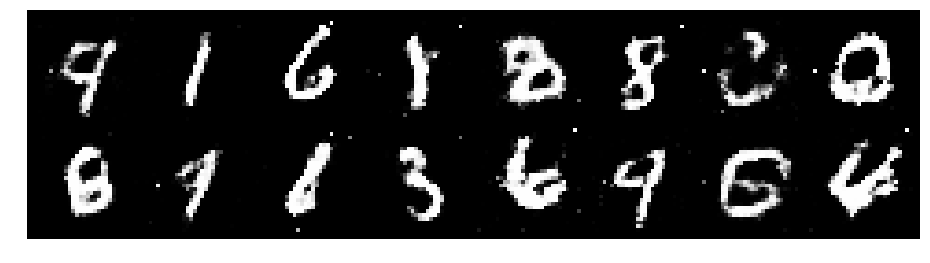

Epoch: [54/200], Batch Num: [100/938]
Discriminator Loss: 1.2118360996246338, Generator Loss: 1.015889286994934
D(x): 0.5757, D(G(z)): 0.4236


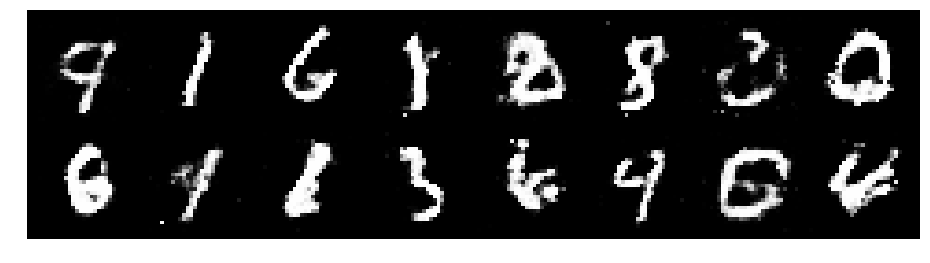

Epoch: [54/200], Batch Num: [200/938]
Discriminator Loss: 1.11561119556427, Generator Loss: 0.8827371597290039
D(x): 0.5729, D(G(z)): 0.3805


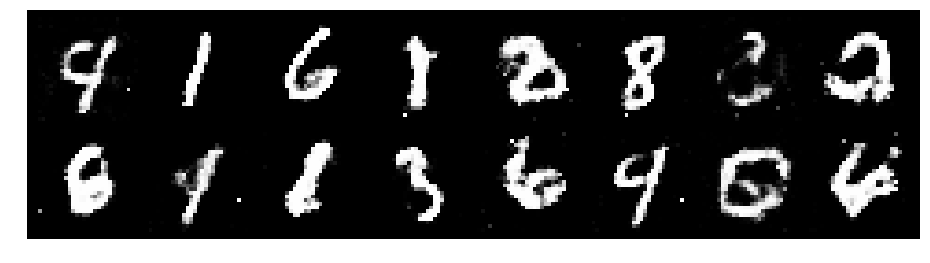

Epoch: [54/200], Batch Num: [300/938]
Discriminator Loss: 1.286792278289795, Generator Loss: 1.0111496448516846
D(x): 0.5439, D(G(z)): 0.4377


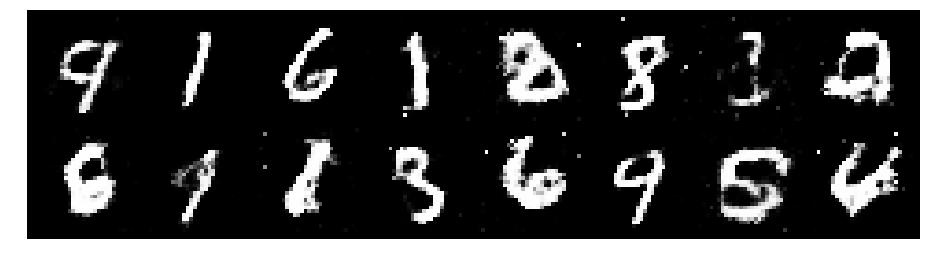

Epoch: [54/200], Batch Num: [400/938]
Discriminator Loss: 1.250510573387146, Generator Loss: 0.9765468835830688
D(x): 0.5692, D(G(z)): 0.4448


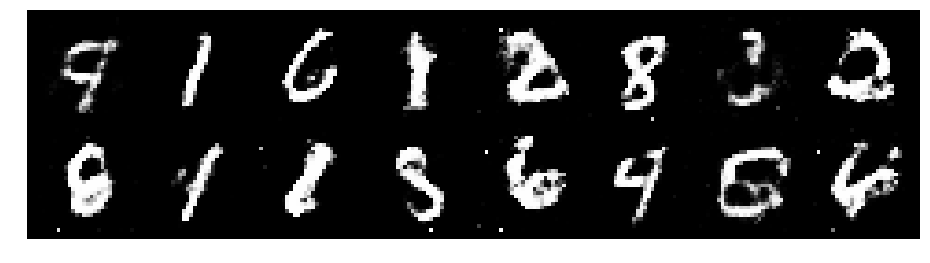

Epoch: [54/200], Batch Num: [500/938]
Discriminator Loss: 1.3846434354782104, Generator Loss: 1.0372474193572998
D(x): 0.4699, D(G(z)): 0.4166


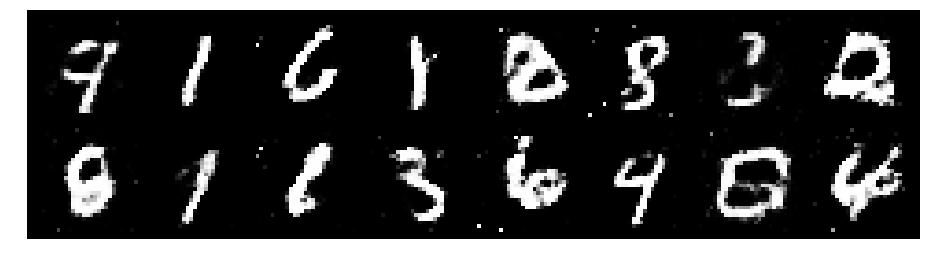

Epoch: [54/200], Batch Num: [600/938]
Discriminator Loss: 1.1625009775161743, Generator Loss: 0.8302831649780273
D(x): 0.5701, D(G(z)): 0.4098


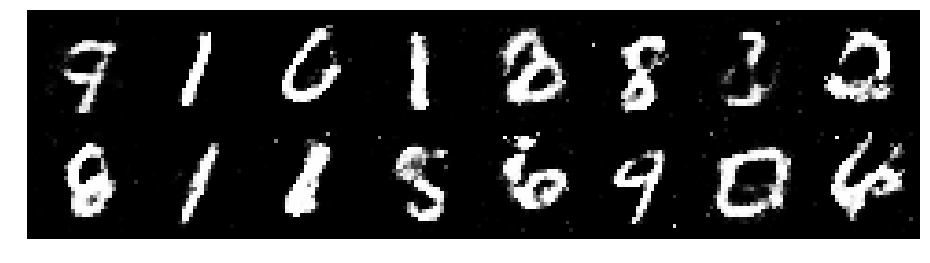

Epoch: [54/200], Batch Num: [700/938]
Discriminator Loss: 1.2737324237823486, Generator Loss: 0.7628512382507324
D(x): 0.6023, D(G(z)): 0.4830


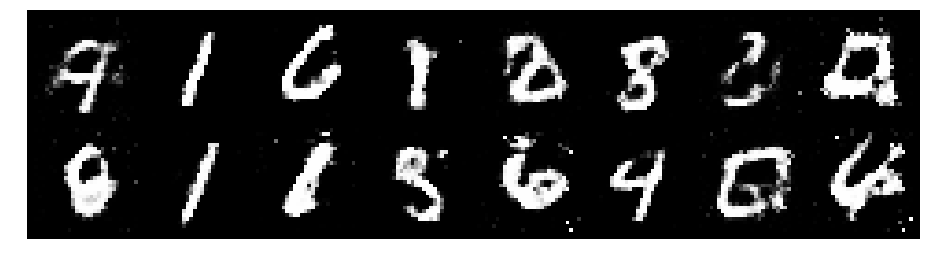

Epoch: [54/200], Batch Num: [800/938]
Discriminator Loss: 1.2983454465866089, Generator Loss: 0.8669544458389282
D(x): 0.5440, D(G(z)): 0.4209


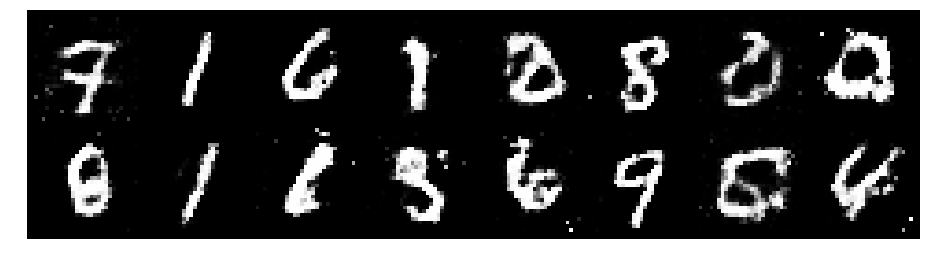

Epoch: [54/200], Batch Num: [900/938]
Discriminator Loss: 1.375075101852417, Generator Loss: 0.8930063247680664
D(x): 0.5803, D(G(z)): 0.5237


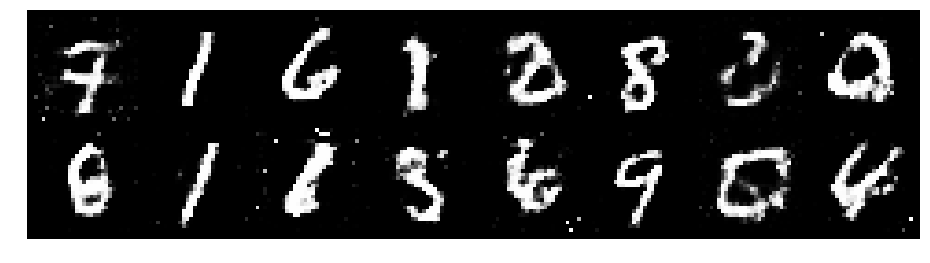

Epoch: [55/200], Batch Num: [0/938]
Discriminator Loss: 1.1891045570373535, Generator Loss: 0.9962728023529053
D(x): 0.5853, D(G(z)): 0.4158


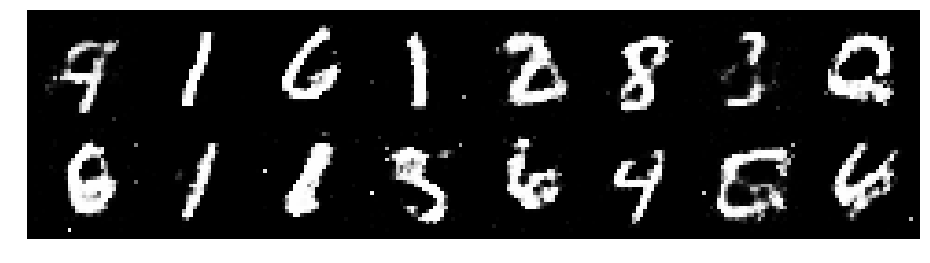

Epoch: [55/200], Batch Num: [100/938]
Discriminator Loss: 1.1391208171844482, Generator Loss: 1.034614086151123
D(x): 0.5760, D(G(z)): 0.3937


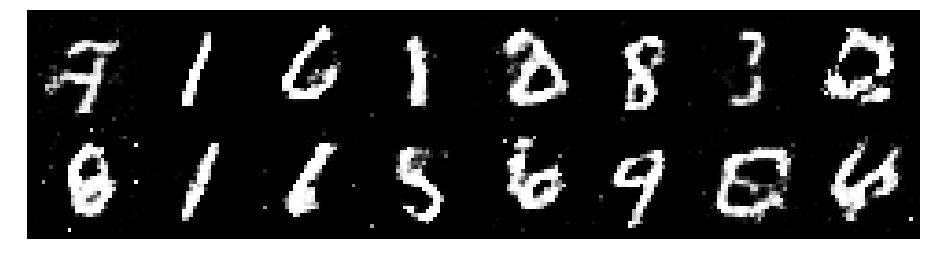

Epoch: [55/200], Batch Num: [200/938]
Discriminator Loss: 1.1835589408874512, Generator Loss: 1.115453839302063
D(x): 0.5733, D(G(z)): 0.3942


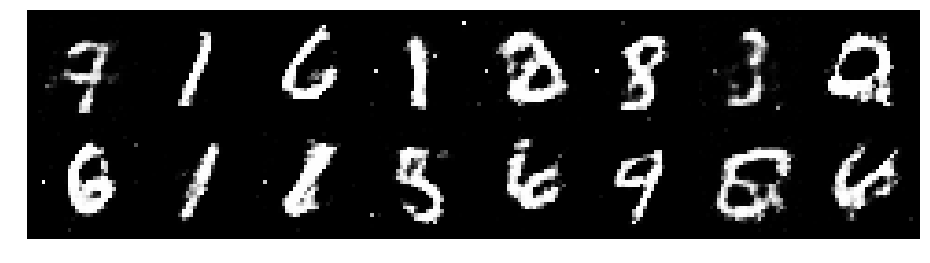

Epoch: [55/200], Batch Num: [300/938]
Discriminator Loss: 1.1573967933654785, Generator Loss: 1.173832654953003
D(x): 0.5773, D(G(z)): 0.3844


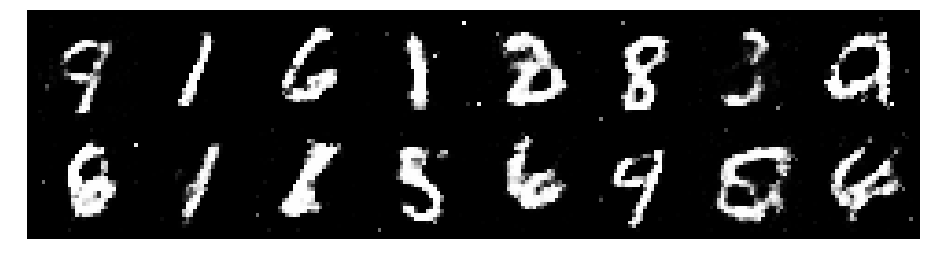

Epoch: [55/200], Batch Num: [400/938]
Discriminator Loss: 1.3010094165802002, Generator Loss: 0.8635300993919373
D(x): 0.5357, D(G(z)): 0.4488


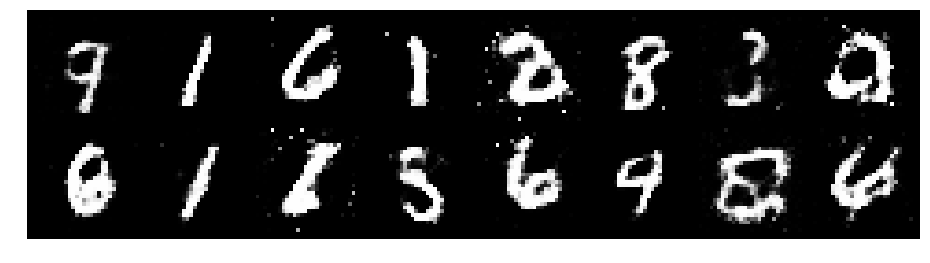

Epoch: [55/200], Batch Num: [500/938]
Discriminator Loss: 1.329481601715088, Generator Loss: 0.8073333501815796
D(x): 0.5415, D(G(z)): 0.4696


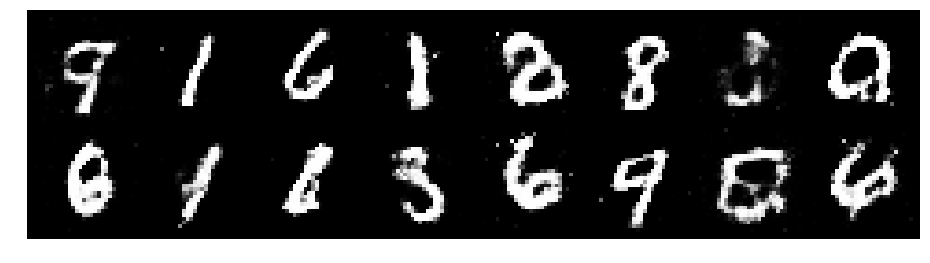

Epoch: [55/200], Batch Num: [600/938]
Discriminator Loss: 1.2607121467590332, Generator Loss: 0.8398645520210266
D(x): 0.5770, D(G(z)): 0.4401


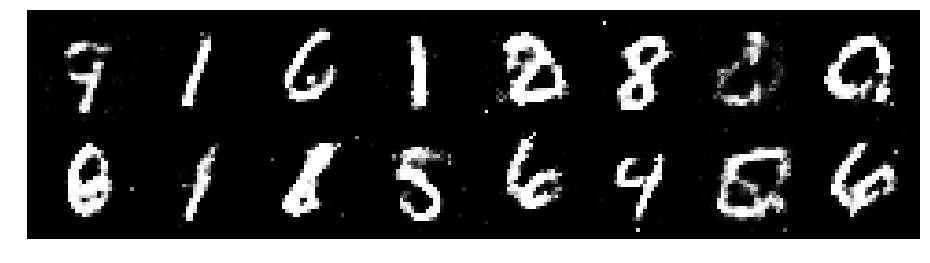

Epoch: [55/200], Batch Num: [700/938]
Discriminator Loss: 1.3173449039459229, Generator Loss: 1.1096584796905518
D(x): 0.5812, D(G(z)): 0.4829


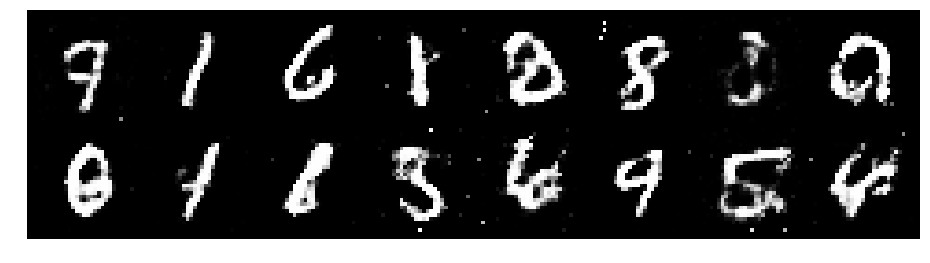

Epoch: [55/200], Batch Num: [800/938]
Discriminator Loss: 1.2187578678131104, Generator Loss: 0.8956795930862427
D(x): 0.5854, D(G(z)): 0.4392


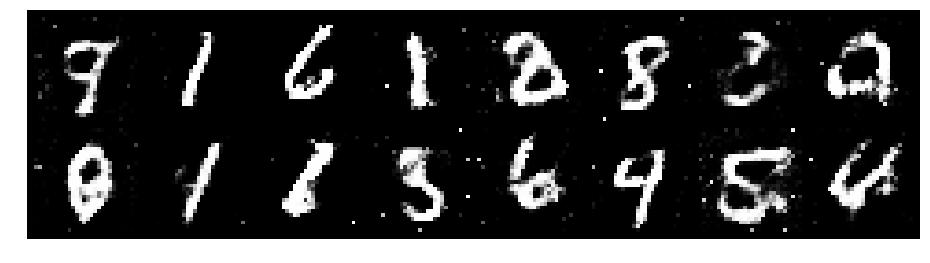

Epoch: [55/200], Batch Num: [900/938]
Discriminator Loss: 1.1285537481307983, Generator Loss: 0.9913231730461121
D(x): 0.5472, D(G(z)): 0.3566


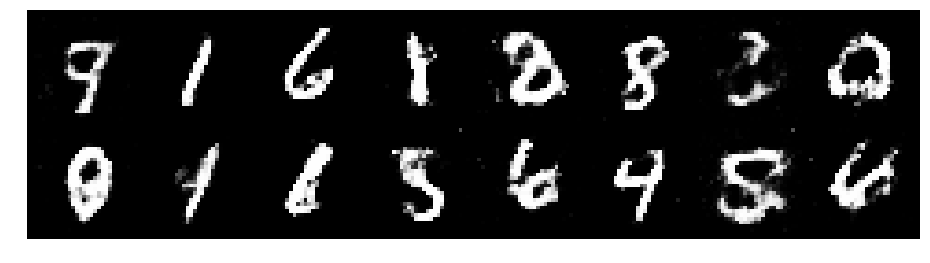

Epoch: [56/200], Batch Num: [0/938]
Discriminator Loss: 1.2292150259017944, Generator Loss: 0.7464693784713745
D(x): 0.6164, D(G(z)): 0.4885


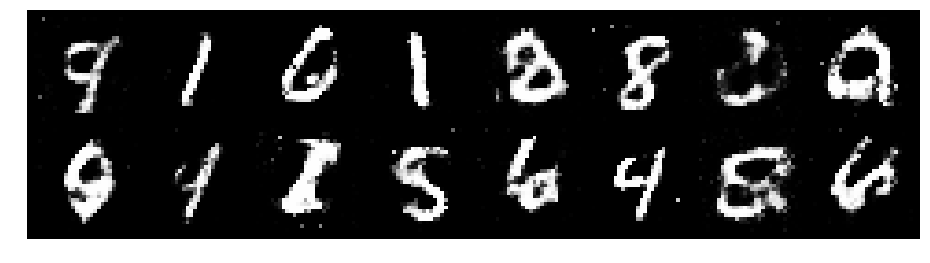

Epoch: [56/200], Batch Num: [100/938]
Discriminator Loss: 1.3117464780807495, Generator Loss: 1.0281869173049927
D(x): 0.5373, D(G(z)): 0.4071


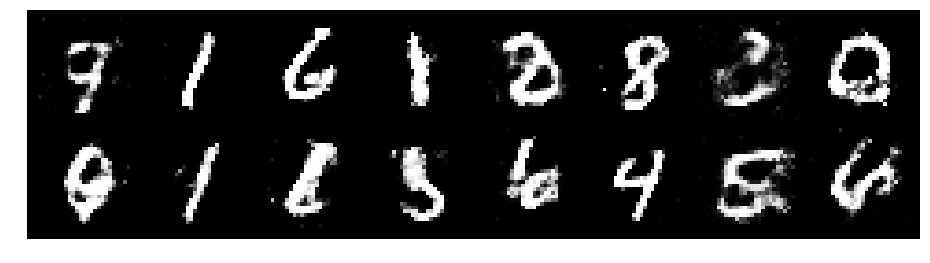

Epoch: [56/200], Batch Num: [200/938]
Discriminator Loss: 1.12459135055542, Generator Loss: 1.1514406204223633
D(x): 0.6521, D(G(z)): 0.4389


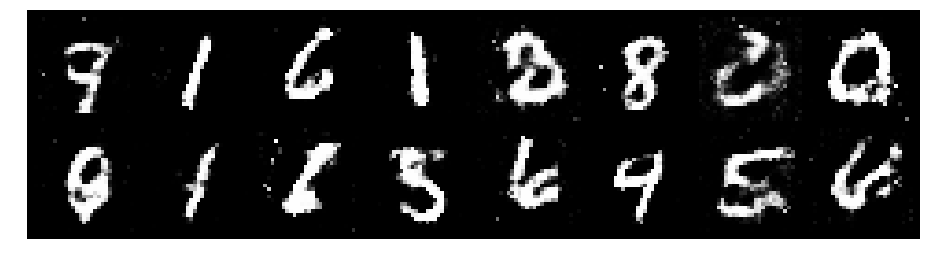

Epoch: [56/200], Batch Num: [300/938]
Discriminator Loss: 1.168148159980774, Generator Loss: 1.0323783159255981
D(x): 0.6090, D(G(z)): 0.4297


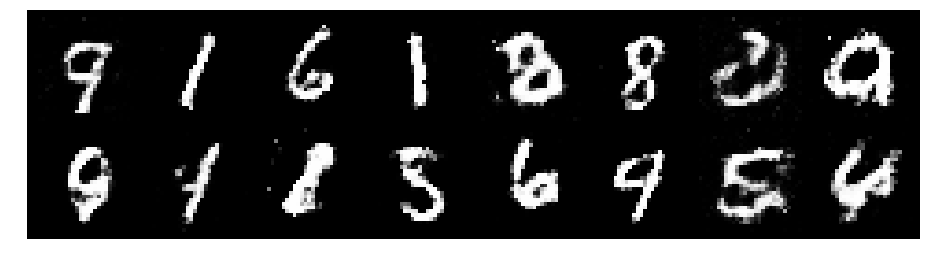

Epoch: [56/200], Batch Num: [400/938]
Discriminator Loss: 1.2376790046691895, Generator Loss: 0.8731540441513062
D(x): 0.5736, D(G(z)): 0.4556


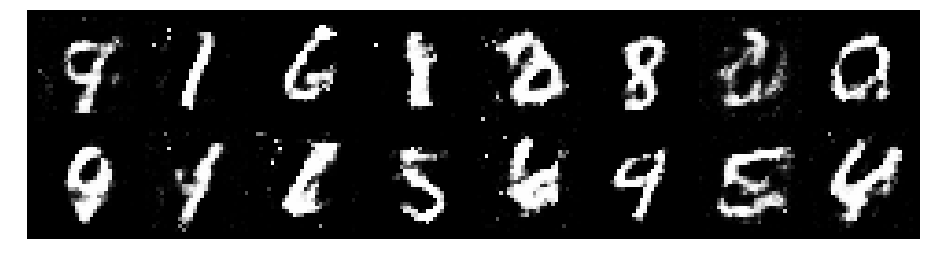

Epoch: [56/200], Batch Num: [500/938]
Discriminator Loss: 1.203362226486206, Generator Loss: 0.8475621938705444
D(x): 0.6147, D(G(z)): 0.4875


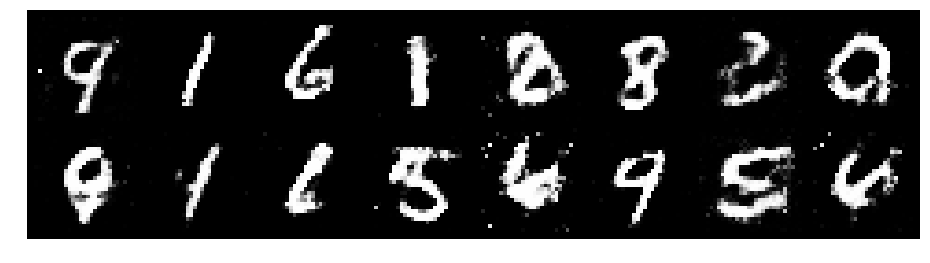

Epoch: [56/200], Batch Num: [600/938]
Discriminator Loss: 1.2113885879516602, Generator Loss: 0.9565364122390747
D(x): 0.6808, D(G(z)): 0.4881


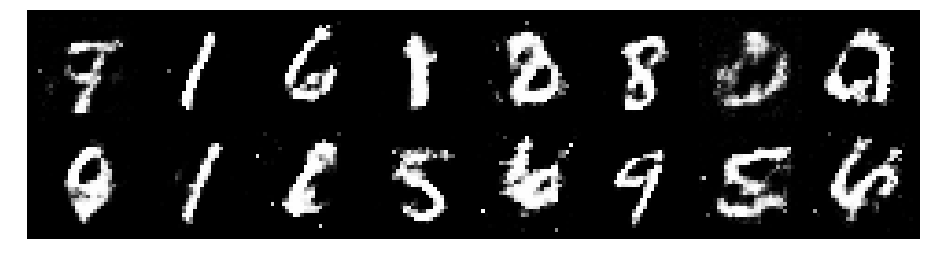

Epoch: [56/200], Batch Num: [700/938]
Discriminator Loss: 1.1011571884155273, Generator Loss: 0.9722071886062622
D(x): 0.6238, D(G(z)): 0.4305


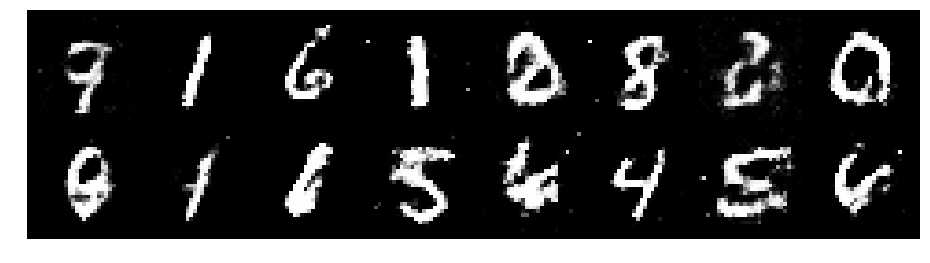

Epoch: [56/200], Batch Num: [800/938]
Discriminator Loss: 1.2131297588348389, Generator Loss: 0.841672956943512
D(x): 0.5687, D(G(z)): 0.4466


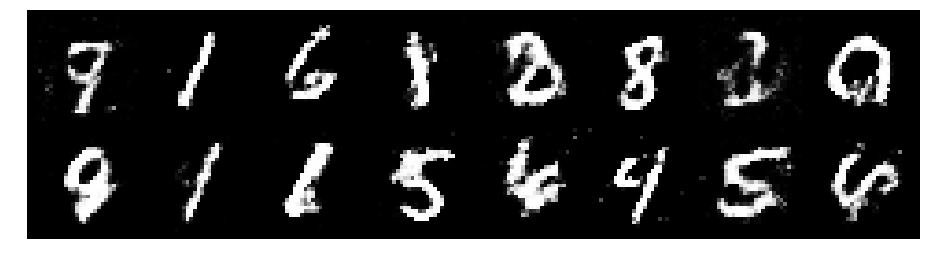

Epoch: [56/200], Batch Num: [900/938]
Discriminator Loss: 1.265446424484253, Generator Loss: 1.0345488786697388
D(x): 0.5434, D(G(z)): 0.4302


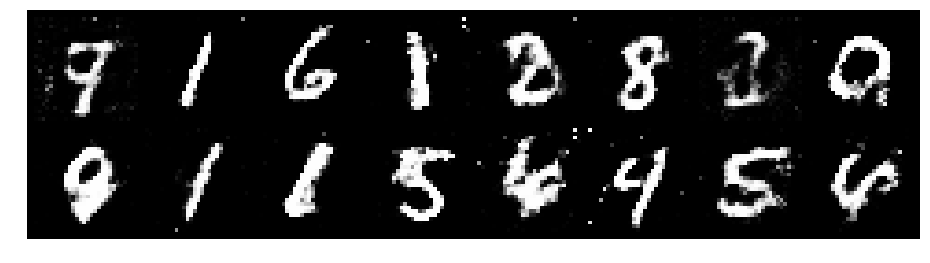

Epoch: [57/200], Batch Num: [0/938]
Discriminator Loss: 1.3202741146087646, Generator Loss: 0.874376654624939
D(x): 0.5340, D(G(z)): 0.4306


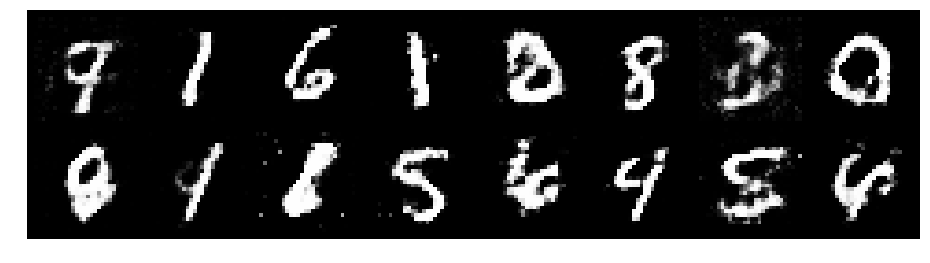

Epoch: [57/200], Batch Num: [100/938]
Discriminator Loss: 1.322648048400879, Generator Loss: 0.9483757615089417
D(x): 0.5472, D(G(z)): 0.4247


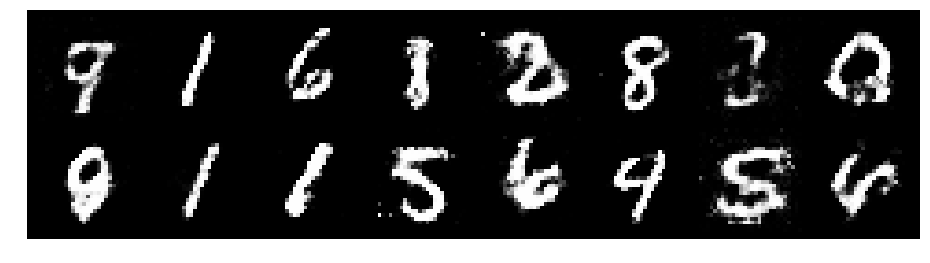

Epoch: [57/200], Batch Num: [200/938]
Discriminator Loss: 1.4008293151855469, Generator Loss: 0.8211255073547363
D(x): 0.5643, D(G(z)): 0.5063


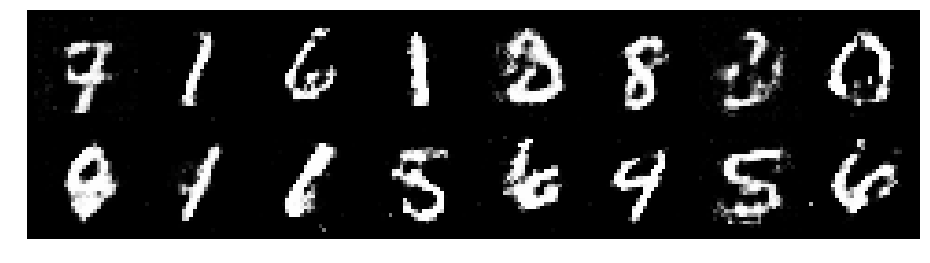

Epoch: [57/200], Batch Num: [300/938]
Discriminator Loss: 1.2436084747314453, Generator Loss: 1.00374174118042
D(x): 0.5507, D(G(z)): 0.4029


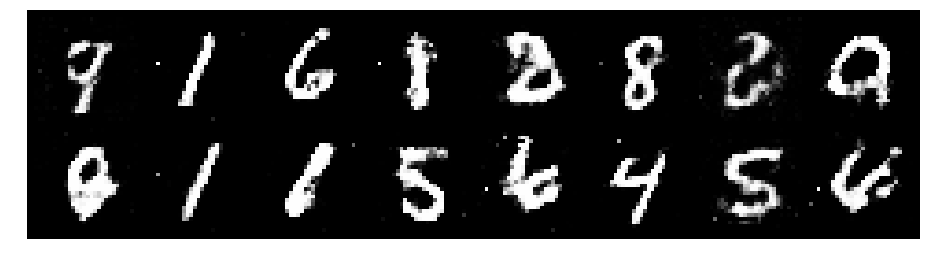

Epoch: [57/200], Batch Num: [400/938]
Discriminator Loss: 1.1435197591781616, Generator Loss: 1.0233315229415894
D(x): 0.6387, D(G(z)): 0.4283


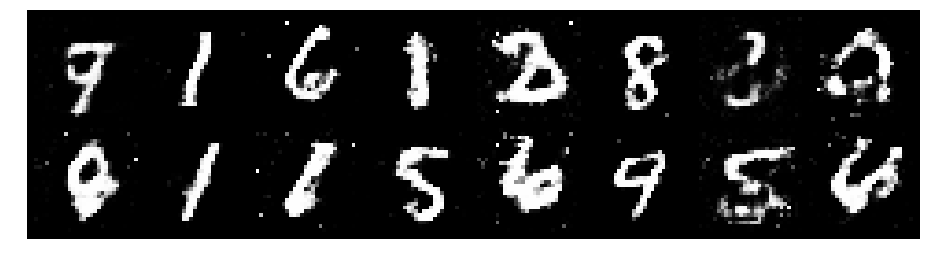

Epoch: [57/200], Batch Num: [500/938]
Discriminator Loss: 1.1922663450241089, Generator Loss: 0.9031761288642883
D(x): 0.5829, D(G(z)): 0.4257


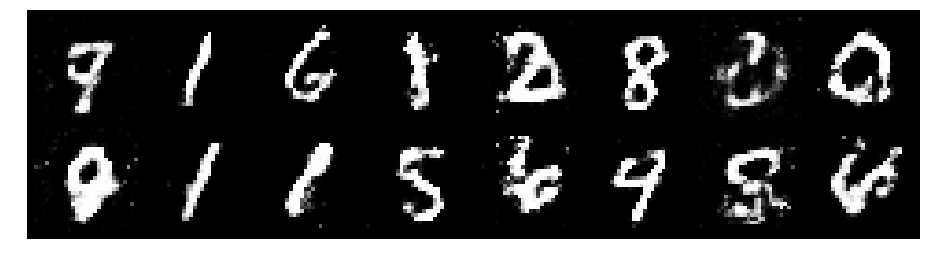

Epoch: [57/200], Batch Num: [600/938]
Discriminator Loss: 1.3091964721679688, Generator Loss: 0.8023215532302856
D(x): 0.5309, D(G(z)): 0.4645


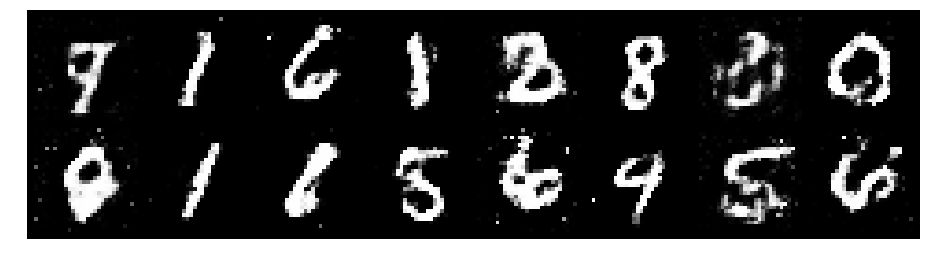

Epoch: [57/200], Batch Num: [700/938]
Discriminator Loss: 1.3023219108581543, Generator Loss: 0.9140286445617676
D(x): 0.5033, D(G(z)): 0.4162


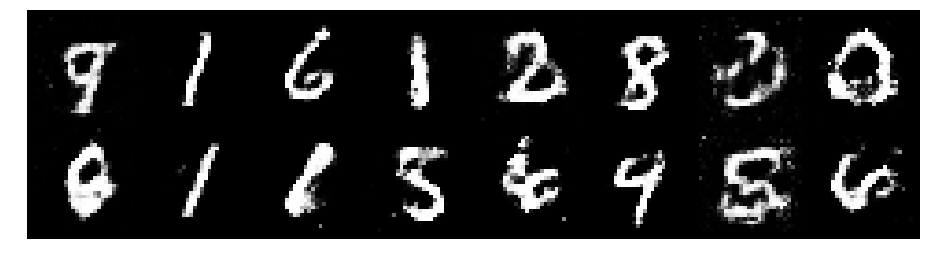

Epoch: [57/200], Batch Num: [800/938]
Discriminator Loss: 1.1841106414794922, Generator Loss: 1.0259419679641724
D(x): 0.6044, D(G(z)): 0.4429


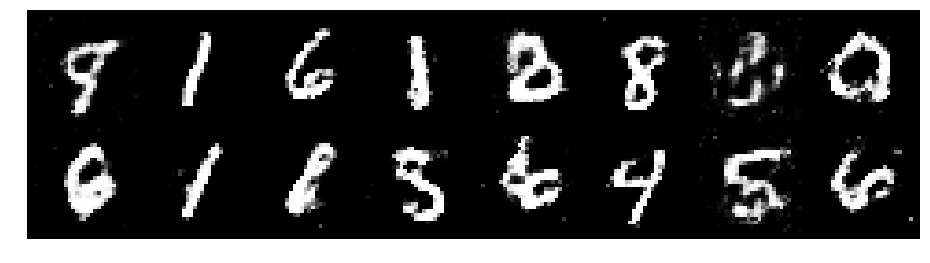

Epoch: [57/200], Batch Num: [900/938]
Discriminator Loss: 1.189704179763794, Generator Loss: 0.9107160568237305
D(x): 0.5779, D(G(z)): 0.4013


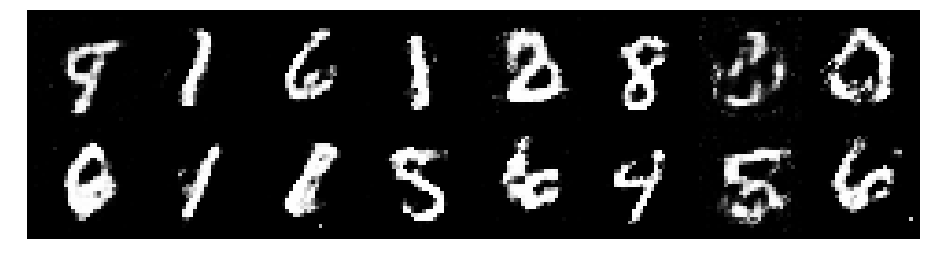

Epoch: [58/200], Batch Num: [0/938]
Discriminator Loss: 1.2793207168579102, Generator Loss: 1.1338211297988892
D(x): 0.5533, D(G(z)): 0.4326


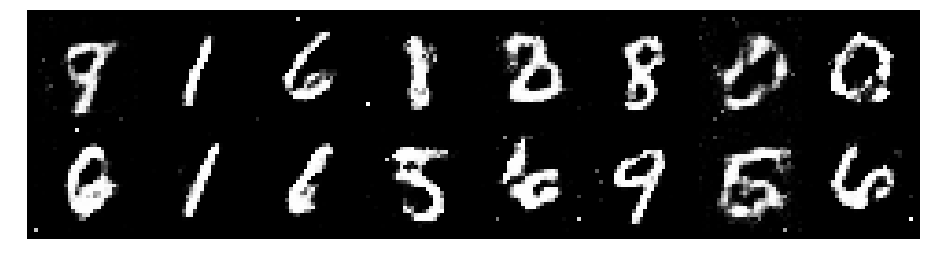

Epoch: [58/200], Batch Num: [100/938]
Discriminator Loss: 1.2242116928100586, Generator Loss: 0.8899480104446411
D(x): 0.5118, D(G(z)): 0.3910


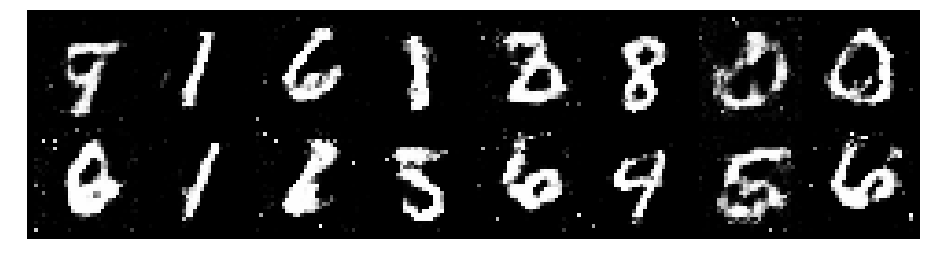

Epoch: [58/200], Batch Num: [200/938]
Discriminator Loss: 1.205801010131836, Generator Loss: 0.8226574659347534
D(x): 0.5666, D(G(z)): 0.4347


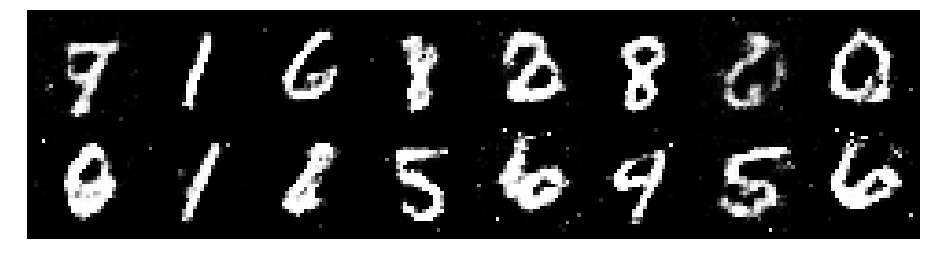

Epoch: [58/200], Batch Num: [300/938]
Discriminator Loss: 1.1618868112564087, Generator Loss: 0.839382529258728
D(x): 0.5980, D(G(z)): 0.4173


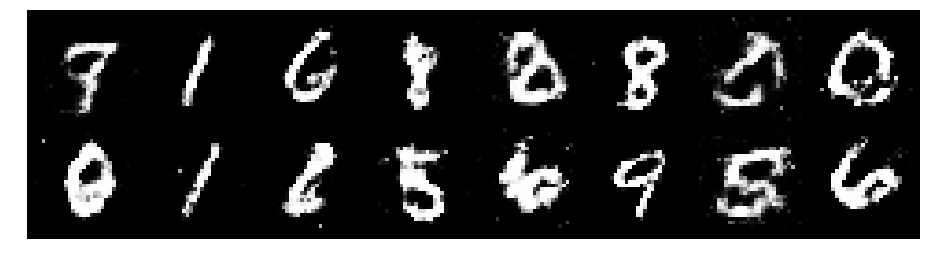

Epoch: [58/200], Batch Num: [400/938]
Discriminator Loss: 1.219667673110962, Generator Loss: 0.9125087261199951
D(x): 0.5858, D(G(z)): 0.4470


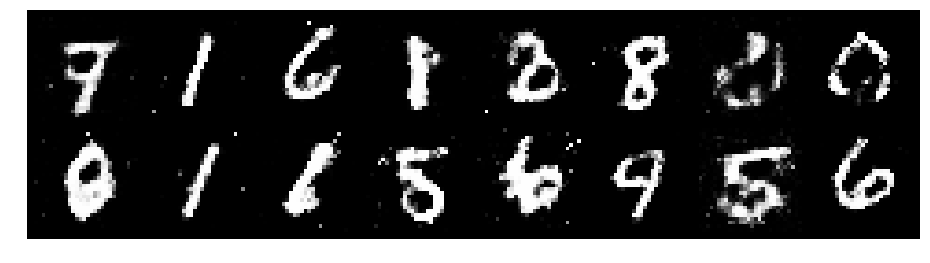

Epoch: [58/200], Batch Num: [500/938]
Discriminator Loss: 1.2646124362945557, Generator Loss: 0.8774640560150146
D(x): 0.5542, D(G(z)): 0.4410


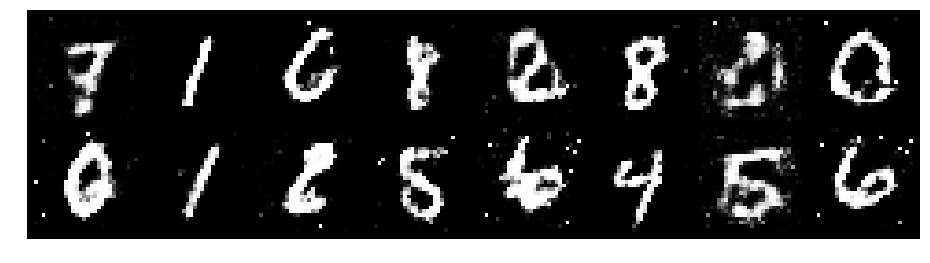

Epoch: [58/200], Batch Num: [600/938]
Discriminator Loss: 1.3038190603256226, Generator Loss: 0.7919908761978149
D(x): 0.5945, D(G(z)): 0.5040


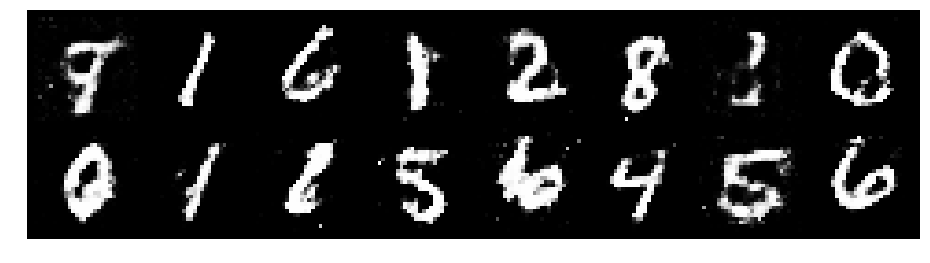

Epoch: [58/200], Batch Num: [700/938]
Discriminator Loss: 1.0777487754821777, Generator Loss: 0.9754151105880737
D(x): 0.6546, D(G(z)): 0.4173


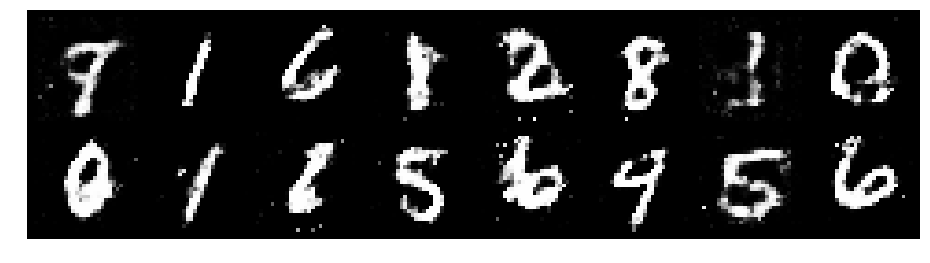

Epoch: [58/200], Batch Num: [800/938]
Discriminator Loss: 1.2647294998168945, Generator Loss: 0.864912748336792
D(x): 0.5647, D(G(z)): 0.4515


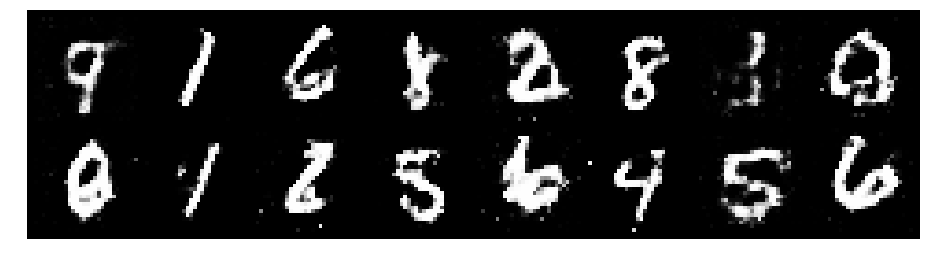

Epoch: [58/200], Batch Num: [900/938]
Discriminator Loss: 1.2756421566009521, Generator Loss: 1.0254744291305542
D(x): 0.5487, D(G(z)): 0.4276


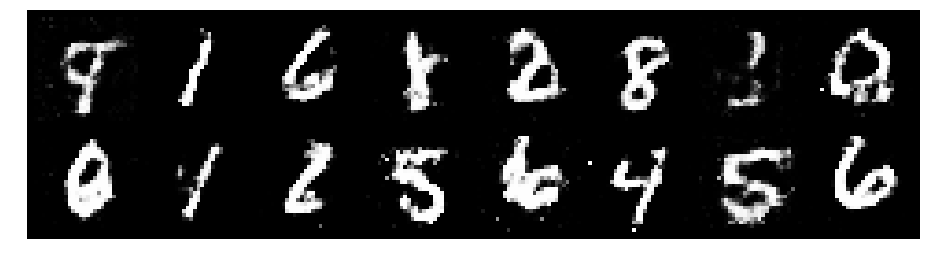

Epoch: [59/200], Batch Num: [0/938]
Discriminator Loss: 1.2675492763519287, Generator Loss: 0.8387943506240845
D(x): 0.5499, D(G(z)): 0.4507


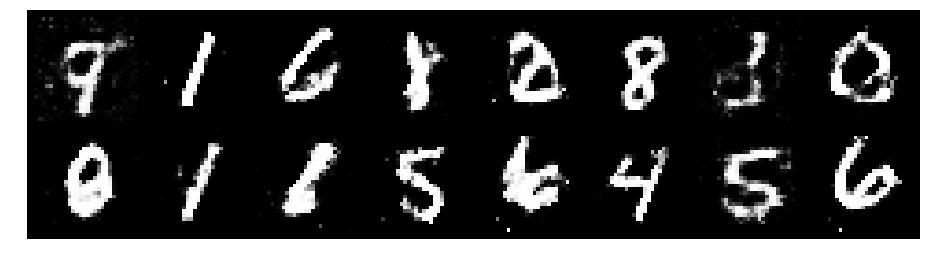

Epoch: [59/200], Batch Num: [100/938]
Discriminator Loss: 1.3941409587860107, Generator Loss: 0.7549484968185425
D(x): 0.5697, D(G(z)): 0.5377


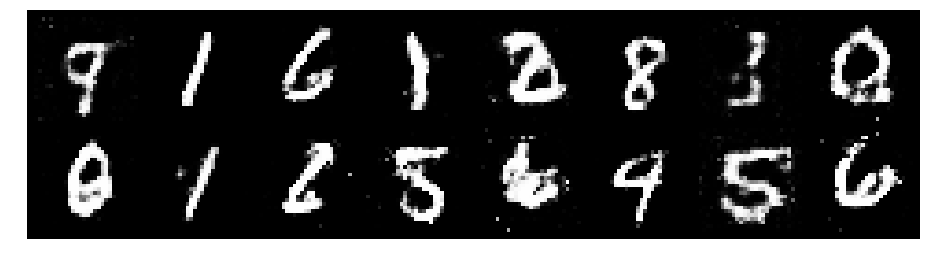

Epoch: [59/200], Batch Num: [200/938]
Discriminator Loss: 1.4181969165802002, Generator Loss: 0.9532492756843567
D(x): 0.4704, D(G(z)): 0.3882


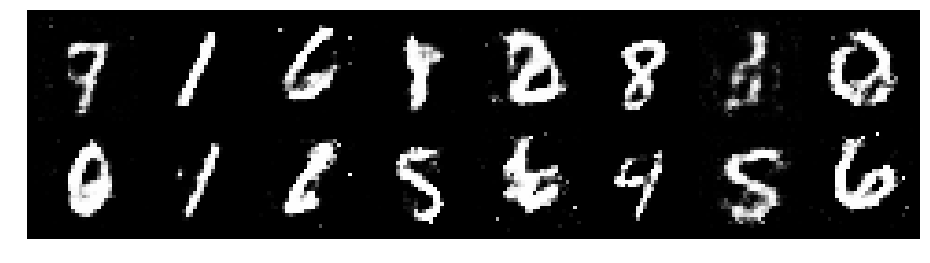

Epoch: [59/200], Batch Num: [300/938]
Discriminator Loss: 1.2813162803649902, Generator Loss: 1.054236650466919
D(x): 0.5600, D(G(z)): 0.4494


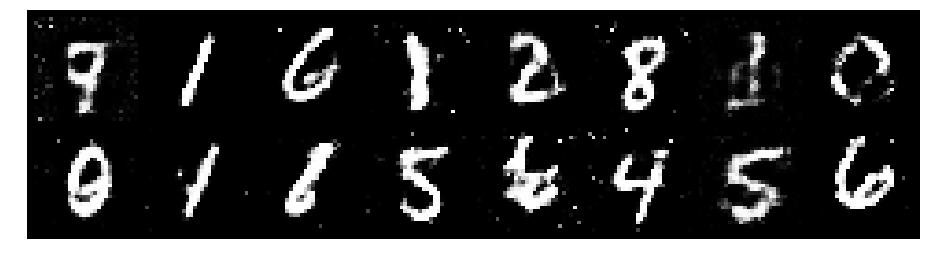

Epoch: [59/200], Batch Num: [400/938]
Discriminator Loss: 1.0634607076644897, Generator Loss: 1.0351965427398682
D(x): 0.6098, D(G(z)): 0.3655


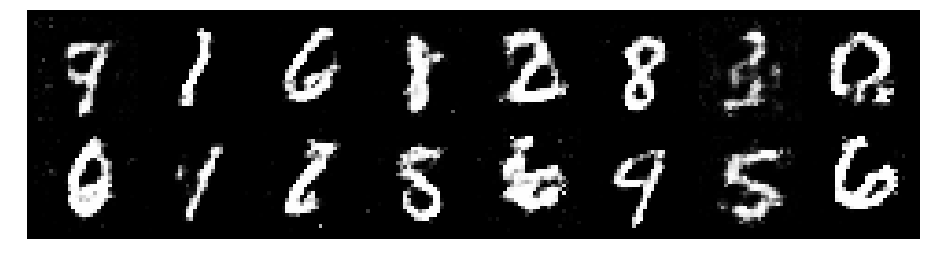

Epoch: [59/200], Batch Num: [500/938]
Discriminator Loss: 1.0358860492706299, Generator Loss: 1.1505019664764404
D(x): 0.6144, D(G(z)): 0.3571


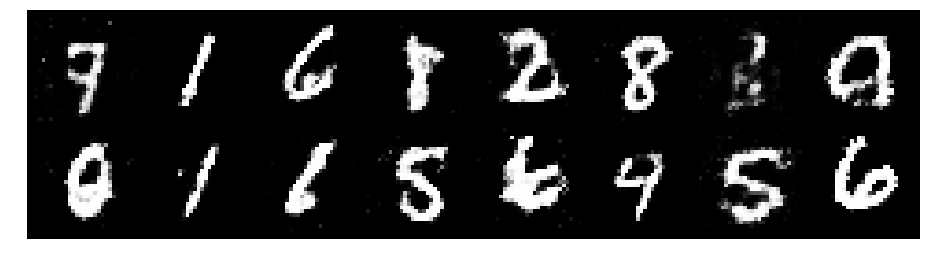

Epoch: [59/200], Batch Num: [600/938]
Discriminator Loss: 1.2959377765655518, Generator Loss: 0.8261967897415161
D(x): 0.5750, D(G(z)): 0.4765


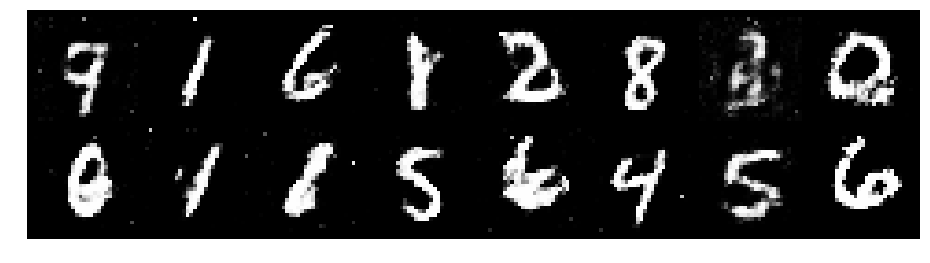

Epoch: [59/200], Batch Num: [700/938]
Discriminator Loss: 1.1697969436645508, Generator Loss: 0.8192681670188904
D(x): 0.5639, D(G(z)): 0.4154


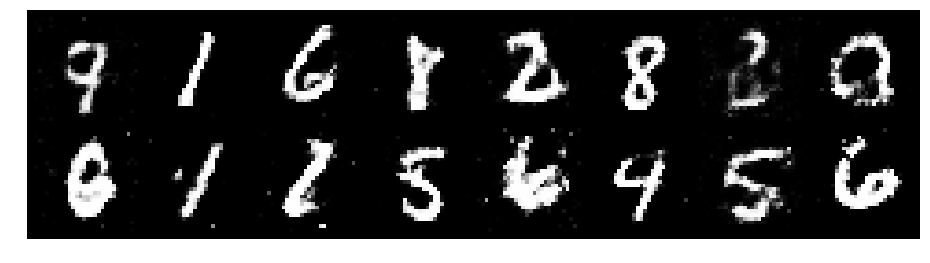

Epoch: [59/200], Batch Num: [800/938]
Discriminator Loss: 1.26826810836792, Generator Loss: 0.8477277159690857
D(x): 0.5977, D(G(z)): 0.4897


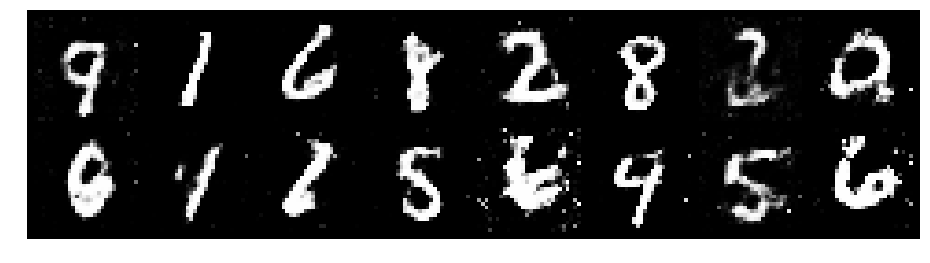

Epoch: [59/200], Batch Num: [900/938]
Discriminator Loss: 1.1583764553070068, Generator Loss: 0.9762527346611023
D(x): 0.6214, D(G(z)): 0.4433


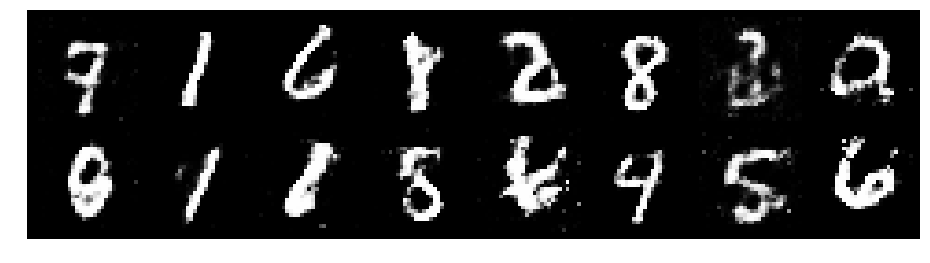

Epoch: [60/200], Batch Num: [0/938]
Discriminator Loss: 1.3401319980621338, Generator Loss: 0.9999985694885254
D(x): 0.5322, D(G(z)): 0.4481


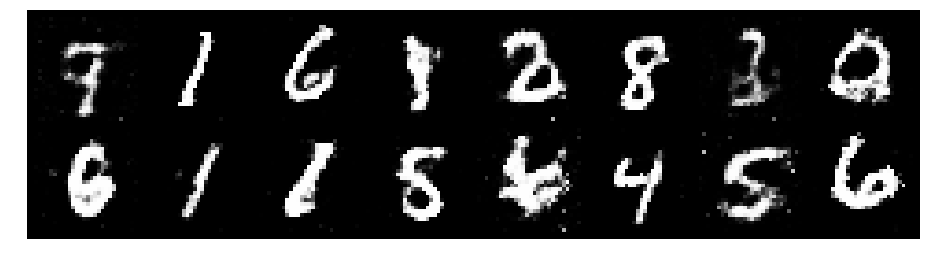

Epoch: [60/200], Batch Num: [100/938]
Discriminator Loss: 1.1744892597198486, Generator Loss: 0.9567272663116455
D(x): 0.5555, D(G(z)): 0.3878


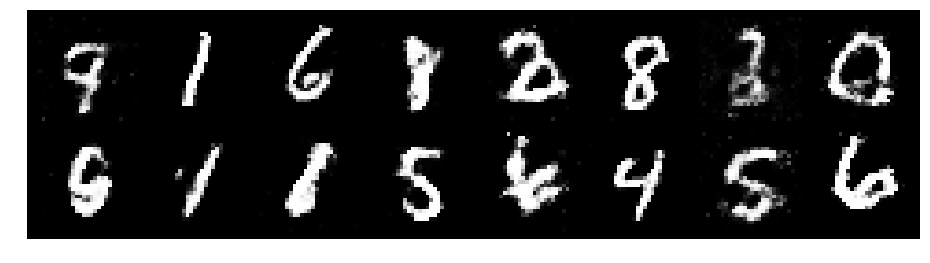

Epoch: [60/200], Batch Num: [200/938]
Discriminator Loss: 1.2781083583831787, Generator Loss: 0.8676221370697021
D(x): 0.5864, D(G(z)): 0.4762


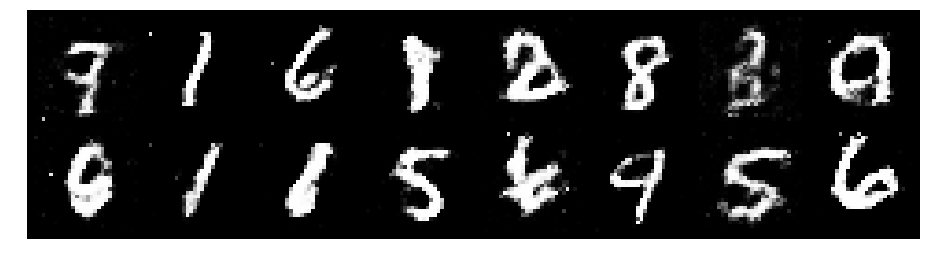

Epoch: [60/200], Batch Num: [300/938]
Discriminator Loss: 1.2365896701812744, Generator Loss: 0.8927617073059082
D(x): 0.5823, D(G(z)): 0.4618


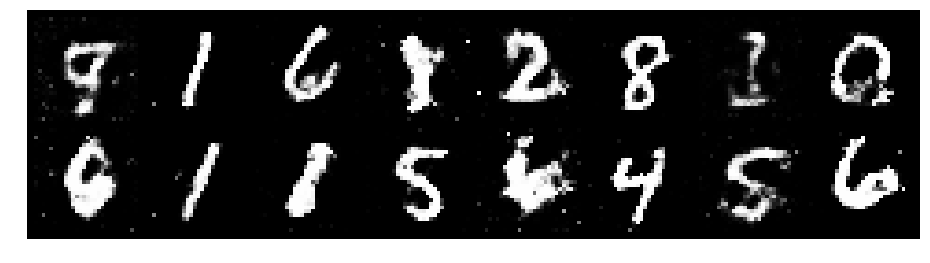

Epoch: [60/200], Batch Num: [400/938]
Discriminator Loss: 1.309136152267456, Generator Loss: 0.9261070489883423
D(x): 0.5409, D(G(z)): 0.4606


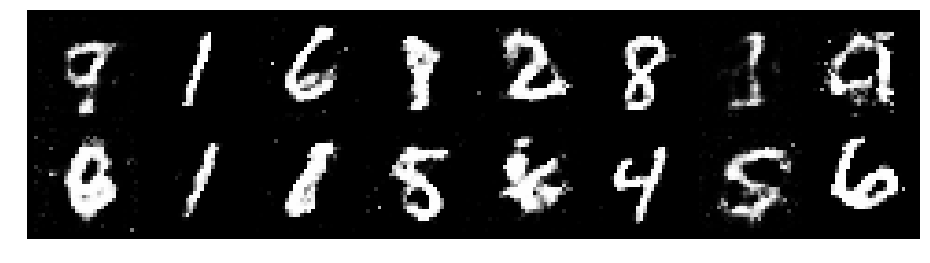

Epoch: [60/200], Batch Num: [500/938]
Discriminator Loss: 1.3112280368804932, Generator Loss: 0.7605743408203125
D(x): 0.5259, D(G(z)): 0.4482


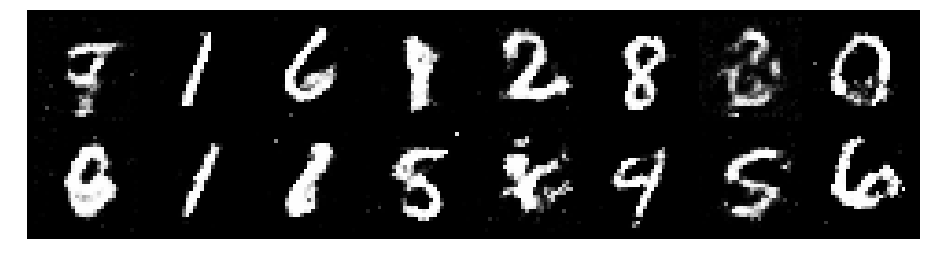

Epoch: [60/200], Batch Num: [600/938]
Discriminator Loss: 1.341186761856079, Generator Loss: 0.8777415156364441
D(x): 0.5301, D(G(z)): 0.4544


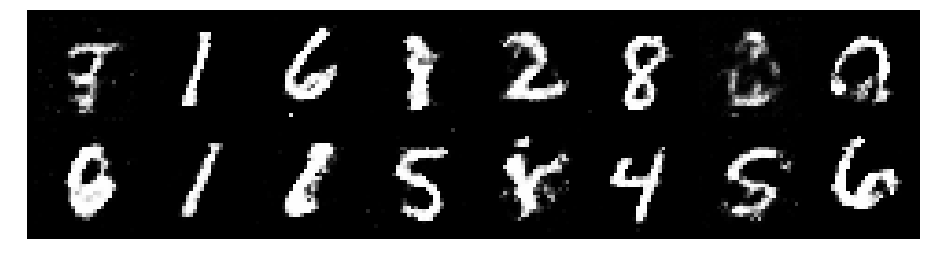

Epoch: [60/200], Batch Num: [700/938]
Discriminator Loss: 1.2034324407577515, Generator Loss: 0.8042019009590149
D(x): 0.5840, D(G(z)): 0.4320


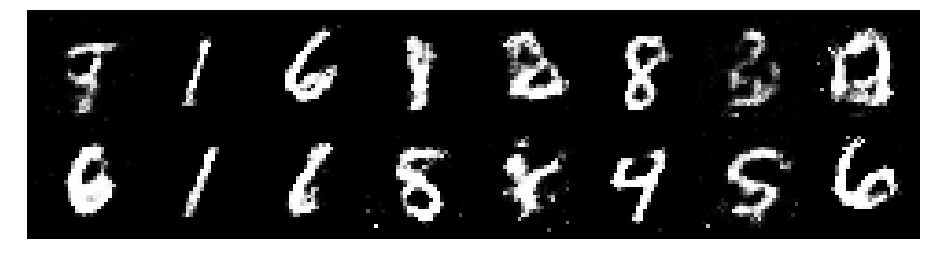

Epoch: [60/200], Batch Num: [800/938]
Discriminator Loss: 1.378111481666565, Generator Loss: 0.832975447177887
D(x): 0.5088, D(G(z)): 0.4441


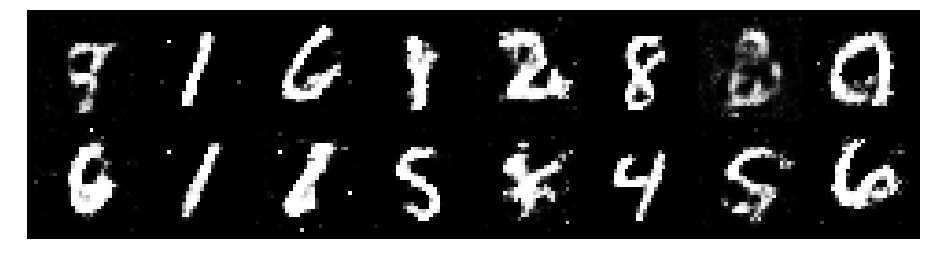

Epoch: [60/200], Batch Num: [900/938]
Discriminator Loss: 1.2523856163024902, Generator Loss: 0.9051624536514282
D(x): 0.5514, D(G(z)): 0.4180


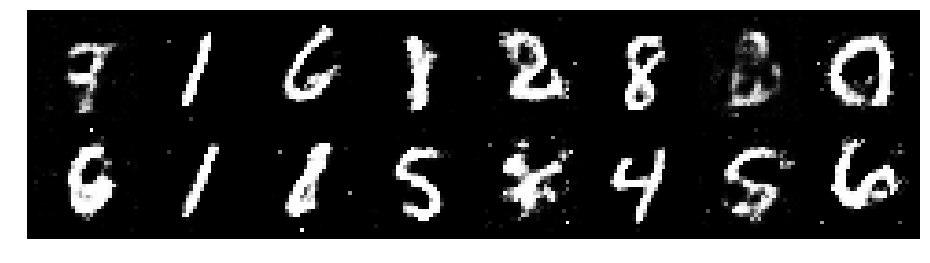

Epoch: [61/200], Batch Num: [0/938]
Discriminator Loss: 1.1891008615493774, Generator Loss: 1.3323311805725098
D(x): 0.5677, D(G(z)): 0.3536


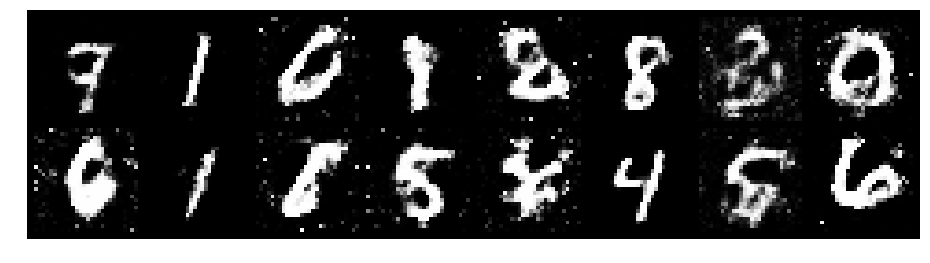

Epoch: [61/200], Batch Num: [100/938]
Discriminator Loss: 1.2912638187408447, Generator Loss: 1.0781869888305664
D(x): 0.5674, D(G(z)): 0.4602


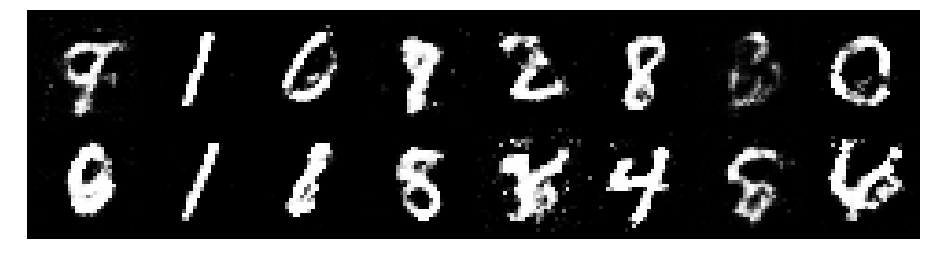

Epoch: [61/200], Batch Num: [200/938]
Discriminator Loss: 1.2056782245635986, Generator Loss: 0.7967220544815063
D(x): 0.5730, D(G(z)): 0.4548


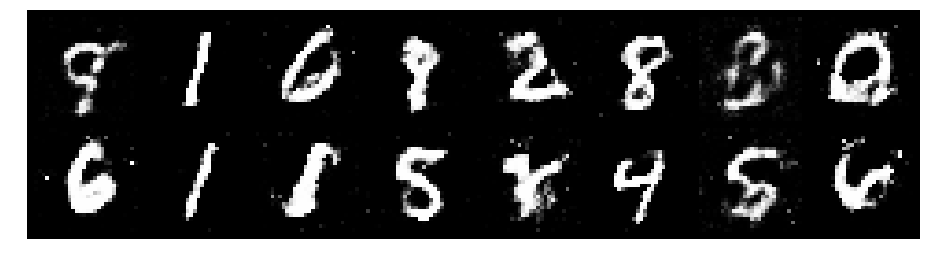

Epoch: [61/200], Batch Num: [300/938]
Discriminator Loss: 1.2838311195373535, Generator Loss: 0.7488366961479187
D(x): 0.6087, D(G(z)): 0.4799


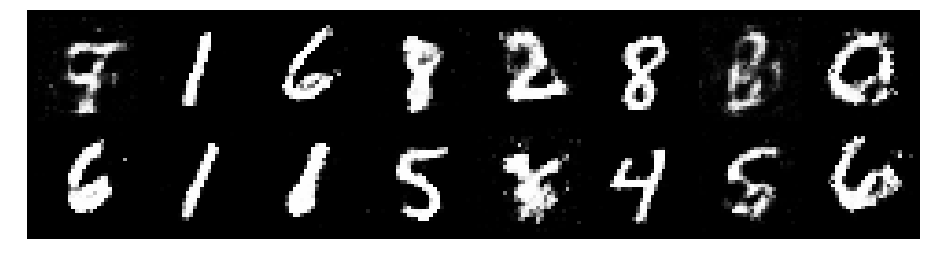

Epoch: [61/200], Batch Num: [400/938]
Discriminator Loss: 1.4999186992645264, Generator Loss: 0.8259530663490295
D(x): 0.5293, D(G(z)): 0.5029


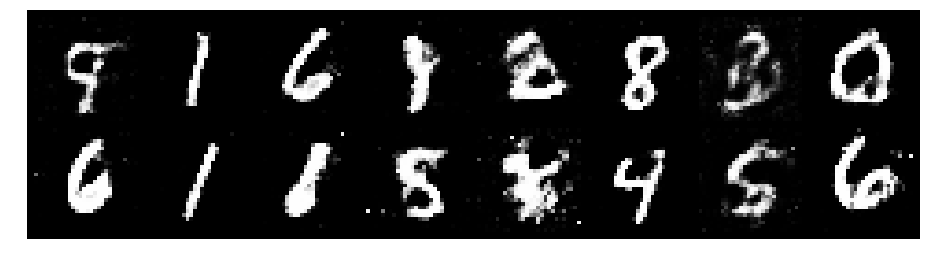

Epoch: [61/200], Batch Num: [500/938]
Discriminator Loss: 1.2587915658950806, Generator Loss: 0.9057408571243286
D(x): 0.5583, D(G(z)): 0.4348


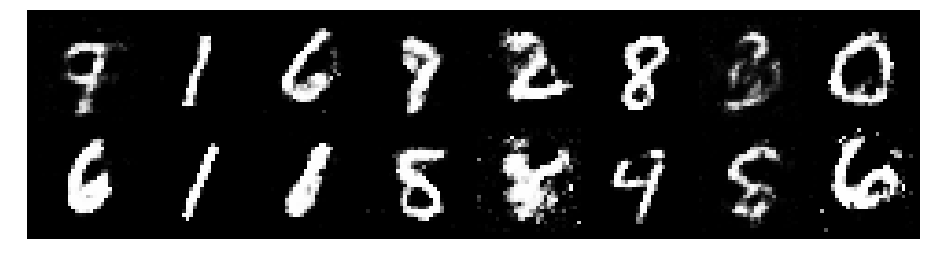

Epoch: [61/200], Batch Num: [600/938]
Discriminator Loss: 1.1886539459228516, Generator Loss: 1.0737093687057495
D(x): 0.5798, D(G(z)): 0.4180


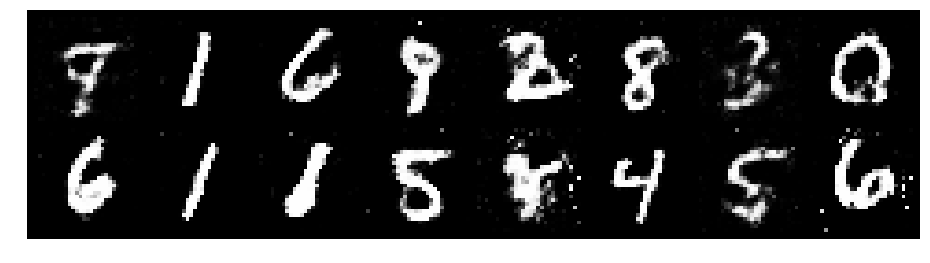

Epoch: [61/200], Batch Num: [700/938]
Discriminator Loss: 1.2639636993408203, Generator Loss: 0.8968250751495361
D(x): 0.5667, D(G(z)): 0.4580


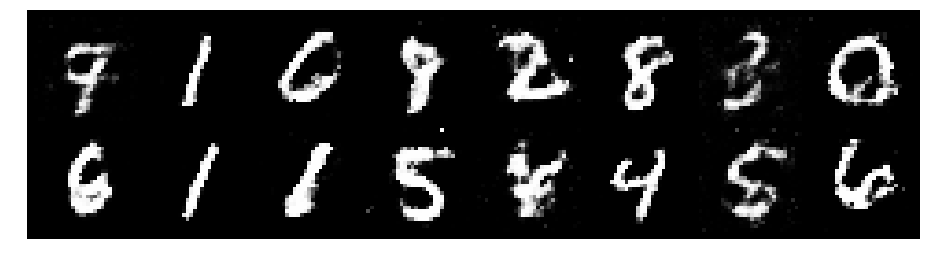

Epoch: [61/200], Batch Num: [800/938]
Discriminator Loss: 1.2760909795761108, Generator Loss: 0.8932405710220337
D(x): 0.5308, D(G(z)): 0.4245


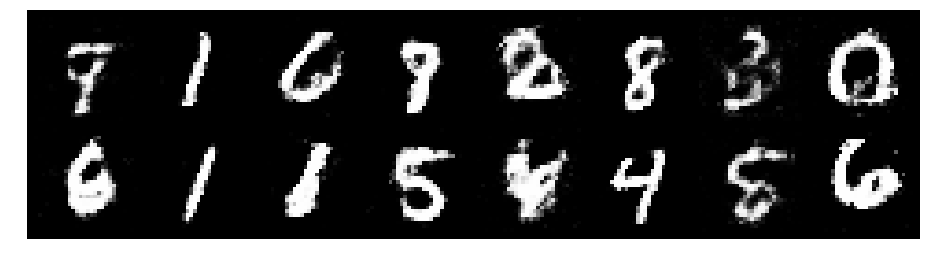

Epoch: [61/200], Batch Num: [900/938]
Discriminator Loss: 1.2172755002975464, Generator Loss: 0.781965970993042
D(x): 0.5537, D(G(z)): 0.4231


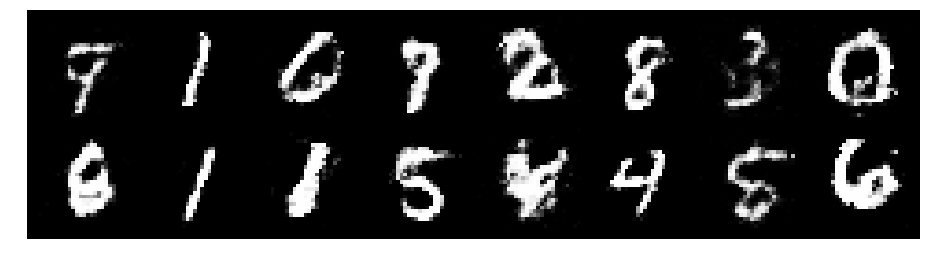

Epoch: [62/200], Batch Num: [0/938]
Discriminator Loss: 1.2340724468231201, Generator Loss: 0.8885696530342102
D(x): 0.5829, D(G(z)): 0.4302


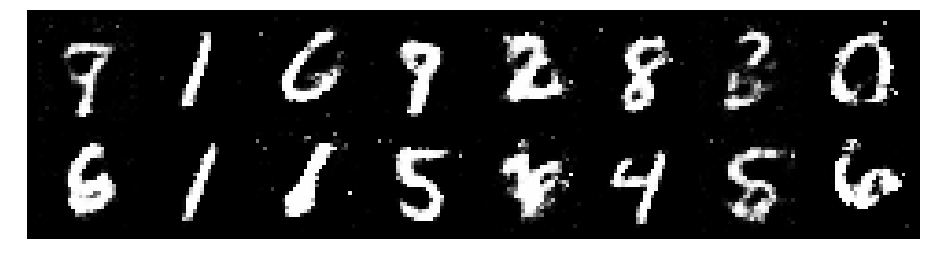

Epoch: [62/200], Batch Num: [100/938]
Discriminator Loss: 1.207873821258545, Generator Loss: 1.0759975910186768
D(x): 0.5530, D(G(z)): 0.4041


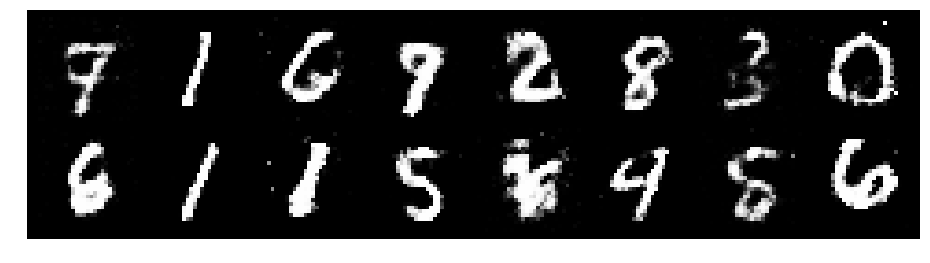

Epoch: [62/200], Batch Num: [200/938]
Discriminator Loss: 1.1167277097702026, Generator Loss: 0.8635783195495605
D(x): 0.6252, D(G(z)): 0.4373


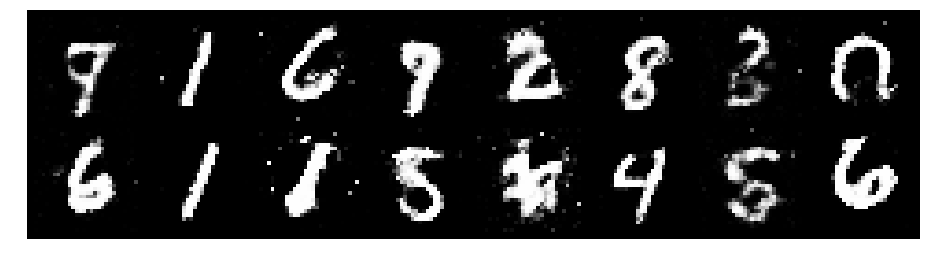

Epoch: [62/200], Batch Num: [300/938]
Discriminator Loss: 1.2475738525390625, Generator Loss: 0.9800707101821899
D(x): 0.5397, D(G(z)): 0.4163


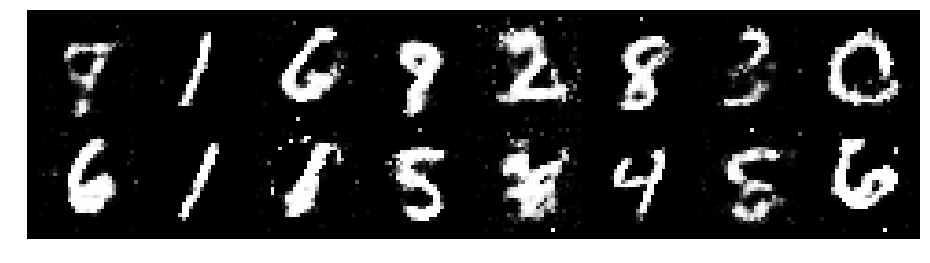

Epoch: [62/200], Batch Num: [400/938]
Discriminator Loss: 1.3389596939086914, Generator Loss: 0.872103214263916
D(x): 0.5082, D(G(z)): 0.4113


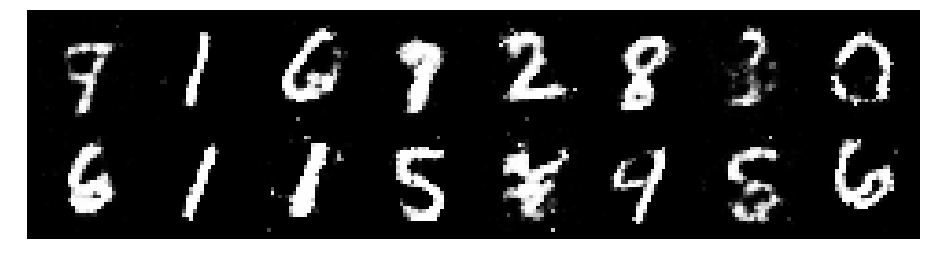

Epoch: [62/200], Batch Num: [500/938]
Discriminator Loss: 1.23737633228302, Generator Loss: 1.0299594402313232
D(x): 0.5317, D(G(z)): 0.3881


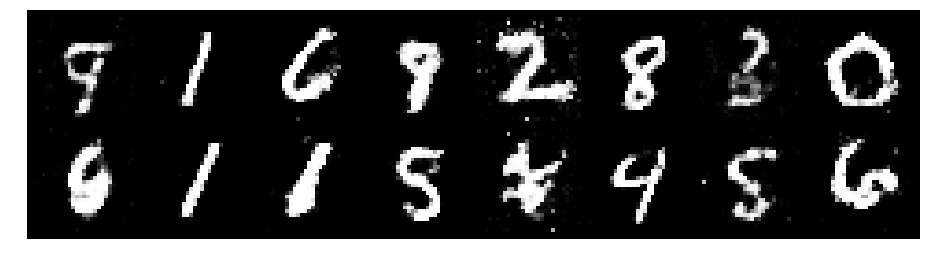

Epoch: [62/200], Batch Num: [600/938]
Discriminator Loss: 1.2223892211914062, Generator Loss: 0.828683614730835
D(x): 0.5641, D(G(z)): 0.4357


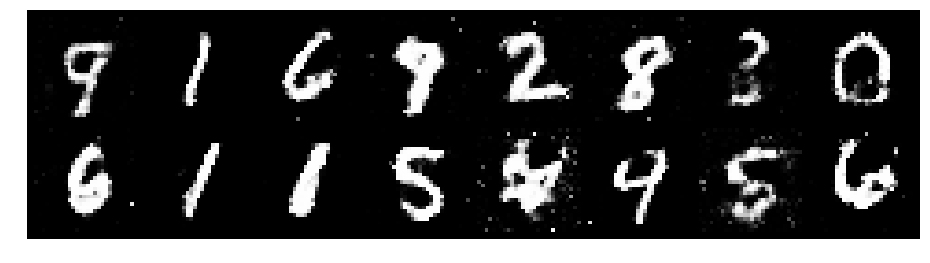

Epoch: [62/200], Batch Num: [700/938]
Discriminator Loss: 1.25874924659729, Generator Loss: 0.8252694606781006
D(x): 0.5659, D(G(z)): 0.4572


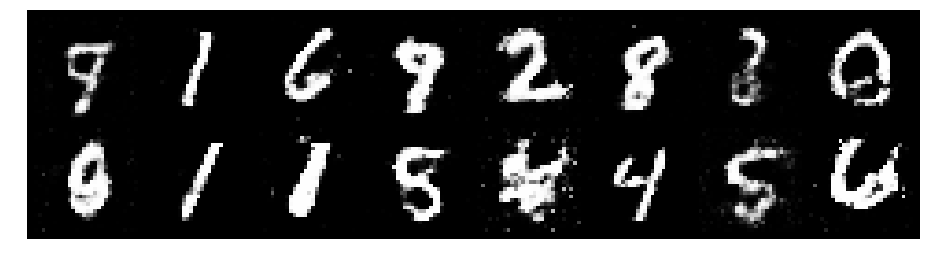

Epoch: [62/200], Batch Num: [800/938]
Discriminator Loss: 1.265350341796875, Generator Loss: 0.8009067177772522
D(x): 0.5337, D(G(z)): 0.4352


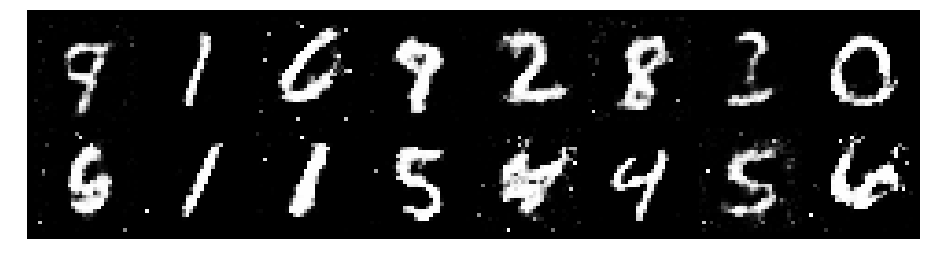

Epoch: [62/200], Batch Num: [900/938]
Discriminator Loss: 1.2745559215545654, Generator Loss: 0.8742486834526062
D(x): 0.5419, D(G(z)): 0.4503


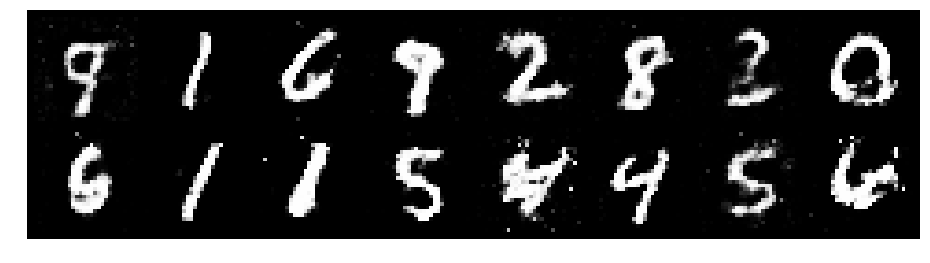

Epoch: [63/200], Batch Num: [0/938]
Discriminator Loss: 1.2282894849777222, Generator Loss: 0.9600409269332886
D(x): 0.5544, D(G(z)): 0.3960


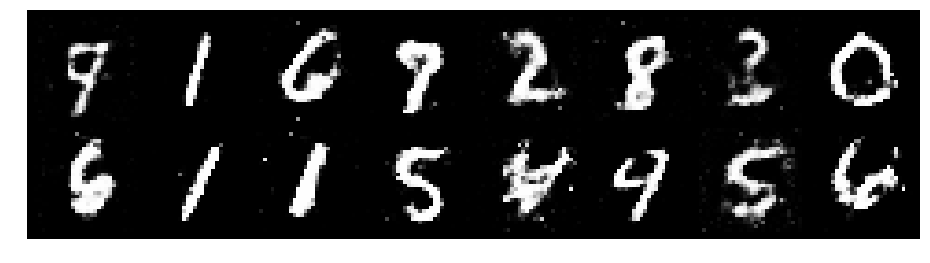

Epoch: [63/200], Batch Num: [100/938]
Discriminator Loss: 1.2285317182540894, Generator Loss: 0.9160739779472351
D(x): 0.5614, D(G(z)): 0.4197


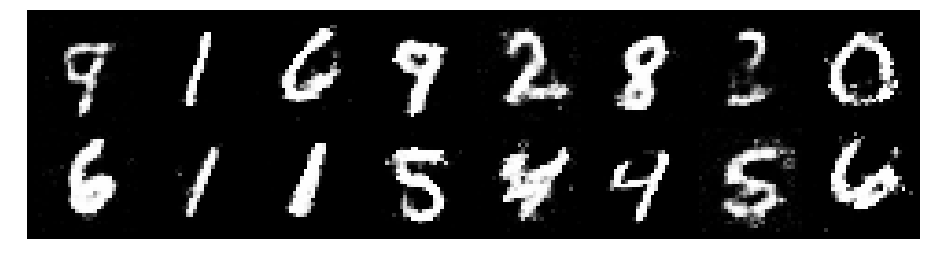

Epoch: [63/200], Batch Num: [200/938]
Discriminator Loss: 1.3905415534973145, Generator Loss: 0.9846612215042114
D(x): 0.5427, D(G(z)): 0.4761


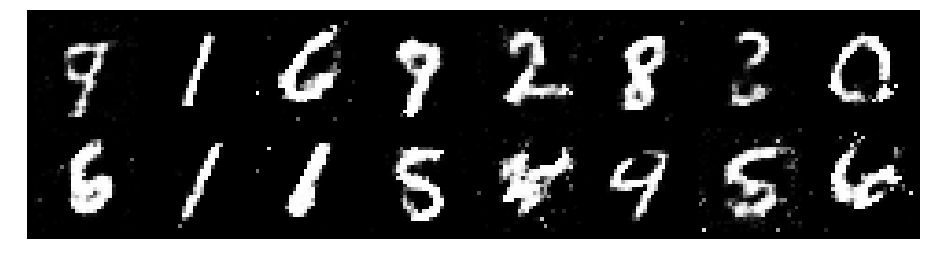

Epoch: [63/200], Batch Num: [300/938]
Discriminator Loss: 1.250781774520874, Generator Loss: 0.9092097282409668
D(x): 0.5453, D(G(z)): 0.4229


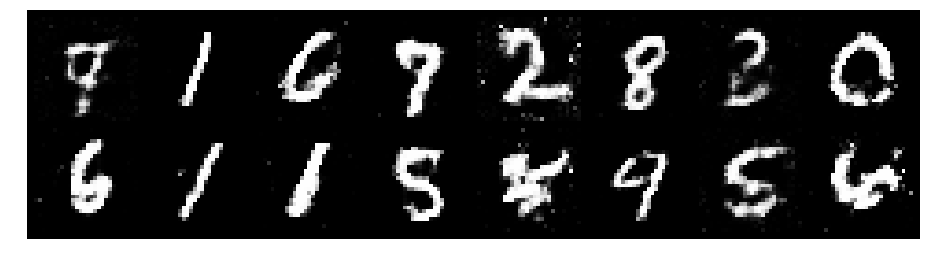

Epoch: [63/200], Batch Num: [400/938]
Discriminator Loss: 1.2914704084396362, Generator Loss: 0.8191580772399902
D(x): 0.5450, D(G(z)): 0.4602


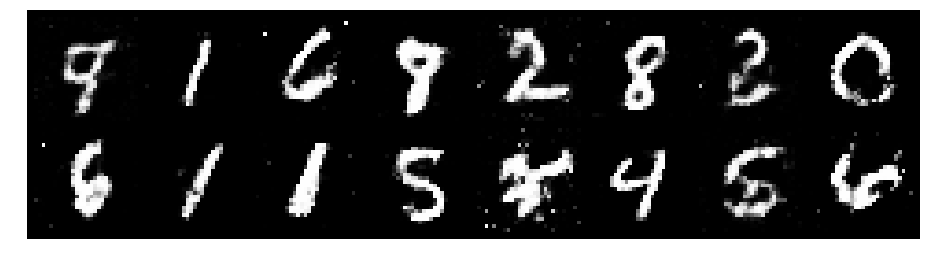

Epoch: [63/200], Batch Num: [500/938]
Discriminator Loss: 1.271207571029663, Generator Loss: 1.0057932138442993
D(x): 0.5661, D(G(z)): 0.4574


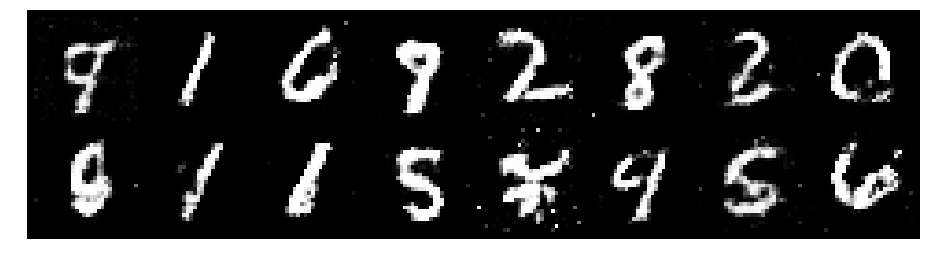

Epoch: [63/200], Batch Num: [600/938]
Discriminator Loss: 1.3098104000091553, Generator Loss: 0.781195342540741
D(x): 0.5469, D(G(z)): 0.4341


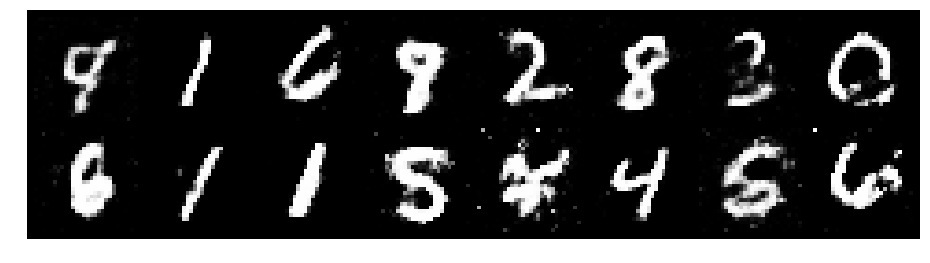

Epoch: [63/200], Batch Num: [700/938]
Discriminator Loss: 1.2781836986541748, Generator Loss: 0.9368218779563904
D(x): 0.5627, D(G(z)): 0.4554


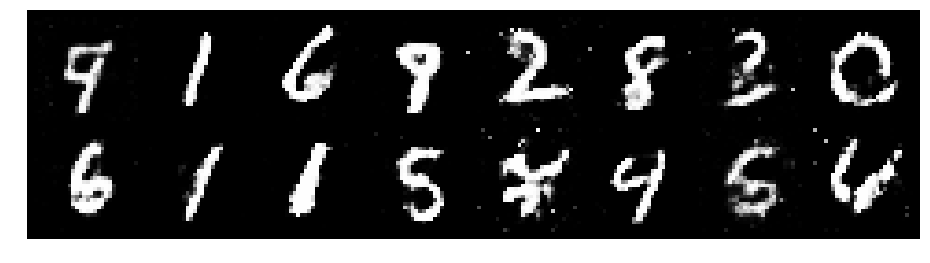

Epoch: [63/200], Batch Num: [800/938]
Discriminator Loss: 1.3324216604232788, Generator Loss: 0.8271200656890869
D(x): 0.5720, D(G(z)): 0.4794


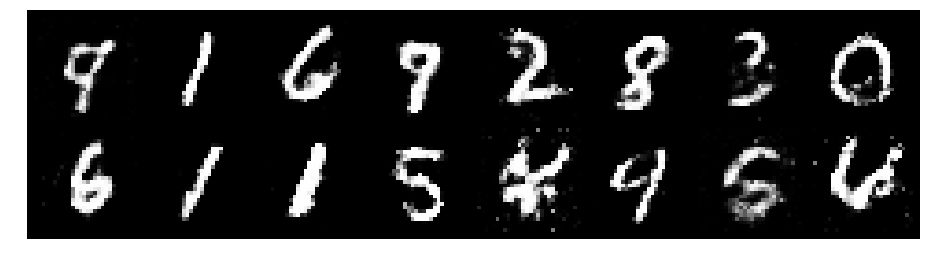

Epoch: [63/200], Batch Num: [900/938]
Discriminator Loss: 1.2516403198242188, Generator Loss: 1.0812499523162842
D(x): 0.5467, D(G(z)): 0.4080


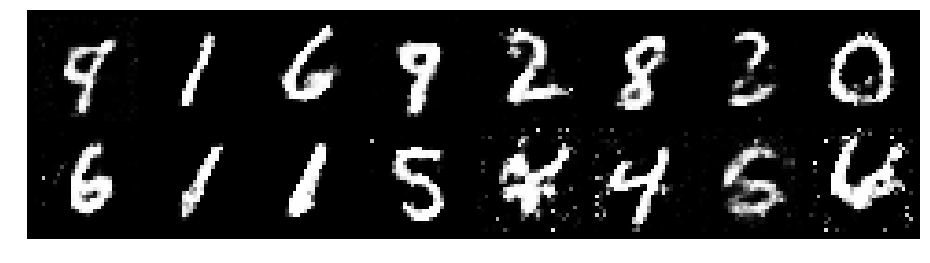

Epoch: [64/200], Batch Num: [0/938]
Discriminator Loss: 1.169969081878662, Generator Loss: 1.1666960716247559
D(x): 0.5834, D(G(z)): 0.4013


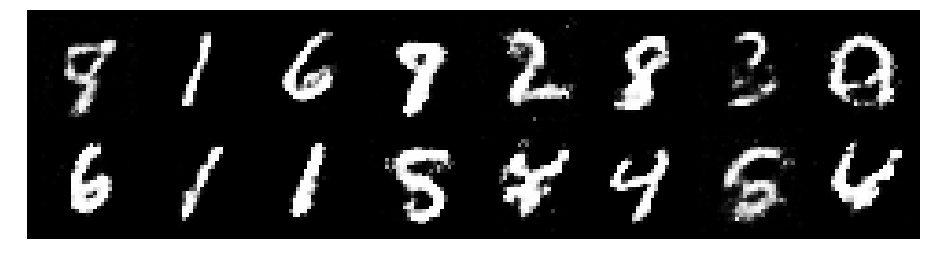

Epoch: [64/200], Batch Num: [100/938]
Discriminator Loss: 1.1600074768066406, Generator Loss: 0.9854152798652649
D(x): 0.5608, D(G(z)): 0.3944


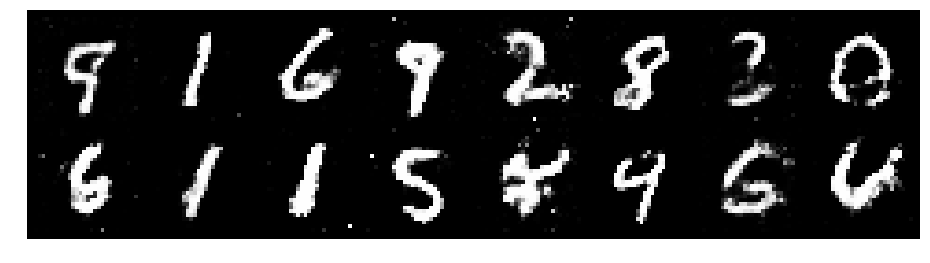

Epoch: [64/200], Batch Num: [200/938]
Discriminator Loss: 1.2629578113555908, Generator Loss: 1.1501246690750122
D(x): 0.5469, D(G(z)): 0.4285


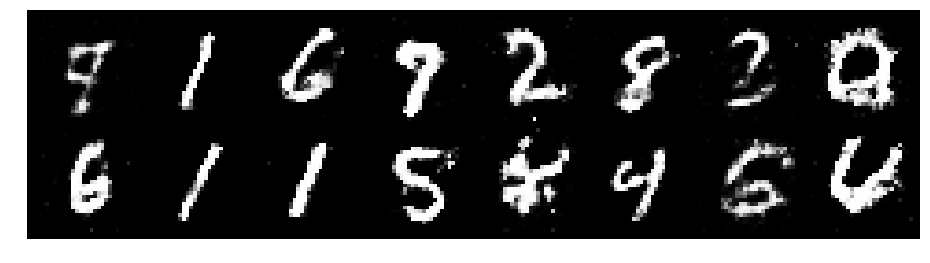

Epoch: [64/200], Batch Num: [300/938]
Discriminator Loss: 1.2083430290222168, Generator Loss: 0.9740925431251526
D(x): 0.5416, D(G(z)): 0.4094


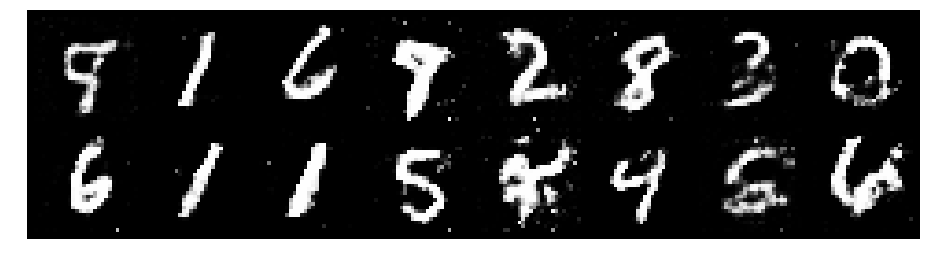

Epoch: [64/200], Batch Num: [400/938]
Discriminator Loss: 1.3084617853164673, Generator Loss: 0.7834066152572632
D(x): 0.5809, D(G(z)): 0.4677


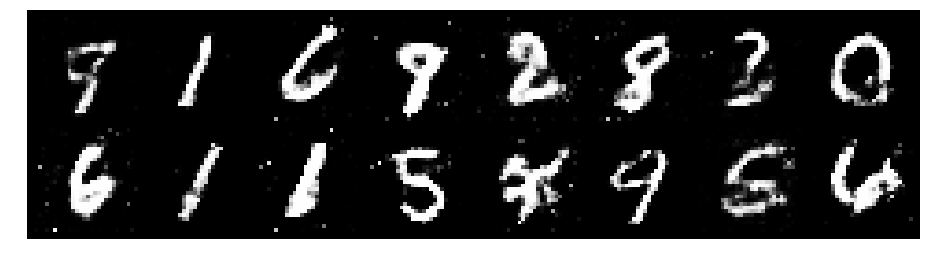

Epoch: [64/200], Batch Num: [500/938]
Discriminator Loss: 1.3595902919769287, Generator Loss: 0.6916289925575256
D(x): 0.5785, D(G(z)): 0.5014


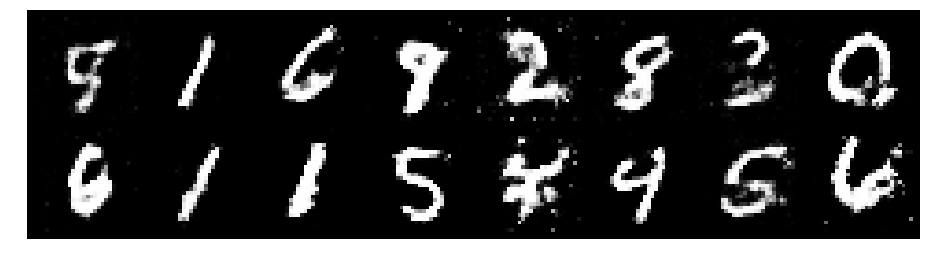

Epoch: [64/200], Batch Num: [600/938]
Discriminator Loss: 1.1993883848190308, Generator Loss: 1.0177332162857056
D(x): 0.5737, D(G(z)): 0.3758


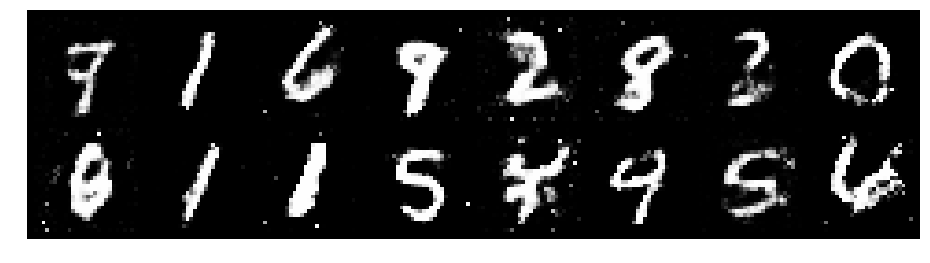

Epoch: [64/200], Batch Num: [700/938]
Discriminator Loss: 1.1368463039398193, Generator Loss: 1.1186516284942627
D(x): 0.5645, D(G(z)): 0.3752


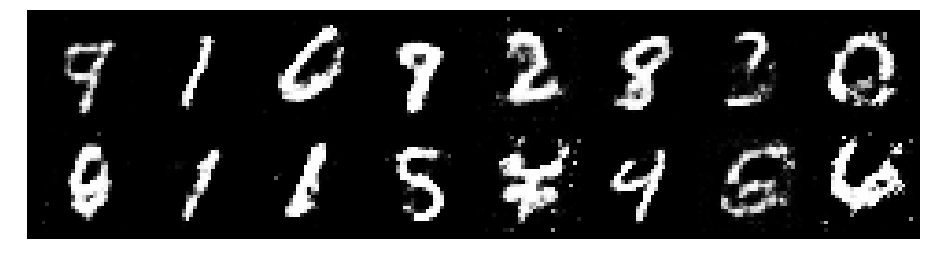

Epoch: [64/200], Batch Num: [800/938]
Discriminator Loss: 1.3376481533050537, Generator Loss: 0.8341852426528931
D(x): 0.5386, D(G(z)): 0.4710


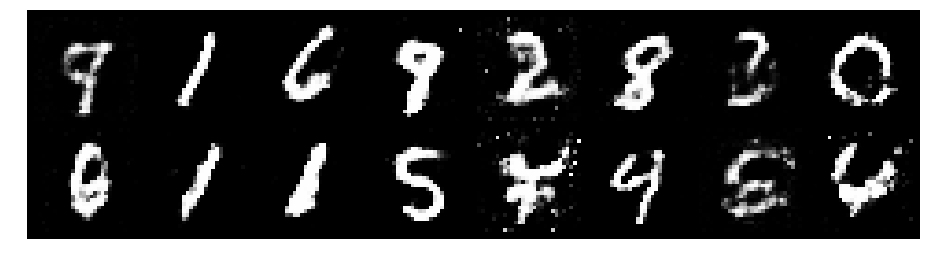

Epoch: [64/200], Batch Num: [900/938]
Discriminator Loss: 1.2496342658996582, Generator Loss: 0.877114474773407
D(x): 0.5707, D(G(z)): 0.4640


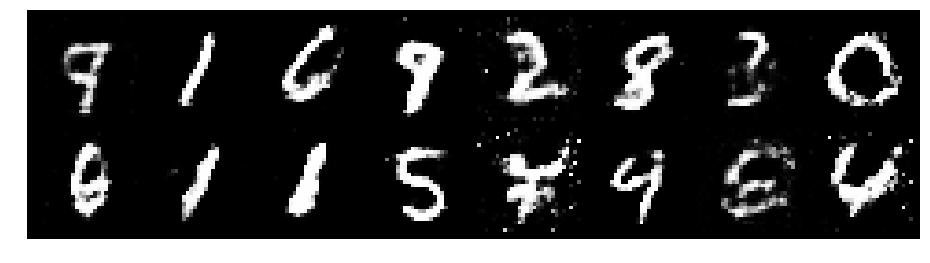

Epoch: [65/200], Batch Num: [0/938]
Discriminator Loss: 1.26112961769104, Generator Loss: 0.8656905293464661
D(x): 0.6143, D(G(z)): 0.4714


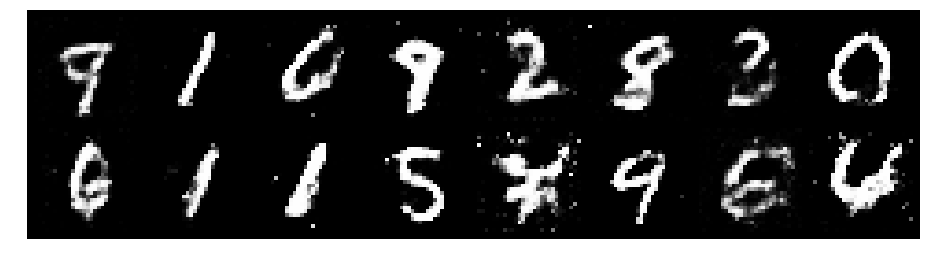

Epoch: [65/200], Batch Num: [100/938]
Discriminator Loss: 1.3416831493377686, Generator Loss: 0.8232859373092651
D(x): 0.5393, D(G(z)): 0.4593


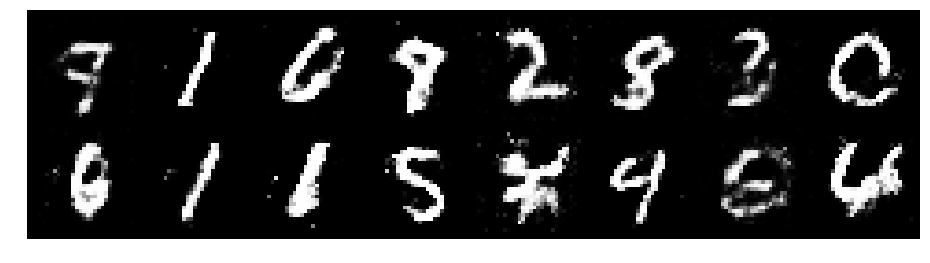

Epoch: [65/200], Batch Num: [200/938]
Discriminator Loss: 1.2432239055633545, Generator Loss: 0.9960957765579224
D(x): 0.5206, D(G(z)): 0.3978


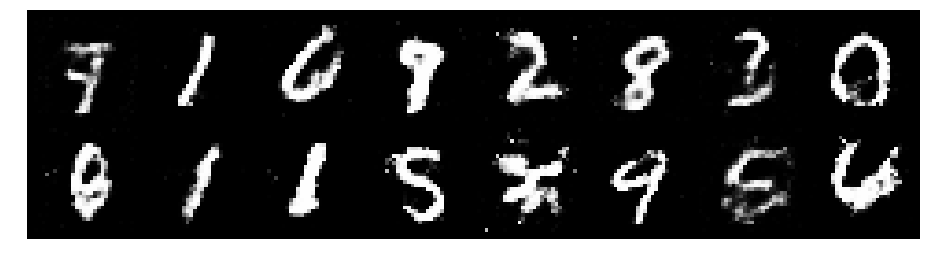

Epoch: [65/200], Batch Num: [300/938]
Discriminator Loss: 1.2248783111572266, Generator Loss: 0.7872126698493958
D(x): 0.5842, D(G(z)): 0.4526


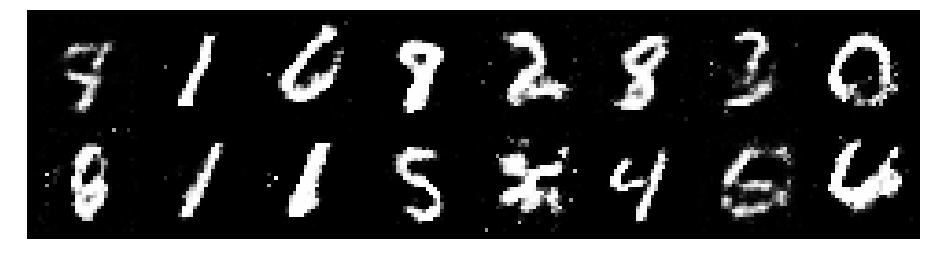

Epoch: [65/200], Batch Num: [400/938]
Discriminator Loss: 1.3355125188827515, Generator Loss: 0.791106104850769
D(x): 0.5368, D(G(z)): 0.4449


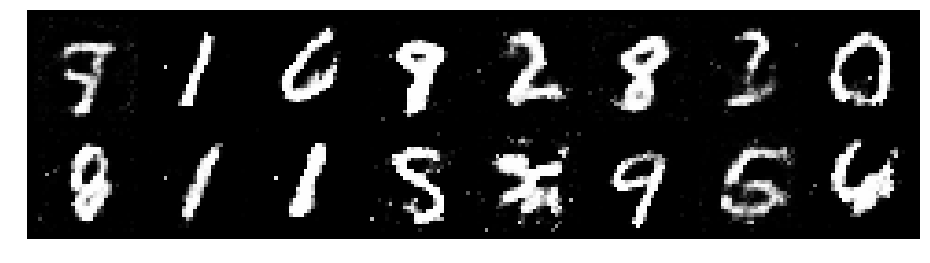

Epoch: [65/200], Batch Num: [500/938]
Discriminator Loss: 1.4365707635879517, Generator Loss: 0.8963390588760376
D(x): 0.5559, D(G(z)): 0.5065


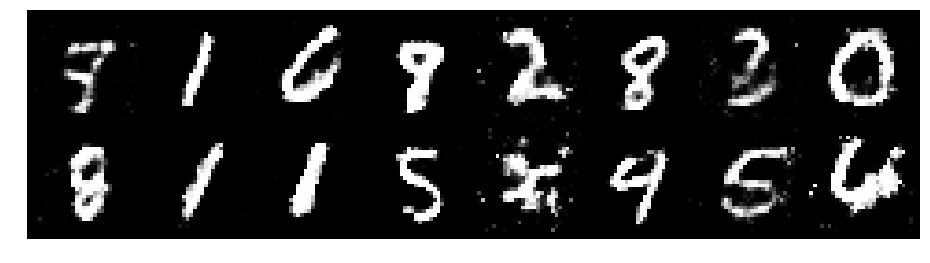

Epoch: [65/200], Batch Num: [600/938]
Discriminator Loss: 1.1831934452056885, Generator Loss: 0.9906022548675537
D(x): 0.5696, D(G(z)): 0.4163


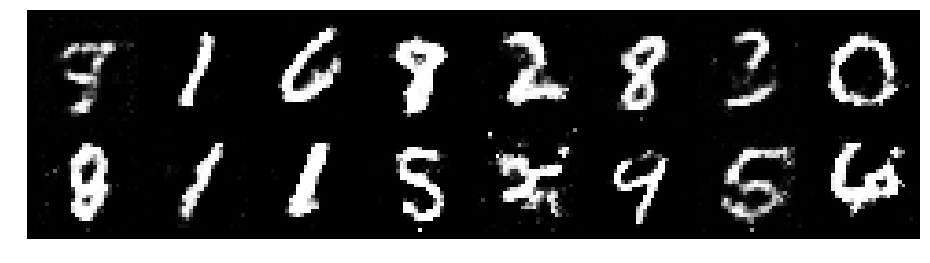

Epoch: [65/200], Batch Num: [700/938]
Discriminator Loss: 1.2172218561172485, Generator Loss: 0.9120705127716064
D(x): 0.5995, D(G(z)): 0.4635


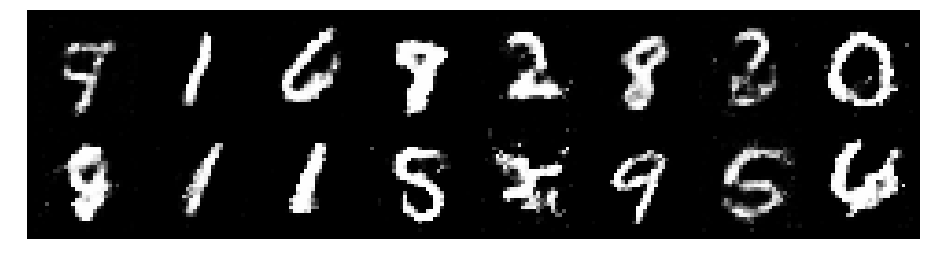

Epoch: [65/200], Batch Num: [800/938]
Discriminator Loss: 1.2488656044006348, Generator Loss: 1.1187713146209717
D(x): 0.5788, D(G(z)): 0.4474


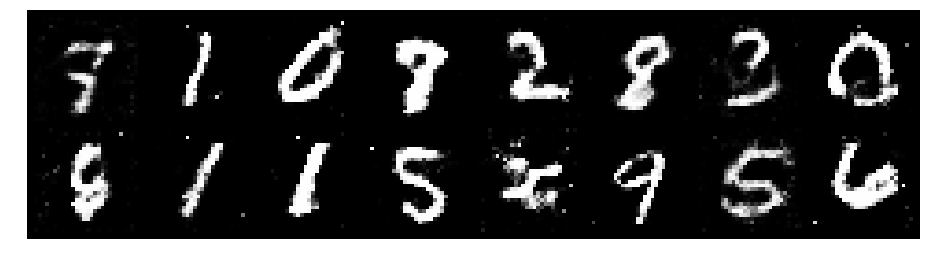

Epoch: [65/200], Batch Num: [900/938]
Discriminator Loss: 1.2027643918991089, Generator Loss: 1.0470374822616577
D(x): 0.5543, D(G(z)): 0.4057


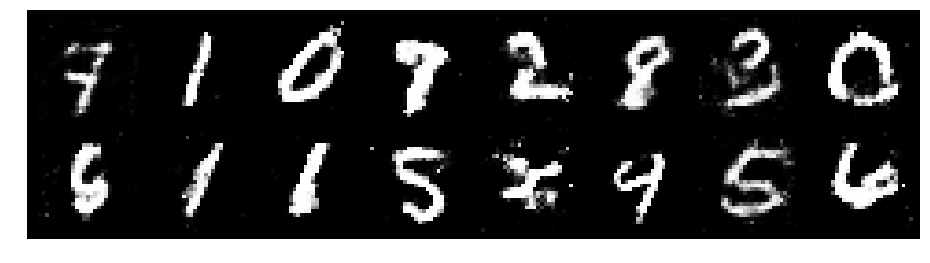

Epoch: [66/200], Batch Num: [0/938]
Discriminator Loss: 1.228268027305603, Generator Loss: 0.8188298940658569
D(x): 0.6167, D(G(z)): 0.4578


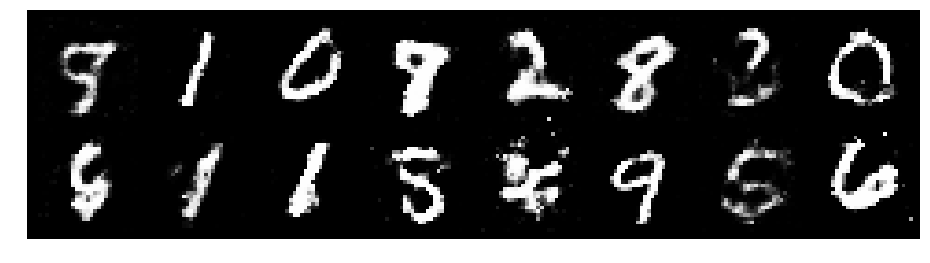

Epoch: [66/200], Batch Num: [100/938]
Discriminator Loss: 1.2611329555511475, Generator Loss: 0.9513499736785889
D(x): 0.5835, D(G(z)): 0.4584


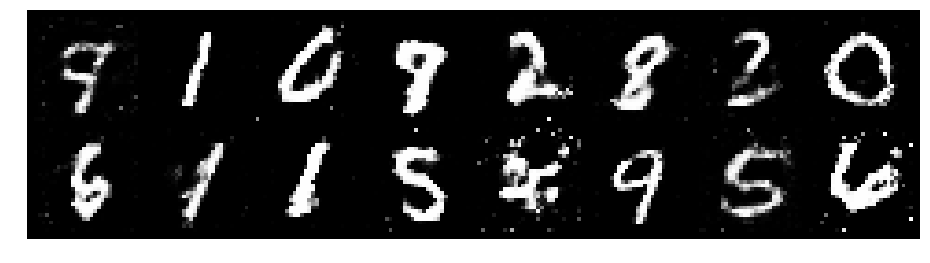

Epoch: [66/200], Batch Num: [200/938]
Discriminator Loss: 1.1618975400924683, Generator Loss: 0.8840079307556152
D(x): 0.5968, D(G(z)): 0.4321


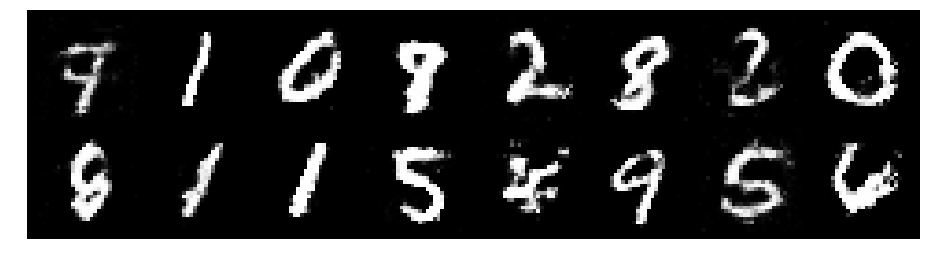

Epoch: [66/200], Batch Num: [300/938]
Discriminator Loss: 1.350813865661621, Generator Loss: 0.9772197008132935
D(x): 0.5366, D(G(z)): 0.4282


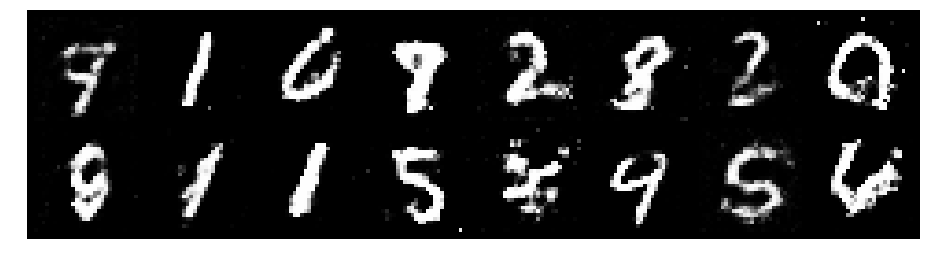

Epoch: [66/200], Batch Num: [400/938]
Discriminator Loss: 1.2816237211227417, Generator Loss: 0.8034383058547974
D(x): 0.5701, D(G(z)): 0.4726


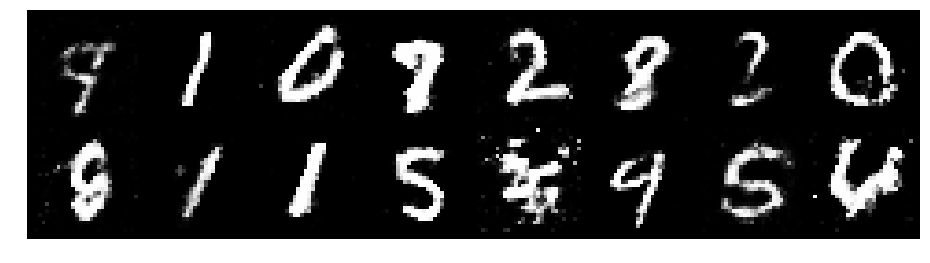

Epoch: [66/200], Batch Num: [500/938]
Discriminator Loss: 1.306257963180542, Generator Loss: 0.9108129739761353
D(x): 0.5582, D(G(z)): 0.4533


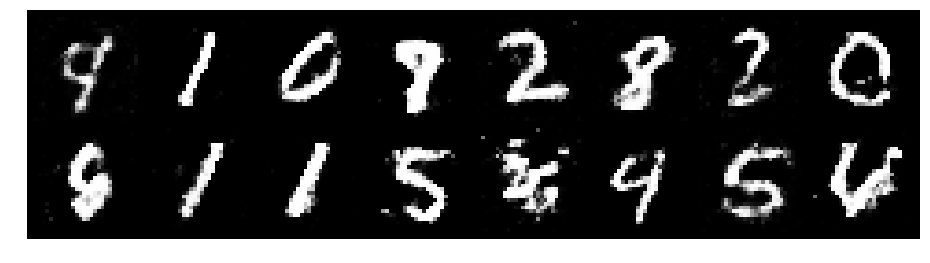

Epoch: [66/200], Batch Num: [600/938]
Discriminator Loss: 1.147363305091858, Generator Loss: 0.9093355536460876
D(x): 0.5879, D(G(z)): 0.4137


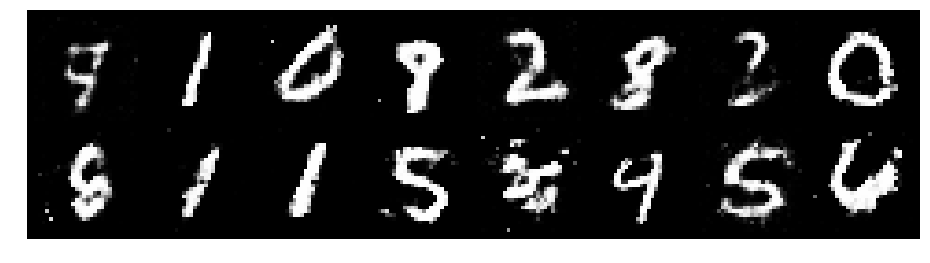

Epoch: [66/200], Batch Num: [700/938]
Discriminator Loss: 1.3185598850250244, Generator Loss: 0.8790557384490967
D(x): 0.5715, D(G(z)): 0.4798


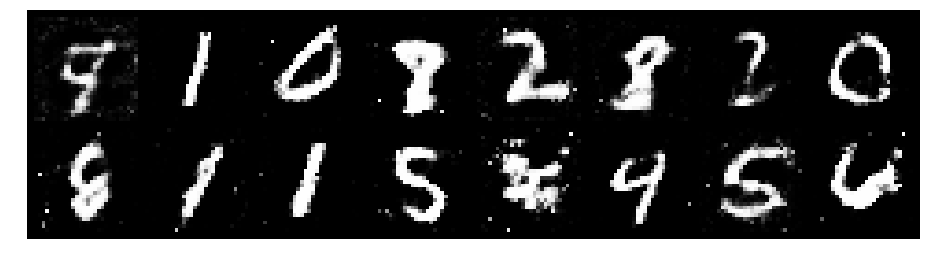

Epoch: [66/200], Batch Num: [800/938]
Discriminator Loss: 1.4164230823516846, Generator Loss: 0.841300904750824
D(x): 0.5067, D(G(z)): 0.4738


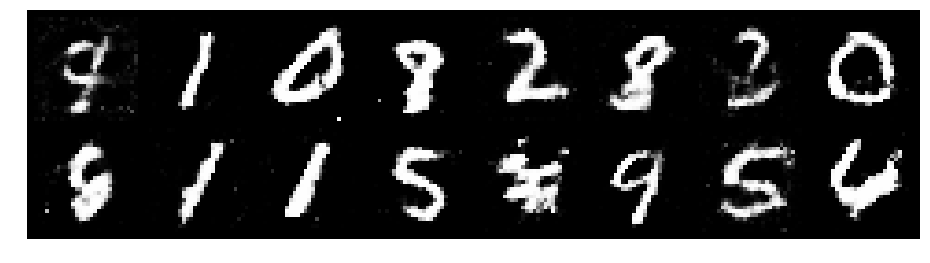

Epoch: [66/200], Batch Num: [900/938]
Discriminator Loss: 1.2806801795959473, Generator Loss: 0.8159293532371521
D(x): 0.5733, D(G(z)): 0.4668


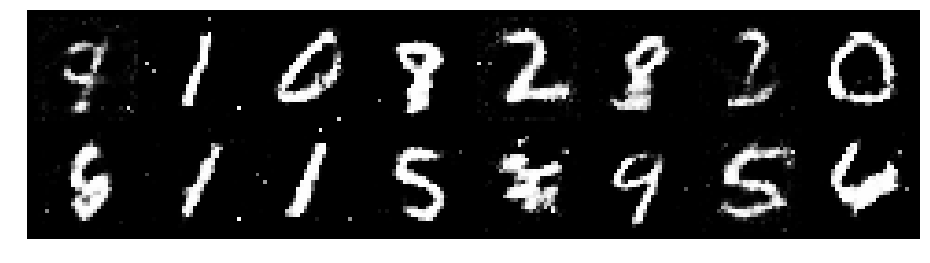

Epoch: [67/200], Batch Num: [0/938]
Discriminator Loss: 1.3121092319488525, Generator Loss: 1.0728994607925415
D(x): 0.5325, D(G(z)): 0.4227


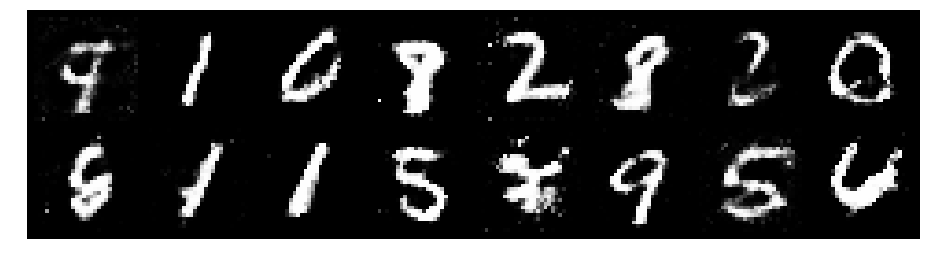

Epoch: [67/200], Batch Num: [100/938]
Discriminator Loss: 1.2681493759155273, Generator Loss: 0.8435083627700806
D(x): 0.5231, D(G(z)): 0.4206


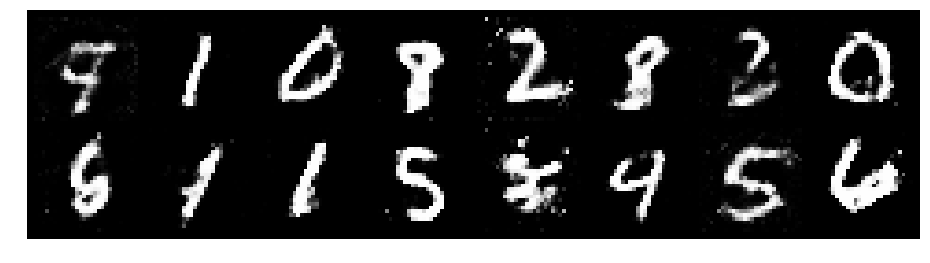

Epoch: [67/200], Batch Num: [200/938]
Discriminator Loss: 1.2828545570373535, Generator Loss: 0.8953527212142944
D(x): 0.5816, D(G(z)): 0.4547


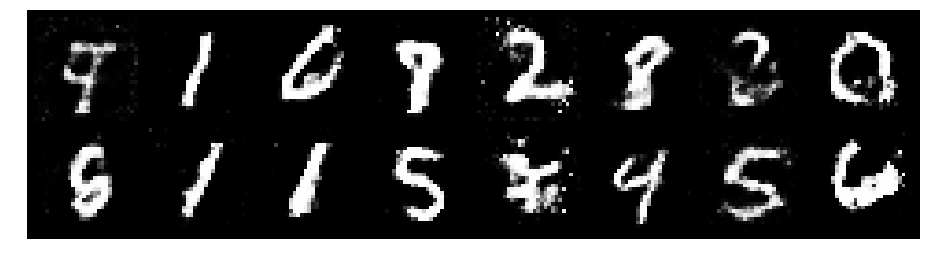

Epoch: [67/200], Batch Num: [300/938]
Discriminator Loss: 1.2087795734405518, Generator Loss: 0.917952299118042
D(x): 0.5883, D(G(z)): 0.4468


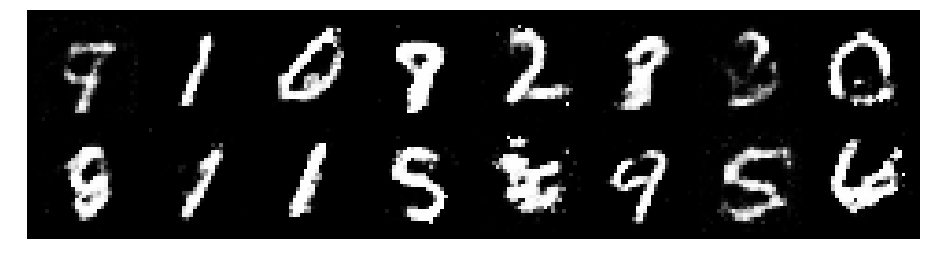

Epoch: [67/200], Batch Num: [400/938]
Discriminator Loss: 1.1663814783096313, Generator Loss: 0.9756532907485962
D(x): 0.5728, D(G(z)): 0.4049


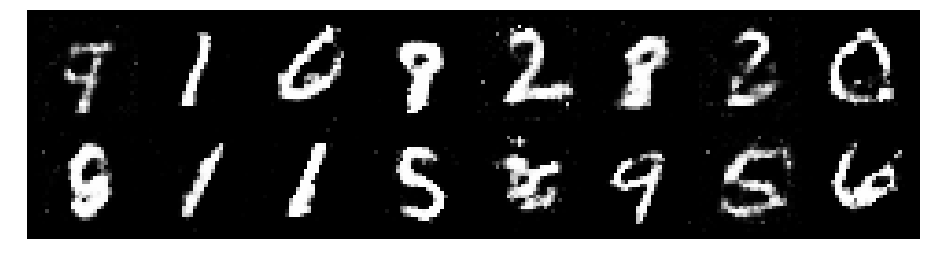

Epoch: [67/200], Batch Num: [500/938]
Discriminator Loss: 1.1003477573394775, Generator Loss: 1.0216232538223267
D(x): 0.5614, D(G(z)): 0.3714


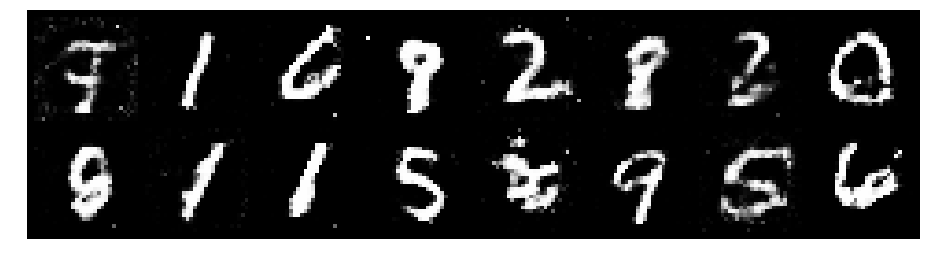

Epoch: [67/200], Batch Num: [600/938]
Discriminator Loss: 1.1487457752227783, Generator Loss: 0.889201283454895
D(x): 0.5672, D(G(z)): 0.4115


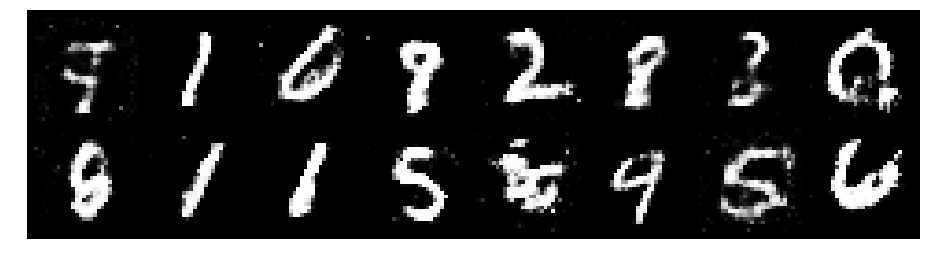

Epoch: [67/200], Batch Num: [700/938]
Discriminator Loss: 1.2461520433425903, Generator Loss: 1.077849268913269
D(x): 0.5744, D(G(z)): 0.4348


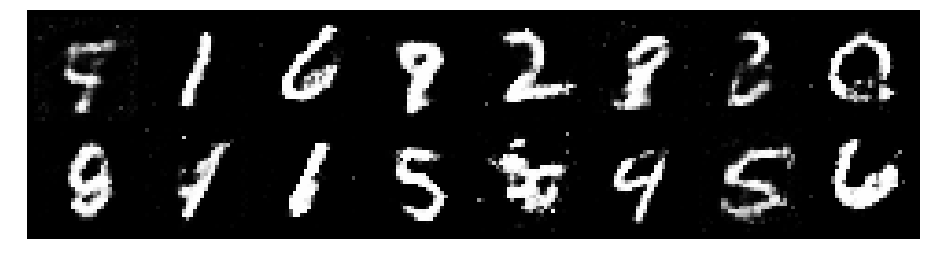

Epoch: [67/200], Batch Num: [800/938]
Discriminator Loss: 1.2632372379302979, Generator Loss: 0.8424814939498901
D(x): 0.5753, D(G(z)): 0.4461


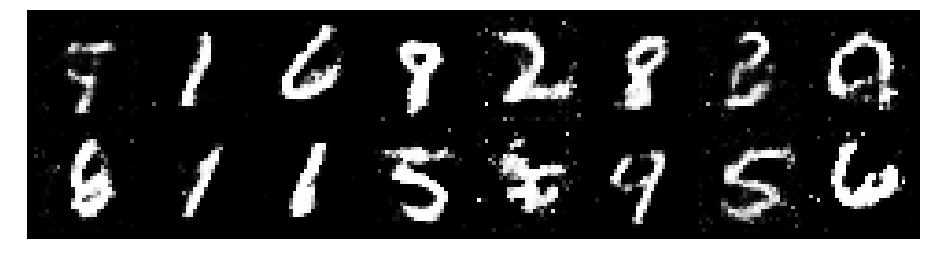

Epoch: [67/200], Batch Num: [900/938]
Discriminator Loss: 1.296827793121338, Generator Loss: 0.9170770049095154
D(x): 0.5422, D(G(z)): 0.4567


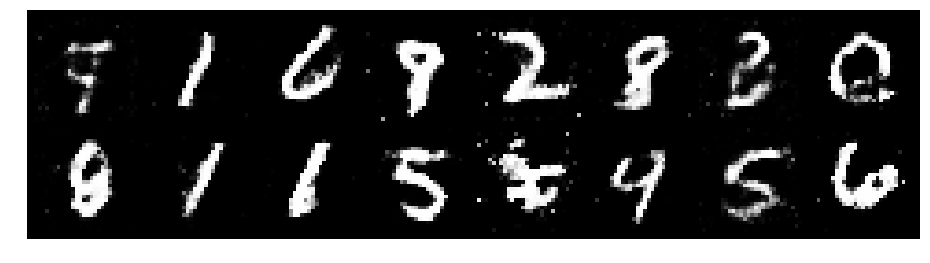

Epoch: [68/200], Batch Num: [0/938]
Discriminator Loss: 1.3463318347930908, Generator Loss: 1.10145902633667
D(x): 0.4876, D(G(z)): 0.3992


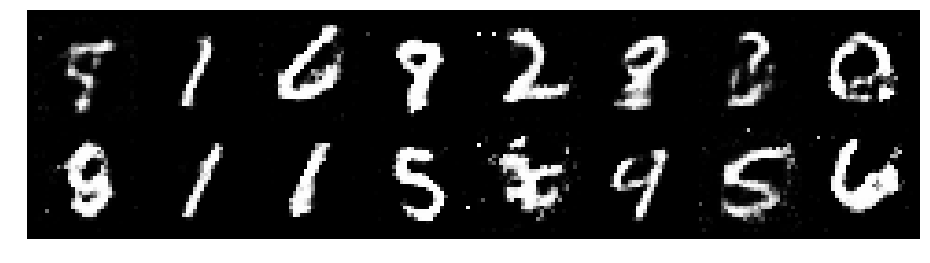

Epoch: [68/200], Batch Num: [100/938]
Discriminator Loss: 1.261820912361145, Generator Loss: 0.8226183652877808
D(x): 0.5470, D(G(z)): 0.4204


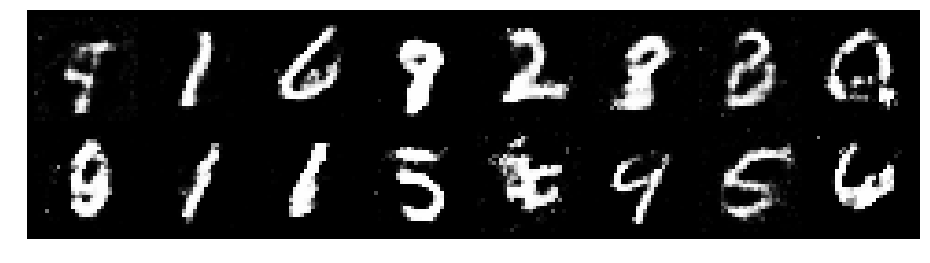

Epoch: [68/200], Batch Num: [200/938]
Discriminator Loss: 1.3719165325164795, Generator Loss: 1.0230090618133545
D(x): 0.5343, D(G(z)): 0.4380


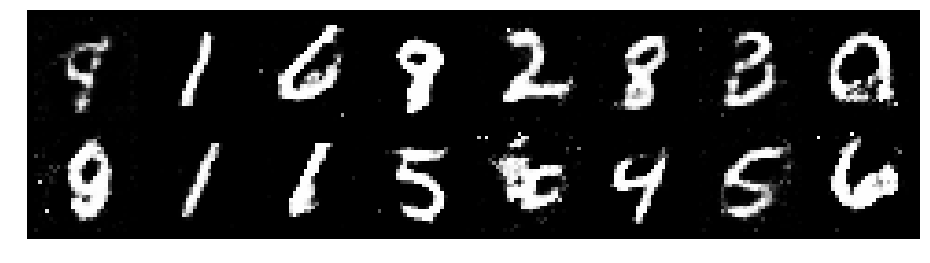

Epoch: [68/200], Batch Num: [300/938]
Discriminator Loss: 1.1926801204681396, Generator Loss: 0.7736175060272217
D(x): 0.6417, D(G(z)): 0.4715


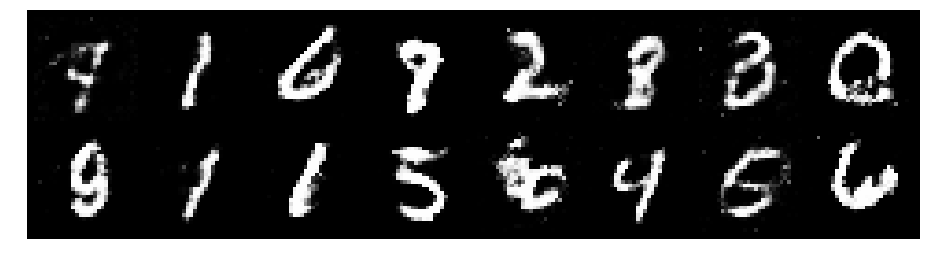

Epoch: [68/200], Batch Num: [400/938]
Discriminator Loss: 1.1915321350097656, Generator Loss: 0.8532278537750244
D(x): 0.6359, D(G(z)): 0.4700


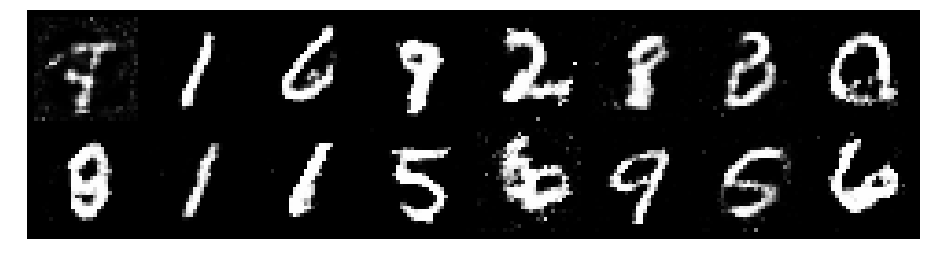

Epoch: [68/200], Batch Num: [500/938]
Discriminator Loss: 1.1806981563568115, Generator Loss: 0.9722316861152649
D(x): 0.5815, D(G(z)): 0.4310


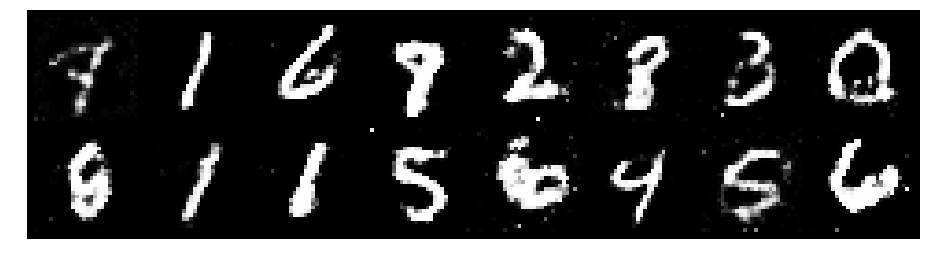

Epoch: [68/200], Batch Num: [600/938]
Discriminator Loss: 1.1989219188690186, Generator Loss: 0.8383716344833374
D(x): 0.5754, D(G(z)): 0.4231


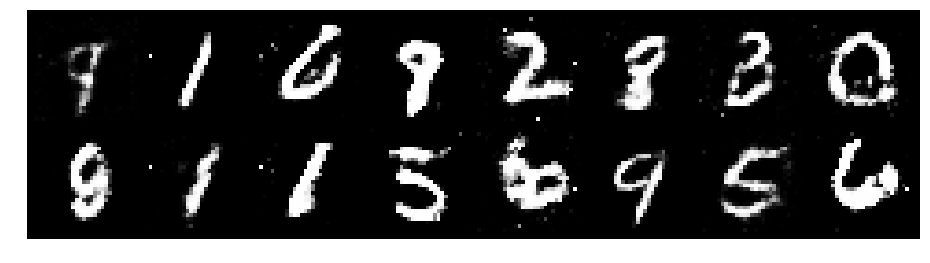

Epoch: [68/200], Batch Num: [700/938]
Discriminator Loss: 1.187479019165039, Generator Loss: 0.9415144324302673
D(x): 0.5969, D(G(z)): 0.4436


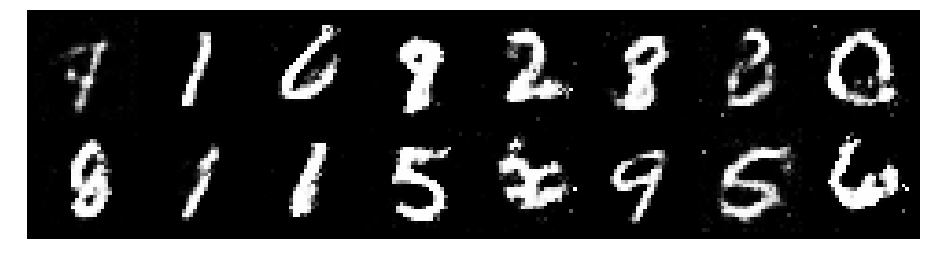

Epoch: [68/200], Batch Num: [800/938]
Discriminator Loss: 1.1772096157073975, Generator Loss: 0.9161378145217896
D(x): 0.5761, D(G(z)): 0.4234


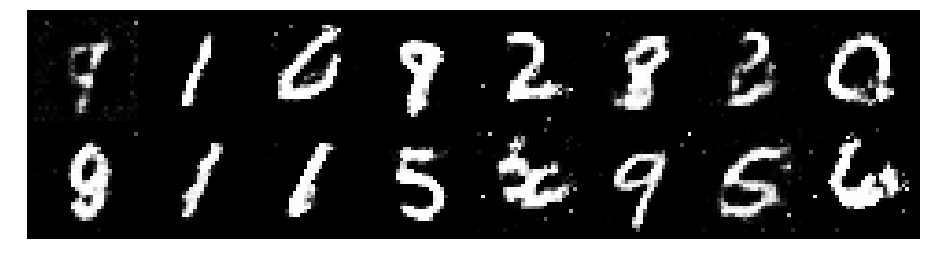

Epoch: [68/200], Batch Num: [900/938]
Discriminator Loss: 1.3474886417388916, Generator Loss: 0.924335241317749
D(x): 0.5195, D(G(z)): 0.4581


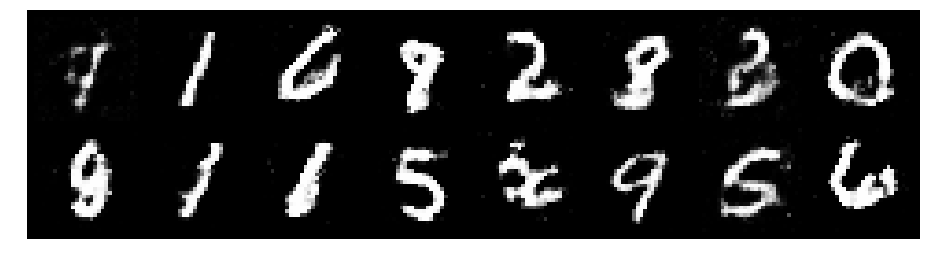

Epoch: [69/200], Batch Num: [0/938]
Discriminator Loss: 1.4012372493743896, Generator Loss: 0.7574337720870972
D(x): 0.5382, D(G(z)): 0.5144


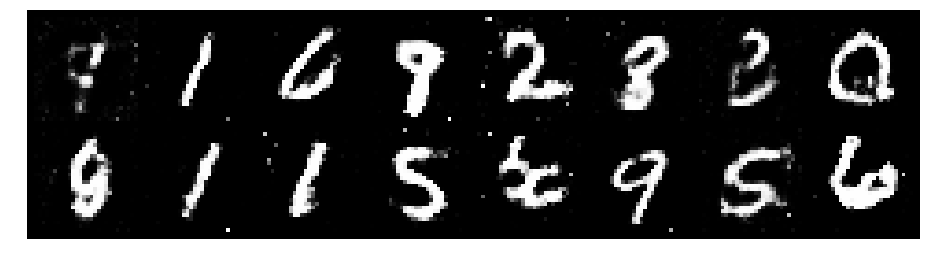

Epoch: [69/200], Batch Num: [100/938]
Discriminator Loss: 1.256441593170166, Generator Loss: 0.987583339214325
D(x): 0.5703, D(G(z)): 0.4415


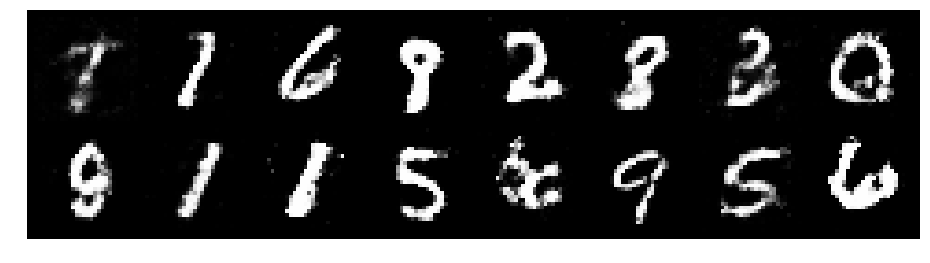

Epoch: [69/200], Batch Num: [200/938]
Discriminator Loss: 1.1806130409240723, Generator Loss: 1.2478420734405518
D(x): 0.6105, D(G(z)): 0.4102


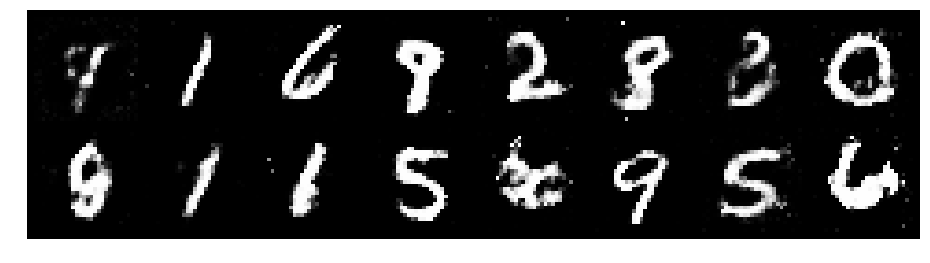

Epoch: [69/200], Batch Num: [300/938]
Discriminator Loss: 1.3952550888061523, Generator Loss: 0.7996231317520142
D(x): 0.5604, D(G(z)): 0.4900


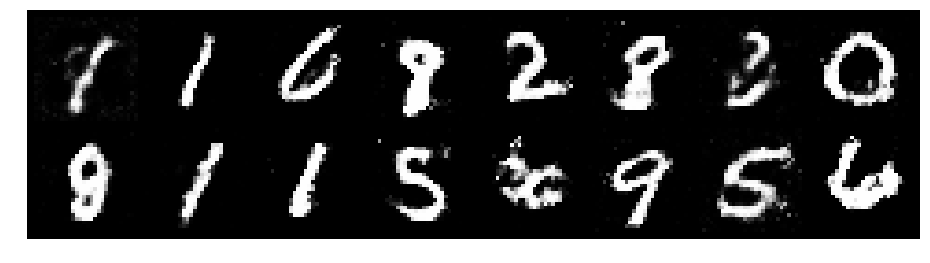

Epoch: [69/200], Batch Num: [400/938]
Discriminator Loss: 1.2489590644836426, Generator Loss: 1.096980094909668
D(x): 0.5459, D(G(z)): 0.4144


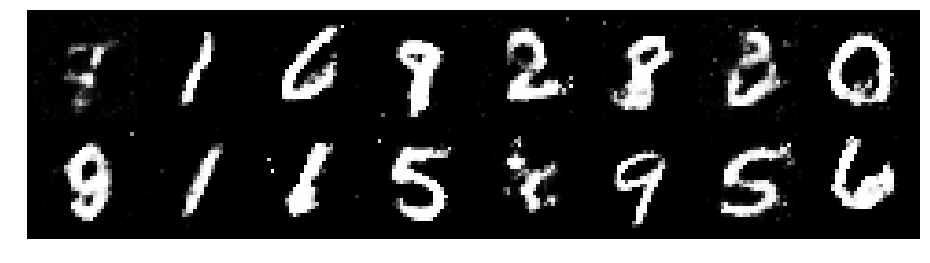

Epoch: [69/200], Batch Num: [500/938]
Discriminator Loss: 1.3971413373947144, Generator Loss: 1.0363807678222656
D(x): 0.5348, D(G(z)): 0.4324


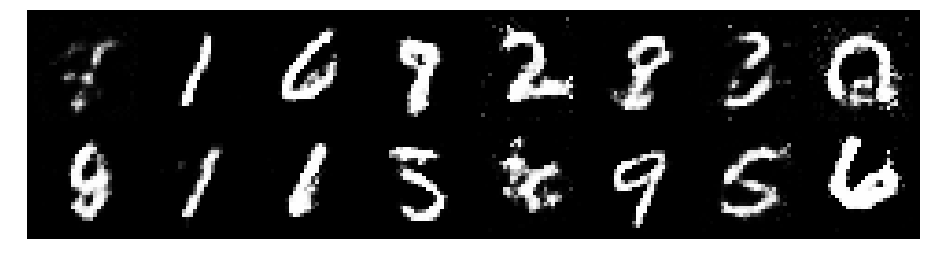

Epoch: [69/200], Batch Num: [600/938]
Discriminator Loss: 1.2899131774902344, Generator Loss: 0.9982025623321533
D(x): 0.5799, D(G(z)): 0.4492


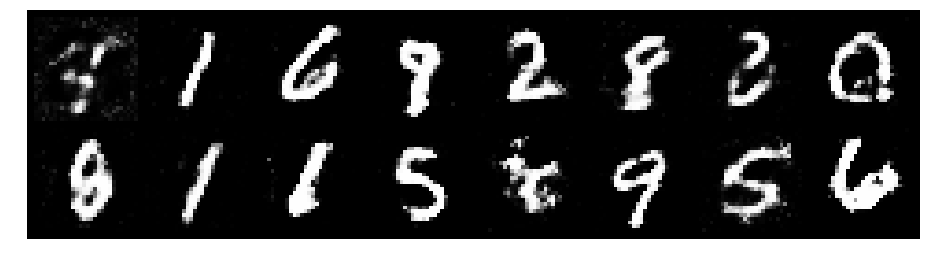

Epoch: [69/200], Batch Num: [700/938]
Discriminator Loss: 1.3131349086761475, Generator Loss: 0.9453650712966919
D(x): 0.5463, D(G(z)): 0.4290


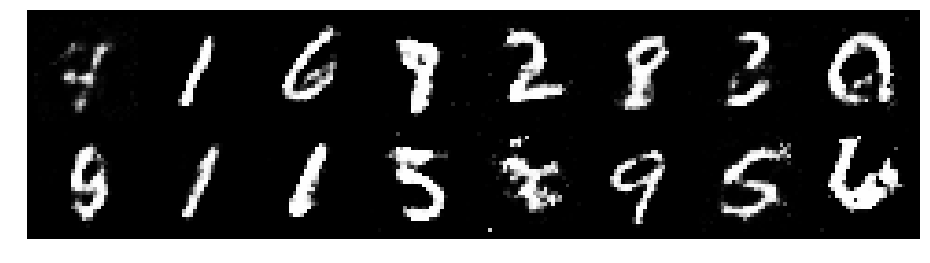

Epoch: [69/200], Batch Num: [800/938]
Discriminator Loss: 1.342233419418335, Generator Loss: 0.8975555300712585
D(x): 0.5708, D(G(z)): 0.4919


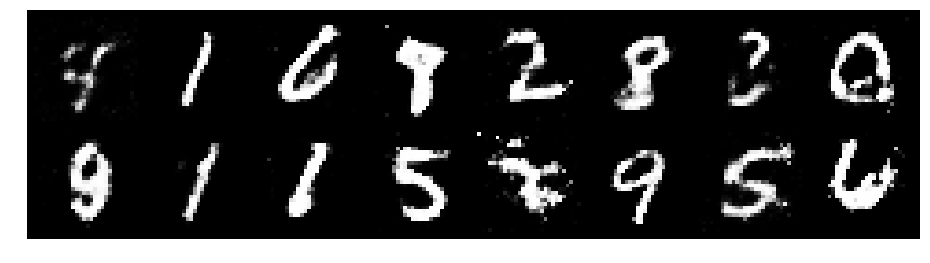

Epoch: [69/200], Batch Num: [900/938]
Discriminator Loss: 1.2626644372940063, Generator Loss: 0.7568460702896118
D(x): 0.5965, D(G(z)): 0.4876


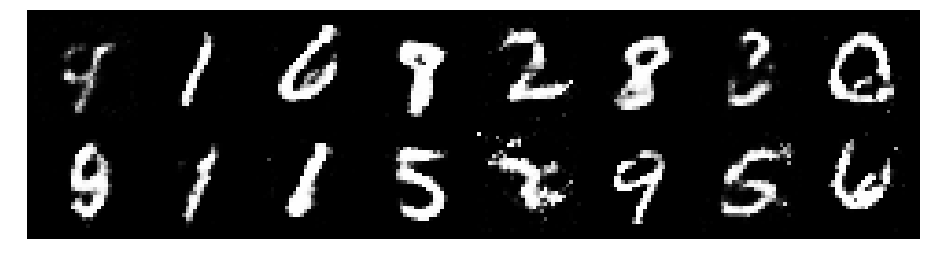

Epoch: [70/200], Batch Num: [0/938]
Discriminator Loss: 1.1642146110534668, Generator Loss: 0.8045667409896851
D(x): 0.6030, D(G(z)): 0.4297


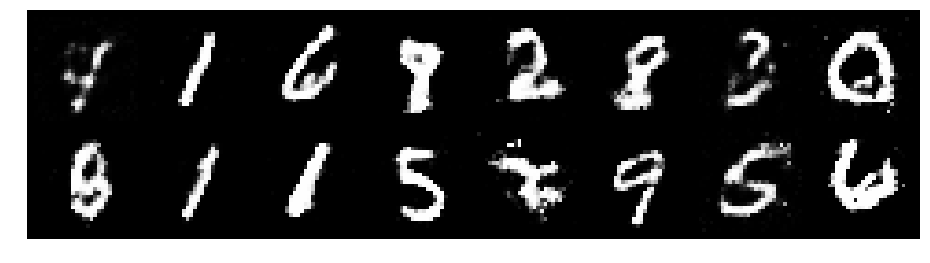

Epoch: [70/200], Batch Num: [100/938]
Discriminator Loss: 1.2502162456512451, Generator Loss: 0.7943837642669678
D(x): 0.5986, D(G(z)): 0.4634


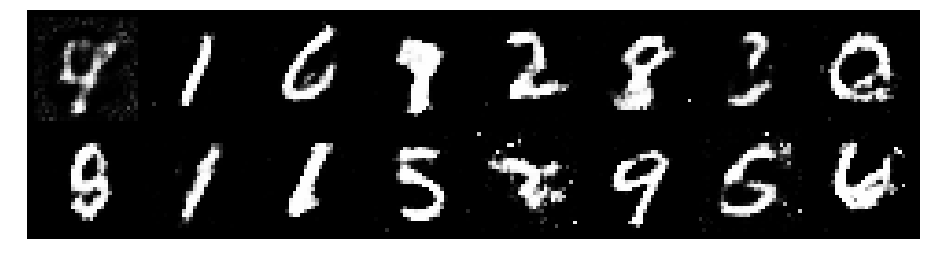

Epoch: [70/200], Batch Num: [200/938]
Discriminator Loss: 1.2671678066253662, Generator Loss: 0.8159589767456055
D(x): 0.5338, D(G(z)): 0.4177


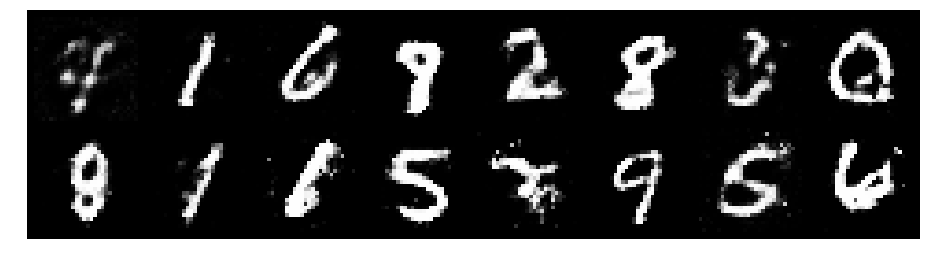

Epoch: [70/200], Batch Num: [300/938]
Discriminator Loss: 1.1044774055480957, Generator Loss: 0.9855712652206421
D(x): 0.6064, D(G(z)): 0.4089


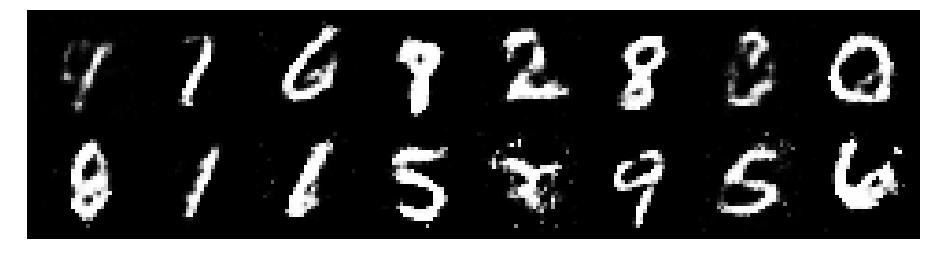

Epoch: [70/200], Batch Num: [400/938]
Discriminator Loss: 1.3491237163543701, Generator Loss: 0.7448281645774841
D(x): 0.5749, D(G(z)): 0.5015


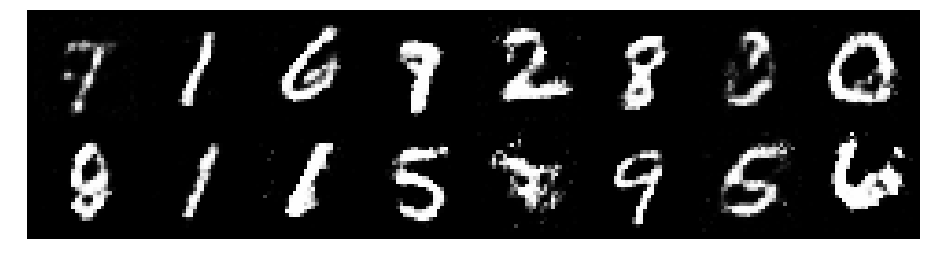

Epoch: [70/200], Batch Num: [500/938]
Discriminator Loss: 1.3041722774505615, Generator Loss: 1.0092508792877197
D(x): 0.5785, D(G(z)): 0.4942


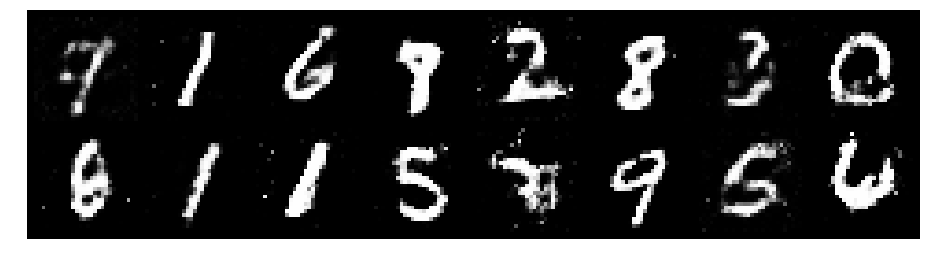

Epoch: [70/200], Batch Num: [600/938]
Discriminator Loss: 1.271272897720337, Generator Loss: 1.032546043395996
D(x): 0.4766, D(G(z)): 0.3808


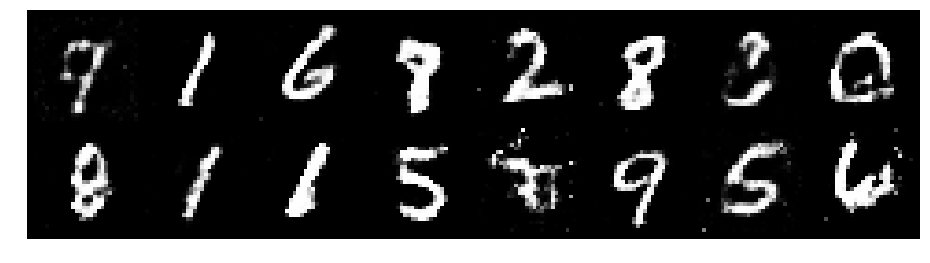

Epoch: [70/200], Batch Num: [700/938]
Discriminator Loss: 1.4004557132720947, Generator Loss: 0.9156243801116943
D(x): 0.4888, D(G(z)): 0.4421


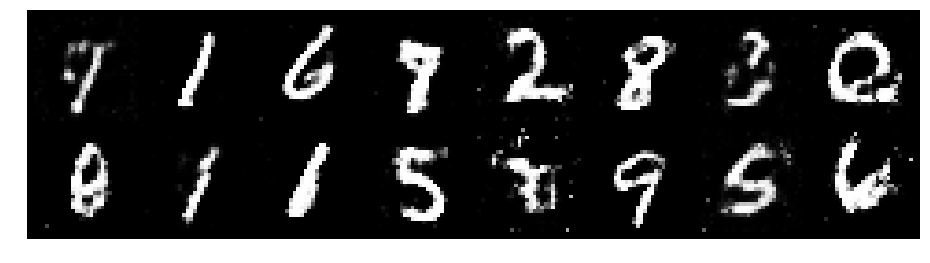

Epoch: [70/200], Batch Num: [800/938]
Discriminator Loss: 1.2925381660461426, Generator Loss: 0.7651140689849854
D(x): 0.5442, D(G(z)): 0.4576


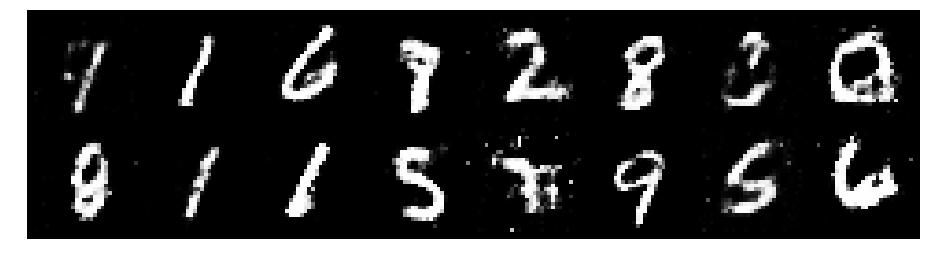

Epoch: [70/200], Batch Num: [900/938]
Discriminator Loss: 1.3247501850128174, Generator Loss: 0.8873717188835144
D(x): 0.5647, D(G(z)): 0.4756


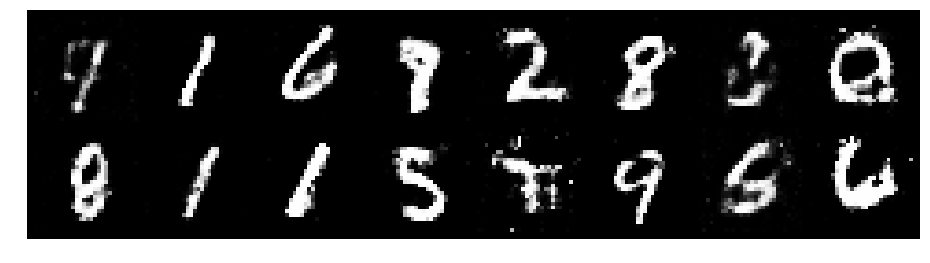

Epoch: [71/200], Batch Num: [0/938]
Discriminator Loss: 1.1501045227050781, Generator Loss: 0.9541255235671997
D(x): 0.5720, D(G(z)): 0.4072


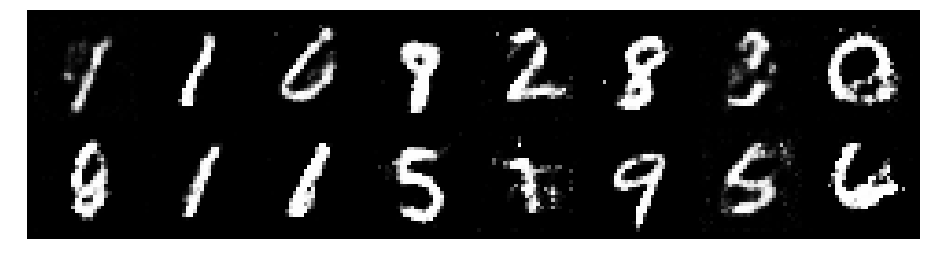

Epoch: [71/200], Batch Num: [100/938]
Discriminator Loss: 1.1766080856323242, Generator Loss: 1.0612527132034302
D(x): 0.5897, D(G(z)): 0.4198


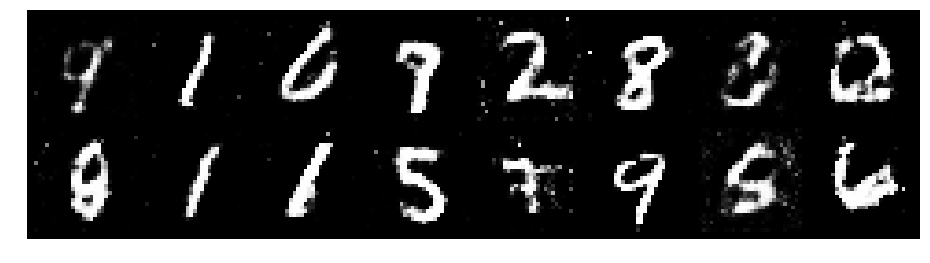

Epoch: [71/200], Batch Num: [200/938]
Discriminator Loss: 1.2729390859603882, Generator Loss: 0.8263477087020874
D(x): 0.5483, D(G(z)): 0.4589


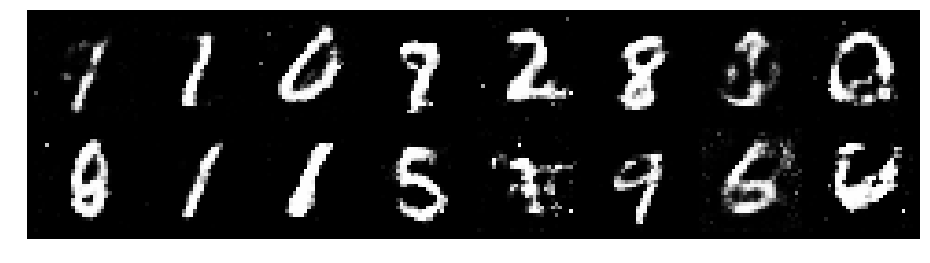

Epoch: [71/200], Batch Num: [300/938]
Discriminator Loss: 1.2910124063491821, Generator Loss: 0.7620970010757446
D(x): 0.5660, D(G(z)): 0.4687


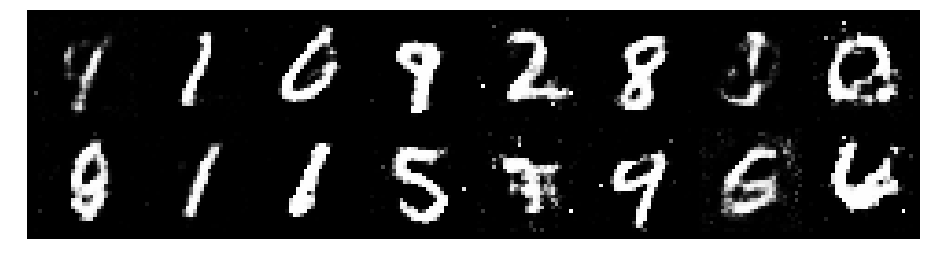

Epoch: [71/200], Batch Num: [400/938]
Discriminator Loss: 1.36287260055542, Generator Loss: 0.8951570987701416
D(x): 0.5470, D(G(z)): 0.4710


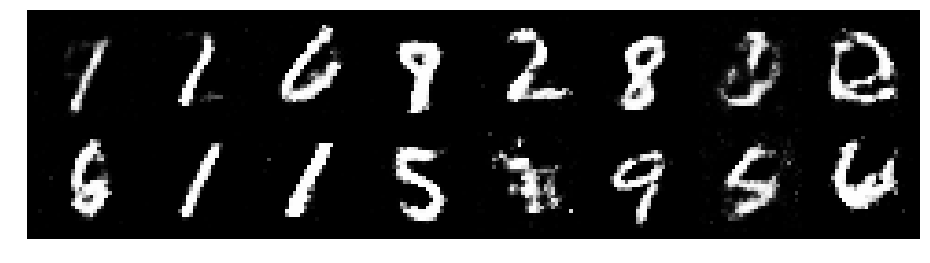

Epoch: [71/200], Batch Num: [500/938]
Discriminator Loss: 1.2083714008331299, Generator Loss: 0.8737709522247314
D(x): 0.5709, D(G(z)): 0.4264


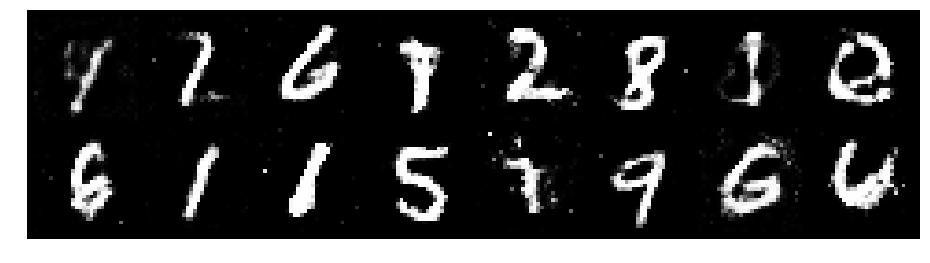

Epoch: [71/200], Batch Num: [600/938]
Discriminator Loss: 1.3194615840911865, Generator Loss: 1.0148024559020996
D(x): 0.5722, D(G(z)): 0.4708


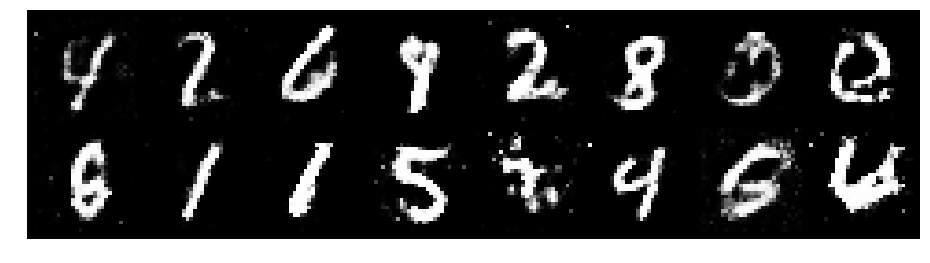

Epoch: [71/200], Batch Num: [700/938]
Discriminator Loss: 1.2274709939956665, Generator Loss: 0.9547762870788574
D(x): 0.5557, D(G(z)): 0.4183


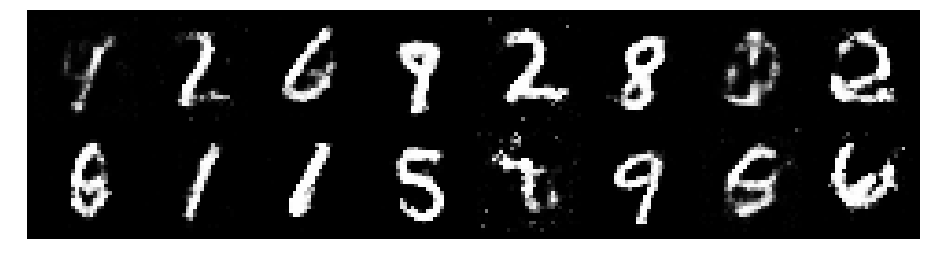

Epoch: [71/200], Batch Num: [800/938]
Discriminator Loss: 1.2490298748016357, Generator Loss: 0.7014451622962952
D(x): 0.5922, D(G(z)): 0.4867


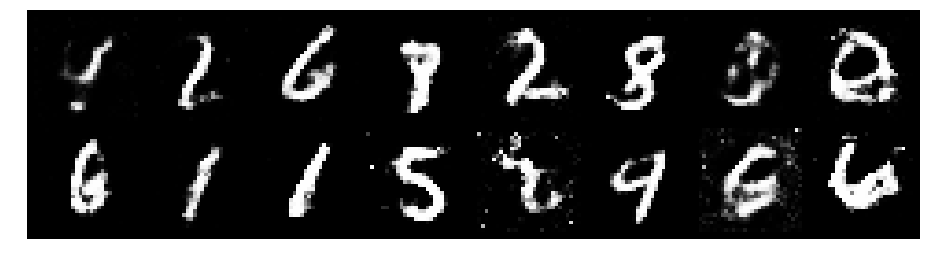

Epoch: [71/200], Batch Num: [900/938]
Discriminator Loss: 1.3517169952392578, Generator Loss: 0.8382471799850464
D(x): 0.5335, D(G(z)): 0.4753


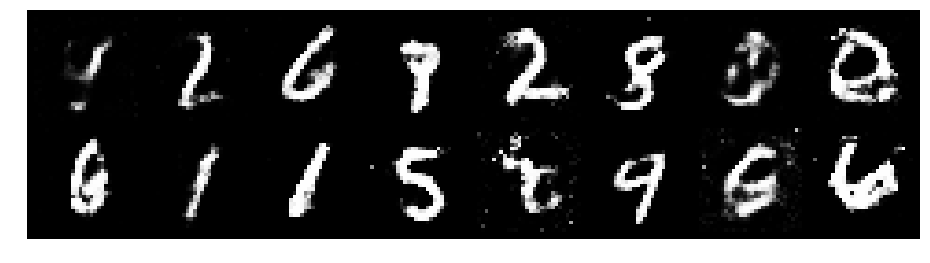

Epoch: [72/200], Batch Num: [0/938]
Discriminator Loss: 1.1615114212036133, Generator Loss: 1.2268842458724976
D(x): 0.5381, D(G(z)): 0.3579


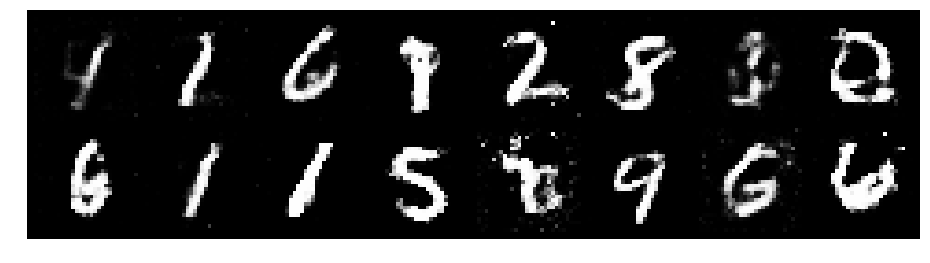

Epoch: [72/200], Batch Num: [100/938]
Discriminator Loss: 1.2515603303909302, Generator Loss: 1.0118322372436523
D(x): 0.5646, D(G(z)): 0.4281


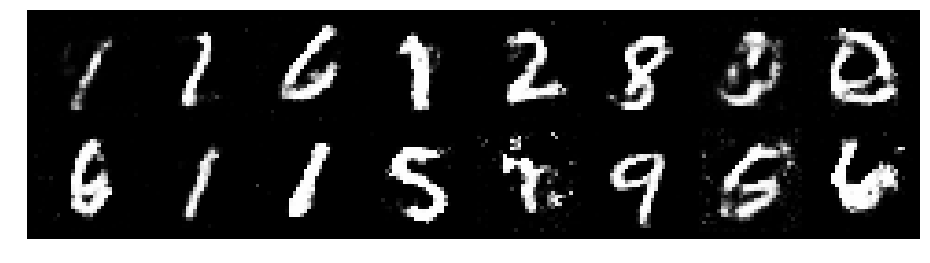

Epoch: [72/200], Batch Num: [200/938]
Discriminator Loss: 1.2482417821884155, Generator Loss: 0.8729064464569092
D(x): 0.5311, D(G(z)): 0.4201


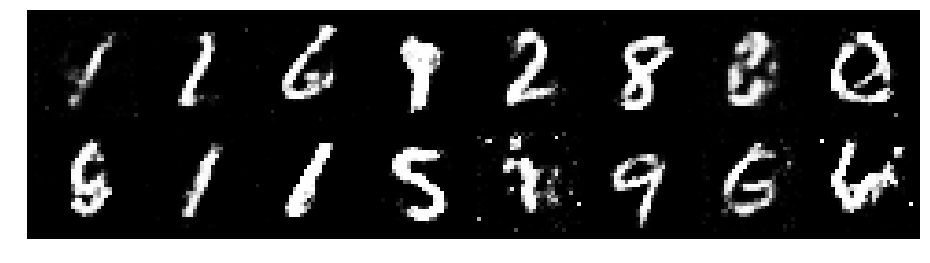

Epoch: [72/200], Batch Num: [300/938]
Discriminator Loss: 1.2608036994934082, Generator Loss: 0.9786743521690369
D(x): 0.5503, D(G(z)): 0.4546


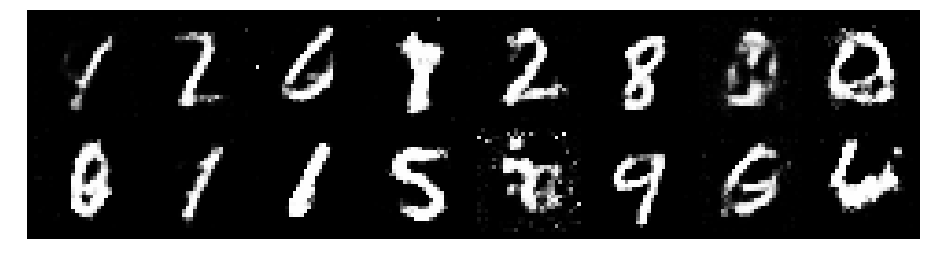

Epoch: [72/200], Batch Num: [400/938]
Discriminator Loss: 1.1917715072631836, Generator Loss: 0.9930567741394043
D(x): 0.5863, D(G(z)): 0.4094


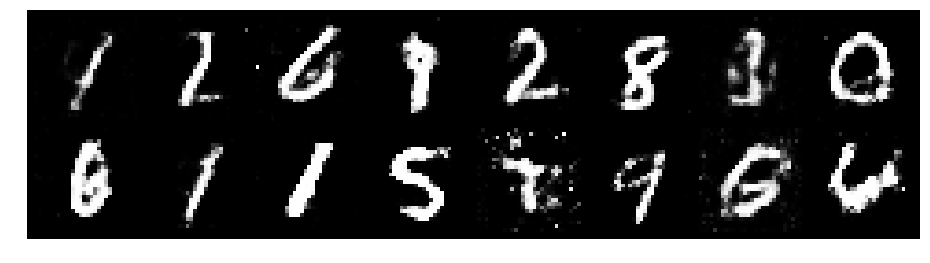

Epoch: [72/200], Batch Num: [500/938]
Discriminator Loss: 1.2160049676895142, Generator Loss: 0.776333212852478
D(x): 0.5944, D(G(z)): 0.4579


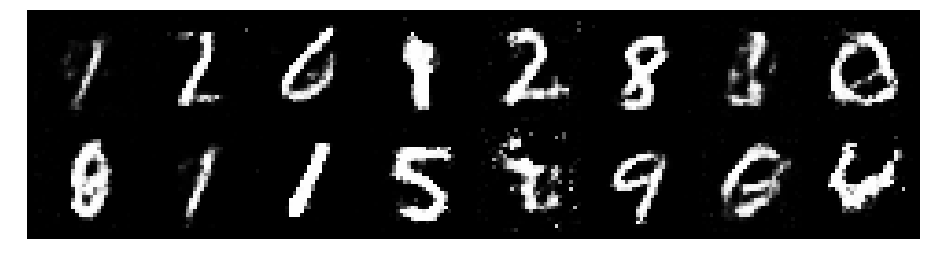

Epoch: [72/200], Batch Num: [600/938]
Discriminator Loss: 1.2862176895141602, Generator Loss: 0.8594074249267578
D(x): 0.5215, D(G(z)): 0.4415


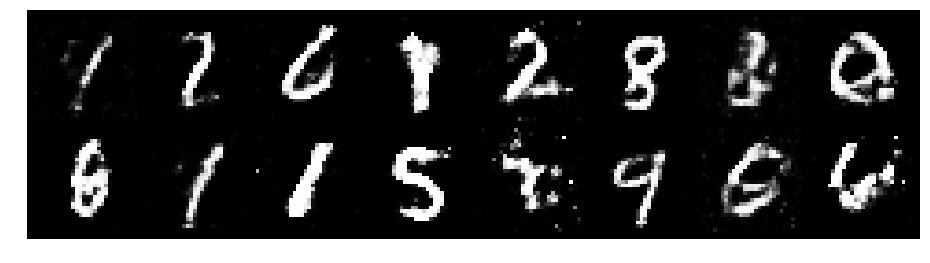

Epoch: [72/200], Batch Num: [700/938]
Discriminator Loss: 1.249662160873413, Generator Loss: 0.8000526428222656
D(x): 0.5374, D(G(z)): 0.4372


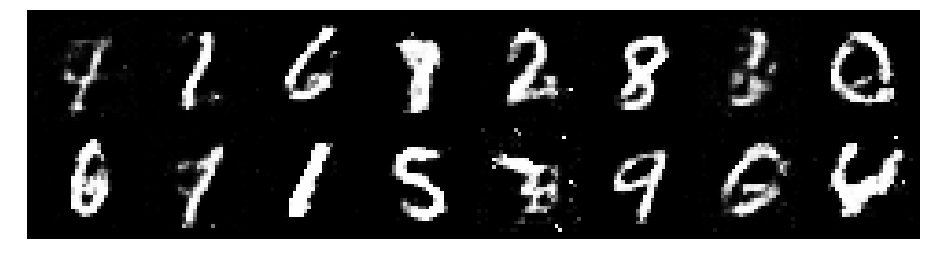

Epoch: [72/200], Batch Num: [800/938]
Discriminator Loss: 1.3589277267456055, Generator Loss: 0.826224684715271
D(x): 0.4916, D(G(z)): 0.4359


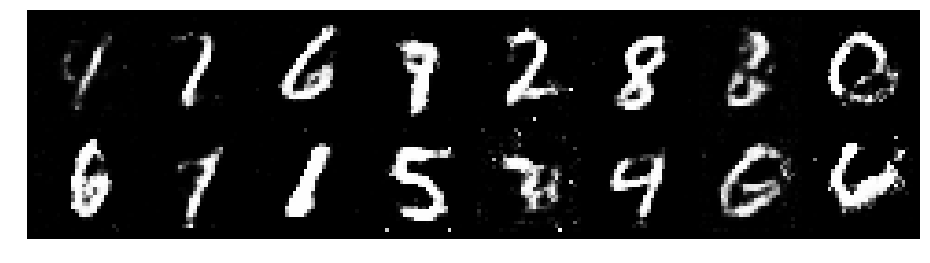

Epoch: [72/200], Batch Num: [900/938]
Discriminator Loss: 1.4456908702850342, Generator Loss: 0.8048871159553528
D(x): 0.5248, D(G(z)): 0.4909


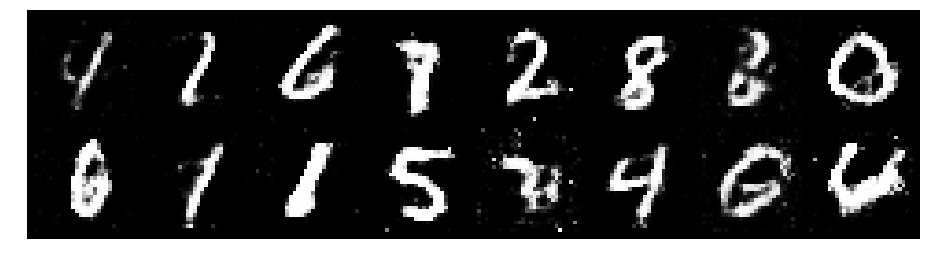

Epoch: [73/200], Batch Num: [0/938]
Discriminator Loss: 1.212497353553772, Generator Loss: 0.9018238186836243
D(x): 0.6286, D(G(z)): 0.4725


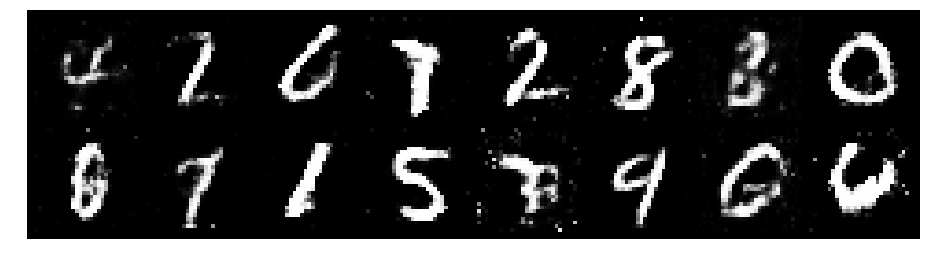

Epoch: [73/200], Batch Num: [100/938]
Discriminator Loss: 1.144877552986145, Generator Loss: 1.081615686416626
D(x): 0.5824, D(G(z)): 0.3955


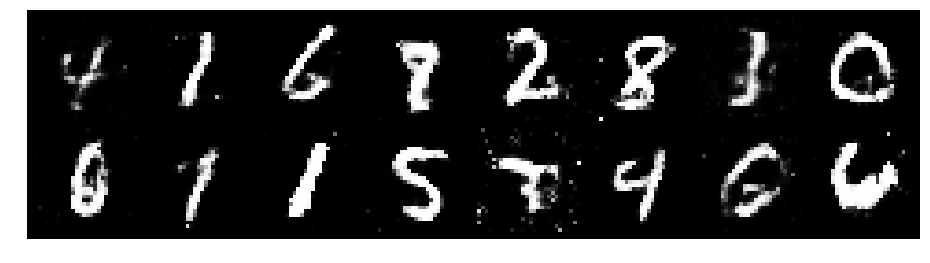

Epoch: [73/200], Batch Num: [200/938]
Discriminator Loss: 1.3600668907165527, Generator Loss: 0.8912614583969116
D(x): 0.5231, D(G(z)): 0.4456


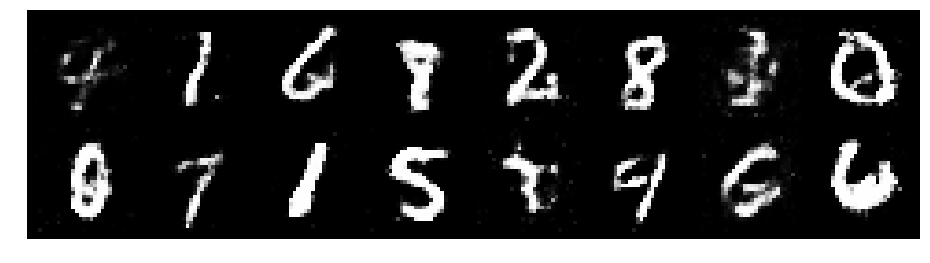

Epoch: [73/200], Batch Num: [300/938]
Discriminator Loss: 1.2588961124420166, Generator Loss: 0.8731086850166321
D(x): 0.5762, D(G(z)): 0.4837


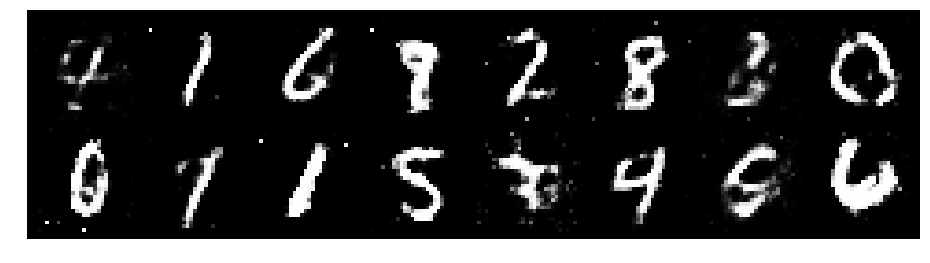

Epoch: [73/200], Batch Num: [400/938]
Discriminator Loss: 1.378160834312439, Generator Loss: 0.8408336639404297
D(x): 0.5237, D(G(z)): 0.4635


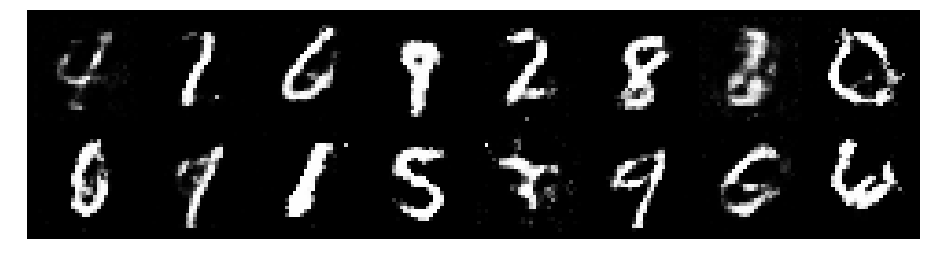

Epoch: [73/200], Batch Num: [500/938]
Discriminator Loss: 1.2417360544204712, Generator Loss: 0.9576260447502136
D(x): 0.5323, D(G(z)): 0.4086


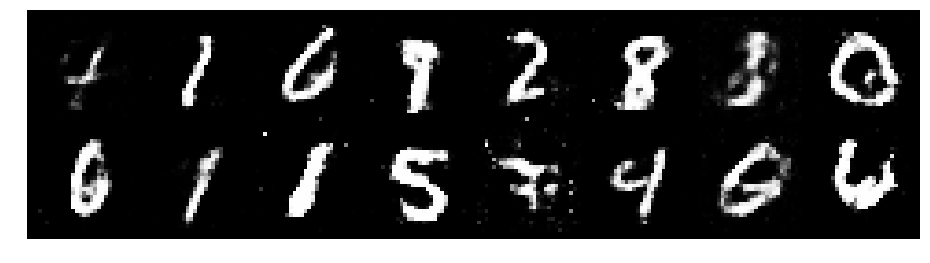

Epoch: [73/200], Batch Num: [600/938]
Discriminator Loss: 1.2960875034332275, Generator Loss: 1.0798616409301758
D(x): 0.5052, D(G(z)): 0.3961


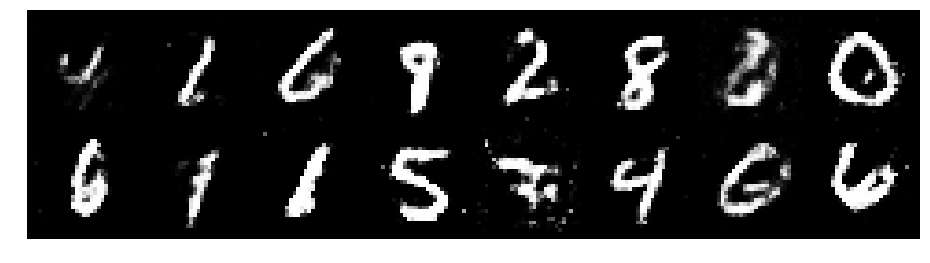

Epoch: [73/200], Batch Num: [700/938]
Discriminator Loss: 1.2091528177261353, Generator Loss: 0.7744516134262085
D(x): 0.5662, D(G(z)): 0.4472


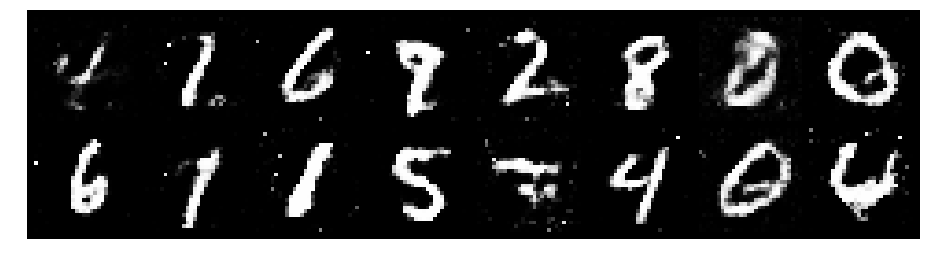

Epoch: [73/200], Batch Num: [800/938]
Discriminator Loss: 1.2686684131622314, Generator Loss: 0.841587245464325
D(x): 0.5694, D(G(z)): 0.4407


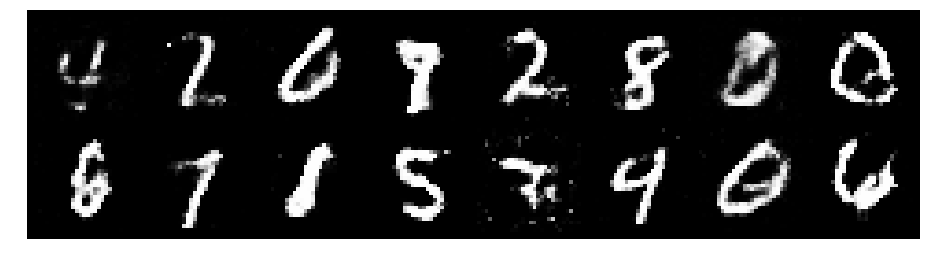

Epoch: [73/200], Batch Num: [900/938]
Discriminator Loss: 1.3292982578277588, Generator Loss: 0.8854230642318726
D(x): 0.5493, D(G(z)): 0.4475


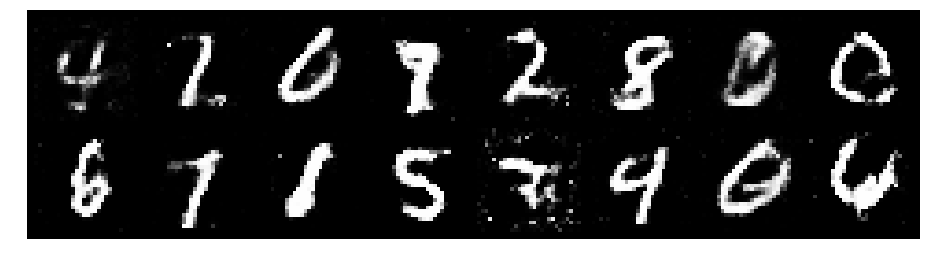

Epoch: [74/200], Batch Num: [0/938]
Discriminator Loss: 1.3636367321014404, Generator Loss: 0.9274884462356567
D(x): 0.5719, D(G(z)): 0.4853


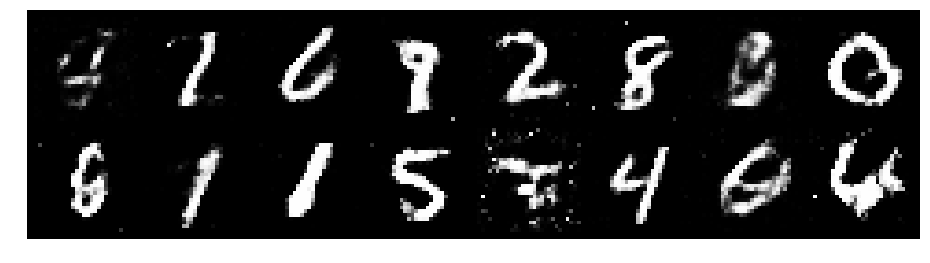

Epoch: [74/200], Batch Num: [100/938]
Discriminator Loss: 1.2328970432281494, Generator Loss: 1.0362093448638916
D(x): 0.5801, D(G(z)): 0.4384


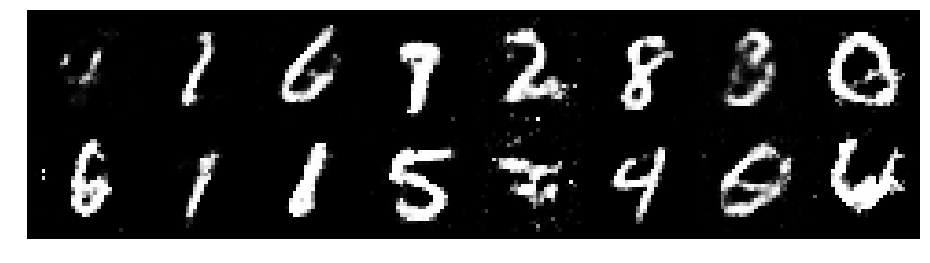

Epoch: [74/200], Batch Num: [200/938]
Discriminator Loss: 1.1006016731262207, Generator Loss: 0.9107234477996826
D(x): 0.5968, D(G(z)): 0.3904


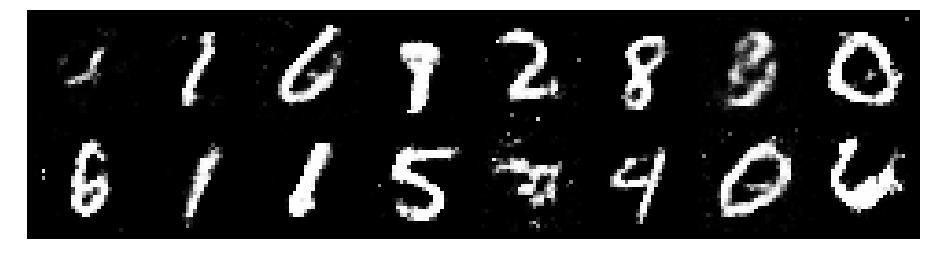

Epoch: [74/200], Batch Num: [300/938]
Discriminator Loss: 1.2623233795166016, Generator Loss: 0.850254476070404
D(x): 0.5348, D(G(z)): 0.3966


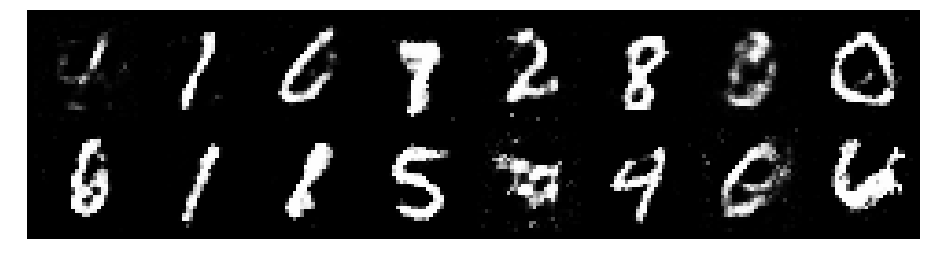

Epoch: [74/200], Batch Num: [400/938]
Discriminator Loss: 1.2255463600158691, Generator Loss: 0.7727642059326172
D(x): 0.5547, D(G(z)): 0.4409


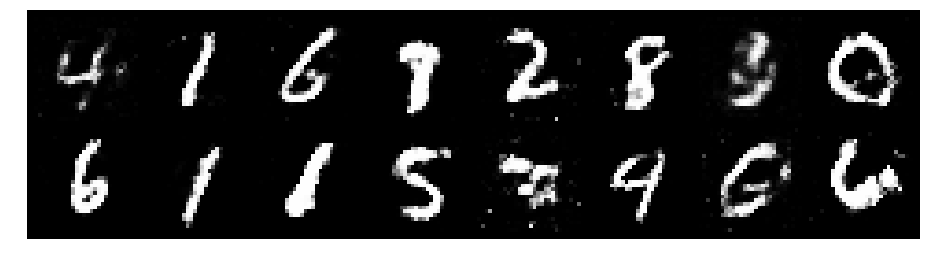

Epoch: [74/200], Batch Num: [500/938]
Discriminator Loss: 1.1407034397125244, Generator Loss: 0.8728349208831787
D(x): 0.6169, D(G(z)): 0.4361


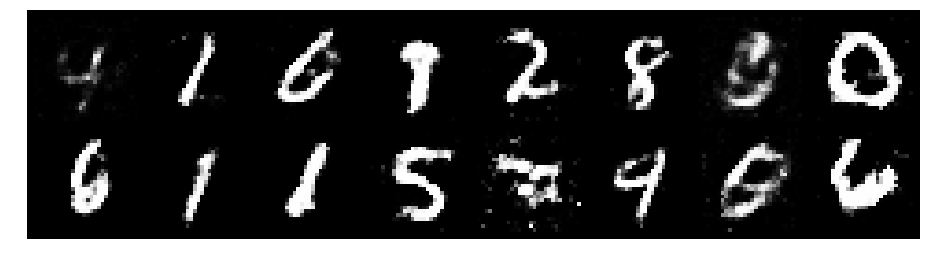

Epoch: [74/200], Batch Num: [600/938]
Discriminator Loss: 1.3799203634262085, Generator Loss: 0.9707299470901489
D(x): 0.5038, D(G(z)): 0.4311


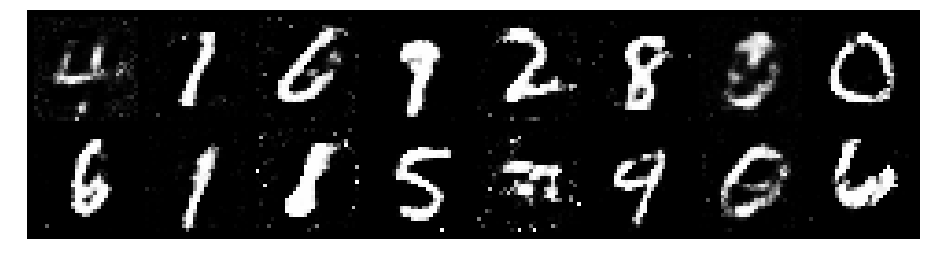

Epoch: [74/200], Batch Num: [700/938]
Discriminator Loss: 1.1332738399505615, Generator Loss: 1.0951273441314697
D(x): 0.5810, D(G(z)): 0.4025


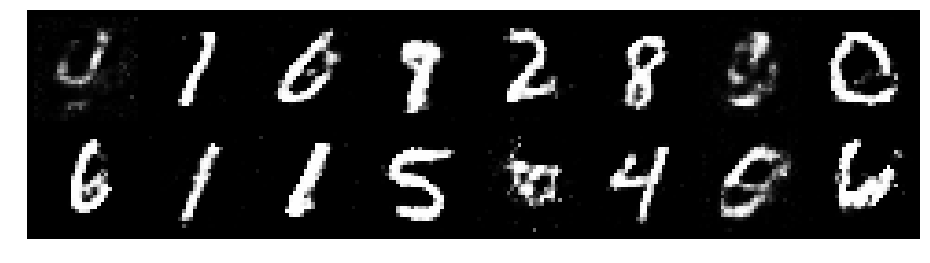

Epoch: [74/200], Batch Num: [800/938]
Discriminator Loss: 1.1413116455078125, Generator Loss: 1.1346827745437622
D(x): 0.5298, D(G(z)): 0.3471


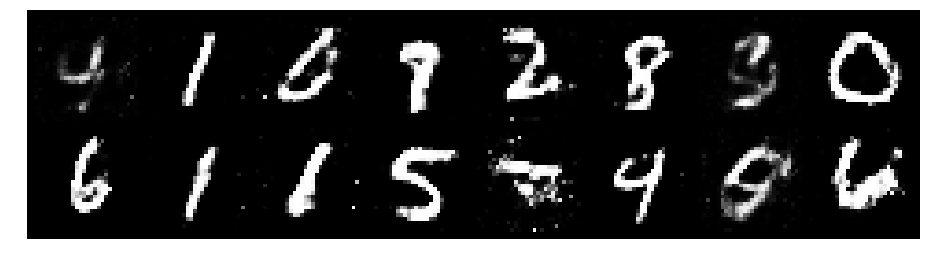

Epoch: [74/200], Batch Num: [900/938]
Discriminator Loss: 1.2884564399719238, Generator Loss: 0.8508075475692749
D(x): 0.5555, D(G(z)): 0.4498


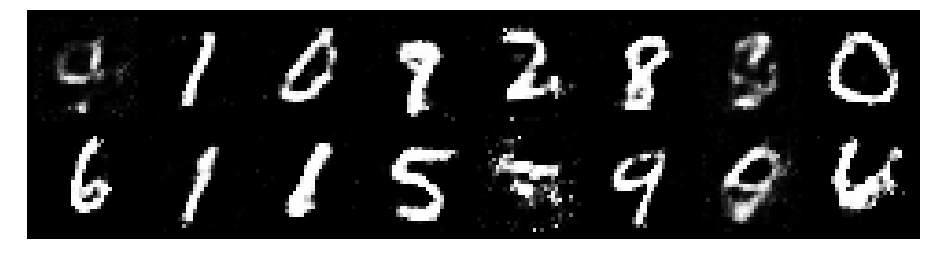

Epoch: [75/200], Batch Num: [0/938]
Discriminator Loss: 1.3204820156097412, Generator Loss: 0.8342764377593994
D(x): 0.5641, D(G(z)): 0.4777


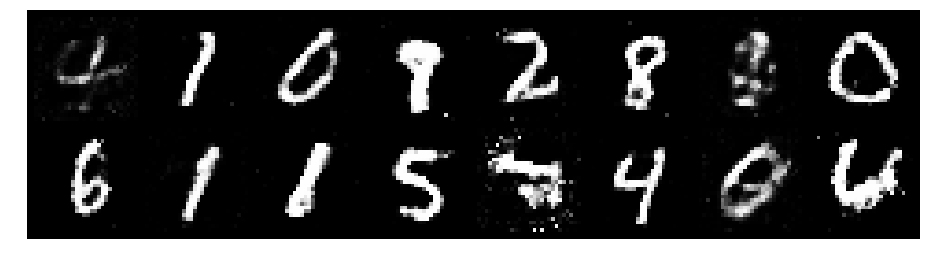

Epoch: [75/200], Batch Num: [100/938]
Discriminator Loss: 1.2293366193771362, Generator Loss: 0.9846305251121521
D(x): 0.5691, D(G(z)): 0.4113


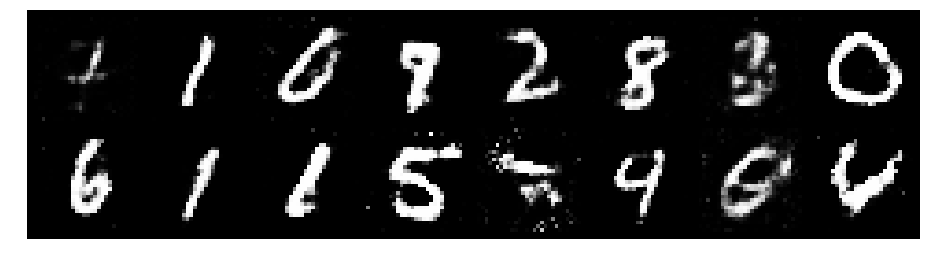

Epoch: [75/200], Batch Num: [200/938]
Discriminator Loss: 1.180332899093628, Generator Loss: 0.8708759546279907
D(x): 0.5870, D(G(z)): 0.4320


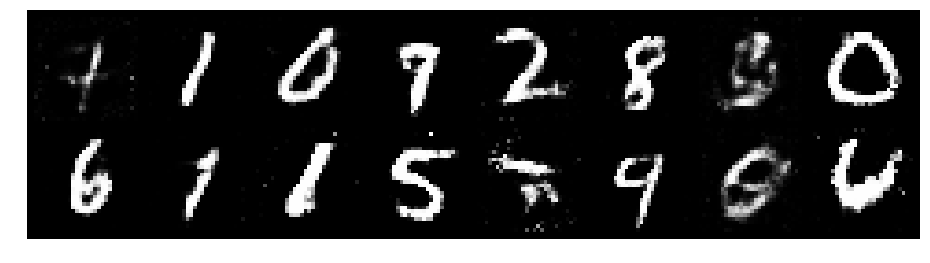

Epoch: [75/200], Batch Num: [300/938]
Discriminator Loss: 1.1283363103866577, Generator Loss: 1.0475904941558838
D(x): 0.5925, D(G(z)): 0.3931


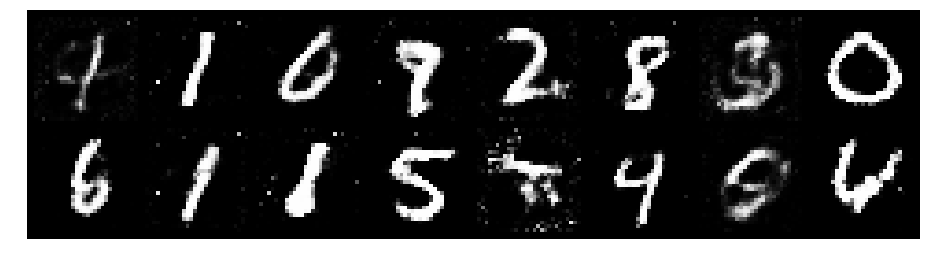

Epoch: [75/200], Batch Num: [400/938]
Discriminator Loss: 1.2739125490188599, Generator Loss: 0.8576981425285339
D(x): 0.5547, D(G(z)): 0.4281


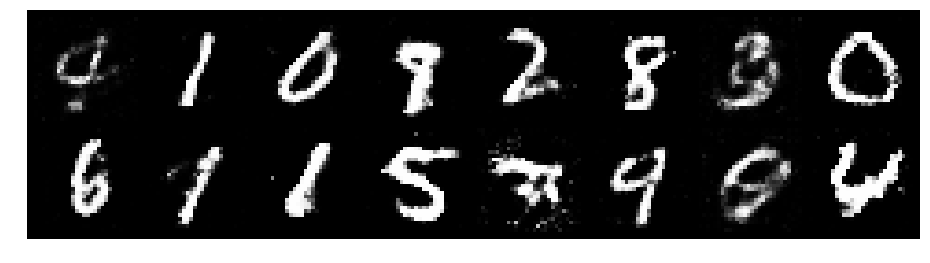

Epoch: [75/200], Batch Num: [500/938]
Discriminator Loss: 1.358046293258667, Generator Loss: 0.8089777231216431
D(x): 0.5335, D(G(z)): 0.4638


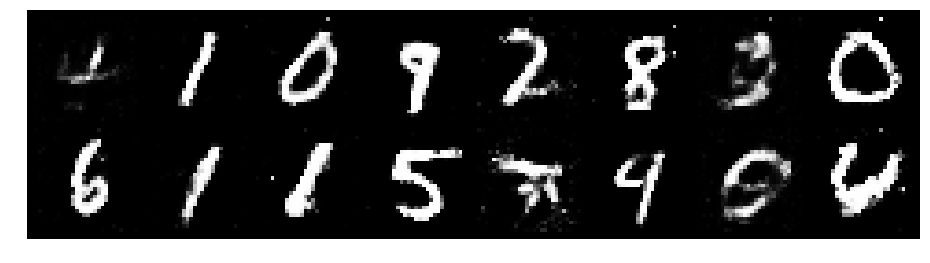

Epoch: [75/200], Batch Num: [600/938]
Discriminator Loss: 1.2448424100875854, Generator Loss: 0.9149988889694214
D(x): 0.5795, D(G(z)): 0.4361


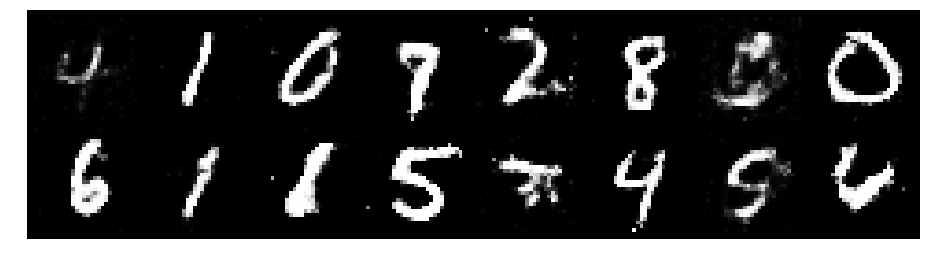

Epoch: [75/200], Batch Num: [700/938]
Discriminator Loss: 1.1692779064178467, Generator Loss: 0.8611387610435486
D(x): 0.6156, D(G(z)): 0.4515


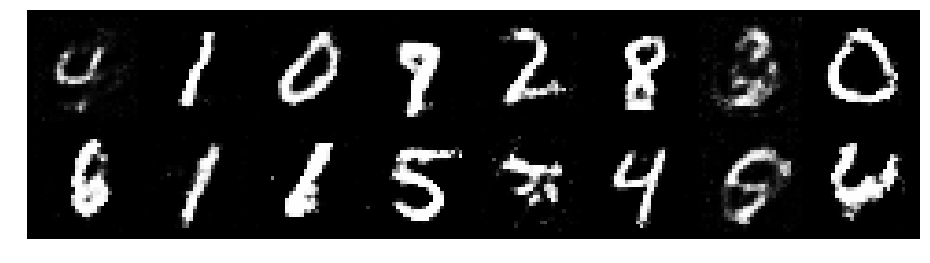

Epoch: [75/200], Batch Num: [800/938]
Discriminator Loss: 1.1447583436965942, Generator Loss: 0.899169921875
D(x): 0.6097, D(G(z)): 0.4368


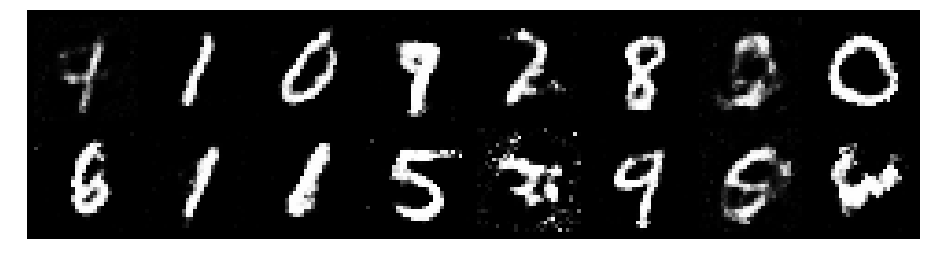

Epoch: [75/200], Batch Num: [900/938]
Discriminator Loss: 1.2911770343780518, Generator Loss: 0.9619401097297668
D(x): 0.5312, D(G(z)): 0.4474


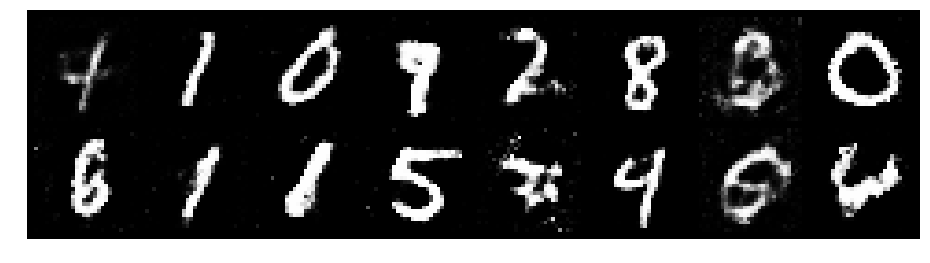

Epoch: [76/200], Batch Num: [0/938]
Discriminator Loss: 1.3825277090072632, Generator Loss: 0.7444891929626465
D(x): 0.5356, D(G(z)): 0.4833


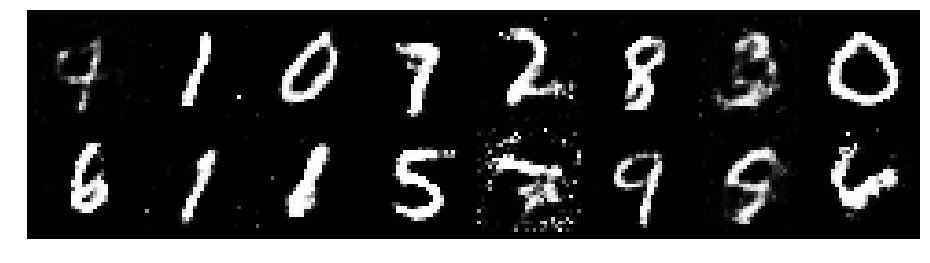

Epoch: [76/200], Batch Num: [100/938]
Discriminator Loss: 1.367856740951538, Generator Loss: 0.9045172333717346
D(x): 0.5408, D(G(z)): 0.4652


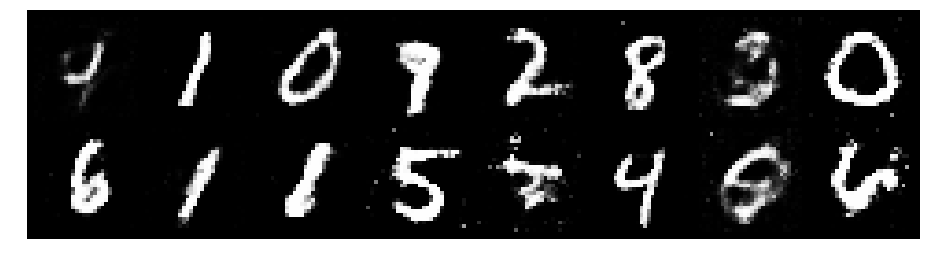

Epoch: [76/200], Batch Num: [200/938]
Discriminator Loss: 1.305263638496399, Generator Loss: 0.8348543643951416
D(x): 0.5873, D(G(z)): 0.4878


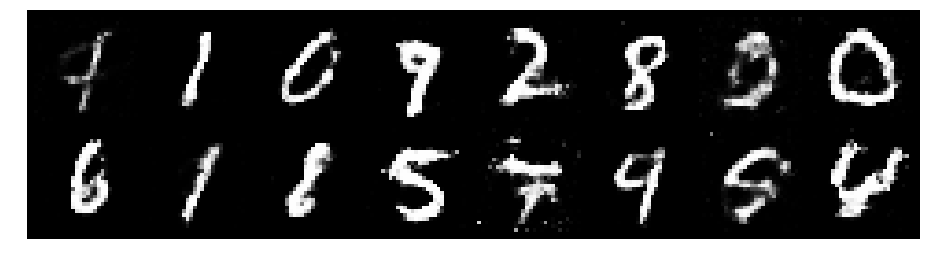

Epoch: [76/200], Batch Num: [300/938]
Discriminator Loss: 1.2197294235229492, Generator Loss: 1.0333149433135986
D(x): 0.5436, D(G(z)): 0.3945


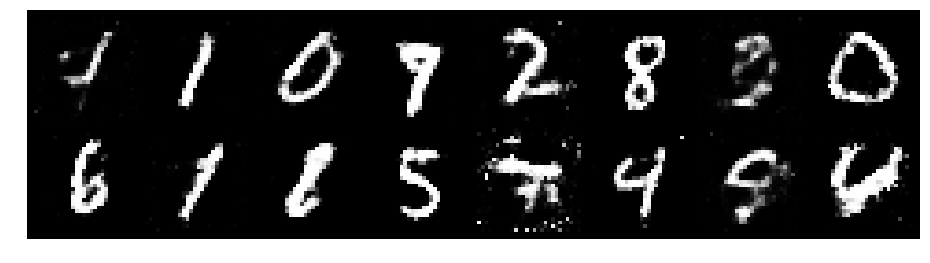

Epoch: [76/200], Batch Num: [400/938]
Discriminator Loss: 1.2569469213485718, Generator Loss: 0.8370563387870789
D(x): 0.5472, D(G(z)): 0.4477


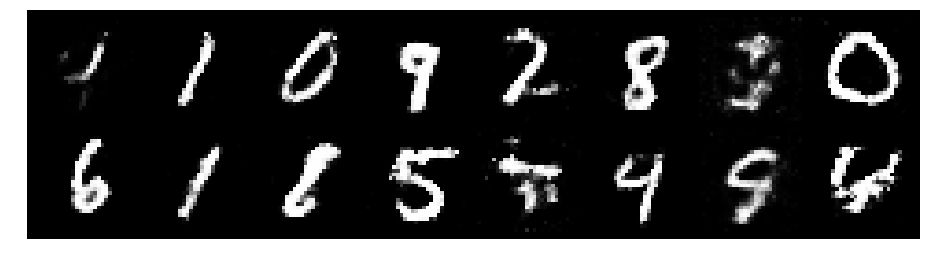

Epoch: [76/200], Batch Num: [500/938]
Discriminator Loss: 1.2738573551177979, Generator Loss: 0.93560791015625
D(x): 0.5182, D(G(z)): 0.4296


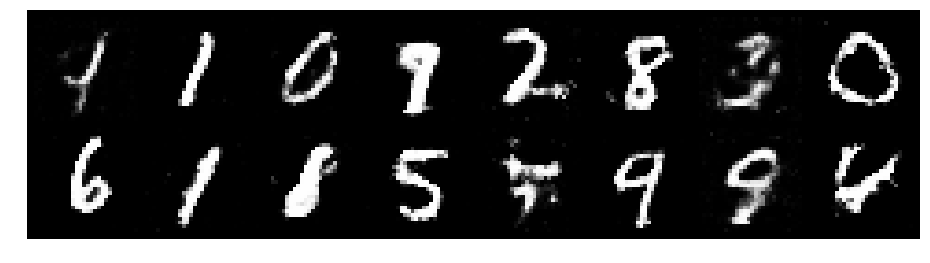

Epoch: [76/200], Batch Num: [600/938]
Discriminator Loss: 1.2338401079177856, Generator Loss: 0.868973970413208
D(x): 0.5752, D(G(z)): 0.4457


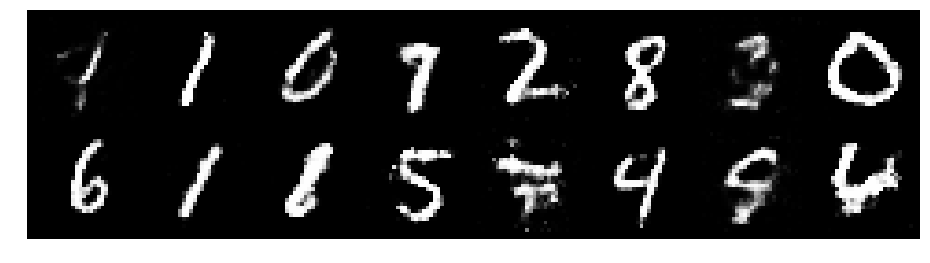

Epoch: [76/200], Batch Num: [700/938]
Discriminator Loss: 1.2703626155853271, Generator Loss: 1.0712659358978271
D(x): 0.5296, D(G(z)): 0.4171


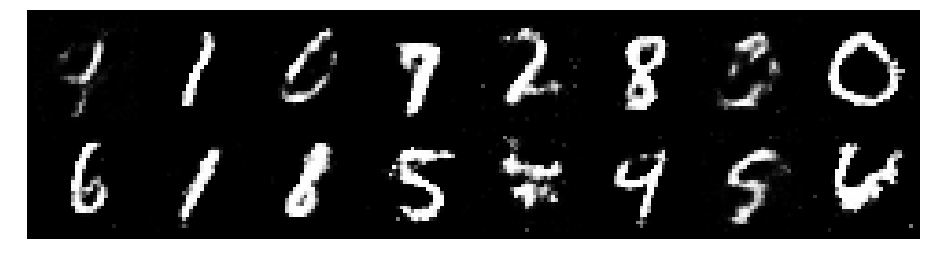

Epoch: [76/200], Batch Num: [800/938]
Discriminator Loss: 1.3210017681121826, Generator Loss: 0.8958477973937988
D(x): 0.5413, D(G(z)): 0.4494


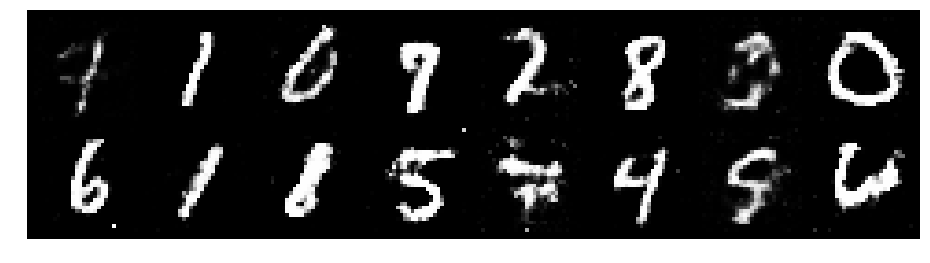

Epoch: [76/200], Batch Num: [900/938]
Discriminator Loss: 1.2640893459320068, Generator Loss: 1.0157890319824219
D(x): 0.5479, D(G(z)): 0.4358


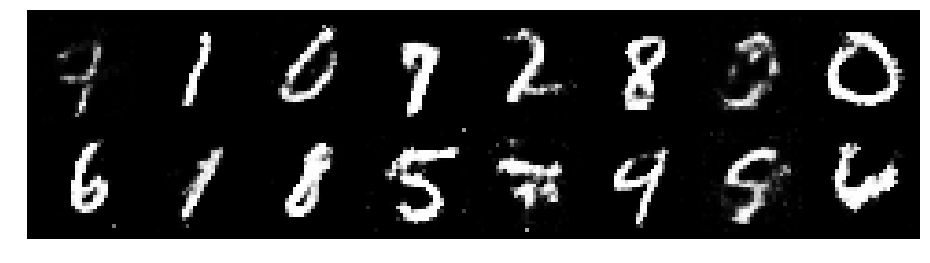

Epoch: [77/200], Batch Num: [0/938]
Discriminator Loss: 1.3204247951507568, Generator Loss: 0.784915566444397
D(x): 0.5656, D(G(z)): 0.4773


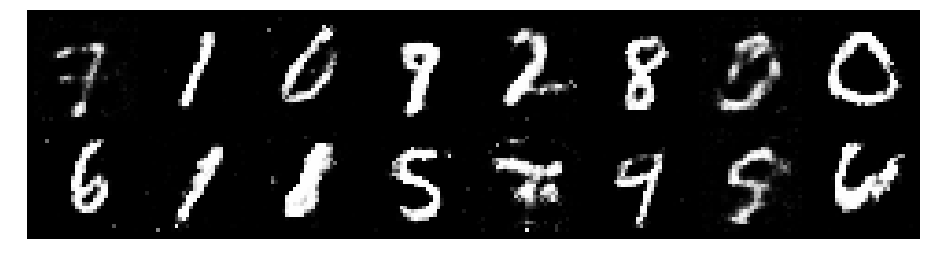

Epoch: [77/200], Batch Num: [100/938]
Discriminator Loss: 1.226609468460083, Generator Loss: 0.9733883738517761
D(x): 0.5312, D(G(z)): 0.4142


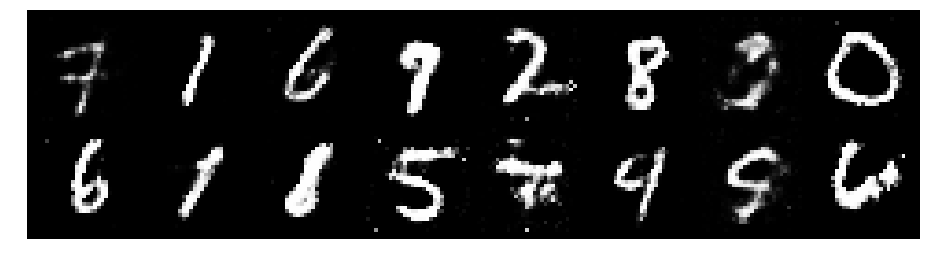

Epoch: [77/200], Batch Num: [200/938]
Discriminator Loss: 1.2586872577667236, Generator Loss: 0.8726793527603149
D(x): 0.5449, D(G(z)): 0.4312


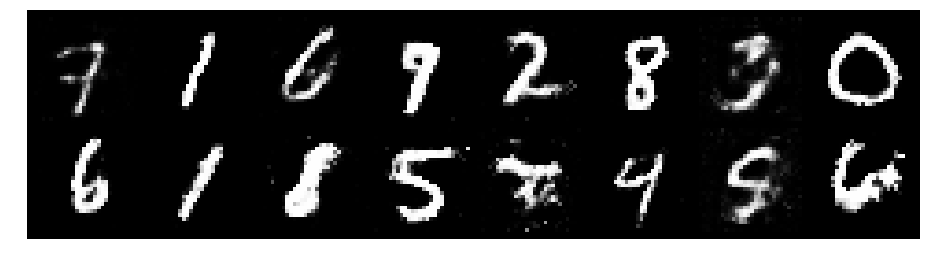

Epoch: [77/200], Batch Num: [300/938]
Discriminator Loss: 1.305220603942871, Generator Loss: 0.7642166614532471
D(x): 0.5472, D(G(z)): 0.4591


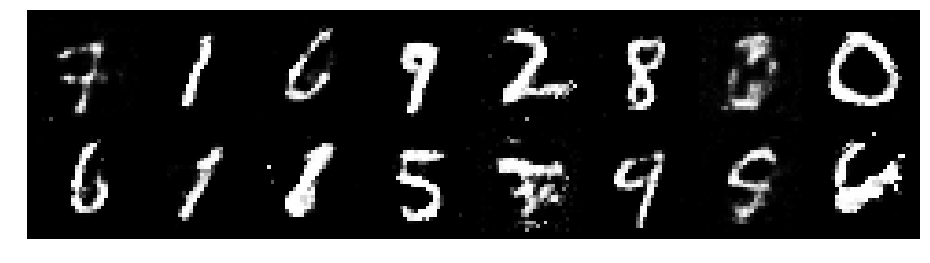

Epoch: [77/200], Batch Num: [400/938]
Discriminator Loss: 1.3096301555633545, Generator Loss: 0.7918609976768494
D(x): 0.5867, D(G(z)): 0.5021


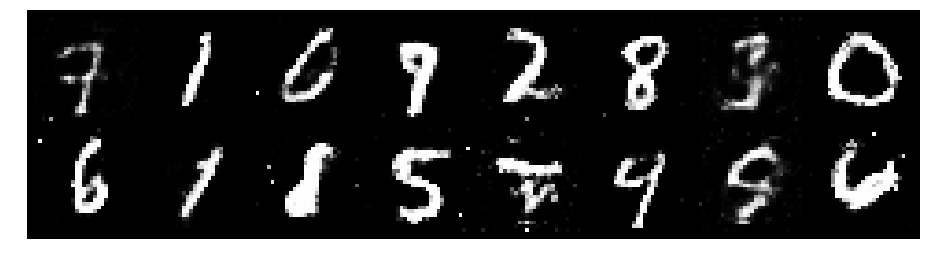

Epoch: [77/200], Batch Num: [500/938]
Discriminator Loss: 1.3171800374984741, Generator Loss: 0.8719607591629028
D(x): 0.5847, D(G(z)): 0.4482


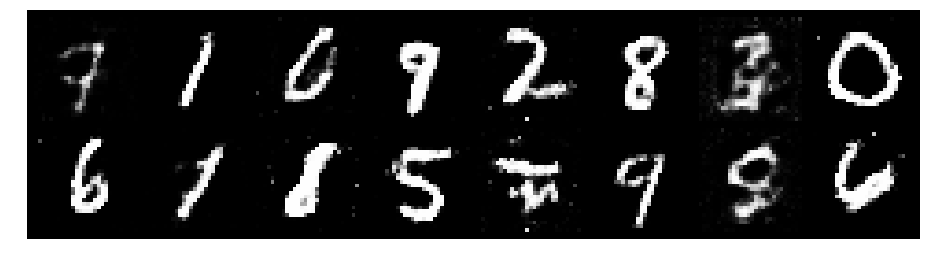

Epoch: [77/200], Batch Num: [600/938]
Discriminator Loss: 1.3593882322311401, Generator Loss: 0.9100829362869263
D(x): 0.5489, D(G(z)): 0.4554


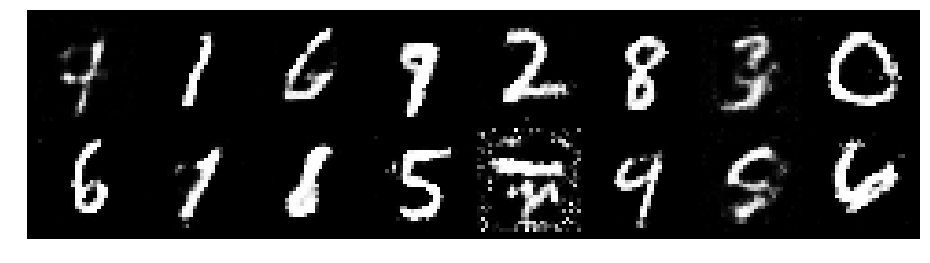

Epoch: [77/200], Batch Num: [700/938]
Discriminator Loss: 1.3334040641784668, Generator Loss: 0.8333806991577148
D(x): 0.4964, D(G(z)): 0.4245


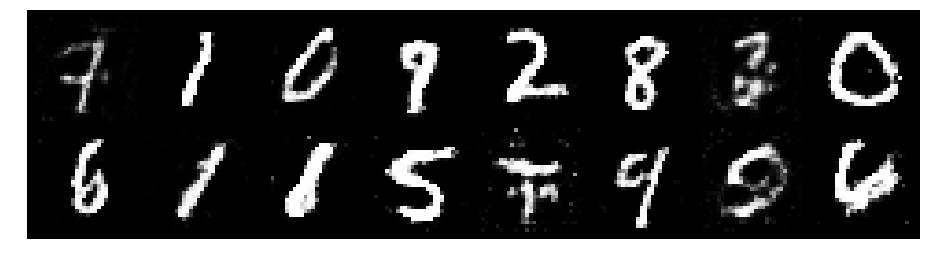

Epoch: [77/200], Batch Num: [800/938]
Discriminator Loss: 1.2965257167816162, Generator Loss: 0.9360219240188599
D(x): 0.5238, D(G(z)): 0.4120


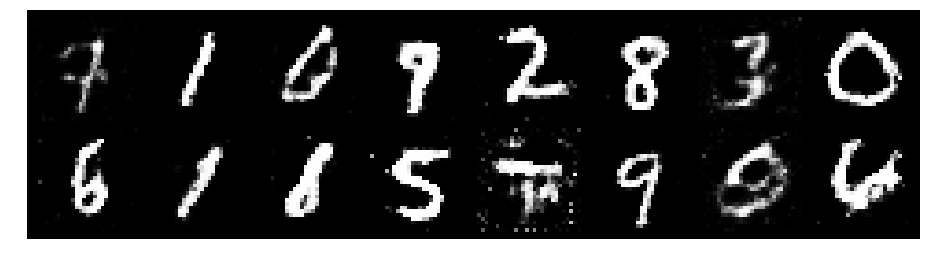

Epoch: [77/200], Batch Num: [900/938]
Discriminator Loss: 1.3004276752471924, Generator Loss: 0.8809814453125
D(x): 0.5041, D(G(z)): 0.4020


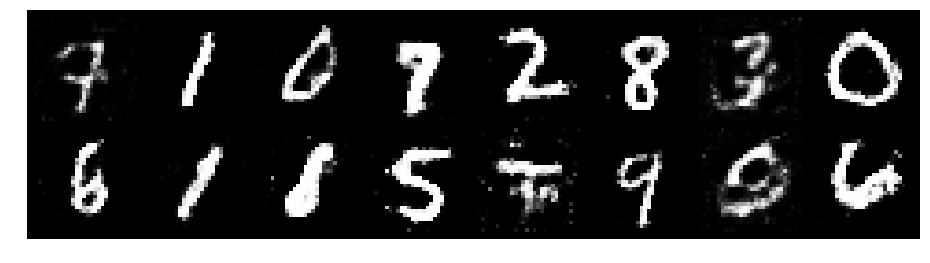

Epoch: [78/200], Batch Num: [0/938]
Discriminator Loss: 1.1442029476165771, Generator Loss: 0.9574745297431946
D(x): 0.5824, D(G(z)): 0.3951


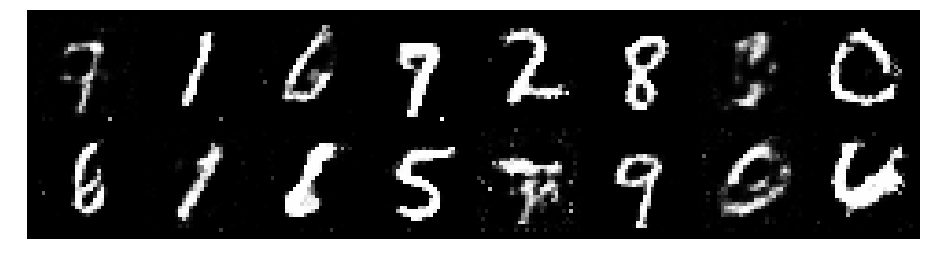

Epoch: [78/200], Batch Num: [100/938]
Discriminator Loss: 1.191798448562622, Generator Loss: 0.9395434856414795
D(x): 0.5546, D(G(z)): 0.4096


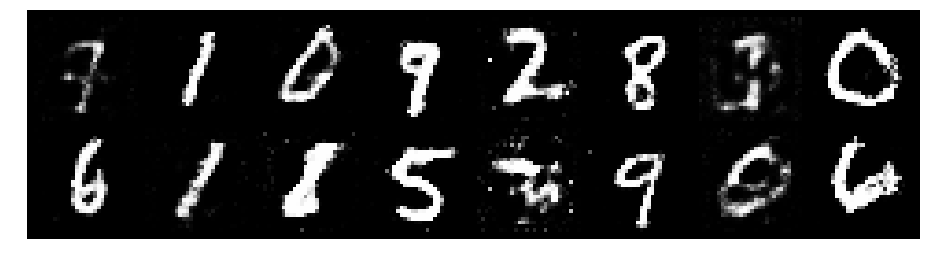

Epoch: [78/200], Batch Num: [200/938]
Discriminator Loss: 1.281846046447754, Generator Loss: 0.8808403015136719
D(x): 0.5392, D(G(z)): 0.4347


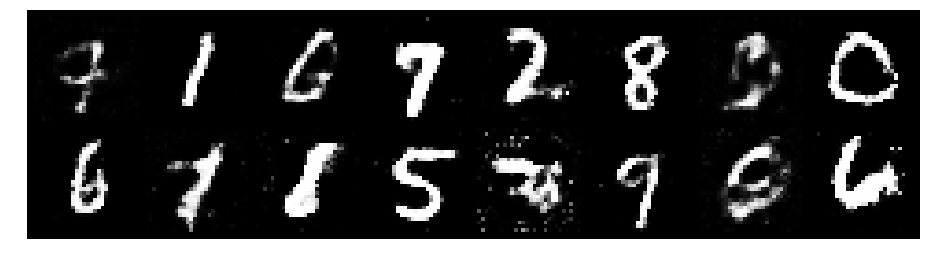

Epoch: [78/200], Batch Num: [300/938]
Discriminator Loss: 1.271411418914795, Generator Loss: 0.9444624781608582
D(x): 0.5717, D(G(z)): 0.4490


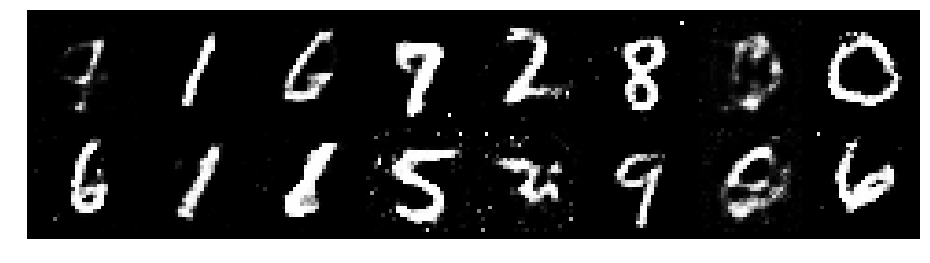

Epoch: [78/200], Batch Num: [400/938]
Discriminator Loss: 1.23234224319458, Generator Loss: 0.9510365128517151
D(x): 0.5822, D(G(z)): 0.4381


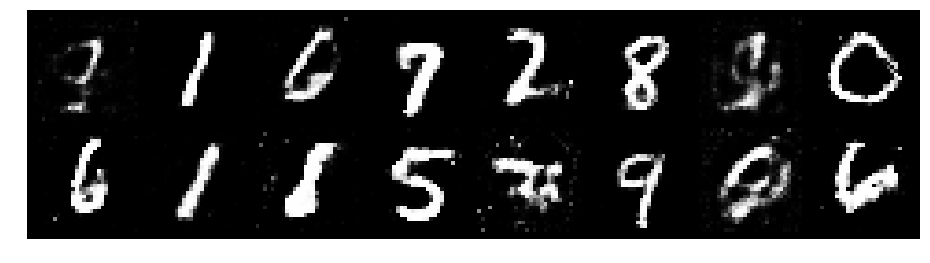

Epoch: [78/200], Batch Num: [500/938]
Discriminator Loss: 1.274322271347046, Generator Loss: 0.8713482022285461
D(x): 0.5468, D(G(z)): 0.4507


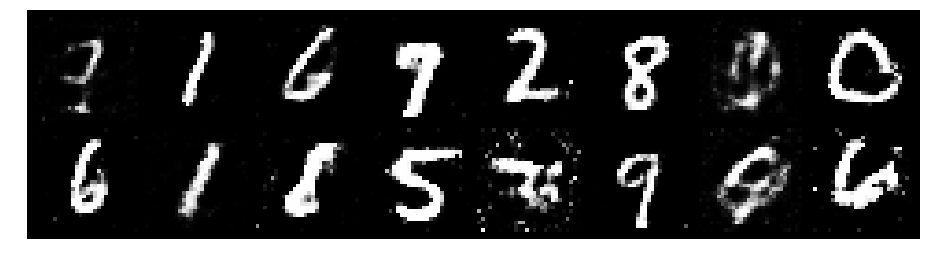

Epoch: [78/200], Batch Num: [600/938]
Discriminator Loss: 1.3285679817199707, Generator Loss: 0.758330762386322
D(x): 0.6170, D(G(z)): 0.5048


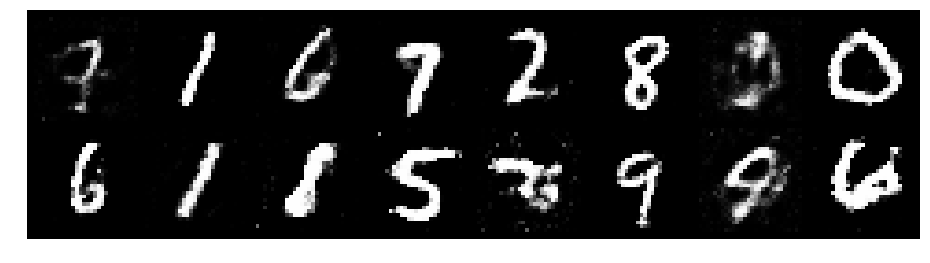

Epoch: [78/200], Batch Num: [700/938]
Discriminator Loss: 1.1992220878601074, Generator Loss: 1.0449552536010742
D(x): 0.6055, D(G(z)): 0.4499


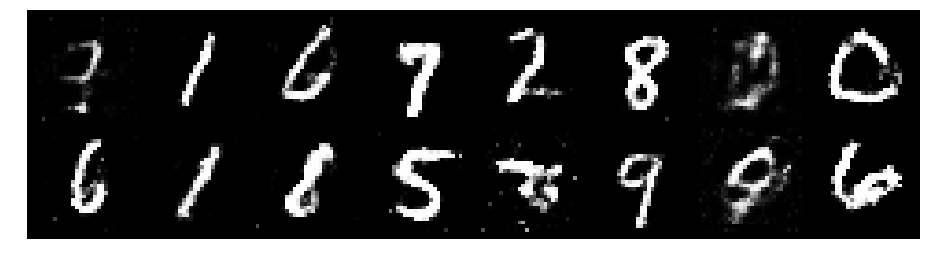

Epoch: [78/200], Batch Num: [800/938]
Discriminator Loss: 1.2118299007415771, Generator Loss: 1.0510913133621216
D(x): 0.5455, D(G(z)): 0.4030


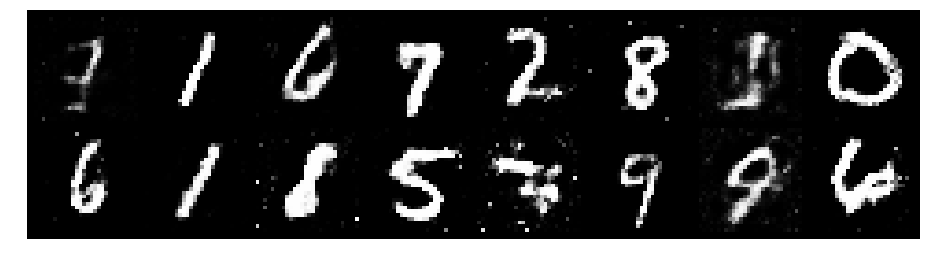

Epoch: [78/200], Batch Num: [900/938]
Discriminator Loss: 1.2969458103179932, Generator Loss: 0.8814822435379028
D(x): 0.5389, D(G(z)): 0.4391


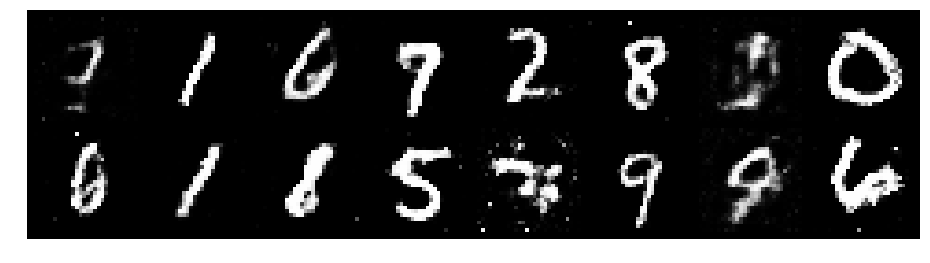

Epoch: [79/200], Batch Num: [0/938]
Discriminator Loss: 1.2751652002334595, Generator Loss: 0.7445091009140015
D(x): 0.6210, D(G(z)): 0.4955


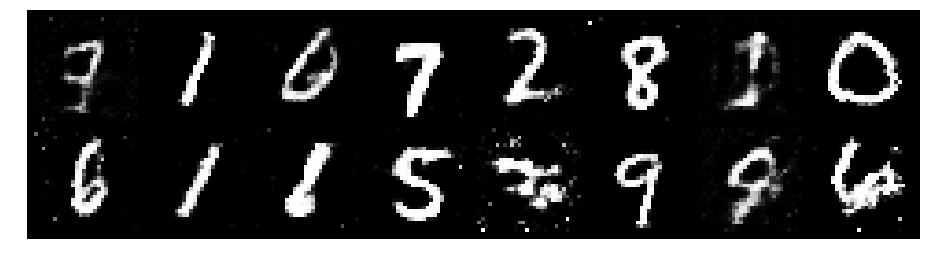

Epoch: [79/200], Batch Num: [100/938]
Discriminator Loss: 1.393965721130371, Generator Loss: 0.915749192237854
D(x): 0.5457, D(G(z)): 0.4723


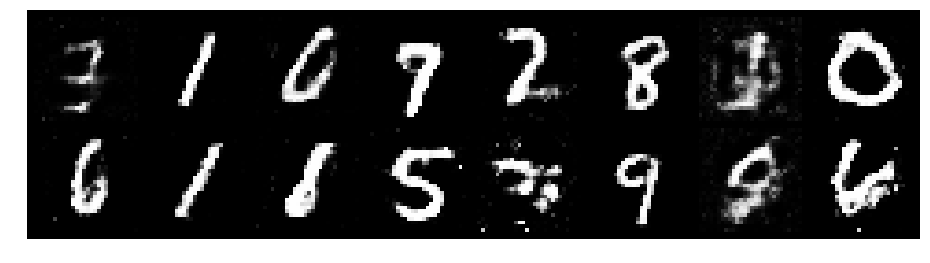

Epoch: [79/200], Batch Num: [200/938]
Discriminator Loss: 1.111860752105713, Generator Loss: 0.9081423282623291
D(x): 0.6084, D(G(z)): 0.4058


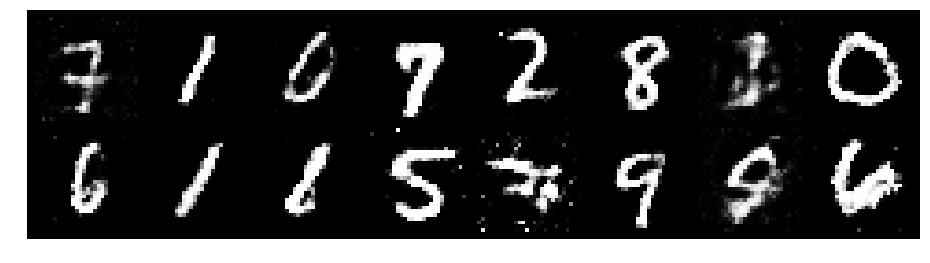

Epoch: [79/200], Batch Num: [300/938]
Discriminator Loss: 1.235584020614624, Generator Loss: 0.9829747676849365
D(x): 0.5959, D(G(z)): 0.4448


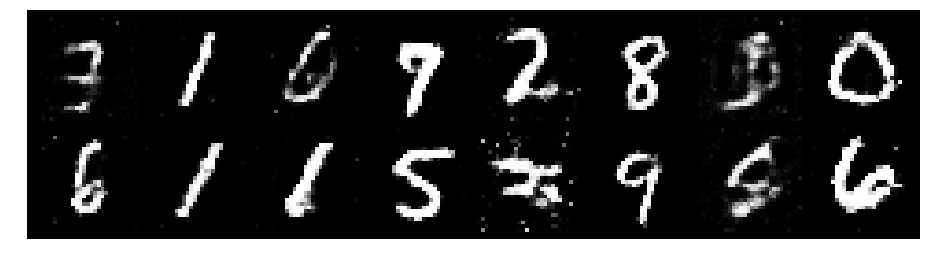

Epoch: [79/200], Batch Num: [400/938]
Discriminator Loss: 1.2570953369140625, Generator Loss: 1.0202230215072632
D(x): 0.5100, D(G(z)): 0.3905


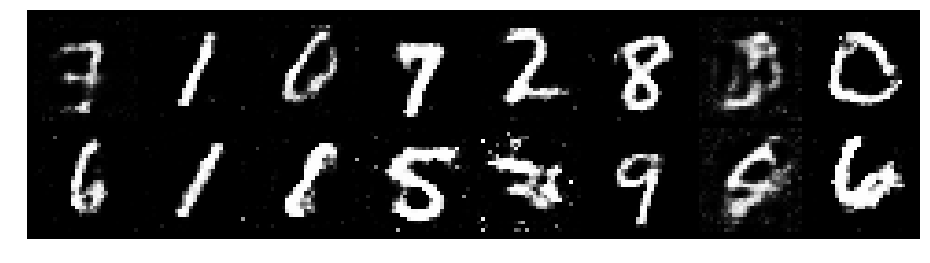

Epoch: [79/200], Batch Num: [500/938]
Discriminator Loss: 1.2438474893569946, Generator Loss: 0.9683700799942017
D(x): 0.5484, D(G(z)): 0.4320


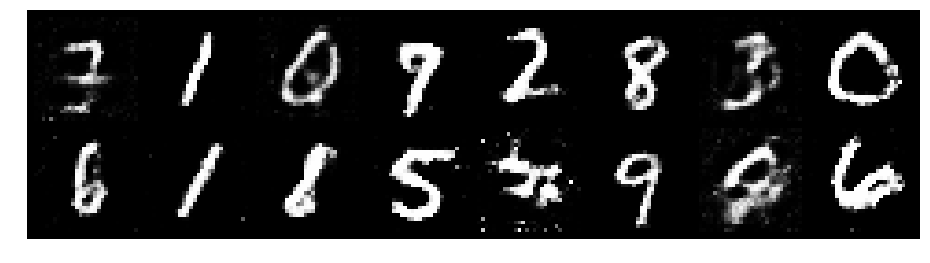

Epoch: [79/200], Batch Num: [600/938]
Discriminator Loss: 1.3029457330703735, Generator Loss: 0.8887362480163574
D(x): 0.5591, D(G(z)): 0.4688


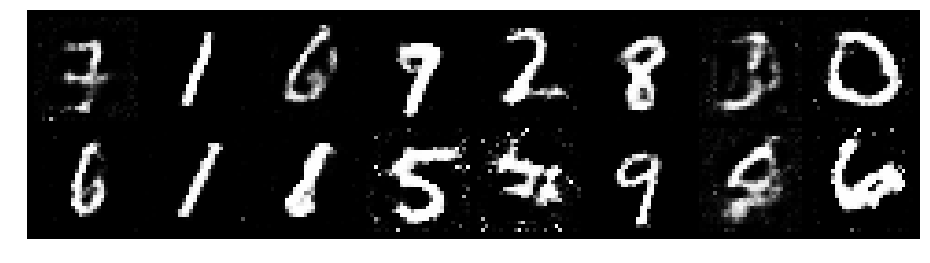

Epoch: [79/200], Batch Num: [700/938]
Discriminator Loss: 1.1945134401321411, Generator Loss: 0.833797812461853
D(x): 0.5781, D(G(z)): 0.4377


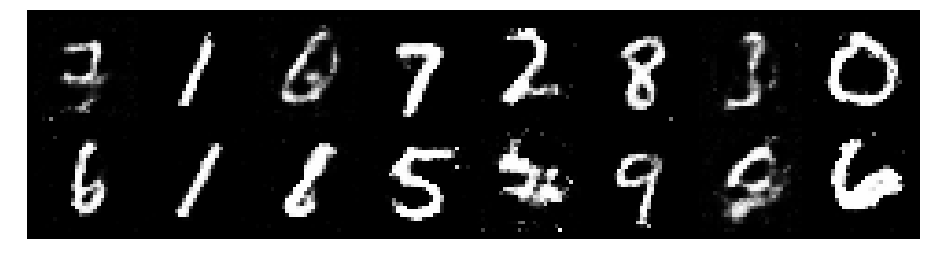

Epoch: [79/200], Batch Num: [800/938]
Discriminator Loss: 1.4179216623306274, Generator Loss: 0.7894436120986938
D(x): 0.5241, D(G(z)): 0.4860


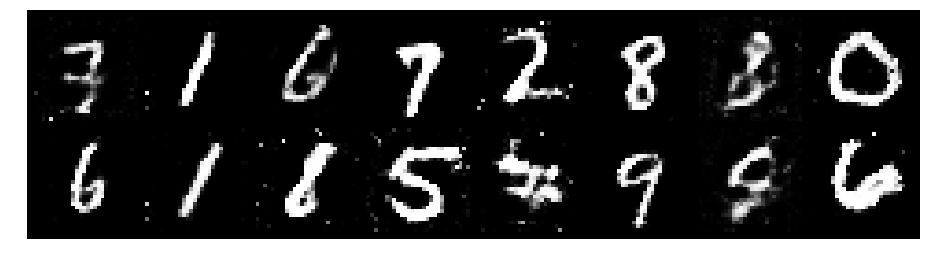

Epoch: [79/200], Batch Num: [900/938]
Discriminator Loss: 1.370175838470459, Generator Loss: 0.9806129932403564
D(x): 0.4765, D(G(z)): 0.3969


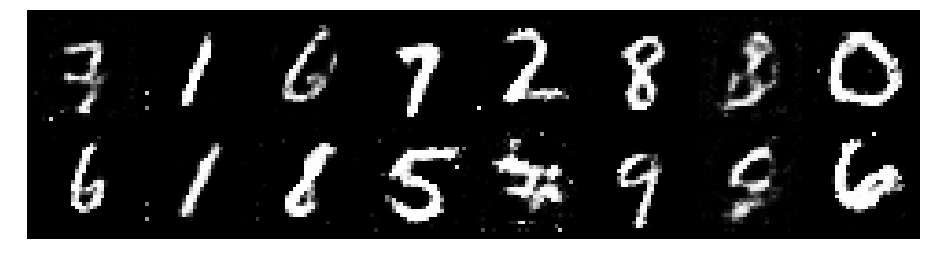

Epoch: [80/200], Batch Num: [0/938]
Discriminator Loss: 1.3056050539016724, Generator Loss: 0.9773374199867249
D(x): 0.5455, D(G(z)): 0.4457


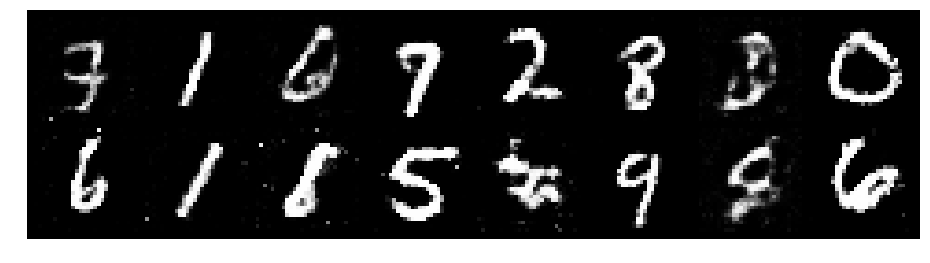

Epoch: [80/200], Batch Num: [100/938]
Discriminator Loss: 1.3283092975616455, Generator Loss: 0.9635399580001831
D(x): 0.5856, D(G(z)): 0.4538


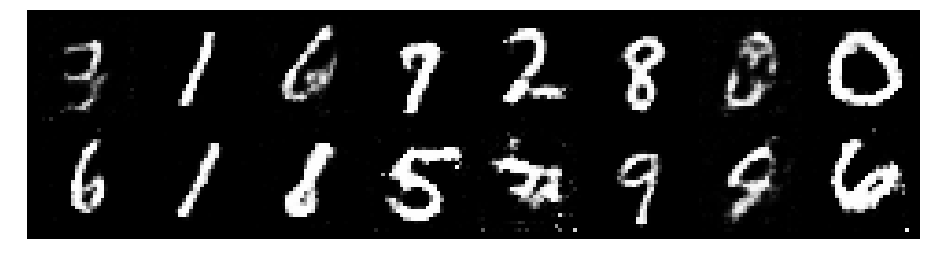

Epoch: [80/200], Batch Num: [200/938]
Discriminator Loss: 1.2586562633514404, Generator Loss: 0.892379641532898
D(x): 0.5698, D(G(z)): 0.4387


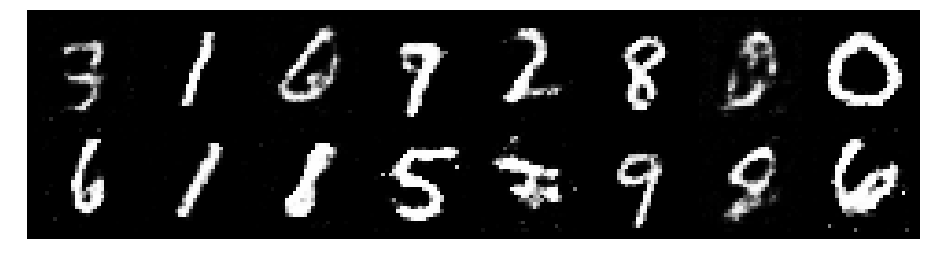

Epoch: [80/200], Batch Num: [300/938]
Discriminator Loss: 1.1517107486724854, Generator Loss: 0.9659626483917236
D(x): 0.5899, D(G(z)): 0.4104


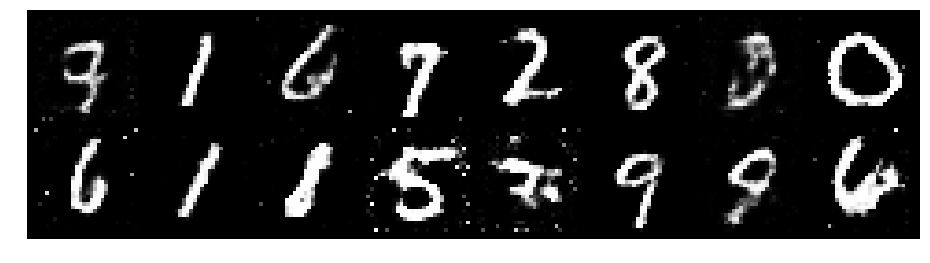

Epoch: [80/200], Batch Num: [400/938]
Discriminator Loss: 1.2172033786773682, Generator Loss: 0.8840039968490601
D(x): 0.5554, D(G(z)): 0.4378


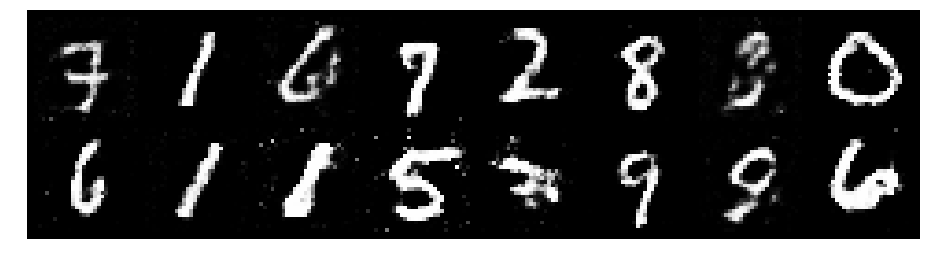

Epoch: [80/200], Batch Num: [500/938]
Discriminator Loss: 1.3007633686065674, Generator Loss: 0.8152095675468445
D(x): 0.5306, D(G(z)): 0.4542


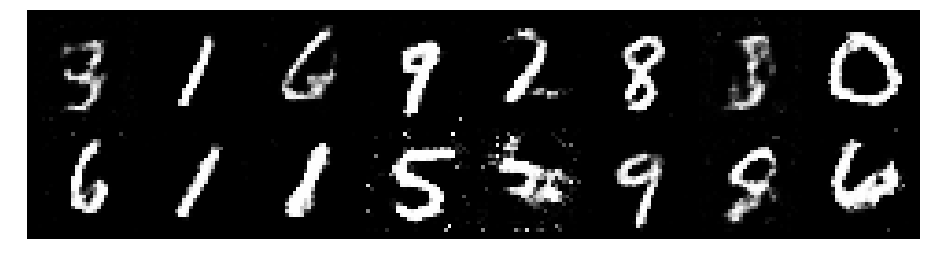

Epoch: [80/200], Batch Num: [600/938]
Discriminator Loss: 1.3116183280944824, Generator Loss: 0.8213320970535278
D(x): 0.5712, D(G(z)): 0.4911


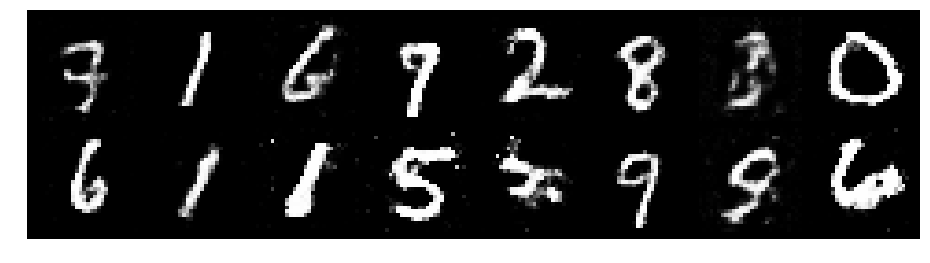

Epoch: [80/200], Batch Num: [700/938]
Discriminator Loss: 1.2782423496246338, Generator Loss: 0.8184282779693604
D(x): 0.5598, D(G(z)): 0.4486


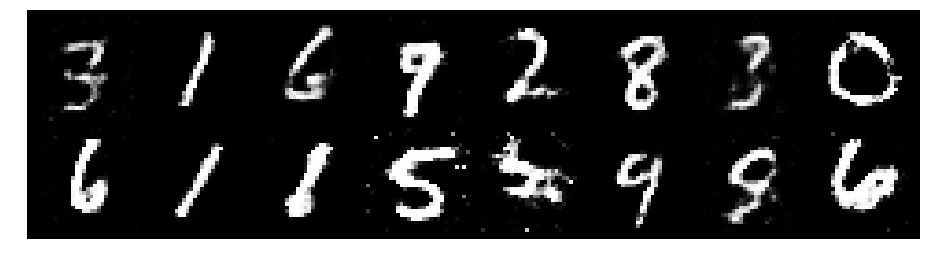

Epoch: [80/200], Batch Num: [800/938]
Discriminator Loss: 1.2398430109024048, Generator Loss: 0.9510698318481445
D(x): 0.5446, D(G(z)): 0.4268


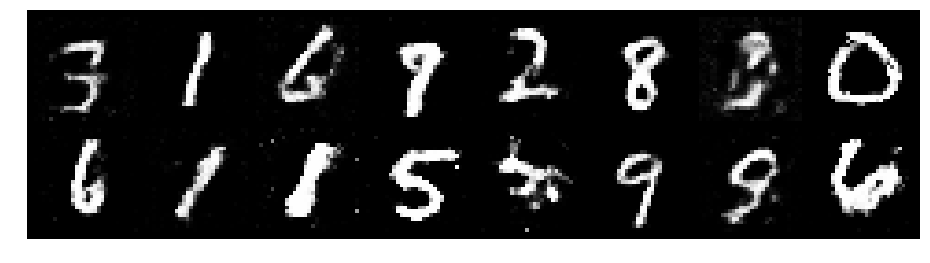

Epoch: [80/200], Batch Num: [900/938]
Discriminator Loss: 1.2283449172973633, Generator Loss: 1.003150224685669
D(x): 0.5658, D(G(z)): 0.4158


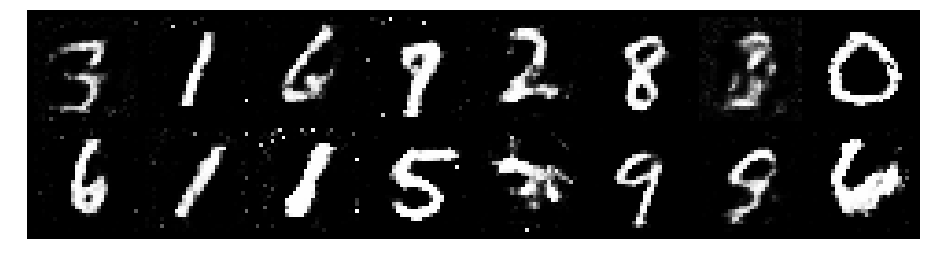

Epoch: [81/200], Batch Num: [0/938]
Discriminator Loss: 1.2512716054916382, Generator Loss: 0.9469285011291504
D(x): 0.5643, D(G(z)): 0.4362


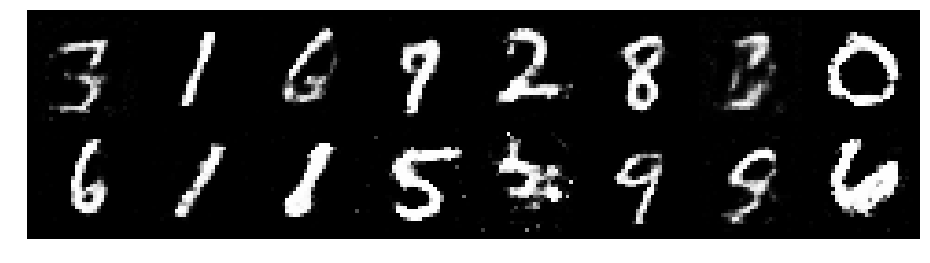

Epoch: [81/200], Batch Num: [100/938]
Discriminator Loss: 1.1438491344451904, Generator Loss: 0.8374024033546448
D(x): 0.5859, D(G(z)): 0.4139


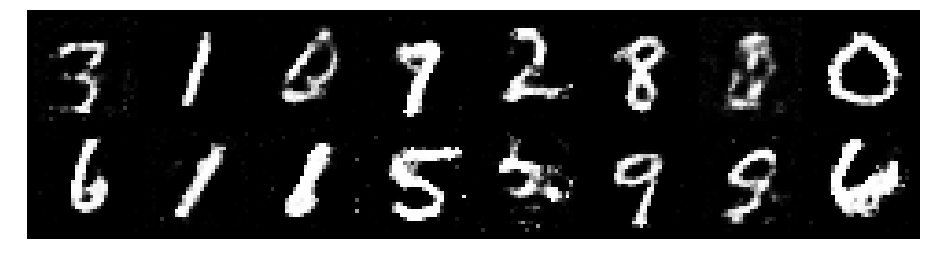

Epoch: [81/200], Batch Num: [200/938]
Discriminator Loss: 1.3387665748596191, Generator Loss: 0.8624281883239746
D(x): 0.5320, D(G(z)): 0.4602


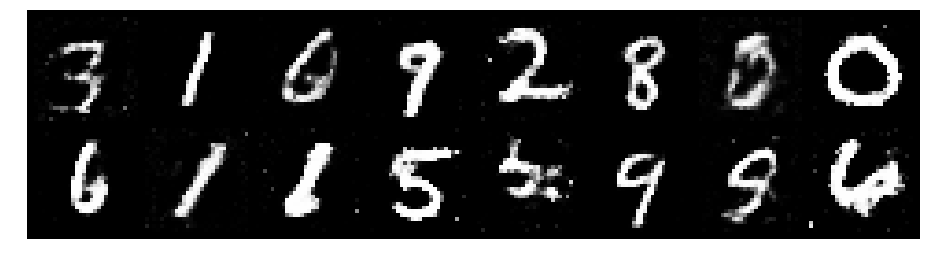

Epoch: [81/200], Batch Num: [300/938]
Discriminator Loss: 1.2704551219940186, Generator Loss: 0.8358864188194275
D(x): 0.5904, D(G(z)): 0.4807


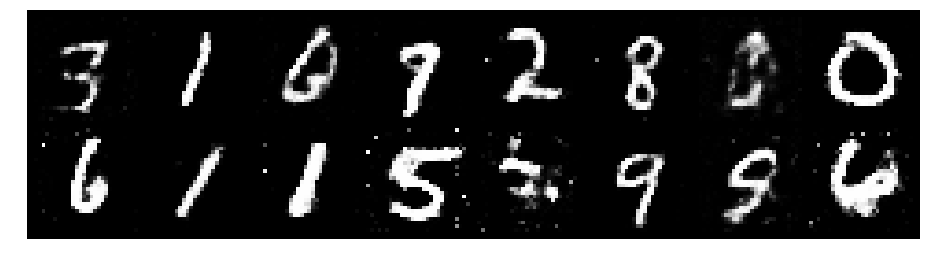

Epoch: [81/200], Batch Num: [400/938]
Discriminator Loss: 1.297121524810791, Generator Loss: 0.8882851004600525
D(x): 0.5229, D(G(z)): 0.4328


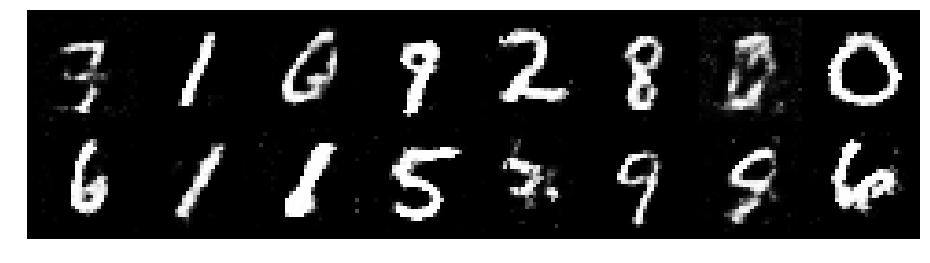

Epoch: [81/200], Batch Num: [500/938]
Discriminator Loss: 1.3724879026412964, Generator Loss: 0.8206908702850342
D(x): 0.5172, D(G(z)): 0.4564


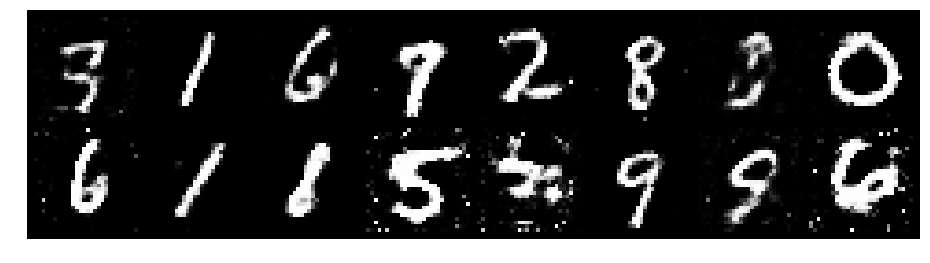

Epoch: [81/200], Batch Num: [600/938]
Discriminator Loss: 1.2465052604675293, Generator Loss: 0.8633741140365601
D(x): 0.5961, D(G(z)): 0.4569


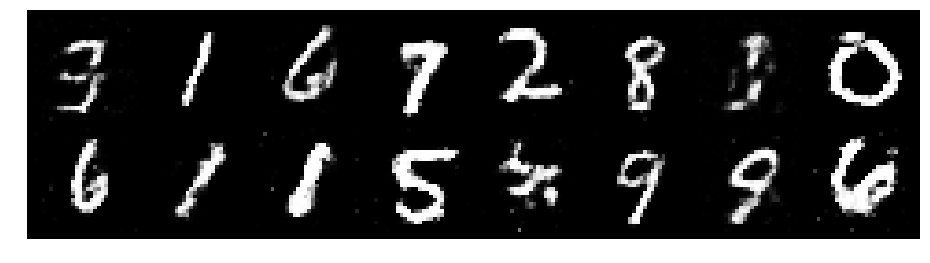

Epoch: [81/200], Batch Num: [700/938]
Discriminator Loss: 1.2130582332611084, Generator Loss: 0.8972949981689453
D(x): 0.5366, D(G(z)): 0.4054


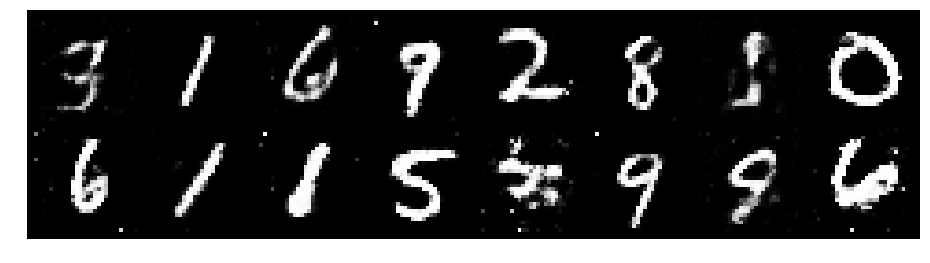

Epoch: [81/200], Batch Num: [800/938]
Discriminator Loss: 1.2352495193481445, Generator Loss: 0.947447657585144
D(x): 0.5720, D(G(z)): 0.4518


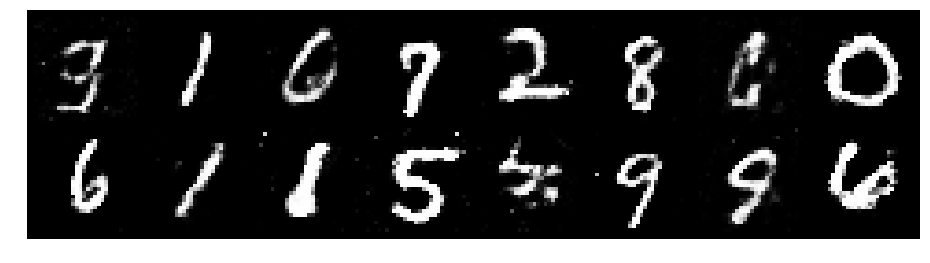

Epoch: [81/200], Batch Num: [900/938]
Discriminator Loss: 1.1911556720733643, Generator Loss: 0.8917515277862549
D(x): 0.5691, D(G(z)): 0.4296


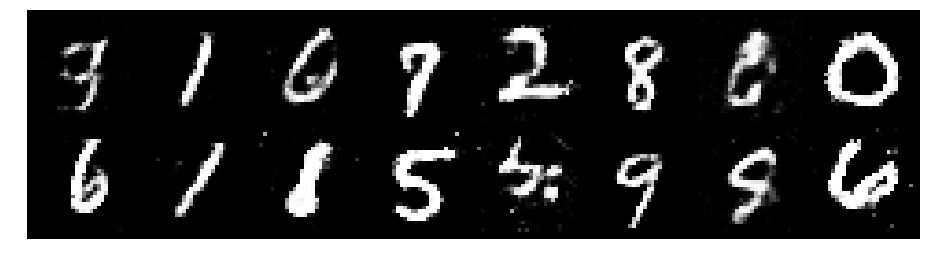

Epoch: [82/200], Batch Num: [0/938]
Discriminator Loss: 1.2437024116516113, Generator Loss: 0.9404016733169556
D(x): 0.5780, D(G(z)): 0.4452


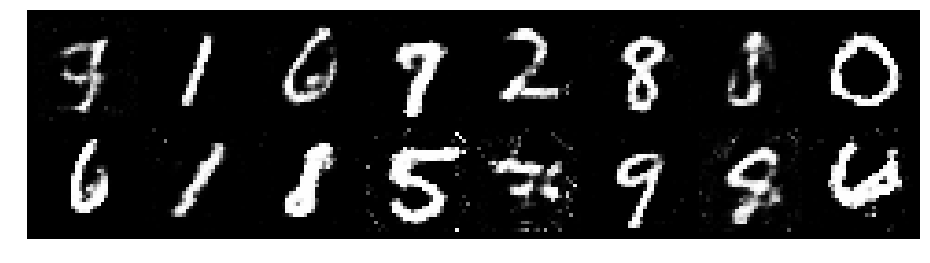

Epoch: [82/200], Batch Num: [100/938]
Discriminator Loss: 1.2816779613494873, Generator Loss: 0.8408812284469604
D(x): 0.5686, D(G(z)): 0.4665


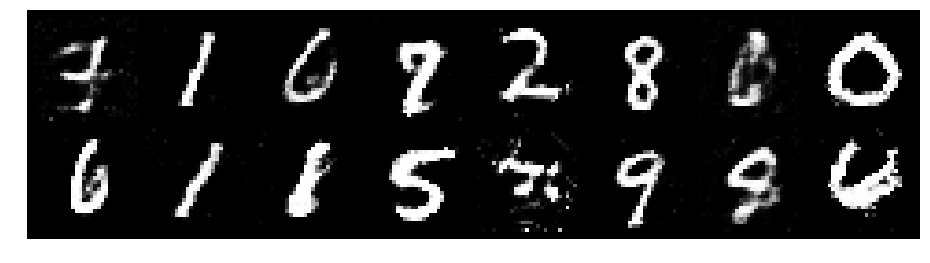

Epoch: [82/200], Batch Num: [200/938]
Discriminator Loss: 1.3281395435333252, Generator Loss: 1.0889902114868164
D(x): 0.5024, D(G(z)): 0.4011


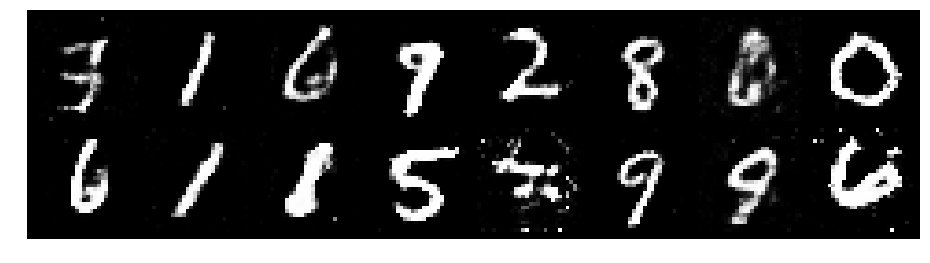

Epoch: [82/200], Batch Num: [300/938]
Discriminator Loss: 1.2770917415618896, Generator Loss: 0.8057616949081421
D(x): 0.5658, D(G(z)): 0.4550


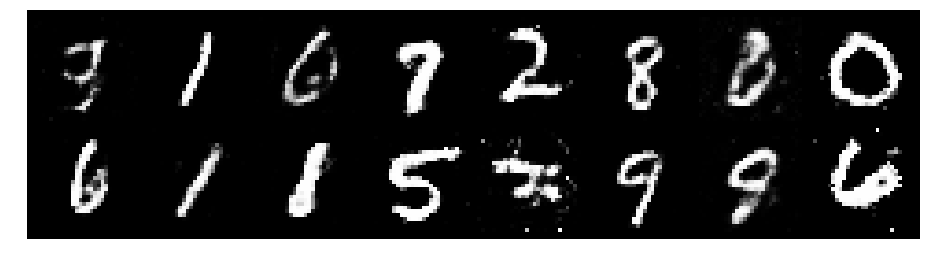

Epoch: [82/200], Batch Num: [400/938]
Discriminator Loss: 1.258664608001709, Generator Loss: 0.8845586776733398
D(x): 0.5320, D(G(z)): 0.4211


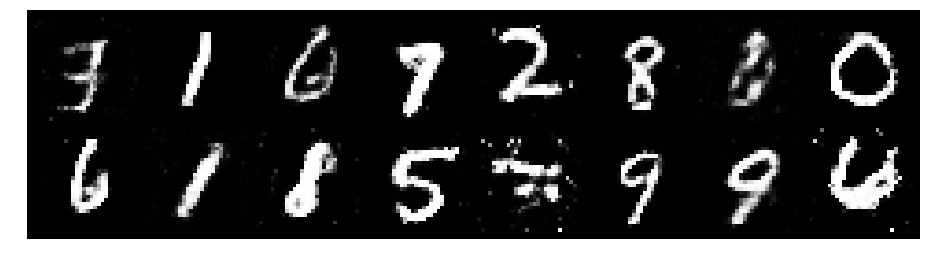

Epoch: [82/200], Batch Num: [500/938]
Discriminator Loss: 1.2034687995910645, Generator Loss: 0.9664216041564941
D(x): 0.5515, D(G(z)): 0.4110


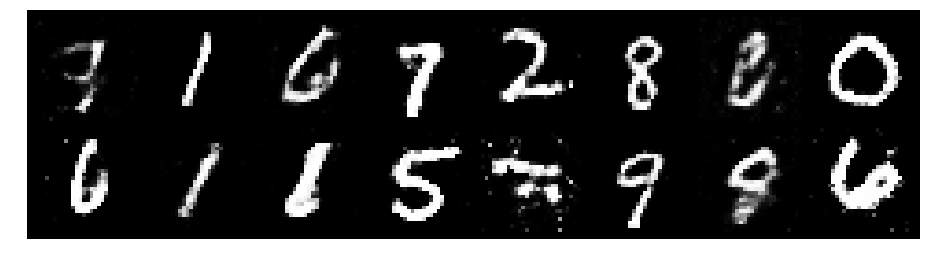

Epoch: [82/200], Batch Num: [600/938]
Discriminator Loss: 1.2627248764038086, Generator Loss: 0.9107213020324707
D(x): 0.5652, D(G(z)): 0.4427


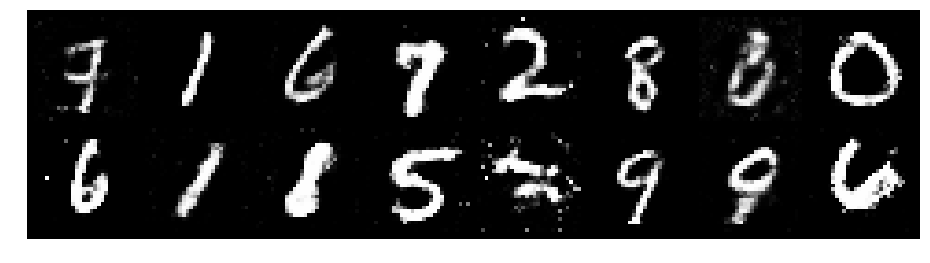

Epoch: [82/200], Batch Num: [700/938]
Discriminator Loss: 1.2462842464447021, Generator Loss: 0.8992002010345459
D(x): 0.5643, D(G(z)): 0.4556


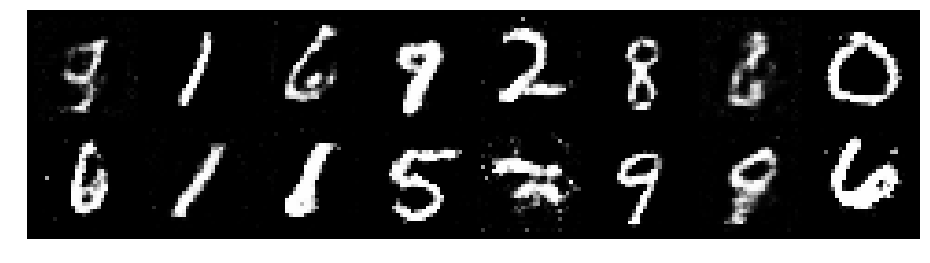

Epoch: [82/200], Batch Num: [800/938]
Discriminator Loss: 1.2438774108886719, Generator Loss: 0.851826548576355
D(x): 0.5853, D(G(z)): 0.4749


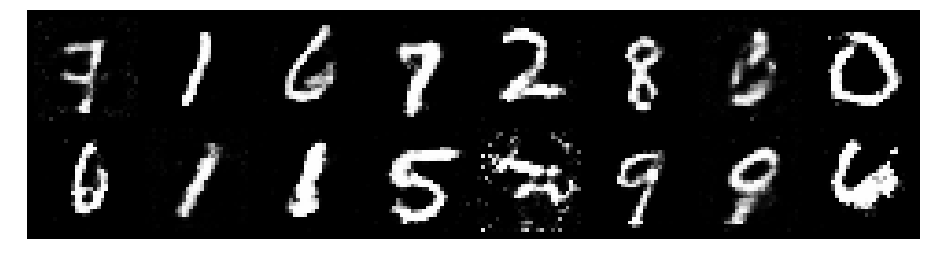

Epoch: [82/200], Batch Num: [900/938]
Discriminator Loss: 1.3799018859863281, Generator Loss: 0.8683131337165833
D(x): 0.5290, D(G(z)): 0.4704


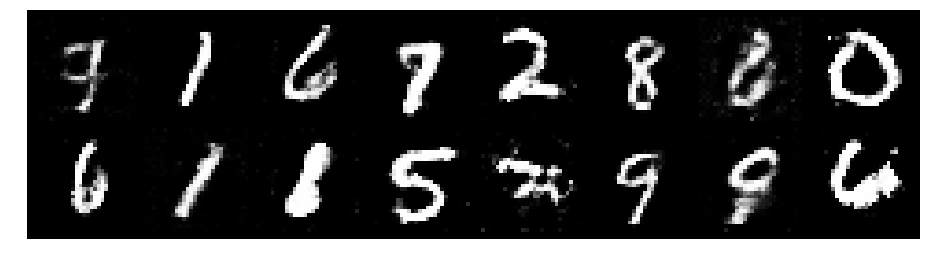

Epoch: [83/200], Batch Num: [0/938]
Discriminator Loss: 1.2899844646453857, Generator Loss: 0.7606104612350464
D(x): 0.5711, D(G(z)): 0.4679


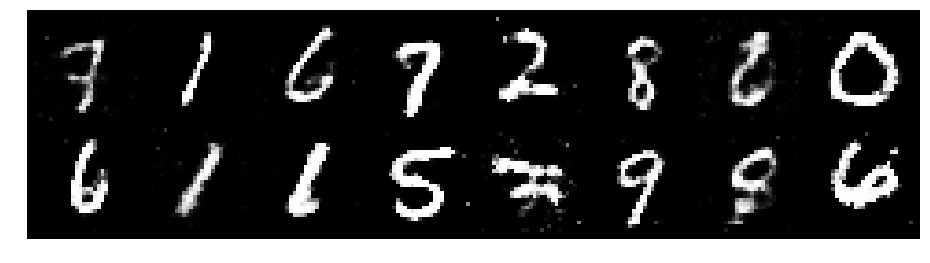

Epoch: [83/200], Batch Num: [100/938]
Discriminator Loss: 1.2031636238098145, Generator Loss: 1.1337862014770508
D(x): 0.5577, D(G(z)): 0.4098


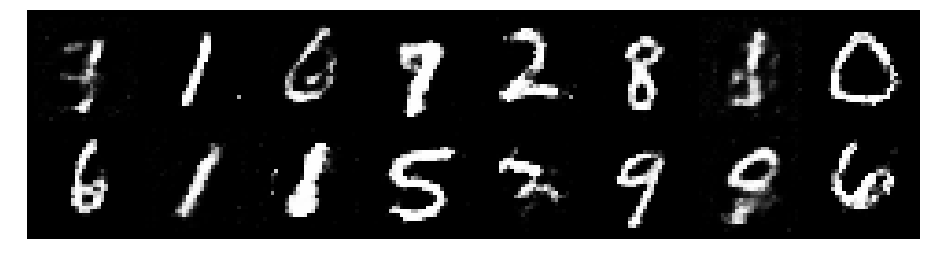

Epoch: [83/200], Batch Num: [200/938]
Discriminator Loss: 1.2660281658172607, Generator Loss: 0.917320191860199
D(x): 0.5240, D(G(z)): 0.4149


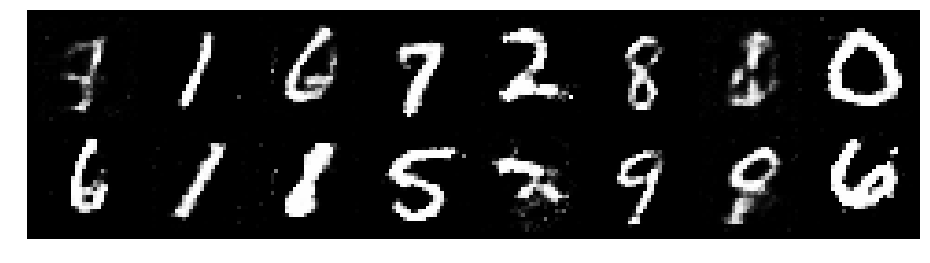

Epoch: [83/200], Batch Num: [300/938]
Discriminator Loss: 1.3343918323516846, Generator Loss: 0.8397436738014221
D(x): 0.5337, D(G(z)): 0.4496


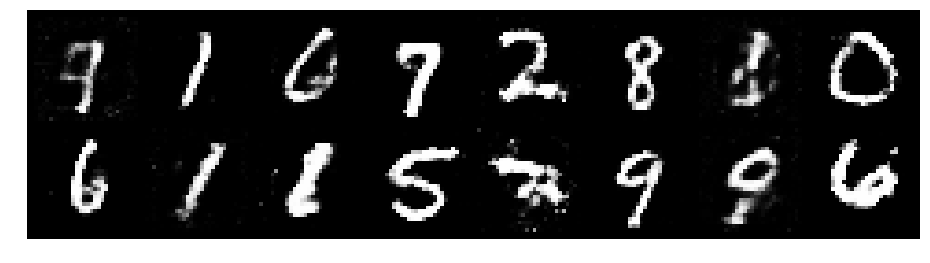

Epoch: [83/200], Batch Num: [400/938]
Discriminator Loss: 1.2952090501785278, Generator Loss: 0.8768974542617798
D(x): 0.5442, D(G(z)): 0.4504


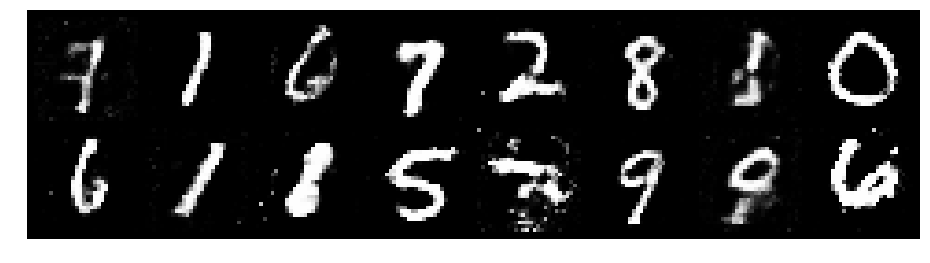

Epoch: [83/200], Batch Num: [500/938]
Discriminator Loss: 1.3652080297470093, Generator Loss: 0.8579102158546448
D(x): 0.5374, D(G(z)): 0.4888


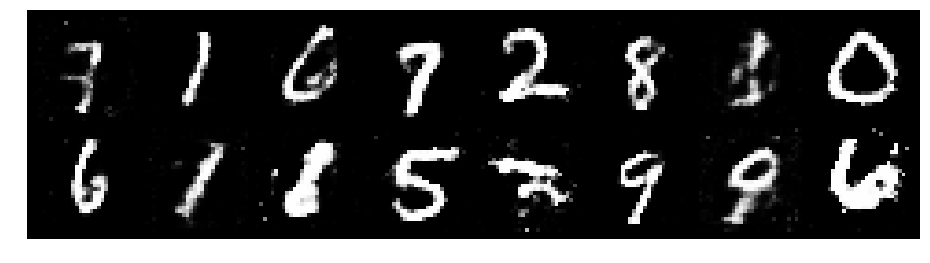

Epoch: [83/200], Batch Num: [600/938]
Discriminator Loss: 1.2606260776519775, Generator Loss: 0.9177405834197998
D(x): 0.5688, D(G(z)): 0.4574


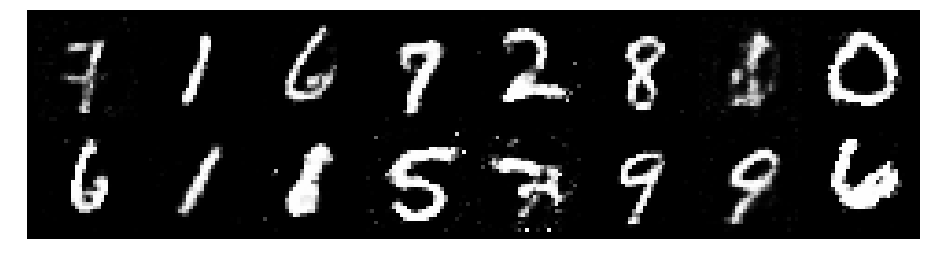

Epoch: [83/200], Batch Num: [700/938]
Discriminator Loss: 1.336493730545044, Generator Loss: 0.9184333086013794
D(x): 0.4915, D(G(z)): 0.3998


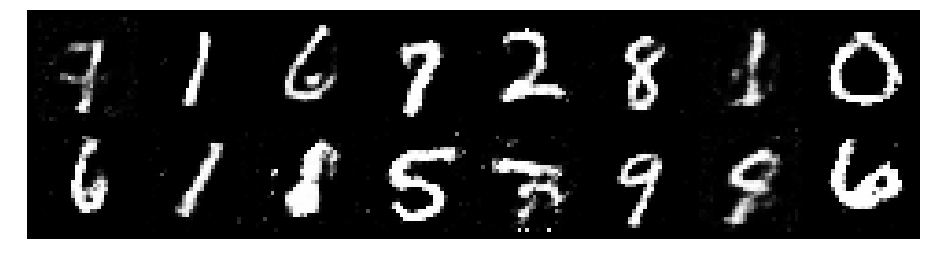

Epoch: [83/200], Batch Num: [800/938]
Discriminator Loss: 1.160721778869629, Generator Loss: 1.1808948516845703
D(x): 0.5864, D(G(z)): 0.4082


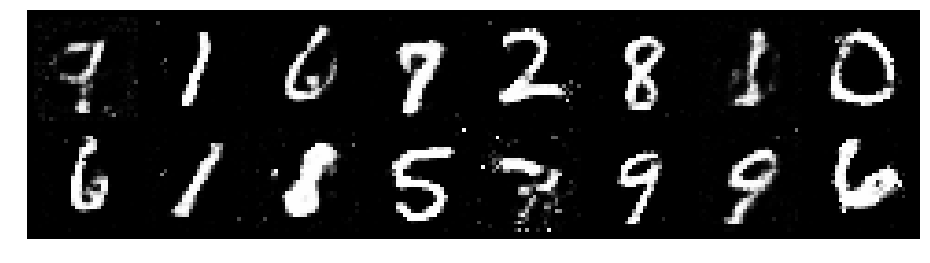

Epoch: [83/200], Batch Num: [900/938]
Discriminator Loss: 1.3222675323486328, Generator Loss: 0.8827041387557983
D(x): 0.5174, D(G(z)): 0.4449


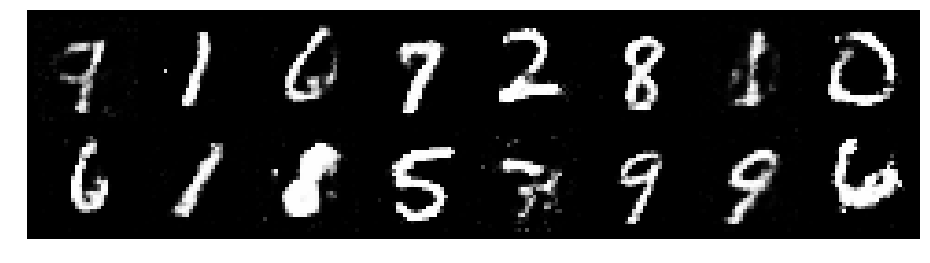

Epoch: [84/200], Batch Num: [0/938]
Discriminator Loss: 1.361459732055664, Generator Loss: 0.8921775817871094
D(x): 0.5242, D(G(z)): 0.4585


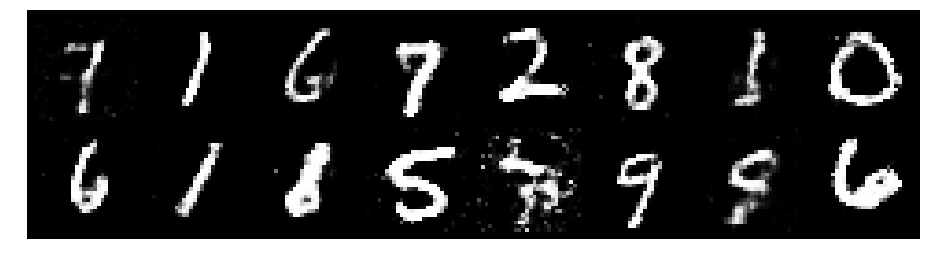

Epoch: [84/200], Batch Num: [100/938]
Discriminator Loss: 1.3098959922790527, Generator Loss: 0.8958074450492859
D(x): 0.5245, D(G(z)): 0.4571


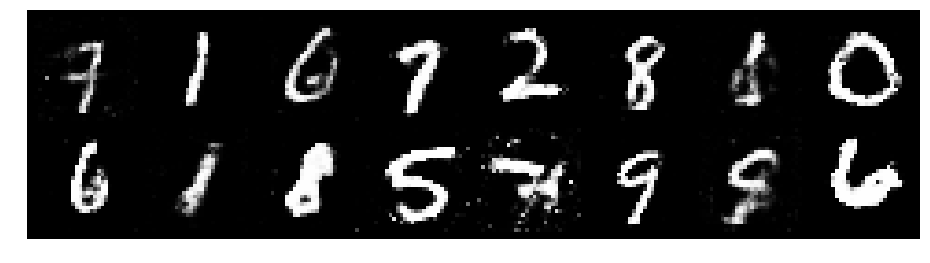

Epoch: [84/200], Batch Num: [200/938]
Discriminator Loss: 1.1617987155914307, Generator Loss: 0.8464268445968628
D(x): 0.6178, D(G(z)): 0.4530


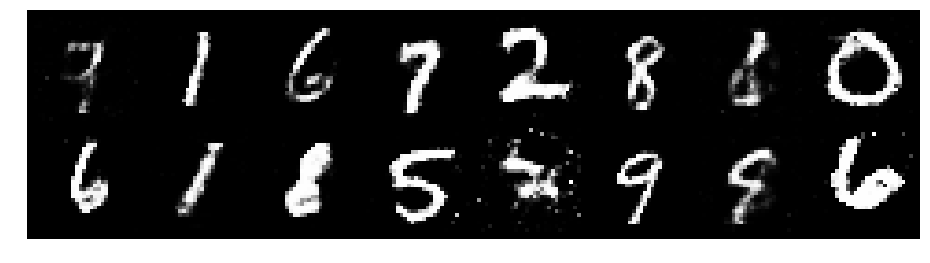

Epoch: [84/200], Batch Num: [300/938]
Discriminator Loss: 1.150269865989685, Generator Loss: 1.0133686065673828
D(x): 0.5873, D(G(z)): 0.4060


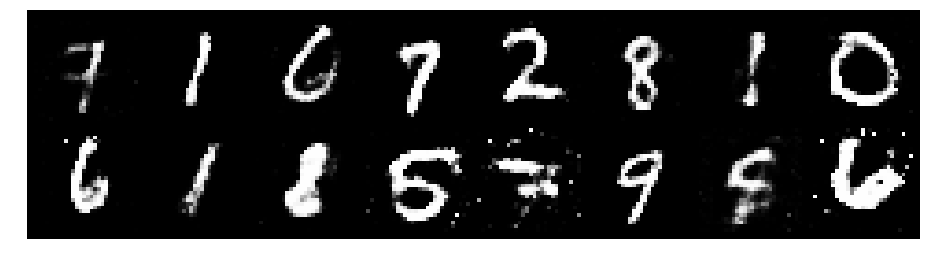

Epoch: [84/200], Batch Num: [400/938]
Discriminator Loss: 1.2550325393676758, Generator Loss: 0.9173361659049988
D(x): 0.5753, D(G(z)): 0.4629


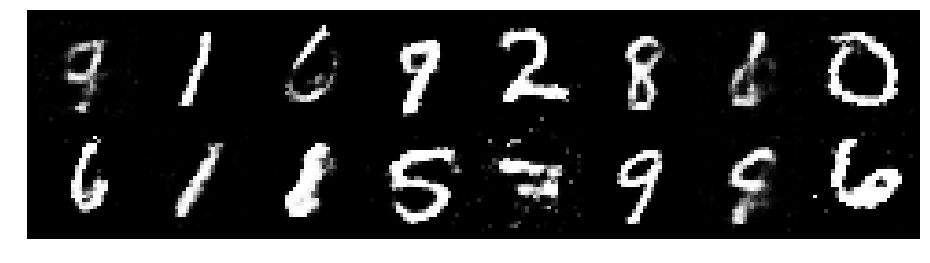

Epoch: [84/200], Batch Num: [500/938]
Discriminator Loss: 1.233658790588379, Generator Loss: 0.9618252515792847
D(x): 0.5846, D(G(z)): 0.4645


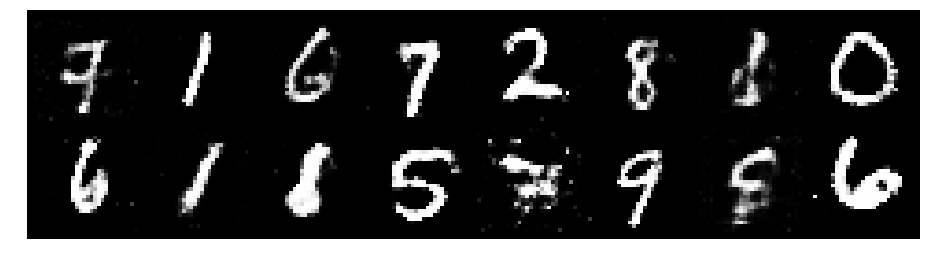

Epoch: [84/200], Batch Num: [600/938]
Discriminator Loss: 1.2578849792480469, Generator Loss: 0.9408196806907654
D(x): 0.5452, D(G(z)): 0.4375


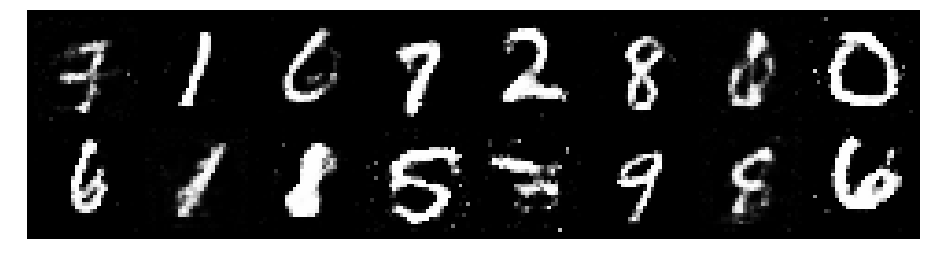

Epoch: [84/200], Batch Num: [700/938]
Discriminator Loss: 1.2604470252990723, Generator Loss: 0.8568687438964844
D(x): 0.5278, D(G(z)): 0.4394


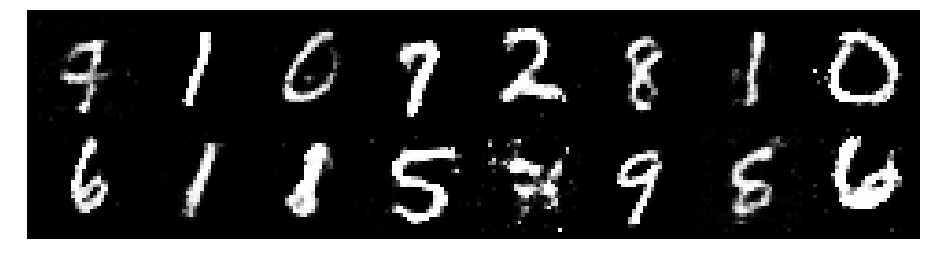

Epoch: [84/200], Batch Num: [800/938]
Discriminator Loss: 1.2365834712982178, Generator Loss: 0.8587278127670288
D(x): 0.5686, D(G(z)): 0.4609


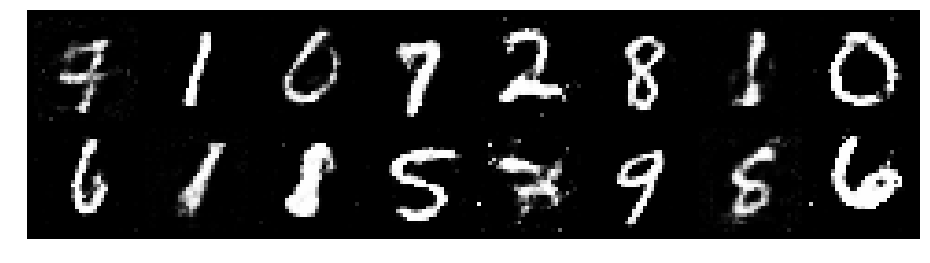

Epoch: [84/200], Batch Num: [900/938]
Discriminator Loss: 1.3110861778259277, Generator Loss: 0.826795220375061
D(x): 0.5697, D(G(z)): 0.4833


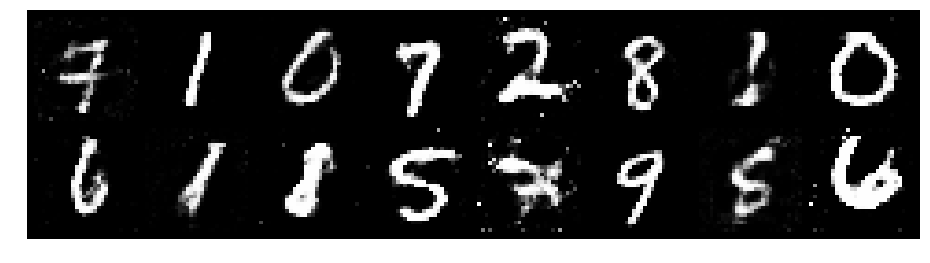

Epoch: [85/200], Batch Num: [0/938]
Discriminator Loss: 1.2573456764221191, Generator Loss: 0.8801693916320801
D(x): 0.5439, D(G(z)): 0.4405


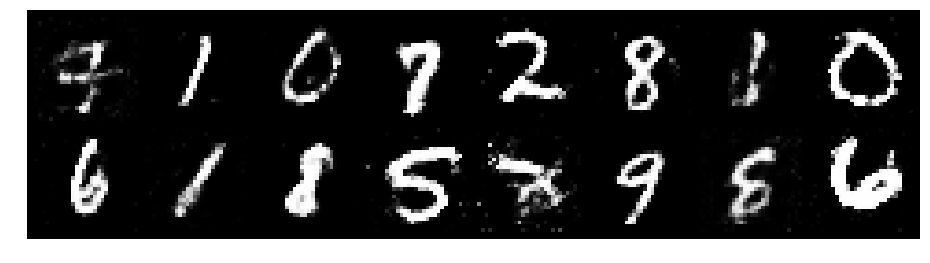

Epoch: [85/200], Batch Num: [100/938]
Discriminator Loss: 1.2106941938400269, Generator Loss: 0.9932040572166443
D(x): 0.5965, D(G(z)): 0.4413


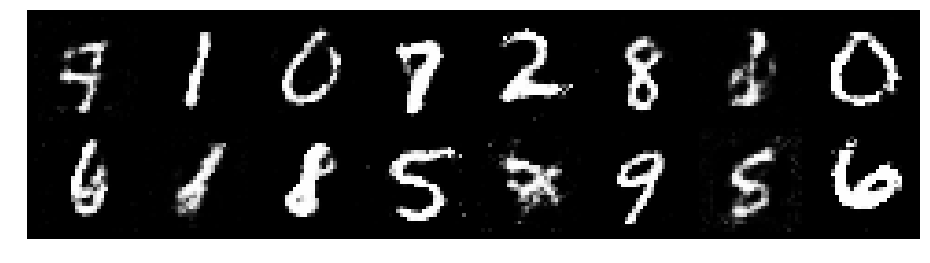

Epoch: [85/200], Batch Num: [200/938]
Discriminator Loss: 1.227250576019287, Generator Loss: 0.8939753770828247
D(x): 0.5353, D(G(z)): 0.4113


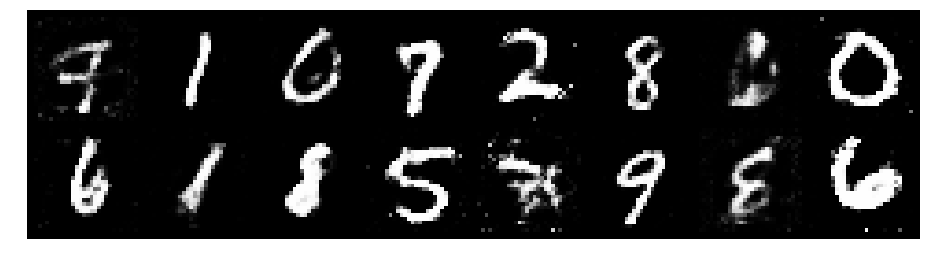

Epoch: [85/200], Batch Num: [300/938]
Discriminator Loss: 1.2756154537200928, Generator Loss: 0.9002721905708313
D(x): 0.5525, D(G(z)): 0.4523


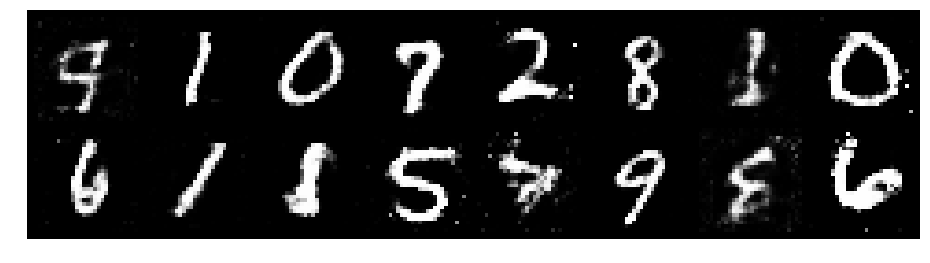

Epoch: [85/200], Batch Num: [400/938]
Discriminator Loss: 1.3318812847137451, Generator Loss: 0.7264432907104492
D(x): 0.5371, D(G(z)): 0.4646


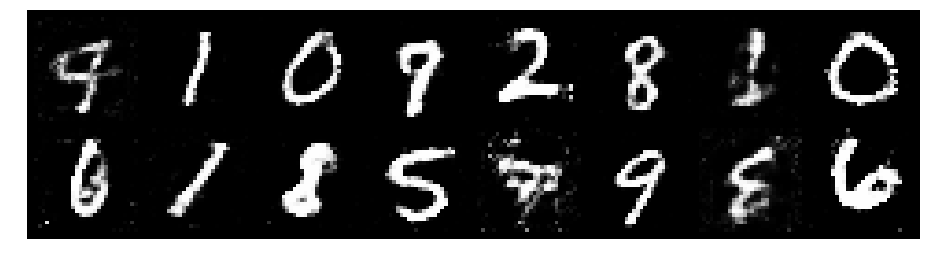

Epoch: [85/200], Batch Num: [500/938]
Discriminator Loss: 1.4196538925170898, Generator Loss: 0.9113864898681641
D(x): 0.4831, D(G(z)): 0.4308


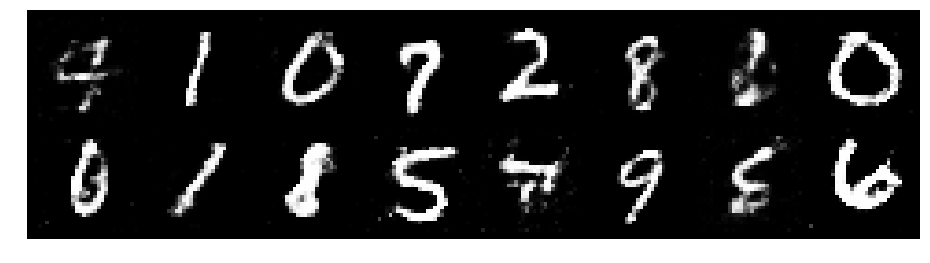

Epoch: [85/200], Batch Num: [600/938]
Discriminator Loss: 1.3921875953674316, Generator Loss: 0.7818124294281006
D(x): 0.5394, D(G(z)): 0.4924


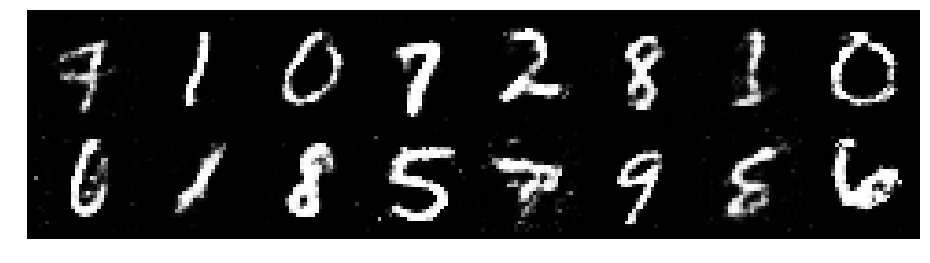

Epoch: [85/200], Batch Num: [700/938]
Discriminator Loss: 1.26377534866333, Generator Loss: 1.0393503904342651
D(x): 0.5329, D(G(z)): 0.4074


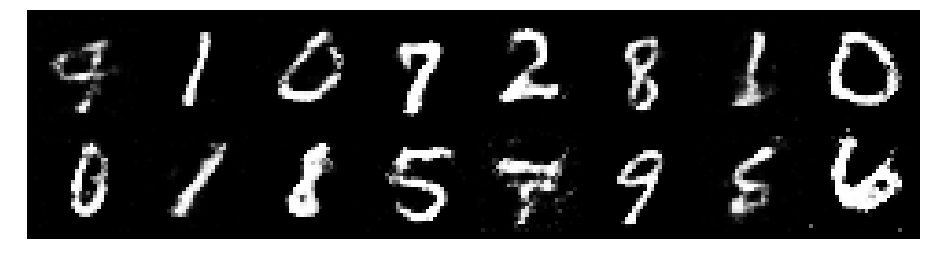

Epoch: [85/200], Batch Num: [800/938]
Discriminator Loss: 1.2059704065322876, Generator Loss: 0.938811719417572
D(x): 0.5356, D(G(z)): 0.3934


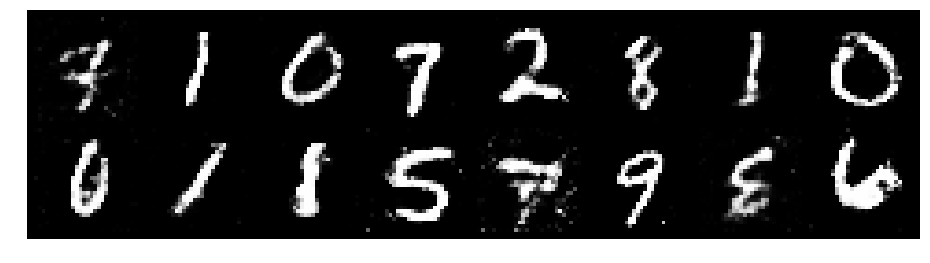

Epoch: [85/200], Batch Num: [900/938]
Discriminator Loss: 1.260079264640808, Generator Loss: 0.9637240767478943
D(x): 0.5589, D(G(z)): 0.4232


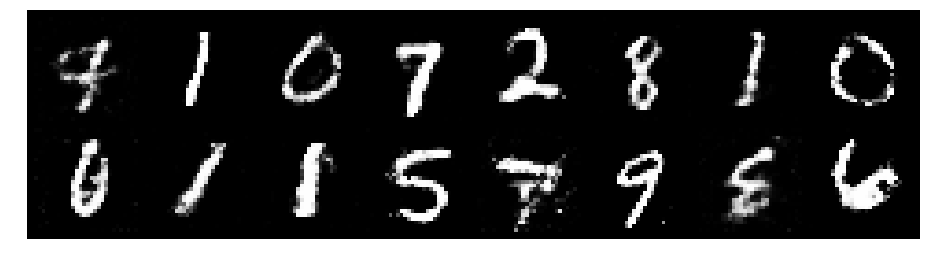

Epoch: [86/200], Batch Num: [0/938]
Discriminator Loss: 1.2125906944274902, Generator Loss: 0.8824438452720642
D(x): 0.5562, D(G(z)): 0.4350


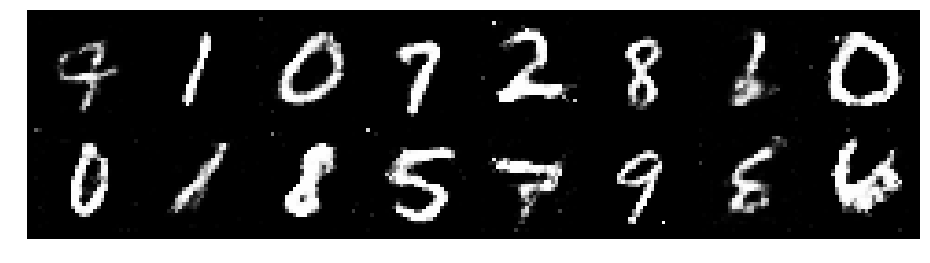

Epoch: [86/200], Batch Num: [100/938]
Discriminator Loss: 1.323960304260254, Generator Loss: 0.7806030511856079
D(x): 0.5293, D(G(z)): 0.4660


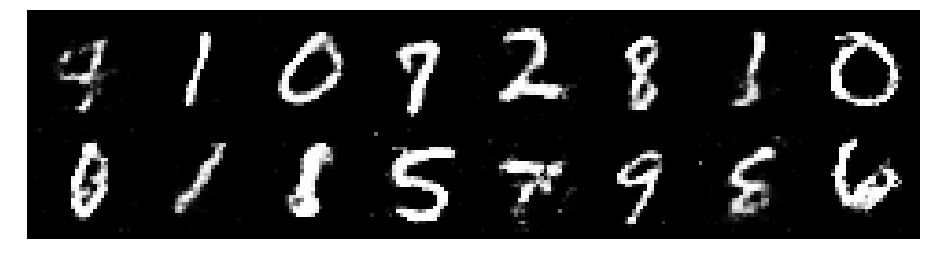

Epoch: [86/200], Batch Num: [200/938]
Discriminator Loss: 1.3794195652008057, Generator Loss: 0.8630031943321228
D(x): 0.5275, D(G(z)): 0.4708


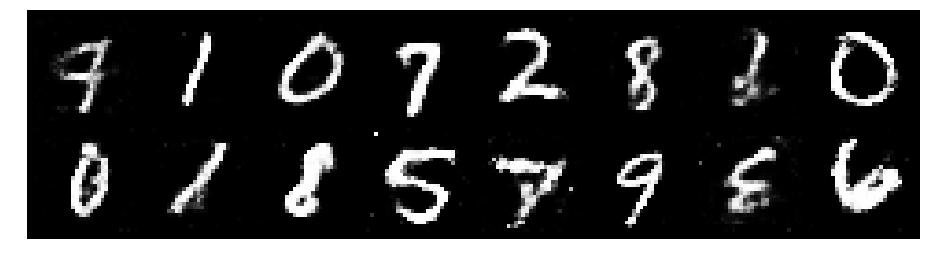

Epoch: [86/200], Batch Num: [300/938]
Discriminator Loss: 1.2255983352661133, Generator Loss: 0.9439055323600769
D(x): 0.5273, D(G(z)): 0.3940


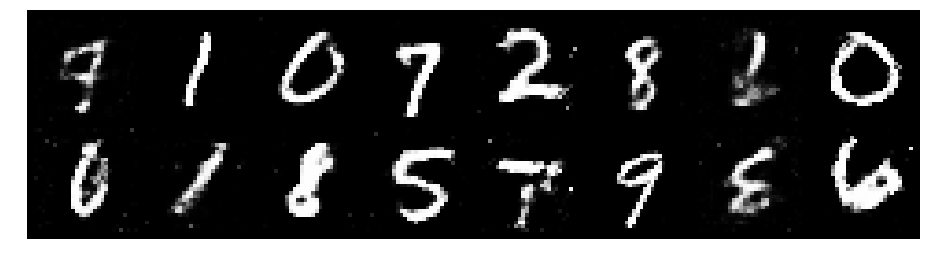

Epoch: [86/200], Batch Num: [400/938]
Discriminator Loss: 1.2822628021240234, Generator Loss: 1.022216796875
D(x): 0.5446, D(G(z)): 0.4253


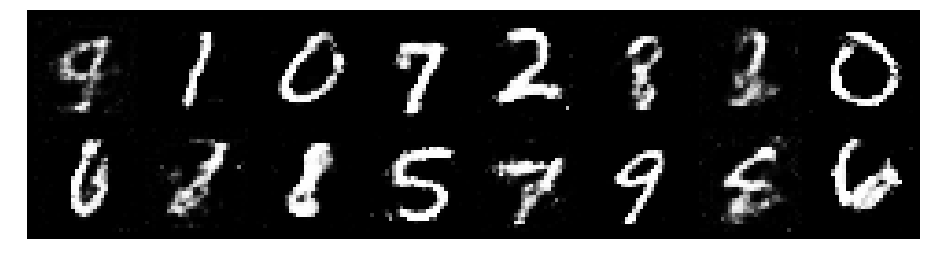

Epoch: [86/200], Batch Num: [500/938]
Discriminator Loss: 1.247005581855774, Generator Loss: 0.9015228748321533
D(x): 0.5446, D(G(z)): 0.4376


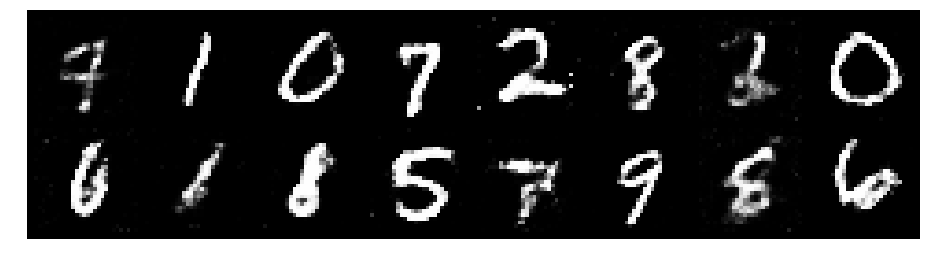

Epoch: [86/200], Batch Num: [600/938]
Discriminator Loss: 1.2744965553283691, Generator Loss: 0.9243593215942383
D(x): 0.5136, D(G(z)): 0.3869


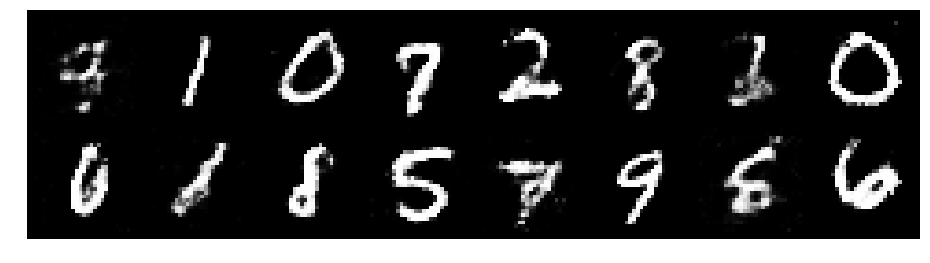

Epoch: [86/200], Batch Num: [700/938]
Discriminator Loss: 1.2756567001342773, Generator Loss: 0.8711605668067932
D(x): 0.5296, D(G(z)): 0.4321


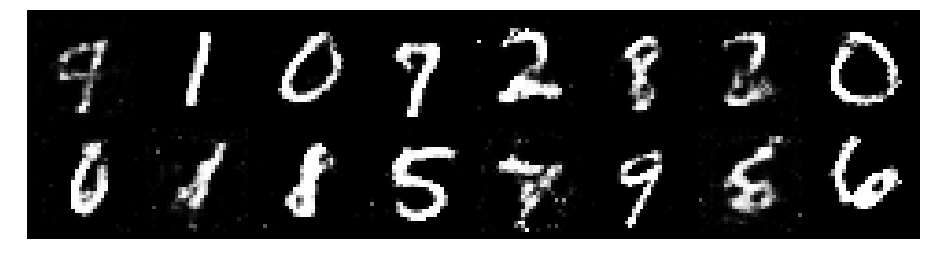

Epoch: [86/200], Batch Num: [800/938]
Discriminator Loss: 1.2260558605194092, Generator Loss: 1.02711820602417
D(x): 0.5566, D(G(z)): 0.4091


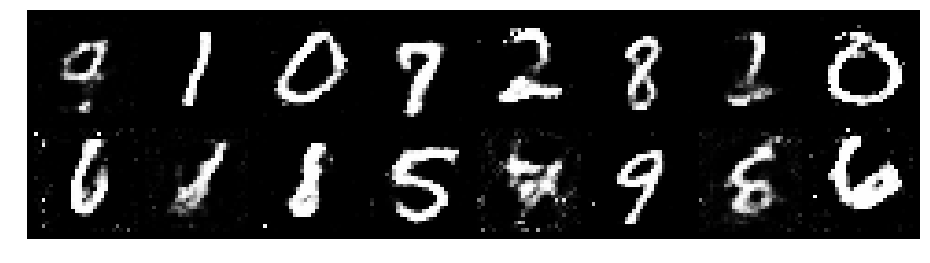

Epoch: [86/200], Batch Num: [900/938]
Discriminator Loss: 1.2291598320007324, Generator Loss: 0.8125373125076294
D(x): 0.5785, D(G(z)): 0.4484


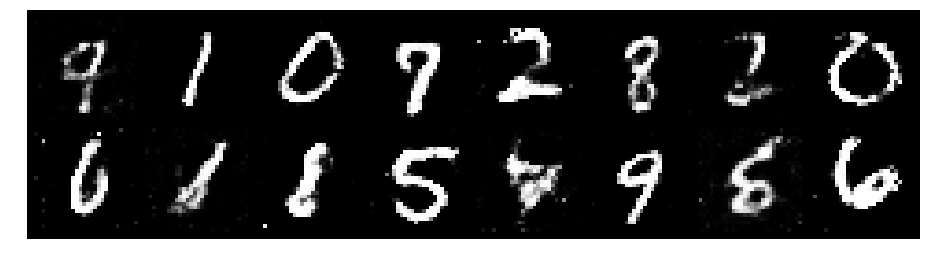

Epoch: [87/200], Batch Num: [0/938]
Discriminator Loss: 1.2787576913833618, Generator Loss: 0.7946231365203857
D(x): 0.5407, D(G(z)): 0.4338


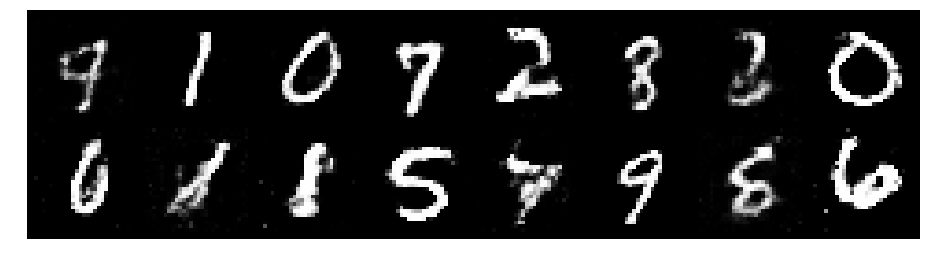

Epoch: [87/200], Batch Num: [100/938]
Discriminator Loss: 1.2360243797302246, Generator Loss: 0.9397705793380737
D(x): 0.5594, D(G(z)): 0.4138


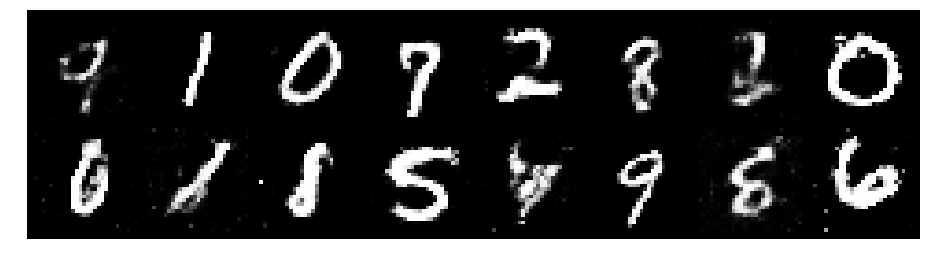

Epoch: [87/200], Batch Num: [200/938]
Discriminator Loss: 1.2737387418746948, Generator Loss: 0.7608165740966797
D(x): 0.5813, D(G(z)): 0.4548


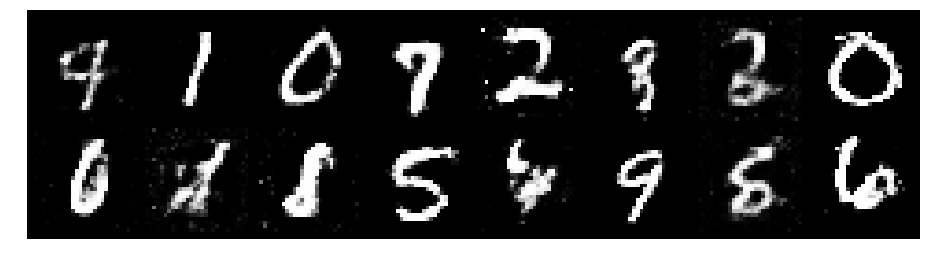

Epoch: [87/200], Batch Num: [300/938]
Discriminator Loss: 1.3320506811141968, Generator Loss: 0.7573487162590027
D(x): 0.6471, D(G(z)): 0.5192


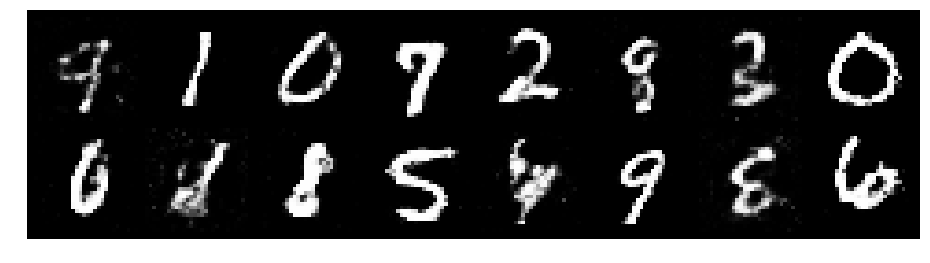

Epoch: [87/200], Batch Num: [400/938]
Discriminator Loss: 1.4309241771697998, Generator Loss: 0.9130253791809082
D(x): 0.5439, D(G(z)): 0.4352


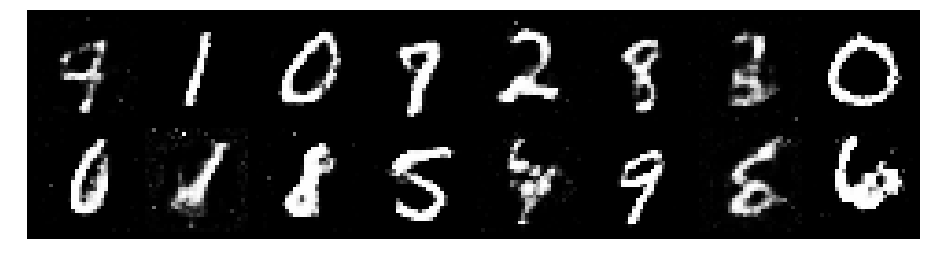

Epoch: [87/200], Batch Num: [500/938]
Discriminator Loss: 1.298710823059082, Generator Loss: 0.9870142340660095
D(x): 0.5377, D(G(z)): 0.4228


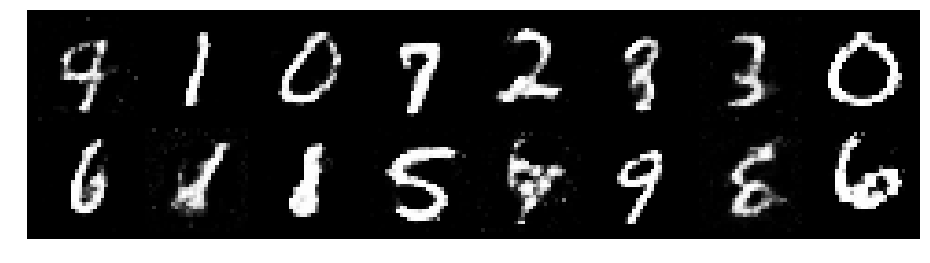

Epoch: [87/200], Batch Num: [600/938]
Discriminator Loss: 1.1894383430480957, Generator Loss: 0.8562430143356323
D(x): 0.5774, D(G(z)): 0.4161


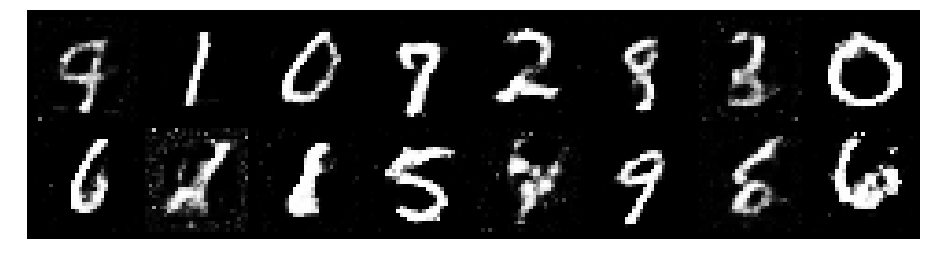

Epoch: [87/200], Batch Num: [700/938]
Discriminator Loss: 1.2273602485656738, Generator Loss: 0.8872476816177368
D(x): 0.5851, D(G(z)): 0.4573


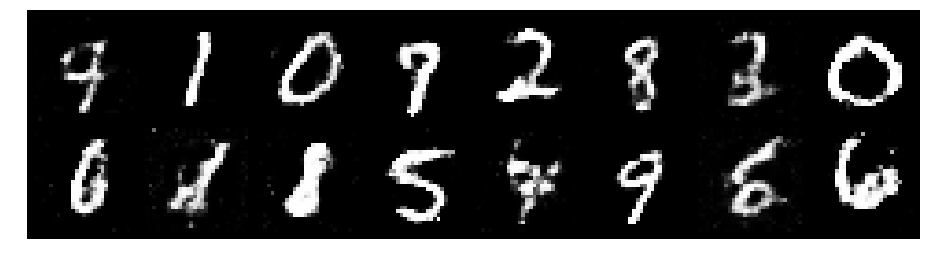

Epoch: [87/200], Batch Num: [800/938]
Discriminator Loss: 1.2277812957763672, Generator Loss: 0.8289445638656616
D(x): 0.5521, D(G(z)): 0.4420


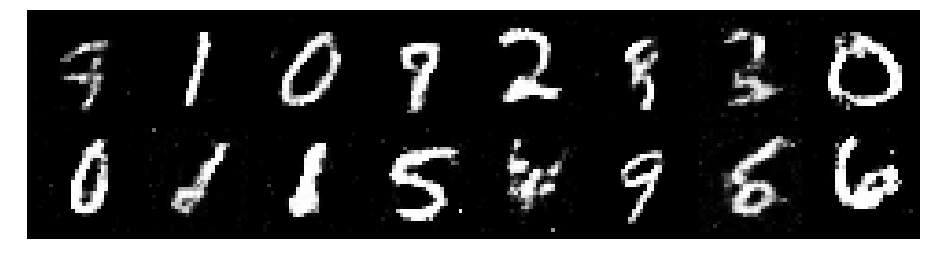

Epoch: [87/200], Batch Num: [900/938]
Discriminator Loss: 1.314016580581665, Generator Loss: 0.8781161308288574
D(x): 0.5316, D(G(z)): 0.4476


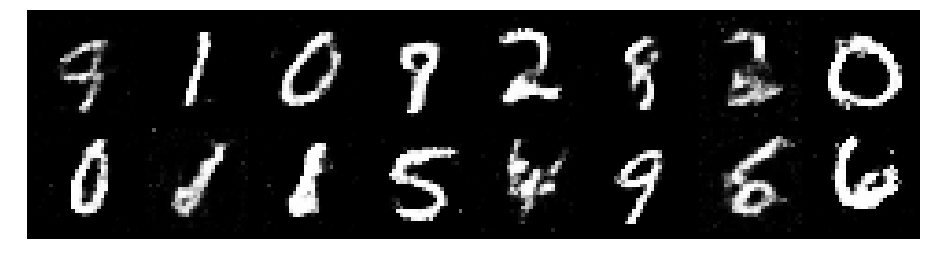

Epoch: [88/200], Batch Num: [0/938]
Discriminator Loss: 1.3265531063079834, Generator Loss: 0.8730748891830444
D(x): 0.5148, D(G(z)): 0.4262


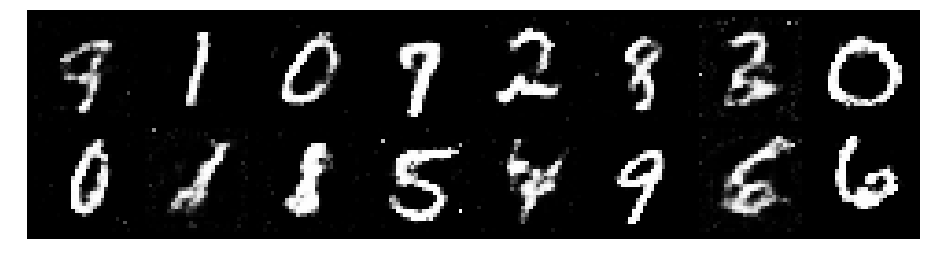

Epoch: [88/200], Batch Num: [100/938]
Discriminator Loss: 1.219185709953308, Generator Loss: 0.9174291491508484
D(x): 0.5876, D(G(z)): 0.4447


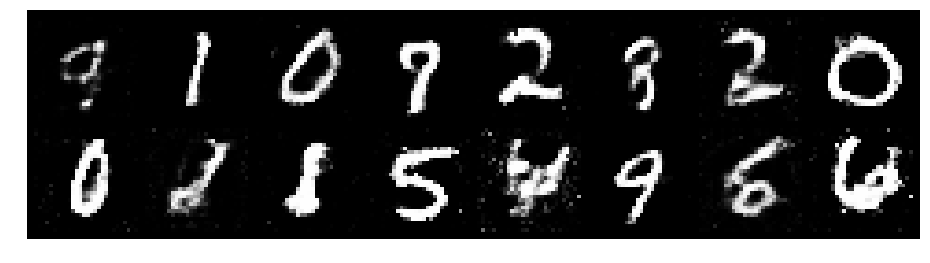

Epoch: [88/200], Batch Num: [200/938]
Discriminator Loss: 1.3413524627685547, Generator Loss: 0.8488163948059082
D(x): 0.5892, D(G(z)): 0.5017


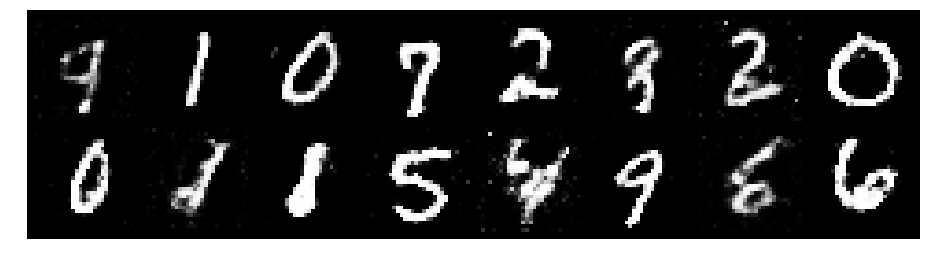

Epoch: [88/200], Batch Num: [300/938]
Discriminator Loss: 1.1976242065429688, Generator Loss: 0.8807671070098877
D(x): 0.5770, D(G(z)): 0.4145


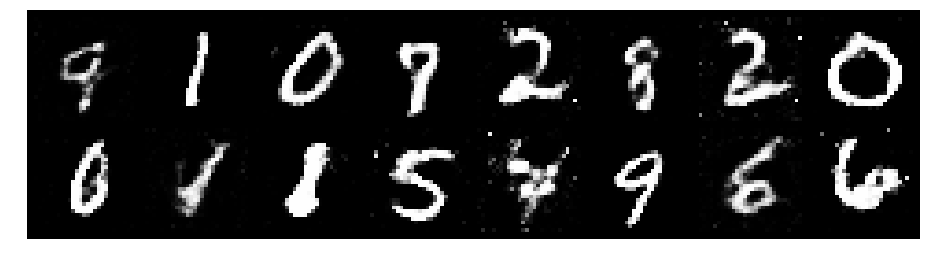

Epoch: [88/200], Batch Num: [400/938]
Discriminator Loss: 1.2198574542999268, Generator Loss: 0.882205605506897
D(x): 0.5635, D(G(z)): 0.4443


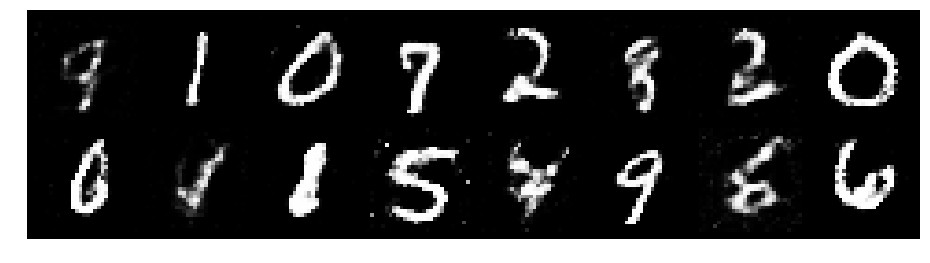

Epoch: [88/200], Batch Num: [500/938]
Discriminator Loss: 1.3456945419311523, Generator Loss: 0.828132688999176
D(x): 0.5611, D(G(z)): 0.4834


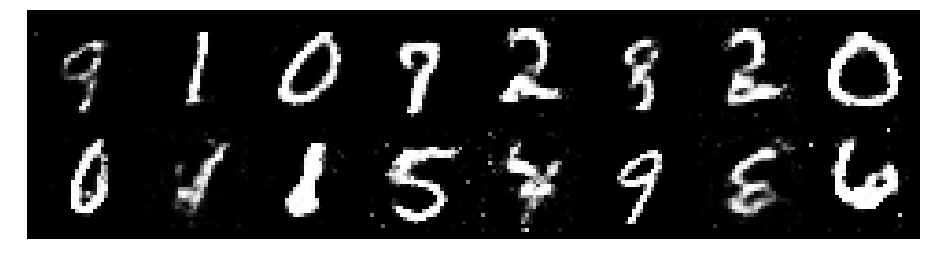

Epoch: [88/200], Batch Num: [600/938]
Discriminator Loss: 1.3549494743347168, Generator Loss: 0.8611951470375061
D(x): 0.5845, D(G(z)): 0.4896


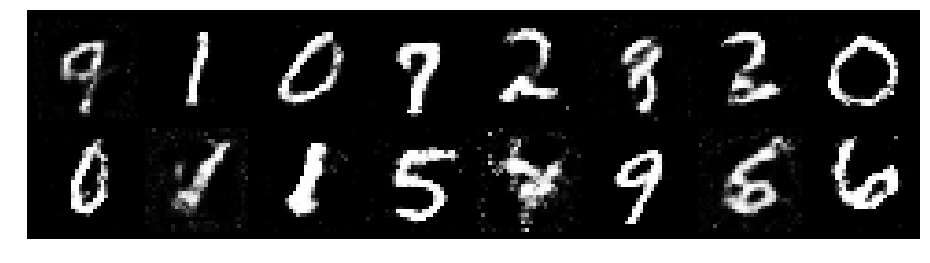

Epoch: [88/200], Batch Num: [700/938]
Discriminator Loss: 1.2038087844848633, Generator Loss: 0.8432590365409851
D(x): 0.5838, D(G(z)): 0.4504


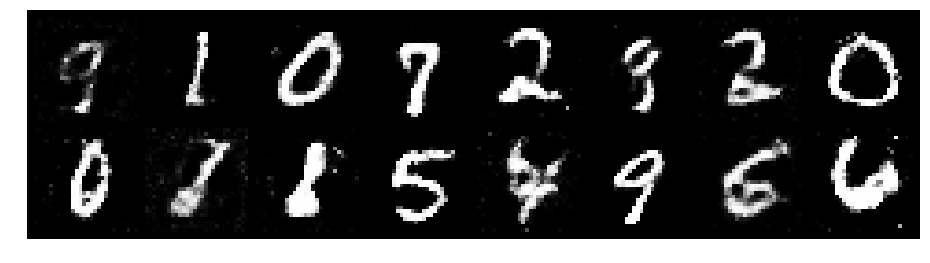

Epoch: [88/200], Batch Num: [800/938]
Discriminator Loss: 1.1275050640106201, Generator Loss: 0.8067626953125
D(x): 0.5973, D(G(z)): 0.4191


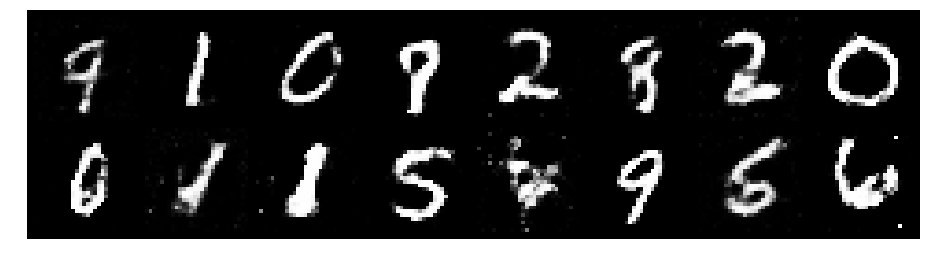

Epoch: [88/200], Batch Num: [900/938]
Discriminator Loss: 1.3317424058914185, Generator Loss: 0.8793829083442688
D(x): 0.5460, D(G(z)): 0.4632


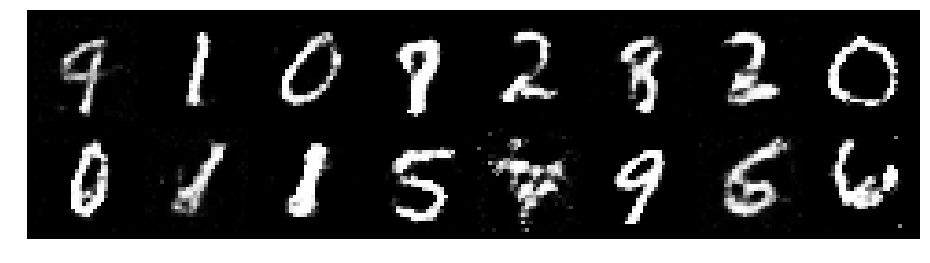

Epoch: [89/200], Batch Num: [0/938]
Discriminator Loss: 1.2685675621032715, Generator Loss: 0.895314633846283
D(x): 0.5740, D(G(z)): 0.4356


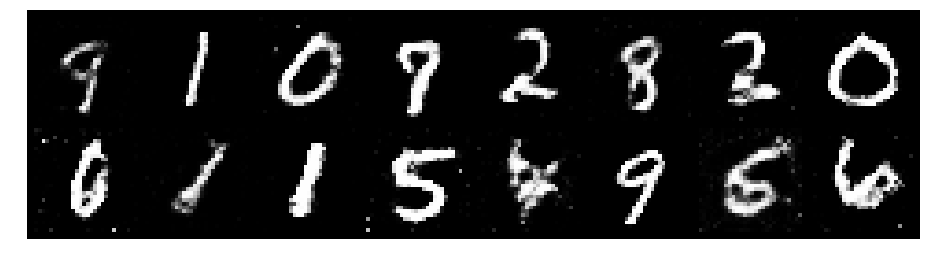

Epoch: [89/200], Batch Num: [100/938]
Discriminator Loss: 1.1589713096618652, Generator Loss: 0.8785502314567566
D(x): 0.5952, D(G(z)): 0.4304


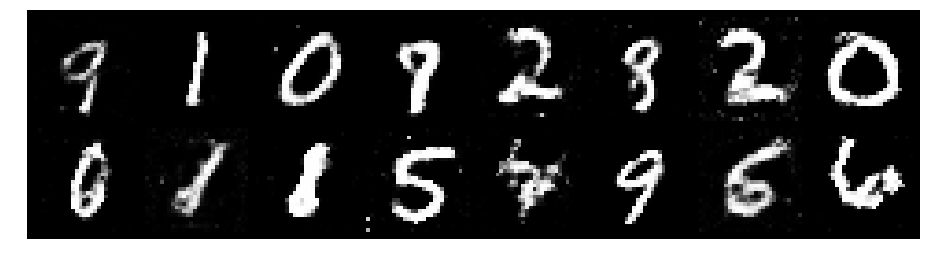

Epoch: [89/200], Batch Num: [200/938]
Discriminator Loss: 1.1663756370544434, Generator Loss: 0.8376771211624146
D(x): 0.5978, D(G(z)): 0.4426


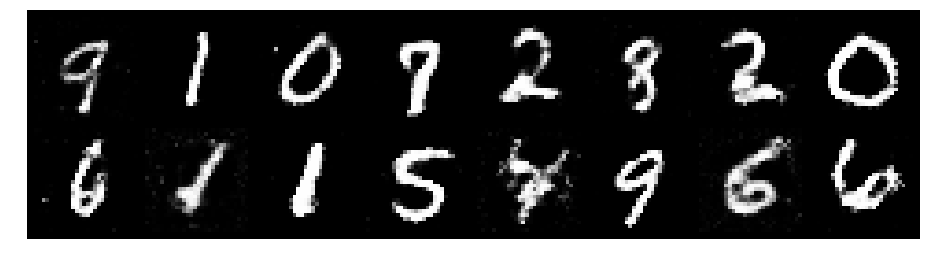

Epoch: [89/200], Batch Num: [300/938]
Discriminator Loss: 1.317664384841919, Generator Loss: 0.8476506471633911
D(x): 0.5216, D(G(z)): 0.4350


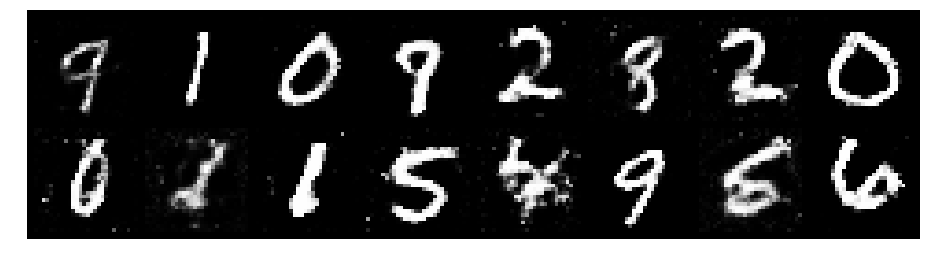

Epoch: [89/200], Batch Num: [400/938]
Discriminator Loss: 1.2944589853286743, Generator Loss: 0.8359807729721069
D(x): 0.5516, D(G(z)): 0.4610


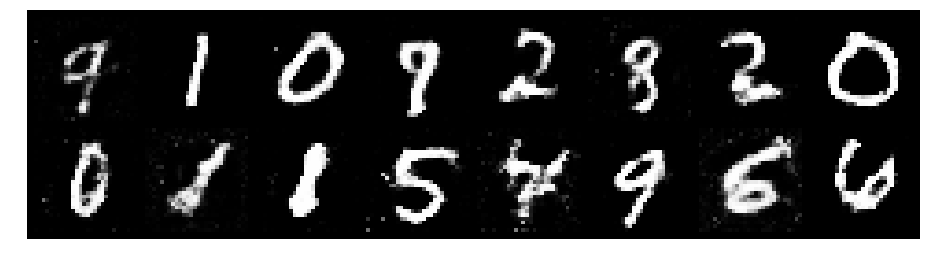

Epoch: [89/200], Batch Num: [500/938]
Discriminator Loss: 1.2592077255249023, Generator Loss: 0.7701073884963989
D(x): 0.5647, D(G(z)): 0.4666


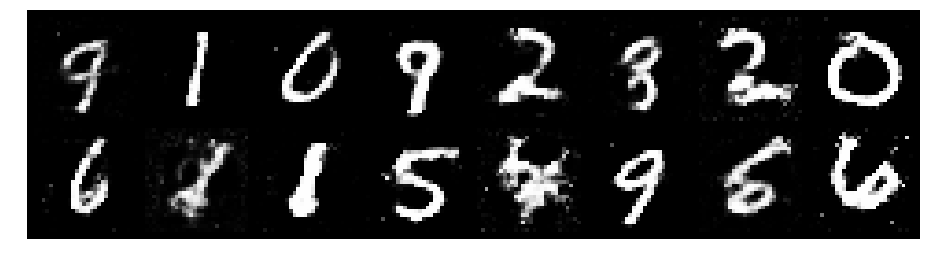

Epoch: [89/200], Batch Num: [600/938]
Discriminator Loss: 1.2843563556671143, Generator Loss: 0.8985373973846436
D(x): 0.5510, D(G(z)): 0.4394


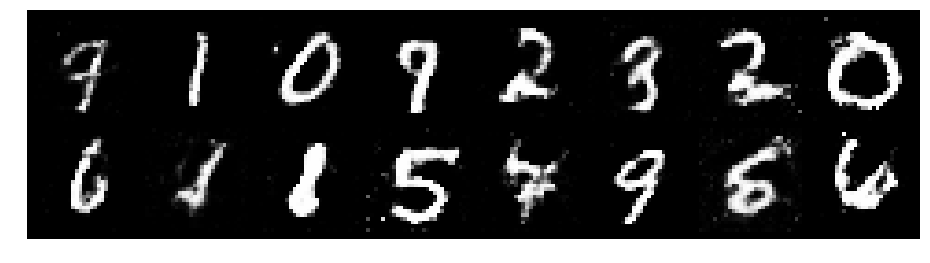

Epoch: [89/200], Batch Num: [700/938]
Discriminator Loss: 1.2707350254058838, Generator Loss: 0.9877362251281738
D(x): 0.4973, D(G(z)): 0.4037


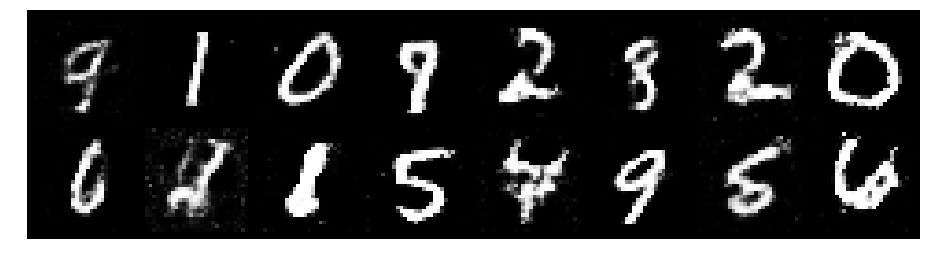

Epoch: [89/200], Batch Num: [800/938]
Discriminator Loss: 1.2415266036987305, Generator Loss: 1.0112648010253906
D(x): 0.5762, D(G(z)): 0.4404


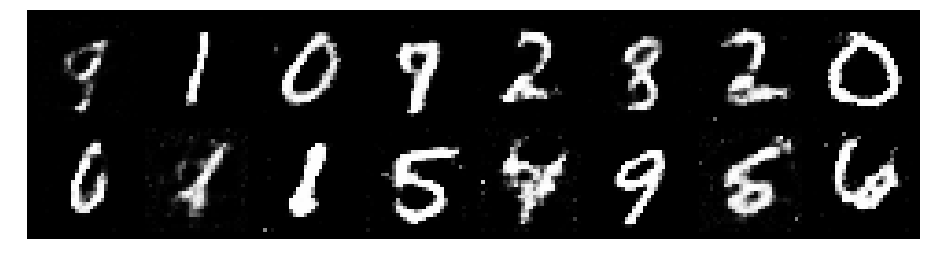

Epoch: [89/200], Batch Num: [900/938]
Discriminator Loss: 1.180459976196289, Generator Loss: 0.9468656778335571
D(x): 0.5694, D(G(z)): 0.3977


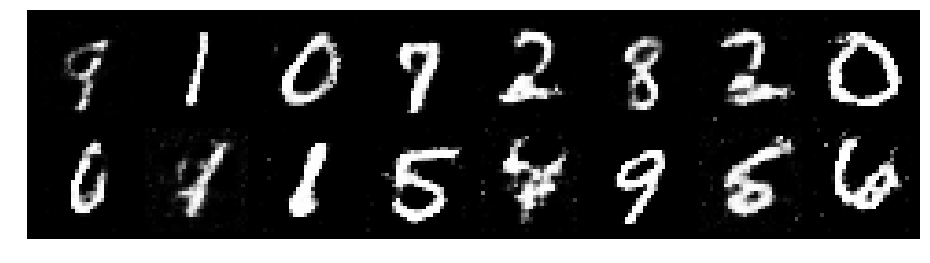

Epoch: [90/200], Batch Num: [0/938]
Discriminator Loss: 1.1926538944244385, Generator Loss: 0.9605868458747864
D(x): 0.5765, D(G(z)): 0.4247


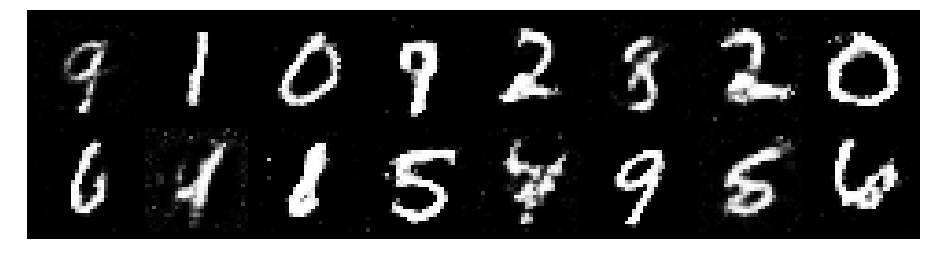

Epoch: [90/200], Batch Num: [100/938]
Discriminator Loss: 1.1687238216400146, Generator Loss: 1.0093097686767578
D(x): 0.5967, D(G(z)): 0.4227


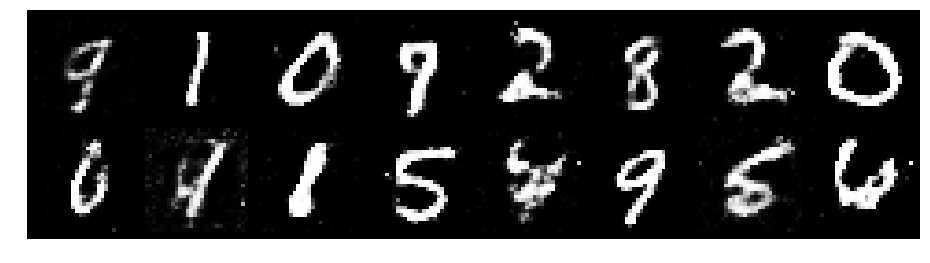

Epoch: [90/200], Batch Num: [200/938]
Discriminator Loss: 1.120837688446045, Generator Loss: 1.0134046077728271
D(x): 0.5921, D(G(z)): 0.3857


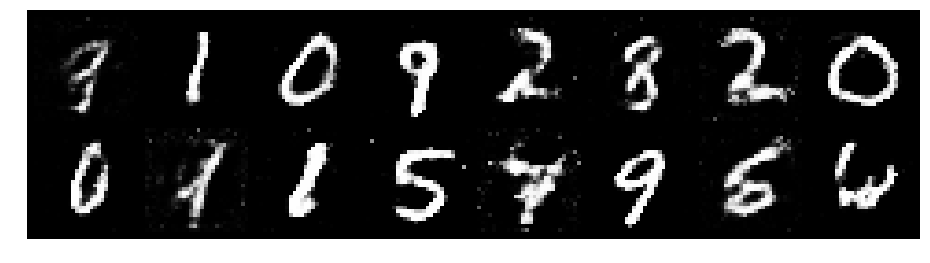

Epoch: [90/200], Batch Num: [300/938]
Discriminator Loss: 1.2092491388320923, Generator Loss: 0.9214133620262146
D(x): 0.5480, D(G(z)): 0.3854


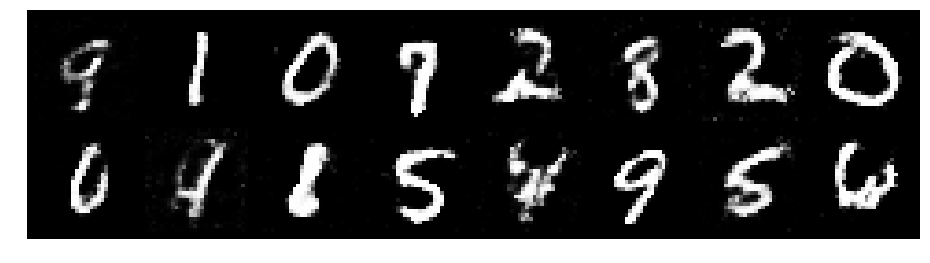

Epoch: [90/200], Batch Num: [400/938]
Discriminator Loss: 1.1418980360031128, Generator Loss: 0.8974499702453613
D(x): 0.6074, D(G(z)): 0.4281


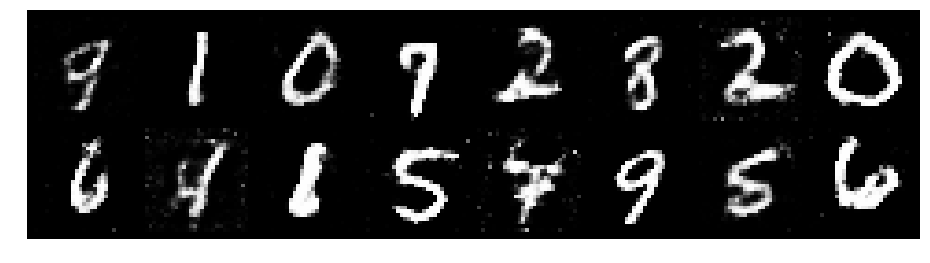

Epoch: [90/200], Batch Num: [500/938]
Discriminator Loss: 1.1393687725067139, Generator Loss: 0.8691720962524414
D(x): 0.6195, D(G(z)): 0.4414


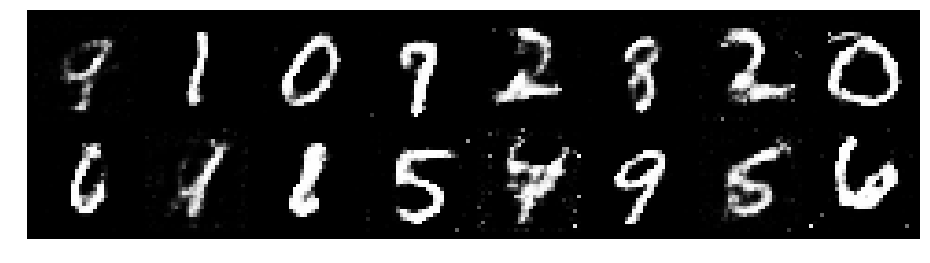

Epoch: [90/200], Batch Num: [600/938]
Discriminator Loss: 1.1850061416625977, Generator Loss: 0.9114773273468018
D(x): 0.5375, D(G(z)): 0.3973


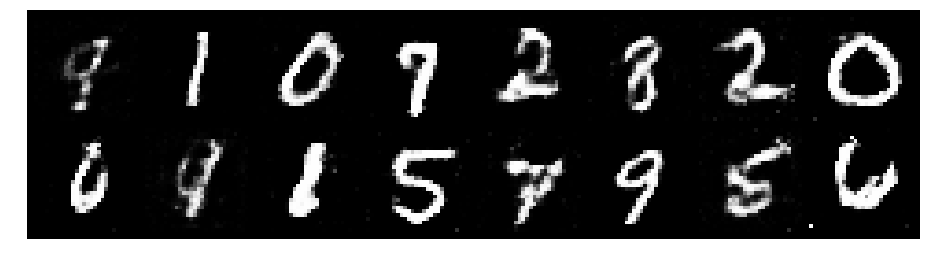

Epoch: [90/200], Batch Num: [700/938]
Discriminator Loss: 1.243405818939209, Generator Loss: 0.9151862859725952
D(x): 0.5725, D(G(z)): 0.4597


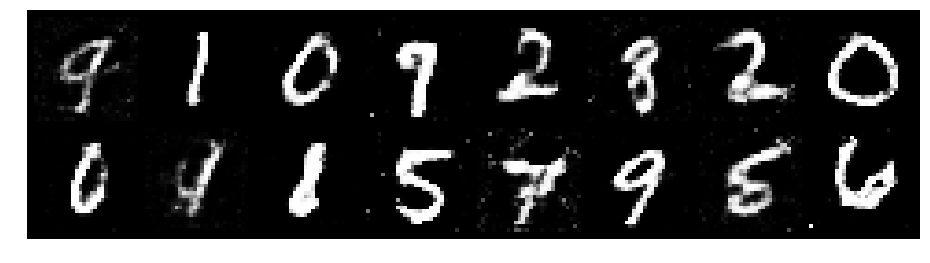

Epoch: [90/200], Batch Num: [800/938]
Discriminator Loss: 1.3003036975860596, Generator Loss: 0.8889950513839722
D(x): 0.5448, D(G(z)): 0.4455


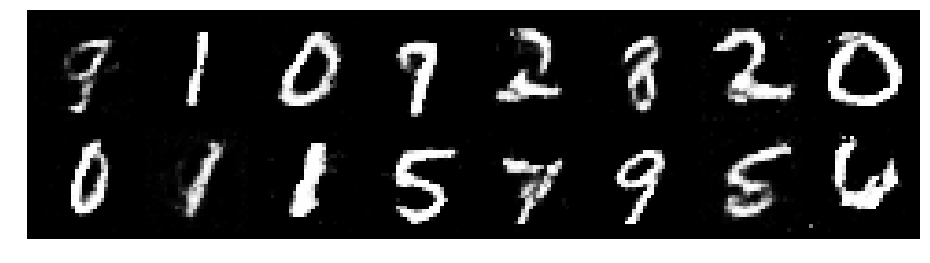

Epoch: [90/200], Batch Num: [900/938]
Discriminator Loss: 1.2627575397491455, Generator Loss: 0.9305179715156555
D(x): 0.5275, D(G(z)): 0.4265


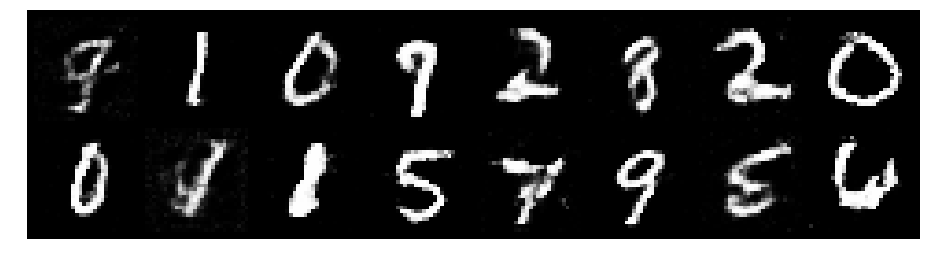

Epoch: [91/200], Batch Num: [0/938]
Discriminator Loss: 1.3891701698303223, Generator Loss: 0.9615380764007568
D(x): 0.4851, D(G(z)): 0.4073


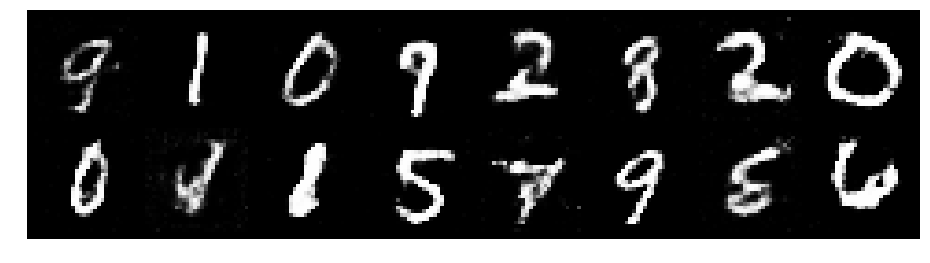

Epoch: [91/200], Batch Num: [100/938]
Discriminator Loss: 1.3149728775024414, Generator Loss: 0.8158273696899414
D(x): 0.5354, D(G(z)): 0.4552


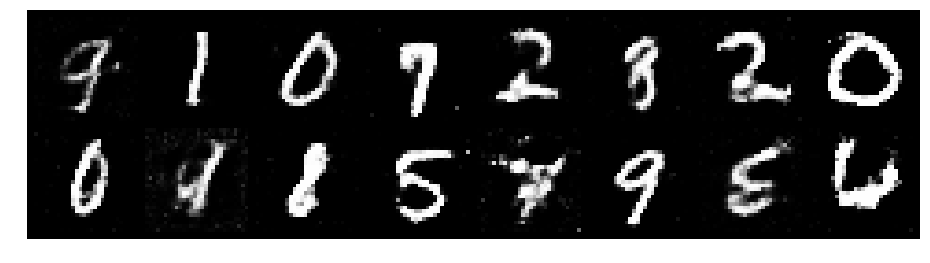

Epoch: [91/200], Batch Num: [200/938]
Discriminator Loss: 1.257781744003296, Generator Loss: 0.8922618627548218
D(x): 0.5569, D(G(z)): 0.4476


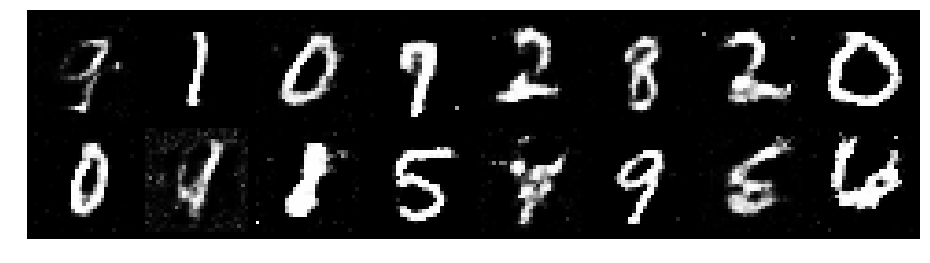

Epoch: [91/200], Batch Num: [300/938]
Discriminator Loss: 1.435461401939392, Generator Loss: 0.8835744857788086
D(x): 0.5465, D(G(z)): 0.4832


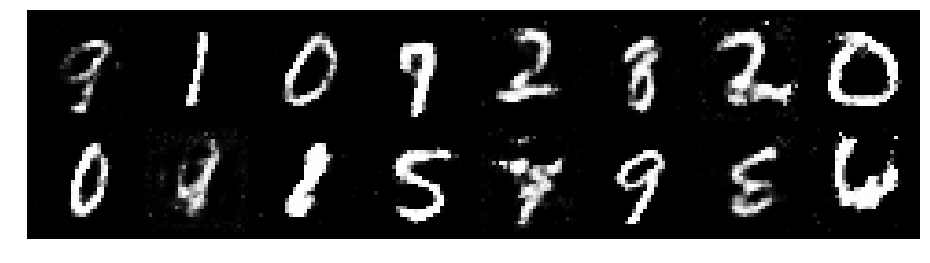

Epoch: [91/200], Batch Num: [400/938]
Discriminator Loss: 1.1917502880096436, Generator Loss: 1.0622923374176025
D(x): 0.5883, D(G(z)): 0.4295


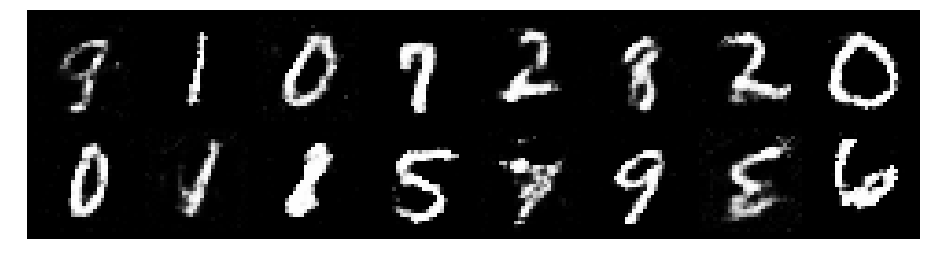

Epoch: [91/200], Batch Num: [500/938]
Discriminator Loss: 1.173457145690918, Generator Loss: 0.8149405717849731
D(x): 0.5828, D(G(z)): 0.4439


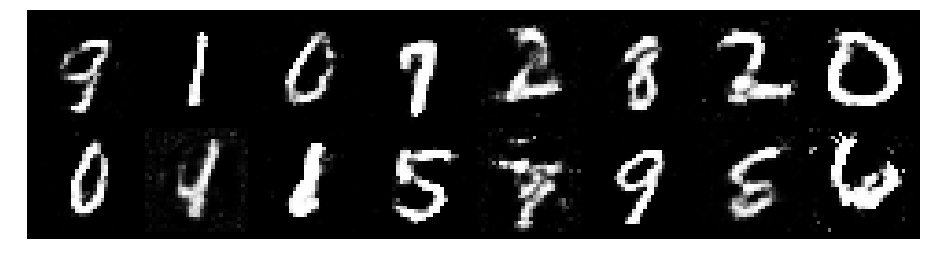

Epoch: [91/200], Batch Num: [600/938]
Discriminator Loss: 1.225714921951294, Generator Loss: 0.9309757351875305
D(x): 0.5500, D(G(z)): 0.4109


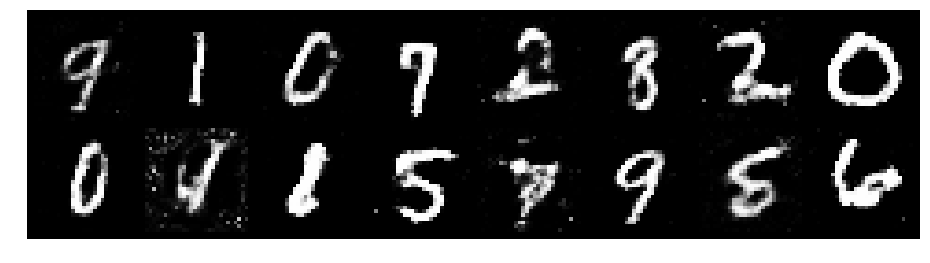

Epoch: [91/200], Batch Num: [700/938]
Discriminator Loss: 1.2988746166229248, Generator Loss: 0.909809410572052
D(x): 0.4897, D(G(z)): 0.3952


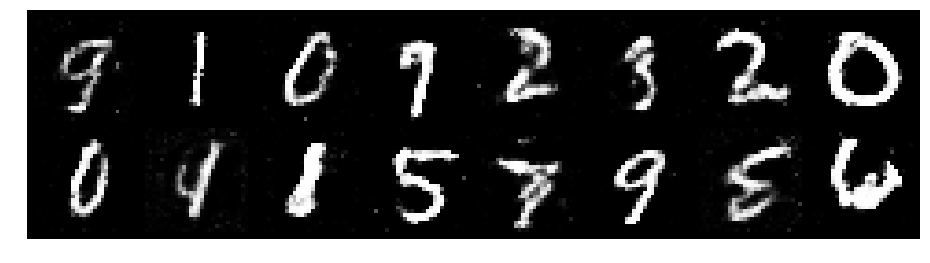

Epoch: [91/200], Batch Num: [800/938]
Discriminator Loss: 1.3465511798858643, Generator Loss: 0.8003486394882202
D(x): 0.5791, D(G(z)): 0.5108


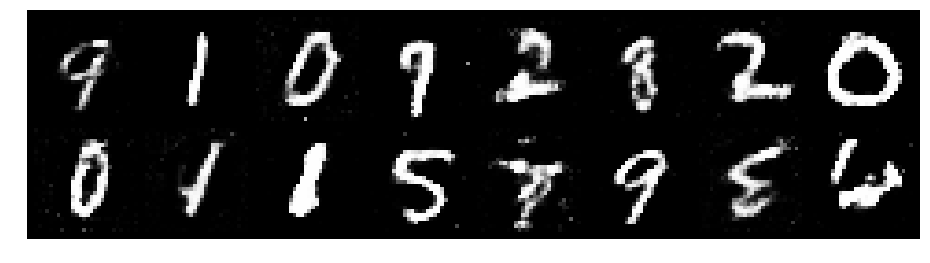

Epoch: [91/200], Batch Num: [900/938]
Discriminator Loss: 1.4571022987365723, Generator Loss: 0.8413937091827393
D(x): 0.4816, D(G(z)): 0.4510


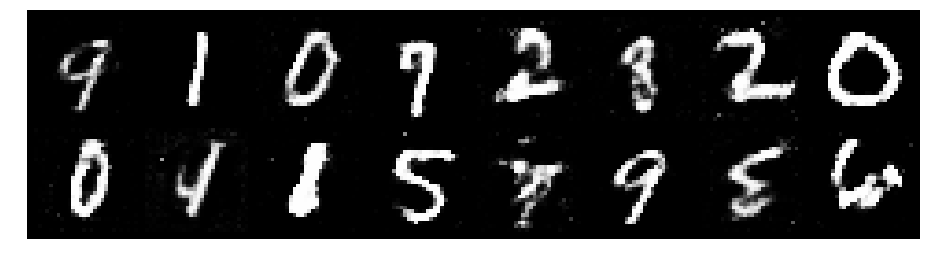

Epoch: [92/200], Batch Num: [0/938]
Discriminator Loss: 1.2147166728973389, Generator Loss: 0.8615151643753052
D(x): 0.5715, D(G(z)): 0.4231


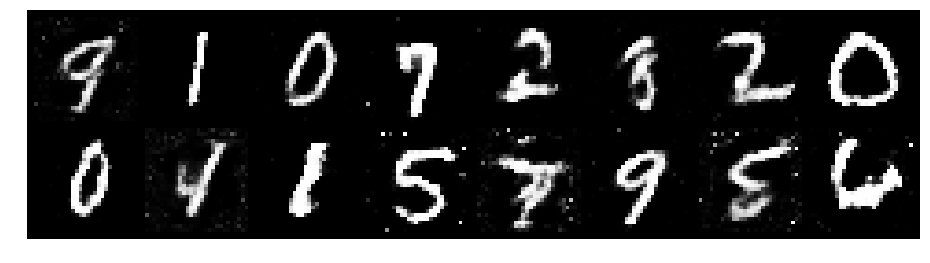

Epoch: [92/200], Batch Num: [100/938]
Discriminator Loss: 1.4082448482513428, Generator Loss: 0.9972124695777893
D(x): 0.4777, D(G(z)): 0.4197


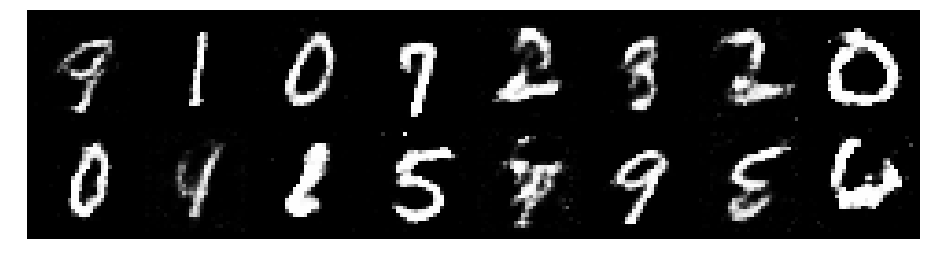

Epoch: [92/200], Batch Num: [200/938]
Discriminator Loss: 1.2321845293045044, Generator Loss: 0.9335471391677856
D(x): 0.6143, D(G(z)): 0.4832


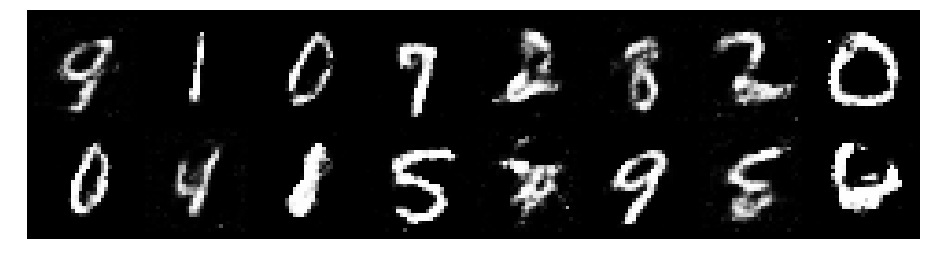

Epoch: [92/200], Batch Num: [300/938]
Discriminator Loss: 1.310500144958496, Generator Loss: 0.9403377771377563
D(x): 0.5601, D(G(z)): 0.4709


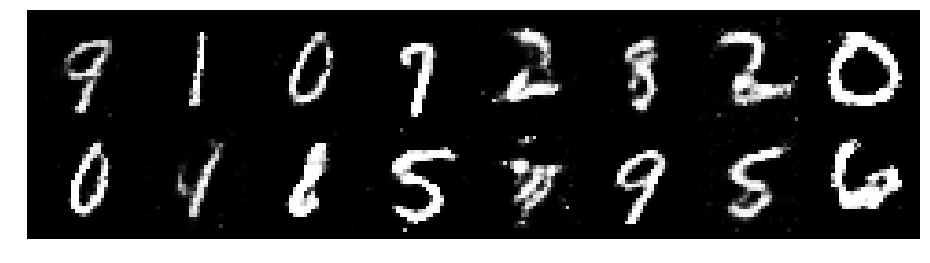

Epoch: [92/200], Batch Num: [400/938]
Discriminator Loss: 1.2445639371871948, Generator Loss: 0.8598991632461548
D(x): 0.5668, D(G(z)): 0.4508


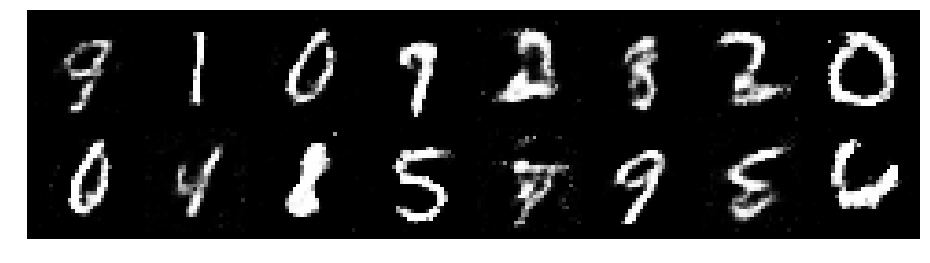

Epoch: [92/200], Batch Num: [500/938]
Discriminator Loss: 1.322307825088501, Generator Loss: 0.8529198169708252
D(x): 0.4962, D(G(z)): 0.4248


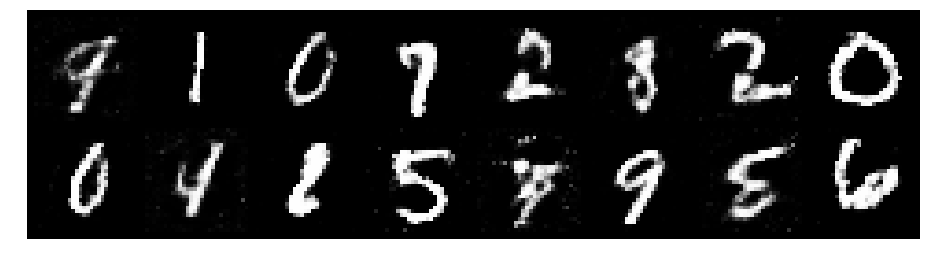

Epoch: [92/200], Batch Num: [600/938]
Discriminator Loss: 1.1566747426986694, Generator Loss: 0.8979028463363647
D(x): 0.5706, D(G(z)): 0.4159


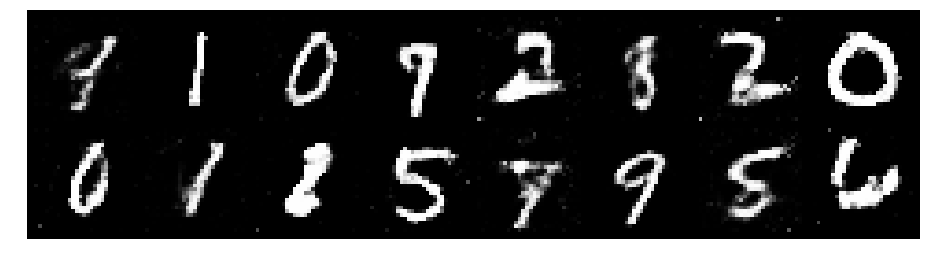

Epoch: [92/200], Batch Num: [700/938]
Discriminator Loss: 1.223101258277893, Generator Loss: 0.9272952675819397
D(x): 0.5393, D(G(z)): 0.4183


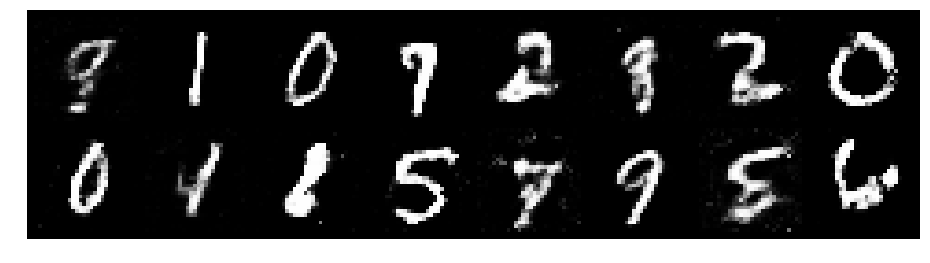

Epoch: [92/200], Batch Num: [800/938]
Discriminator Loss: 1.246964693069458, Generator Loss: 1.0359721183776855
D(x): 0.5647, D(G(z)): 0.4481


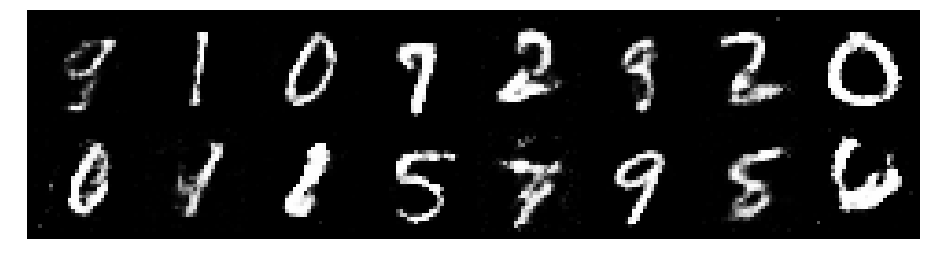

Epoch: [92/200], Batch Num: [900/938]
Discriminator Loss: 1.3930394649505615, Generator Loss: 0.8375362157821655
D(x): 0.5351, D(G(z)): 0.4985


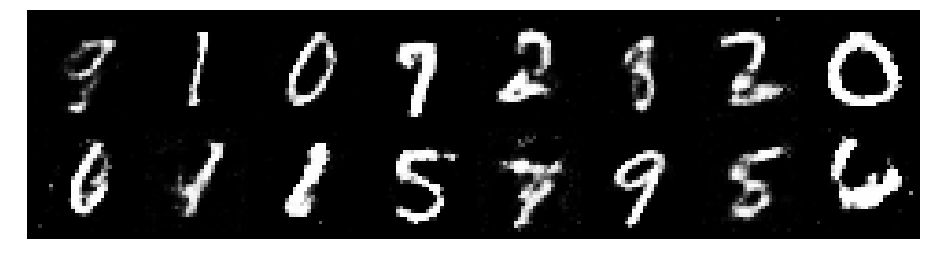

Epoch: [93/200], Batch Num: [0/938]
Discriminator Loss: 1.1876485347747803, Generator Loss: 0.7978510856628418
D(x): 0.5950, D(G(z)): 0.4377


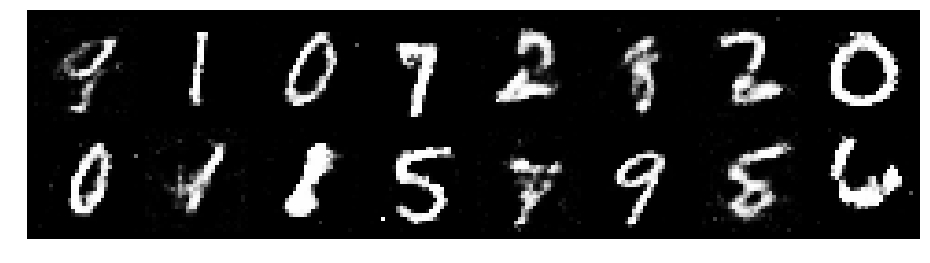

Epoch: [93/200], Batch Num: [100/938]
Discriminator Loss: 1.4035028219223022, Generator Loss: 0.8090757727622986
D(x): 0.5122, D(G(z)): 0.4706


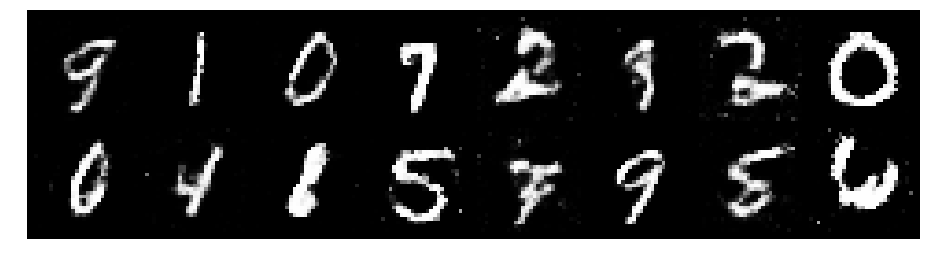

Epoch: [93/200], Batch Num: [200/938]
Discriminator Loss: 1.2824127674102783, Generator Loss: 0.8253864645957947
D(x): 0.5399, D(G(z)): 0.4442


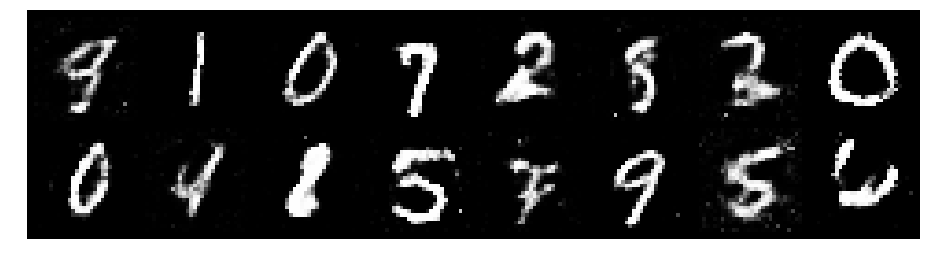

Epoch: [93/200], Batch Num: [300/938]
Discriminator Loss: 1.2814079523086548, Generator Loss: 1.031184196472168
D(x): 0.5256, D(G(z)): 0.4295


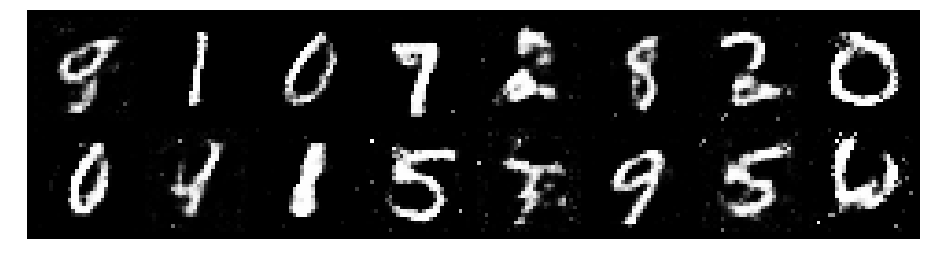

Epoch: [93/200], Batch Num: [400/938]
Discriminator Loss: 1.258850336074829, Generator Loss: 0.9513840675354004
D(x): 0.5361, D(G(z)): 0.4338


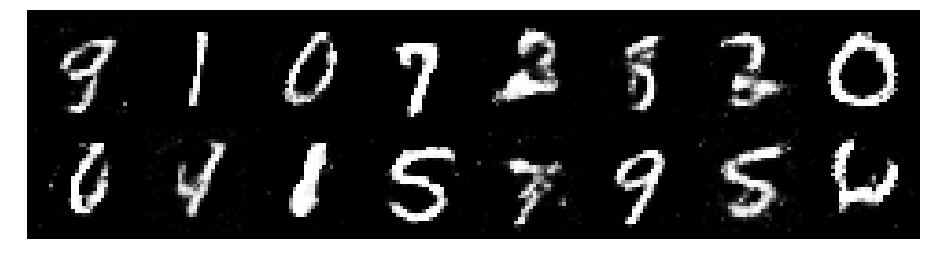

Epoch: [93/200], Batch Num: [500/938]
Discriminator Loss: 1.1880466938018799, Generator Loss: 0.8847633600234985
D(x): 0.5756, D(G(z)): 0.4333


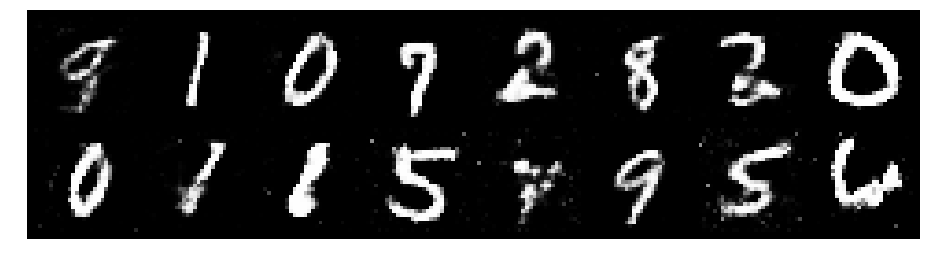

Epoch: [93/200], Batch Num: [600/938]
Discriminator Loss: 1.2299572229385376, Generator Loss: 0.9190965294837952
D(x): 0.5534, D(G(z)): 0.4167


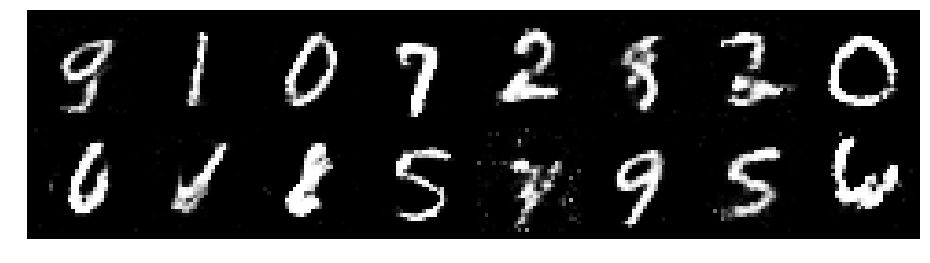

Epoch: [93/200], Batch Num: [700/938]
Discriminator Loss: 1.3140294551849365, Generator Loss: 0.892791748046875
D(x): 0.5562, D(G(z)): 0.4443


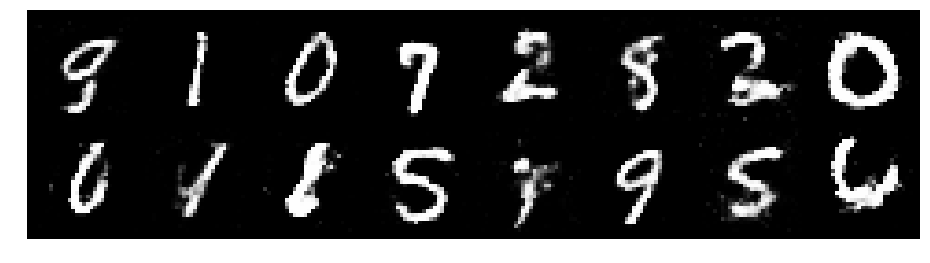

Epoch: [93/200], Batch Num: [800/938]
Discriminator Loss: 1.1953363418579102, Generator Loss: 0.8111685514450073
D(x): 0.5618, D(G(z)): 0.4181


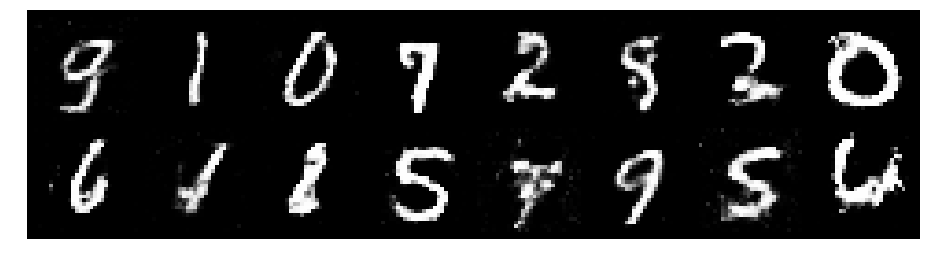

Epoch: [93/200], Batch Num: [900/938]
Discriminator Loss: 1.290703535079956, Generator Loss: 0.884760856628418
D(x): 0.5756, D(G(z)): 0.4676


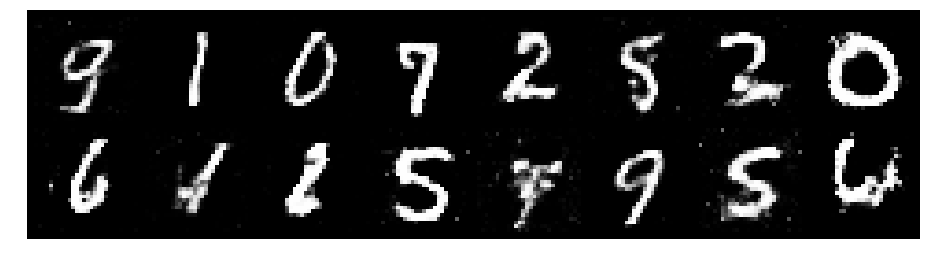

Epoch: [94/200], Batch Num: [0/938]
Discriminator Loss: 1.3424745798110962, Generator Loss: 0.8577933311462402
D(x): 0.5176, D(G(z)): 0.4444


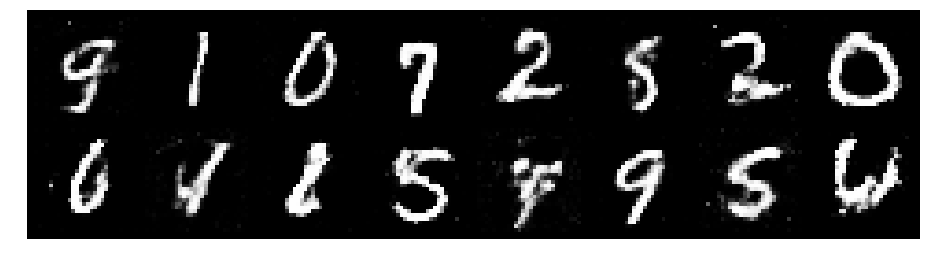

Epoch: [94/200], Batch Num: [100/938]
Discriminator Loss: 1.176900863647461, Generator Loss: 1.030402660369873
D(x): 0.5664, D(G(z)): 0.4059


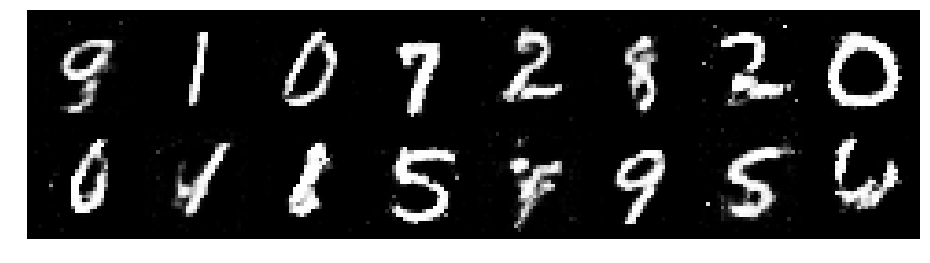

Epoch: [94/200], Batch Num: [200/938]
Discriminator Loss: 1.1280608177185059, Generator Loss: 1.0188477039337158
D(x): 0.6030, D(G(z)): 0.4020


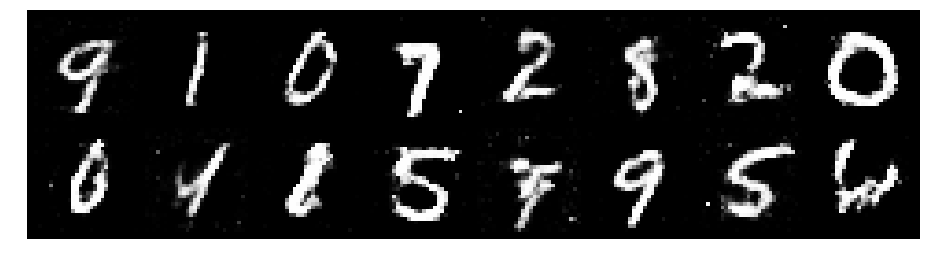

Epoch: [94/200], Batch Num: [300/938]
Discriminator Loss: 1.300399899482727, Generator Loss: 0.970502495765686
D(x): 0.5525, D(G(z)): 0.4412


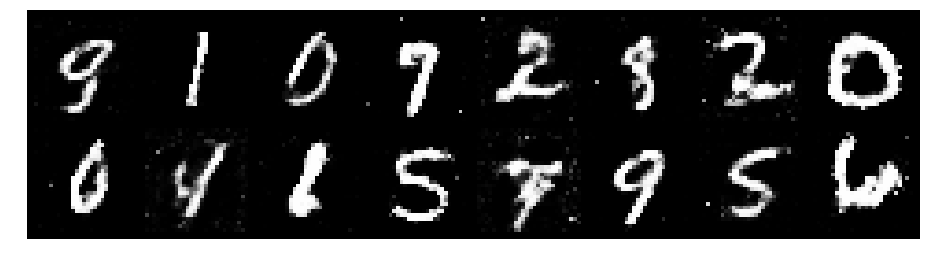

Epoch: [94/200], Batch Num: [400/938]
Discriminator Loss: 1.1395988464355469, Generator Loss: 0.7921110391616821
D(x): 0.5908, D(G(z)): 0.4236


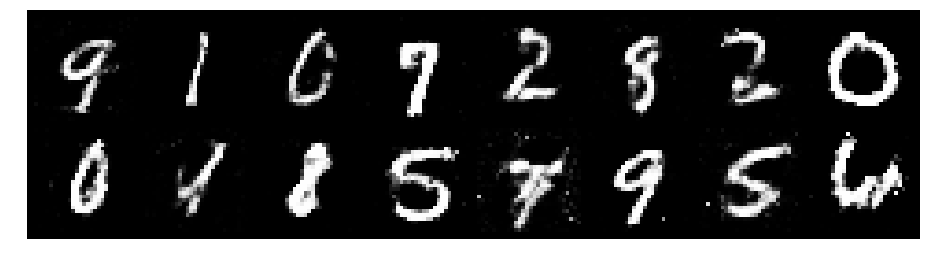

Epoch: [94/200], Batch Num: [500/938]
Discriminator Loss: 1.2400296926498413, Generator Loss: 0.9139518141746521
D(x): 0.5409, D(G(z)): 0.4239


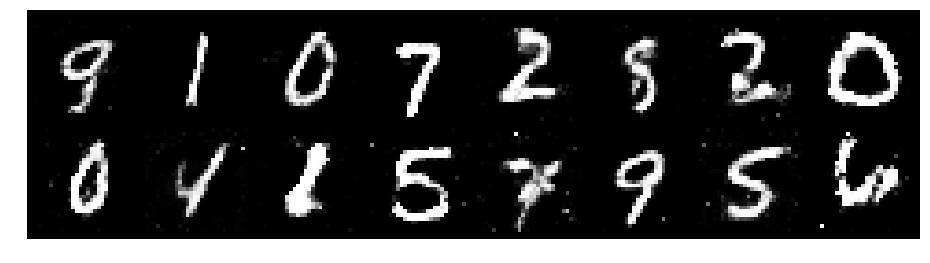

Epoch: [94/200], Batch Num: [600/938]
Discriminator Loss: 1.2956643104553223, Generator Loss: 0.8836597800254822
D(x): 0.5523, D(G(z)): 0.4716


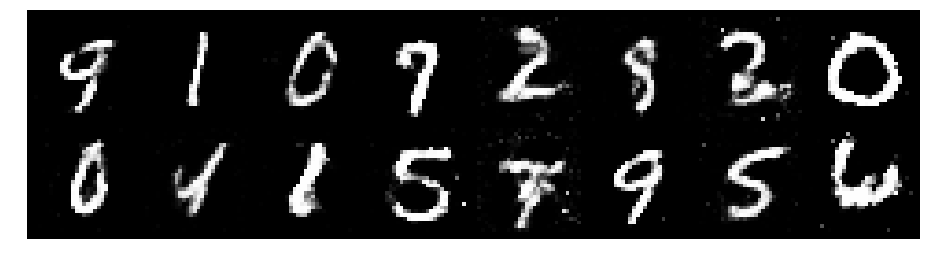

Epoch: [94/200], Batch Num: [700/938]
Discriminator Loss: 1.2840389013290405, Generator Loss: 0.8261109590530396
D(x): 0.5404, D(G(z)): 0.4520


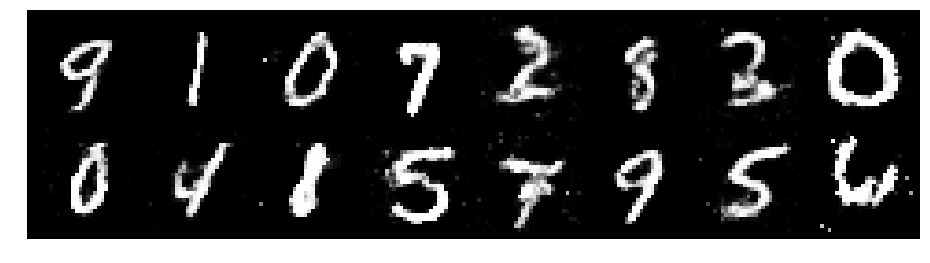

Epoch: [94/200], Batch Num: [800/938]
Discriminator Loss: 1.3858063220977783, Generator Loss: 0.8356682062149048
D(x): 0.5410, D(G(z)): 0.4937


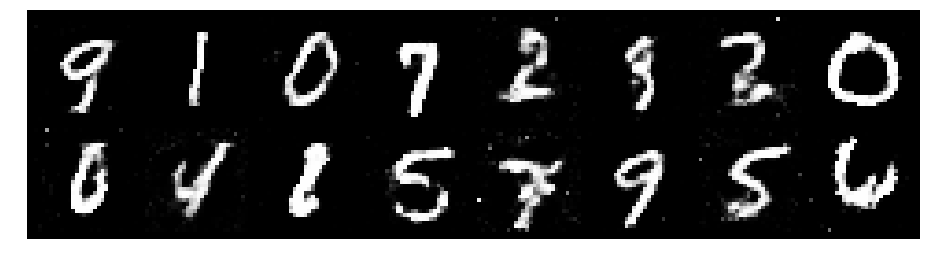

Epoch: [94/200], Batch Num: [900/938]
Discriminator Loss: 1.3091015815734863, Generator Loss: 0.8518415689468384
D(x): 0.5306, D(G(z)): 0.4419


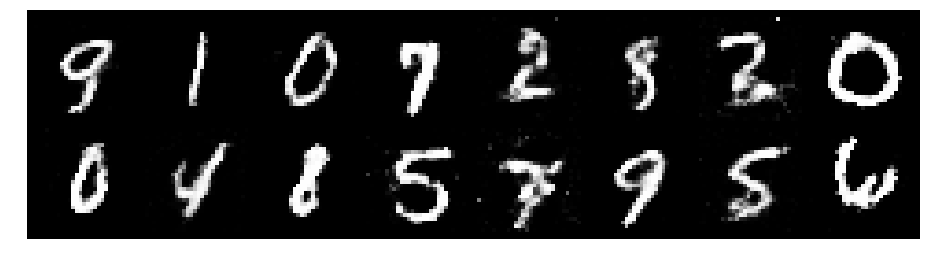

Epoch: [95/200], Batch Num: [0/938]
Discriminator Loss: 1.3297576904296875, Generator Loss: 0.8264155983924866
D(x): 0.5755, D(G(z)): 0.4951


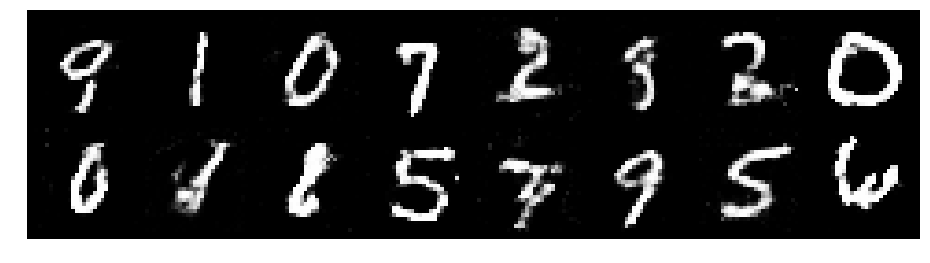

Epoch: [95/200], Batch Num: [100/938]
Discriminator Loss: 1.2711362838745117, Generator Loss: 0.8908035755157471
D(x): 0.5381, D(G(z)): 0.4299


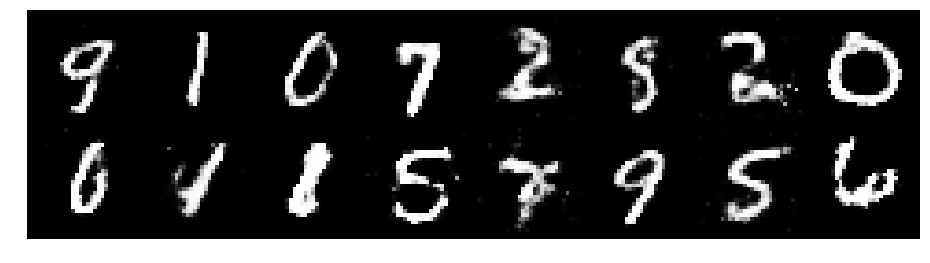

Epoch: [95/200], Batch Num: [200/938]
Discriminator Loss: 1.3383169174194336, Generator Loss: 0.8671581745147705
D(x): 0.5104, D(G(z)): 0.4452


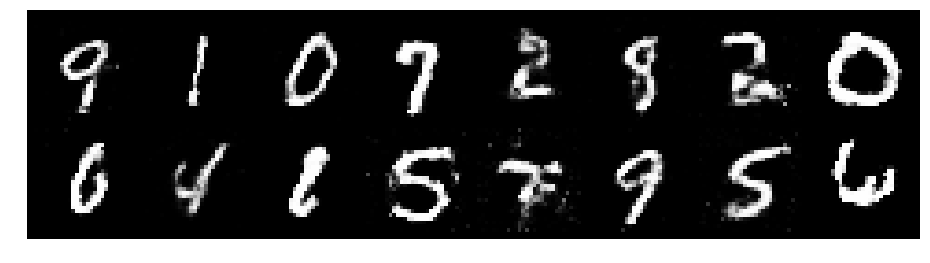

Epoch: [95/200], Batch Num: [300/938]
Discriminator Loss: 1.282301902770996, Generator Loss: 0.865099310874939
D(x): 0.5259, D(G(z)): 0.4387


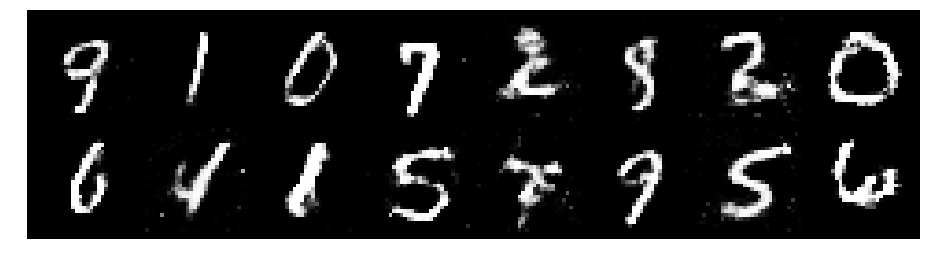

Epoch: [95/200], Batch Num: [400/938]
Discriminator Loss: 1.2457005977630615, Generator Loss: 0.7782474756240845
D(x): 0.5411, D(G(z)): 0.4364


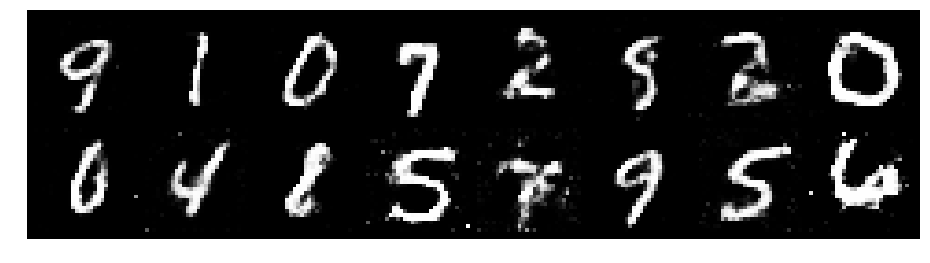

Epoch: [95/200], Batch Num: [500/938]
Discriminator Loss: 1.3234095573425293, Generator Loss: 0.8164970874786377
D(x): 0.5525, D(G(z)): 0.4714


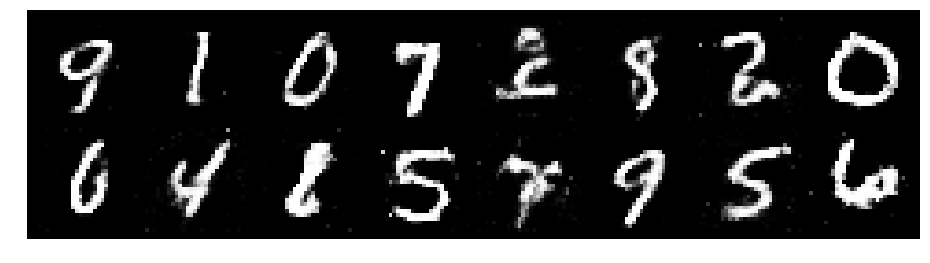

Epoch: [95/200], Batch Num: [600/938]
Discriminator Loss: 1.3664276599884033, Generator Loss: 0.7999411821365356
D(x): 0.5153, D(G(z)): 0.4372


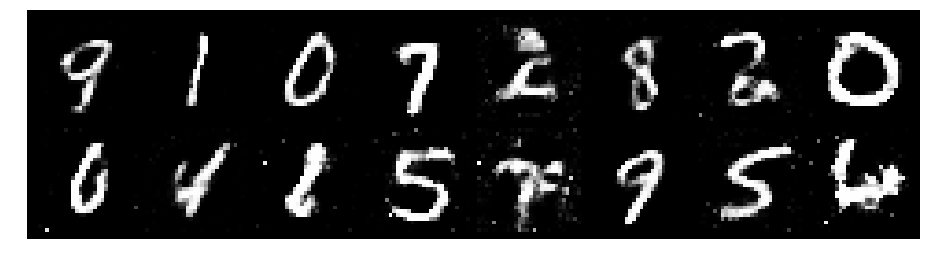

Epoch: [95/200], Batch Num: [700/938]
Discriminator Loss: 1.346384048461914, Generator Loss: 0.8815247416496277
D(x): 0.5061, D(G(z)): 0.4353


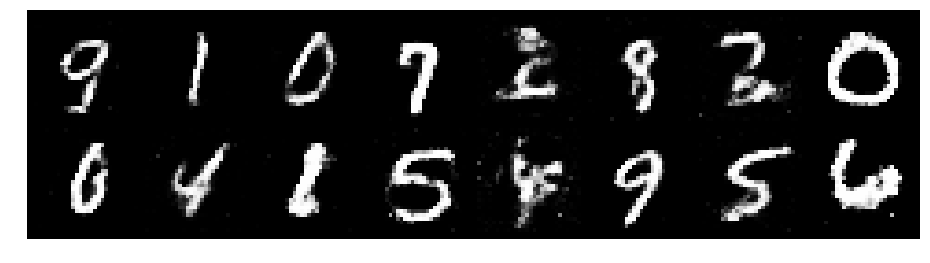

Epoch: [95/200], Batch Num: [800/938]
Discriminator Loss: 1.3306621313095093, Generator Loss: 0.9352360963821411
D(x): 0.5627, D(G(z)): 0.4661


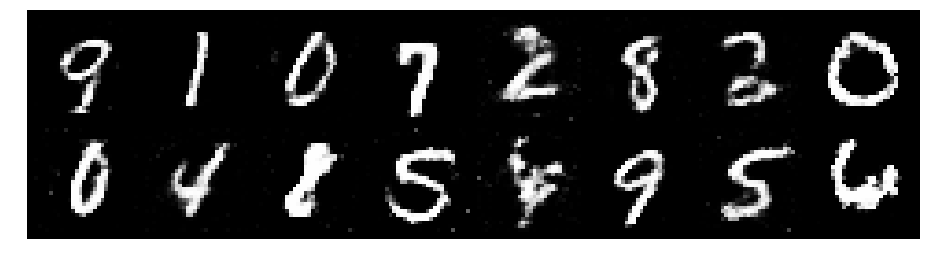

Epoch: [95/200], Batch Num: [900/938]
Discriminator Loss: 1.1899828910827637, Generator Loss: 1.0045865774154663
D(x): 0.5576, D(G(z)): 0.4088


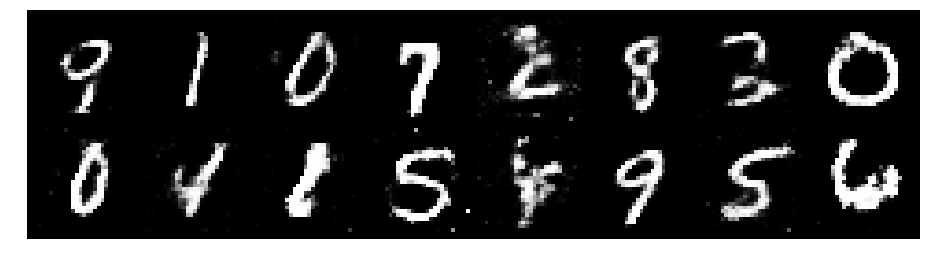

Epoch: [96/200], Batch Num: [0/938]
Discriminator Loss: 1.184455394744873, Generator Loss: 1.1070339679718018
D(x): 0.5482, D(G(z)): 0.4046


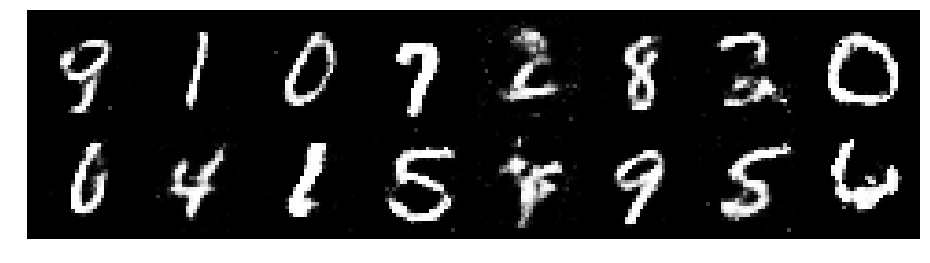

Epoch: [96/200], Batch Num: [100/938]
Discriminator Loss: 1.2189840078353882, Generator Loss: 0.9609929323196411
D(x): 0.5797, D(G(z)): 0.4455


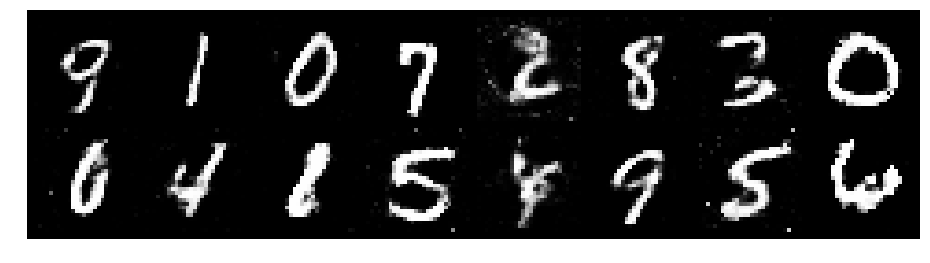

Epoch: [96/200], Batch Num: [200/938]
Discriminator Loss: 1.2447060346603394, Generator Loss: 1.0142829418182373
D(x): 0.5247, D(G(z)): 0.4054


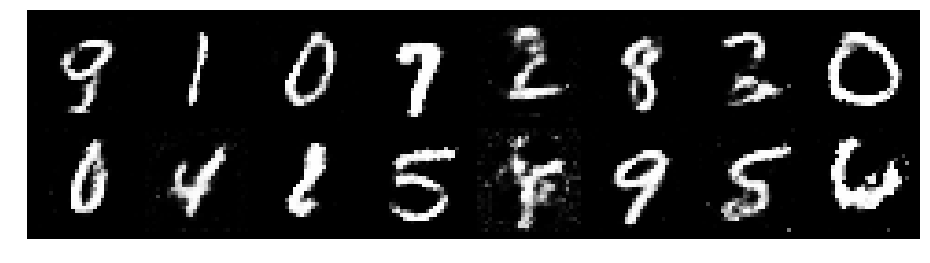

Epoch: [96/200], Batch Num: [300/938]
Discriminator Loss: 1.2330858707427979, Generator Loss: 0.9464668035507202
D(x): 0.5567, D(G(z)): 0.4207


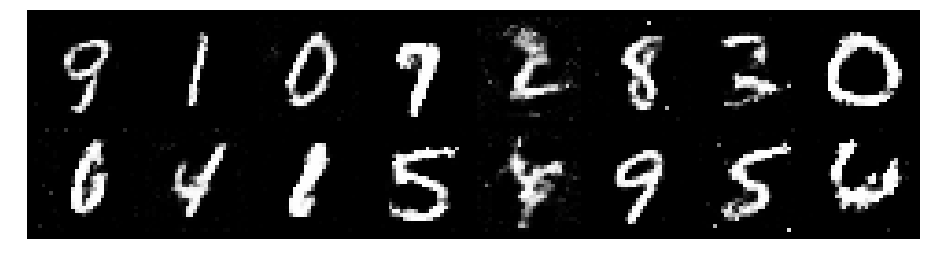

Epoch: [96/200], Batch Num: [400/938]
Discriminator Loss: 1.287392020225525, Generator Loss: 0.8974565863609314
D(x): 0.5387, D(G(z)): 0.4668


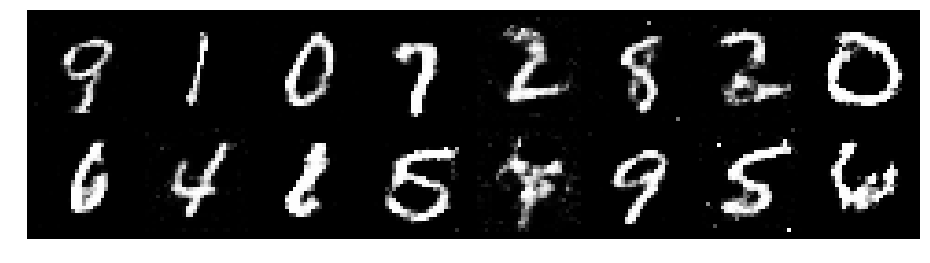

Epoch: [96/200], Batch Num: [500/938]
Discriminator Loss: 1.1923682689666748, Generator Loss: 1.013498306274414
D(x): 0.5880, D(G(z)): 0.4140


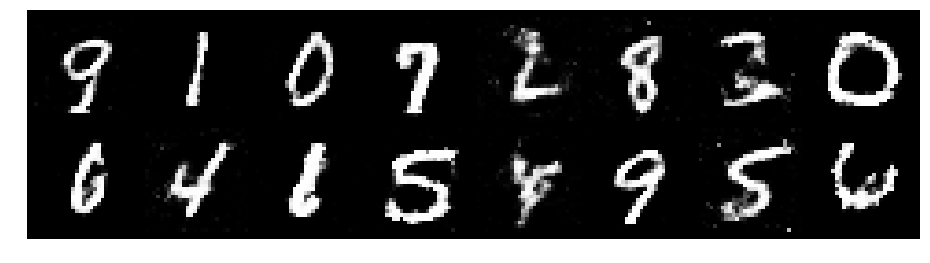

Epoch: [96/200], Batch Num: [600/938]
Discriminator Loss: 1.200746774673462, Generator Loss: 0.8622108697891235
D(x): 0.5432, D(G(z)): 0.3999


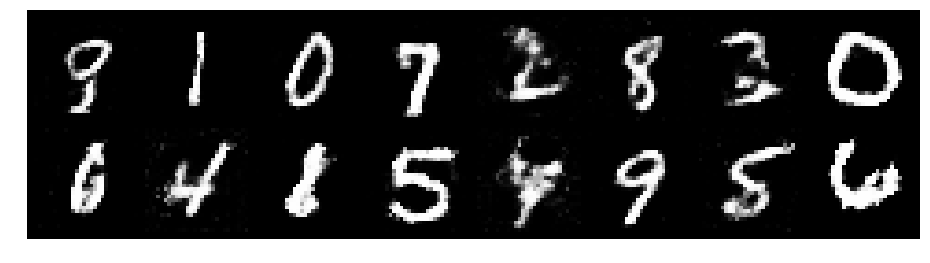

Epoch: [96/200], Batch Num: [700/938]
Discriminator Loss: 1.4430959224700928, Generator Loss: 0.9072749614715576
D(x): 0.5410, D(G(z)): 0.4938


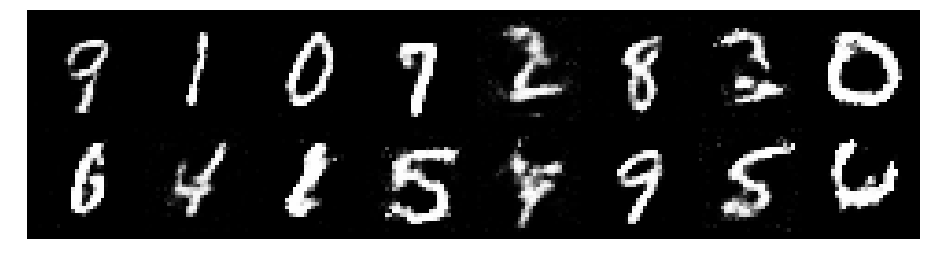

Epoch: [96/200], Batch Num: [800/938]
Discriminator Loss: 1.2636911869049072, Generator Loss: 0.9555425047874451
D(x): 0.5729, D(G(z)): 0.4402


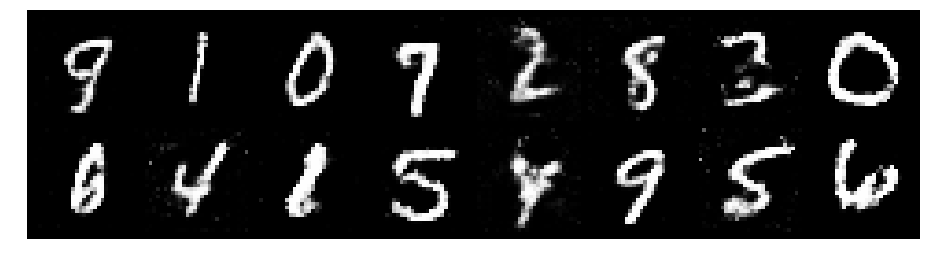

Epoch: [96/200], Batch Num: [900/938]
Discriminator Loss: 1.1654237508773804, Generator Loss: 0.9013853073120117
D(x): 0.6098, D(G(z)): 0.4387


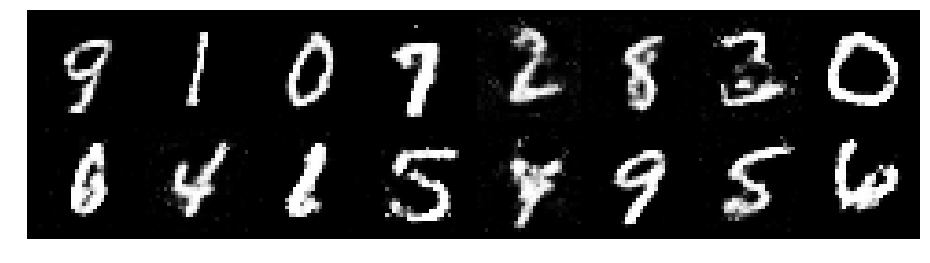

Epoch: [97/200], Batch Num: [0/938]
Discriminator Loss: 1.1693778038024902, Generator Loss: 1.0074999332427979
D(x): 0.5737, D(G(z)): 0.4137


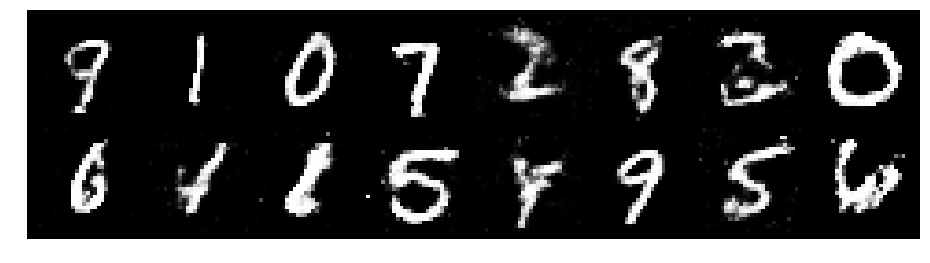

Epoch: [97/200], Batch Num: [100/938]
Discriminator Loss: 1.301378846168518, Generator Loss: 0.8382712602615356
D(x): 0.5710, D(G(z)): 0.4707


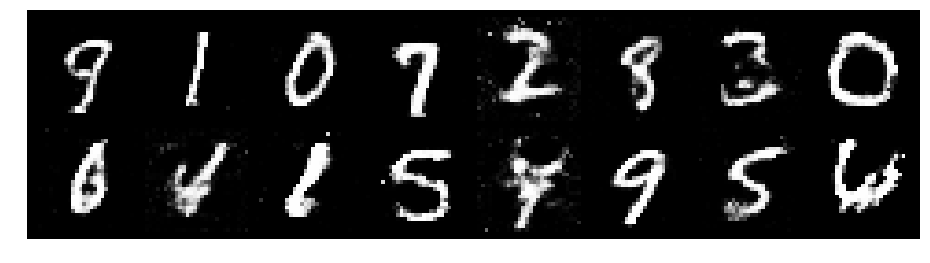

Epoch: [97/200], Batch Num: [200/938]
Discriminator Loss: 1.257567286491394, Generator Loss: 0.7906587719917297
D(x): 0.6079, D(G(z)): 0.4830


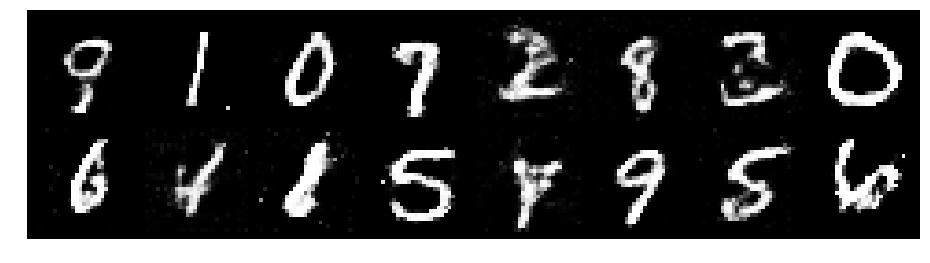

Epoch: [97/200], Batch Num: [300/938]
Discriminator Loss: 1.326728343963623, Generator Loss: 0.7741472721099854
D(x): 0.5501, D(G(z)): 0.4874


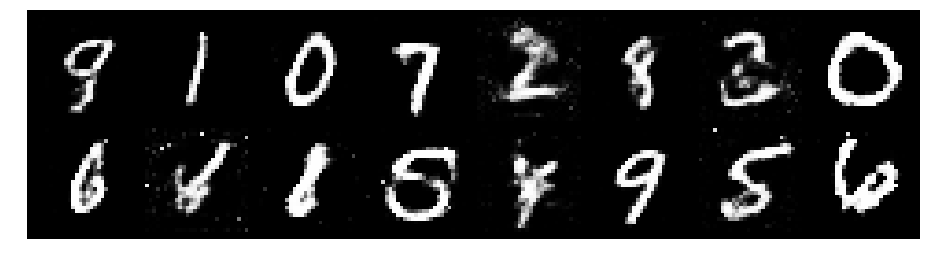

Epoch: [97/200], Batch Num: [400/938]
Discriminator Loss: 1.2776261568069458, Generator Loss: 0.8994510173797607
D(x): 0.5480, D(G(z)): 0.4211


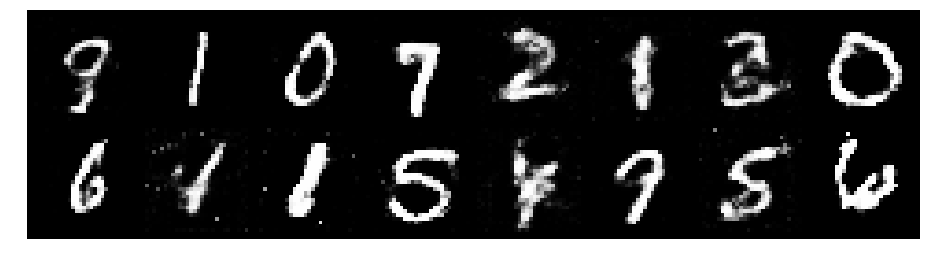

Epoch: [97/200], Batch Num: [500/938]
Discriminator Loss: 1.2859915494918823, Generator Loss: 0.9350440502166748
D(x): 0.5395, D(G(z)): 0.4096


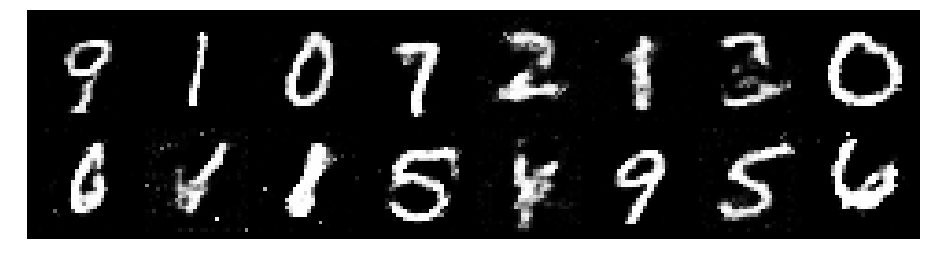

Epoch: [97/200], Batch Num: [600/938]
Discriminator Loss: 1.3101152181625366, Generator Loss: 1.1038267612457275
D(x): 0.5222, D(G(z)): 0.4232


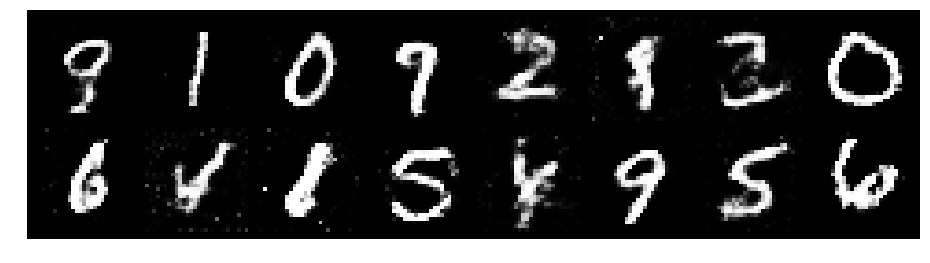

Epoch: [97/200], Batch Num: [700/938]
Discriminator Loss: 1.2455781698226929, Generator Loss: 0.9211851358413696
D(x): 0.5424, D(G(z)): 0.4134


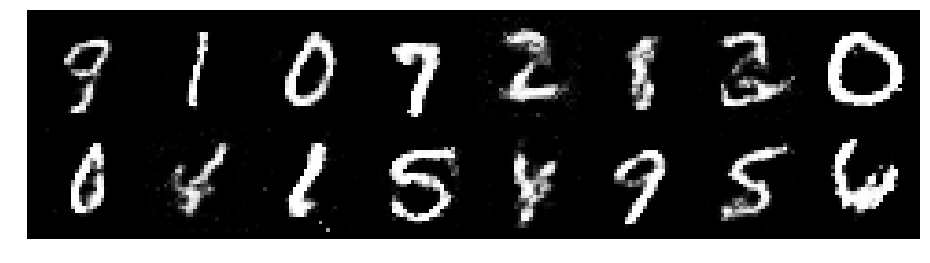

Epoch: [97/200], Batch Num: [800/938]
Discriminator Loss: 1.3065476417541504, Generator Loss: 0.9199954271316528
D(x): 0.5253, D(G(z)): 0.4205


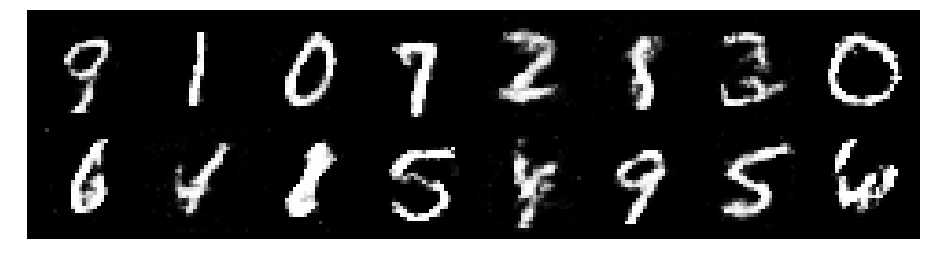

Epoch: [97/200], Batch Num: [900/938]
Discriminator Loss: 1.2631912231445312, Generator Loss: 0.7419026494026184
D(x): 0.5810, D(G(z)): 0.4782


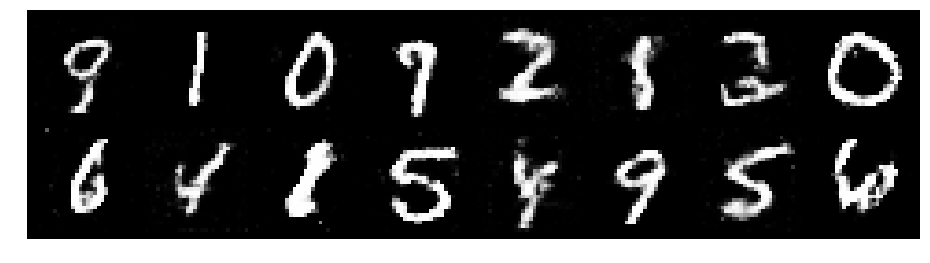

Epoch: [98/200], Batch Num: [0/938]
Discriminator Loss: 1.318585991859436, Generator Loss: 0.8168892860412598
D(x): 0.5538, D(G(z)): 0.4764


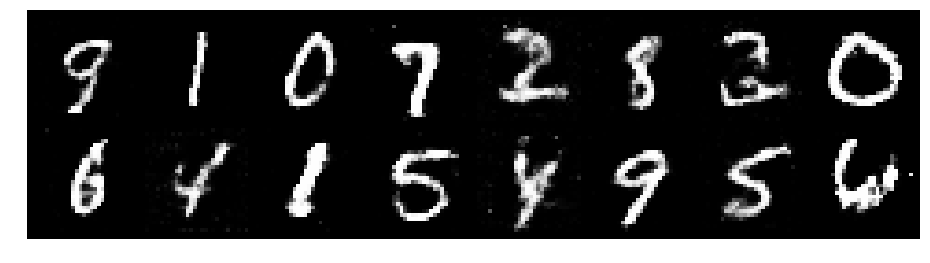

Epoch: [98/200], Batch Num: [100/938]
Discriminator Loss: 1.2820039987564087, Generator Loss: 0.8210316300392151
D(x): 0.5421, D(G(z)): 0.4582


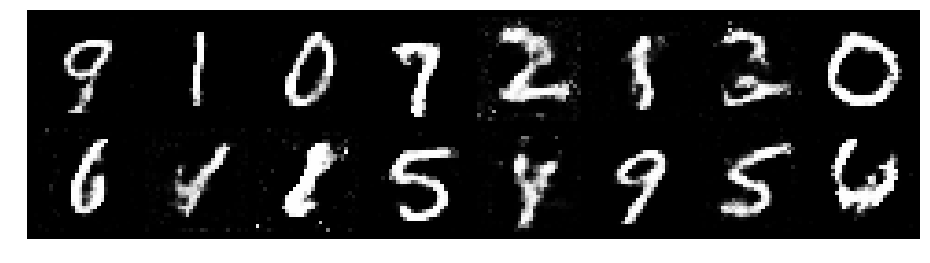

Epoch: [98/200], Batch Num: [200/938]
Discriminator Loss: 1.266215205192566, Generator Loss: 0.8426721096038818
D(x): 0.5538, D(G(z)): 0.4473


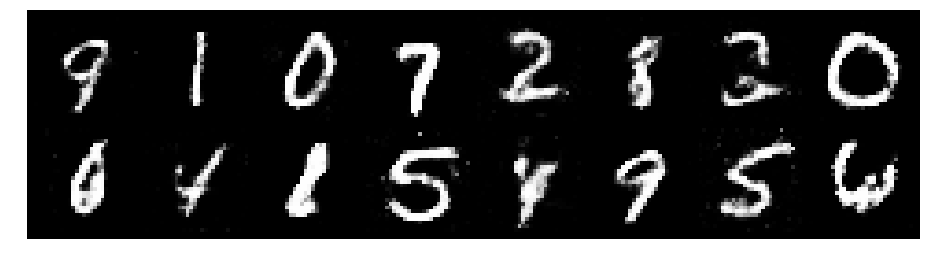

Epoch: [98/200], Batch Num: [300/938]
Discriminator Loss: 1.2460057735443115, Generator Loss: 0.8261815309524536
D(x): 0.5341, D(G(z)): 0.4285


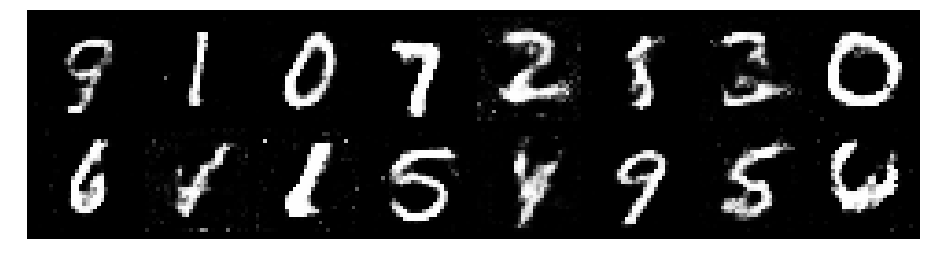

Epoch: [98/200], Batch Num: [400/938]
Discriminator Loss: 1.3019349575042725, Generator Loss: 0.753286600112915
D(x): 0.5489, D(G(z)): 0.4694


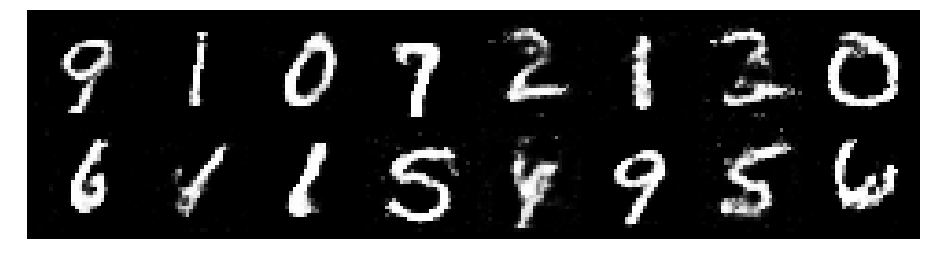

Epoch: [98/200], Batch Num: [500/938]
Discriminator Loss: 1.370054841041565, Generator Loss: 0.7957496047019958
D(x): 0.5154, D(G(z)): 0.4560


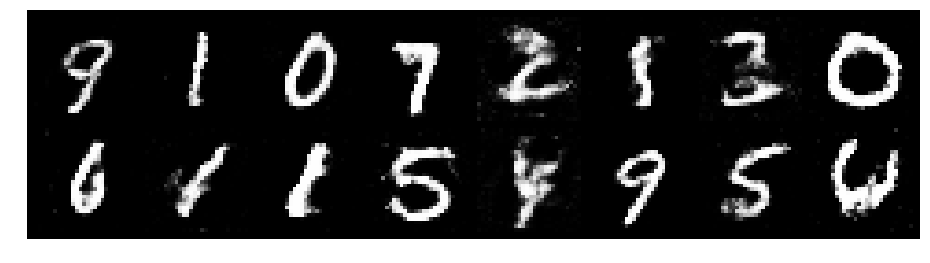

Epoch: [98/200], Batch Num: [600/938]
Discriminator Loss: 1.370776653289795, Generator Loss: 0.8111639022827148
D(x): 0.5910, D(G(z)): 0.5088


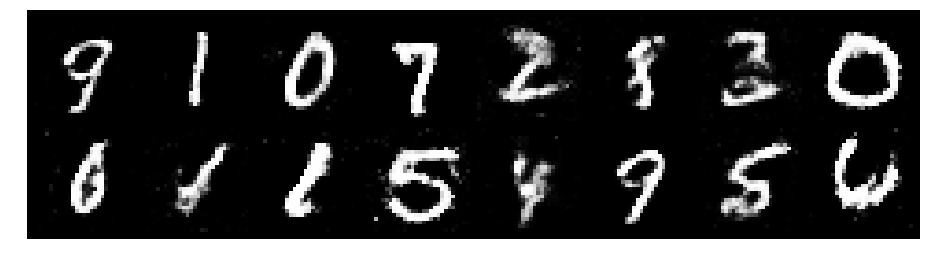

Epoch: [98/200], Batch Num: [700/938]
Discriminator Loss: 1.3061888217926025, Generator Loss: 0.7501051425933838
D(x): 0.5603, D(G(z)): 0.4818


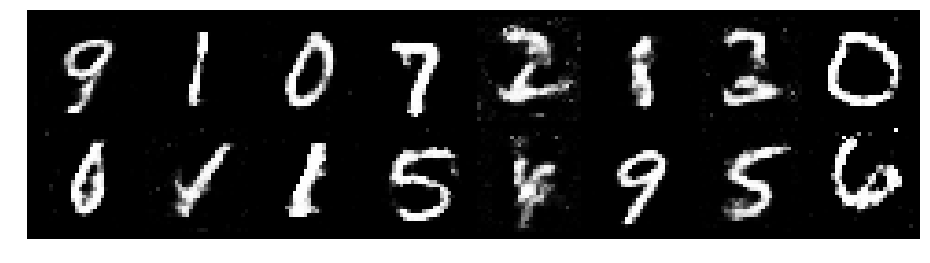

Epoch: [98/200], Batch Num: [800/938]
Discriminator Loss: 1.3411264419555664, Generator Loss: 1.0263245105743408
D(x): 0.5527, D(G(z)): 0.4580


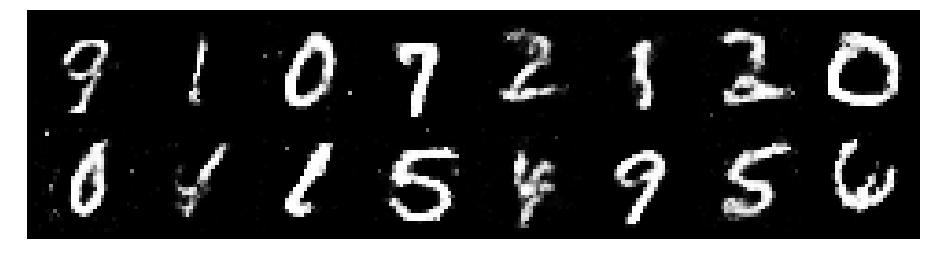

Epoch: [98/200], Batch Num: [900/938]
Discriminator Loss: 1.2802610397338867, Generator Loss: 1.0023491382598877
D(x): 0.5317, D(G(z)): 0.4181


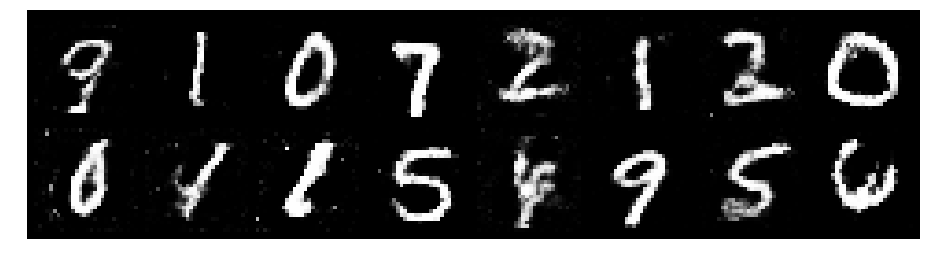

Epoch: [99/200], Batch Num: [0/938]
Discriminator Loss: 1.2657991647720337, Generator Loss: 0.8756431341171265
D(x): 0.5656, D(G(z)): 0.4656


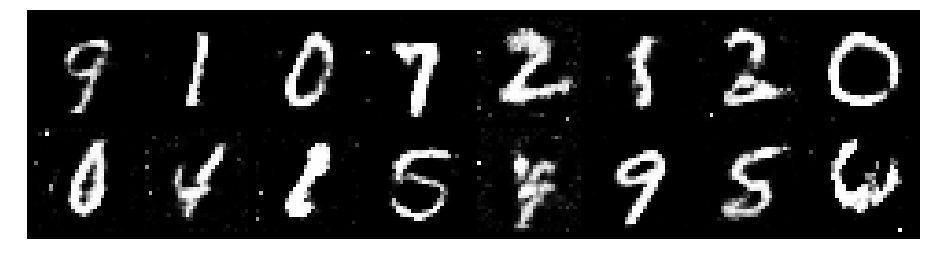

Epoch: [99/200], Batch Num: [100/938]
Discriminator Loss: 1.2528302669525146, Generator Loss: 0.8453986644744873
D(x): 0.5486, D(G(z)): 0.4353


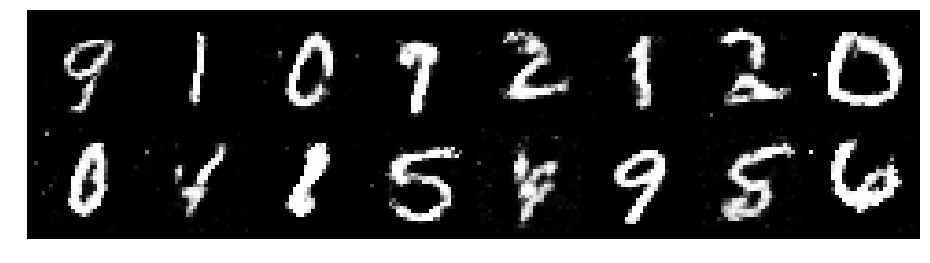

Epoch: [99/200], Batch Num: [200/938]
Discriminator Loss: 1.3570373058319092, Generator Loss: 1.01701819896698
D(x): 0.5090, D(G(z)): 0.4415


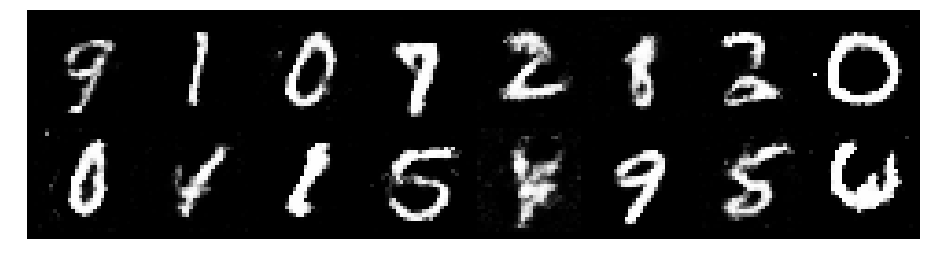

Epoch: [99/200], Batch Num: [300/938]
Discriminator Loss: 1.3023102283477783, Generator Loss: 0.815330445766449
D(x): 0.5795, D(G(z)): 0.4997


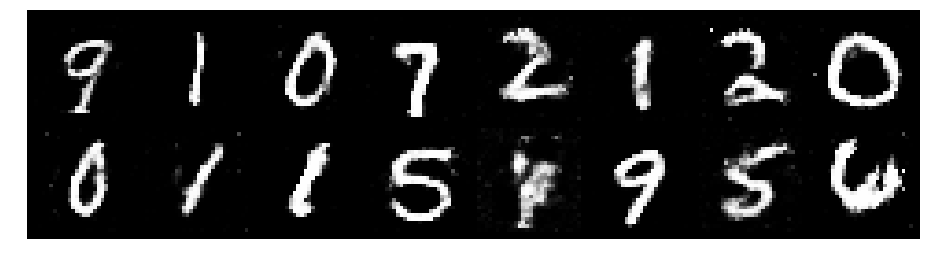

Epoch: [99/200], Batch Num: [400/938]
Discriminator Loss: 1.3735377788543701, Generator Loss: 0.8264762163162231
D(x): 0.5733, D(G(z)): 0.5035


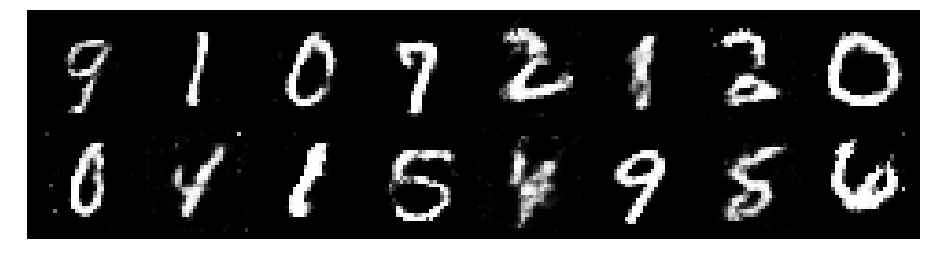

Epoch: [99/200], Batch Num: [500/938]
Discriminator Loss: 1.2357467412948608, Generator Loss: 0.8642246723175049
D(x): 0.5541, D(G(z)): 0.4205


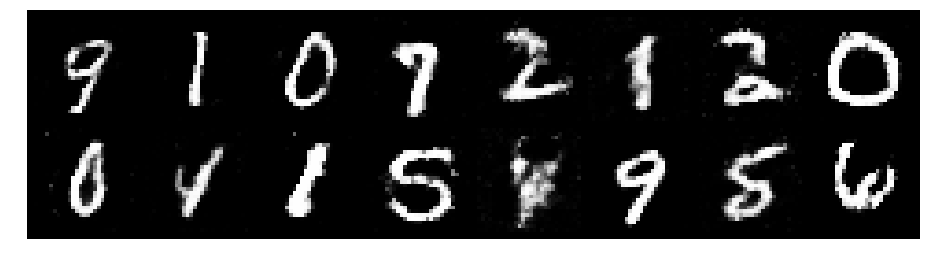

Epoch: [99/200], Batch Num: [600/938]
Discriminator Loss: 1.4075207710266113, Generator Loss: 0.8241426348686218
D(x): 0.5392, D(G(z)): 0.5084


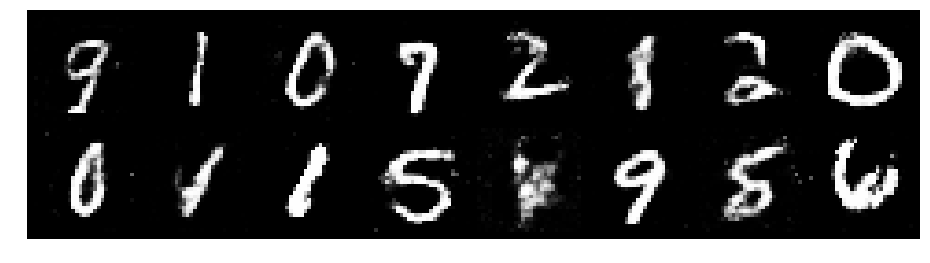

Epoch: [99/200], Batch Num: [700/938]
Discriminator Loss: 1.3789184093475342, Generator Loss: 0.8736358284950256
D(x): 0.5232, D(G(z)): 0.4613


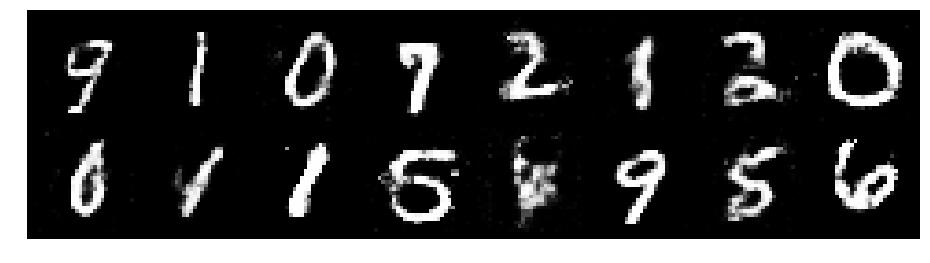

Epoch: [99/200], Batch Num: [800/938]
Discriminator Loss: 1.3627303838729858, Generator Loss: 0.7699307203292847
D(x): 0.5340, D(G(z)): 0.4791


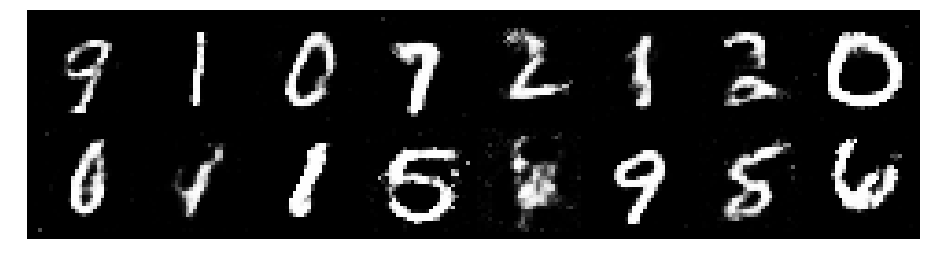

Epoch: [99/200], Batch Num: [900/938]
Discriminator Loss: 1.4878747463226318, Generator Loss: 0.704450786113739
D(x): 0.5562, D(G(z)): 0.5467


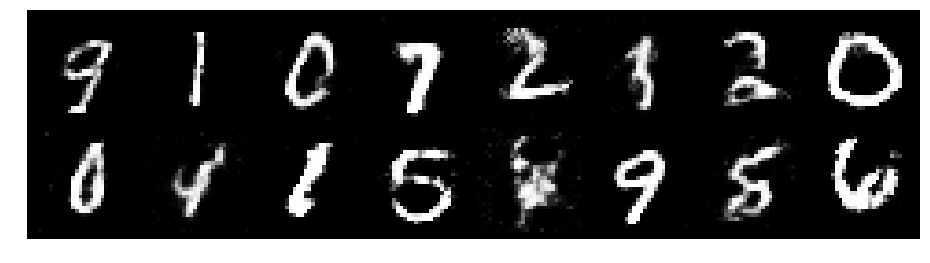

Epoch: [100/200], Batch Num: [0/938]
Discriminator Loss: 1.324450135231018, Generator Loss: 0.7490079998970032
D(x): 0.5388, D(G(z)): 0.4668


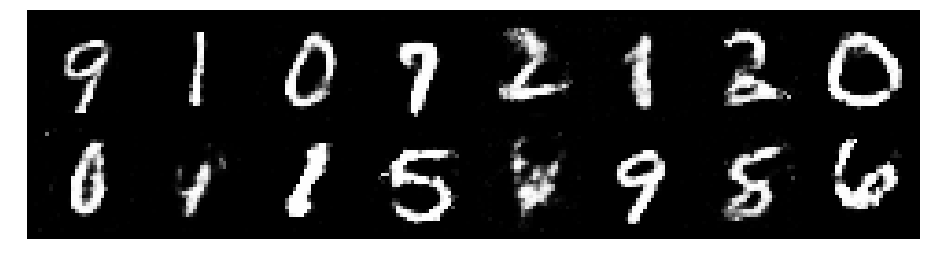

Epoch: [100/200], Batch Num: [100/938]
Discriminator Loss: 1.3251829147338867, Generator Loss: 0.8260096311569214
D(x): 0.5498, D(G(z)): 0.4691


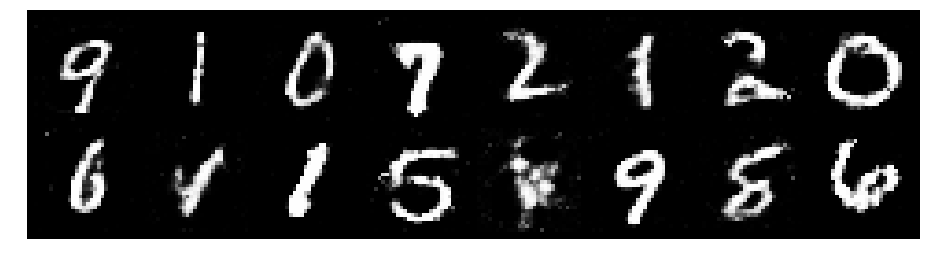

Epoch: [100/200], Batch Num: [200/938]
Discriminator Loss: 1.2591545581817627, Generator Loss: 0.9730099439620972
D(x): 0.5848, D(G(z)): 0.4478


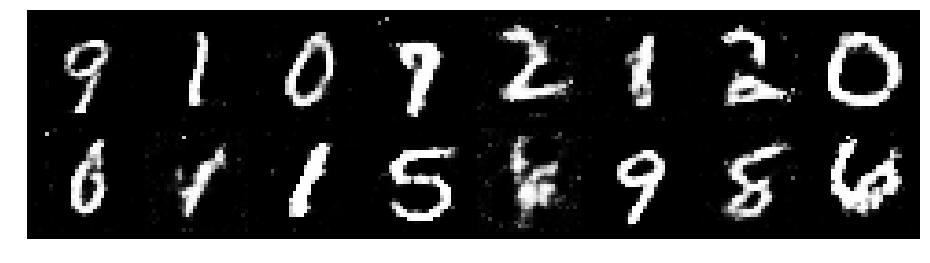

Epoch: [100/200], Batch Num: [300/938]
Discriminator Loss: 1.2290470600128174, Generator Loss: 0.8723189830780029
D(x): 0.5712, D(G(z)): 0.4213


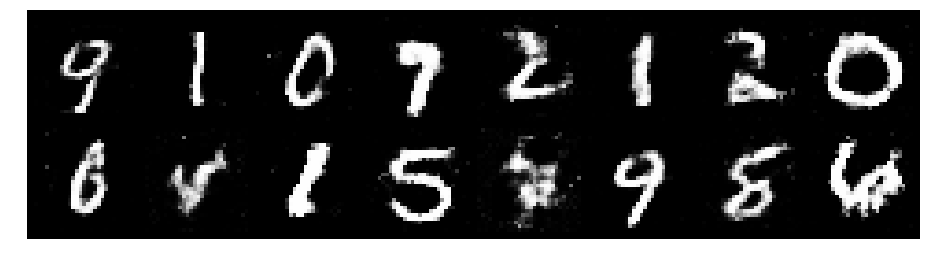

Epoch: [100/200], Batch Num: [400/938]
Discriminator Loss: 1.2364416122436523, Generator Loss: 0.8422157764434814
D(x): 0.5354, D(G(z)): 0.4132


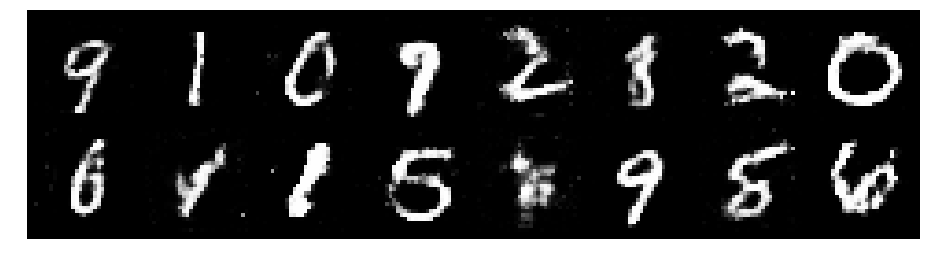

Epoch: [100/200], Batch Num: [500/938]
Discriminator Loss: 1.2125461101531982, Generator Loss: 0.7955809831619263
D(x): 0.6012, D(G(z)): 0.4667


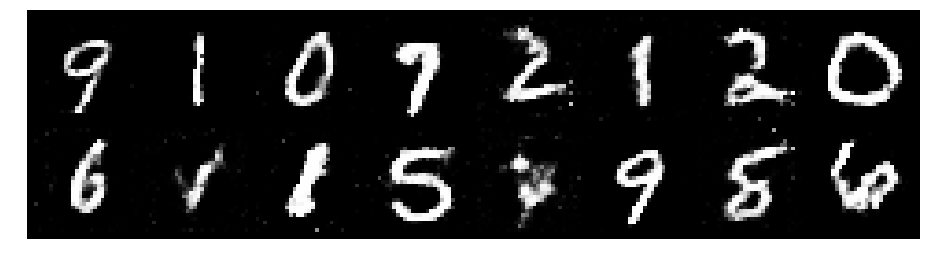

Epoch: [100/200], Batch Num: [600/938]
Discriminator Loss: 1.2368178367614746, Generator Loss: 0.8773940801620483
D(x): 0.5137, D(G(z)): 0.4042


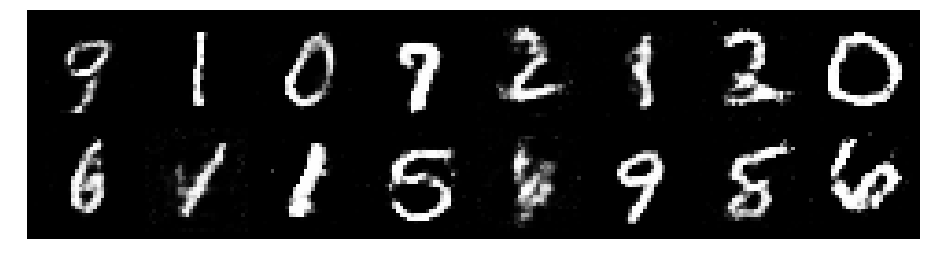

Epoch: [100/200], Batch Num: [700/938]
Discriminator Loss: 1.3129427433013916, Generator Loss: 0.765601634979248
D(x): 0.5655, D(G(z)): 0.4807


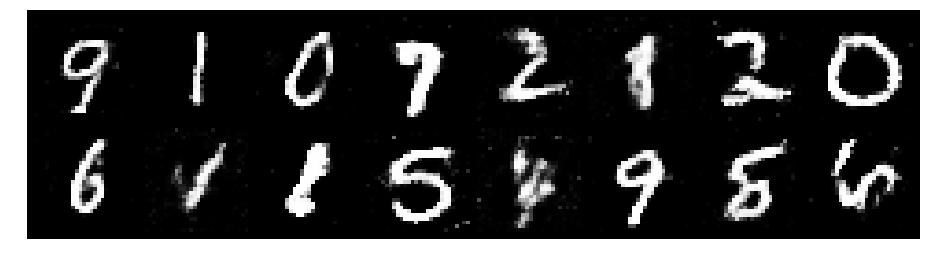

Epoch: [100/200], Batch Num: [800/938]
Discriminator Loss: 1.2536180019378662, Generator Loss: 0.888861894607544
D(x): 0.5420, D(G(z)): 0.4214


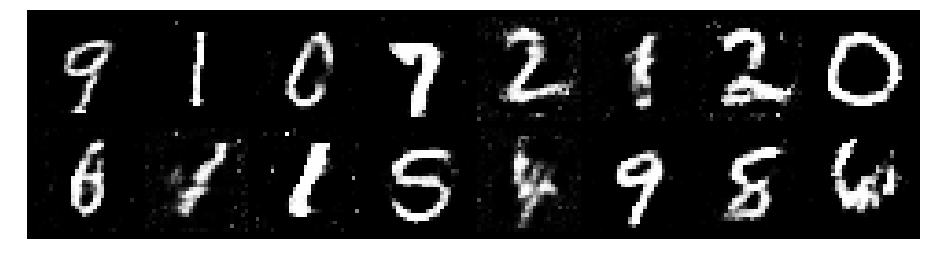

Epoch: [100/200], Batch Num: [900/938]
Discriminator Loss: 1.314896821975708, Generator Loss: 0.8893579840660095
D(x): 0.5354, D(G(z)): 0.4405


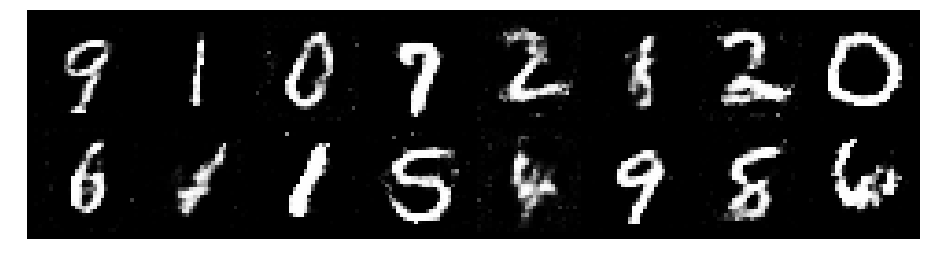

Epoch: [101/200], Batch Num: [0/938]
Discriminator Loss: 1.3831243515014648, Generator Loss: 0.9284727573394775
D(x): 0.5023, D(G(z)): 0.4616


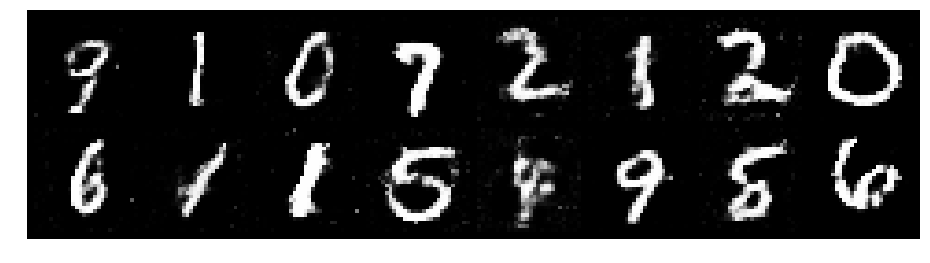

Epoch: [101/200], Batch Num: [100/938]
Discriminator Loss: 1.281097650527954, Generator Loss: 0.9772998094558716
D(x): 0.5474, D(G(z)): 0.4365


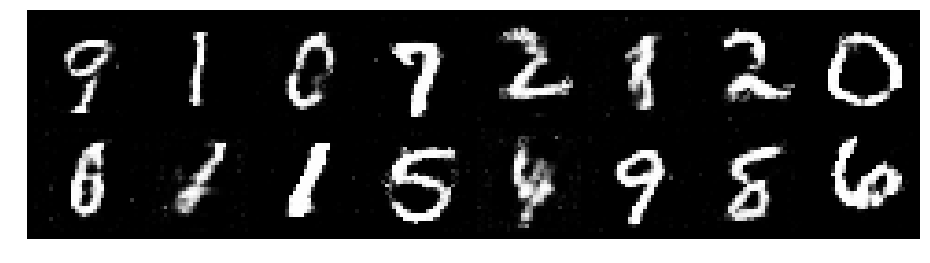

Epoch: [101/200], Batch Num: [200/938]
Discriminator Loss: 1.282505989074707, Generator Loss: 1.0410797595977783
D(x): 0.5181, D(G(z)): 0.4132


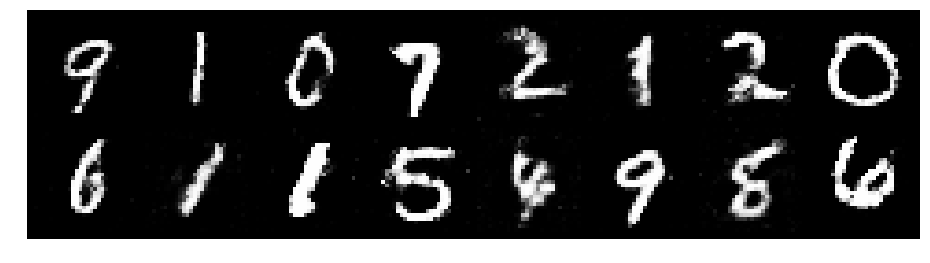

Epoch: [101/200], Batch Num: [300/938]
Discriminator Loss: 1.253055453300476, Generator Loss: 0.8372457027435303
D(x): 0.5747, D(G(z)): 0.4684


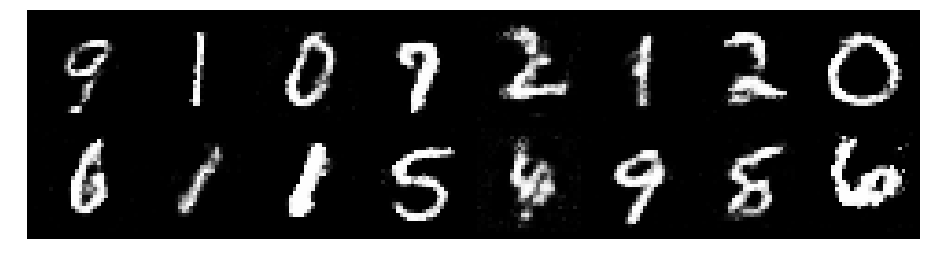

Epoch: [101/200], Batch Num: [400/938]
Discriminator Loss: 1.4183390140533447, Generator Loss: 0.8124772906303406
D(x): 0.5331, D(G(z)): 0.5141


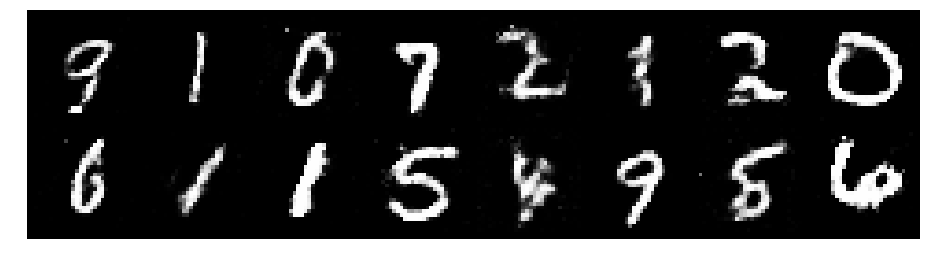

Epoch: [101/200], Batch Num: [500/938]
Discriminator Loss: 1.270090103149414, Generator Loss: 0.8576924800872803
D(x): 0.5014, D(G(z)): 0.4142


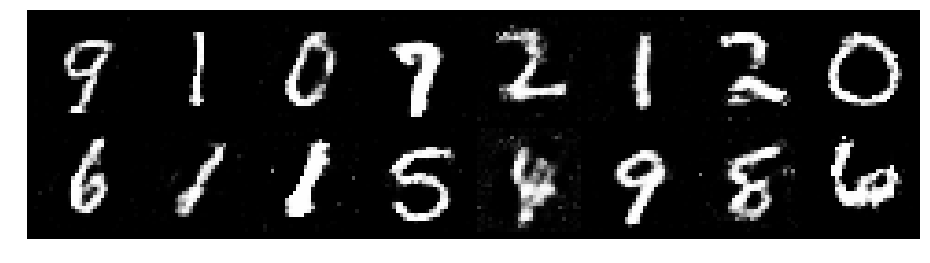

Epoch: [101/200], Batch Num: [600/938]
Discriminator Loss: 1.230095624923706, Generator Loss: 0.8551636934280396
D(x): 0.5798, D(G(z)): 0.4541


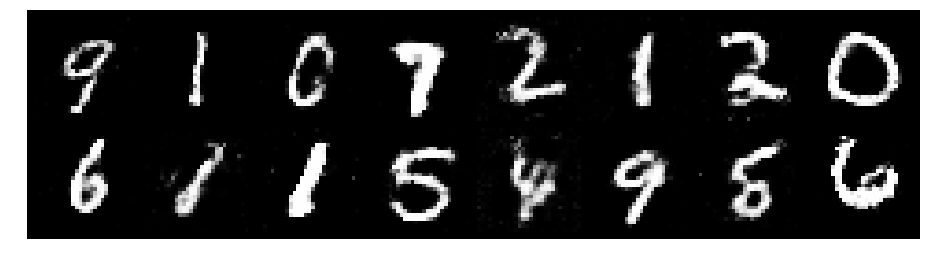

Epoch: [101/200], Batch Num: [700/938]
Discriminator Loss: 1.184394121170044, Generator Loss: 0.9019500017166138
D(x): 0.5638, D(G(z)): 0.4141


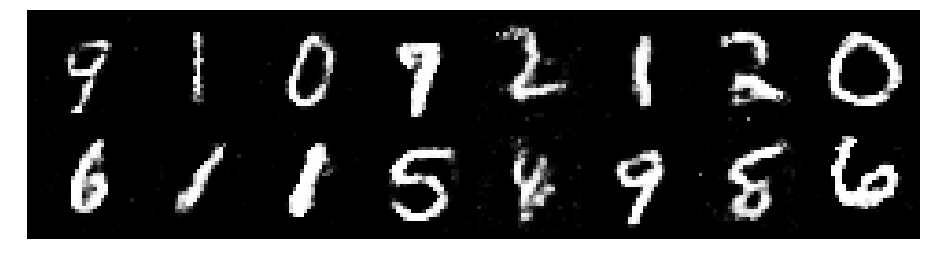

Epoch: [101/200], Batch Num: [800/938]
Discriminator Loss: 1.1808619499206543, Generator Loss: 1.0036511421203613
D(x): 0.5689, D(G(z)): 0.4158


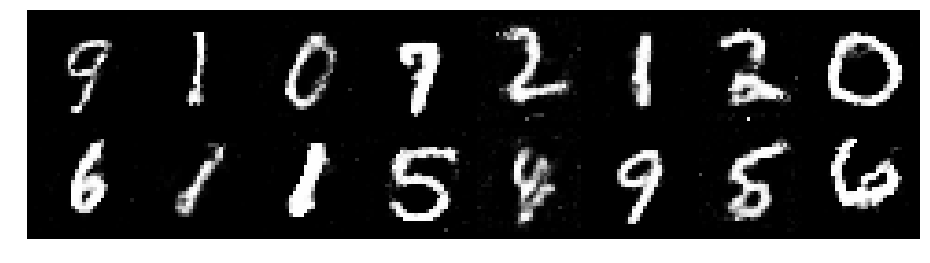

Epoch: [101/200], Batch Num: [900/938]
Discriminator Loss: 1.2333269119262695, Generator Loss: 0.9872410297393799
D(x): 0.5584, D(G(z)): 0.4296


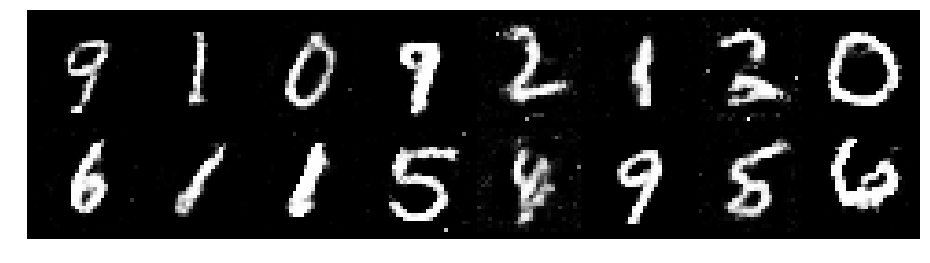

Epoch: [102/200], Batch Num: [0/938]
Discriminator Loss: 1.2575898170471191, Generator Loss: 0.7488774061203003
D(x): 0.5486, D(G(z)): 0.4439


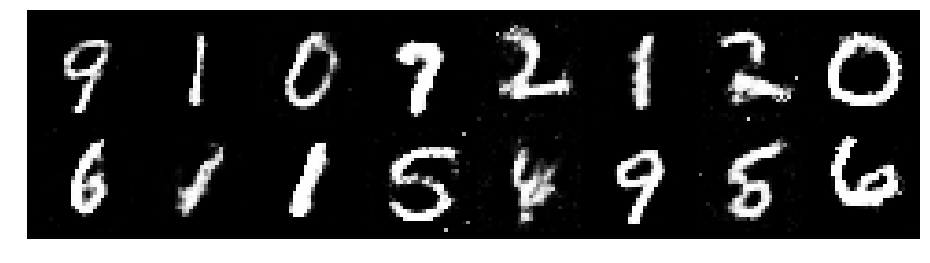

Epoch: [102/200], Batch Num: [100/938]
Discriminator Loss: 1.2939387559890747, Generator Loss: 0.7869953513145447
D(x): 0.5298, D(G(z)): 0.4473


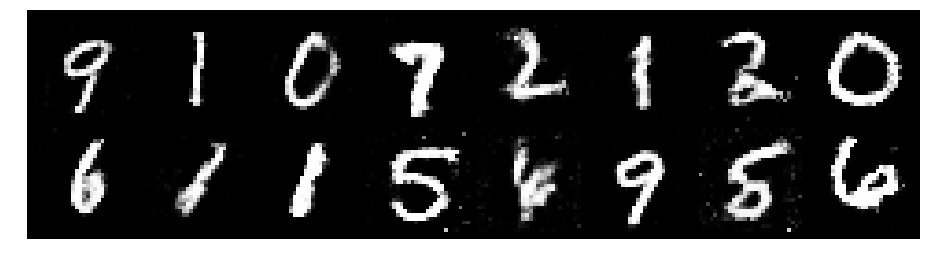

Epoch: [102/200], Batch Num: [200/938]
Discriminator Loss: 1.3746683597564697, Generator Loss: 0.880497932434082
D(x): 0.5151, D(G(z)): 0.4713


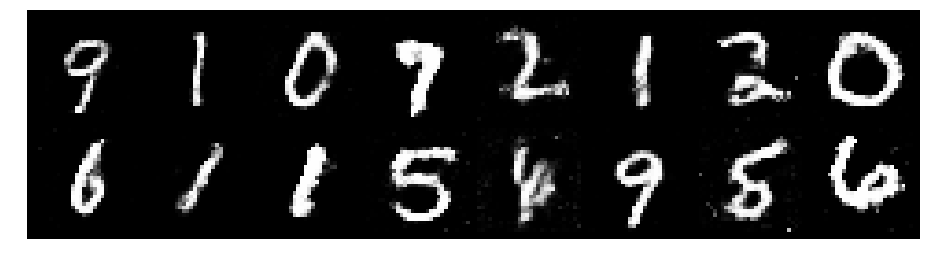

Epoch: [102/200], Batch Num: [300/938]
Discriminator Loss: 1.2786221504211426, Generator Loss: 0.7626769542694092
D(x): 0.5493, D(G(z)): 0.4618


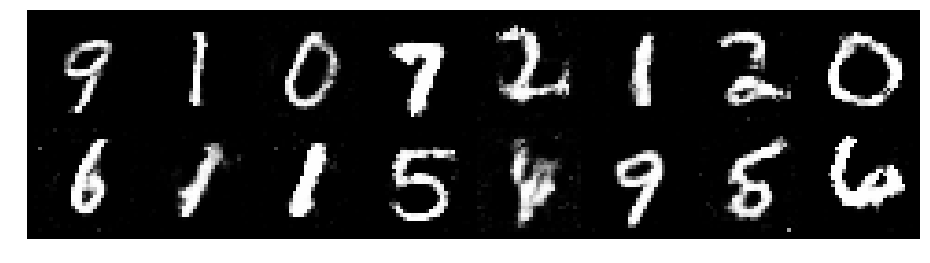

Epoch: [102/200], Batch Num: [400/938]
Discriminator Loss: 1.4202640056610107, Generator Loss: 0.7250378131866455
D(x): 0.5951, D(G(z)): 0.5421


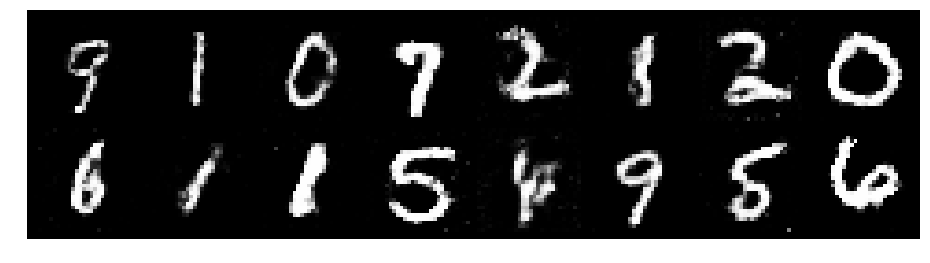

Epoch: [102/200], Batch Num: [500/938]
Discriminator Loss: 1.2860603332519531, Generator Loss: 0.862791895866394
D(x): 0.5326, D(G(z)): 0.4375


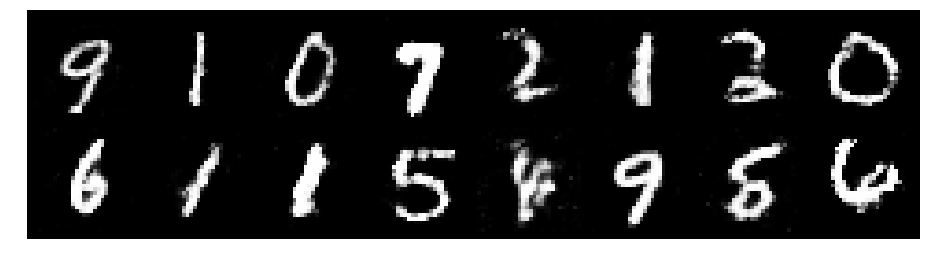

Epoch: [102/200], Batch Num: [600/938]
Discriminator Loss: 1.2075427770614624, Generator Loss: 0.9164295196533203
D(x): 0.5873, D(G(z)): 0.4579


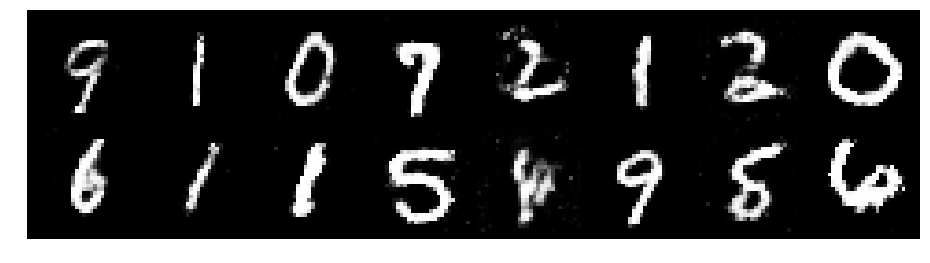

Epoch: [102/200], Batch Num: [700/938]
Discriminator Loss: 1.2037150859832764, Generator Loss: 1.071882963180542
D(x): 0.5374, D(G(z)): 0.4035


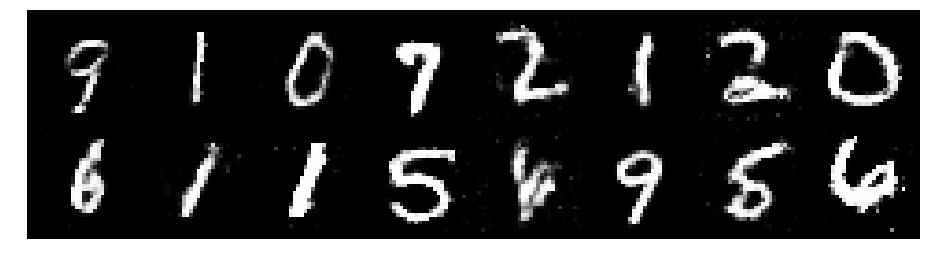

Epoch: [102/200], Batch Num: [800/938]
Discriminator Loss: 1.233238697052002, Generator Loss: 0.9749982357025146
D(x): 0.5559, D(G(z)): 0.4235


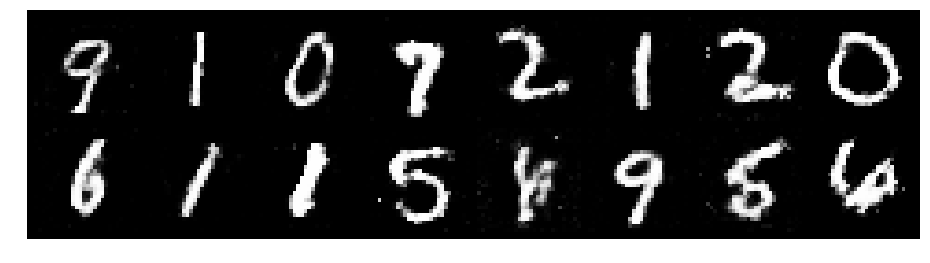

Epoch: [102/200], Batch Num: [900/938]
Discriminator Loss: 1.352332592010498, Generator Loss: 0.9319161176681519
D(x): 0.5125, D(G(z)): 0.4581


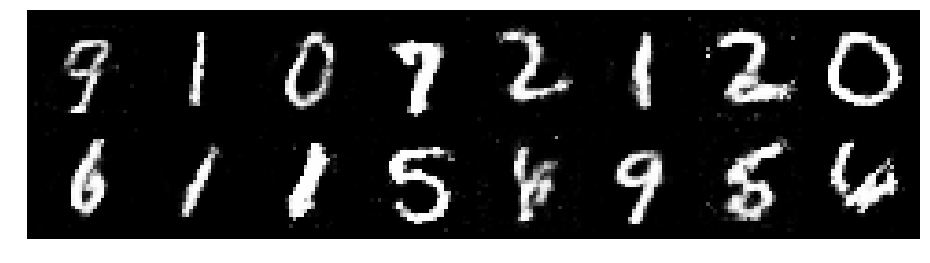

Epoch: [103/200], Batch Num: [0/938]
Discriminator Loss: 1.218811273574829, Generator Loss: 0.8616412878036499
D(x): 0.5541, D(G(z)): 0.4175


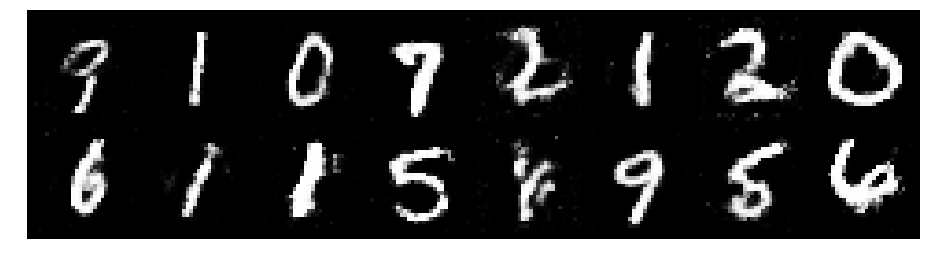

Epoch: [103/200], Batch Num: [100/938]
Discriminator Loss: 1.3643527030944824, Generator Loss: 0.8802210092544556
D(x): 0.4987, D(G(z)): 0.4467


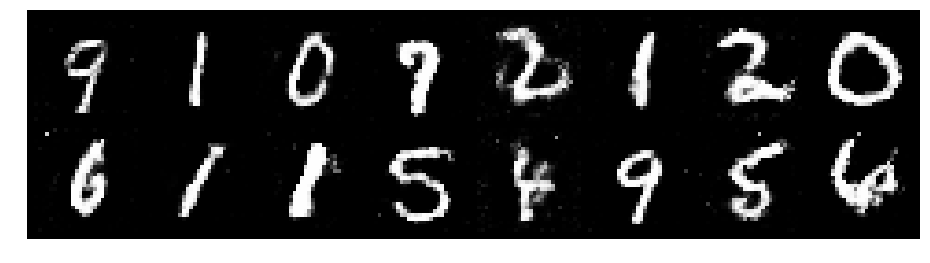

Epoch: [103/200], Batch Num: [200/938]
Discriminator Loss: 1.2580572366714478, Generator Loss: 0.8121764659881592
D(x): 0.5528, D(G(z)): 0.4501


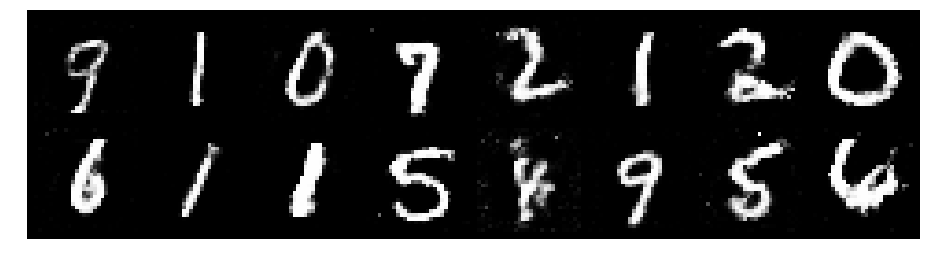

Epoch: [103/200], Batch Num: [300/938]
Discriminator Loss: 1.369367241859436, Generator Loss: 0.8116174340248108
D(x): 0.5747, D(G(z)): 0.5030


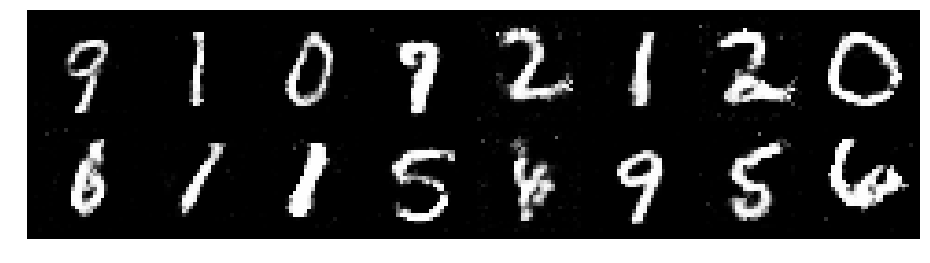

Epoch: [103/200], Batch Num: [400/938]
Discriminator Loss: 1.305047869682312, Generator Loss: 0.9036190509796143
D(x): 0.5540, D(G(z)): 0.4476


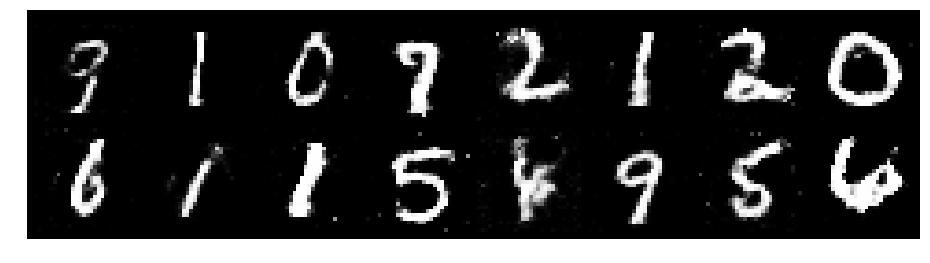

Epoch: [103/200], Batch Num: [500/938]
Discriminator Loss: 1.2256749868392944, Generator Loss: 0.7524137496948242
D(x): 0.5949, D(G(z)): 0.4625


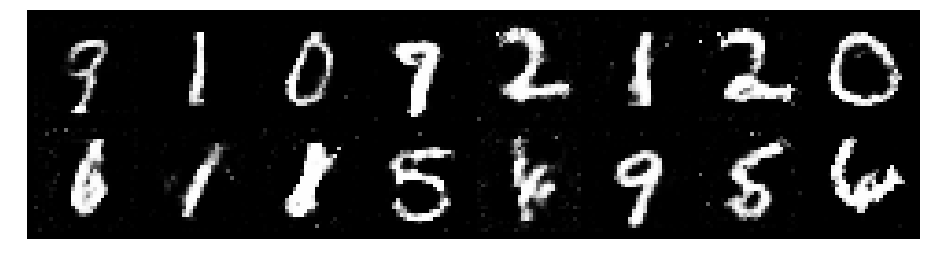

Epoch: [103/200], Batch Num: [600/938]
Discriminator Loss: 1.2235664129257202, Generator Loss: 0.9020358324050903
D(x): 0.5243, D(G(z)): 0.4035


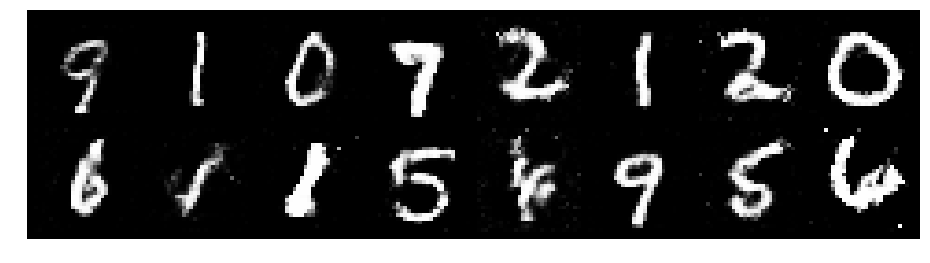

Epoch: [103/200], Batch Num: [700/938]
Discriminator Loss: 1.2325817346572876, Generator Loss: 0.8651776313781738
D(x): 0.5545, D(G(z)): 0.4322


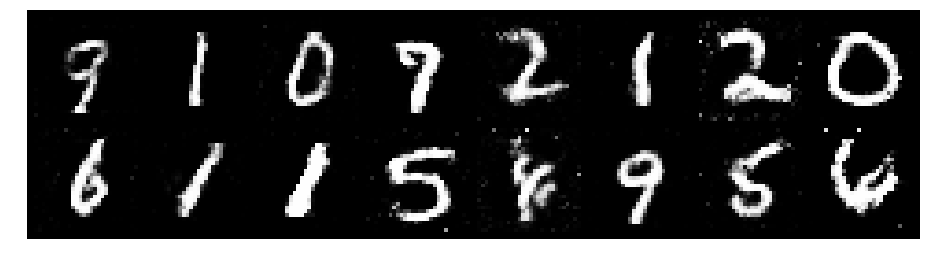

Epoch: [103/200], Batch Num: [800/938]
Discriminator Loss: 1.4157278537750244, Generator Loss: 0.836165189743042
D(x): 0.4970, D(G(z)): 0.4580


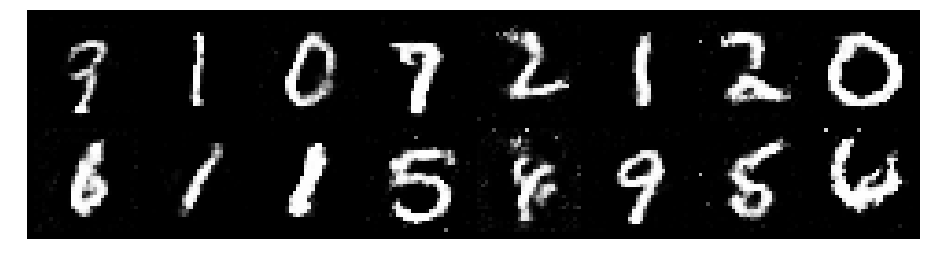

Epoch: [103/200], Batch Num: [900/938]
Discriminator Loss: 1.241645097732544, Generator Loss: 0.9230314493179321
D(x): 0.5777, D(G(z)): 0.4415


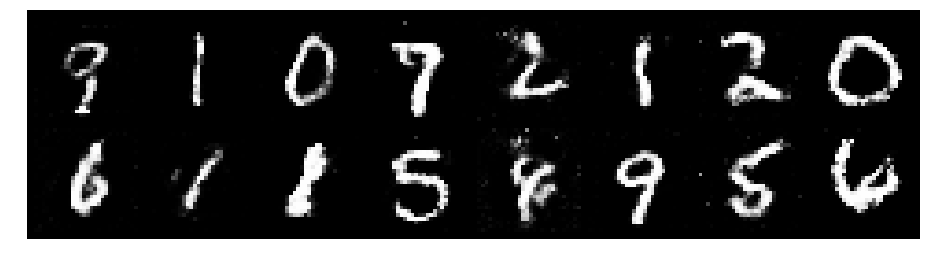

Epoch: [104/200], Batch Num: [0/938]
Discriminator Loss: 1.289820671081543, Generator Loss: 0.8615911602973938
D(x): 0.5542, D(G(z)): 0.4596


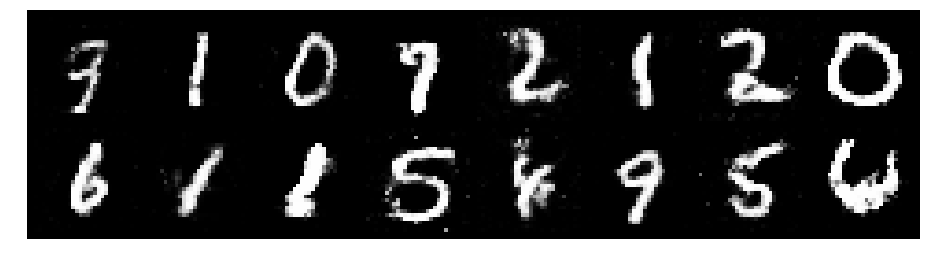

Epoch: [104/200], Batch Num: [100/938]
Discriminator Loss: 1.257542610168457, Generator Loss: 0.7898751497268677
D(x): 0.5591, D(G(z)): 0.4579


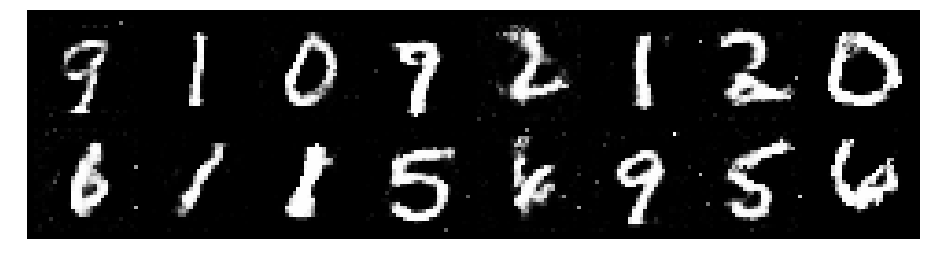

Epoch: [104/200], Batch Num: [200/938]
Discriminator Loss: 1.2157747745513916, Generator Loss: 0.8575668334960938
D(x): 0.5632, D(G(z)): 0.4310


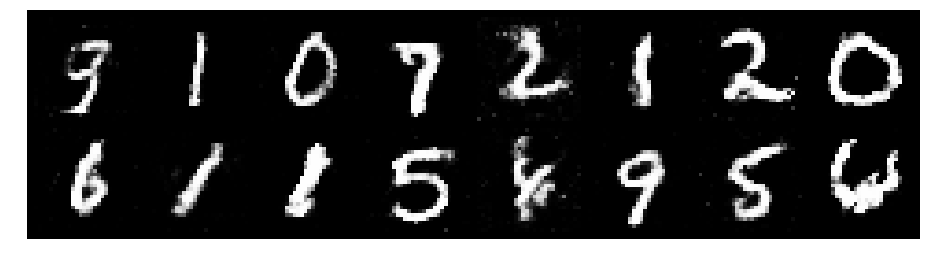

Epoch: [104/200], Batch Num: [300/938]
Discriminator Loss: 1.3224356174468994, Generator Loss: 0.8281207084655762
D(x): 0.5344, D(G(z)): 0.4552


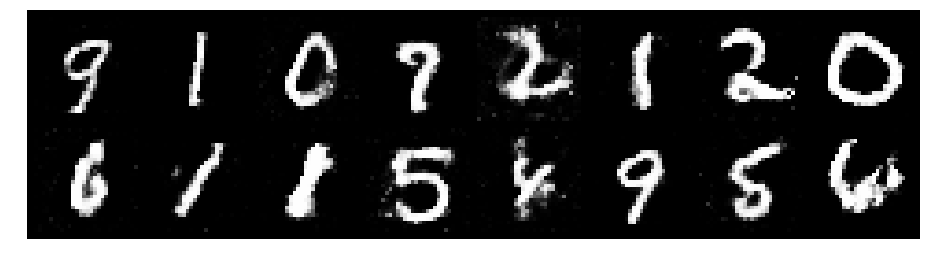

Epoch: [104/200], Batch Num: [400/938]
Discriminator Loss: 1.242497205734253, Generator Loss: 0.7829174399375916
D(x): 0.5533, D(G(z)): 0.4306


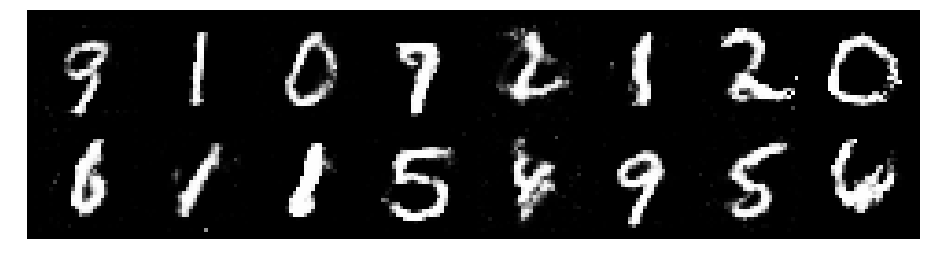

Epoch: [104/200], Batch Num: [500/938]
Discriminator Loss: 1.299086570739746, Generator Loss: 0.9862263202667236
D(x): 0.5503, D(G(z)): 0.4313


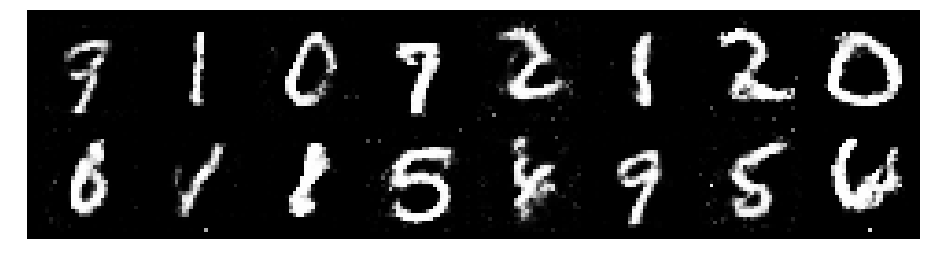

Epoch: [104/200], Batch Num: [600/938]
Discriminator Loss: 1.397414207458496, Generator Loss: 0.927798867225647
D(x): 0.5367, D(G(z)): 0.4764


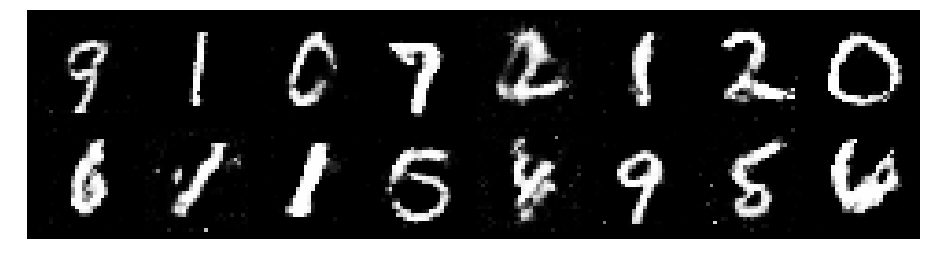

Epoch: [104/200], Batch Num: [700/938]
Discriminator Loss: 1.285549283027649, Generator Loss: 0.9135181307792664
D(x): 0.5514, D(G(z)): 0.4492


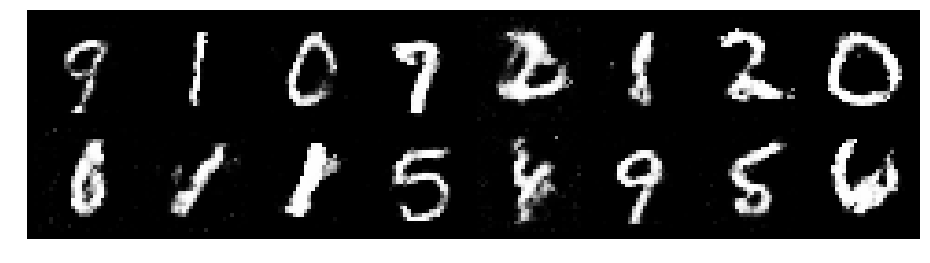

Epoch: [104/200], Batch Num: [800/938]
Discriminator Loss: 1.2604396343231201, Generator Loss: 0.7553089261054993
D(x): 0.5903, D(G(z)): 0.4838


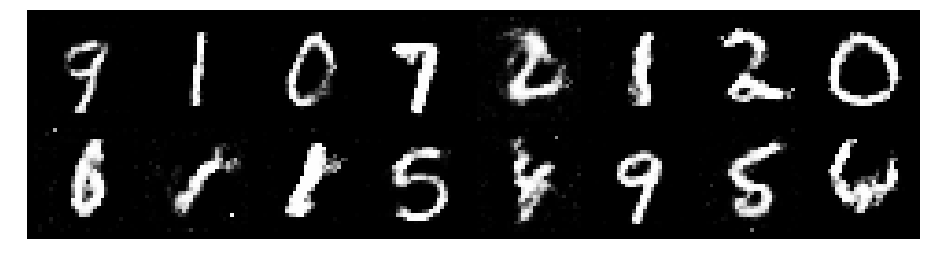

Epoch: [104/200], Batch Num: [900/938]
Discriminator Loss: 1.4434113502502441, Generator Loss: 0.8886768221855164
D(x): 0.5099, D(G(z)): 0.4862


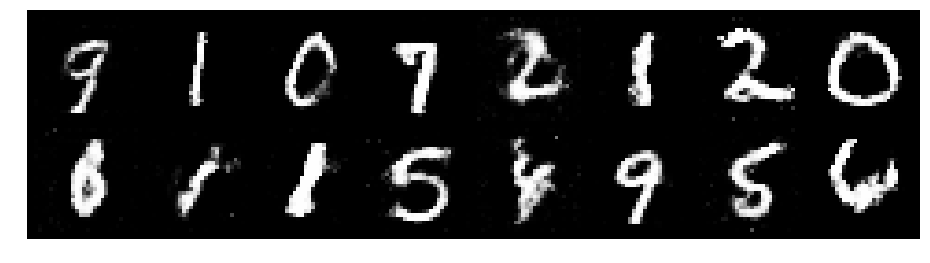

Epoch: [105/200], Batch Num: [0/938]
Discriminator Loss: 1.4278225898742676, Generator Loss: 0.7502390742301941
D(x): 0.5365, D(G(z)): 0.5046


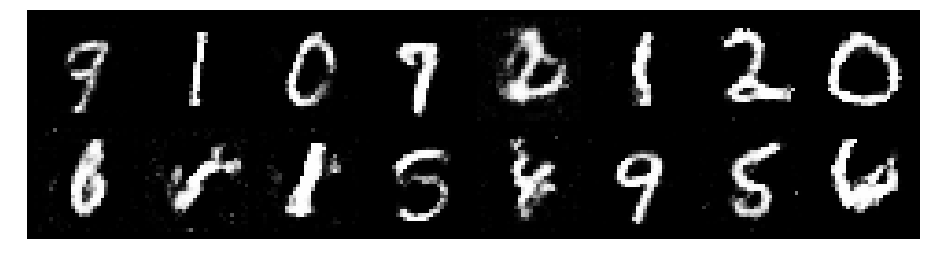

Epoch: [105/200], Batch Num: [100/938]
Discriminator Loss: 1.2916288375854492, Generator Loss: 0.8811607360839844
D(x): 0.5517, D(G(z)): 0.4554


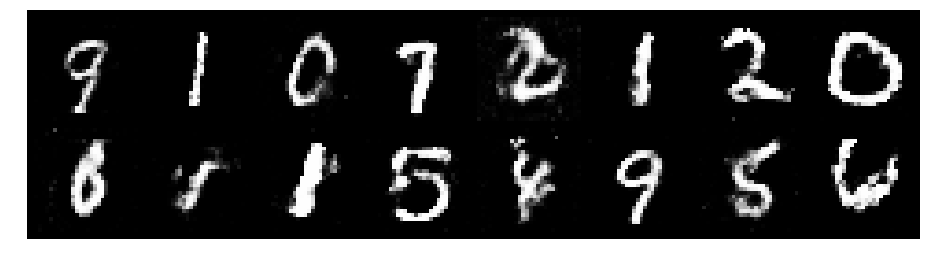

Epoch: [105/200], Batch Num: [200/938]
Discriminator Loss: 1.3891023397445679, Generator Loss: 0.7142131328582764
D(x): 0.4843, D(G(z)): 0.4508


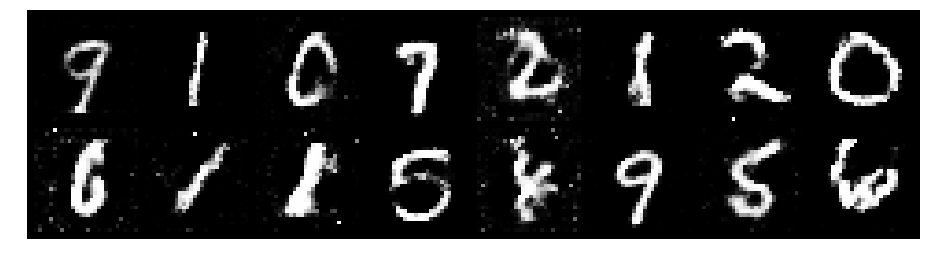

Epoch: [105/200], Batch Num: [300/938]
Discriminator Loss: 1.2806360721588135, Generator Loss: 0.7812280654907227
D(x): 0.5304, D(G(z)): 0.4254


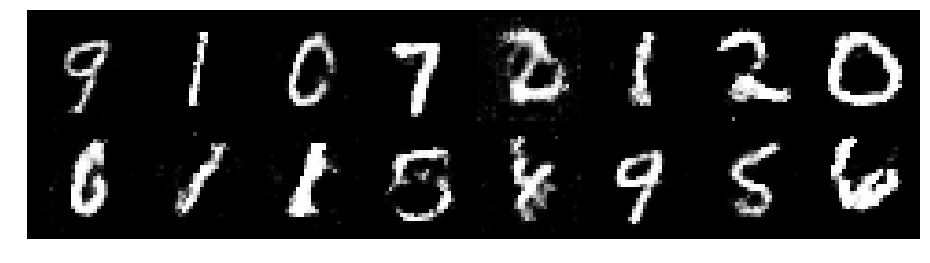

Epoch: [105/200], Batch Num: [400/938]
Discriminator Loss: 1.520887851715088, Generator Loss: 0.8920755386352539
D(x): 0.4316, D(G(z)): 0.4543


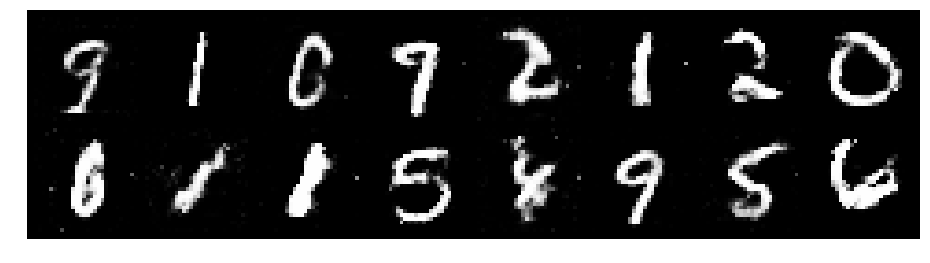

Epoch: [105/200], Batch Num: [500/938]
Discriminator Loss: 1.3473703861236572, Generator Loss: 0.8151108026504517
D(x): 0.5811, D(G(z)): 0.5001


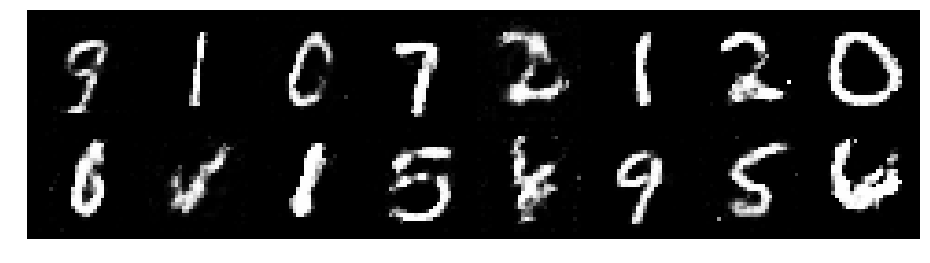

Epoch: [105/200], Batch Num: [600/938]
Discriminator Loss: 1.274364709854126, Generator Loss: 0.825025200843811
D(x): 0.5607, D(G(z)): 0.4473


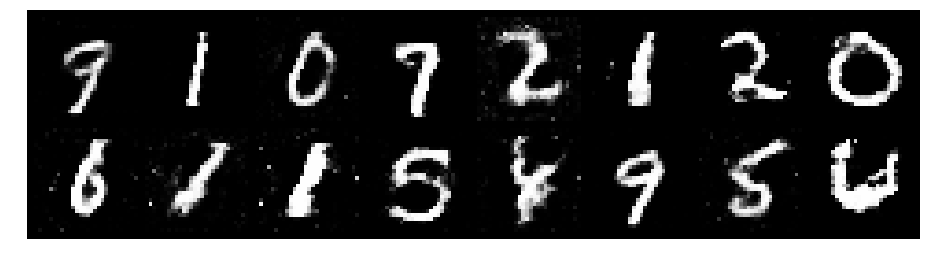

Epoch: [105/200], Batch Num: [700/938]
Discriminator Loss: 1.3940365314483643, Generator Loss: 0.8725686073303223
D(x): 0.5256, D(G(z)): 0.4659


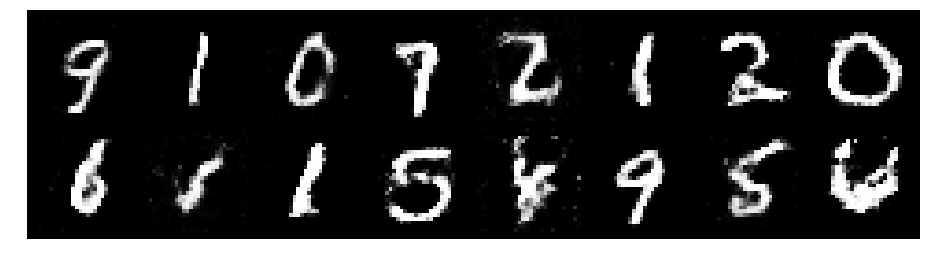

Epoch: [105/200], Batch Num: [800/938]
Discriminator Loss: 1.2753565311431885, Generator Loss: 0.8649547100067139
D(x): 0.5867, D(G(z)): 0.4846


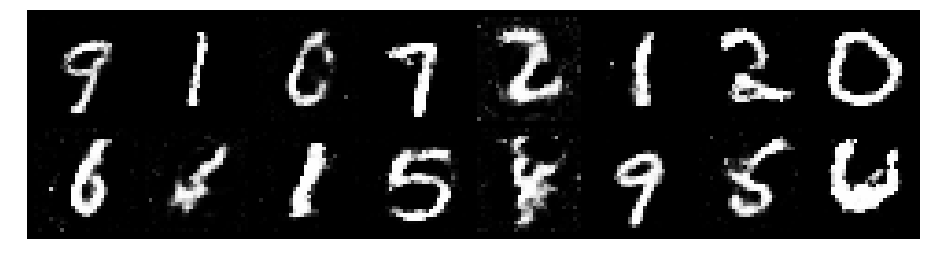

Epoch: [105/200], Batch Num: [900/938]
Discriminator Loss: 1.2530193328857422, Generator Loss: 0.8565716743469238
D(x): 0.5435, D(G(z)): 0.4359


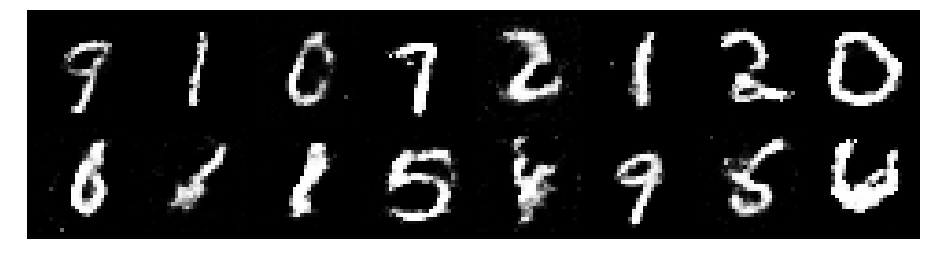

Epoch: [106/200], Batch Num: [0/938]
Discriminator Loss: 1.2352311611175537, Generator Loss: 0.8849272727966309
D(x): 0.5514, D(G(z)): 0.4458


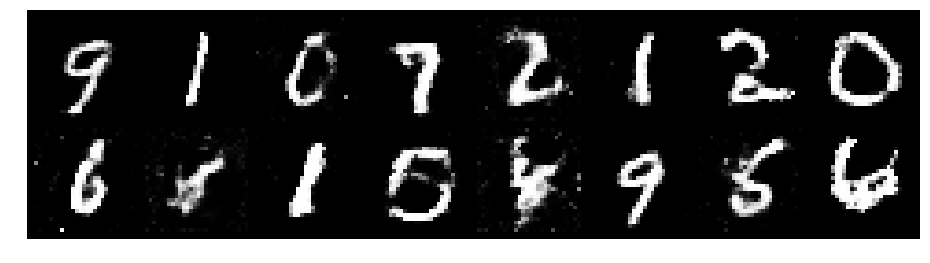

Epoch: [106/200], Batch Num: [100/938]
Discriminator Loss: 1.3083759546279907, Generator Loss: 0.8750450611114502
D(x): 0.5596, D(G(z)): 0.4642


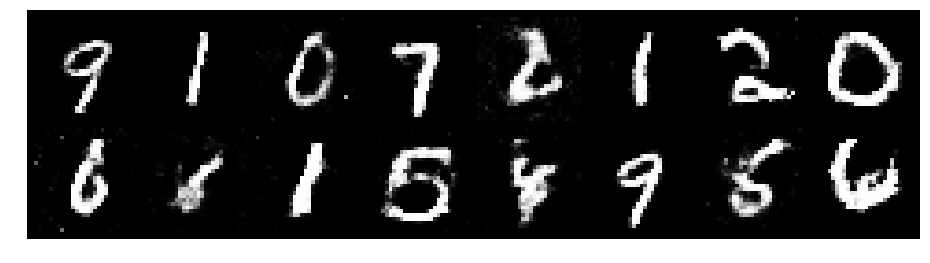

Epoch: [106/200], Batch Num: [200/938]
Discriminator Loss: 1.2993857860565186, Generator Loss: 0.9017090797424316
D(x): 0.5693, D(G(z)): 0.4578


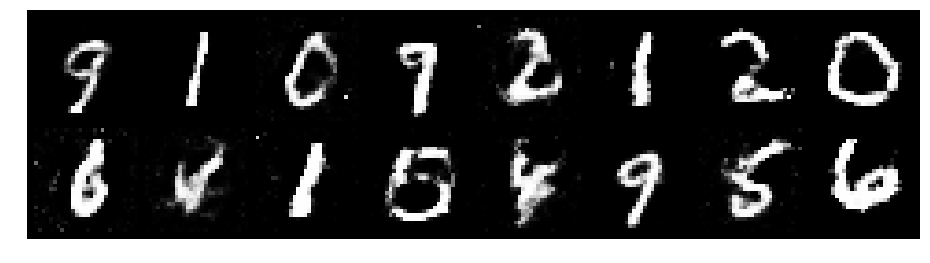

Epoch: [106/200], Batch Num: [300/938]
Discriminator Loss: 1.351626992225647, Generator Loss: 0.8160325288772583
D(x): 0.5463, D(G(z)): 0.4748


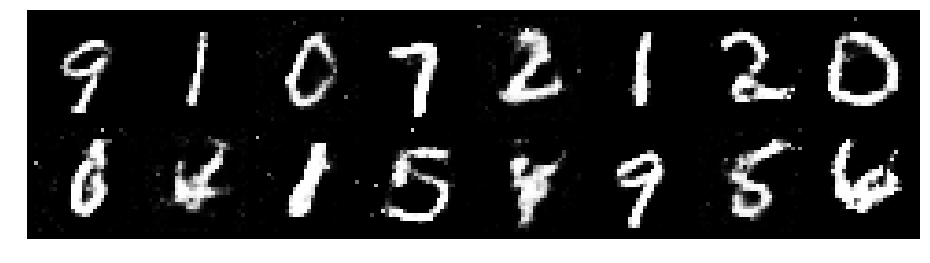

Epoch: [106/200], Batch Num: [400/938]
Discriminator Loss: 1.2089684009552002, Generator Loss: 0.8744074106216431
D(x): 0.5444, D(G(z)): 0.4150


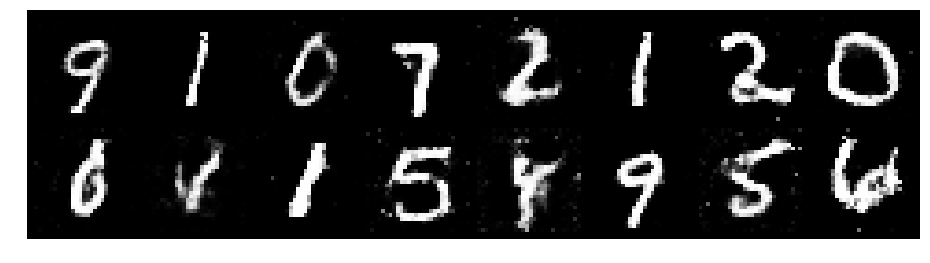

Epoch: [106/200], Batch Num: [500/938]
Discriminator Loss: 1.2649962902069092, Generator Loss: 0.9253972768783569
D(x): 0.5661, D(G(z)): 0.4586


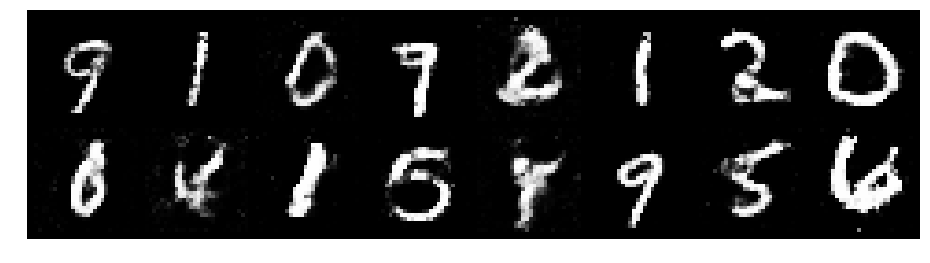

Epoch: [106/200], Batch Num: [600/938]
Discriminator Loss: 1.243131160736084, Generator Loss: 1.0770643949508667
D(x): 0.5478, D(G(z)): 0.4323


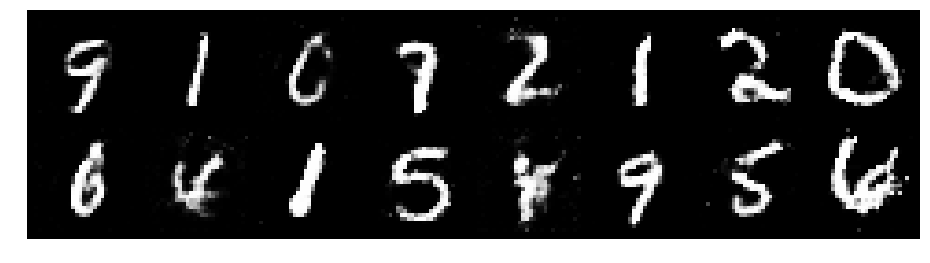

Epoch: [106/200], Batch Num: [700/938]
Discriminator Loss: 1.2282257080078125, Generator Loss: 0.9625747203826904
D(x): 0.5311, D(G(z)): 0.4095


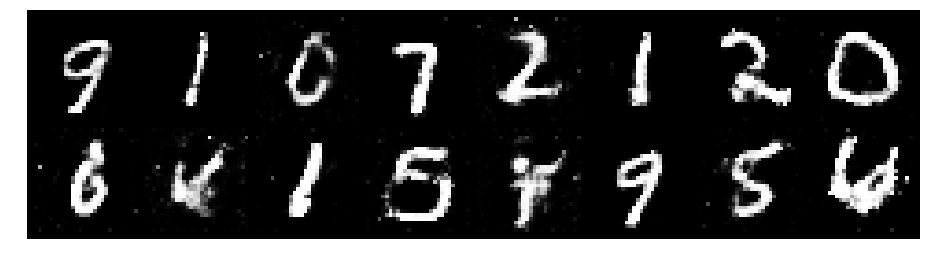

Epoch: [106/200], Batch Num: [800/938]
Discriminator Loss: 1.2886343002319336, Generator Loss: 0.8839459419250488
D(x): 0.5729, D(G(z)): 0.4684


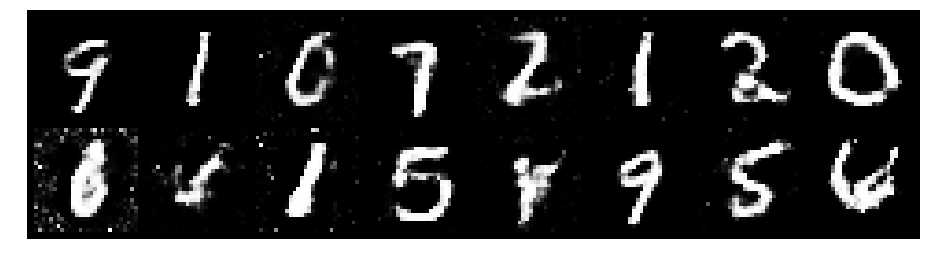

Epoch: [106/200], Batch Num: [900/938]
Discriminator Loss: 1.324569821357727, Generator Loss: 0.8628833293914795
D(x): 0.5428, D(G(z)): 0.4711


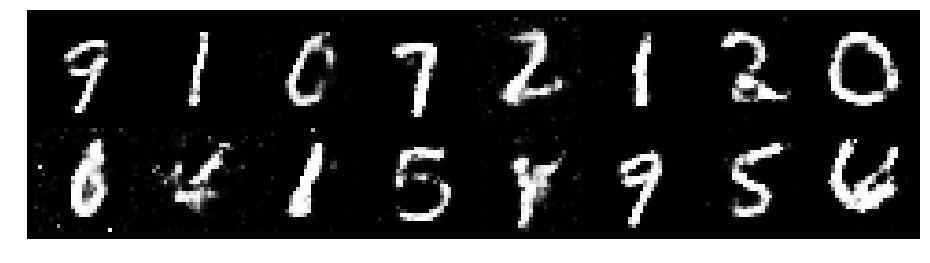

Epoch: [107/200], Batch Num: [0/938]
Discriminator Loss: 1.2948577404022217, Generator Loss: 0.8137896060943604
D(x): 0.5450, D(G(z)): 0.4529


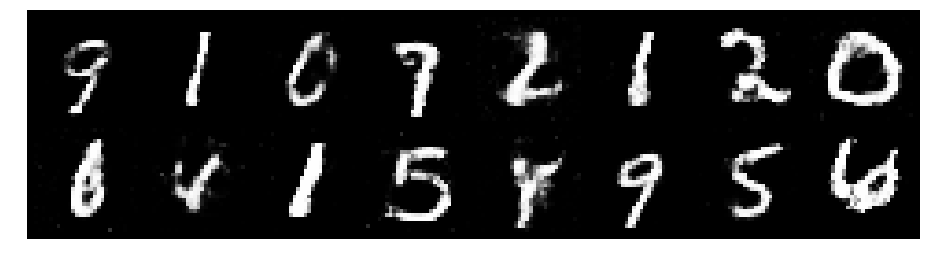

Epoch: [107/200], Batch Num: [100/938]
Discriminator Loss: 1.3223154544830322, Generator Loss: 0.9757570624351501
D(x): 0.5315, D(G(z)): 0.4467


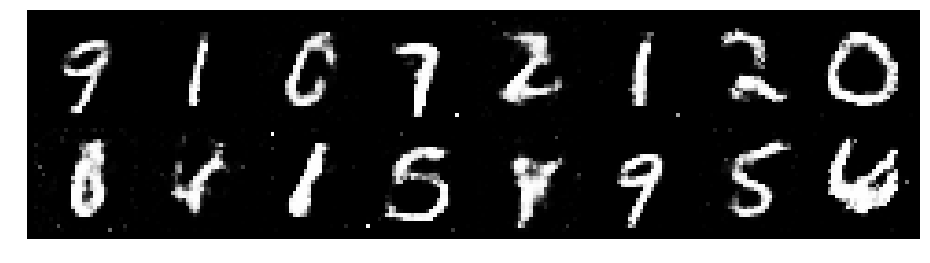

Epoch: [107/200], Batch Num: [200/938]
Discriminator Loss: 1.3148539066314697, Generator Loss: 0.8664270639419556
D(x): 0.5345, D(G(z)): 0.4661


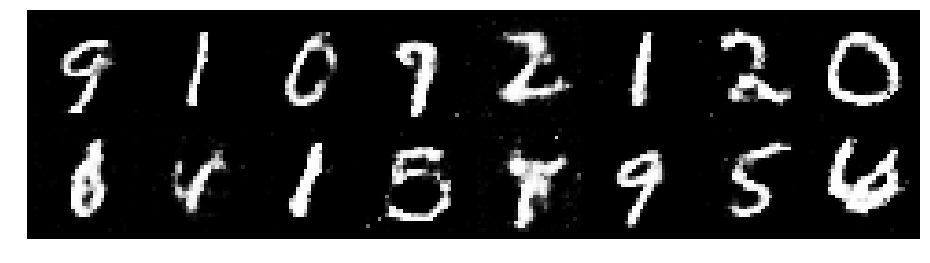

Epoch: [107/200], Batch Num: [300/938]
Discriminator Loss: 1.2392910718917847, Generator Loss: 0.8711327910423279
D(x): 0.5858, D(G(z)): 0.4555


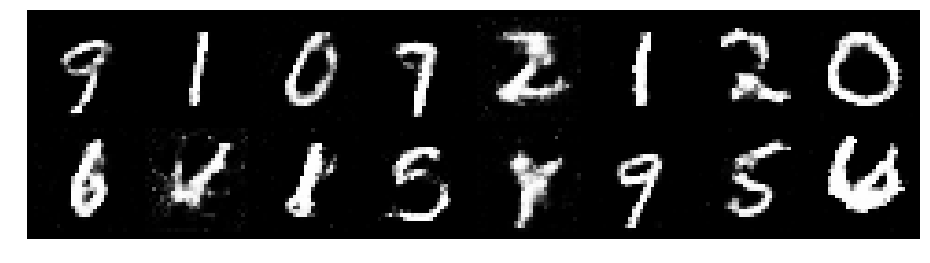

Epoch: [107/200], Batch Num: [400/938]
Discriminator Loss: 1.1720893383026123, Generator Loss: 0.9155135750770569
D(x): 0.5883, D(G(z)): 0.4395


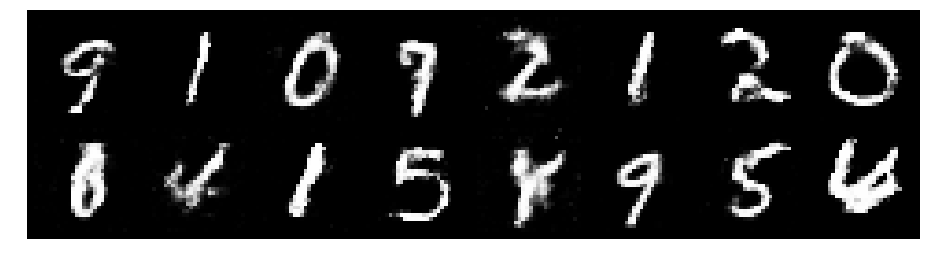

Epoch: [107/200], Batch Num: [500/938]
Discriminator Loss: 1.2270272970199585, Generator Loss: 0.759074866771698
D(x): 0.6048, D(G(z)): 0.4839


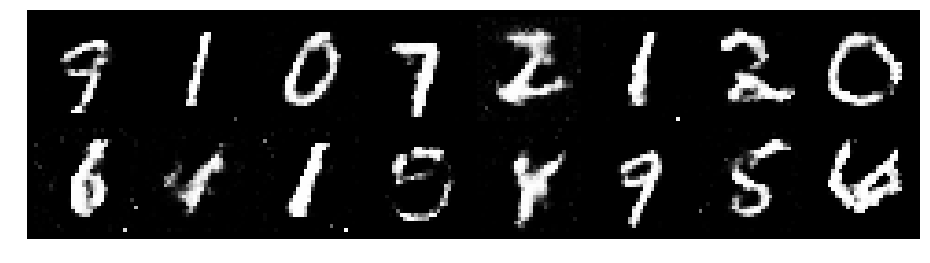

Epoch: [107/200], Batch Num: [600/938]
Discriminator Loss: 1.3606071472167969, Generator Loss: 0.8361942768096924
D(x): 0.5251, D(G(z)): 0.4683


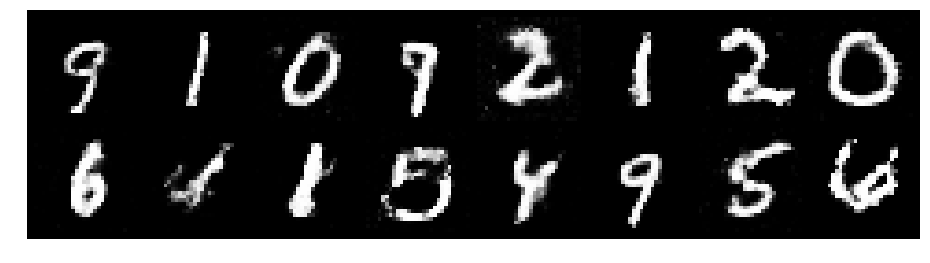

Epoch: [107/200], Batch Num: [700/938]
Discriminator Loss: 1.3388181924819946, Generator Loss: 0.814875602722168
D(x): 0.5394, D(G(z)): 0.4705


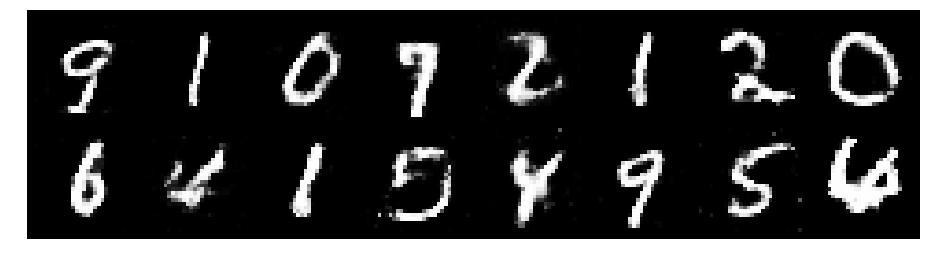

Epoch: [107/200], Batch Num: [800/938]
Discriminator Loss: 1.2389960289001465, Generator Loss: 0.9316453337669373
D(x): 0.5828, D(G(z)): 0.4486


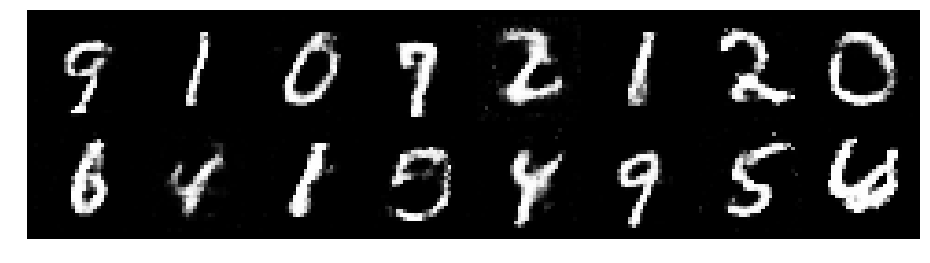

Epoch: [107/200], Batch Num: [900/938]
Discriminator Loss: 1.2501890659332275, Generator Loss: 0.845606803894043
D(x): 0.5444, D(G(z)): 0.4377


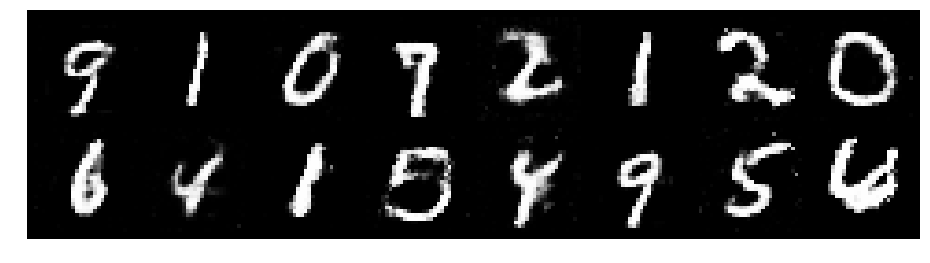

Epoch: [108/200], Batch Num: [0/938]
Discriminator Loss: 1.1990070343017578, Generator Loss: 0.9058012962341309
D(x): 0.5647, D(G(z)): 0.4271


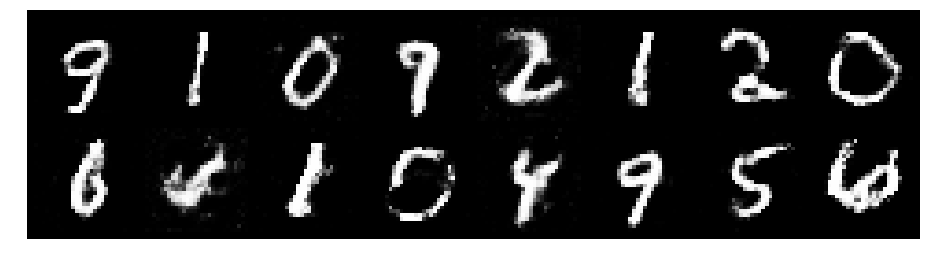

Epoch: [108/200], Batch Num: [100/938]
Discriminator Loss: 1.329162359237671, Generator Loss: 0.877143383026123
D(x): 0.5465, D(G(z)): 0.4758


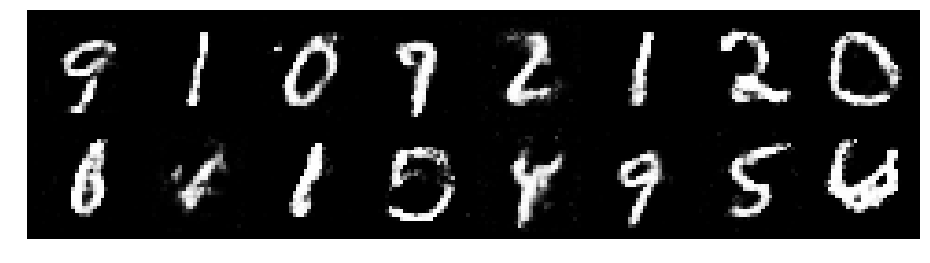

Epoch: [108/200], Batch Num: [200/938]
Discriminator Loss: 1.298421859741211, Generator Loss: 0.9526896476745605
D(x): 0.5627, D(G(z)): 0.4657


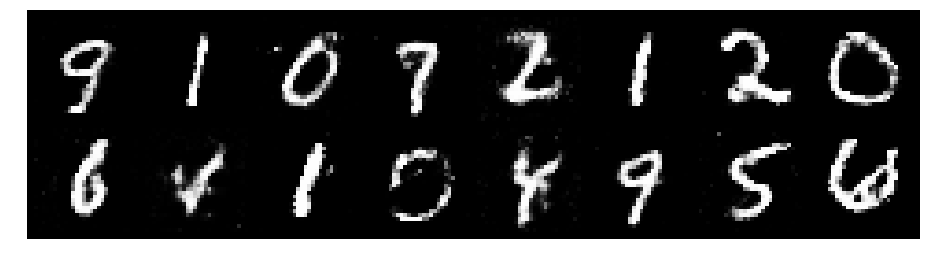

Epoch: [108/200], Batch Num: [300/938]
Discriminator Loss: 1.2602341175079346, Generator Loss: 0.9296701550483704
D(x): 0.5313, D(G(z)): 0.4254


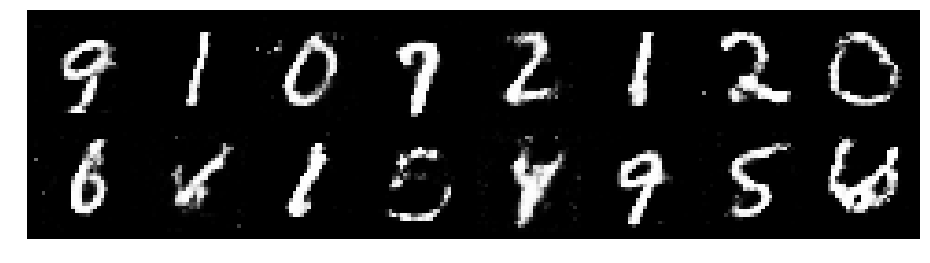

Epoch: [108/200], Batch Num: [400/938]
Discriminator Loss: 1.3461031913757324, Generator Loss: 0.8574494123458862
D(x): 0.5110, D(G(z)): 0.4235


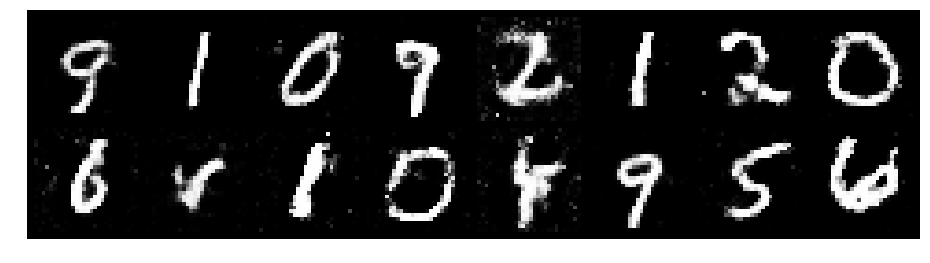

Epoch: [108/200], Batch Num: [500/938]
Discriminator Loss: 1.2297455072402954, Generator Loss: 0.7701603174209595
D(x): 0.6131, D(G(z)): 0.4771


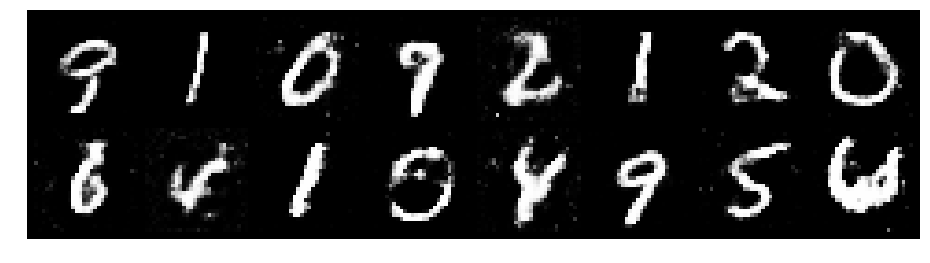

Epoch: [108/200], Batch Num: [600/938]
Discriminator Loss: 1.3041404485702515, Generator Loss: 0.7387981414794922
D(x): 0.5512, D(G(z)): 0.4712


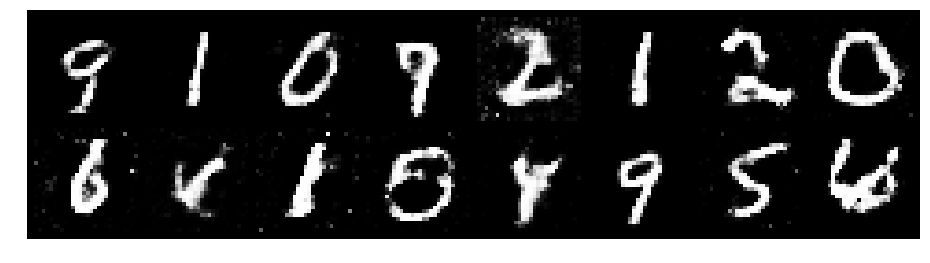

Epoch: [108/200], Batch Num: [700/938]
Discriminator Loss: 1.3452634811401367, Generator Loss: 0.8947151303291321
D(x): 0.5405, D(G(z)): 0.4524


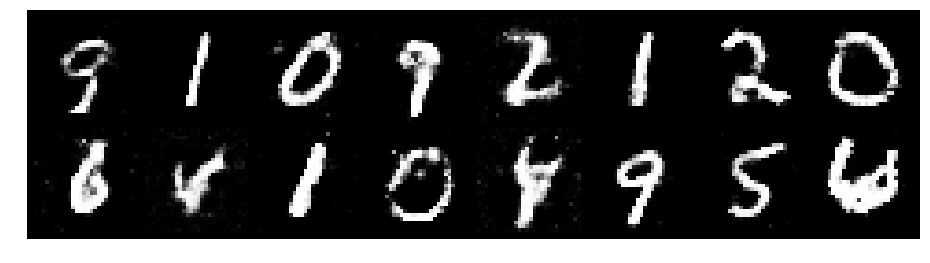

Epoch: [108/200], Batch Num: [800/938]
Discriminator Loss: 1.2432717084884644, Generator Loss: 0.9576025009155273
D(x): 0.5510, D(G(z)): 0.4311


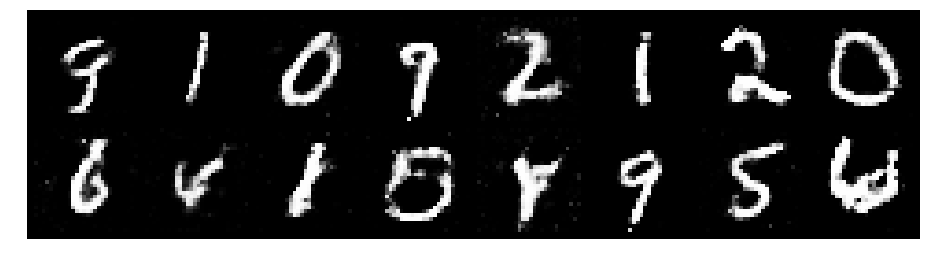

Epoch: [108/200], Batch Num: [900/938]
Discriminator Loss: 1.2322020530700684, Generator Loss: 0.951915979385376
D(x): 0.5728, D(G(z)): 0.4510


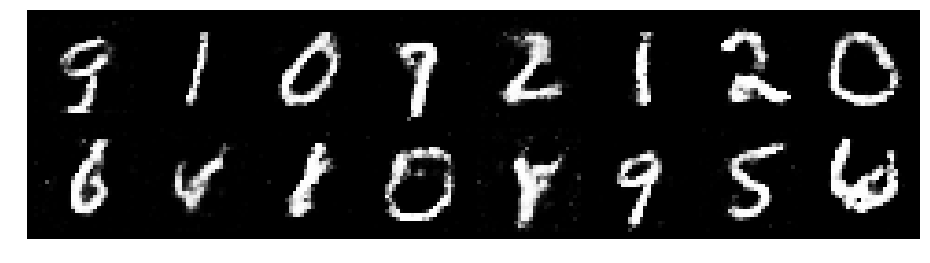

Epoch: [109/200], Batch Num: [0/938]
Discriminator Loss: 1.1666035652160645, Generator Loss: 0.9476008415222168
D(x): 0.5606, D(G(z)): 0.4113


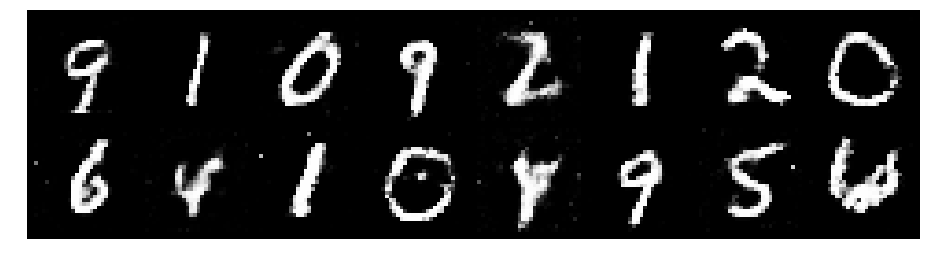

Epoch: [109/200], Batch Num: [100/938]
Discriminator Loss: 1.2458025217056274, Generator Loss: 0.8719487190246582
D(x): 0.5732, D(G(z)): 0.4443


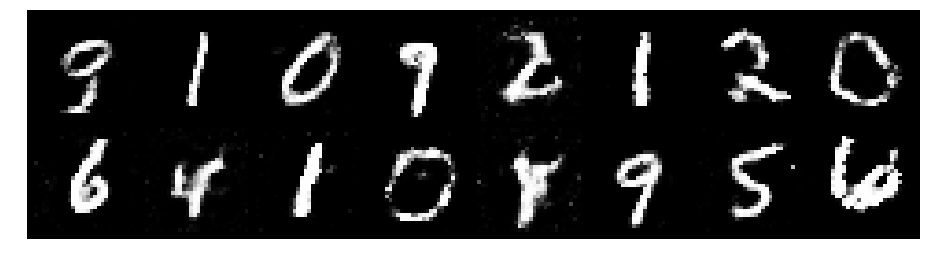

Epoch: [109/200], Batch Num: [200/938]
Discriminator Loss: 1.279037356376648, Generator Loss: 0.7922086715698242
D(x): 0.5365, D(G(z)): 0.4532


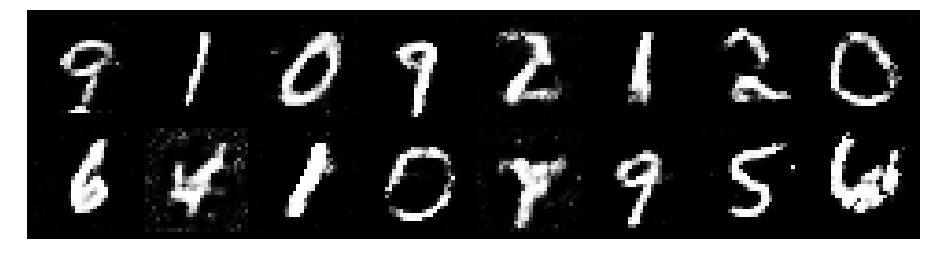

Epoch: [109/200], Batch Num: [300/938]
Discriminator Loss: 1.313568353652954, Generator Loss: 0.8040187358856201
D(x): 0.5340, D(G(z)): 0.4704


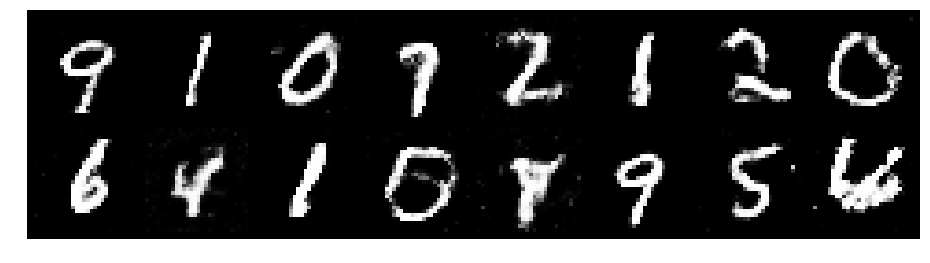

Epoch: [109/200], Batch Num: [400/938]
Discriminator Loss: 1.3597406148910522, Generator Loss: 0.8441766500473022
D(x): 0.5222, D(G(z)): 0.4639


KeyboardInterrupt: 

In [14]:
logger = Logger(model_name='VGAN', data_name='MNIST')
discriminator.cuda()
generator.cuda()
num_epochs = 200

for epoch in range(num_epochs):
    for index, (img,_) in enumerate(dataloader):
        
        N = img.size(0)
        
        real_data = Variable(img.view(img.shape[0],-1)).cuda()
        nois = noise(N)
        fake_data = generator(nois).detach()
        
        d_error, d_real, d_fake = \
            train_discriminator(d_optimizer, real_data,fake_data)
        
        ni = noise(N)
        fake_data = generator(ni)
        g_error = train_generator(g_optimizer, fake_data)
        
        logger.log(d_error, g_error, epoch, index, num_batches)
        
        if (index) % 100 == 0: 
            test_images = generator(test_noise).view(generator(test_noise).size(0),1,28,28).cpu()
            test_images = test_images.data
            logger.log_images(
                test_images, num_test_samples, 
                epoch, index, num_batches
            );
            # Display status Logs
            display_status(epoch, num_epochs, index, num_batches,d_error, g_error, d_real, d_fake)
        logger.save_models(generator, discriminator, epoch)